# Pre-Equilibrium Maximazation of Yield #

In [1]:
# make sure jupyter path is correct for loading local moudules
import sys
# path to steric_simulator module relative to notebook
sys.path.append("../../../")
import copy

In [2]:
from steric_free_simulator import ReactionNetwork, VectorizedRxnNet, VecSim, Optimizer, EquilibriumSolver
import networkx as nx
import torch
from torch import DoubleTensor as Tensor
import numpy as np

EnergyExplorer Module is not available. Check Rosetta installation. <ipykernel.iostream.OutStream object at 0x155550aba080>


We'll start with the AP2 complex that we've worked with before. Pairwise $\Delta Gs$ were derived from the PDB structures via Rossetta

In [3]:
base_input = '../../input_files/heptamer.pwr'
rn = ReactionNetwork(base_input, one_step=True)
rn.resolve_tree()
vec_rn = VectorizedRxnNet(rn, dev='cpu')

['default_assoc', 1.0]
['P']
100.0
['Q']
100.0
['R']
100.0
['S']
100.0
['T']
100.0
['U']
100.0
['V']
100.0
Parsing rule...
['P', 'Q', '']
GGGGGGGGGgg
Parsing rule...
['P', 'R', '']
GGGGGGGGGgg
Parsing rule...
['P', 'S', '']
GGGGGGGGGgg
Parsing rule...
['P', 'T', '']
GGGGGGGGGgg
Parsing rule...
['P', 'U', '']
GGGGGGGGGgg
Parsing rule...
['P', 'V', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'R', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'S', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'T', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'U', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'V', '']
GGGGGGGGGgg
Parsing rule...
['R', 'S', '']
GGGGGGGGGgg
Parsing rule...
['R', 'T', '']
GGGGGGGGGgg
Parsing rule...
['R', 'U', '']
GGGGGGGGGgg
Parsing rule...
['R', 'V', '']
GGGGGGGGGgg
Parsing rule...
['S', 'T', '']
GGGGGGGGGgg
Parsing rule...
['S', 'U', '']
GGGGGGGGGgg
Parsing rule...
['S', 'V', '']
GGGGGGGGGgg
Parsing rule...
['U', 'T', '']
GGGGGGGGGgg
Parsing rule...
['U', 'V', '']
GGGGGGGGGgg
Parsing rule...
['V', 'T', '']
GG

Adding an new edge-- 2 25
New bonds:  [('R', 'U')]
Adding an new edge-- 5 25
New node added--2
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
Node-1 :  (2, {'struct': <networkx.classes.graph.Graph object at 0x155550057be0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R'}
{'V'}
{'R'}
False
Orig edges:  []
Nextn edges:  []
Item edges:  []
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, False]
False
Allowed edges: 
('P', 'U')
[False, False]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, False]
False
Allowed edges: 
('Q', 'T')
[False, False]
False
Allowed edge

Allowed edges: 
('Q', 'V')
[True, False]
False
Allowed edges: 
('R', 'S')
[False, True]
False
Allowed edges: 
('R', 'T')
[False, False]
False
Allowed edges: 
('R', 'U')
[False, False]
False
Allowed edges: 
('R', 'V')
[False, False]
False
Allowed edges: 
('S', 'T')
[True, False]
False
Allowed edges: 
('S', 'U')
[True, False]
False
Allowed edges: 
('S', 'V')
[True, False]
False
Allowed edges: 
('T', 'U')
[False, False]
False
Allowed edges: 
('U', 'V')
[False, False]
False
Allowed edges: 
('T', 'V')
[False, False]
False
[(19, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922208>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('S', 'P'), ('S', 'Q'), ('P', 'Q')]
Adding an new edge-- 3 19
New bonds:  [('P', 'S'), ('Q', 'S')]
Adding an new edge-- 7 19
Node-1 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (8, {'struct': <networkx.classes.grap

Allowed edges: 
('U', 'V')
[True, False]
False
Allowed edges: 
('T', 'V')
[False, False]
False
[]
Connected item Edges:  [('S', 'P'), ('S', 'R'), ('S', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
New node added--1
['S', 'R', 'P', 'U']
Adding an new edge-- 3 55
New bonds:  [('P', 'S'), ('R', 'S'), ('S', 'U')]
Adding an new edge-- 29 55
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  S
Edge added between:  3 55
New node added--2
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55]
Node-1 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0

[]
Connected item Edges:  [('T', 'P'), ('T', 'U'), ('P', 'U')]
New node added--1
['T', 'P', 'U']
Adding an new edge-- 4 65
New bonds:  [('P', 'T'), ('T', 'U')]
Adding an new edge-- 11 65
New node added--2
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65]
Node-1 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'T'}
{'V', 'P'}
{'T'}
False
Orig edges:  []
Nextn edges:  [('P', 'V')]
Item edges:  [('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, False]
False
Allowe

[(57, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922978>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('T', 'Q'), ('T', 'R'), ('T', 'S'), ('R', 'Q'), ('R', 'S'), ('Q', 'S')]
Adding an new edge-- 4 57
New bonds:  [('Q', 'T'), ('R', 'T'), ('S', 'T')]
Adding an new edge-- 31 57
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  T
Edge added between:  4 57
Node-1 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'T'}
{'Q', 'R', 'T'}
set()
Steric hindrance detected
Node-1 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 's

Adding an new edge-- 4 87
New bonds:  [('R', 'T'), ('S', 'T'), ('T', 'U')]
Adding an new edge-- 52 87
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  T
Edge added between:  4 87
New node added--2
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87]
Node-1 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'T'}
{'R', 'S', 'V'}
{'T'}
False
Orig edges:  []
Nextn e

[(21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('U', 'P'), ('U', 'Q'), ('P', 'Q')]
Adding an new edge-- 5 21
New bonds:  [('P', 'U'), ('Q', 'U')]
Adding an new edge-- 7 21
Node-1 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'U'}
{'R', 'P'}
{'U'}
False
Orig edges:  []
Nextn edges:  [('P', 'R')]
Item edges:  [('P', 'R')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, True]
False
############################3
Allowed edges: 
('P', 'V')
[True, False]
False
Allowed edges:

[(46, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('U', 'Q'), ('U', 'S'), ('Q', 'S')]
Adding an new edge-- 5 46
New bonds:  [('Q', 'U'), ('S', 'U')]
Adding an new edge-- 14 46
Node-1 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'U'}
{'Q', 'T'}
{'U'}
False
Orig edges:  []
Nextn edges:  [('Q', 'T')]
Item edges:  [('Q', 'T')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, False]
False
Allowed edges: 
('Q', 'R')
[True, Fa

[(58, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('U', 'Q'), ('U', 'R'), ('U', 'S'), ('R', 'Q'), ('R', 'S'), ('Q', 'S')]
Adding an new edge-- 5 58
New bonds:  [('Q', 'U'), ('R', 'U'), ('S', 'U')]
Adding an new edge-- 31 58
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  U
Edge added between:  5 58
Node-1 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'U'}
{'Q', 'R', 'T'}
{'U'}
False
Orig edges:  []
Nextn edges:  [('R', 'Q'), ('R', 'T'), ('Q', 'T')]
Item edges:  [('R', 'Q'), ('R', 'T'), ('Q', 'T')]
Allowed edges: 
('P', 'Q')
[False,

[(85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'P'), ('U', 'Q'), ('U', 'S'), ('U', 'T'), ('S', 'P'), ('S', 'Q'), ('S', 'T'), ('Q', 'P'), ('Q', 'T'), ('P', 'T')]
Adding an new edge-- 5 85
New bonds:  [('P', 'U'), ('Q', 'U'), ('S', 'U'), ('T', 'U')]
Adding an new edge-- 48 85
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  U
Edge added between:  5 85
Node-1 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (49, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'U'}
{'Q', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (5, {'struct': <networkx.classes.graph.Graph object at 

Node-2 :  (67, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e80>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'U'}
{'Q', 'U', 'T'}
set()
Steric hindrance detected
Node-1 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'U'}
{'Q', 'V', 'T'}
{'U'}
False
Orig edges:  []
Nextn edges:  [('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Item edges:  [('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[True, False]
False
Allowed edges: 
('Q

[]
Connected item Edges:  [('U', 'R'), ('U', 'S'), ('U', 'T'), ('U', 'V'), ('T', 'R'), ('T', 'S'), ('T', 'V'), ('S', 'R'), ('S', 'V'), ('R', 'V')]
New node added--1
['U', 'T', 'S', 'R', 'V']
Adding an new edge-- 5 123
New bonds:  [('R', 'U'), ('S', 'U'), ('T', 'U'), ('U', 'V')]
Adding an new edge-- 88 123
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  U
Edge added between:  5 123
New node added--2
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119

[(44, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f28>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('V', 'P'), ('V', 'S'), ('P', 'S')]
Adding an new edge-- 6 44
New bonds:  [('P', 'V'), ('S', 'V')]
Adding an new edge-- 9 44
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V'}
{'T', 'P'}
{'V'}
False
Orig edges:  []
Nextn edges:  [('P', 'T')]
Item edges:  [('P', 'T')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, True]
True
Allowed edges: 
('P', 'U')
[True, False]
False
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edges

[(72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('V', 'R'), ('V', 'T'), ('R', 'T')]
Adding an new edge-- 6 72
New bonds:  [('R', 'V'), ('T', 'V')]
Adding an new edge-- 24 72
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V'}
{'R', 'U'}
{'V'}
False
Orig edges:  []
Nextn edges:  [('R', 'U')]
Item edges:  [('R', 'U')]
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, False]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[False, T

[(80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('V', 'S'), ('V', 'T'), ('S', 'T')]
Adding an new edge-- 6 80
New bonds:  [('S', 'V'), ('T', 'V')]
Adding an new edge-- 39 80
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V'}
{'S', 'U'}
{'V'}
False
Orig edges:  []
Nextn edges:  [('S', 'U')]
Item edges:  [('S', 'U')]
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, False]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[False, F

[(108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('V', 'P'), ('V', 'R'), ('V', 'S'), ('V', 'U'), ('S', 'P'), ('S', 'R'), ('S', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
Adding an new edge-- 6 108
New bonds:  [('P', 'V'), ('R', 'V'), ('S', 'V'), ('U', 'V')]
Adding an new edge-- 55 108
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  V
Edge added between:  6 108
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (56, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V'}
{'R', 'S', 'V', 'P'}
set()
Steric hindrance detected
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object

[(116, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9692b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('V', 'P'), ('V', 'R'), ('V', 'U'), ('V', 'T'), ('T', 'P'), ('T', 'R'), ('T', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
Adding an new edge-- 6 116
New bonds:  [('P', 'V'), ('R', 'V'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 73 116
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  V
Edge added between:  6 116
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V'}
{'R', 'P', 'V', 'T'}
set()
Steric hindrance detected
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object

Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V'}
{'R', 'V', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (101, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9789e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V'}
{'Q', 'R', 'V', 'U'}
set()
Steric hindrance detected
Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88

[(48, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('P', 'Q'), ('P', 'S'), ('P', 'T'), ('Q', 'S'), ('Q', 'T'), ('S', 'T')]
Adding an new edge-- 7 48
New bonds:  [('P', 'S'), ('P', 'T'), ('Q', 'S'), ('Q', 'T')]
Adding an new edge-- 39 48
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'P'}
{'S', 'U'}
{'Q', 'P'}
False
Orig edges:  [('P', 'Q')]
Nextn edges:  [('S', 'U')]
Item edges:  [('P', 'Q'), ('S', 'U')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, False]
False
Allowe

[(86, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'Q'), ('P', 'S'), ('P', 'T'), ('P', 'V'), ('Q', 'S'), ('Q', 'T'), ('Q', 'V'), ('T', 'S'), ('T', 'V'), ('S', 'V')]
Adding an new edge-- 7 86
New bonds:  [('P', 'S'), ('P', 'T'), ('P', 'V'), ('Q', 'S'), ('Q', 'T'), ('Q', 'V')]
Adding an new edge-- 80 86
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (81, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ac8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'P'}
{'P', 'S', 'U', 'T'}
{'Q'}
Steric hindrance detected
Node-1 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies':

[(102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'Q'), ('P', 'R'), ('P', 'U'), ('P', 'V'), ('Q', 'R'), ('Q', 'U'), ('Q', 'V'), ('U', 'R'), ('U', 'V'), ('R', 'V')]
Adding an new edge-- 7 102
New bonds:  [('P', 'R'), ('P', 'U'), ('P', 'V'), ('Q', 'R'), ('Q', 'U'), ('Q', 'V')]
Adding an new edge-- 99 102
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'P'}
{'R', 'V', 'U', 'P'}
{'Q'}
Steric hindrance detected
Node-1 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copi

[(29, {'struct': <networkx.classes.graph.Graph object at 0x155550057860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('P', 'R'), ('P', 'U'), ('R', 'U')]
$$$$$$$
Node-1 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'P'}
{'V'}
{'R', 'P'}
False
Orig edges:  [('P', 'R')]
Nextn edges:  []
Item edges:  [('P', 'R')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, False]
False
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, False]
F

[(61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'R'), ('P', 'Q'), ('P', 'S'), ('P', 'U'), ('R', 'Q'), ('R', 'S'), ('R', 'U'), ('S', 'Q'), ('S', 'U'), ('Q', 'U')]
Adding an new edge-- 8 61
New bonds:  [('P', 'Q'), ('P', 'S'), ('P', 'U'), ('Q', 'R'), ('R', 'S'), ('R', 'U')]
Adding an new edge-- 46 61
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'P'}
{'Q', 'S', 'V'}
{'R', 'P'}
False
Orig edges:  [('P', 'R')]
Nextn edges:  [('S', 'Q'), ('S', 'V'), ('Q', 'V')]
Item edges:  [('P', 'R'), ('S', 'Q'

Node-2 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P'}
{'R', 'T', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P'}
{'R', 'T', 'V', 'S', 'P'}
set()
Steric hindrance detected
Node-1 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (91, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978668>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P'}
{'R', 'T', 'Q', 'S', 'U'}
{'P'}
Steric hindrance detected
Node-1 :  (8, {'struct': <networkx.classes.graph.Graph

[(27, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('P', 'S'), ('P', 'R'), ('S', 'R')]
$$$$$$$
Node-1 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'S', 'P'}
{'S'}
{'P'}
Steric hindrance detected
Node-1 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'S', 'P'}
{'T'}
{'S', 'P'}
False
Orig edges:  [('P', 'S')]
Nextn edges:  []
Item edges:  [('P', 'S')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed e

[True, True]
True
Allowed edges: 
('R', 'U')
[True, False]
False
Allowed edges: 
('R', 'V')
[True, False]
False
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'U')
[True, False]
False
Allowed edges: 
('S', 'V')
[True, False]
False
Allowed edges: 
('T', 'U')
[True, False]
False
Allowed edges: 
('U', 'V')
[False, False]
False
Allowed edges: 
('T', 'V')
[True, False]
False
[(60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'S'), ('P', 'Q'), ('P', 'R'), ('P', 'T'), ('S', 'Q'), ('S', 'R'), ('S', 'T'), ('R', 'Q'), ('R', 'T'), ('Q', 'T')]
Adding an new edge-- 9 60
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'T'), ('Q', 'S'), ('R', 'S'), ('S', 'T')]
Adding an new edge-- 32 60
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (9, {'struct': 

[(90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'S'), ('P', 'R'), ('P', 'T'), ('P', 'V'), ('S', 'R'), ('S', 'T'), ('S', 'V'), ('T', 'R'), ('T', 'V'), ('R', 'V')]
Adding an new edge-- 9 90
New bonds:  [('P', 'R'), ('P', 'T'), ('P', 'V'), ('R', 'S'), ('S', 'T'), ('S', 'V')]
Adding an new edge-- 72 90
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'P'}
{'R', 'P', 'U', 'T'}
{'S'}
Steric hindrance detected
Node-1 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies':

[(124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('P', 'S'), ('P', 'R'), ('P', 'T'), ('P', 'U'), ('P', 'V'), ('S', 'R'), ('S', 'T'), ('S', 'U'), ('S', 'V'), ('U', 'R'), ('U', 'T'), ('U', 'V'), ('T', 'R'), ('T', 'V'), ('R', 'V')]
Adding an new edge-- 9 124
New bonds:  [('P', 'R'), ('P', 'T'), ('P', 'U'), ('P', 'V'), ('R', 'S'), ('S', 'T'), ('S', 'U'), ('S', 'V')]
Adding an new edge-- 115 124
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (116, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9692b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'S', 'P'}
{'R', 'T', 'V', 'U', 'P'}
{'S'}
Steric hindrance detec

[(70, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('P', 'T'), ('P', 'Q'), ('P', 'V'), ('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Adding an new edge-- 10 70
New bonds:  [('P', 'Q'), ('P', 'V'), ('Q', 'T'), ('T', 'V')]
Adding an new edge-- 17 70
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (18, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'T', 'P'}
{'Q', 'R', 'P'}
{'T'}
Steric hindrance detected
Node-1 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (19, {'struct

[False, True]
False
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'U')
[True, False]
False
Allowed edges: 
('S', 'V')
[True, True]
True
Allowed edges: 
('T', 'U')
[True, False]
False
Allowed edges: 
('U', 'V')
[False, True]
False
Allowed edges: 
('T', 'V')
[True, True]
False
############################3
[(86, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'T'), ('P', 'Q'), ('P', 'S'), ('P', 'V'), ('T', 'Q'), ('T', 'S'), ('T', 'V'), ('S', 'Q'), ('S', 'V'), ('Q', 'V')]
Adding an new edge-- 10 86
New bonds:  [('P', 'Q'), ('P', 'S'), ('P', 'V'), ('Q', 'T'), ('S', 'T'), ('T', 'V')]
Adding an new edge-- 47 86
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies

Allowed edges: 
('R', 'T')
[True, True]
False
############################3
Allowed edges: 
('R', 'U')
[True, True]
True
Allowed edges: 
('R', 'V')
[True, True]
True
Allowed edges: 
('S', 'T')
[False, True]
False
Allowed edges: 
('S', 'U')
[False, True]
False
Allowed edges: 
('S', 'V')
[False, True]
False
Allowed edges: 
('T', 'U')
[True, True]
False
############################3
Allowed edges: 
('U', 'V')
[True, True]
True
Allowed edges: 
('T', 'V')
[True, True]
False
############################3
[(118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('P', 'T'), ('P', 'Q'), ('P', 'R'), ('P', 'U'), ('P', 'V'), ('T', 'Q'), ('T', 'R'), ('T', 'U'), ('T', 'V'), ('U', 'Q'), ('U', 'R'), ('U', 'V'), ('R', 'Q'), ('R', 'V'), ('Q', 'V')]
Adding an new edge-- 10 118
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'U'), ('P', 'V'), ('Q', 'T'), ('R', 'T'), ('T', 'U'), ('T', 'V')]
Adding an new ed

[(96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('P', 'U'), ('P', 'V'), ('U', 'V')]
$$$$$$$
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'U', 'P'}
{'Q', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'U', 'P'}
{'R', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0

[(102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('P', 'U'), ('P', 'Q'), ('P', 'R'), ('P', 'V'), ('U', 'Q'), ('U', 'R'), ('U', 'V'), ('R', 'Q'), ('R', 'V'), ('Q', 'V')]
Adding an new edge-- 11 102
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'V'), ('Q', 'U'), ('R', 'U'), ('U', 'V')]
Adding an new edge-- 34 102
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (35, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'U', 'P'}
{'Q', 'R', 'S', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'co

[(112, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('P', 'U'), ('P', 'T'), ('P', 'V'), ('U', 'T'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 11 112
New bonds:  [('P', 'T'), ('P', 'V'), ('T', 'U'), ('U', 'V')]
Adding an new edge-- 64 112
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'U', 'P'}
{'P', 'U', 'T'}
set()
Steric hindrance detected
Node-1 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (66, {'str

[(22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('P', 'V'), ('P', 'Q'), ('V', 'Q')]
$$$$$$$
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (2, {'struct': <networkx.classes.graph.Graph object at 0x155550057be0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'V', 'P'}
{'R'}
{'V', 'P'}
False
Orig edges:  [('P', 'V')]
Nextn edges:  []
Item edges:  [('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, False]
False
Allowed edges: 
('P', 'V')
[True, True]
True
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, False]


[(100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('P', 'V'), ('P', 'R'), ('P', 'U'), ('V', 'R'), ('V', 'U'), ('R', 'U')]
Adding an new edge-- 12 100
New bonds:  [('P', 'R'), ('P', 'U'), ('R', 'V'), ('U', 'V')]
Adding an new edge-- 25 100
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V', 'P'}
{'R', 'V'}
{'P'}
Steric hindrance detected
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (27, {'struct':

Adding an new edge-- 52 108
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'V', 'P'}
{'R', 'S', 'V'}
{'P'}
Steric hindrance detected
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (54, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V', 'P'}
{'R', 'S', 'T', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 

Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (88, {'struct': <networkx.classes.graph.Graph object at 0x1554bbbbcb00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V', 'P'}
{'R', 'S', 'V', 'T'}
{'P'}
Steric hindrance detected
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'V', 'P'}
{'R', 'T', 'S', 'U', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subu

False
Allowed edges: 
('Q', 'U')
[True, False]
False
Allowed edges: 
('Q', 'V')
[True, True]
False
############################3
Allowed edges: 
('R', 'S')
[True, False]
False
Allowed edges: 
('R', 'T')
[True, False]
False
Allowed edges: 
('R', 'U')
[True, False]
False
Allowed edges: 
('R', 'V')
[True, True]
False
############################3
Allowed edges: 
('S', 'T')
[False, False]
False
Allowed edges: 
('S', 'U')
[False, False]
False
Allowed edges: 
('S', 'V')
[False, True]
False
Allowed edges: 
('T', 'U')
[False, False]
False
Allowed edges: 
('U', 'V')
[False, True]
False
Allowed edges: 
('T', 'V')
[False, True]
False
[(38, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9227b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'R'), ('Q', 'P'), ('Q', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9781d0>, 'copies': tensor([0.], dtype=torch.float64), 

[(76, {'struct': <networkx.classes.graph.Graph object at 0x155550057cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'R'), ('Q', 'T'), ('Q', 'V'), ('R', 'T'), ('R', 'V'), ('T', 'V')]
Adding an new edge-- 13 76
New bonds:  [('Q', 'T'), ('Q', 'V'), ('R', 'T'), ('R', 'V')]
Adding an new edge-- 64 76
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9781d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R'}
{'P', 'U', 'T'}
{'Q', 'R'}
False
Orig edges:  [('Q', 'R')]
Nextn edges:  [('T', 'P'), ('T', 'U'), ('P', 'U')]
Item edges:  [('Q', 'R'), ('T', 'P'), ('T', 'U'), ('P', 'U')]
Allowed edges: 
('P', 'Q')
[True, True]
Fal

[(109, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('Q', 'R'), ('Q', 'S'), ('Q', 'U'), ('Q', 'V'), ('R', 'S'), ('R', 'U'), ('R', 'V'), ('U', 'S'), ('U', 'V'), ('S', 'V')]
Adding an new edge-- 13 109
New bonds:  [('Q', 'S'), ('Q', 'U'), ('Q', 'V'), ('R', 'S'), ('R', 'U'), ('R', 'V')]
Adding an new edge-- 103 109
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9781d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (104, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969898>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'R'}
{'S', 'V', 'U', 'P'}
{'Q', 'R'}
False
Orig edges:  [('Q', 'R')]
Nextn edges:  [('U', 'P'), ('U', 'S'), ('U', 'V'), ('S', 'P'), ('S', 'V')

[(47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('Q', 'S'), ('Q', 'V'), ('S', 'V')]
$$$$$$$
Node-1 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'S'}
{'Q', 'P'}
{'S'}
Steric hindrance detected
Node-1 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'S'}
{'R', 'P'}
{'Q', 'S'}
False
Orig edges:  [('Q', 'S')]
Nextn edges:  [('P', 'R')]
Item edges:  [('Q', 'S'), ('P', 'R')]
Allowed edges: 
('P', 'Q')

[(62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('Q', 'S'), ('Q', 'P'), ('Q', 'R'), ('Q', 'V'), ('S', 'P'), ('S', 'R'), ('S', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
Adding an new edge-- 14 62
New bonds:  [('P', 'Q'), ('P', 'S'), ('Q', 'R'), ('Q', 'V'), ('R', 'S'), ('S', 'V')]
Adding an new edge-- 30 62
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S'}
{'Q', 'R', 'S'}
set()
Steric hindrance detected
Node-1 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': te

Node-2 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'S'}
{'R', 'T', 'S', 'U', 'P'}
{'Q'}
Steric hindrance detected
Node-1 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'S'}
{'R', 'T', 'V', 'S', 'P'}
{'Q'}
Steric hindrance detected
Node-1 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (91, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978668>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'S'}
{'R', 'T', 'Q', 'S', 'U'}
set()
Steric hindrance detected
Node-1 :  (14, {'struct': <networkx.classes.graph.Gr

[(32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('Q', 'T'), ('Q', 'R'), ('T', 'R')]
$$$$$$$
Node-1 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'T'}
{'S'}
{'Q', 'T'}
False
Orig edges:  [('Q', 'T')]
Nextn edges:  []
Item edges:  [('Q', 'T')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, False]
False
Allowed edges: 
('P', 'V')
[False, False]
False
Allowed edges: 
('Q', 'R')
[True, False]
False
Allowed edges: 
('Q', 'S')
[True, True]
False
####################

[(84, {'struct': <networkx.classes.graph.Graph object at 0x1554bbc769b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'T'), ('Q', 'S'), ('Q', 'V'), ('T', 'S'), ('T', 'V'), ('S', 'V')]
Adding an new edge-- 15 84
New bonds:  [('Q', 'S'), ('Q', 'V'), ('S', 'T'), ('T', 'V')]
Adding an new edge-- 41 84
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (42, {'struct': <networkx.classes.graph.Graph object at 0x1554bbb02da0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'T'}
{'T', 'S', 'P'}
{'Q'}
Steric hindrance detected
Node-1 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (43, {'struct

[(118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('Q', 'T'), ('Q', 'P'), ('Q', 'R'), ('Q', 'U'), ('Q', 'V'), ('T', 'P'), ('T', 'R'), ('T', 'U'), ('T', 'V'), ('U', 'P'), ('U', 'R'), ('U', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
Adding an new edge-- 15 118
New bonds:  [('P', 'Q'), ('P', 'T'), ('Q', 'R'), ('Q', 'U'), ('Q', 'V'), ('R', 'T'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 100 118
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (101, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9789e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'T'}
{'Q', 'R', 'V', 'U'}
{'T'}
Steric hindrance detected

[(49, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'U'), ('Q', 'P'), ('Q', 'S'), ('U', 'P'), ('U', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (16, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9694a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'U'}
{'T', 'P'}
{'Q', 'U'}
False
Orig edges:  [('Q', 'U')]
Nextn edges:  [('P', 'T')]
Item edges:  [('Q', 'U'), ('P', 'T')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, True]
True
Allowed edges: 
('P', 'U')
[True, True]
False
############################3
Allowed edges: 
('P', 'V')
[True, False]
Fal

False
Allowed edges: 
('R', 'U')
[False, True]
False
Allowed edges: 
('R', 'V')
[False, True]
False
Allowed edges: 
('S', 'T')
[True, False]
False
Allowed edges: 
('S', 'U')
[True, True]
False
############################3
Allowed edges: 
('S', 'V')
[True, True]
True
Allowed edges: 
('T', 'U')
[False, True]
False
Allowed edges: 
('U', 'V')
[True, True]
False
############################3
Allowed edges: 
('T', 'V')
[False, True]
False
[(105, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9225c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'U'), ('Q', 'S'), ('Q', 'V'), ('U', 'S'), ('U', 'V'), ('S', 'V')]
Adding an new edge-- 16 105
New bonds:  [('Q', 'S'), ('Q', 'V'), ('S', 'U'), ('U', 'V')]
Adding an new edge-- 41 105
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (16, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9694a

('U', 'V')
[True, True]
False
############################3
Allowed edges: 
('T', 'V')
[True, True]
True
[(117, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978fd0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('Q', 'U'), ('Q', 'R'), ('Q', 'T'), ('Q', 'V'), ('U', 'R'), ('U', 'T'), ('U', 'V'), ('T', 'R'), ('T', 'V'), ('R', 'V')]
Adding an new edge-- 16 117
New bonds:  [('Q', 'R'), ('Q', 'T'), ('Q', 'V'), ('R', 'U'), ('T', 'U'), ('U', 'V')]
Adding an new edge-- 72 117
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (16, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9694a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'U'}
{'R', 'P', 'U', 'T'}
{'Q'}
Steric 

[(34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('Q', 'V'), ('Q', 'R'), ('V', 'R')]
$$$$$$$
Node-1 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'V'}
{'S'}
{'Q', 'V'}
False
Orig edges:  [('Q', 'V')]
Nextn edges:  []
Item edges:  [('Q', 'V')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, False]
False
Allowed edges: 
('P', 'U')
[False, False]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[True, False]
False
Allowed edges: 
('Q', 'S')
[True, True]
False
####################

[(62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('Q', 'V'), ('Q', 'P'), ('Q', 'R'), ('Q', 'S'), ('V', 'P'), ('V', 'R'), ('V', 'S'), ('R', 'P'), ('R', 'S'), ('P', 'S')]
Adding an new edge-- 17 62
New bonds:  [('P', 'Q'), ('P', 'V'), ('Q', 'R'), ('Q', 'S'), ('R', 'V'), ('S', 'V')]
Adding an new edge-- 27 62
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (28, {'struct': <networkx.classes.graph.Graph object at 0x1554bc0461d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V'}
{'R', 'T', 'P'}
{'Q', 'V'}
False
Orig edges:  [('Q', 'V')]
Nextn edges:  [('R', 'P'), ('R', 'T'), ('P', 'T')]
Item edges:  [('Q', 'V'), ('R', '

[(110, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('Q', 'V'), ('Q', 'P'), ('Q', 'R'), ('Q', 'S'), ('Q', 'U'), ('V', 'P'), ('V', 'R'), ('V', 'S'), ('V', 'U'), ('S', 'P'), ('S', 'R'), ('S', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
Adding an new edge-- 17 110
New bonds:  [('P', 'Q'), ('P', 'V'), ('Q', 'R'), ('Q', 'S'), ('Q', 'U'), ('R', 'V'), ('S', 'V'), ('U', 'V')]
Adding an new edge-- 55 110
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (56, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'V'}
{'R', 'S', 'V', 'P'}
{'Q'}
Steric hindrance detected
N

Node-1 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (121, {'struct': <networkx.classes.graph.Graph object at 0x155550057c18>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'V'}
{'T', 'V', 'Q', 'S', 'U'}
set()
Steric hindrance detected
Node-1 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (122, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'Q', 'V'}
{'T', 'V', 'Q', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (123, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ef0>, 'copies': tensor([0.], dtype=torch.f

[(77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('Q', 'P'), ('Q', 'R'), ('Q', 'T'), ('Q', 'U'), ('P', 'R'), ('P', 'T'), ('P', 'U'), ('R', 'T'), ('R', 'U'), ('T', 'U')]
Adding an new edge-- 18 77
New bonds:  [('P', 'T'), ('P', 'U'), ('Q', 'T'), ('Q', 'U'), ('R', 'T'), ('R', 'U')]
Adding an new edge-- 63 77
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (18, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (64, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969710>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'R', 'P'}
{'V', 'T'}
{'Q', 'R', 'P'}
False
Orig edges:  [('Q', 'P'), ('Q', 'R'), ('P', 'R')]
Nextn edges:  [('T', 'V')]
Item edges:  [('Q', 'P'), ('

Node-1 :  (19, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922208>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'P'}
{'S'}
{'Q', 'P'}
Steric hindrance detected
Node-1 :  (19, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922208>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'P'}
{'T'}
{'Q', 'S', 'P'}
False
Orig edges:  [('Q', 'P'), ('Q', 'S'), ('P', 'S')]
Nextn edges:  []
Item edges:  [('Q', 'P'), ('Q', 'S'), ('P', 'S')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
False
#######

[(93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('Q', 'P'), ('Q', 'S'), ('Q', 'R'), ('Q', 'T'), ('Q', 'U'), ('P', 'S'), ('P', 'R'), ('P', 'T'), ('P', 'U'), ('S', 'R'), ('S', 'T'), ('S', 'U'), ('T', 'R'), ('T', 'U'), ('R', 'U')]
Adding an new edge-- 19 93
New bonds:  [('P', 'R'), ('P', 'T'), ('P', 'U'), ('Q', 'R'), ('Q', 'T'), ('Q', 'U'), ('R', 'S'), ('S', 'T'), ('S', 'U')]
Adding an new edge-- 71 93
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (19, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922208>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'P'}
{'R', 'V', 'T'}
{'Q', 'S', 'P'}
False
Ori

[(70, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'P'), ('Q', 'T'), ('Q', 'V'), ('P', 'T'), ('P', 'V'), ('T', 'V')]
$$$$$$$
Node-1 :  (20, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224e0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'T', 'P'}
{'Q', 'P'}
{'T'}
Steric hindrance detected
Node-1 :  (20, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224e0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'T', 'P'}
{'R', 'P'}
{'Q', 'T'}
Steric hindrance detected
Node-1 :  (20, {'struct': <networkx.classes.graph.

[(77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('Q', 'P'), ('Q', 'T'), ('Q', 'R'), ('Q', 'U'), ('P', 'T'), ('P', 'R'), ('P', 'U'), ('T', 'R'), ('T', 'U'), ('R', 'U')]
Adding an new edge-- 20 77
New bonds:  [('P', 'R'), ('P', 'U'), ('Q', 'R'), ('Q', 'U'), ('R', 'T'), ('T', 'U')]
Adding an new edge-- 25 77
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (20, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224e0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'T', 'P'}
{'R', 'V'}
{'Q', 'P', 'T'}
False
Orig edges:  [('Q', 'P'), ('Q', 'T'), ('P', 'T')]
Nextn edges:  [('R', 'V')]
Item edges:  [('Q', 'P'), ('

[(122, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('Q', 'P'), ('Q', 'T'), ('Q', 'S'), ('Q', 'U'), ('Q', 'V'), ('P', 'T'), ('P', 'S'), ('P', 'U'), ('P', 'V'), ('T', 'S'), ('T', 'U'), ('T', 'V'), ('U', 'S'), ('U', 'V'), ('S', 'V')]
Adding an new edge-- 20 122
New bonds:  [('P', 'S'), ('P', 'U'), ('P', 'V'), ('Q', 'S'), ('Q', 'U'), ('Q', 'V'), ('S', 'T'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 103 122
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (20, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224e0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (104, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969898>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'T', 'P'}
{'S', 'V', 'U', 'P'}
{'Q', 'T'}
Ste

Adding an new edge-- 39 85
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'U', 'P'}
{'S', 'U'}
{'Q', 'P'}
Steric hindrance detected
Node-1 :  (21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'U', 'P'}
{'S', 'V'}
{'Q', 'U', 'P'}
False
Orig edges:  [('Q', 'P'), ('Q', 'U'), ('P', 'U')]
Nextn edges:  [('S', 'V')]
Item edges:  [('Q', 'P'), ('Q', 'U'), ('P', 'U'), ('S', 'V')]
A

[(38, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9227b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'P'), ('Q', 'V'), ('Q', 'R'), ('P', 'V'), ('P', 'R'), ('V', 'R')]
$$$$$$$
Node-1 :  (22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'V', 'P'}
{'S'}
{'Q', 'V', 'P'}
False
Orig edges:  [('Q', 'P'), ('Q', 'V'), ('P', 'V')]
Nextn edges:  []
Item edges:  [('Q', 'P'), ('Q', 'V'), ('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
False
############################3
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, False]
False
Allowed edges: 
('P', 'V')
[True, True]
T

[(110, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('Q', 'P'), ('Q', 'V'), ('Q', 'R'), ('Q', 'S'), ('Q', 'U'), ('P', 'V'), ('P', 'R'), ('P', 'S'), ('P', 'U'), ('V', 'R'), ('V', 'S'), ('V', 'U'), ('S', 'R'), ('S', 'U'), ('R', 'U')]
Adding an new edge-- 22 110
New bonds:  [('P', 'R'), ('P', 'S'), ('P', 'U'), ('Q', 'R'), ('Q', 'S'), ('Q', 'U'), ('R', 'V'), ('S', 'V'), ('U', 'V')]
Adding an new edge-- 52 110
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'P'}
{'R', 'S', 'V'}
{'Q', 'P'}
Steric hind

[(52, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('R', 'S'), ('R', 'U'), ('S', 'U')]
$$$$$$$
Node-1 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'S'}
{'V'}
{'R', 'S'}
False
Orig edges:  [('R', 'S')]
Nextn edges:  []
Item edges:  [('R', 'S')]
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, False]
False
Allowed edges: 
('P', 'U')
[False, False]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, True]
False
Allowed edges: 
('Q

[(62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'S'), ('R', 'P'), ('R', 'Q'), ('R', 'V'), ('S', 'P'), ('S', 'Q'), ('S', 'V'), ('Q', 'P'), ('Q', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S'}
{'R', 'S'}
set()
Steric hindrance detected
Node-1 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S'}
{'R', 'T'}
{'S'}
Steric hindrance detected
Node-1 :  (23, 

[(107, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969f60>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('R', 'S'), ('R', 'U'), ('R', 'V'), ('S', 'U'), ('S', 'V'), ('U', 'V')]
Adding an new edge-- 23 107
New bonds:  [('R', 'U'), ('R', 'V'), ('S', 'U'), ('S', 'V')]
Adding an new edge-- 95 107
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S'}
{'V', 'U', 'P'}
{'R', 'S'}
False
Orig edges:  [('R', 'S')]
Nextn edges:  [('U', 'P'), ('U', 'V'), ('P', 'V')]
Item edges:  [('R', 'S'), ('U', 'P'), ('U', 'V'), ('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, False]

[True, False]
False
Allowed edges: 
('T', 'U')
[True, False]
False
Allowed edges: 
('U', 'V')
[False, False]
False
Allowed edges: 
('T', 'V')
[True, False]
False
[(51, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922588>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('R', 'T'), ('R', 'S'), ('T', 'S')]
$$$$$$$
Node-1 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'T'}
{'T'}
{'R'}
Steric hindrance detected
Node-1 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-

[(77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'T'), ('R', 'P'), ('R', 'Q'), ('R', 'U'), ('T', 'P'), ('T', 'Q'), ('T', 'U'), ('Q', 'P'), ('Q', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'T'}
{'Q', 'V', 'P'}
{'R', 'T'}
False
Orig edges:  [('R', 'T')]
Nextn edges:  [('Q', 'P'), ('Q', 'V'), ('P', 'V')]
Item edges:  [('R', 'T'), ('Q', 'P'), ('Q', 'V'), ('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, True]
False
####################

Node-1 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'T'}
{'R', 'T', 'Q', 'S', 'P'}
set()
Steric hindrance detected
Node-1 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'T'}
{'R', 'Q', 'S', 'U', 'P'}
{'T'}
Steric hindrance detected
Node-1 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 

('Q', 'S')
[False, False]
False
Allowed edges: 
('Q', 'T')
[False, True]
False
Allowed edges: 
('Q', 'U')
[False, False]
False
Allowed edges: 
('Q', 'V')
[False, False]
False
Allowed edges: 
('R', 'S')
[True, False]
False
Allowed edges: 
('R', 'T')
[True, True]
True
*********************************************
Adding extra new bonds for the repeating unit - 
[('R', 'T')]
False
Allowed edges: 
('R', 'U')
[True, False]
False
Allowed edges: 
('R', 'V')
[True, False]
False
Allowed edges: 
('S', 'T')
[False, True]
False
Allowed edges: 
('S', 'U')
[False, False]
False
Allowed edges: 
('S', 'V')
[False, False]
False
Allowed edges: 
('T', 'U')
[True, False]
False
Allowed edges: 
('U', 'V')
[False, False]
False
Allowed edges: 
('T', 'V')
[True, False]
False
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (0, {'struct': <networkx.classes.graph.Graph object at 0x155550057ac8>, 'copies': tens

[(101, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9789e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('R', 'U'), ('R', 'Q'), ('R', 'V'), ('U', 'Q'), ('U', 'V'), ('Q', 'V')]
$$$$$$$
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (18, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'U'}
{'Q', 'R', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (19, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922208>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'U'}
{'Q', 'S', 'P'}
{'R', 'U'}
False
Orig edges:  [('R', 'U')]
Nextn edges:  [('Q', 'P'), ('Q', 'S'), ('

[(91, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978668>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'U'), ('R', 'Q'), ('R', 'S'), ('R', 'T'), ('U', 'Q'), ('U', 'S'), ('U', 'T'), ('S', 'Q'), ('S', 'T'), ('Q', 'T')]
Adding an new edge-- 25 91
New bonds:  [('Q', 'R'), ('Q', 'U'), ('R', 'S'), ('R', 'T'), ('S', 'U'), ('T', 'U')]
Adding an new edge-- 45 91
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (46, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'U'}
{'Q', 'S', 'U'}
{'R'}
Steric hindrance detected
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': te

Adding an new edge-- 82 124
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (83, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9228d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'U'}
{'Q', 'S', 'U', 'T'}
{'R'}
Steric hindrance detected
Node-1 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (84, {'struct': <networkx.classes.graph.Graph object at 0x1554bbc769b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'U'}
{'Q', 'S', 'V', 'T'}
{'R', 'U'}
False
Orig edges:  [('R', 'U')]
Nextn edges:  [('T', 'Q'), ('T', 'S'), ('T', 'V'), ('S', 'Q'), ('S', 'V'), ('Q', 'V')]
Item edges:  [('R', 'U')

[(74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('R', 'V'), ('R', 'P'), ('R', 'T'), ('V', 'P'), ('V', 'T'), ('P', 'T')]
$$$$$$$
Node-1 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'V'}
{'U', 'P'}
{'R', 'V'}
False
Orig edges:  [('R', 'V')]
Nextn edges:  [('P', 'U')]
Item edges:  [('R', 'V'), ('P', 'U')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, True]
True
Allowed edges: 
('P', 'V')
[True, True]
False
###########################

[(90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'V'), ('R', 'P'), ('R', 'S'), ('R', 'T'), ('V', 'P'), ('V', 'S'), ('V', 'T'), ('S', 'P'), ('S', 'T'), ('P', 'T')]
Adding an new edge-- 26 90
New bonds:  [('P', 'R'), ('P', 'V'), ('R', 'S'), ('R', 'T'), ('S', 'V'), ('T', 'V')]
Adding an new edge-- 42 90
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'V'}
{'S', 'U', 'P'}
{'R', 'V'}
False
Orig edges:  [('R', 'V')]
Nextn edges:  [('S', 'P'), ('S', 'U'), ('P', 'U')]
Item edges:  [('R', 'V'), ('S', '

[(123, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'V'), ('R', 'S'), ('R', 'T'), ('R', 'U'), ('V', 'S'), ('V', 'U'), ('V', 'T'), ('T', 'S'), ('T', 'U'), ('S', 'U')]
Adding an new edge-- 26 123
New bonds:  [('R', 'S'), ('R', 'T'), ('R', 'U'), ('S', 'V'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 79 123
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'V'}
{'S', 'V', 'T'}
{'R'}
Steric hindrance detected
Node-1 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies':

[(61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'P'), ('R', 'S'), ('R', 'Q'), ('R', 'U'), ('P', 'S'), ('P', 'Q'), ('P', 'U'), ('S', 'Q'), ('S', 'U'), ('Q', 'U')]
$$$$$$$
Node-1 :  (27, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'P'}
{'Q', 'V'}
{'R', 'S', 'P'}
False
Orig edges:  [('R', 'P'), ('R', 'S'), ('P', 'S')]
Nextn edges:  [('Q', 'V')]
Item edges:  [('R', 'P'), ('R', 'S'), ('P', 'S'), ('Q', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 


[(124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('R', 'P'), ('R', 'S'), ('R', 'T'), ('R', 'U'), ('R', 'V'), ('P', 'S'), ('P', 'T'), ('P', 'U'), ('P', 'V'), ('S', 'T'), ('S', 'U'), ('S', 'V'), ('U', 'T'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 27 124
New bonds:  [('P', 'T'), ('P', 'U'), ('P', 'V'), ('R', 'T'), ('R', 'U'), ('R', 'V'), ('S', 'T'), ('S', 'U'), ('S', 'V')]
Adding an new edge-- 111 124
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (27, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (112, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'S', 'P'}
{'P', 'V', 'U', 'T'}
{'R', 'S'}
Ste

[(89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'P'), ('R', 'T'), ('R', 'S'), ('R', 'U'), ('P', 'T'), ('P', 'S'), ('P', 'U'), ('T', 'S'), ('T', 'U'), ('S', 'U')]
Adding an new edge-- 28 89
New bonds:  [('P', 'S'), ('P', 'U'), ('R', 'S'), ('R', 'U'), ('S', 'T'), ('T', 'U')]
Adding an new edge-- 40 89
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (28, {'struct': <networkx.classes.graph.Graph object at 0x1554bc0461d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'T', 'P'}
{'S', 'V'}
{'R', 'P', 'T'}
False
Orig edges:  [('R', 'P'), ('R', 'T'), ('P', 'T')]
Nextn edges:  [('S', 'V')]
Item edges:  [('R', 'P'), ('

Adding an new edge-- 1 37
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  Q
Edge added between:  1 37
Node-1 :  (29, {'struct': <networkx.classes.graph.Graph object at 0x155550057860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (2, {'struct': <networkx.classes.graph.Graph object at 0x155550057be0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'U', 'P'}
{'R'}
{'U', 'P'}
Steric hindrance detected
Node-1 :  (29, {'struct': <networkx.classes.graph.Graph object at 0x155550057860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'U', 'P'}
{'S'}
{'R', 'U', 'P'}
False
Orig edges:  [('R', 'P'), ('R', 'U'), ('P', 'U')]
Nextn edges:  []
Item edges:  [('R', 'P'), ('R

[(110, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('R', 'P'), ('R', 'U'), ('R', 'Q'), ('R', 'S'), ('R', 'V'), ('P', 'U'), ('P', 'Q'), ('P', 'S'), ('P', 'V'), ('U', 'Q'), ('U', 'S'), ('U', 'V'), ('S', 'Q'), ('S', 'V'), ('Q', 'V')]
Adding an new edge-- 29 110
New bonds:  [('P', 'Q'), ('P', 'S'), ('P', 'V'), ('Q', 'R'), ('Q', 'U'), ('R', 'S'), ('R', 'V'), ('S', 'U'), ('U', 'V')]
Adding an new edge-- 47 110
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (29, {'struct': <networkx.classes.graph.Graph object at 0x155550057860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (48, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'U', 'P'}
{'Q', 'T', 'S', 'P'}
{'R', 'U'}
Steri

[(100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('R', 'P'), ('R', 'V'), ('R', 'U'), ('P', 'V'), ('P', 'U'), ('V', 'U')]
$$$$$$$
Node-1 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'V', 'P'}
{'V'}
{'R', 'P'}
Steric hindrance detected
Node-1 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'V', 'P'}
{'Q', 'P'}
{'R', 'V'}
Steric hindrance detected
Node-1 :  (30, {'struct': <networkx.classes.gra

[(118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('R', 'P'), ('R', 'V'), ('R', 'Q'), ('R', 'T'), ('R', 'U'), ('P', 'V'), ('P', 'Q'), ('P', 'T'), ('P', 'U'), ('V', 'Q'), ('V', 'U'), ('V', 'T'), ('T', 'Q'), ('T', 'U'), ('Q', 'U')]
Adding an new edge-- 30 118
New bonds:  [('P', 'Q'), ('P', 'T'), ('P', 'U'), ('Q', 'R'), ('Q', 'V'), ('R', 'T'), ('R', 'U'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 67 118
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'V', 'P'}
{'Q', 'V', 'T'}
{'R', 'P'}
Steric hind

Node-2 :  (107, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969f60>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'V', 'P'}
{'R', 'S', 'V', 'U'}
{'P'}
Steric hindrance detected
Node-1 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'V', 'P'}
{'R', 'V', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (109, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'V', 'P'}
{'R', 'V', 'Q', 'S', 'U'}
{'P'}
Steric hindrance detected
Node-1 :  (30, {'struct': <networkx.cla

[(91, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978668>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'Q'), ('R', 'S'), ('R', 'T'), ('R', 'U'), ('Q', 'S'), ('Q', 'T'), ('Q', 'U'), ('S', 'T'), ('S', 'U'), ('T', 'U')]
Adding an new edge-- 31 91
New bonds:  [('Q', 'T'), ('Q', 'U'), ('R', 'T'), ('R', 'U'), ('S', 'T'), ('S', 'U')]
Adding an new edge-- 63 91
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (64, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969710>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'R', 'S'}
{'V', 'T'}
{'Q', 'R', 'S'}
False
Orig edges:  [('R', 'Q'), ('R', 'S'), ('Q', 'S')]
Nextn edges:  [('T', 'V')]
Item edges:  [('R', 'Q'), ('

Adding an new edge-- 0 36
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  P
Edge added between:  0 36
Node-1 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'R', 'T'}
{'Q'}
{'R', 'T'}
Steric hindrance detected
Node-1 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (2, {'struct': <networkx.classes.graph.Graph object at 0x155550057be0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'R', 'T'}
{'R'}
{'Q', 'T'}
Steric hindrance detected
Node-1 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>

Node-1 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (44, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f28>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R', 'T'}
{'S', 'V', 'P'}
{'Q', 'R', 'T'}
False
Orig edges:  [('R', 'Q'), ('R', 'T'), ('Q', 'T')]
Nextn edges:  [('S', 'P'), ('S', 'V'), ('P', 'V')]
Item edges:  [('R', 'Q'), ('R', 'T'), ('Q', 'T'), ('S', 'P'), ('S', 'V'), ('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
False
############################3
Allowed edges: 
('P', 'U')
[True, False]
False
Allowed edges: 
('P', 'V')
[True, True]
True
Allowed edges: 
('Q', 'R')
[True, True]
True
Allowed edges: 
('Q', 'S')
[True, True]
False
#########

Item edges:  [('R', 'Q'), ('R', 'U'), ('Q', 'U')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, False]
False
Allowed edges: 
('Q', 'R')
[True, True]
True
Allowed edges: 
('Q', 'S')
[True, False]
False
Allowed edges: 
('Q', 'T')
[True, True]
False
############################3
Allowed edges: 
('Q', 'U')
[True, True]
True
Allowed edges: 
('Q', 'V')
[True, False]
False
Allowed edges: 
('R', 'S')
[True, False]
False
Allowed edges: 
('R', 'T')
[True, True]
False
############################3
Allowed edges: 
('R', 'U')
[True, True]
True
Allowed edges: 
('R', 'V')
[True, False]
False
Allowed edges: 
('S', 'T')
[False, True]
False
Allowed edges: 
('S', 'U')
[False, True]
False
Allowed edges: 
('S', 'V')
[False, False]
False
Allowed edges: 
('T', 'U')
[True, True]
False
###

[(117, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978fd0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'Q'), ('R', 'U'), ('R', 'T'), ('R', 'V'), ('Q', 'U'), ('Q', 'T'), ('Q', 'V'), ('U', 'T'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 33 117
New bonds:  [('Q', 'T'), ('Q', 'V'), ('R', 'T'), ('R', 'V'), ('T', 'U'), ('U', 'V')]
Adding an new edge-- 64 117
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (33, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R', 'U'}
{'P', 'U', 'T'}
{'Q', 'R'}
Steric hindrance detected
Node-1 :  (33, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969908>,

[(62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('R', 'Q'), ('R', 'V'), ('R', 'P'), ('R', 'S'), ('Q', 'V'), ('Q', 'P'), ('Q', 'S'), ('V', 'P'), ('V', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'R', 'V'}
{'T', 'P'}
{'Q', 'R', 'V'}
False
Orig edges:  [('R', 'Q'), ('R', 'V'), ('Q', 'V')]
Nextn edges:  [('P', 'T')]
Item edges:  [('R', 'Q'), ('R', 'V'), ('Q', 'V'), ('P', 'T')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[Tr

Node-1 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (76, {'struct': <networkx.classes.graph.Graph object at 0x155550057cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'R', 'V'}
{'Q', 'R', 'V', 'T'}
set()
Steric hindrance detected
Node-1 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'R', 'V'}
{'R', 'T', 'Q', 'U', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (78, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e10>, 'copies': tensor([0.], dtype=torch.float

[(94, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('R', 'P'), ('R', 'Q'), ('R', 'S'), ('R', 'T'), ('R', 'V'), ('Q', 'P'), ('Q', 'S'), ('Q', 'T'), ('Q', 'V'), ('P', 'S'), ('P', 'T'), ('P', 'V'), ('S', 'T'), ('S', 'V'), ('T', 'V')]
Adding an new edge-- 35 94
New bonds:  [('P', 'T'), ('P', 'V'), ('Q', 'T'), ('Q', 'V'), ('R', 'T'), ('R', 'V'), ('S', 'T'), ('S', 'V')]
Adding an new edge-- 64 94
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (35, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R', 'S', 'P'}
{'P', 'U', 'T'}
{'Q', 'R', 'S'}
Steric hindranc

[(94, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('R', 'P'), ('R', 'Q'), ('R', 'T'), ('R', 'S'), ('R', 'V'), ('Q', 'P'), ('Q', 'T'), ('Q', 'S'), ('Q', 'V'), ('P', 'T'), ('P', 'S'), ('P', 'V'), ('T', 'S'), ('T', 'V'), ('S', 'V')]
Adding an new edge-- 36 94
New bonds:  [('P', 'S'), ('P', 'V'), ('Q', 'S'), ('Q', 'V'), ('R', 'S'), ('R', 'V'), ('S', 'T'), ('T', 'V')]
Adding an new edge-- 41 94
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (36, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (42, {'struct': <networkx.classes.graph.Graph object at 0x1554bbb02da0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R', 'T', 'P'}
{'T', 'S', 'P'}
{'Q', 'R'}
Steric hindrance det

[(93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('R', 'P'), ('R', 'Q'), ('R', 'U'), ('R', 'S'), ('R', 'T'), ('Q', 'P'), ('Q', 'U'), ('Q', 'S'), ('Q', 'T'), ('P', 'U'), ('P', 'S'), ('P', 'T'), ('U', 'S'), ('U', 'T'), ('S', 'T')]
Adding an new edge-- 37 93
New bonds:  [('P', 'S'), ('P', 'T'), ('Q', 'S'), ('Q', 'T'), ('R', 'S'), ('R', 'T'), ('S', 'U'), ('T', 'U')]
Adding an new edge-- 39 93
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (37, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950a90>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'R', 'U', 'P'}
{'S', 'U'}
{'Q', 'R', 'P'}
Steric hindrance det

Node-1 :  (38, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9227b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (35, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'R', 'V', 'P'}
{'Q', 'R', 'S', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (38, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9227b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (36, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'R', 'V', 'P'}
{'Q', 'R', 'T', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (38, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9227b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (37, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950a90>, 'copies': tensor([0.], dtype=tor

Node-1 :  (39, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9784a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'S', 'T'}
{'U'}
{'S', 'T'}
False
Orig edges:  [('S', 'T')]
Nextn edges:  []
Item edges:  [('S', 'T')]
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, False]
False
Allowed edges: 
('Q', 'R')
[False, False]
False
Allowed edges: 
('Q', 'S')
[False, True]
False
Allowed edges: 
('Q', 'T')
[False, True]
False
Allowed edges: 
('Q', 'U')
[False, True]
False
Allowed edges: 
('Q', 'V')
[False, False]
False
Allowed edges: 
('R', 'S')
[False, True]
False
Allowed edges: 
('R', 'T')
[False

[(85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'T'), ('S', 'P'), ('S', 'Q'), ('S', 'U'), ('T', 'P'), ('T', 'Q'), ('T', 'U'), ('Q', 'P'), ('Q', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (39, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9784a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'T'}
{'Q', 'V', 'P'}
{'S', 'T'}
False
Orig edges:  [('S', 'T')]
Nextn edges:  [('Q', 'P'), ('Q', 'V'), ('P', 'V')]
Item edges:  [('S', 'T'), ('Q', 'P'), ('Q', 'V'), ('P', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
False
############################3
Allowed edges: 
('P', 'T')
[True, True]
False
####################

[(90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'T'), ('S', 'P'), ('S', 'R'), ('S', 'V'), ('T', 'P'), ('T', 'R'), ('T', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (39, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9784a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'T'}
{'Q', 'R', 'S'}
{'T'}
Steric hindrance detected
Node-1 :  (39, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9784a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'T'}
{'Q', 'R', 'T'}
{'S'}
Steric hindrance detected
Node-

[(123, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'T'), ('S', 'R'), ('S', 'U'), ('S', 'V'), ('T', 'R'), ('T', 'U'), ('T', 'V'), ('U', 'R'), ('U', 'V'), ('R', 'V')]
Adding an new edge-- 39 123
New bonds:  [('R', 'S'), ('R', 'T'), ('S', 'U'), ('S', 'V'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 99 123
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (39, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9784a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'T'}
{'R', 'V', 'U', 'P'}
{'S', 'T'}
False
Orig edges:  [('S', 'T')]
Nextn edges:  [('U', 'P'), ('U', 'R'), ('U', 'V'), ('R', 'P'), ('R', 'V'),

[(55, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('S', 'U'), ('S', 'P'), ('S', 'R'), ('U', 'P'), ('U', 'R'), ('P', 'R')]
$$$$$$$
Node-1 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'U'}
{'S', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'U'}
{'T', 'P'}
{'S', 'U'}
False
Orig edges:  [('S', 'U')]
Nextn edges:  [('P', 'T')]
Item edges:  [('S', 'U'), 

[(89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'U'), ('S', 'P'), ('S', 'R'), ('S', 'T'), ('U', 'P'), ('U', 'R'), ('U', 'T'), ('R', 'P'), ('R', 'T'), ('P', 'T')]
$$$$$$$
Node-1 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (29, {'struct': <networkx.classes.graph.Graph object at 0x155550057860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'U'}
{'R', 'U', 'P'}
{'S'}
Steric hindrance detected
Node-1 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'U'}
{'R', 'V', 'P'}
{'S', 'U'}
False
Orig edges:  [('S', 

[(123, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'U'), ('S', 'R'), ('S', 'T'), ('S', 'V'), ('U', 'R'), ('U', 'T'), ('U', 'V'), ('T', 'R'), ('T', 'V'), ('R', 'V')]
Adding an new edge-- 40 123
New bonds:  [('R', 'S'), ('R', 'U'), ('S', 'T'), ('S', 'V'), ('T', 'U'), ('U', 'V')]
Adding an new edge-- 72 123
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'U'}
{'R', 'P', 'U', 'T'}
{'S'}
Steric hindrance detected
Node-1 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'co

[(56, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('S', 'V'), ('S', 'P'), ('S', 'R'), ('V', 'P'), ('V', 'R'), ('P', 'R')]
$$$$$$$
Node-1 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'V'}
{'S', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'V'}
{'T', 'P'}
{'S', 'V'}
False
Orig edges:  [('S', 'V')]
Nextn edges:  [('P', 'T')]
Item edges:  [('S', 'V'), 

[(108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'V'), ('S', 'P'), ('S', 'R'), ('S', 'U'), ('V', 'P'), ('V', 'R'), ('V', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'V'}
{'R', 'V', 'P'}
{'S'}
Steric hindrance detected
Node-1 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'V'}
{'Q', 'R', 'S'}
{'V'}
Steric hindrance detected
Node

[(124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('S', 'V'), ('S', 'P'), ('S', 'R'), ('S', 'T'), ('S', 'U'), ('V', 'P'), ('V', 'R'), ('V', 'U'), ('V', 'T'), ('T', 'P'), ('T', 'R'), ('T', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
Adding an new edge-- 41 124
New bonds:  [('P', 'S'), ('P', 'V'), ('R', 'S'), ('R', 'V'), ('S', 'T'), ('S', 'U'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 73 124
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'V'}
{'R', 'P', 'V', 'T'}
{'S'}
Steric hindrance detected
N

[(85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'P'), ('S', 'T'), ('S', 'Q'), ('S', 'U'), ('P', 'T'), ('P', 'Q'), ('P', 'U'), ('T', 'Q'), ('T', 'U'), ('Q', 'U')]
$$$$$$$
Node-1 :  (42, {'struct': <networkx.classes.graph.Graph object at 0x1554bbb02da0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'T', 'S', 'P'}
{'Q', 'V'}
{'P', 'S', 'T'}
False
Orig edges:  [('S', 'P'), ('S', 'T'), ('P', 'T')]
Nextn edges:  [('Q', 'V')]
Item edges:  [('S', 'P'), ('S', 'T'), ('P', 'T'), ('Q', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
True
Allowed edges: 


[(124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('S', 'P'), ('S', 'T'), ('S', 'R'), ('S', 'U'), ('S', 'V'), ('P', 'T'), ('P', 'R'), ('P', 'U'), ('P', 'V'), ('T', 'R'), ('T', 'U'), ('T', 'V'), ('U', 'R'), ('U', 'V'), ('R', 'V')]
Adding an new edge-- 42 124
New bonds:  [('P', 'R'), ('P', 'U'), ('P', 'V'), ('R', 'S'), ('R', 'T'), ('S', 'U'), ('S', 'V'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 99 124
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (42, {'struct': <networkx.classes.graph.Graph object at 0x1554bbb02da0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'T', 'S', 'P'}
{'R', 'V', 'U', 'P'}
{'S', 'T'}
Ster

[(89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'P'), ('S', 'U'), ('S', 'R'), ('S', 'T'), ('P', 'U'), ('P', 'R'), ('P', 'T'), ('U', 'R'), ('U', 'T'), ('R', 'T')]
$$$$$$$
Node-1 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'U', 'P'}
{'R', 'U'}
{'S', 'P'}
Steric hindrance detected
Node-1 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'U', 'P'}
{'R', 'V'}
{'S', 'U', 'P'}
False
Orig edges

Node-1 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'S', 'U', 'P'}
{'R', 'T', 'V', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (125, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9690b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'S', 'U', 'P'}
{'R', 'T', 'V', 'Q', 'S', 'U'}
{'P'}
Steric hindrance detected
Node-1 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.

[(94, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('S', 'P'), ('S', 'V'), ('S', 'Q'), ('S', 'R'), ('S', 'T'), ('P', 'V'), ('P', 'Q'), ('P', 'R'), ('P', 'T'), ('V', 'Q'), ('V', 'R'), ('V', 'T'), ('R', 'Q'), ('R', 'T'), ('Q', 'T')]
$$$$$$$
Node-1 :  (44, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f28>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (33, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'V', 'P'}
{'Q', 'R', 'U'}
{'S', 'V', 'P'}
False
Orig edges:  [('S', 'P'), ('S', 'V'), ('P', 'V')]
Nextn edges:  [('R', 'Q'), ('R', 'U'), ('Q', 'U')]
Item edges:  [('S', 'P'), ('S', 'V'), ('P', 'V'), ('R', 'Q'), ('R', 'U'), ('Q', 'U')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]

[(57, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922978>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('S', 'Q'), ('S', 'T'), ('S', 'R'), ('Q', 'T'), ('Q', 'R'), ('T', 'R')]
Adding an new edge-- 45 57
New bonds:  [('Q', 'R'), ('R', 'S'), ('R', 'T')]
Adding an new edge-- 2 57
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  R
Edge added between:  2 57
Node-1 :  (45, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'T'}
{'S'}
{'Q', 'T'}
Steric hindrance detected
Node-1 :  (45, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978438>, 'copies': tensor([0.], dtype=torch.float64)

[(86, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'Q'), ('S', 'T'), ('S', 'P'), ('S', 'V'), ('Q', 'T'), ('Q', 'P'), ('Q', 'V'), ('T', 'P'), ('T', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (45, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9781d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'S', 'T'}
{'Q', 'R'}
{'S', 'T'}
Steric hindrance detected
Node-1 :  (45, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'S', 'T'}
{'Q', 'S'}
{'T'}
Steric hindrance detected


[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('S', 'Q'), ('S', 'T'), ('S', 'P'), ('S', 'R'), ('S', 'U'), ('S', 'V'), ('Q', 'T'), ('Q', 'P'), ('Q', 'R'), ('Q', 'U'), ('Q', 'V'), ('T', 'P'), ('T', 'R'), ('T', 'U'), ('T', 'V'), ('U', 'P'), ('U', 'R'), ('U', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
Adding an new edge-- 45 126
New bonds:  [('P', 'Q'), ('P', 'S'), ('P', 'T'), ('Q', 'R'), ('Q', 'U'), ('Q', 'V'), ('R', 'S'), ('R', 'T'), ('S', 'U'), ('S', 'V'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 100 126
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (45, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (101, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9789e8>, 'copies': 

[(109, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'Q'), ('S', 'U'), ('S', 'R'), ('S', 'V'), ('Q', 'U'), ('Q', 'R'), ('Q', 'V'), ('U', 'R'), ('U', 'V'), ('R', 'V')]
$$$$$$$
Node-1 :  (46, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (27, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'U'}
{'R', 'S', 'P'}
{'Q', 'U'}
Steric hindrance detected
Node-1 :  (46, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (28, {'struct': <networkx.classes.graph.Graph object at 0x1554bc0461d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'U'}
{'R', 'T', 'P'}
{'Q', 'S', 'U'}
False

[(50, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('S', 'Q'), ('S', 'V'), ('S', 'P'), ('Q', 'V'), ('Q', 'P'), ('V', 'P')]
Adding an new edge-- 47 50
New bonds:  [('P', 'Q'), ('P', 'S'), ('P', 'V')]
Adding an new edge-- 0 50
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  P
Edge added between:  0 50
Node-1 :  (47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'V'}
{'Q'}
{'S', 'V'}
Steric hindrance detected
Node-1 :  (47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64)

Node-1 :  (47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'V'}
{'R', 'V', 'P'}
{'Q', 'S'}
Steric hindrance detected
Node-1 :  (47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'V'}
{'Q', 'R', 'S'}
{'V'}
Steric hindrance detected
Node-1 :  (47, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9224a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subuni

[(86, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'P'), ('S', 'Q'), ('S', 'T'), ('S', 'V'), ('Q', 'P'), ('Q', 'T'), ('Q', 'V'), ('P', 'T'), ('P', 'V'), ('T', 'V')]
$$$$$$$
Node-1 :  (48, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'T', 'S', 'P'}
{'Q', 'P'}
{'S', 'T'}
Steric hindrance detected
Node-1 :  (48, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'T', 'S', 'P'}
{'R', 'P'}
{'Q', 'S', 'T'}
Steric

[(85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'P'), ('S', 'Q'), ('S', 'U'), ('S', 'T'), ('Q', 'P'), ('Q', 'U'), ('Q', 'T'), ('P', 'U'), ('P', 'T'), ('U', 'T')]
$$$$$$$
Node-1 :  (49, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'U', 'P'}
{'U'}
{'Q', 'S', 'P'}
Steric hindrance detected
Node-1 :  (49, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'U', 'P'}
{'V'}
{'Q', 'S', 'U', 'P'}
Fa

[(62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'P'), ('S', 'Q'), ('S', 'V'), ('S', 'R'), ('Q', 'P'), ('Q', 'V'), ('Q', 'R'), ('P', 'V'), ('P', 'R'), ('V', 'R')]
Adding an new edge-- 50 62
New bonds:  [('P', 'R'), ('Q', 'R'), ('R', 'S'), ('R', 'V')]
Adding an new edge-- 2 62
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  R
Edge added between:  2 62
Node-1 :  (50, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'S', 'V', 'P'}
{'S'}
{'Q', 'V', 'P'}
Steric hindrance detected
Node-1 :  (50, {'struct': <networkx.classes.graph.Graph

[(54, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('S', 'R'), ('S', 'T'), ('S', 'P'), ('R', 'T'), ('R', 'P'), ('T', 'P')]
Adding an new edge-- 51 54
New bonds:  [('P', 'R'), ('P', 'S'), ('P', 'T')]
Adding an new edge-- 0 54
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  P
Edge added between:  0 54
Node-1 :  (51, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922588>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'S', 'T'}
{'Q'}
{'R', 'S', 'T'}
False
Orig edges:  [('S', 'R'), ('S', 'T'), ('R', 'T')]
Nextn edges:  []
Item edges:  [('S', 'R'), ('S', 'T'), ('R', 'T')]
Allowed edges: 
('P', 'Q

Node-1 :  (51, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922588>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'T'}
{'Q', 'R', 'T'}
{'S'}
Steric hindrance detected
Node-1 :  (51, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922588>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (33, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'T'}
{'Q', 'R', 'U'}
{'S', 'T'}
Steric hindrance detected
Node-1 :  (51, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922588>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subuni

[(107, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969f60>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('S', 'R'), ('S', 'U'), ('S', 'V'), ('R', 'U'), ('R', 'V'), ('U', 'V')]
$$$$$$$
Node-1 :  (52, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'U'}
{'Q', 'P'}
{'R', 'S', 'U'}
False
Orig edges:  [('S', 'R'), ('S', 'U'), ('R', 'U')]
Nextn edges:  [('P', 'Q')]
Item edges:  [('S', 'R'), ('S', 'U'), ('R', 'U'), ('P', 'Q')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, True]
False
############################3
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True,

Node-1 :  (52, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'U'}
{'Q', 'V', 'T'}
{'R', 'S', 'U'}
False
Orig edges:  [('S', 'R'), ('S', 'U'), ('R', 'U')]
Nextn edges:  [('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Item edges:  [('S', 'R'), ('S', 'U'), ('R', 'U'), ('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[True, True]
False
############################3
Allowed edges: 
('Q', 'S')
[True, True]
False
############################3
Allowed edges: 
('Q', 'T')
[Tru

[(108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'R'), ('S', 'V'), ('S', 'P'), ('S', 'U'), ('R', 'V'), ('R', 'P'), ('R', 'U'), ('V', 'P'), ('V', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'V'}
{'V', 'P'}
{'R', 'S'}
Steric hindrance detected
Node-1 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9781d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'V'}
{'Q', 'R'}
{'S', 'V'}
Steric hindrance det

Node-2 :  (95, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9693c8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'V'}
{'V', 'U'}
{'R', 'S'}
Steric hindrance detected
Node-1 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'V'}
{'V', 'U', 'P'}
{'R', 'S'}
Steric hindrance detected
Node-1 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (97, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'V'}
{'Q', 'V', 'U'}
{'R', 'S'}
Steric hindrance detected
Node-1 :  (53, {'struct': <networkx.classes.graph.Graph obje

Node-2 :  (97, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'T', 'P'}
{'Q', 'V', 'U'}
{'R', 'P', 'S', 'T'}
False
Orig edges:  [('S', 'P'), ('S', 'R'), ('S', 'T'), ('R', 'P'), ('R', 'T'), ('P', 'T')]
Nextn edges:  [('U', 'Q'), ('U', 'V'), ('Q', 'V')]
Item edges:  [('S', 'P'), ('S', 'R'), ('S', 'T'), ('R', 'P'), ('R', 'T'), ('P', 'T'), ('U', 'Q'), ('U', 'V'), ('Q', 'V')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
True
Allowed edges: 
('P', 'U')
[True, True]
False
############################3
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edges: 
('Q', 'R')
[True, True]
False
############################3
Allowed edges: 
('Q', 'S')
[True, True]
False
############################3
Allowed edge

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('S', 'P'), ('S', 'R'), ('S', 'U'), ('S', 'Q'), ('S', 'T'), ('S', 'V'), ('R', 'P'), ('R', 'U'), ('R', 'Q'), ('R', 'T'), ('R', 'V'), ('P', 'U'), ('P', 'Q'), ('P', 'T'), ('P', 'V'), ('U', 'Q'), ('U', 'T'), ('U', 'V'), ('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Adding an new edge-- 55 126
New bonds:  [('P', 'Q'), ('P', 'T'), ('P', 'V'), ('Q', 'R'), ('Q', 'S'), ('Q', 'U'), ('R', 'T'), ('R', 'V'), ('S', 'T'), ('S', 'V'), ('T', 'U'), ('U', 'V')]
Adding an new edge-- 68 126
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (55, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (69, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9221d0>, 'copies': t

Node-2 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'V', 'P'}
{'P', 'U', 'T'}
{'R', 'S', 'V'}
Steric hindrance detected
Node-1 :  (56, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (66, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d8a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'V', 'P'}
{'P', 'V', 'T'}
{'R', 'S'}
Steric hindrance detected
Node-1 :  (56, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (67, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e80>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'V', 'P'}
{'Q', 'U', 'T'}
{'R', 'S', 'V', 'P'}
False
Orig edges:  [('S', 'P'), ('S', 'R'), ('S',

[(60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('S', 'Q'), ('S', 'R'), ('S', 'T'), ('S', 'P'), ('R', 'Q'), ('R', 'T'), ('R', 'P'), ('Q', 'T'), ('Q', 'P'), ('T', 'P')]
Adding an new edge-- 57 60
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'S'), ('P', 'T')]
Adding an new edge-- 0 60
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  P
Edge added between:  0 60
Node-1 :  (57, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922978>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'R', 'S', 'T'}
{'Q'}
{'R', 'S', 'T'}
Steric hindrance detected
Node-1 :  (57, {'struct': <networkx.classes.graph.Graph

Node-1 :  (58, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (0, {'struct': <networkx.classes.graph.Graph object at 0x155550057ac8>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'R', 'S', 'U'}
{'P'}
{'Q', 'R', 'S', 'U'}
False
Orig edges:  [('S', 'Q'), ('S', 'R'), ('S', 'U'), ('R', 'Q'), ('R', 'U'), ('Q', 'U')]
Nextn edges:  []
Item edges:  [('S', 'Q'), ('S', 'R'), ('S', 'U'), ('R', 'Q'), ('R', 'U'), ('Q', 'U')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, True]
False
############################3
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, True]
False
############################3
Allowed edges: 
('P', 'V')
[True, False]
False
Allowed edges: 
('Q', 'R')
[True, True]
True
Allowed edges: 
('

Node-2 :  (91, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978668>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'R', 'S', 'U'}
{'R', 'T', 'Q', 'S', 'U'}
set()
Steric hindrance detected
Node-1 :  (58, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (92, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'Q', 'R', 'S', 'U'}
{'R', 'T', 'V', 'Q', 'S'}
{'U'}
Steric hindrance detected
Node-1 :  (58, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'Q', 'R', 'S', 'U'}
{'R', 'T', 'Q', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (58,

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('S', 'Q'), ('S', 'R'), ('S', 'V'), ('S', 'P'), ('S', 'T'), ('S', 'U'), ('R', 'Q'), ('R', 'V'), ('R', 'P'), ('R', 'T'), ('R', 'U'), ('Q', 'V'), ('Q', 'P'), ('Q', 'T'), ('Q', 'U'), ('V', 'P'), ('V', 'U'), ('V', 'T'), ('T', 'P'), ('T', 'U'), ('P', 'U')]
Adding an new edge-- 59 126
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'S'), ('P', 'V'), ('Q', 'T'), ('Q', 'U'), ('R', 'T'), ('R', 'U'), ('S', 'T'), ('S', 'U'), ('U', 'V'), ('T', 'V')]
Adding an new edge-- 65 126
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
Node-1 :  (59, {'struct': <networkx.classes.graph.Graph object at 0x1555288c40f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (66, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d8a58>, 'copies': t

[(93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('S', 'P'), ('S', 'Q'), ('S', 'R'), ('S', 'U'), ('S', 'T'), ('R', 'P'), ('R', 'Q'), ('R', 'U'), ('R', 'T'), ('Q', 'P'), ('Q', 'U'), ('Q', 'T'), ('P', 'U'), ('P', 'T'), ('U', 'T')]
$$$$$$$
Node-1 :  (61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'Q', 'S', 'U', 'P'}
{'U'}
{'Q', 'R', 'S', 'P'}
Steric hindrance detected
Node-1 :  (61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), '

Node-1 :  (62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (59, {'struct': <networkx.classes.graph.Graph object at 0x1555288c40f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'V', 'Q', 'S', 'P'}
{'Q', 'R', 'S', 'V'}
{'P'}
Steric hindrance detected
Node-1 :  (62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'V', 'Q', 'S', 'P'}
{'R', 'T', 'Q', 'S', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor(

[(81, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ac8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('T', 'U'), ('T', 'P'), ('T', 'S'), ('U', 'P'), ('U', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (63, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'U', 'T'}
{'T', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (63, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'U', 'T'}
{'U', 'P'}
{'T'}
Steric hindrance detected
Node-1 :  (63, {'struct': <networkx.classes.graph.Graph object 

[(116, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9692b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'U'), ('T', 'P'), ('T', 'R'), ('T', 'V'), ('U', 'P'), ('U', 'R'), ('U', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (63, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'U', 'T'}
{'Q', 'R', 'S'}
{'U', 'T'}
False
Orig edges:  [('T', 'U')]
Nextn edges:  [('R', 'Q'), ('R', 'S'), ('Q', 'S')]
Item edges:  [('T', 'U'), ('R', 'Q'), ('R', 'S'), ('Q', 'S')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
Fals

[True, True]
False
############################3
Allowed edges: 
('Q', 'U')
[True, True]
False
############################3
Allowed edges: 
('Q', 'V')
[True, True]
True
Allowed edges: 
('R', 'S')
[True, True]
True
Allowed edges: 
('R', 'T')
[True, True]
False
############################3
Allowed edges: 
('R', 'U')
[True, True]
False
############################3
Allowed edges: 
('R', 'V')
[True, True]
True
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'U')
[True, True]
False
############################3
Allowed edges: 
('S', 'V')
[True, True]
True
Allowed edges: 
('T', 'U')
[True, True]
True
Allowed edges: 
('U', 'V')
[True, True]
False
############################3
Allowed edges: 
('T', 'V')
[True, True]
False
############################3
[(125, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9690b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('T', 'U'), ('T', 'Q'), ('T', '

[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
False
############################3
Allowed edges: 
('P', 'U')
[True, False]
False
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edges: 
('Q', 'R')
[False, False]
False
Allowed edges: 
('Q', 'S')
[False, True]
False
Allowed edges: 
('Q', 'T')
[False, True]
False
Allowed edges: 
('Q', 'U')
[False, False]
False
Allowed edges: 
('Q', 'V')
[False, True]
False
Allowed edges: 
('R', 'S')
[False, True]
False
Allowed edges: 
('R', 'T')
[False, True]
False
Allowed edges: 
('R', 'U')
[False, False]
False
Allowed edges: 
('R', 'V')
[False, True]
False
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'U')
[True, False]
False
Allowed edges: 
('S', 'V')
[True, True]
False
############################3
Allowed edges: 
('T', 'U')
[True, False]
False
Allowed edges: 
('U', 'V')
[False, True]
False
Allowed edges: 
(

[(90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'V'), ('T', 'P'), ('T', 'R'), ('T', 'S'), ('V', 'P'), ('V', 'R'), ('V', 'S'), ('R', 'P'), ('R', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (64, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969710>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (28, {'struct': <networkx.classes.graph.Graph object at 0x1554bc0461d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'V', 'T'}
{'R', 'T', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (64, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969710>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (29, {'struct': <networkx.classes.graph.Graph object at 0x155550057860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'V', 'T'}
{'R', 'U', 'P'}
{'V', 'T'}
False
Orig edges:  [('T', 

Item edges:  [('T', 'V'), ('S', 'P'), ('S', 'R'), ('S', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
False
############################3
Allowed edges: 
('P', 'U')
[True, True]
True
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, True]
False
Allowed edges: 
('Q', 'T')
[False, True]
False
Allowed edges: 
('Q', 'U')
[False, True]
False
Allowed edges: 
('Q', 'V')
[False, True]
False
Allowed edges: 
('R', 'S')
[True, True]
True
Allowed edges: 
('R', 'T')
[True, True]
False
############################3
Allowed edges: 
('R', 'U')
[True, True]
True
Allowed edges: 
('R', 'V')
[True, True]
False
############################3
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 

[(77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'P'), ('T', 'U'), ('T', 'Q'), ('T', 'R'), ('P', 'U'), ('P', 'Q'), ('P', 'R'), ('U', 'Q'), ('U', 'R'), ('Q', 'R')]
$$$$$$$
Node-1 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'P', 'U', 'T'}
{'Q', 'S'}
{'T', 'U', 'P'}
False
Orig edges:  [('T', 'P'), ('T', 'U'), ('P', 'U')]
Nextn edges:  [('Q', 'S')]
Item edges:  [('T', 'P'), ('T', 'U'), ('P', 'U'), ('Q', 'S')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
False
############################3
Allowed edges: 
('P', 'T')
[Tr

############################3
Allowed edges: 
('T', 'V')
[True, True]
False
############################3
[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'P'), ('T', 'U'), ('T', 'Q'), ('T', 'R'), ('T', 'S'), ('T', 'V'), ('P', 'U'), ('P', 'Q'), ('P', 'R'), ('P', 'S'), ('P', 'V'), ('U', 'Q'), ('U', 'R'), ('U', 'S'), ('U', 'V'), ('S', 'Q'), ('S', 'R'), ('S', 'V'), ('R', 'Q'), ('R', 'V'), ('Q', 'V')]
$$$$$$$
Node-1 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'P', 'U', 'T'}
{'R', 'T', 'Q', 'S', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (65, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cf8>, 'copies': tensor([

[True, True]
False
############################3
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'U')
[True, False]
False
Allowed edges: 
('S', 'V')
[True, True]
False
############################3
Allowed edges: 
('T', 'U')
[True, False]
False
Allowed edges: 
('U', 'V')
[False, True]
False
Allowed edges: 
('T', 'V')
[True, True]
True
[(90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'P'), ('T', 'V'), ('T', 'R'), ('T', 'S'), ('P', 'V'), ('P', 'R'), ('P', 'S'), ('V', 'R'), ('V', 'S'), ('R', 'S')]
$$$$$$$
Node-1 :  (66, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d8a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'P', 'V', 'T'}
{'R', 'T'}
{'V

Node-1 :  (66, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d8a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (115, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'P', 'V', 'T'}
{'R', 'V', 'U', 'T'}
{'P'}
Steric hindrance detected
Node-1 :  (66, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d8a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (116, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9692b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'P', 'V', 'T'}
{'R', 'T', 'V', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (66, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d8a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (117, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978fd0>, 'copies': tensor([0.], dtype=torch.fl

False
############################3
Allowed edges: 
('P', 'V')
[True, False]
False
Allowed edges: 
('Q', 'R')
[True, True]
False
############################3
Allowed edges: 
('Q', 'S')
[True, True]
False
############################3
Allowed edges: 
('Q', 'T')
[True, True]
True
Allowed edges: 
('Q', 'U')
[True, True]
True
Allowed edges: 
('Q', 'V')
[True, False]
False
Allowed edges: 
('R', 'S')
[True, True]
True
Allowed edges: 
('R', 'T')
[True, True]
False
############################3
Allowed edges: 
('R', 'U')
[True, True]
False
############################3
Allowed edges: 
('R', 'V')
[True, False]
False
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'U')
[True, True]
False
############################3
Allowed edges: 
('S', 'V')
[True, False]
False
Allowed edges: 
('T', 'U')
[True, True]
True
Allowed edges: 
('U', 'V')
[True, False]
False
Allowed edges: 
('T', 'V')
[True, False]
False
[(93, {'struct': <networkx.classes.graph.Graph

Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'V', 'T'}
{'Q'}
{'V', 'T'}
Steric hindrance detected
Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (2, {'struct': <networkx.classes.graph.Graph object at 0x155550057be0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'V', 'T'}
{'R'}
{'Q', 'V', 'T'}
False
Orig edges:  [('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Nextn edges:  []
Item edges:  [('T', 'Q'), ('T', 'V'), ('Q', 'V')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, True]
False
A

Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'T'}
{'Q', 'R', 'T'}
{'V'}
Steric hindrance detected
Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (33, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'T'}
{'Q', 'R', 'U'}
{'V', 'T'}
Steric hindrance detected
Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'T'}
{'Q', 'R', 'V'}
{'T'}
Steric hindrance detected
Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at

Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'T'}
{'R', 'U', 'T'}
{'Q', 'V'}
Steric hindrance detected
Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'T'}
{'R', 'V', 'T'}
{'Q'}
Steric hindrance detected
Node-1 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subuni

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'P'), ('T', 'Q'), ('T', 'U'), ('T', 'R'), ('T', 'S'), ('T', 'V'), ('Q', 'P'), ('Q', 'U'), ('Q', 'R'), ('Q', 'S'), ('Q', 'V'), ('P', 'U'), ('P', 'R'), ('P', 'S'), ('P', 'V'), ('U', 'R'), ('U', 'S'), ('U', 'V'), ('S', 'R'), ('S', 'V'), ('R', 'V')]
$$$$$$$
Node-1 :  (69, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9221d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (54, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950908>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'Q', 'P', 'U', 'T'}
{'R', 'S', 'T', 'P'}
{'Q', 'U'}
Steric hindrance detected
Node-1 :  (69, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9221d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (55, {'struct': <networkx.classes.graph.Graph 

Node-1 :  (70, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'P', 'V', 'T'}
{'S', 'V'}
{'Q', 'T', 'P'}
Steric hindrance detected
Node-1 :  (70, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (42, {'struct': <networkx.classes.graph.Graph object at 0x1554bbb02da0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'P', 'V', 'T'}
{'T', 'S', 'P'}
{'Q', 'V'}
Steric hindrance detected
Node-1 :  (70, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (43, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978198>, 'copies': tensor([0.], dtype=torch

[(89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'R'), ('T', 'U'), ('T', 'P'), ('T', 'S'), ('R', 'U'), ('R', 'P'), ('R', 'S'), ('U', 'P'), ('U', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'U', 'T'}
{'T', 'P'}
{'R', 'U'}
Steric hindrance detected
Node-1 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'U', 'T'}
{'U', 'P'}
{'R', 'T'}
Steric hindrance dete

Node-1 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (67, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922e80>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'U', 'T'}
{'Q', 'U', 'T'}
{'R'}
Steric hindrance detected
Node-1 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (68, {'struct': <networkx.classes.graph.Graph object at 0x1555288c42e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'U', 'T'}
{'Q', 'V', 'T'}
{'R', 'U'}
Steric hindrance detected
Node-1 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (69, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9221d0>, 'copies': tensor([0.], dtype=torch.float64), 'subuni

[(92, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'R'), ('T', 'V'), ('T', 'Q'), ('T', 'S'), ('R', 'V'), ('R', 'Q'), ('R', 'S'), ('V', 'Q'), ('V', 'S'), ('Q', 'S')]
$$$$$$$
Node-1 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'V', 'T'}
{'Q', 'T'}
{'R', 'V'}
Steric hindrance detected
Node-1 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (16, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9694a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'V', 'T'}
{'Q', 'U'}
{'R', 'V', 'T'}
False
Orig edges

Node-1 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'R', 'V', 'T'}
{'R', 'T', 'V', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (125, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9690b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'R', 'V', 'T'}
{'R', 'T', 'V', 'Q', 'S', 'U'}
set()
Steric hindrance detected
Node-1 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.

Node-1 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P', 'U', 'T'}
{'R', 'T', 'S', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P', 'U', 'T'}
{'R', 'T', 'V', 'S', 'P'}
{'U'}
Steric hindrance detected
Node-1 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (91, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978668>, 'copies': tensor([0.],

Node-1 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P', 'V', 'T'}
{'R', 'T', 'Q', 'S', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'P', 'V', 'T'}
{'R', 'Q', 'S', 'U', 'P'}
{'V', 'T'}
Steric hindrance detected
Node-1 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor(

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'Q'), ('T', 'R'), ('T', 'U'), ('T', 'P'), ('T', 'S'), ('T', 'V'), ('R', 'Q'), ('R', 'U'), ('R', 'P'), ('R', 'S'), ('R', 'V'), ('Q', 'U'), ('Q', 'P'), ('Q', 'S'), ('Q', 'V'), ('U', 'P'), ('U', 'S'), ('U', 'V'), ('S', 'P'), ('S', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (75, {'struct': <networkx.classes.graph.Graph object at 0x155550057d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (45, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R', 'U', 'T'}
{'Q', 'S', 'T'}
{'R', 'U'}
Steric hindrance detected
Node-1 :  (75, {'struct': <networkx.classes.graph.Graph object at 0x155550057d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (46, {'struct': <networkx.classes.graph.Graph object

############################3
Allowed edges: 
('T', 'U')
[True, True]
False
############################3
Allowed edges: 
('U', 'V')
[True, True]
False
############################3
Allowed edges: 
('T', 'V')
[True, True]
True
[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'Q'), ('T', 'R'), ('T', 'V'), ('T', 'P'), ('T', 'S'), ('T', 'U'), ('R', 'Q'), ('R', 'V'), ('R', 'P'), ('R', 'S'), ('R', 'U'), ('Q', 'V'), ('Q', 'P'), ('Q', 'S'), ('Q', 'U'), ('V', 'P'), ('V', 'S'), ('V', 'U'), ('S', 'P'), ('S', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (76, {'struct': <networkx.classes.graph.Graph object at 0x155550057cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (44, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f28>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'R', 'V', 'T'}
{'S', 'V', 'P'}
{'Q', 'R', 'T'}
S

Node-1 :  (77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (106, {'struct': <networkx.classes.graph.Graph object at 0x155550057b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'T', 'Q', 'U', 'P'}
{'V', 'Q', 'S', 'U', 'P'}
{'R', 'T'}
Steric hindrance detected
Node-1 :  (77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (107, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969f60>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'T', 'Q', 'U', 'P'}
{'R', 'S', 'V', 'U'}
{'Q', 'P', 'T'}
Steric hindrance detected
Node-1 :  (77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>,

[(83, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9228d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('T', 'S'), ('T', 'U'), ('T', 'Q'), ('S', 'U'), ('S', 'Q'), ('U', 'Q')]
Adding an new edge-- 79 83
New bonds:  [('Q', 'S'), ('Q', 'T'), ('Q', 'U')]
Adding an new edge-- 1 83
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  Q
Edge added between:  1 83
Node-1 :  (79, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (2, {'struct': <networkx.classes.graph.Graph object at 0x155550057be0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'S', 'U', 'T'}
{'R'}
{'S', 'U', 'T'}
False
Orig edges:  [('T', 'S'), ('T', 'U'), ('S', 'U')]
Nextn edges:  []
Item edges:  [('T', 'S'), ('T', 'U'), ('S', 'U')]
Allowed edges: 
('P', 'Q

[(122, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('T', 'S'), ('T', 'U'), ('T', 'P'), ('T', 'Q'), ('T', 'V'), ('S', 'U'), ('S', 'P'), ('S', 'Q'), ('S', 'V'), ('U', 'P'), ('U', 'Q'), ('U', 'V'), ('Q', 'P'), ('Q', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (79, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969438>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'U', 'T'}
{'R', 'S'}
{'U', 'T'}
Steric hindrance detected
Node-1 :  (79, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
---

[(119, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b70>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('T', 'S'), ('T', 'V'), ('T', 'U'), ('S', 'V'), ('S', 'U'), ('V', 'U')]
$$$$$$$
Node-1 :  (80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'S', 'V', 'T'}
{'V'}
{'S', 'T'}
Steric hindrance detected
Node-1 :  (80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'V', 'T'}
{'Q', 'P'}
{'S', 'V', 'T'}
False
Orig edges:  [('T', 'S'), ('T', 'V'), ('S', 'V')]
Nextn edges:

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'S'), ('T', 'V'), ('T', 'P'), ('T', 'Q'), ('T', 'R'), ('T', 'U'), ('S', 'V'), ('S', 'P'), ('S', 'Q'), ('S', 'R'), ('S', 'U'), ('V', 'P'), ('V', 'Q'), ('V', 'R'), ('V', 'U'), ('R', 'P'), ('R', 'Q'), ('R', 'U'), ('Q', 'P'), ('Q', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (38, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9227b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'V', 'T'}
{'Q', 'R', 'V', 'P'}
{'S', 'T'}
Steric hindrance detected
Node-1 :  (80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (39, {'struct': <networkx.classes.graph.Graph object 

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'P'), ('T', 'S'), ('T', 'U'), ('T', 'Q'), ('T', 'R'), ('T', 'V'), ('S', 'P'), ('S', 'U'), ('S', 'Q'), ('S', 'R'), ('S', 'V'), ('P', 'U'), ('P', 'Q'), ('P', 'R'), ('P', 'V'), ('U', 'Q'), ('U', 'R'), ('U', 'V'), ('R', 'Q'), ('R', 'V'), ('Q', 'V')]
$$$$$$$
Node-1 :  (81, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ac8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (35, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'P', 'S', 'U', 'T'}
{'Q', 'R', 'S', 'P'}
{'U', 'T'}
Steric hindrance detected
Node-1 :  (81, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ac8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (36, {'struct': <networkx.classes.graph.Graph 

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'P'), ('T', 'S'), ('T', 'V'), ('T', 'Q'), ('T', 'R'), ('T', 'U'), ('S', 'P'), ('S', 'V'), ('S', 'Q'), ('S', 'R'), ('S', 'U'), ('P', 'V'), ('P', 'Q'), ('P', 'R'), ('P', 'U'), ('V', 'Q'), ('V', 'R'), ('V', 'U'), ('R', 'Q'), ('R', 'U'), ('Q', 'U')]
$$$$$$$
Node-1 :  (82, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922320>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (34, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969cc0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'P', 'S', 'V', 'T'}
{'Q', 'R', 'V'}
{'T', 'S', 'P'}
Steric hindrance detected
Node-1 :  (82, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922320>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (35, {'struct': <networkx.classes.graph.Graph o

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'Q'), ('T', 'S'), ('T', 'U'), ('T', 'P'), ('T', 'R'), ('T', 'V'), ('S', 'Q'), ('S', 'U'), ('S', 'P'), ('S', 'R'), ('S', 'V'), ('Q', 'U'), ('Q', 'P'), ('Q', 'R'), ('Q', 'V'), ('U', 'P'), ('U', 'R'), ('U', 'V'), ('R', 'P'), ('R', 'V'), ('P', 'V')]
$$$$$$$
Node-1 :  (83, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9228d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969630>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'U', 'T'}
{'Q', 'R', 'S'}
{'U', 'T'}
Steric hindrance detected
Node-1 :  (83, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9228d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('T', 'Q'), ('T', 'S'), ('T', 'V'), ('T', 'P'), ('T', 'R'), ('T', 'U'), ('S', 'Q'), ('S', 'V'), ('S', 'P'), ('S', 'R'), ('S', 'U'), ('Q', 'V'), ('Q', 'P'), ('Q', 'R'), ('Q', 'U'), ('V', 'P'), ('V', 'R'), ('V', 'U'), ('R', 'P'), ('R', 'U'), ('P', 'U')]
$$$$$$$
Node-1 :  (84, {'struct': <networkx.classes.graph.Graph object at 0x1554bbc769b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'S', 'V', 'T'}
{'R', 'V', 'P'}
{'Q', 'S', 'T'}
Steric hindrance detected
Node-1 :  (84, {'struct': <networkx.classes.graph.Graph object at 0x1554bbc769b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (31, {'struct': <networkx.classes.graph.Graph o

Node-1 :  (85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (119, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b70>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'T', 'Q', 'S', 'U', 'P'}
{'S', 'V', 'U', 'T'}
{'Q', 'P'}
Steric hindrance detected
Node-1 :  (85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (120, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9225f8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'T', 'Q', 'S', 'U', 'P'}
{'T', 'V', 'S', 'U', 'P'}
{'Q'}
Steric hindrance detected
Node-1 :  (85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (121, {'struct': <networkx.classes.graph.Graph object at 0x155550057c18>, 'copies':

[(123, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'R'), ('T', 'S'), ('T', 'U'), ('T', 'V'), ('S', 'R'), ('S', 'U'), ('S', 'V'), ('R', 'U'), ('R', 'V'), ('U', 'V')]
$$$$$$$
Node-1 :  (87, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950e10>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'U', 'T'}
{'Q', 'P'}
{'R', 'S', 'U', 'T'}
False
Orig edges:  [('T', 'R'), ('T', 'S'), ('T', 'U'), ('S', 'R'), ('S', 'U'), ('R', 'U')]
Nextn edges:  [('P', 'Q')]
Item edges:  [('T', 'R'), ('T', 'S'), ('T', 'U'), ('S', 'R'), ('S', 'U'), ('R', 'U'), ('P', 'Q')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S'

[(123, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('T', 'R'), ('T', 'S'), ('T', 'V'), ('T', 'U'), ('S', 'R'), ('S', 'V'), ('S', 'U'), ('R', 'V'), ('R', 'U'), ('V', 'U')]
$$$$$$$
Node-1 :  (88, {'struct': <networkx.classes.graph.Graph object at 0x1554bbbbcb00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x155550ab3208>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'S', 'V', 'T'}
{'V'}
{'R', 'S', 'T'}
Steric hindrance detected
Node-1 :  (88, {'struct': <networkx.classes.graph.Graph object at 0x1554bbbbcb00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (7, {'struct': <networkx.classes.graph.Graph object at 0x155550057b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'V', 'T'}
{'Q', 'P'}
{'R', 'S', 'V', 'T'

Node-1 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9781d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'T', 'S', 'U', 'P'}
{'Q', 'R'}
{'P', 'S', 'U', 'T'}
Steric hindrance detected
Node-1 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'T', 'S', 'U', 'P'}
{'Q', 'S'}
{'R', 'P', 'U', 'T'}
Steric hindrance detected
Node-1 :  (89, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tens

Node-1 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'T', 'V', 'S', 'P'}
{'R', 'U', 'T'}
{'S', 'V', 'P'}
Steric hindrance detected
Node-1 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'T', 'V', 'S', 'P'}
{'R', 'V', 'T'}
{'S', 'P'}
Steric hindrance detected
Node-1 :  (90, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (73, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969c88>, 'copies': tensor([0

[(94, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('T', 'Q'), ('T', 'R'), ('T', 'S'), ('T', 'V'), ('T', 'P'), ('S', 'Q'), ('S', 'R'), ('S', 'V'), ('S', 'P'), ('R', 'Q'), ('R', 'V'), ('R', 'P'), ('Q', 'V'), ('Q', 'P'), ('V', 'P')]
Adding an new edge-- 92 94
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'S'), ('P', 'T'), ('P', 'V')]
Adding an new edge-- 0 94
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  P
Edge added between:  0 94
Node-1 :  (92, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'T', 'V', 'Q', 'S'}
{'Q'}
{'R', 'S', 'V', 'T'

Node-1 :  (93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (80, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978278>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'T', 'Q', 'S', 'U', 'P'}
{'S', 'V', 'T'}
{'Q', 'R', 'U', 'P'}
Steric hindrance detected
Node-1 :  (93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (81, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950ac8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'T', 'Q', 'S', 'U', 'P'}
{'P', 'S', 'U', 'T'}
{'Q', 'R'}
Steric hindrance detected
Node-1 :  (93, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (82, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9223

[(103, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d88d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('U', 'V'), ('U', 'S'), ('V', 'S')]
Adding an new edge-- 95 103
New bonds:  [('S', 'U'), ('S', 'V')]
Adding an new edge-- 3 103
Node-1 :  (95, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9693c8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x155550057cc0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'V', 'U'}
{'T'}
{'V', 'U'}
False
Orig edges:  [('U', 'V')]
Nextn edges:  []
Item edges:  [('U', 'V')]
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
False
Allowed edges: 
('P', 'V')
[False, True]
False
Allowed edges: 
('Q', 'R')
[

[(114, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9697f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'V'), ('U', 'P'), ('U', 'Q'), ('U', 'T'), ('V', 'P'), ('V', 'Q'), ('V', 'T'), ('Q', 'P'), ('Q', 'T'), ('P', 'T')]
$$$$$$$
Node-1 :  (95, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9693c8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'V', 'U'}
{'Q', 'U', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (95, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9693c8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'V', 'U'}
{'Q', 'V', 'P'}
{'U'}
Steric hindrance detected
Node

[(109, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'V'), ('U', 'Q'), ('U', 'R'), ('U', 'S'), ('V', 'Q'), ('V', 'R'), ('V', 'S'), ('R', 'Q'), ('R', 'S'), ('Q', 'S')]
$$$$$$$
Node-1 :  (95, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9693c8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'V', 'U'}
{'Q', 'R', 'T'}
{'V', 'U'}
False
Orig edges:  [('U', 'V')]
Nextn edges:  [('R', 'Q'), ('R', 'T'), ('Q', 'T')]
Item edges:  [('U', 'V'), ('R', 'Q'), ('R', 'T'), ('Q', 'T')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, False]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('P', 'U')
[False, True]
Fal

Node-1 :  (95, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9693c8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (60, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'V', 'U'}
{'R', 'T', 'Q', 'S', 'P'}
{'V', 'U'}
False
Orig edges:  [('U', 'V')]
Nextn edges:  [('S', 'P'), ('S', 'Q'), ('S', 'R'), ('S', 'T'), ('R', 'P'), ('R', 'Q'), ('R', 'T'), ('Q', 'P'), ('Q', 'T'), ('P', 'T')]
Item edges:  [('U', 'V'), ('S', 'P'), ('S', 'Q'), ('S', 'R'), ('S', 'T'), ('R', 'P'), ('R', 'Q'), ('R', 'T'), ('Q', 'P'), ('Q', 'T'), ('P', 'T')]
Allowed edges: 
('P', 'Q')
[True, True]
True
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
True
Allowed edges: 
('P', 'U')
[True, True]
False
############################3
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edge

[(114, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9697f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'P'), ('U', 'V'), ('U', 'Q'), ('U', 'T'), ('P', 'V'), ('P', 'Q'), ('P', 'T'), ('V', 'Q'), ('V', 'T'), ('Q', 'T')]
$$$$$$$
Node-1 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (16, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9694a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V', 'U', 'P'}
{'Q', 'U'}
{'V', 'P'}
Steric hindrance detected
Node-1 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V', 'U', 'P'}
{'Q', 'V'}
{'U', 'P'}
Steric hindrance det

Node-1 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V', 'U', 'P'}
{'R', 'V', 'U', 'P'}
set()
Steric hindrance detected
Node-1 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (101, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9789e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'V', 'U', 'P'}
{'Q', 'R', 'V', 'U'}
{'P'}
Steric hindrance detected
Node-1 :  (96, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64

[(117, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978fd0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'Q'), ('U', 'V'), ('U', 'R'), ('U', 'T'), ('Q', 'V'), ('Q', 'R'), ('Q', 'T'), ('V', 'R'), ('V', 'T'), ('R', 'T')]
$$$$$$$
Node-1 :  (97, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'V', 'U'}
{'R', 'U'}
{'Q', 'V'}
Steric hindrance detected
Node-1 :  (97, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (26, {'struct': <networkx.classes.graph.Graph object at 0x1554bc2a12b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'V', 'U'}
{'R', 'V'}
{'Q', 'U'}
Steric hindrance det

[(102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'P'), ('U', 'Q'), ('U', 'V'), ('U', 'R'), ('Q', 'P'), ('Q', 'V'), ('Q', 'R'), ('P', 'V'), ('P', 'R'), ('V', 'R')]
Adding an new edge-- 98 102
New bonds:  [('P', 'R'), ('Q', 'R'), ('R', 'U'), ('R', 'V')]
Adding an new edge-- 2 102
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  R
Edge added between:  2 102
Node-1 :  (98, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922dd8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'V', 'U', 'P'}
{'S'}
{'Q', 'V', 'U', 'P'}
False
Orig edges:  [('U', 'P'), ('U', 'Q'), ('U', 'V'), ('Q', 'P'), ('Q'

Node-1 :  (99, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978978>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (0, {'struct': <networkx.classes.graph.Graph object at 0x155550057ac8>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'V', 'U'}
{'P'}
{'R', 'V', 'U'}
False
Orig edges:  [('U', 'R'), ('U', 'V'), ('R', 'V')]
Nextn edges:  []
Item edges:  [('U', 'R'), ('U', 'V'), ('R', 'V')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('P', 'U')
[True, True]
False
############################3
Allowed edges: 
('P', 'V')
[True, True]
False
############################3
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, False]
False
Allowed edges: 
('Q', 'T')
[False, False]
False
Allowed edges: 
('Q', 'U')
[Fals

[(118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('U', 'R'), ('U', 'V'), ('U', 'P'), ('U', 'Q'), ('U', 'T'), ('R', 'V'), ('R', 'P'), ('R', 'Q'), ('R', 'T'), ('V', 'P'), ('V', 'Q'), ('V', 'T'), ('Q', 'P'), ('Q', 'T'), ('P', 'T')]
$$$$$$$
Node-1 :  (99, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978978>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969080>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'V', 'U'}
{'Q', 'U', 'P'}
{'R', 'V'}
Steric hindrance detected
Node-1 :  (99, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978978>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (22, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6}

[(116, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9692b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'P'), ('U', 'R'), ('U', 'V'), ('U', 'T'), ('R', 'P'), ('R', 'V'), ('R', 'T'), ('P', 'V'), ('P', 'T'), ('V', 'T')]
Adding an new edge-- 100 116
New bonds:  [('P', 'T'), ('R', 'T'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 4 116
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  T
Edge added between:  4 116
Node-1 :  (100, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969198>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'V', 'U', 'P'}
{'U'}
{'R', 'V', 'P'}
Steric hindrance detected
Node-1 :  (100, {'struct': <networkx.classes.grap

[(117, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978fd0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'Q'), ('U', 'R'), ('U', 'V'), ('U', 'T'), ('R', 'Q'), ('R', 'V'), ('R', 'T'), ('Q', 'V'), ('Q', 'T'), ('V', 'T')]
Adding an new edge-- 101 117
New bonds:  [('Q', 'T'), ('R', 'T'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 4 117
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  T
Edge added between:  4 117
Node-1 :  (101, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9789e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'Q', 'R', 'V', 'U'}
{'U'}
{'Q', 'R', 'V'}
Steric hindrance detected
Node-1 :  (101, {'struct': <networkx.classes.grap

Node-1 :  (102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'V', 'Q', 'U', 'P'}
{'T', 'P'}
{'Q', 'R', 'V', 'U'}
Steric hindrance detected
Node-1 :  (102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (11, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978ba8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'V', 'Q', 'U', 'P'}
{'U', 'P'}
{'Q', 'R', 'V'}
Steric hindrance detected
Node-1 :  (102, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969518>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (12, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978358>, 'copies': tensor

[(108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'S'), ('U', 'V'), ('U', 'P'), ('U', 'R'), ('S', 'V'), ('S', 'P'), ('S', 'R'), ('V', 'P'), ('V', 'R'), ('P', 'R')]
$$$$$$$
Node-1 :  (103, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d88d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'V', 'U'}
{'S', 'P'}
{'V', 'U'}
Steric hindrance detected
Node-1 :  (103, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d88d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'V', 'U'}
{'T', 'P'}
{'S', 'V', 'U'}
False
Orig edg

Node-2 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'V', 'U'}
{'R', 'P', 'V', 'T'}
{'S', 'U'}
Steric hindrance detected
Node-1 :  (103, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d88d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (75, {'struct': <networkx.classes.graph.Graph object at 0x155550057d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'V', 'U'}
{'Q', 'R', 'U', 'T'}
{'S', 'V'}
Steric hindrance detected
Node-1 :  (103, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1d88d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (76, {'struct': <networkx.classes.graph.Graph object at 0x155550057cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'V', 'U'}
{'Q', 'R', 'V', 'T'}
{'S', 'U'}
Steric hindrance detected
Node-1 :  (103, {'struct': <network

[(110, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('U', 'P'), ('U', 'S'), ('U', 'V'), ('U', 'Q'), ('U', 'R'), ('S', 'P'), ('S', 'V'), ('S', 'Q'), ('S', 'R'), ('P', 'V'), ('P', 'Q'), ('P', 'R'), ('V', 'Q'), ('V', 'R'), ('Q', 'R')]
$$$$$$$
Node-1 :  (104, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969898>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (14, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969be0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'S', 'V', 'U', 'P'}
{'Q', 'S'}
{'V', 'U', 'P'}
Steric hindrance detected
Node-1 :  (104, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969898>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (15, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978e10>, 'copies': tensor([0.], dtype=torch.float64), 'subu

[(110, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('U', 'Q'), ('U', 'S'), ('U', 'V'), ('U', 'P'), ('U', 'R'), ('S', 'Q'), ('S', 'V'), ('S', 'P'), ('S', 'R'), ('Q', 'V'), ('Q', 'P'), ('Q', 'R'), ('V', 'P'), ('V', 'R'), ('P', 'R')]
$$$$$$$
Node-1 :  (105, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9225c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'Q', 'S', 'V', 'U'}
{'S', 'P'}
{'Q', 'V', 'U'}
Steric hindrance detected
Node-1 :  (105, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9225c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (10, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978048>, 'copies': tensor([0.], dtype=torch.float64), 'subun

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('U', 'P'), ('U', 'Q'), ('U', 'S'), ('U', 'V'), ('U', 'R'), ('U', 'T'), ('S', 'P'), ('S', 'Q'), ('S', 'V'), ('S', 'R'), ('S', 'T'), ('Q', 'P'), ('Q', 'V'), ('Q', 'R'), ('Q', 'T'), ('P', 'V'), ('P', 'R'), ('P', 'T'), ('V', 'R'), ('V', 'T'), ('R', 'T')]
$$$$$$$
Node-1 :  (106, {'struct': <networkx.classes.graph.Graph object at 0x155550057b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (25, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978860>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V', 'Q', 'S', 'U', 'P'}
{'R', 'U'}
{'Q', 'S', 'V', 'P'}
Steric hindrance detected
Node-1 :  (106, {'struct': <networkx.classes.graph.Graph object at 0x155550057b38>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (26, {'struct': <networkx.classes.graph.

Node-2 :  (16, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9694a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'V', 'U'}
{'Q', 'U'}
{'R', 'S', 'V'}
Steric hindrance detected
Node-1 :  (107, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969f60>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969048>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'S', 'V', 'U'}
{'Q', 'V'}
{'R', 'S', 'U'}
Steric hindrance detected
Node-1 :  (107, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969f60>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (18, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969ef0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'S', 'V', 'U'}
{'Q', 'R', 'P'}
{'S', 'V', 'U'}
Steric hindrance detected
Node-1 :  (107, {'struct': <net

Node-1 :  (108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (74, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'V', 'S', 'U', 'P'}
{'R', 'P', 'V', 'T'}
{'S', 'U'}
Steric hindrance detected
Node-1 :  (108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (75, {'struct': <networkx.classes.graph.Graph object at 0x155550057d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'V', 'S', 'U', 'P'}
{'Q', 'R', 'U', 'T'}
{'S', 'V', 'P'}
Steric hindrance detected
Node-1 :  (108, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (76, {'struct': <networkx.classes.graph.Graph object at 0x155550057cf8>, 'cop

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('U', 'P'), ('U', 'Q'), ('U', 'R'), ('U', 'S'), ('U', 'V'), ('U', 'T'), ('S', 'P'), ('S', 'Q'), ('S', 'R'), ('S', 'V'), ('S', 'T'), ('R', 'P'), ('R', 'Q'), ('R', 'V'), ('R', 'T'), ('Q', 'P'), ('Q', 'V'), ('Q', 'T'), ('P', 'V'), ('P', 'T'), ('V', 'T')]
Adding an new edge-- 110 126
New bonds:  [('P', 'T'), ('Q', 'T'), ('R', 'T'), ('S', 'T'), ('T', 'U'), ('T', 'V')]
Adding an new edge-- 4 126
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  T
Edge added between:  4 126
Node-1 :  (110, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922b00>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (5, {'struct': <networkx.classes.graph.Graph object at 0x155550046518>, 'copies': tensor([100.], dty

[(116, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9692b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})]
Connected item Edges:  [('U', 'T'), ('U', 'V'), ('U', 'P'), ('U', 'R'), ('T', 'V'), ('T', 'P'), ('T', 'R'), ('V', 'P'), ('V', 'R'), ('P', 'R')]
$$$$$$$
Node-1 :  (111, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969a20>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950d68>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'V', 'U', 'T'}
{'S', 'P'}
{'V', 'U', 'T'}
False
Orig edges:  [('U', 'T'), ('U', 'V'), ('T', 'V')]
Nextn edges:  [('P', 'S')]
Item edges:  [('U', 'T'), ('U', 'V'), ('T', 'V'), ('P', 'S')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, False]
False
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
False
############################3
Allowed edges

Node-1 :  (111, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969a20>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (61, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'V', 'U', 'T'}
{'R', 'Q', 'S', 'U', 'P'}
{'V', 'T'}
Steric hindrance detected
Node-1 :  (111, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969a20>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (62, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'V', 'U', 'T'}
{'R', 'V', 'Q', 'S', 'P'}
{'U', 'T'}
Steric hindrance detected
Node-1 :  (111, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969a20>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (63, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950b00>, 'copies': tensor([0.],

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('U', 'P'), ('U', 'T'), ('U', 'V'), ('U', 'Q'), ('U', 'R'), ('U', 'S'), ('T', 'P'), ('T', 'V'), ('T', 'Q'), ('T', 'R'), ('T', 'S'), ('P', 'V'), ('P', 'Q'), ('P', 'R'), ('P', 'S'), ('V', 'Q'), ('V', 'R'), ('V', 'S'), ('R', 'Q'), ('R', 'S'), ('Q', 'S')]
$$$$$$$
Node-1 :  (112, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (32, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969240>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'P', 'V', 'U', 'T'}
{'Q', 'R', 'T'}
{'V', 'U', 'P'}
Steric hindrance detected
Node-1 :  (112, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (33, {'struct': <networkx.classes.graph.Graph

[(126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})]
Connected item Edges:  [('U', 'Q'), ('U', 'T'), ('U', 'V'), ('U', 'P'), ('U', 'R'), ('U', 'S'), ('T', 'Q'), ('T', 'V'), ('T', 'P'), ('T', 'R'), ('T', 'S'), ('Q', 'V'), ('Q', 'P'), ('Q', 'R'), ('Q', 'S'), ('V', 'P'), ('V', 'R'), ('V', 'S'), ('R', 'P'), ('R', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (113, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1eb160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (28, {'struct': <networkx.classes.graph.Graph object at 0x1554bc0461d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'Q', 'V', 'U', 'T'}
{'R', 'T', 'P'}
{'Q', 'V', 'U'}
Steric hindrance detected
Node-1 :  (113, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1eb160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (29, {'struct': <networkx.classes.graph.Graph

Node-1 :  (114, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9697f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (112, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978748>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'T', 'V', 'Q', 'U', 'P'}
{'P', 'V', 'U', 'T'}
{'Q'}
Steric hindrance detected
Node-1 :  (114, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9697f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (113, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1eb160>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'T', 'V', 'Q', 'U', 'P'}
{'Q', 'V', 'U', 'T'}
{'P'}
Steric hindrance detected
Node-1 :  (114, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9697f0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (114, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9697f0>, 'copies': tensor

Node-2 :  (75, {'struct': <networkx.classes.graph.Graph object at 0x155550057d30>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'V', 'U', 'T'}
{'Q', 'R', 'U', 'T'}
{'V'}
Steric hindrance detected
Node-1 :  (115, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (76, {'struct': <networkx.classes.graph.Graph object at 0x155550057cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'V', 'U', 'T'}
{'Q', 'R', 'V', 'T'}
{'U'}
Steric hindrance detected
Node-1 :  (115, {'struct': <networkx.classes.graph.Graph object at 0x1554bb969940>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (77, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'V', 'U', 'T'}
{'R', 'T', 'Q', 'U', 'P'}
{'V'}
Steric hindrance detected
Node-1 :  (115, {'struct': <

[(118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('U', 'Q'), ('U', 'R'), ('U', 'T'), ('U', 'V'), ('U', 'P'), ('T', 'Q'), ('T', 'R'), ('T', 'V'), ('T', 'P'), ('R', 'Q'), ('R', 'V'), ('R', 'P'), ('Q', 'V'), ('Q', 'P'), ('V', 'P')]
Adding an new edge-- 117 118
New bonds:  [('P', 'Q'), ('P', 'R'), ('P', 'T'), ('P', 'U'), ('P', 'V')]
Adding an new edge-- 0 118
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  P
Edge added between:  0 118
Node-1 :  (117, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978fd0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a90>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'T', 'V', 'Q', 'U'}
{'Q'}
{'R', 'V', 'U

Node-1 :  (118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (84, {'struct': <networkx.classes.graph.Graph object at 0x1554bbc769b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'T', 'V', 'Q', 'U', 'P'}
{'Q', 'S', 'V', 'T'}
{'R', 'U', 'P'}
Steric hindrance detected
Node-1 :  (118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (85, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'T', 'V', 'Q', 'U', 'P'}
{'T', 'Q', 'S', 'U', 'P'}
{'R', 'V'}
Steric hindrance detected
Node-1 :  (118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (86, {'struct': <networkx.classes.graph.Graph object at 0x1

Node-1 :  (119, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b70>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (70, {'struct': <networkx.classes.graph.Graph object at 0x1554bb950780>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'S', 'V', 'U', 'T'}
{'Q', 'P', 'V', 'T'}
{'S', 'U'}
Steric hindrance detected
Node-1 :  (119, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b70>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (71, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9222b0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S', 'V', 'U', 'T'}
{'R', 'U', 'T'}
{'S', 'V'}
Steric hindrance detected
Node-1 :  (119, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b70>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
Node-2 :  (72, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8780>, 'copies': tensor([0.], dt

[(125, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9690b8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})]
Connected item Edges:  [('U', 'Q'), ('U', 'S'), ('U', 'T'), ('U', 'V'), ('U', 'R'), ('T', 'Q'), ('T', 'S'), ('T', 'V'), ('T', 'R'), ('S', 'Q'), ('S', 'V'), ('S', 'R'), ('Q', 'V'), ('Q', 'R'), ('V', 'R')]
Adding an new edge-- 121 125
New bonds:  [('Q', 'R'), ('R', 'S'), ('R', 'T'), ('R', 'U'), ('R', 'V')]
Adding an new edge-- 2 125
The number of bonds formed are not compensated by the number of edges
This could be possible due to presence of a repeating subunit
The common reactant is:  R
Edge added between:  2 125
Node-1 :  (121, {'struct': <networkx.classes.graph.Graph object at 0x155550057c18>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057588>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'T', 'V', 'Q', 'S', 'U'}
{'S'}
{'Q', 'V', 'U

Node-2 :  (118, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978c50>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
-----
{'T', 'V', 'Q', 'S', 'U', 'P'}
{'R', 'T', 'V', 'Q', 'U', 'P'}
{'S'}
Steric hindrance detected
Node-1 :  (122, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (119, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978b70>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'T', 'V', 'Q', 'S', 'U', 'P'}
{'S', 'V', 'U', 'T'}
{'Q', 'P'}
Steric hindrance detected
Node-1 :  (122, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922cf8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (120, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9225f8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'T', 'V', 'Q', 'S', 'U', 'P'}
{'T', 'V', 'S', 'U', 'P'}
{'Q'}
Ste

Node-1 :  (124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (39, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9784a8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'T', 'V', 'S', 'U', 'P'}
{'S', 'T'}
{'R', 'V', 'U', 'P'}
Steric hindrance detected
Node-1 :  (124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (40, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978128>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'T', 'V', 'S', 'U', 'P'}
{'S', 'U'}
{'R', 'P', 'V', 'T'}
Steric hindrance detected
Node-1 :  (124, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9695c0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 445})
Node-2 :  (41, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978080>

Node-1 :  (126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})
Node-2 :  (52, {'struct': <networkx.classes.graph.Graph object at 0x1554bbca8550>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'T', 'V', 'Q', 'S', 'U', 'P'}
{'R', 'S', 'U'}
{'Q', 'P', 'V', 'T'}
Steric hindrance detected
Node-1 :  (126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})
Node-2 :  (53, {'struct': <networkx.classes.graph.Graph object at 0x1554bb9508d0>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'R', 'T', 'V', 'Q', 'S', 'U', 'P'}
{'R', 'S', 'V'}
{'Q', 'P', 'U', 'T'}
Steric hindrance detected
Node-1 :  (126, {'struct': <networkx.classes.graph.Graph object at 0x1554bb978f98>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2676})
Node-2 :  (54, {'struct': <networkx.classes.graph.Graph ob

In [4]:
uid_dict = {}
sys.path.append("../../")
import numpy as np
from reaction_network import gtostr
for n in rn.network.nodes():
    #print(n)
    #print(rn.network.nodes()[n])
    for k,v in rn.network[n].items():
        uid = v['uid']
        r1 = set(gtostr(rn.network.nodes[n]['struct']))
        p = set(gtostr(rn.network.nodes[k]['struct']))
        r2 = p-r1
        reactants = (r1,r2)
        uid_dict[(n,k)] = uid

# print(uid_dict)
print(rn._rxn_count)

966


In [5]:
#Do modifications here
#Changing Initial Conditions
import networkx as nx
#Changin k_on
new_kon = torch.zeros([rn._rxn_count], requires_grad=True).double()
new_kon = new_kon + Tensor([1.]*np.array(1e0))
new_kon = new_kon + Tensor([ 0.1807,  0.1778,  0.1755,  0.1726,  0.1776,  0.1771,  0.1801,  0.1798,
         0.1780,  0.1795,  0.1808, 21.0035, 21.0127, 20.9923, 21.0060, 21.0048,
         0.1756,  0.1723,  0.1775,  0.1770, 21.0223, 21.0256, 21.0276, 21.0169,
        21.0260, 21.0375, 21.0212, 21.0347, 21.0243,  0.3816,  0.1825,  0.2238,
         0.1990,  0.1768,  0.1763,  0.1756, 21.0540, 21.0461, 21.0017, 21.0519,
        21.0465, 21.0542, 20.9186, 21.0453, 21.0554,  0.2287,  0.2006,  0.2739,
         0.2329, 21.0022, 21.0512, 21.0477,  0.2781,  0.1967,  0.2002,  0.2014,
         0.2748,  0.2411,  0.1973,  0.1956,  0.1952,  0.1734,  0.1727, 21.0251,
        21.0414, 21.0221, 21.0419, 21.0405, 21.0265, 20.9706, 21.0211, 21.0262,
         0.2522,  0.1982,  0.3184,  0.2686, 21.0233, 21.0408, 21.0410,  0.4002,
         0.2006,  0.2009,  0.2020,  0.3118,  0.2715,  0.1974,  0.1980,  0.1983,
        21.0031, 21.0228,  0.4021,  0.3812,  0.2003,  0.1962,  0.1980,  0.1972,
         0.4255,  0.3880,  0.1972,  0.1969,  0.1976,  0.1970, 16.0594, 16.0996,
         0.1776, 20.9750, 20.9673, 20.9853, 20.9765, 20.9666, 20.9692, 20.9635,
        20.9312, 20.9700,  0.1950,  0.3838,  0.1575,  0.2214, 20.9804, 20.9711,
        20.9515,  0.3763,  0.1782,  0.1978,  0.3775,  0.1386,  0.2247,  0.1924,
         0.1961,  0.1937, 20.9442, 20.9798,  0.2214,  0.3988,  0.2266,  0.3923,
         0.1967,  0.1923,  0.2253,  0.3799,  0.1780,  0.1576,  0.1967,  0.1929,
        12.6275,  0.1993, 20.9716,  0.1909,  0.1334,  0.1964,  0.1783,  0.1803,
         0.1962,  0.4611,  0.2424,  0.1780,  0.1975, 12.6054,  0.1781, 12.4405,
        12.6246, 16.9589, 21.0185, 21.0210, 21.0221, 21.0229, 21.0095, 21.0185,
        21.0322, 21.0155, 21.0300,  0.1985,  0.3640,  0.1611,  0.2376, 21.0224,
        21.0225, 21.0001,  0.3147,  0.1990,  0.1995,  0.3384,  0.1737,  0.2324,
         0.1912,  0.1952,  0.1932, 21.0122, 21.0278,  0.1715,  0.3661,  0.3254,
         0.3453,  0.1959,  0.1918,  0.1692,  0.3900,  0.1688,  0.1412,  0.1962,
         0.1914, 13.4816,  0.1993, 21.0244,  0.1992,  0.1932,  0.1964,  0.2000,
         0.1752,  0.1964,  0.4404,  0.1979,  0.1718,  0.1973, 13.4170,  0.1719,
        13.2289, 13.4426, 16.9634,  4.2890,  3.9535,  4.5380,  4.4855,  4.1755,
         4.2717,  4.3202,  0.1729,  0.1696,  0.1679,  3.9970,  4.0308,  0.1693,
         0.1675,  0.1730,  0.1728,  0.1996,  0.1938,  4.5303,  0.2090,  0.1693,
         0.1959,  0.1692,  0.1966,  0.1997,  6.0914,  4.3040,  4.0499,  4.5169,
         4.5045,  3.9656,  4.5968,  4.5434,  0.1654,  0.1892,  0.1833,  4.1829,
         4.1829,  0.1879,  0.1876,  0.1929,  0.1757,  0.1983,  0.1876,  4.0356,
         0.1909,  0.1876,  0.1961,  0.1912,  0.1984,  0.1980,  6.0171,  4.2806,
         4.1031,  4.2752,  4.3220,  4.0077,  4.6059,  4.5319,  0.1783,  0.1735,
         0.1700,  4.0867,  4.0158,  0.1787,  0.1780,  0.1846,  0.1851,  2.4442,
         1.3467,  4.6118,  0.1736,  0.1916,  0.1981,  0.1845,  2.5259,  0.1980,
         7.2536,  3.9628,  4.0572,  4.0532,  4.0077,  4.0055,  4.2129,  4.1829,
         0.1761,  0.1817,  0.1803,  4.1218,  4.0230,  0.1797,  0.1762,  0.1950,
         0.1784,  0.1995,  0.1999,  4.2106,  0.1817,  0.2111,  0.1929,  0.1948,
         0.1995,  0.1966,  6.2585,  4.5286,  4.3032,  4.0890,  4.5161,  4.6073,
         4.2063,  4.0206,  0.1841,  0.1895,  0.1908,  4.1171,  4.6073,  0.1667,
         0.1841,  0.1942,  0.1875,  0.1978,  0.1961,  4.1972,  0.1892,  0.1920,
         0.1981,  0.1941,  0.1977,  0.1995,  5.8289,  4.4856,  4.3541,  4.0827,
         4.4962,  4.5369,  4.1839,  4.0267,  0.1830,  0.1877,  0.1909,  3.9924,
         4.5916,  0.1653,  0.1893,  0.1758,  0.1879,  0.1876,  0.1961,  4.1622,
         0.1880,  0.1914,  0.1984,  0.1931,  0.1982,  0.1979,  6.0110, 21.0123,
         4.1680,  4.3158,  4.3153,  0.1731,  0.1695,  0.1681,  4.0159,  3.9753,
         0.1693,  0.1677,  0.1732,  0.1730,  0.1996,  0.1939,  4.5206,  0.2088,
         0.1694,  0.1959,  0.1693,  0.1966,  0.1998,  6.0665, 21.0269,  4.0398,
         4.3574,  4.3510,  0.1749,  0.1794,  0.1914,  4.0244,  4.0112,  0.1765,
         0.1749,  0.1766,  0.1748,  2.2989,  0.2000,  4.2605,  0.1786,  0.1786,
         0.1945,  0.1764,  2.3460,  2.1940,  7.3402, 21.0093,  4.0868,  4.1249,
         4.0195,  0.1830,  0.1982,  0.1964,  4.0617,  4.0641,  0.1845,  0.1832,
         0.1846,  0.1831,  0.1967,  0.1942,  4.0471,  0.1973,  0.1975,  0.2063,
         0.1846,  0.1966,  0.1965,  6.0587, 21.0299,  4.3272,  4.0750,  4.4870,
         0.1813,  0.1671,  0.2057,  4.1283,  4.2775,  0.1727,  0.1814,  0.1726,
         0.1812,  0.1951,  0.1982,  3.9742,  0.1671,  0.1671,  0.1989,  0.1725,
         0.1952,  0.1951,  5.8749, 21.0140,  4.3183,  3.9615,  4.5117,  0.1681,
         0.1678,  0.2098,  4.1396,  4.2244,  0.1731,  0.1694,  0.1731,  0.1695,
         0.1938,  0.1962,  3.9515,  0.1692,  0.1693,  0.1966,  0.1730,  0.1996,
         0.1996,  6.0344,  0.1758,  0.1717,  0.1698,  0.1807,  0.1801,  0.1993,
         0.1996,  0.1908,  0.1092,  0.1237, 17.4245,  0.1763,  0.1843,  0.1833,
         0.1769,  0.1763,  0.1996,  0.1998,  0.1843,  0.1464,  0.1995, 17.4098,
         0.1786,  0.1898,  0.1879,  0.1801,  0.1786,  0.1993,  0.1994,  0.1897,
         0.1583,  0.1995, 16.6852,  0.1735,  0.1817,  0.1910,  0.1774,  0.1734,
         0.1997,  0.1194,  0.1815,  0.1258,  0.1997, 17.1685,  0.1699,  0.1802,
         0.1909,  0.1758,  0.1717,  0.1998,  0.1109,  0.1807,  0.1245,  0.1996,
        17.3981, 21.0167, 21.0130,  4.0752,  4.0566,  0.1846,  0.1853,  0.1788,
         0.1781,  2.5113,  1.3512,  4.6225,  0.1915,  0.1736,  0.1982,  0.1846,
         0.1980,  2.4237,  7.2407, 21.0174, 20.9934,  4.1050,  4.0512,  0.1950,
         0.1786,  0.1797,  0.1763,  0.1995,  0.1999,  4.2020,  0.2109,  0.1818,
         0.1930,  0.1949,  0.1967,  0.1996,  6.2691, 21.0114, 21.0049,  4.0978,
         4.6147,  0.1944,  0.1877,  0.1669,  0.1843,  0.1978,  0.1961,  4.1928,
         0.1922,  0.1895,  0.1980,  0.1942,  0.1996,  0.1978,  5.8219, 21.0160,
        21.0045,  4.0324,  4.5979,  0.1759,  0.1879,  0.1654,  0.1894,  0.1876,
         0.1961,  4.1547,  0.1914,  0.1881,  0.1984,  0.1932,  0.1978,  0.1983,
         5.9826,  0.1931,  0.1941,  0.1785,  0.1996,  0.1995,  0.1876,  0.1199,
         0.1997, 17.4237,  0.1558,  0.1847,  0.1853,  0.1995,  0.1996,  0.1922,
         0.1264,  0.1996, 16.8285,  0.2030,  0.1894,  0.1923,  0.1997,  0.1477,
         0.2118,  0.1594,  0.1999, 16.9373,  0.2360,  0.1905,  0.1924,  0.1995,
         0.1447,  0.2114,  0.1651,  0.1998, 17.3071,  0.3654,  0.1768,  0.1761,
         0.1998,  0.1998,  0.1842,  0.1414,  0.1995, 17.4121,  0.1737,  0.1799,
         0.1784,  0.1998,  0.1992,  0.1897,  0.1576,  0.1992, 16.6800,  0.2306,
         0.1776,  0.1734,  0.1998,  0.1205,  0.1816,  0.1259,  0.1996, 17.1571,
         0.2120,  0.1762,  0.1720,  0.1998,  0.1112,  0.1809,  0.1250,  0.1993,
        17.4085,  0.1991,  0.1999,  0.1961, 16.6276,  2.3927,  1.3262,  0.1982,
        17.0571,  2.2581,  0.1982,  0.1930, 16.8317,  1.1503,  0.1985,  0.1929,
        16.5099, 21.0077, 20.9600, 21.0180,  4.0054,  0.1887,  0.1775,  2.3184,
         0.1887,  0.1943,  2.0801,  6.0733, 21.0288, 21.0037, 21.0336,  4.0300,
         0.1848,  0.1796,  2.4817,  0.1847,  0.1946,  2.2860,  6.8308, 21.0172,
        21.0139, 21.0271,  4.0060,  0.1846,  0.1786,  2.5709,  0.1846,  0.1980,
         2.3734,  7.1942,  0.5434,  0.1874,  0.1944,  0.1995,  0.1999, 16.8557,
         0.1996,  0.3726,  0.1948,  0.1994,  0.1994, 17.0964,  0.1970,  0.3271,
         0.1943,  0.1994,  0.1995, 17.3889,  0.3125,  0.3086,  0.1668,  0.1998,
         0.1995, 16.8343,  0.3551,  0.3575,  0.1795,  0.1997,  0.1995, 17.1891,
         0.3615,  0.3655,  0.1768,  0.1995,  0.1998, 17.3925,  0.1960,  0.1978,
        16.8072,  0.1919,  0.1994, 16.7972,  0.1912,  0.1991, 16.6708,  0.1754,
         0.5412,  0.1943,  0.1999,  0.1998, 16.8482,  0.3964,  0.2000,  0.1948,
         0.1996,  0.1995, 17.0724,  0.3168,  0.1913,  0.1941,  0.1995,  0.1993,
        17.4053,  0.1870,  0.1995, 17.1392,  0.1629,  0.1968, 16.6677,  0.1607,
         0.1976, 16.5583,  0.1960,  0.1978, 16.8996,  0.1918,  0.1994, 16.8008,
         0.1913,  0.1992, 16.6791,  5.8147,  6.1947,  5.9521, 21.0250, 20.9922,
        21.0292, 20.9875, 21.0183, 20.9946, 21.0289, 21.0032,  0.1636,  0.1825,
         0.3403,  0.1597,  0.2000,  0.2837,  0.1962,  0.1934,  0.2493,  0.1225,
         0.1515,  0.2007,  0.1963,  0.1976,  0.1951,  0.1974,  0.1995,  0.1658,
         0.3308,  0.1966,  0.1612,  0.2803,  0.1908,  0.1940,  0.1907,  0.1954,
         0.1965,  0.1978,  0.1952,  0.1974, 15.2906, 15.1472,  0.1850,  0.5636,
         0.1966,  0.1744,  0.5471,  0.1531,  0.1884,  0.1716,  0.1870,  0.1690,
         0.1974,  0.1973,  0.1957,  0.1958, 13.5846, 13.6333,  0.1711,  0.1882,
         0.1681,  0.1871, 13.7729, 13.7380, 13.4320, 13.5320, 21.0108, 21.0053,
        21.0049, 21.0504, 21.0396,  0.2028,  0.1978,  0.2015,  0.2005,  0.2429,
         0.2461,  0.2790,  0.3275,  0.1932,  0.1956,  0.1978,  0.1968,  0.2013,
         0.1969,  0.2025,  0.1889,  0.1917,  0.1978,  0.1930,  0.1958,  0.1967,
         0.1994, 15.9053,  0.3610,  0.1981,  0.3737,  0.4062,  0.1627,  0.1411,
         0.1973,  0.1918,  0.1915,  0.1975,  0.1994, 16.0568,  0.1403,  0.1630,
         0.1978,  0.1996, 15.9132,  0.1993, 16.0532, 15.9634,  0.1989,  0.1650,
         0.1819,  0.3158,  0.1908,  0.1745,  0.1939,  0.1964,  0.1964,  0.1977,
         0.4406, 15.3021,  0.1743,  0.1909,  0.1934,  0.3939, 15.3984,  0.4398,
        15.2963, 15.8621,  0.1710,  0.1882,  0.1716, 13.7629, 13.3546, 13.4043,
        13.5601, 16.9505, 13.1926, 13.7784, 16.9646, 16.9484])
update_kon_dict = {}
for edge in rn.network.edges:
    print(rn.network.get_edge_data(edge[0],edge[1]))
    update_kon_dict[edge] = new_kon[uid_dict[edge]]

nx.set_edge_attributes(rn.network,update_kon_dict,'k_on')

# for edge in rn.network.edges:
#     print(rn.network.get_edge_data(edge[0],edge[1]))
vec_rn = VectorizedRxnNet(rn, dev='cpu')
print(vec_rn.kon)

#Changing initial concentrations

{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 0}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 1}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 2}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 3}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 4}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 5}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 375}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 398}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 421}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 444}
{'

{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 70}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 71}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 72}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 73}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 74}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 75}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 76}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 77}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 78}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 79}


{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 588}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 589}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 590}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 591}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 592}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 593}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 594}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 595}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 596}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'u

{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 739}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 740}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-108.], dtype=torch.float64), 'uid': 741}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-108.], dtype=torch.float64), 'uid': 742}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-144.], dtype=torch.float64), 'uid': 743}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 90}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 190}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 380}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 430}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 

{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 269}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 396}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-144.], dtype=torch.float64), 'uid': 500}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 954}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 955}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 956}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-120.], dtype=torch.float64), 'uid': 397}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-60.], dtype=torch.float64), 'uid': 957}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-60.], dtype=torch.float64), 'uid': 958}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-120.], dtype=torch.float64),

## The Equilibrium Solution ##
First we will find the equilibrium solution for this system.

In [6]:
# vec_rn.update_reaction_net(rn)
# poly_system = EquilibriumSolver(rn)
# solution = poly_system.solve()
# print(solution)
# if solution == None:
#     print("No Equilibrium solution")
# else:
#     print(solution)
#     print("Equilibrium expected yield: ", 100 * solution[-1] / min(vec_rn.initial_copies[:vec_rn.num_monomers]), '%')
# print(vec_rn.kon)

In [7]:
# uid_dict = {}
# sys.path.append("../")
# import numpy as np
# from reaction_network import gtostr
# from torch import DoubleTensor as Tensor

# def get_max_edge(n):
#     """
#     Calculates the max rate (k_on) for a given node
#     To find out the maximum flow path to the final complex starting from the current node.
    
#     Can also calculate the total rate of consumption of a node by summing up all rates. 
#     Can tell which component is used quickly.
#     """
#     try:
#         edges = rn.network.out_edges(n)
#         #Loop over all edges
#         #Get attributes
#         if len(edges)==0:
#             return(False)
#         kon_max = -1
#         next_node = -1
        
#         kon_sum = 0
#         for edge in edges:
#             data = rn.network.get_edge_data(edge[0],edge[1])
#             #print(data)
#             #Get uid
#             uid = data['uid']
#             #Get updated kon
#             temp_kon = vec_rn.kon[uid]
#             kon_sum+=temp_kon
            
# #             #Calculate k_off also
# #             std_c = Tensor([1.])
# #             l_kon = torch.log(temp_kon)
# #             l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (self._R * self._T)) + l_kon + torch.log(std_c)
#             if temp_kon > kon_max:
#                 kon_max = temp_kon
#                 next_node=edge[1]
#         return(kon_max,next_node,kon_sum)
#     except Exception as err:
#         raise(err)

# pathway = []
# kon_sumarray = []
# total_con_rate = {}
# for n in rn.network.nodes():
    
#     n_str = gtostr(rn.network.nodes[n]['struct']) 
    
#     paths = [n_str]
#     kon_sum = 0
#     temp_node = n
#     max_edge = True
#     consumption_rate = 0
#     if n < len(rn.network.nodes()):#num_monomers:
# #         print("Current node: ")
# #         print(n_str)
#         while max_edge:
#             max_edge = get_max_edge(temp_node)
#             if max_edge:
#                 total_con_rate[gtostr(rn.network.nodes[temp_node]['struct'])] = max_edge[2]
#                 temp_node = max_edge[1]
#                 kon_sum += max_edge[0].item()
                
# #                 print("Next node: ")
# #                 print(temp_node)

#                 paths.append(gtostr(rn.network.nodes[temp_node]['struct']))
#             else:
#                 break
#         pathway.append(paths)
#         kon_sumarray.append(kon_sum)
#         paths=[]

# print(pathway)
# print(kon_sumarray)
# #print(total_con_rate)

In [8]:
# if solution != None:
#     for k,v in sorted(total_con_rate.items(),key=lambda x : x[1]):
#         print(k," : ", v.item())

In [9]:
# if solution !=None:
#     for k,v in sorted(net_flux.items(),key=lambda x : x[1]):
#         print(k," : ", v)

## Using the optimizer with a 1 second simulation runtime ##

In [10]:
vec_rn.reset(reset_params=True)
optim = Optimizer(reaction_network=vec_rn,
                  sim_runtime=1,
                  optim_iterations=2000,
                  learning_rate=new_kon[0].item()/1e2,
                  device='cpu',method="RMSprop")
optim.rn.update_reaction_net(rn)
optim.optimize()

Using CPU
Reaction Parameters before optimization: 
[Parameter containing:
tensor([ 1.1807,  1.1778,  1.1755,  1.1726,  1.1776,  1.1771,  1.1801,  1.1798,
         1.1780,  1.1795,  1.1808, 22.0035, 22.0127, 21.9923, 22.0060, 22.0048,
         1.1756,  1.1723,  1.1775,  1.1770, 22.0223, 22.0256, 22.0276, 22.0169,
        22.0260, 22.0375, 22.0212, 22.0347, 22.0243,  1.3816,  1.1825,  1.2238,
         1.1990,  1.1768,  1.1763,  1.1756, 22.0540, 22.0461, 22.0017, 22.0519,
        22.0465, 22.0542, 21.9186, 22.0453, 22.0554,  1.2287,  1.2006,  1.2739,
         1.2329, 22.0022, 22.0512, 22.0477,  1.2781,  1.1967,  1.2002,  1.2014,
         1.2748,  1.2411,  1.1973,  1.1956,  1.1952,  1.1734,  1.1727, 22.0251,
        22.0414, 22.0221, 22.0419, 22.0405, 22.0265, 21.9706, 22.0211, 22.0262,
         1.2522,  1.1982,  1.3184,  1.2686, 22.0233, 22.0408, 22.0410,  1.4002,
         1.2006,  1.2009,  1.2020,  1.3118,  1.2715,  1.1974,  1.1980,  1.1983,
        22.0031, 22.0228,  1.4021,  1.3812,  

Next time:  tensor(1.3115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  595
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8051, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 0 was 80.5%
current params: tensor([ 1.0626,  1.0597,  1.0574,  1.0545,  1.0595,  1.0590,  1.0620,  1.0617,
         1.0599,  1.0614,  1.0627, 22.1215, 22.1307, 22.1103, 22.1240, 22.1228,
         1.0575,  1.0542,  1.0594,  1.0589, 22.1403, 22.1436, 22.1456, 22.1349,
        22.1440, 22.1555, 22.1392, 22.1527, 22.1423,  1.4996,  1.3005,  1.3418,
         1.3170,  1.0587,  1.0582,  1.0575, 22.1720, 22.1641, 22.1197, 22.1699,
        22.1645, 22.1722, 22.0366, 22.1633, 22.1734,  1.3468,  1.3187,  1.3920,
         1.3510, 22.1202, 22.1692, 22.1657,  1.3962,  1.3148,  1.3183,  1.3195,
         1.3929,  1.3592,  1.0792,  1.0775,  1.0771,  1.0553,  1.0546, 22.1431,
        22.1594, 22.1401, 22.1599, 22.1585, 22.1445, 22.0886, 22.1391, 22.1442,


Next time:  tensor(1.1877, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  595
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8168, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1 was 81.6%
current params: tensor([ 1.1547,  1.1299,  1.1476,  1.1510,  1.1500,  1.1296,  1.1349,  1.1393,
         1.1503,  1.1528,  1.1372, 22.1990, 22.2120, 22.1920, 22.2223, 22.2006,
         1.1509,  1.1535,  1.1301,  1.1332, 22.2143, 22.2271, 22.2292, 22.2137,
        22.2306, 22.2434, 22.2273, 22.2261, 22.2260,  1.3930,  1.1892,  1.2253,
         1.2092,  1.1634,  1.1494,  1.1503, 22.2501, 22.2473, 22.2056, 22.2441,
        22.2478, 22.2585, 22.1045, 22.2419, 22.2593,  1.2671,  1.2207,  1.2772,
         1.2667, 22.2017, 22.2523, 22.2433,  1.3115,  1.2148,  1.2202,  1.2226,
         1.3150,  1.2784,  1.0847,  1.0819,  1.0939,  1.1511,  1.1531, 22.2219,
        22.2428, 22.2262, 22.2343, 22.2420, 22.2313, 22.1573, 22.2177, 22.2310,


Next time:  tensor(1.1224, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  596
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8294, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2 was 82.9%
current params: tensor([ 1.0590,  1.0757,  1.0906,  1.1110,  1.0571,  1.0761,  1.0719,  1.0967,
         1.1306,  1.0567,  1.0736, 22.2811, 22.2905, 22.2711, 22.1697, 22.2823,
         1.0799,  1.0936,  1.0767,  1.0638, 22.3044, 22.2875, 22.2891, 22.3014,
        22.2863, 22.2950, 22.2790, 22.3164, 22.2873,  1.4103,  1.1901,  1.3330,
         1.2237,  1.1265,  1.0936,  1.0786, 22.3356, 22.3063, 22.2612, 22.3321,
        22.3070, 22.3128, 22.1848, 22.3273, 22.3142,  1.2859,  1.2201,  1.3867,
         1.2864, 22.2778, 22.3115, 22.3234,  1.3186,  1.2302,  1.2383,  1.1980,
         1.3321,  1.2841,  0.9864,  0.9960,  0.9938,  1.1101,  1.0917, 22.3081,
        22.3027, 22.2830, 22.3229, 22.3025, 22.2869, 22.2379, 22.3038, 22.2858,


Next time:  tensor(1.4021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  596
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8438, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3 was 84.3%
current params: tensor([ 1.0801,  1.0929,  1.1398,  1.1577,  1.0519,  1.0927,  1.0914,  1.1677,
         1.1999,  1.0553,  1.0925, 22.3399, 22.3315, 22.3071, 22.2466, 22.3408,
         1.0929,  1.1118,  1.1673,  1.1442, 22.3585, 22.3593, 22.3623, 22.3344,
        22.3372, 22.3636, 22.3483, 22.3510, 22.3429,  1.4595,  1.2504,  1.3120,
         1.1425,  1.1791,  1.1230,  1.0916, 22.3755, 22.3791, 22.3110, 22.3880,
        22.3799, 22.3832, 22.2440, 22.3830, 22.3845,  1.2875,  1.1029,  1.3828,
         1.2896, 22.3339, 22.3561, 22.3463,  1.3501,  1.2484,  1.2745,  1.2401,
         1.3343,  1.2957,  0.9658,  0.9448,  0.9927,  1.1415,  1.1104, 22.3430,
        22.3756, 22.3320, 22.3788, 22.3749, 22.3566, 22.2961, 22.3587, 22.3568,


Next time:  tensor(1.0333, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  596
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8466, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4 was 84.6%
current params: tensor([ 1.0758,  1.0627,  1.1321,  1.1354,  1.0654,  1.0626,  1.0640,  1.1470,
         1.1691,  1.0633,  1.0657, 22.3920, 22.3792, 22.3718, 22.2836, 22.3931,
         1.0949,  1.1831,  1.1419,  1.1800, 22.4070, 22.4125, 22.3986, 22.3945,
        22.3904, 22.4190, 22.3847, 22.4122, 22.3950,  1.5046,  1.1706,  1.3131,
         1.1644,  1.1965,  1.1193,  1.0938, 22.4206, 22.4326, 22.3806, 22.4235,
        22.4331, 22.4376, 22.3095, 22.4162, 22.4390,  1.3459,  1.1371,  1.3017,
         1.3443, 22.3668, 22.4270, 22.3944,  1.3751,  1.2884,  1.3195,  1.2606,
         1.3864,  1.3557,  0.9364,  0.8997,  0.9356,  1.1232,  1.1810, 22.4022,
        22.4122, 22.4000, 22.4253, 22.4110, 22.3930, 22.3600, 22.4060, 22.3933,


Next time:  tensor(1.1602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  596
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8553, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 5 was 85.5%
current params: tensor([ 1.0755,  1.1055,  1.1395,  1.1366,  1.0619,  1.0738,  1.0938,  1.1502,
         1.1693,  1.0594,  1.0732, 22.4266, 22.4248, 22.4159, 22.3354, 22.4408,
         1.1329,  1.1792,  1.1224,  1.1525, 22.4435, 22.4484, 22.4614, 22.4431,
        22.4565, 22.4512, 22.4478, 22.4598, 22.4615,  1.3879,  1.2255,  1.2986,
         1.2003,  1.2214,  1.1287,  1.1129, 22.4645, 22.4657, 22.4322, 22.4792,
        22.4796, 22.4681, 22.3605, 22.4737, 22.4857,  1.2289,  1.1685,  1.3307,
         1.3148, 22.4296, 22.4824, 22.4655,  1.3970,  1.2836,  1.3023,  1.2664,
         1.3892,  1.3286,  0.8871,  0.8705,  0.8923,  1.2111,  1.2401, 22.4444,
        22.4703, 22.4511, 22.4563, 22.4568, 22.4513, 22.4105, 22.4374, 22.4389,


Next time:  tensor(1.1325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  596
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 6 was 86.2%
current params: tensor([ 1.0785,  1.1066,  1.1056,  1.1347,  1.0767,  1.0603,  1.1109,  1.1259,
         1.1739,  1.0786,  1.0702, 22.4631, 22.4857, 22.4662, 22.3628, 22.4858,
         1.1256,  1.1692,  1.1211,  1.1204, 22.4788, 22.5064, 22.5102, 22.4706,
        22.5067, 22.5116, 22.4973, 22.4875, 22.5117,  1.4263,  1.2282,  1.2001,
         1.2347,  1.3166,  1.1120,  1.2007, 22.5199, 22.5203, 22.4579, 22.5210,
        22.5054, 22.5244, 22.3835, 22.5161, 22.5117,  1.2800,  1.1710,  1.3493,
         1.2427, 22.4545, 22.5310, 22.4969,  1.2995,  1.3634,  1.2334,  1.1737,
         1.4781,  1.2477,  0.8354,  0.9856,  0.8378,  1.1989,  1.2994, 22.4921,
        22.5184, 22.4792, 22.5087, 22.4949, 22.4990, 22.4358, 22.4899, 22.4776,


Next time:  tensor(2.0013, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8709, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 7 was 87.0%
current params: tensor([ 1.1397,  1.1958,  1.0973,  1.1560,  1.0740,  1.0584,  1.1965,  1.1131,
         1.1930,  1.0733,  1.0592, 22.5610, 22.5063, 22.4842, 22.3910, 22.5060,
         1.1200,  1.1681,  1.1158,  1.1001, 22.5753, 22.5244, 22.5242, 22.5077,
        22.5312, 22.5306, 22.5107, 22.5247, 22.5330,  1.4573,  1.1614,  1.2185,
         1.3130,  1.3558,  1.1640,  1.2499, 22.5307, 22.5272, 22.5171, 22.5657,
        22.5617, 22.5331, 22.4418, 22.5599, 22.5686,  1.1999,  1.1959,  1.3452,
         1.3136, 22.5175, 22.5747, 22.5550,  1.3888,  1.2829,  1.2834,  1.2596,
         1.3924,  1.3186,  0.8525,  0.9529,  0.7695,  1.1950,  1.3155, 22.5037,
        22.5248, 22.5392, 22.5553, 22.5566, 22.5060, 22.4948, 22.5363, 22.5403,


Next time:  tensor(1.3109, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8702, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 8 was 87.0%
current params: tensor([ 1.1316,  1.1758,  1.1113,  1.1392,  1.0776,  1.0841,  1.2430,  1.1142,
         1.2717,  1.0554,  1.0584, 22.5610, 22.5564, 22.5203, 22.4370, 22.5570,
         1.1111,  1.2367,  1.0792,  1.0966, 22.5758, 22.5779, 22.5628, 22.5508,
        22.5796, 22.5693, 22.5996, 22.5537, 22.5685,  1.4489,  1.1604,  1.2173,
         1.2115,  1.3394,  1.1850,  1.2206, 22.5823, 22.5846, 22.5576, 22.5920,
        22.5860, 22.5668, 22.4590, 22.6005, 22.6090,  1.2284,  1.1984,  1.3455,
         1.3161, 22.5257, 22.6187, 22.5935,  1.3806,  1.3470,  1.3186,  1.1474,
         1.4603,  1.3387,  0.8028,  0.9320,  0.7934,  1.1823,  1.2751, 22.5388,
        22.5642, 22.5775, 22.5920, 22.5932, 22.5954, 22.5191, 22.5598, 22.5626,


Next time:  tensor(1.4283, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 9 was 87.6%
current params: tensor([ 1.1206,  1.1842,  1.1488,  1.1610,  1.0942,  1.0889,  1.2194,  1.1418,
         1.3472,  1.0620,  1.1468, 22.5780, 22.6013, 22.5549, 22.4757, 22.5832,
         1.1525,  1.2349,  1.1082,  1.1025, 22.5947, 22.6067, 22.6133, 22.5870,
        22.6214, 22.6197, 22.5943, 22.6076, 22.5967,  1.4559,  1.1497,  1.2365,
         1.1988,  1.3312,  1.1973,  1.2064, 22.6300, 22.6143, 22.5951, 22.6195,
        22.6329, 22.6230, 22.4811, 22.6354, 22.6268,  1.2547,  1.2010,  1.3462,
         1.3024, 22.5739, 22.6375, 22.6352,  1.3847,  1.2334,  1.3198,  1.1821,
         1.4394,  1.3427,  0.7708,  0.9016,  0.7811,  1.1929,  1.3173, 22.5752,
        22.6155, 22.6140, 22.6263, 22.6201, 22.5994, 22.5484, 22.5891, 22.6453,


Next time:  tensor(1.4716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 10 was 88.2%
current params: tensor([ 1.1042,  1.1738,  1.1192,  1.1731,  1.0760,  1.1042,  1.1772,  1.2183,
         1.3774,  1.0528,  1.1372, 22.6004, 22.6242, 22.5898, 22.5124, 22.6262,
         1.1484,  1.2110,  1.1020,  1.1218, 22.6179, 22.6516, 22.6549, 22.6179,
        22.6484, 22.6400, 22.5897, 22.6512, 22.6499,  1.4636,  1.1631,  1.2507,
         1.2069,  1.3866,  1.1572,  1.1800, 22.6525, 22.6579, 22.6147, 22.6626,
        22.6716, 22.6531, 22.5718, 22.6512, 22.6565,  1.2590,  1.1995,  1.3298,
         1.2608, 22.6023, 22.6797, 22.6679,  1.3344,  1.2694,  1.3643,  1.2242,
         1.3828,  1.2871,  0.7155,  0.8714,  0.7267,  1.1814,  1.2962, 22.6116,
        22.6584, 22.6362, 22.6617, 22.6648, 22.6043, 22.6322, 22.6208, 22.6502,

Next time:  tensor(1.3653, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8874, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 11 was 88.7%
current params: tensor([ 1.0943,  1.1604,  1.1410,  1.1811,  1.0528,  1.1198,  1.1553,  1.2323,
         1.4148,  1.1122,  1.1103, 22.6208, 22.6646, 22.6271, 22.5328, 22.6664,
         1.1701,  1.2066,  1.0764,  1.1347, 22.6385, 22.6789, 22.6902, 22.6641,
        22.6761, 22.6854, 22.6030, 22.6678, 22.6934,  1.4635,  1.1589,  1.2597,
         1.2073,  1.3740,  1.1392,  1.1887, 22.6939, 22.6872, 22.6561, 22.7022,
        22.6959, 22.7001, 22.5731, 22.6713, 22.7084,  1.2746,  1.1933,  1.3285,
         1.3027, 22.6447, 22.7165, 22.6892,  1.3677,  1.3030,  1.2484,  1.2360,
         1.4023,  1.3316,  0.6778,  0.8539,  0.7006,  1.2545,  1.2647, 22.6491,
        22.6947, 22.6764, 22.6812, 22.7021, 22.6246, 22.6388, 22.7012, 22.6540,

Next time:  tensor(1.2973, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8918, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 12 was 89.1%
current params: tensor([ 1.1379,  1.1207,  1.1374,  1.2718,  1.0388,  1.0787,  1.1445,  1.2151,
         1.4477,  1.1104,  1.1056, 22.6292, 22.6923, 22.7124, 22.5540, 22.6880,
         1.1773,  1.2097,  1.0939,  1.1348, 22.6408, 22.7181, 22.6997, 22.7037,
        22.7201, 22.7284, 22.6228, 22.7107, 22.7294,  1.4615,  1.0445,  1.2632,
         1.2030,  1.3499,  1.1649,  1.1900, 22.7158, 22.7289, 22.6711, 22.7368,
        22.7359, 22.7413, 22.5669, 22.7169, 22.7460,  1.2903,  1.1098,  1.3315,
         1.3127, 22.6811, 22.7368, 22.7126,  1.3729,  1.3120,  1.2740,  1.2446,
         1.4202,  1.3423,  0.6468,  0.8416,  0.6938,  1.2502,  1.2526, 22.7318,
        22.7158, 22.6997, 22.7089, 22.7213, 22.6491, 22.6403, 22.7082, 22.6742,

Next time:  tensor(1.4925, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8968, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 13 was 89.6%
current params: tensor([ 1.1211,  1.0951,  1.1315,  1.3392,  1.0973,  1.0654,  1.1582,  1.2372,
         1.4018,  1.0939,  1.1287, 22.6525, 22.7351, 22.7092, 22.5744, 22.7331,
         1.1950,  1.2144,  1.0813,  1.1335, 22.6637, 22.7554, 22.7195, 22.7187,
        22.7562, 22.7503, 22.6697, 22.7527, 22.7512,  1.4563,  1.0765,  1.2636,
         1.1801,  1.3494,  1.1679,  1.1900, 22.7591, 22.7670, 22.6883, 22.7495,
        22.7697, 22.7634, 22.5998, 22.7581, 22.7642,  1.3016,  1.1359,  1.3332,
         1.3071, 22.7126, 22.7738, 22.7433,  1.3775,  1.3143,  1.3115,  1.2469,
         1.4083,  1.2269,  0.6184,  0.8290,  0.6701,  1.3022,  1.2517, 22.7383,
        22.7452, 22.7252, 22.7861, 22.7457, 22.6866, 22.6687, 22.7129, 22.7076,

Next time:  tensor(1.4875, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9007, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 14 was 90.0%
current params: tensor([ 1.0936,  1.0875,  1.1344,  1.3058,  1.1576,  1.1553,  1.1824,  1.2673,
         1.3971,  1.0830,  1.1079, 22.6797, 22.7740, 22.7262, 22.5960, 22.7428,
         1.2002,  1.2485,  1.0710,  1.0928, 22.6929, 22.7879, 22.7681, 22.7343,
        22.7678, 22.7770, 22.6975, 22.7865, 22.7871,  1.4529,  1.1139,  1.2626,
         1.1868,  1.3667,  1.1563,  1.1651, 22.7999, 22.7994, 22.7369, 22.7640,
        22.7798, 22.7897, 22.6183, 22.7902, 22.8007,  1.3073,  1.1667,  1.3335,
         1.3169, 22.7258, 22.8091, 22.7842,  1.3783,  1.3111,  1.3263,  1.1533,
         1.4100,  1.2613,  0.5777,  0.8173,  0.6615,  1.2822,  1.2508, 22.7562,
        22.7870, 22.7675, 22.7845, 22.7671, 22.7119, 22.6871, 22.7416, 22.7428,

Next time:  tensor(1.5162, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9046, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 15 was 90.4%
current params: tensor([ 1.1555,  1.0890,  1.1450,  1.2803,  1.1284,  1.2325,  1.1444,  1.2268,
         1.3763,  1.0788,  1.1873, 22.6902, 22.7889, 22.7364, 22.6235, 22.8287,
         1.2330,  1.2749,  1.1051,  1.0679, 22.6962, 22.8209, 22.8076, 22.7823,
        22.7795, 22.8147, 22.7329, 22.8177, 22.7912,  1.4533,  1.1278,  1.2626,
         1.0756,  1.3972,  1.2193,  1.1552, 22.8074, 22.8319, 22.7764, 22.8109,
        22.7920, 22.8267, 22.6509, 22.8212, 22.8077,  1.3106,  1.1819,  1.3350,
         1.2006, 22.7490, 22.8318, 22.8215,  1.3831,  1.3117,  1.3320,  1.1799,
         1.4192,  1.2987,  0.5688,  0.8083,  0.6442,  1.2925,  1.2552, 22.7601,
        22.8219, 22.8031, 22.8064, 22.7868, 22.7471, 22.7216, 22.7712, 22.7489,

Next time:  tensor(1.4135, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9071, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 16 was 90.7%
current params: tensor([ 1.1412,  1.1626,  1.1584,  1.2682,  1.1010,  1.2738,  1.1245,  1.2654,
         1.3920,  1.1140,  1.1836, 22.6973, 22.8231, 22.7660, 22.6662, 22.8310,
         1.1890,  1.2479,  1.0894,  1.1388, 22.7109, 22.8349, 22.8222, 22.8101,
        22.8656, 22.8444, 22.7608, 22.8439, 22.8134,  1.4311,  1.1197,  1.2513,
         1.0860,  1.4070,  1.2424,  1.1554, 22.8432, 22.8397, 22.8106, 22.8522,
        22.8113, 22.8600, 22.6702, 22.8422, 22.8458,  1.3122,  1.1884,  1.3383,
         1.2199, 22.7876, 22.8628, 22.8316,  1.3958,  1.3114,  1.2567,  1.2123,
         1.4236,  1.3113,  0.5509,  0.7985,  0.6096,  1.2966,  1.2544, 22.7896,
        22.8305, 22.8352, 22.8327, 22.8111, 22.7772, 22.7416, 22.7884, 22.7782,

Next time:  tensor(1.0271, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9077, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 17 was 90.7%
current params: tensor([ 1.1587,  1.1554,  1.1888,  1.3136,  1.1042,  1.2692,  1.1271,  1.2404,
         1.4216,  1.1028,  1.2066, 22.7195, 22.8447, 22.7847, 22.6939, 22.8662,
         1.2102,  1.3029,  1.1105,  1.1290, 22.7303, 22.8647, 22.8575, 22.8436,
        22.8664, 22.8730, 22.7842, 22.8692, 22.8442,  1.4247,  1.1119,  1.2449,
         1.0579,  1.4502,  1.2502,  1.1763, 22.8637, 22.8712, 22.8346, 22.8799,
        22.8473, 22.8857, 22.6969, 22.8655, 22.8658,  1.3071,  1.1822,  1.3293,
         1.1915, 22.8135, 22.8850, 22.8639,  1.3676,  1.3025,  1.2745,  1.2219,
         1.3958,  1.3040,  0.5298,  0.8086,  0.6292,  1.3424,  1.2986, 22.8115,
        22.8706, 22.8632, 22.8589, 22.8526, 22.8033, 22.7739, 22.8197, 22.8019,

Next time:  tensor(1.0374, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9088, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 18 was 90.8%
current params: tensor([ 1.1126,  1.1257,  1.1301,  1.2982,  1.0830,  1.2049,  1.1005,  1.1899,
         1.4057,  1.0739,  1.1536, 22.7436, 22.8773, 22.8073, 22.7187, 22.8765,
         1.1636,  1.2345,  1.0339,  1.1000, 22.7573, 22.8904, 22.8893, 22.8775,
        22.8831, 22.8960, 22.8118, 22.8991, 22.8757,  1.4127,  1.1229,  1.2468,
         1.0806,  1.4234,  1.1955,  1.1403, 22.8976, 22.8955, 22.8536, 22.9007,
        22.8883, 22.9069, 22.7138, 22.8877, 22.9028,  1.3010,  1.1751,  1.3209,
         1.2769, 22.8511, 22.9214, 22.8878,  1.3672,  1.2954,  1.2835,  1.2225,
         1.3923,  1.3036,  0.4756,  0.7872,  0.5791,  1.2762,  1.2934, 22.8374,
        22.9023, 22.8848, 22.8852, 22.8873, 22.8303, 22.7941, 22.8474, 22.8283,

Next time:  tensor(1.6164, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9174, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 19 was 91.7%
current params: tensor([ 1.1203,  1.1442,  1.1895,  1.3215,  1.1567,  1.2582,  1.1692,  1.2551,
         1.4341,  1.1015,  1.1763, 22.7776, 22.9076, 22.8389, 22.7303, 22.8714,
         1.2337,  1.2729,  1.0740,  1.1172, 22.7913, 22.9238, 22.9179, 22.8907,
        22.8813, 22.9214, 22.8251, 22.9265, 22.9177,  1.4159,  1.1199,  1.2462,
         1.1092,  1.4403,  1.2227,  1.1780, 22.9298, 22.9306, 22.8849, 22.9121,
        22.9060, 22.9307, 22.7278, 22.9212, 22.9355,  1.3006,  1.1727,  1.3195,
         1.2763, 22.8651, 22.9487, 22.9236,  1.3471,  1.2880,  1.3042,  1.1514,
         1.3640,  1.3043,  0.4638,  0.7821,  0.5523,  1.2850,  1.3137, 22.8686,
        22.9309, 22.9143, 22.8881, 22.9094, 22.8423, 22.8078, 22.8712, 22.8577,

Next time:  tensor(1.4944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9193, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 20 was 91.9%
current params: tensor([ 1.1333,  1.1081,  1.1675,  1.2848,  1.1590,  1.2163,  1.1258,  1.2176,
         1.4036,  1.1051,  1.1362, 22.7988, 22.9262, 22.8563, 22.7990, 22.8763,
         1.2079,  1.2694,  1.0477,  1.1058, 22.8074, 22.9529, 22.9449, 22.9032,
        22.9099, 22.9512, 22.8505, 22.9334, 22.9499,  1.4209,  1.1242,  1.1872,
         1.1383,  1.4200,  1.1740,  1.1943, 22.9449, 22.9607, 22.9124, 22.9285,
        22.9497, 22.9610, 22.7567, 22.9347, 22.9663,  1.3033,  1.1757,  1.2539,
         1.2779, 22.8839, 22.9764, 22.9466,  1.4063,  1.2944,  1.3192,  1.1712,
         1.4285,  1.3198,  0.4409,  0.7623,  0.5111,  1.2700,  1.3099, 22.8820,
        22.9568, 22.9396, 22.9017, 22.9474, 22.8685, 22.8373, 22.8806, 22.8901,

Next time:  tensor(1.4029, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9238, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 21 was 92.3%
current params: tensor([ 1.1527,  1.1374,  1.2403,  1.3133,  1.1561,  1.2382,  1.1409,  1.2581,
         1.4009,  1.1338,  1.1791, 22.8276, 22.9462, 22.8850, 22.8170, 22.8896,
         1.2216,  1.3298,  1.1238,  1.1228, 22.8366, 22.9770, 22.9549, 22.9294,
        22.9358, 22.9769, 22.8600, 22.9517, 22.9790,  1.4258,  1.1008,  1.1915,
         1.1543,  1.4259,  1.2186,  1.2446, 22.9682, 22.9874, 22.9382, 22.9685,
        22.9766, 22.9884, 22.7845, 22.9683, 22.9816,  1.3037,  1.1765,  1.2749,
         1.2040, 22.8973, 22.9842, 22.9779,  1.3622,  1.2909,  1.3239,  1.1960,
         1.3857,  1.3152,  0.4465,  0.7542,  0.4870,  1.3369,  1.3220, 22.9103,
        22.9689, 22.9629, 22.9221, 22.9841, 22.8790, 22.8623, 22.8932, 22.9119,

Next time:  tensor(1.2069, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9241, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 22 was 92.4%
current params: tensor([ 1.2583,  1.1929,  1.3528,  1.3147,  1.2183,  1.3449,  1.1943,  1.3662,
         1.4049,  1.2006,  1.2870, 22.8740, 22.9216, 22.9420, 22.8743, 22.8950,
         1.3048,  1.4443,  1.2369,  1.1842, 22.8642, 23.0209, 22.9298, 22.8820,
        22.9730, 23.0309, 22.8195, 22.9137, 23.0256,  1.5009,  1.0296,  1.1333,
         1.1767,  1.4798,  1.2895,  1.3541, 22.9502, 23.0474, 23.0103, 23.0206,
        22.9788, 23.0528, 22.8405, 23.0285, 22.9613,  1.3474,  1.2202,  1.2894,
         1.0888, 22.8159, 22.9221, 23.0347,  1.3615,  1.3304,  1.3483,  1.1917,
         1.4925,  1.3384,  0.5454,  0.8167,  0.5613,  1.4507,  1.2868, 22.9448,
        22.9460, 23.0155, 22.8846, 22.9845, 22.8453, 22.9005, 22.8566, 22.9468,

Next time:  tensor(1.3273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  596
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 23 was 89.8%
current params: tensor([ 1.2400,  1.1420,  1.3351,  1.2747,  1.1771,  1.3222,  1.1478,  1.3481,
         1.3696,  1.1494,  1.2650, 22.8967, 22.9462, 22.9591, 22.8936, 22.9207,
         1.2571,  1.4318,  1.2310,  1.1484, 22.8872, 23.0448, 22.9550, 22.9076,
        22.9877, 23.0539, 22.8439, 22.9376, 23.0413,  1.5124,  1.0548,  1.1401,
         1.1816,  1.4483,  1.2367,  1.3321, 22.9742, 23.0696, 23.0274, 23.0433,
        23.0105, 23.0752, 22.8557, 23.0517, 22.9931,  1.3561,  1.1865,  1.3018,
         1.0925, 22.8399, 22.9411, 23.0487,  1.4292,  1.3355,  1.3617,  1.2038,
         1.5082,  1.3558,  0.5099,  0.7977,  0.5300,  1.4400,  1.2481, 22.9638,
        22.9723, 23.0356, 22.9124, 23.0130, 22.8715, 22.9187, 22.8839, 22.9719,

Next time:  tensor(1.0097, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9089, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 24 was 90.8%
current params: tensor([ 1.2233,  1.1607,  1.3191,  1.2576,  1.1836,  1.3079,  1.1248,  1.3414,
         1.3591,  1.1258,  1.2592, 22.9070, 22.9802, 22.9787, 22.8984, 22.9464,
         1.2330,  1.4257,  1.2347,  1.1110, 22.9041, 23.0585, 22.9779, 22.9695,
        22.9995, 23.0737, 22.8679, 22.9636, 23.0633,  1.5003,  1.0562,  1.1511,
         1.1785,  1.4358,  1.2233,  1.3282, 23.0068, 23.0773, 23.0447, 23.0565,
        23.0404, 23.0948, 22.8711, 23.0737, 23.0173,  1.3585,  1.2036,  1.3130,
         1.0970, 22.8659, 22.9579, 23.0754,  1.4470,  1.2778,  1.3716,  1.2158,
         1.5002,  1.3689,  0.4938,  0.7821,  0.5160,  1.4340,  1.2532, 22.9872,
        22.9911, 23.0577, 22.9286, 23.0467, 22.8969, 22.9364, 22.9118, 22.9883,

Next time:  tensor(1.1325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  597
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9149, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 25 was 91.4%
current params: tensor([ 1.2087,  1.1736,  1.3073,  1.2964,  1.1562,  1.2949,  1.1113,  1.3305,
         1.3298,  1.1286,  1.2475, 22.9203, 23.0123, 22.9834, 22.9158, 22.9711,
         1.2221,  1.4299,  1.2253,  1.0874, 22.9230, 23.0737, 23.0429, 22.9777,
        23.0137, 23.0935, 22.8844, 22.9992, 23.0843,  1.4872,  1.0623,  1.1590,
         1.1737,  1.4158,  1.2455,  1.3229, 23.0384, 23.0876, 23.0460, 23.0883,
        23.0684, 23.1128, 22.8941, 23.0873, 23.0372,  1.3571,  1.2151,  1.3248,
         1.1030, 22.8798, 22.9924, 23.1001,  1.3437,  1.3040,  1.3768,  1.2276,
         1.4872,  1.3752,  0.4805,  0.7665,  0.5036,  1.4289,  1.2415, 22.9998,
        23.0552, 23.0655, 22.9548, 23.0671, 22.9131, 22.9618, 22.9370, 23.0100,

Next time:  tensor(1.7444, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9213, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 26 was 92.1%
current params: tensor([ 1.1988,  1.1710,  1.3049,  1.2816,  1.1412,  1.2934,  1.1056,  1.3176,
         1.3664,  1.1458,  1.2347, 22.9480, 23.0399, 22.9952, 22.9226, 22.9931,
         1.2397,  1.4236,  1.2193,  1.0951, 22.9539, 23.0938, 23.0587, 23.0009,
        23.0313, 23.1148, 22.9001, 23.0167, 23.1058,  1.4882,  1.0806,  1.1760,
         1.1752,  1.4030,  1.2435,  1.3178, 23.0670, 23.1059, 23.0636, 23.1180,
        23.0829, 23.1307, 22.9008, 23.0948, 23.0727,  1.3519,  1.2209,  1.3326,
         1.1083, 22.9105, 23.0243, 23.1157,  1.3787,  1.3227,  1.3110,  1.2336,
         1.4728,  1.3788,  0.4600,  0.7516,  0.4950,  1.4373,  1.2386, 23.0137,
        23.0701, 23.0845, 22.9788, 23.1011, 22.9334, 22.9754, 22.9944, 23.0189,

Next time:  tensor(1.1749, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9222, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 27 was 92.2%
current params: tensor([ 1.1906,  1.1541,  1.2976,  1.3172,  1.1544,  1.2838,  1.1223,  1.3147,
         1.3471,  1.1301,  1.2331, 22.9715, 23.0668, 23.0090, 22.9294, 23.0148,
         1.2465,  1.4187,  1.2161,  1.1024, 22.9784, 23.1217, 23.0605, 23.0149,
        23.0577, 23.1278, 22.9311, 23.0519, 23.1227,  1.4853,  1.0811,  1.1871,
         1.1761,  1.4071,  1.2495,  1.3131, 23.0931, 23.1309, 23.0708, 23.1307,
        23.1111, 23.1417, 22.9238, 23.1224, 23.0893,  1.3485,  1.2213,  1.3401,
         1.1130, 22.9378, 23.0488, 23.1329,  1.3972,  1.3267,  1.3335,  1.2398,
         1.4608,  1.3059,  0.4476,  0.7389,  0.4866,  1.4406,  1.2428, 23.0341,
        23.0786, 23.0981, 23.0350, 23.1207, 22.9594, 22.9996, 22.9968, 23.0418,

Next time:  tensor(1.2070, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9266, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 28 was 92.6%
current params: tensor([ 1.1911,  1.1600,  1.2914,  1.3071,  1.1397,  1.2818,  1.1379,  1.3055,
         1.3464,  1.1292,  1.2317, 22.9856, 23.0938, 23.0365, 22.9499, 23.0294,
         1.2346,  1.4139,  1.2138,  1.1055, 22.9932, 23.1476, 23.0823, 23.0437,
        23.0742, 23.1521, 22.9580, 23.0835, 23.1398,  1.4811,  1.0806,  1.1964,
         1.0978,  1.4489,  1.2902,  1.2996, 23.1176, 23.1523, 23.0831, 23.1483,
        23.1352, 23.1606, 22.9360, 23.1379, 23.1112,  1.3498,  1.2105,  1.3370,
         1.1183, 22.9538, 23.0623, 23.1550,  1.3921,  1.3160,  1.3485,  1.2384,
         1.4336,  1.3288,  0.4271,  0.7200,  0.5745,  1.4422,  1.2499, 23.0613,
        23.0986, 23.1126, 23.0452, 23.1495, 22.9840, 23.0151, 23.0054, 23.0650,

Next time:  tensor(1.4799, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9300, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 29 was 93.0%
current params: tensor([ 1.1890,  1.1500,  1.2885,  1.3033,  1.1368,  1.2801,  1.1310,  1.2982,
         1.3475,  1.1409,  1.2304, 23.0070, 23.1180, 23.0608, 22.9595, 23.0487,
         1.2621,  1.4205,  1.2134,  1.0879, 23.0147, 23.1606, 23.0945, 23.0695,
        23.0960, 23.1653, 22.9728, 23.1110, 23.1611,  1.4631,  1.0664,  1.2096,
         1.1180,  1.4827,  1.2893,  1.2907, 23.1410, 23.1655, 23.0984, 23.1756,
        23.1586, 23.1733, 22.9501, 23.1633, 23.1310,  1.3369,  1.2022,  1.3533,
         1.1216, 23.0059, 23.0767, 23.1712,  1.3891,  1.3066,  1.3507,  1.2424,
         1.4162,  1.3371,  0.4180,  0.7037,  0.5458,  1.4354,  1.2556, 23.0864,
        23.1121, 23.1301, 23.0655, 23.1742, 23.0006, 23.0323, 23.0238, 23.0870,

Next time:  tensor(1.2779, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9311, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 30 was 93.1%
current params: tensor([ 1.1858,  1.1452,  1.2847,  1.3285,  1.1266,  1.2777,  1.1262,  1.2913,
         1.3696,  1.1280,  1.2278, 23.0253, 23.1399, 23.0729, 22.9802, 23.0691,
         1.2847,  1.4148,  1.2206,  1.0809, 23.0336, 23.1783, 23.1201, 23.0851,
        23.1159, 23.1828, 22.9975, 23.1290, 23.1834,  1.4508,  1.0723,  1.2046,
         1.1319,  1.4632,  1.3252,  1.2858, 23.1623, 23.1818, 23.1220, 23.1924,
        23.1795, 23.1894, 22.9729, 23.1768, 23.1534,  1.3288,  1.2091,  1.3451,
         1.1252, 23.0054, 23.1318, 23.1887,  1.3823,  1.3070,  1.3498,  1.2408,
         1.4112,  1.3371,  0.4015,  0.6935,  0.5210,  1.4308,  1.2866, 23.1028,
        23.1397, 23.1598, 23.0870, 23.1929, 23.0270, 23.0602, 23.0461, 23.1020,

Next time:  tensor(1.1907, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9332, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 31 was 93.3%
current params: tensor([ 1.1710,  1.1446,  1.2932,  1.3523,  1.1219,  1.2749,  1.1744,  1.2890,
         1.3644,  1.1768,  1.2156, 23.0344, 23.1616, 23.0916, 22.9896, 23.0888,
         1.2725,  1.4104,  1.2309,  1.0779, 23.0461, 23.2044, 23.1435, 23.1007,
        23.1373, 23.1974, 23.0108, 23.1914, 23.1978,  1.4389,  1.0626,  1.2057,
         1.1365,  1.4823,  1.3173,  1.2940, 23.1889, 23.2075, 23.1372, 23.2190,
        23.1956, 23.1979, 22.9963, 23.1859, 23.1800,  1.3336,  1.2140,  1.3523,
         1.1306, 23.0242, 23.1324, 23.2152,  1.3904,  1.3123,  1.3559,  1.2470,
         1.3272,  1.3428,  0.3976,  0.6861,  0.5118,  1.4265,  1.3120, 23.1276,
        23.1647, 23.1773, 23.1092, 23.2124, 23.0361, 23.0853, 23.0536, 23.1265,

Next time:  tensor(1.1976, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9338, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 32 was 93.3%
current params: tensor([ 1.1566,  1.1853,  1.2856,  1.3412,  1.1524,  1.2599,  1.1628,  1.2976,
         1.3844,  1.1643,  1.2176, 23.0434, 23.1865, 23.1130, 22.9979, 23.1052,
         1.2584,  1.4046,  1.2336,  1.0757, 23.0630, 23.2194, 23.1572, 23.1544,
        23.1502, 23.2221, 23.0345, 23.1950, 23.2244,  1.4317,  1.0602,  1.2084,
         1.1452,  1.4795,  1.3054,  1.2946, 23.2143, 23.2162, 23.1583, 23.2286,
        23.2240, 23.2239, 23.0085, 23.2128, 23.1990,  1.3362,  1.2140,  1.3577,
         1.1368, 23.0432, 23.1399, 23.2380,  1.3902,  1.2505,  1.3587,  1.2502,
         1.3480,  1.3448,  0.3850,  0.6730,  0.5017,  1.4215,  1.3181, 23.1511,
        23.1742, 23.2010, 23.1178, 23.2419, 23.0622, 23.0990, 23.0775, 23.1430,

Next time:  tensor(1.3950, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9378, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 33 was 93.7%
current params: tensor([ 1.1427,  1.1655,  1.2755,  1.2856,  1.1324,  1.2255,  1.1292,  1.2753,
         1.3781,  1.1299,  1.2029, 23.0612, 23.2006, 23.1410, 23.0147, 23.1302,
         1.2231,  1.4008,  1.2116,  1.0671, 23.0822, 23.2383, 23.1926, 23.1594,
        23.1823, 23.2480, 23.0513, 23.2085, 23.2437,  1.4269,  1.0605,  1.2048,
         1.1509,  1.4653,  1.2722,  1.2787, 23.2294, 23.2336, 23.1859, 23.2454,
        23.2583, 23.2476, 23.0206, 23.2379, 23.2149,  1.3259,  1.2011,  1.3498,
         1.1409, 23.0539, 23.1665, 23.2498,  1.3697,  1.2640,  1.3522,  1.2438,
         1.4344,  1.3328,  0.3561,  0.6539,  0.4807,  1.4181,  1.2486, 23.1759,
        23.2038, 23.2268, 23.1452, 23.2115, 23.0824, 23.1160, 23.0962, 23.1691,

Next time:  tensor(1.0104, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9361, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 34 was 93.6%
current params: tensor([ 1.1580,  1.1750,  1.2862,  1.3234,  1.1367,  1.2303,  1.1435,  1.2947,
         1.4135,  1.1439,  1.2049, 23.0870, 23.2216, 23.1521, 23.0382, 23.1481,
         1.2415,  1.3998,  1.2225,  1.1248, 23.1058, 23.2638, 23.2111, 23.1691,
        23.1921, 23.2700, 23.0750, 23.2147, 23.2610,  1.4336,  1.0685,  1.2008,
         1.1472,  1.4798,  1.2934,  1.2763, 23.2489, 23.2586, 23.1929, 23.2707,
        23.2784, 23.2702, 23.0331, 23.2616, 23.2398,  1.3280,  1.1274,  1.3552,
         1.1452, 23.0749, 23.1772, 23.2585,  1.3667,  1.2752,  1.3511,  1.2452,
         1.4201,  1.3299,  0.3479,  0.6468,  0.4792,  1.4176,  1.2636, 23.1893,
        23.2258, 23.2370, 23.1666, 23.2485, 23.1069, 23.1296, 23.1197, 23.1893,

Next time:  tensor(1.1204, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9391, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 35 was 93.9%
current params: tensor([ 1.1595,  1.1772,  1.2799,  1.3476,  1.1354,  1.2393,  1.1477,  1.2899,
         1.4275,  1.1464,  1.2121, 23.1094, 23.2465, 23.1621, 23.0597, 23.1591,
         1.2857,  1.3978,  1.2272,  1.1232, 23.1283, 23.2791, 23.2307, 23.1815,
        23.2116, 23.2830, 23.0972, 23.2249, 23.2883,  1.4247,  1.0800,  1.1986,
         1.1563,  1.4762,  1.3404,  1.2715, 23.2712, 23.2716, 23.2114, 23.2838,
        23.2967, 23.2819, 23.0530, 23.2744, 23.2614,  1.3179,  1.1473,  1.3470,
         1.1498, 23.0864, 23.2312, 23.2732,  1.3517,  1.2788,  1.3437,  1.2393,
         1.4086,  1.3185,  0.3327,  0.6333,  0.4633,  1.4157,  1.2927, 23.2030,
        23.2477, 23.2615, 23.1867, 23.2718, 23.1291, 23.1529, 23.1419, 23.2021,

Next time:  tensor(1.1221, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9407, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 36 was 94.0%
current params: tensor([ 1.1454,  1.1494,  1.2635,  1.3482,  1.1110,  1.2324,  1.1448,  1.2832,
         1.3704,  1.1425,  1.1859, 23.1240, 23.2635, 23.1833, 23.0743, 23.1810,
         1.2636,  1.3952,  1.2104,  1.1122, 23.1435, 23.3064, 23.2439, 23.2028,
        23.2245, 23.2988, 23.1281, 23.2395, 23.3222,  1.4183,  1.0745,  1.1973,
         1.1536,  1.4773,  1.3179,  1.2650, 23.2875, 23.2960, 23.2233, 23.3074,
        23.3092, 23.2963, 23.0810, 23.2898, 23.2921,  1.3120,  1.1539,  1.3419,
         1.1528, 23.1014, 23.2473, 23.2908,  1.3430,  1.3475,  1.3390,  1.2362,
         1.3960,  1.3120,  0.3134,  0.6180,  0.4465,  1.4132,  1.2535, 23.2271,
        23.2640, 23.2783, 23.2019, 23.3034, 23.1531, 23.1777, 23.1653, 23.1771,

Next time:  tensor(1.0841, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9419, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 37 was 94.1%
current params: tensor([ 1.1169,  1.1636,  1.2627,  1.3582,  1.1217,  1.2123,  1.1558,  1.2847,
         1.3842,  1.1524,  1.1666, 23.1467, 23.2899, 23.2031, 23.0952, 23.1540,
         1.2498,  1.3866,  1.1998,  1.1170, 23.1740, 23.3220, 23.2589, 23.2178,
        23.2538, 23.3157, 23.1403, 23.2556, 23.3520,  1.4122,  1.0672,  1.1958,
         1.2090,  1.4582,  1.3069,  1.2650, 23.3185, 23.3095, 23.2358, 23.3224,
        23.3382, 23.3117, 23.0917, 23.3052, 23.3208,  1.3050,  1.1566,  1.3371,
         1.1689, 23.1223, 23.2636, 23.3081,  1.3301,  1.3275,  1.3320,  1.2307,
         1.3839,  1.3027,  0.2997,  0.6006,  0.4327,  1.4053,  1.2705, 23.2533,
        23.2790, 23.2936, 23.2162, 23.3344, 23.1665, 23.1907, 23.1792, 23.2118,

Next time:  tensor(1.0618, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9430, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 38 was 94.3%
current params: tensor([ 1.1172,  1.1936,  1.2684,  1.3625,  1.1455,  1.2155,  1.1648,  1.2867,
         1.4278,  1.1614,  1.1857, 23.1640, 23.3121, 23.2105, 23.1111, 23.1722,
         1.2767,  1.3847,  1.2039,  1.1229, 23.1943, 23.3384, 23.2830, 23.2359,
        23.2729, 23.3412, 23.1494, 23.2791, 23.3583,  1.4177,  1.0735,  1.2032,
         1.1998,  1.4647,  1.3349,  1.2650, 23.3408, 23.3233, 23.2564, 23.3377,
        23.3581, 23.3348, 23.0978, 23.3281, 23.3290,  1.3092,  1.1651,  1.3424,
         1.1724, 23.1439, 23.2757, 23.3328,  1.3349,  1.2666,  1.3335,  1.2330,
         1.3819,  1.3051,  0.2986,  0.5896,  0.4314,  1.4033,  1.3119, 23.2631,
        23.3000, 23.3151, 23.2360, 23.3469, 23.1806, 23.2024, 23.1930, 23.2609,

Next time:  tensor(1.6007, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9493, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 39 was 94.9%
current params: tensor([ 1.1410,  1.1929,  1.2632,  1.3616,  1.1425,  1.2399,  1.1623,  1.2834,
         1.4185,  1.1604,  1.2100, 23.1718, 23.3241, 23.2169, 23.1194, 23.2351,
         1.3060,  1.3916,  1.2089,  1.1203, 23.1974, 23.3641, 23.3061, 23.2598,
        23.2763, 23.3671, 23.1747, 23.3022, 23.3613,  1.4269,  1.0848,  1.2113,
         1.1341,  1.4966,  1.3610,  1.2621, 23.3473, 23.3464, 23.2786, 23.3616,
        23.3599, 23.3588, 23.1199, 23.3513, 23.3334,  1.3191,  1.1776,  1.3514,
         1.1588, 23.1581, 23.2872, 23.3588,  1.3452,  1.2735,  1.3348,  1.2401,
         1.3829,  1.3096,  0.2952,  0.5841,  0.4327,  1.4105,  1.3074, 23.2670,
        23.3225, 23.3397, 23.2583, 23.3537, 23.2044, 23.2252, 23.2157, 23.2627,

Next time:  tensor(1.5706, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9502, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 40 was 95.0%
current params: tensor([ 1.1255,  1.1503,  1.2416,  1.3632,  1.1047,  1.2295,  1.1534,  1.2752,
         1.3556,  1.1515,  1.1722, 23.1869, 23.3399, 23.2451, 23.1337, 23.2504,
         1.2717,  1.3882,  1.1891,  1.1104, 23.2113, 23.3899, 23.3148, 23.2799,
        23.2894, 23.3793, 23.2087, 23.3114, 23.4006,  1.4179,  1.0761,  1.2041,
         1.1395,  1.4983,  1.3227,  1.2538, 23.3617, 23.3707, 23.2883, 23.3856,
        23.3730, 23.3705, 23.1533, 23.3609, 23.3701,  1.3114,  1.1735,  1.3415,
         1.1623, 23.1687, 23.3092, 23.3701,  1.3261,  1.3492,  1.3235,  1.2340,
         1.3744,  1.3002,  0.2653,  0.5688,  0.4093,  1.4076,  1.2500, 23.2969,
        23.3366, 23.3553, 23.2722, 23.3853, 23.2303, 23.2537, 23.2421, 23.2205,

Next time:  tensor(1.0266, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9447, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 41 was 94.4%
current params: tensor([ 1.1283,  1.2153,  1.2490,  1.3751,  1.1594,  1.2343,  1.1719,  1.2980,
         1.3960,  1.1692,  1.1953, 23.1926, 23.3648, 23.2642, 23.1391, 23.2649,
         1.2883,  1.3885,  1.2096,  1.1297, 23.2253, 23.4008, 23.3265, 23.3311,
        23.3024, 23.4014, 23.2248, 23.3239, 23.4174,  1.4062,  1.0616,  1.2047,
         1.1368,  1.5209,  1.3413,  1.2732, 23.3866, 23.3749, 23.3111, 23.3900,
        23.3980, 23.3935, 23.1602, 23.3850, 23.3843,  1.3141,  1.1780,  1.3459,
         1.1668, 23.1898, 23.3136, 23.3938,  1.3301,  1.2951,  1.3235,  1.2346,
         1.3752,  1.3029,  0.2724,  0.5639,  0.4105,  1.4079,  1.2842, 23.3167,
        23.3430, 23.3791, 23.2793, 23.4052, 23.2500, 23.2631, 23.2607, 23.2439,

Next time:  tensor(1.5265, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9480, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 42 was 94.7%
current params: tensor([ 1.1203,  1.2442,  1.2699,  1.3714,  1.1569,  1.2294,  1.1678,  1.2870,
         1.4160,  1.1879,  1.2013, 23.2022, 23.3707, 23.2805, 23.1629, 23.2789,
         1.3274,  1.3838,  1.2044,  1.1257, 23.2411, 23.4603, 23.3398, 23.3308,
        23.3179, 23.4146, 23.2397, 23.3471, 23.4322,  1.4144,  1.0615,  1.2023,
         1.1377,  1.5075,  1.3416,  1.2625, 23.3993, 23.4325, 23.3212, 23.4029,
        23.4087, 23.4051, 23.1743, 23.4045, 23.4029,  1.3142,  1.1732,  1.3399,
         1.1695, 23.2010, 23.3246, 23.4051,  1.3354,  1.2864,  1.3210,  1.2286,
         1.3693,  1.2948,  0.2604,  0.5466,  0.3964,  1.4113,  1.3046, 23.3345,
        23.3528, 23.3860, 23.3042, 23.4236, 23.2684, 23.2828, 23.2718, 23.2698,

Next time:  tensor(1.4191, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9486, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 43 was 94.8%
current params: tensor([ 1.1157,  1.2476,  1.2722,  1.3694,  1.1696,  1.2254,  1.1691,  1.2830,
         1.4488,  1.1782,  1.2108, 23.2286, 23.3963, 23.2861, 23.1827, 23.2824,
         1.3321,  1.3795,  1.2063,  1.1251, 23.2677, 23.4605, 23.3671, 23.3362,
        23.3454, 23.4413, 23.2406, 23.3715, 23.4355,  1.4278,  1.0717,  1.2126,
         1.1463,  1.4953,  1.3625,  1.2572, 23.4249, 23.4329, 23.3442, 23.4204,
        23.4340, 23.4293, 23.1757, 23.4258, 23.4094,  1.3225,  1.1783,  1.3489,
         1.1744, 23.2226, 23.3398, 23.4283,  1.3504,  1.2405,  1.3245,  1.2341,
         1.3749,  1.2998,  0.2537,  0.5297,  0.3867,  1.4047,  1.3327, 23.3429,
        23.3788, 23.4095, 23.3248, 23.4302, 23.2759, 23.2907, 23.2814, 23.3255,

Next time:  tensor(1.4472, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9504, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 44 was 95.0%
current params: tensor([ 1.0854,  1.2262,  1.2607,  1.3729,  1.1598,  1.1980,  1.1714,  1.2780,
         1.4405,  1.1648,  1.1764, 23.2582, 23.4256, 23.3081, 23.2053, 23.2544,
         1.2947,  1.3692,  1.1906,  1.1237, 23.2991, 23.4590, 23.3825, 23.3440,
        23.3774, 23.4573, 23.2527, 23.3849, 23.4670,  1.4169,  1.0632,  1.2114,
         1.1980,  1.4669,  1.3381,  1.2513, 23.4557, 23.4319, 23.3583, 23.4374,
        23.4660, 23.4437, 23.1870, 23.4367, 23.4404,  1.3119,  1.1729,  1.3418,
         1.1917, 23.2420, 23.3630, 23.4414,  1.3428,  1.2460,  1.3168,  1.2289,
         1.3710,  1.2920,  0.2310,  0.5085,  0.3640,  1.3920,  1.3223, 23.3696,
        23.3973, 23.4275, 23.3385, 23.4564, 23.2878, 23.3032, 23.2962, 23.3466,

Next time:  tensor(1.6500, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9531, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 45 was 95.3%
current params: tensor([ 1.1111,  1.2306,  1.2600,  1.4112,  1.1658,  1.2237,  1.1885,  1.2792,
         1.4650,  1.1751,  1.1945, 23.2809, 23.4475, 23.3164, 23.2234, 23.2779,
         1.3435,  1.3735,  1.2065,  1.1450, 23.3163, 23.4655, 23.4056, 23.3501,
        23.3936, 23.4678, 23.2755, 23.3981, 23.4824,  1.3994,  1.0773,  1.2071,
         1.1853,  1.4858,  1.3941,  1.2528, 23.4715, 23.4378, 23.3790, 23.4510,
        23.4806, 23.4529, 23.2062, 23.4469, 23.4589,  1.2929,  1.1793,  1.3282,
         1.1921, 23.2514, 23.4177, 23.4521,  1.3294,  1.2538,  1.3029,  1.2152,
         1.3677,  1.2806,  0.2185,  0.5010,  0.3544,  1.3949,  1.3473, 23.3789,
        23.4234, 23.4534, 23.3618, 23.4638, 23.3115, 23.3263, 23.3201, 23.3515,

Next time:  tensor(1.5697, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9524, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 46 was 95.2%
current params: tensor([ 1.0763,  1.2123,  1.2466,  1.3500,  1.1481,  1.2133,  1.1707,  1.2664,
         1.4094,  1.1555,  1.1809, 23.3059, 23.4719, 23.2733, 23.2449, 23.3051,
         1.3122,  1.3701,  1.1864,  1.0963, 23.3451, 23.4771, 23.4393, 23.3607,
        23.4029, 23.4832, 23.3066, 23.4140, 23.4901,  1.3979,  1.1679,  1.2069,
         1.1731,  1.4907,  1.3622,  1.2282, 23.4988, 23.4487, 23.4106, 23.4670,
        23.4908, 23.4676, 23.2364, 23.4607, 23.4712,  1.2879,  1.2523,  1.3260,
         1.1924, 23.2657, 23.4293, 23.4769,  1.3312,  1.2549,  1.2984,  1.2152,
         1.3637,  1.2810,  0.1892,  0.4791,  0.3357,  1.3914,  1.3351, 23.3463,
        23.4501, 23.4803, 23.3863, 23.4865, 23.3350, 23.3511, 23.3450, 23.3705,

Next time:  tensor(1.2588, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9497, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 47 was 94.9%
current params: tensor([ 1.0976,  1.2245,  1.2590,  1.3780,  1.1590,  1.2173,  1.1899,  1.2868,
         1.4367,  1.1723,  1.1836, 23.3230, 23.4875, 23.2976, 23.2594, 23.3249,
         1.3210,  1.3701,  1.1991,  1.1513, 23.3591, 23.4967, 23.4559, 23.3741,
        23.4142, 23.5050, 23.3226, 23.4306, 23.5013,  1.3982,  1.1521,  1.2057,
         1.1617,  1.5147,  1.3722,  1.2335, 23.5124, 23.4685, 23.4179, 23.4904,
        23.5109, 23.4898, 23.2440, 23.4835, 23.4934,  1.2887,  1.1915,  1.3298,
         1.1966, 23.2874, 23.4309, 23.4856,  1.3378,  1.2578,  1.2972,  1.2147,
         1.3645,  1.2829,  0.1874,  0.4759,  0.3387,  1.3914,  1.3380, 23.3691,
        23.4690, 23.4901, 23.4043, 23.5024, 23.3536, 23.3610, 23.3638, 23.3832,

Next time:  tensor(1.5786, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9530, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 48 was 95.3%
current params: tensor([ 1.1084,  1.2241,  1.2511,  1.3996,  1.1768,  1.2160,  1.1912,  1.2777,
         1.4528,  1.1914,  1.1794, 23.3398, 23.5055, 23.3258, 23.2661, 23.3424,
         1.3539,  1.3679,  1.1956,  1.1863, 23.3733, 23.5086, 23.4695, 23.3949,
        23.4264, 23.5192, 23.3367, 23.4546, 23.5133,  1.3889,  1.1313,  1.2203,
         1.1543,  1.5102,  1.3738,  1.2606, 23.5263, 23.4787, 23.4326, 23.5117,
        23.5218, 23.5021, 23.2571, 23.5044, 23.5054,  1.2769,  1.1878,  1.3426,
         1.1973, 23.2999, 23.4356, 23.5408,  1.3336,  1.2565,  1.2978,  1.2082,
         1.3600,  1.2864,  0.1780,  0.4608,  0.3302,  1.3968,  1.3331, 23.3962,
        23.4857, 23.5102, 23.4148, 23.5178, 23.3706, 23.3792, 23.3736, 23.3959,

Next time:  tensor(1.4681, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9536, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 49 was 95.3%
current params: tensor([ 1.0982,  1.1971,  1.2314,  1.3932,  1.1437,  1.2112,  1.1862,  1.2682,
         1.4142,  1.1748,  1.1544, 23.3506, 23.5168, 23.3550, 23.2779, 23.3614,
         1.3262,  1.3673,  1.1807,  1.1682, 23.3834, 23.5311, 23.4786, 23.4147,
        23.4407, 23.5358, 23.3633, 23.4689, 23.5450,  1.3833,  1.1133,  1.2174,
         1.1501,  1.5133,  1.3520,  1.2505, 23.5363, 23.5000, 23.4435, 23.5333,
        23.5367, 23.5172, 23.2828, 23.5169, 23.5357,  1.2697,  1.1838,  1.3334,
         1.1983, 23.3135, 23.4527, 23.5424,  1.3304,  1.3033,  1.2912,  1.2052,
         1.3579,  1.2843,  0.1607,  0.4487,  0.3102,  1.3931,  1.2933, 23.4247,
        23.4980, 23.5251, 23.4278, 23.5373, 23.3912, 23.4012, 23.3962, 23.3707,

Next time:  tensor(1.4813, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9547, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 50 was 95.4%
current params: tensor([ 1.0985,  1.2528,  1.2331,  1.3949,  1.1885,  1.2153,  1.2013,  1.2890,
         1.4419,  1.1818,  1.1763, 23.3508, 23.5374, 23.3791, 23.2782, 23.3777,
         1.3297,  1.3648,  1.2002,  1.1712, 23.3927, 23.5404, 23.4863, 23.4691,
        23.4534, 23.5587, 23.3776, 23.4822, 23.5624,  1.3719,  1.0945,  1.2197,
         1.1428,  1.5393,  1.3627,  1.2665, 23.5565, 23.5019, 23.4649, 23.5369,
        23.5609, 23.5410, 23.2874, 23.5398, 23.5515,  1.2725,  1.1847,  1.3429,
         1.2037, 23.3375, 23.4553, 23.5568,  1.3451,  1.2578,  1.2902,  1.2092,
         1.3614,  1.2939,  0.1686,  0.4457,  0.3110,  1.3895,  1.3195, 23.4480,
        23.4999, 23.5471, 23.4311, 23.5535, 23.4090, 23.4085, 23.4157, 23.3849,

Next time:  tensor(1.5150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9538, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 51 was 95.3%
current params: tensor([ 1.0909,  1.2593,  1.2350,  1.3876,  1.1926,  1.2099,  1.1973,  1.2778,
         1.4645,  1.1745,  1.1835, 23.3699, 23.5554, 23.3897, 23.2965, 23.3843,
         1.3340,  1.3574,  1.1990,  1.1617, 23.4137, 23.5547, 23.5090, 23.4740,
        23.4774, 23.5814, 23.3798, 23.5079, 23.5677,  1.3903,  1.0947,  1.2290,
         1.1464,  1.5271,  1.3740,  1.2554, 23.5758, 23.5152, 23.4824, 23.5526,
        23.5824, 23.5612, 23.2902, 23.5593, 23.5607,  1.2821,  1.1844,  1.3525,
         1.2098, 23.3583, 23.4680, 23.5713,  1.3588,  1.2243,  1.2934,  1.2135,
         1.3645,  1.3006,  0.1609,  0.4294,  0.3000,  1.3810,  1.3403, 23.4604,
        23.5204, 23.5641, 23.4515, 23.5598, 23.4173, 23.4183, 23.4249, 23.4276,

Next time:  tensor(1.4952, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9558, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 52 was 95.5%
current params: tensor([ 1.0865,  1.2279,  1.2202,  1.3904,  1.1596,  1.2070,  1.1963,  1.2670,
         1.4292,  1.1685,  1.1567, 23.3870, 23.5688, 23.4114, 23.3130, 23.4018,
         1.3150,  1.3576,  1.1824,  1.1578, 23.4270, 23.5774, 23.5216, 23.4781,
        23.4925, 23.5936, 23.4076, 23.5228, 23.5962,  1.3787,  1.0886,  1.2224,
         1.1443,  1.5277,  1.3548,  1.2440, 23.5875, 23.5391, 23.4915, 23.5772,
        23.5937, 23.5716, 23.3180, 23.5697, 23.5890,  1.2689,  1.1772,  1.3400,
         1.2107, 23.3685, 23.4894, 23.5775,  1.3439,  1.2731,  1.2839,  1.2051,
         1.3577,  1.2908,  0.1370,  0.4165,  0.2778,  1.3802,  1.3039, 23.4823,
        23.5381, 23.5776, 23.4699, 23.5798, 23.4388, 23.4427, 23.4454, 23.4066,

Next time:  tensor(1.6216, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9576, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 53 was 95.7%
current params: tensor([ 1.0890,  1.1932,  1.2246,  1.4016,  1.1254,  1.2110,  1.2088,  1.2473,
         1.4203,  1.1762,  1.1414, 23.4190, 23.5793, 23.4202, 23.3427, 23.4093,
         1.3227,  1.3600,  1.1632,  1.1647, 23.4519, 23.6019, 23.5478, 23.4452,
        23.5174, 23.6100, 23.4178, 23.5486, 23.6095,  1.3912,  1.0919,  1.2216,
         1.1480,  1.5143,  1.3651,  1.2269, 23.5987, 23.5686, 23.5008, 23.6078,
        23.6056, 23.5830, 23.3364, 23.5816, 23.6064,  1.2554,  1.1684,  1.3303,
         1.2111, 23.3791, 23.5147, 23.5860,  1.3291,  1.3052,  1.2751,  1.1939,
         1.3496,  1.2778,  0.1211,  0.4011,  0.2595,  1.3820,  1.2949, 23.4933,
        23.5689, 23.5888, 23.4994, 23.5878, 23.4479, 23.4637, 23.4554, 23.4254,

Next time:  tensor(1.3715, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9558, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 54 was 95.5%
current params: tensor([ 1.0829,  1.2103,  1.2175,  1.4057,  1.1401,  1.2037,  1.2146,  1.2472,
         1.4345,  1.1791,  1.1426, 23.4272, 23.6028, 23.4328, 23.3514, 23.4252,
         1.3276,  1.3484,  1.1601,  1.1688, 23.4644, 23.6144, 23.5659, 23.4733,
        23.5297, 23.6264, 23.4381, 23.5664, 23.6242,  1.3700,  1.0920,  1.2252,
         1.1412,  1.5248,  1.3681,  1.2231, 23.6210, 23.5771, 23.5147, 23.6149,
        23.6277, 23.5985, 23.3441, 23.5967, 23.6244,  1.2481,  1.1646,  1.3246,
         1.2273, 23.4026, 23.5318, 23.5988,  1.3252,  1.2897,  1.2698,  1.1887,
         1.3484,  1.2719,  0.1093,  0.3911,  0.2509,  1.3707,  1.3088, 23.5082,
        23.5848, 23.6054, 23.5159, 23.6029, 23.4700, 23.4752, 23.4765, 23.4381,

Next time:  tensor(1.4277, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9573, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 55 was 95.7%
current params: tensor([ 1.0872,  1.2443,  1.2204,  1.4062,  1.1712,  1.2088,  1.2187,  1.2653,
         1.4525,  1.1823,  1.1610, 23.4330, 23.6236, 23.4512, 23.3572, 23.4422,
         1.3327,  1.3479,  1.1770,  1.1721, 23.4756, 23.6250, 23.5742, 23.5129,
        23.5397, 23.6458, 23.4529, 23.5756, 23.6410,  1.3614,  1.0841,  1.2225,
         1.1354,  1.5429,  1.3722,  1.2388, 23.6409, 23.5829, 23.5351, 23.6206,
        23.6489, 23.6201, 23.3539, 23.6183, 23.6379,  1.2539,  1.1670,  1.3324,
         1.2277, 23.4204, 23.5369, 23.6179,  1.3363,  1.2615,  1.2725,  1.1931,
         1.3525,  1.2772,  0.2274,  0.3897,  0.2466,  1.3709,  1.3264, 23.5258,
        23.5895, 23.6258, 23.5221, 23.6215, 23.4879, 23.4866, 23.4944, 23.4501,

Next time:  tensor(1.6047, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9589, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 56 was 95.8%
current params: tensor([ 1.0875,  1.2577,  1.2313,  1.3977,  1.1849,  1.2091,  1.2142,  1.2615,
         1.4820,  1.1781,  1.1800, 23.4533, 23.6428, 23.4576, 23.3762, 23.4494,
         1.3470,  1.3443,  1.1839,  1.1672, 23.4972, 23.6370, 23.5963, 23.5187,
        23.5608, 23.6691, 23.4518, 23.5965, 23.6431,  1.3782,  1.0923,  1.2296,
         1.1372,  1.5311,  1.3886,  1.2353, 23.6612, 23.5943, 23.5557, 23.6335,
        23.6705, 23.6424, 23.3541, 23.6406, 23.6413,  1.2660,  1.1707,  1.3456,
         1.2284, 23.4381, 23.5465, 23.6383,  1.3535,  1.2230,  1.2801,  1.1998,
         1.3607,  1.2860,  0.2274,  0.3787,  0.2390,  1.3681,  1.3573, 23.5335,
        23.6081, 23.6439, 23.5401, 23.6276, 23.4946, 23.4944, 23.5018, 23.4962,

Next time:  tensor(1.5800, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9585, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 57 was 95.8%
current params: tensor([ 1.0831,  1.2105,  1.2231,  1.3944,  1.1398,  1.2045,  1.2050,  1.2340,
         1.4536,  1.1657,  1.1532, 23.4827, 23.6533, 23.4691, 23.4043, 23.4611,
         1.3371,  1.3447,  1.1588,  1.1565, 23.5183, 23.6614, 23.6186, 23.4938,
        23.5800, 23.6830, 23.4692, 23.6160, 23.6620,  1.3865,  1.1011,  1.2281,
         1.1400,  1.5079,  1.3765,  1.2110, 23.6715, 23.6241, 23.5647, 23.6641,
        23.6809, 23.6524, 23.3781, 23.6507, 23.6616,  1.2554,  1.1651,  1.3354,
         1.2265, 23.4452, 23.5719, 23.6475,  1.3388,  1.2633,  1.2758,  1.1907,
         1.3564,  1.2791,  0.2274,  0.3606,  0.2122,  1.3675,  1.3285, 23.5463,
        23.6364, 23.6553, 23.5653, 23.6410, 23.5085, 23.5181, 23.5153, 23.4995,

Next time:  tensor(1.5420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9588, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 58 was 95.8%
current params: tensor([ 1.1203,  1.2209,  1.2298,  1.4038,  1.1482,  1.2411,  1.2187,  1.2431,
         1.4589,  1.1762,  1.1854, 23.4887, 23.6625, 23.4770, 23.4107, 23.5155,
         1.3657,  1.3585,  1.1730,  1.1685, 23.5197, 23.6817, 23.6375, 23.5134,
        23.5789, 23.7053, 23.4918, 23.6333, 23.6656,  1.3846,  1.1030,  1.2304,
         1.0815,  1.5476,  1.4056,  1.2201, 23.6753, 23.6433, 23.5865, 23.6832,
        23.6838, 23.6744, 23.3979, 23.6725, 23.6649,  1.2572,  1.1681,  1.3384,
         1.2077, 23.4543, 23.5816, 23.6680,  1.3460,  1.2647,  1.2788,  1.1924,
         1.3611,  1.2843,  0.2274,  0.3661,  0.2136,  1.3812,  1.3360, 23.5509,
        23.6543, 23.6773, 23.5821, 23.6446, 23.5306, 23.5381, 23.5359, 23.4977,

Next time:  tensor(1.4563, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9566, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 59 was 95.6%
current params: tensor([ 1.1093,  1.2471,  1.2244,  1.3940,  1.1727,  1.2303,  1.2093,  1.2581,
         1.4677,  1.1652,  1.1910, 23.4940, 23.6866, 23.4993, 23.4164, 23.5197,
         1.3501,  1.3513,  1.1846,  1.1587, 23.5325, 23.6899, 23.6423, 23.5550,
        23.5905, 23.7205, 23.5080, 23.6389, 23.6888,  1.3706,  1.0966,  1.2266,
         1.0932,  1.5501,  1.3888,  1.2313, 23.6997, 23.6459, 23.6063, 23.6848,
        23.7087, 23.6927, 23.4076, 23.6919, 23.6844,  1.2641,  1.1725,  1.3464,
         1.2140, 23.4712, 23.5867, 23.6857,  1.3558,  1.2402,  1.2859,  1.1955,
         1.3677,  1.2917,  0.2274,  0.3599,  0.2010,  1.3743,  1.3436, 23.5733,
        23.6553, 23.6974, 23.5839, 23.6688, 23.5494, 23.5485, 23.5532, 23.5063,

Next time:  tensor(1.5638, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9587, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 60 was 95.8%
current params: tensor([ 1.1031,  1.2127,  1.2208,  1.3939,  1.1396,  1.2235,  1.2048,  1.2364,
         1.4498,  1.1565,  1.1692, 23.5239, 23.6986, 23.5100, 23.4445, 23.5231,
         1.3427,  1.3501,  1.1633,  1.1520, 23.5568, 23.7123, 23.6647, 23.5330,
        23.6126, 23.7340, 23.5200, 23.6593, 23.7061,  1.3825,  1.1031,  1.2241,
         1.1040,  1.5277,  1.3814,  1.2121, 23.7123, 23.6725, 23.6159, 23.7119,
        23.7216, 23.7028, 23.4282, 23.7031, 23.7040,  1.2546,  1.1670,  1.3384,
         1.2148, 23.4793, 23.6101, 23.6963,  1.3421,  1.2681,  1.2838,  1.1858,
         1.3636,  1.2835,  0.2273,  0.3433,  0.1772,  1.3724,  1.3249, 23.5860,
        23.6821, 23.7088, 23.6081, 23.6816, 23.5601, 23.5701, 23.5637, 23.5192,

Next time:  tensor(1.5992, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9598, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 61 was 95.9%
current params: tensor([ 1.0711,  1.2194,  1.2242,  1.4010,  1.1460,  1.1918,  1.2148,  1.2456,
         1.4563,  1.1653,  1.1422, 23.5477, 23.7246, 23.5356, 23.4671, 23.4842,
         1.3175,  1.3381,  1.1544,  1.1595, 23.5874, 23.7212, 23.6711, 23.5427,
        23.6427, 23.7438, 23.5273, 23.6663, 23.7400,  1.3636,  1.0913,  1.2128,
         1.1636,  1.4990,  1.3551,  1.2172, 23.7434, 23.6804, 23.6250, 23.7195,
        23.7555, 23.7129, 23.4364, 23.7139, 23.7360,  1.2387,  1.1573,  1.3242,
         1.2379, 23.4957, 23.6256, 23.7050,  1.3222,  1.2634,  1.2765,  1.1739,
         1.3550,  1.2723,  0.2273,  0.3275,  0.1564,  1.3610,  1.3313, 23.6158,
        23.6891, 23.7194, 23.6151, 23.7133, 23.5691, 23.5795, 23.5731, 23.5394,

Next time:  tensor(1.4375, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9587, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 62 was 95.8%
current params: tensor([ 1.0807,  1.2595,  1.2273,  1.4046,  1.1854,  1.2017,  1.2215,  1.2732,
         1.4791,  1.1722,  1.1697, 23.5438, 23.7446, 23.5550, 23.4654, 23.5088,
         1.3251,  1.3399,  1.1804,  1.1670, 23.5908, 23.7301, 23.6776, 23.5899,
        23.6455, 23.7642, 23.5459, 23.6739, 23.7542,  1.3522,  1.0789,  1.2106,
         1.1477,  1.5271,  1.3638,  1.2416, 23.7612, 23.6825, 23.6474, 23.7214,
        23.7736, 23.7369, 23.4448, 23.7371, 23.7472,  1.2540,  1.1597,  1.3348,
         1.2356, 23.5127, 23.6247, 23.7266,  1.3365,  1.2310,  1.2845,  1.1805,
         1.3609,  1.2834,  0.2273,  0.3303,  0.1590,  1.3623,  1.3527, 23.6334,
        23.6905, 23.7419, 23.6162, 23.7310, 23.5908, 23.5890, 23.5934, 23.5451,

Next time:  tensor(1.8382, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9611, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 63 was 96.1%
current params: tensor([ 1.0593,  1.2243,  1.1969,  1.3977,  1.1724,  1.1953,  1.1718,  1.2443,
         1.4747,  1.1527,  1.1629, 23.5643, 23.7660, 23.5612, 23.4744, 23.5195,
         1.2942,  1.3387,  1.1745,  1.1510, 23.6087, 23.7518, 23.6884, 23.5908,
        23.6523, 23.7886, 23.5523, 23.6851, 23.7604,  1.4599,  1.0721,  1.2031,
         1.1381,  1.5193,  1.3539,  1.2281, 23.7806, 23.7046, 23.6539, 23.7338,
        23.7794, 23.7604, 23.4537, 23.7458, 23.7549,  1.3596,  1.1506,  1.3270,
         1.2319, 23.5188, 23.6325, 23.7357,  1.3231,  1.2324,  1.2779,  1.1724,
         1.3539,  1.2757,  0.2273,  0.3130,  0.1407,  1.3323,  1.2980, 23.6442,
        23.7068, 23.7540, 23.6415, 23.7536, 23.6028, 23.6032, 23.6173, 23.5632,

Next time:  tensor(1.6348, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9573, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 64 was 95.7%
current params: tensor([ 1.0921,  1.2319,  1.2089,  1.4095,  1.2018,  1.2063,  1.1920,  1.2516,
         1.4798,  1.2096,  1.1685, 23.5732, 23.7720, 23.5678, 23.5287, 23.5283,
         1.3258,  1.3526,  1.1773,  1.1927, 23.6131, 23.7718, 23.7118, 23.5890,
        23.6720, 23.8081, 23.5726, 23.6918, 23.7801,  1.4475,  1.0774,  1.1326,
         1.1364,  1.5498,  1.3669,  1.2495, 23.7831, 23.7246, 23.6746, 23.7422,
        23.7989, 23.7786, 23.4753, 23.7518, 23.7745,  1.3455,  1.1513,  1.2464,
         1.2312, 23.5282, 23.6502, 23.7500,  1.3301,  1.2373,  1.2845,  1.1730,
         1.3561,  1.2827,  0.2273,  0.3076,  0.1391,  1.3394,  1.3229, 23.6486,
        23.7289, 23.7742, 23.6452, 23.7691, 23.6217, 23.6247, 23.6193, 23.5763,

Next time:  tensor(1.3266, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9545, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 65 was 95.4%
current params: tensor([ 1.1087,  1.2305,  1.2099,  1.4052,  1.1919,  1.2255,  1.1919,  1.2493,
         1.4759,  1.1937,  1.1838, 23.5857, 23.7815, 23.5781, 23.5297, 23.5684,
         1.3364,  1.3560,  1.1824,  1.1814, 23.6224, 23.7907, 23.7309, 23.6003,
        23.6761, 23.8265, 23.5899, 23.7144, 23.7840,  1.4395,  1.0845,  1.1545,
         1.1024,  1.5570,  1.3804,  1.2418, 23.7899, 23.7433, 23.6932, 23.7667,
        23.8038, 23.7961, 23.4945, 23.7751, 23.7801,  1.3355,  1.1532,  1.2720,
         1.2168, 23.5386, 23.6609, 23.7703,  1.3418,  1.2414,  1.2915,  1.1780,
         1.3619,  1.2899,  0.2273,  0.2971,  0.1264,  1.3486,  1.3198, 23.6567,
        23.7471, 23.7925, 23.6649, 23.7718, 23.6386, 23.6442, 23.6375, 23.5796,

Next time:  tensor(1.3988, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9564, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 66 was 95.6%
current params: tensor([ 1.1286,  1.2578,  1.2134,  1.4028,  1.1842,  1.2223,  1.2389,  1.2483,
         1.4715,  1.1830,  1.1794, 23.6416, 23.7898, 23.5878, 23.5345, 23.5725,
         1.3333,  1.3511,  1.1788,  1.1725, 23.6761, 23.7988, 23.7388, 23.6046,
        23.6861, 23.8331, 23.5963, 23.7249, 23.7941,  1.4203,  1.0858,  1.1654,
         1.1068,  1.5710,  1.3951,  1.2509, 23.7951, 23.7466, 23.7126, 23.7903,
        23.8259, 23.7976, 23.5150, 23.7975, 23.8011,  1.2742,  1.1566,  1.2918,
         1.2191, 23.5566, 23.6787, 23.7904,  1.3520,  1.2458,  1.2988,  1.1863,
         1.3681,  1.2970,  0.2273,  0.2873,  0.1145,  1.3602,  1.3351, 23.6640,
        23.7509, 23.8114, 23.6834, 23.7893, 23.6416, 23.6644, 23.6544, 23.5926,

Next time:  tensor(1.6758, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9568, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 67 was 95.6%
current params: tensor([ 1.1361,  1.2507,  1.2383,  1.3966,  1.1735,  1.2170,  1.2277,  1.2717,
         1.4650,  1.1701,  1.1740, 23.6423, 23.8405, 23.5994, 23.5420, 23.5784,
         1.3261,  1.3521,  1.1822,  1.1832, 23.6755, 23.8046, 23.7597, 23.6170,
        23.7088, 23.8374, 23.6159, 23.7471, 23.8160,  1.3646,  1.0932,  1.1877,
         1.1139,  1.5432,  1.3822,  1.2369, 23.8453, 23.7573, 23.7196, 23.8031,
        23.8370, 23.8072, 23.5236, 23.8082, 23.8114,  1.2691,  1.1545,  1.3056,
         1.2204, 23.5714, 23.6930, 23.8063,  1.3368,  1.2465,  1.2917,  1.1842,
         1.3623,  1.2873,  0.2273,  0.2617,  0.2325,  1.3658,  1.3371, 23.6744,
        23.7715, 23.8153, 23.7006, 23.8052, 23.6612, 23.6701, 23.6695, 23.6045,

Next time:  tensor(1.5855, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9575, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 68 was 95.7%
current params: tensor([ 1.1312,  1.2554,  1.2472,  1.3954,  1.1683,  1.2165,  1.2327,  1.2762,
         1.4604,  1.1650,  1.1717, 23.6421, 23.8441, 23.6220, 23.5599, 23.5937,
         1.3367,  1.3465,  1.1781,  1.1728, 23.6782, 23.8208, 23.7796, 23.6292,
        23.7305, 23.8521, 23.6354, 23.7679, 23.8372,  1.3150,  1.1001,  1.1998,
         1.1203,  1.5264,  1.3732,  1.2287, 23.8519, 23.7735, 23.7389, 23.8251,
        23.8568, 23.8218, 23.5429, 23.8298, 23.8307,  1.2244,  1.1580,  1.3213,
         1.2215, 23.5869, 23.7081, 23.8236,  1.3462,  1.2505,  1.2970,  1.1920,
         1.3673,  1.2929,  0.2273,  0.2437,  0.2325,  1.3776,  1.3531, 23.6969,
        23.7898, 23.8334, 23.7081, 23.8108, 23.6795, 23.6886, 23.6753, 23.6086,

Next time:  tensor(1.5557, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9586, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 69 was 95.8%
current params: tensor([ 1.1126,  1.2396,  1.2414,  1.3968,  1.1621,  1.2059,  1.2032,  1.2666,
         1.4567,  1.1539,  1.1595, 23.6552, 23.8515, 23.6340, 23.5694, 23.6065,
         1.3315,  1.3439,  1.1732,  1.1481, 23.6926, 23.8348, 23.7899, 23.6362,
        23.7482, 23.8663, 23.6455, 23.7794, 23.8544,  1.3204,  1.0935,  1.1991,
         1.1613,  1.4888,  1.3441,  1.2231, 23.8623, 23.7886, 23.7587, 23.8463,
        23.8706, 23.8374, 23.5620, 23.8509, 23.8444,  1.2277,  1.1607,  1.3308,
         1.2203, 23.6040, 23.7246, 23.8361,  1.3544,  1.2538,  1.2874,  1.1985,
         1.3722,  1.2812,  0.2273,  0.2342,  0.2324,  1.3625,  1.3455, 23.7129,
        23.8031, 23.8545, 23.7275, 23.8237, 23.6930, 23.7091, 23.6939, 23.6179,

Next time:  tensor(1.5865, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9593, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 70 was 95.9%
current params: tensor([ 1.1136,  1.2688,  1.2421,  1.4029,  1.1630,  1.2359,  1.2124,  1.2899,
         1.4821,  1.1936,  1.1660, 23.6542, 23.8681, 23.6557, 23.5886, 23.6076,
         1.3331,  1.3430,  1.1726,  1.1984, 23.6980, 23.8453, 23.7965, 23.6407,
        23.8027, 23.8861, 23.6612, 23.7956, 23.8633,  1.3240,  1.0825,  1.1921,
         1.1523,  1.5150,  1.3675,  1.2242, 23.8783, 23.7934, 23.7769, 23.8654,
        23.8738, 23.8593, 23.5723, 23.8634, 23.8642,  1.2375,  1.1612,  1.3376,
         1.2216, 23.6198, 23.7400, 23.8377,  1.3574,  1.2562,  1.2124,  1.2017,
         1.3754,  1.2829,  0.2273,  0.2320,  0.2324,  1.3700,  1.3413, 23.7340,
        23.8061, 23.8737, 23.7445, 23.8261, 23.7119, 23.7208, 23.7034, 23.6313,

Next time:  tensor(1.3423, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9563, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 71 was 95.6%
current params: tensor([ 1.1001,  1.2447,  1.2250,  1.4003,  1.1573,  1.2262,  1.1890,  1.2673,
         1.4741,  1.1758,  1.1636, 23.6714, 23.8838, 23.6665, 23.5988, 23.6176,
         1.3137,  1.3411,  1.1693,  1.1825, 23.7136, 23.8656, 23.8092, 23.6492,
        23.8011, 23.9072, 23.6708, 23.8065, 23.8768,  1.3721,  1.0793,  1.1911,
         1.1437,  1.5064,  1.3580,  1.2174, 23.8934, 23.8146, 23.7848, 23.8755,
        23.8894, 23.8784, 23.5815, 23.8742, 23.8748,  1.2830,  1.1536,  1.3303,
         1.2205, 23.6273, 23.7480, 23.8509,  1.3458,  1.2547,  1.2287,  1.1962,
         1.3688,  1.2745,  0.2273,  0.2155,  0.2324,  1.3513,  1.3116, 23.7477,
        23.8228, 23.8852, 23.7613, 23.8495, 23.7238, 23.7337, 23.7225, 23.6453,

Next time:  tensor(1.5980, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9595, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 72 was 95.9%
current params: tensor([ 1.1295,  1.2451,  1.2294,  1.4052,  1.1596,  1.2521,  1.1994,  1.2643,
         1.4720,  1.1733,  1.1912, 23.6784, 23.8878, 23.6745, 23.6072, 23.6634,
         1.3384,  1.3523,  1.1805,  1.1821, 23.7158, 23.8879, 23.8311, 23.6631,
        23.7952, 23.9292, 23.6911, 23.8264, 23.8807,  1.3713,  1.0852,  1.1967,
         1.0972,  1.5296,  1.3814,  1.2208, 23.8935, 23.8368, 23.8030, 23.8947,
        23.8954, 23.8980, 23.5996, 23.8942, 23.8782,  1.2798,  1.1534,  1.3337,
         1.2019, 23.6354, 23.7563, 23.8721,  1.3545,  1.2567,  1.2478,  1.2007,
         1.3726,  1.2811,  0.2273,  0.2124,  0.2324,  1.3636,  1.3167, 23.7525,
        23.8441, 23.9035, 23.7763, 23.8530, 23.7423, 23.7524, 23.7389, 23.6464,

Next time:  tensor(1.6812, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9599, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 73 was 95.9%
current params: tensor([ 1.1123,  1.2383,  1.2126,  1.4022,  1.1537,  1.2285,  1.1957,  1.2451,
         1.4667,  1.1599,  1.1752, 23.6895, 23.9056, 23.6867, 23.6190, 23.6706,
         1.3310,  1.3296,  1.1610,  1.1696, 23.7296, 23.9022, 23.8527, 23.6779,
        23.8022, 23.9416, 23.7116, 23.8460, 23.8977,  1.3625,  1.0949,  1.2044,
         1.0975,  1.5190,  1.3666,  1.2014, 23.9114, 23.8490, 23.8109, 23.9036,
        23.9190, 23.9075, 23.6077, 23.9043, 23.9000,  1.2716,  1.1450,  1.3271,
         1.2275, 23.6579, 23.7770, 23.8835,  1.3414,  1.2550,  1.2551,  1.1941,
         1.3665,  1.2729,  0.2272,  0.1908,  0.2324,  1.3436,  1.3167, 23.7680,
        23.8654, 23.9150, 23.7928, 23.8697, 23.7618, 23.7641, 23.7569, 23.6564,

Next time:  tensor(1.5501, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9600, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 74 was 96.0%
current params: tensor([ 1.1251,  1.2423,  1.2317,  1.4068,  1.1595,  1.2423,  1.2058,  1.2586,
         1.4658,  1.1658,  1.1876, 23.7091, 23.9127, 23.7072, 23.6386, 23.6746,
         1.3360,  1.3469,  1.1778,  1.1731, 23.7473, 23.9203, 23.8584, 23.6835,
        23.8141, 23.9603, 23.7164, 23.8519, 23.9176,  1.3658,  1.0848,  1.1948,
         1.1039,  1.5184,  1.3692,  1.2206, 23.9194, 23.8688, 23.8301, 23.9215,
        23.9346, 23.9269, 23.6263, 23.9243, 23.9115,  1.2702,  1.1460,  1.3315,
         1.2054, 23.6597, 23.7799, 23.9030,  1.3484,  1.2557,  1.2680,  1.1980,
         1.3687,  1.2802,  0.2272,  0.1878,  0.2324,  1.3626,  1.3204, 23.7859,
        23.8718, 23.9318, 23.7975, 23.8882, 23.7676, 23.7809, 23.7623, 23.6691,

Next time:  tensor(1.6146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9613, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 75 was 96.1%
current params: tensor([ 1.1082,  1.2377,  1.2131,  1.4056,  1.1554,  1.2197,  1.2019,  1.2410,
         1.4646,  1.1565,  1.1706, 23.7190, 23.9326, 23.7168, 23.6485, 23.6839,
         1.3287,  1.3242,  1.1573,  1.1666, 23.7602, 23.9324, 23.8810, 23.6986,
        23.8237, 23.9719, 23.7386, 23.8730, 23.9315,  1.3573,  1.0934,  1.2028,
         1.1031,  1.5107,  1.3595,  1.2011, 23.9389, 23.8781, 23.8379, 23.9307,
        23.9559, 23.9358, 23.6336, 23.9339, 23.9331,  1.2636,  1.1375,  1.3211,
         1.2328, 23.6838, 23.8021, 23.9132,  1.3347,  1.2535,  1.2676,  1.1897,
         1.3627,  1.2708,  0.2272,  0.1679,  0.2324,  1.3403,  1.3217, 23.7993,
        23.8938, 23.9436, 23.8167, 23.9027, 23.7891, 23.7922, 23.7822, 23.6794,

Next time:  tensor(1.4480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9597, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 76 was 95.9%
current params: tensor([ 1.1206,  1.2427,  1.2293,  1.4097,  1.1611,  1.2336,  1.2103,  1.2540,
         1.4661,  1.1638,  1.1825, 23.7372, 23.9412, 23.7355, 23.6667, 23.6900,
         1.3341,  1.3397,  1.1725,  1.1725, 23.7768, 23.9494, 23.8877, 23.7046,
        23.8374, 23.9901, 23.7446, 23.8802, 23.9492,  1.3608,  1.0839,  1.1937,
         1.1074,  1.5126,  1.3644,  1.2180, 23.9479, 23.8963, 23.8570, 23.9485,
        23.9695, 23.9549, 23.6515, 23.9533, 23.9441,  1.2636,  1.1389,  1.3253,
         1.2135, 23.6873, 23.8063, 23.9318,  1.3427,  1.2536,  1.2746,  1.1937,
         1.3654,  1.2773,  0.2272,  0.1659,  0.2324,  1.3568,  1.3254, 23.8156,
        23.9008, 23.9608, 23.8234, 23.9194, 23.7963, 23.8088, 23.7892, 23.6923,

Next time:  tensor(1.7212, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9632, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 77 was 96.3%
current params: tensor([ 1.0996,  1.2371,  1.2257,  1.4064,  1.1391,  1.2111,  1.1961,  1.2449,
         1.4607,  1.1230,  1.1604, 23.7446, 23.9481, 23.7423, 23.6867, 23.7020,
         1.2873,  1.3138,  1.1680,  1.1609, 23.7881, 23.9743, 23.9125, 23.7119,
        23.8467, 24.0154, 23.7688, 23.8905, 23.9608,  1.3658,  1.0953,  1.1791,
         1.1027,  1.4501,  1.3566,  1.2134, 23.9585, 23.9206, 23.8817, 23.9597,
        23.9832, 23.9795, 23.6755, 23.9650, 23.9564,  1.2680,  1.1468,  1.3075,
         1.2116, 23.6417, 23.8267, 23.9563,  1.3442,  1.2569,  1.2887,  1.1940,
         1.3783,  1.2947,  0.2272,  0.1608,  0.2324,  1.3553,  1.3241, 23.8274,
        23.9246, 23.9853, 23.8338, 23.9317, 23.8201, 23.8330, 23.7992, 23.7023,

Next time:  tensor(1.2287, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9563, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 78 was 95.6%
current params: tensor([ 1.1251,  1.2424,  1.2317,  1.4124,  1.1701,  1.2181,  1.2044,  1.2497,
         1.4662,  1.1697,  1.1676, 23.7540, 23.9573, 23.7515, 23.7311, 23.7057,
         1.3116,  1.3258,  1.1712,  1.1911, 23.7939, 23.9910, 23.9281, 23.7149,
        23.8637, 24.0324, 23.7834, 23.8951, 23.9804,  1.3658,  1.0964,  1.1201,
         1.1059,  1.4762,  1.3617,  1.2339, 23.9641, 23.9368, 23.8978, 23.9653,
        24.0033, 23.9961, 23.6916, 23.9706, 23.9753,  1.2674,  1.1457,  1.2444,
         1.2128, 23.6582, 23.8405, 23.9666,  1.3501,  1.2564,  1.2912,  1.1984,
         1.3784,  1.2981,  0.2272,  0.1586,  0.2324,  1.3577,  1.3450, 23.8338,
        23.9398, 24.0015, 23.8383, 23.9508, 23.8351, 23.8498, 23.8041, 23.7173,

Next time:  tensor(1.4322, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9580, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 79 was 95.7%
current params: tensor([ 1.1233,  1.2411,  1.2309,  1.4058,  1.1958,  1.2428,  1.2368,  1.2673,
         1.4832,  1.1676,  1.1709, 23.7745, 23.9782, 23.7737, 23.7262, 23.7056,
         1.3293,  1.3337,  1.1709,  1.1845, 23.8144, 24.0075, 23.9436, 23.7177,
        23.8654, 24.0433, 23.7902, 23.9162, 23.9999,  1.3679,  1.1019,  1.1391,
         1.1108,  1.4901,  1.3575,  1.2278, 23.9844, 23.9528, 23.9140, 23.9708,
        24.0062, 24.0062, 23.6968, 23.9927, 23.9942,  1.2692,  1.1473,  1.2658,
         1.2144, 23.6749, 23.8538, 23.9838,  1.3608,  1.2564,  1.2946,  1.1125,
         1.3823,  1.3046,  0.2272,  0.1499,  0.2324,  1.3556,  1.3386, 23.8546,
        23.9545, 24.0177, 23.8424, 23.9531, 23.8426, 23.8565, 23.8231, 23.7324,

Next time:  tensor(1.4592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9575, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 80 was 95.7%
current params: tensor([ 1.1193,  1.2499,  1.2444,  1.4239,  1.1841,  1.2362,  1.2197,  1.2590,
         1.4748,  1.1975,  1.1902, 23.7902, 23.9944, 23.7900, 23.7302, 23.7129,
         1.3372,  1.3378,  1.1689,  1.1751, 23.8325, 24.0153, 23.9495, 23.7337,
        23.8852, 24.0599, 23.8048, 23.9209, 24.0021,  1.3693,  1.1030,  1.1549,
         1.1146,  1.5013,  1.3544,  1.2228, 24.0029, 23.9607, 23.9210, 23.9958,
        24.0289, 24.0231, 23.7135, 23.9983, 23.9977,  1.2711,  1.1478,  1.2834,
         1.2156, 23.6937, 23.8663, 23.9995,  1.2605,  1.2568,  1.2978,  1.1403,
         1.3835,  1.3070,  0.2272,  0.1385,  0.2324,  1.3536,  1.3328, 23.8730,
        23.9615, 24.0256, 23.8643, 23.9747, 23.8582, 23.8737, 23.8280, 23.7361,

Next time:  tensor(1.4685, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9579, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 81 was 95.7%
current params: tensor([ 1.1262,  1.2450,  1.2388,  1.4114,  1.1854,  1.2416,  1.2158,  1.2569,
         1.4715,  1.1969,  1.1946, 23.8074, 24.0130, 23.8080, 23.7378, 23.7236,
         1.3476,  1.3448,  1.1694,  1.1733, 23.8475, 24.0225, 23.9551, 23.7468,
        23.9003, 24.0656, 23.8085, 23.9408, 24.0212,  1.3639,  1.0897,  1.1708,
         1.1187,  1.5184,  1.3529,  1.2200, 24.0186, 23.9675, 23.9269, 24.0143,
        24.0460, 24.0290, 23.7183, 24.0201, 24.0161,  1.2660,  1.1367,  1.3007,
         1.2169, 23.7394, 23.8701, 24.0051,  1.2912,  1.2523,  1.2884,  1.1538,
         1.3722,  1.2906,  0.2272,  0.1164,  0.2324,  1.3520,  1.3286, 23.8882,
        23.9676, 24.0325, 23.8815, 23.9910, 23.8637, 23.8801, 23.8470, 23.7507,

Next time:  tensor(1.6695, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9605, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 82 was 96.0%
current params: tensor([ 1.1193,  1.2241,  1.2313,  1.4009,  1.1643,  1.2227,  1.2023,  1.2284,
         1.4399,  1.1805,  1.1862, 23.8184, 24.0330, 23.8277, 23.7466, 23.7351,
         1.3318,  1.3387,  1.1587,  1.1428, 23.8570, 24.0318, 23.9636, 23.7610,
        23.9157, 24.0890, 23.8319, 23.9533, 24.0321,  1.3601,  1.0789,  1.1724,
         1.1155,  1.4759,  1.3482,  1.2130, 24.0379, 23.9786, 23.9467, 24.0297,
        24.0591, 24.0487, 23.6872, 24.0440, 24.0376,  1.2692,  1.1335,  1.3133,
         1.2183, 23.7566, 23.8779, 24.0161,  1.3149,  1.2486,  1.2798,  1.1636,
         1.3778,  1.2987,  0.2272,  0.2345,  0.2323,  1.3499,  1.3223, 23.9074,
        23.9790, 24.0525, 23.8949, 24.0041, 23.8831, 23.8540, 23.8687, 23.7669,

Next time:  tensor(1.3637, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9582, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 83 was 95.8%
current params: tensor([ 1.1359,  1.2317,  1.2446,  1.4189,  1.1692,  1.2284,  1.2076,  1.2514,
         1.4624,  1.1816,  1.1880, 23.8351, 24.0447, 23.8376, 23.7626, 23.7500,
         1.3297,  1.3372,  1.1777,  1.1865, 23.8719, 24.0481, 23.9807, 23.7672,
        23.9240, 24.1008, 23.8408, 23.9660, 24.0439,  1.3610,  1.0801,  1.1719,
         1.1125,  1.4897,  1.3531,  1.2159, 24.0485, 23.9951, 23.9515, 24.0496,
        24.0774, 24.0636, 23.7103, 24.0604, 24.0535,  1.2685,  1.0712,  1.3156,
         1.2184, 23.7697, 23.8815, 24.0214,  1.3267,  1.2498,  1.2814,  1.1741,
         1.3748,  1.2949,  0.2272,  0.2345,  0.2323,  1.3510,  1.3240, 23.9170,
        23.9960, 24.0585, 23.9124, 24.0219, 23.8959, 23.8767, 23.8844, 23.7792,

Next time:  tensor(1.5801, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9597, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 84 was 95.9%
current params: tensor([ 1.1284,  1.2437,  1.2366,  1.4042,  1.1762,  1.2372,  1.2042,  1.2646,
         1.4790,  1.1734,  1.1853, 23.8484, 24.0516, 23.8433, 23.7762, 23.7615,
         1.3244,  1.3336,  1.1787,  1.1946, 23.8888, 24.0659, 23.9986, 23.7763,
        23.9371, 24.1034, 23.8400, 23.9879, 24.0657,  1.3626,  1.0825,  1.1826,
         1.1177,  1.5114,  1.3493,  1.2147, 24.0562, 24.0090, 23.9597, 24.0660,
        24.0927, 24.0689, 23.7648, 24.0672, 24.0600,  1.2626,  1.0932,  1.3099,
         1.2167, 23.7755, 23.8970, 24.0404,  1.3275,  1.2524,  1.2874,  1.1803,
         1.3628,  1.2809,  0.2272,  0.2344,  0.2323,  1.3487,  1.3222, 23.9245,
        24.0100, 24.0676, 23.9269, 24.0370, 23.9003, 23.9289, 23.8909, 23.7851,

Next time:  tensor(1.4163, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9591, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 85 was 95.9%
current params: tensor([ 1.1134,  1.2412,  1.2237,  1.3866,  1.1726,  1.2346,  1.2003,  1.2486,
         1.4635,  1.1683,  1.1826, 23.8578, 24.0653, 23.8570, 23.7859, 23.7697,
         1.3216,  1.3327,  1.1639,  1.1640, 23.9013, 24.0784, 24.0103, 23.7903,
        23.9542, 24.1174, 23.8526, 24.0059, 24.0844,  1.3598,  1.0758,  1.1877,
         1.1202,  1.4992,  1.3479,  1.2147, 24.0705, 24.0194, 23.9792, 24.0775,
        24.1046, 24.0805, 23.7776, 24.0800, 24.0720,  1.2595,  1.1413,  1.3072,
         1.2159, 23.7843, 23.9154, 24.0624,  1.3280,  1.2504,  1.2836,  1.1798,
         1.3579,  1.2758,  0.2272,  0.2344,  0.2323,  1.3487,  1.3228, 23.9395,
        24.0206, 24.0875, 23.9378, 24.0485, 23.9117, 23.9427, 23.9024, 23.7944,

Next time:  tensor(1.4261, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9599, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 86 was 95.9%
current params: tensor([ 1.1301,  1.2417,  1.2375,  1.4069,  1.1726,  1.2350,  1.2036,  1.2654,
         1.4786,  1.1707,  1.1841, 23.8746, 24.0791, 23.8695, 23.8023, 23.7834,
         1.3205,  1.3315,  1.1811,  1.1970, 23.9150, 24.0934, 24.0253, 23.7971,
        23.9617, 24.1339, 23.8686, 24.0141, 24.0925,  1.3605,  1.0791,  1.1829,
         1.1163,  1.5040,  1.3492,  1.2157, 24.0830, 24.0360, 23.9874, 24.0952,
        24.1232, 24.0991, 23.7826, 24.0995, 24.0906,  1.2611,  1.0852,  1.3130,
         1.2169, 23.7986, 23.9181, 24.0667,  1.3364,  1.2508,  1.2871,  1.1852,
         1.3610,  1.2813,  0.2271,  0.2344,  0.2323,  1.3489,  1.3225, 23.9513,
        24.0372, 24.0966, 23.9542, 24.0661, 23.9297, 23.9489, 23.9192, 23.8088,

Next time:  tensor(1.4647, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9591, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 87 was 95.9%
current params: tensor([ 1.1239,  1.2275,  1.2312,  1.3988,  1.1598,  1.2224,  1.1951,  1.2450,
         1.4560,  1.1633,  1.1792, 23.8860, 24.0967, 23.8870, 23.8137, 23.7923,
         1.3135,  1.3285,  1.1713,  1.1756, 23.9257, 24.1045, 24.0353, 23.8095,
        23.9767, 24.1548, 23.8888, 24.0260, 24.1050,  1.3579,  1.0739,  1.1811,
         1.1152,  1.4786,  1.3433,  1.2108, 24.1003, 24.0480, 24.0068, 24.1080,
        24.1363, 24.1170, 23.7691, 24.1178, 24.1089,  1.2630,  1.0904,  1.3174,
         1.2183, 23.8126, 23.9296, 24.0805,  1.3444,  1.2486,  1.2829,  1.1874,
         1.3654,  1.2883,  0.2271,  0.2344,  0.2323,  1.3471,  1.3188, 23.9689,
        24.0490, 24.1163, 23.9660, 24.0791, 23.9470, 23.9383, 23.9360, 23.8227,

Next time:  tensor(1.5073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9605, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 88 was 96.0%
current params: tensor([ 1.1040,  1.2285,  1.2146,  1.3764,  1.1602,  1.2224,  1.1946,  1.2264,
         1.4384,  1.1613,  1.1785, 23.8939, 24.1099, 23.9011, 23.8222, 23.7982,
         1.3144,  1.3296,  1.1509,  1.1397, 23.9382, 24.1167, 24.0465, 23.8244,
        23.9965, 24.1671, 23.8989, 24.0465, 24.1266,  1.3536,  1.0638,  1.1879,
         1.1197,  1.4693,  1.3444,  1.2128, 24.1147, 24.0569, 24.0278, 24.1181,
        24.1461, 24.1262, 23.7876, 24.1270, 24.1186,  1.2577,  1.1486,  1.3096,
         1.2170, 23.8197, 23.9521, 24.1063,  1.3376,  1.2465,  1.2775,  1.1834,
         1.3575,  1.2781,  0.2271,  0.2344,  0.2323,  1.3483,  1.3223, 23.9846,
        24.0580, 24.1374, 23.9751, 24.0890, 23.9556, 23.9575, 23.9446, 23.8302,

Next time:  tensor(1.5441, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9611, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 89 was 96.1%
current params: tensor([ 1.1144,  1.2524,  1.2245,  1.3895,  1.1799,  1.2423,  1.2078,  1.2621,
         1.4759,  1.1711,  1.1849, 23.9101, 24.1161, 23.9064, 23.8385, 23.8103,
         1.3223,  1.3324,  1.1678,  1.1763, 23.9561, 24.1357, 24.0657, 23.8303,
        24.0055, 24.1696, 23.8991, 24.0628, 24.1442,  1.3551,  1.0698,  1.1918,
         1.1231,  1.5080,  1.3507,  1.2214, 24.1209, 24.0730, 24.0311, 24.1355,
        24.1640, 24.1337, 23.8392, 24.1344, 24.1266,  1.2509,  1.1341,  1.3015,
         1.2151, 23.8251, 23.9641, 24.1200,  1.3276,  1.2505,  1.2857,  1.1832,
         1.3467,  1.2645,  0.2271,  0.2344,  0.2323,  1.3506,  1.3282, 23.9910,
        24.0742, 24.1420, 23.9908, 24.1060, 23.9627, 24.0067, 23.9511, 23.8357,

Next time:  tensor(1.5413, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9605, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 90 was 96.0%
current params: tensor([ 1.1304,  1.2438,  1.2358,  1.4042,  1.1717,  1.2354,  1.2010,  1.2724,
         1.4836,  1.1664,  1.1815, 23.9278, 24.1311, 23.9202, 23.8557, 23.8243,
         1.3150,  1.3277,  1.1835,  1.2016, 23.9693, 24.1504, 24.0798, 23.8365,
        24.0118, 24.1884, 23.9181, 24.0678, 24.1496,  1.3575,  1.0777,  1.1846,
         1.1190,  1.5045,  1.3426,  1.2157, 24.1342, 24.0905, 24.0395, 24.1532,
        24.1830, 24.1546, 23.8355, 24.1559, 24.1475,  1.2557,  1.0803,  1.3116,
         1.2173, 23.8409, 23.9648, 24.1214,  1.3405,  1.2521,  1.2910,  1.1900,
         1.3567,  1.2798,  0.2271,  0.2344,  0.2323,  1.3473,  1.3211, 24.0035,
        24.0910, 24.1512, 24.0073, 24.1241, 23.9832, 24.0047, 23.9699, 23.8514,

Next time:  tensor(1.8877, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9631, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 91 was 96.3%
current params: tensor([ 1.1209,  1.1963,  1.2223,  1.3292,  1.1617,  1.2259,  1.1882,  1.2421,
         1.4763,  1.1247,  1.1596, 23.9572, 24.1373, 23.9533, 23.8615, 23.8286,
         1.3017,  1.2919,  1.1746,  1.1862, 23.9921, 24.1748, 24.0204, 23.8556,
        24.0360, 24.1983, 23.9437, 24.0790, 24.1607,  1.3653,  1.0779,  1.1972,
         1.1267,  1.4944,  1.2979,  1.1823, 24.1407, 24.1201, 24.0749, 24.1594,
        24.1885, 24.1604, 23.8376, 24.1764, 24.1693,  1.2509,  1.0833,  1.3005,
         1.2152, 23.8662, 23.9714, 24.1290,  1.4357,  1.2487,  1.2838,  1.1847,
         1.3455,  1.2656,  0.2271,  0.2344,  0.2322,  1.3442,  1.3172, 24.0276,
        24.0371, 24.1788, 24.0296, 24.1483, 24.0073, 24.0116, 23.9801, 23.8596,

Next time:  tensor(1.5864, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9585, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 92 was 95.8%
current params: tensor([ 1.1235,  1.2053,  1.2440,  1.3622,  1.1804,  1.2306,  1.2434,  1.2457,
         1.4773,  1.1385,  1.1907, 23.9604, 24.1537, 23.9668, 23.8762, 23.8331,
         1.3096,  1.2982,  1.1756,  1.2226, 23.9970, 24.1886, 24.0408, 23.8672,
        24.0413, 24.2067, 23.9465, 24.0869, 24.2156,  1.3575,  1.0598,  1.1857,
         1.1241,  1.5170,  1.3319,  1.1954, 24.1594, 24.1350, 24.0839, 24.1696,
        24.2083, 24.1633, 23.8501, 24.1941, 24.1706,  1.2528,  1.0916,  1.3071,
         1.2162, 23.8793, 23.9885, 24.1333,  1.4282,  1.2500,  1.2859,  1.1910,
         1.3490,  1.1785,  0.2271,  0.2344,  0.2322,  1.3600,  1.3249, 24.0449,
        24.0593, 24.1896, 24.0366, 24.1644, 24.0068, 24.0245, 23.9980, 23.8621,

Next time:  tensor(1.2985, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9555, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 93 was 95.5%
current params: tensor([ 1.1209,  1.2087,  1.2372,  1.3375,  1.1573,  1.2278,  1.2203,  1.2372,
         1.4743,  1.1422,  1.1810, 23.9674, 24.1660, 23.9849, 23.8968, 23.8423,
         1.2958,  1.3032,  1.1728,  1.1993, 24.0058, 24.1968, 24.0697, 23.8822,
        24.0507, 24.2266, 23.9550, 24.0991, 24.2249,  1.3534,  1.0523,  1.1812,
         1.1217,  1.5094,  1.3300,  1.1876, 24.1710, 24.1413, 24.1036, 24.1916,
        24.2195, 24.1842, 23.8567, 24.2036, 24.1876,  1.2506,  1.0940,  1.3045,
         1.2151, 23.8846, 23.9987, 24.1529,  1.4105,  1.2482,  1.2818,  1.1884,
         1.3458,  1.2531,  0.2271,  0.2343,  0.2322,  1.3423,  1.3238, 24.0605,
        24.0840, 24.2077, 24.0185, 24.1793, 24.0185, 24.0332, 24.0151, 23.8742,

Next time:  tensor(1.4262, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9568, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 94 was 95.6%
current params: tensor([ 1.1214,  1.2235,  1.2464,  1.3571,  1.1587,  1.2293,  1.2139,  1.2424,
         1.4722,  1.1807,  1.1977, 23.9814, 24.1825, 23.9953, 23.9031, 23.8507,
         1.3164,  1.3150,  1.1726,  1.1932, 24.0225, 24.2062, 24.0819, 23.8929,
        24.0687, 24.2470, 23.9738, 24.1066, 24.2176,  1.3563,  1.0571,  1.1847,
         1.1242,  1.5166,  1.3304,  1.1981, 24.1883, 24.1491, 24.1123, 24.2079,
        24.2374, 24.2060, 23.8689, 24.2082, 24.1942,  1.2536,  1.0996,  1.3072,
         1.2159, 23.8915, 24.0141, 24.1745,  1.3566,  1.2493,  1.2873,  1.1923,
         1.3517,  1.2607,  0.2271,  0.2343,  0.2322,  1.3429,  1.3256, 24.0739,
        24.0965, 24.2184, 24.0400, 24.1917, 24.0374, 24.0453, 24.0177, 23.8815,

Next time:  tensor(1.4618, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9578, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 95 was 95.7%
current params: tensor([ 1.1202,  1.2266,  1.2397,  1.3865,  1.1756,  1.2290,  1.2224,  1.2535,
         1.4655,  1.1787,  1.2019, 23.9948, 24.2015, 23.9939, 23.9092, 23.8665,
         1.3263,  1.3172,  1.1714,  1.2016, 24.0370, 24.2208, 24.0961, 23.8944,
        24.0839, 24.2590, 23.9890, 24.1272, 24.2241,  1.3578,  1.0621,  1.1871,
         1.1263,  1.5061,  1.3322,  1.2165, 24.2058, 24.1616, 24.1145, 24.2133,
        24.2547, 24.2190, 23.8815, 24.2262, 24.2064,  1.2570,  1.1051,  1.3122,
         1.2171, 23.9025, 24.0292, 24.1890,  1.3546,  1.2504,  1.2926,  1.1977,
         1.3594,  1.2056,  0.2271,  0.2343,  0.2322,  1.3568,  1.3230, 24.0785,
        24.1137, 24.2266, 24.0809, 24.1955, 24.0510, 24.0564, 24.0268, 23.8978,

Next time:  tensor(1.6926, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9603, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 96 was 96.0%
current params: tensor([ 1.1056,  1.2215,  1.2288,  1.3783,  1.1572,  1.2145,  1.2043,  1.2466,
         1.4580,  1.1538,  1.1834, 24.0022, 24.2118, 24.0003, 23.9269, 23.8807,
         1.2933,  1.3019,  1.1660,  1.1880, 24.0470, 24.2383, 24.1197, 23.9017,
        24.0943, 24.2798, 24.0068, 24.1413, 24.2318,  1.3607,  1.0713,  1.1786,
         1.1213,  1.4683,  1.3261,  1.2123, 24.2172, 24.1775, 24.1334, 24.2270,
        24.2656, 24.2402, 23.8953, 24.2379, 24.2213,  1.2608,  1.1111,  1.3033,
         1.2152, 23.8826, 24.0460, 24.2098,  1.3550,  1.2527,  1.2978,  1.1986,
         1.3671,  1.2227,  0.2271,  0.2343,  0.2322,  1.3518,  1.3193, 24.0877,
        24.1362, 24.2464, 24.0882, 24.2056, 24.0694, 24.0709, 24.0404, 23.9106,

Next time:  tensor(1.6023, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9608, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 97 was 96.0%
current params: tensor([ 1.1324,  1.2256,  1.2275,  1.3778,  1.1852,  1.2202,  1.2030,  1.2491,
         1.4589,  1.1946,  1.1841, 24.0082, 24.2201, 24.0055, 23.9742, 23.8866,
         1.3136,  1.3164,  1.1676,  1.2036, 24.0493, 24.2536, 24.1397, 23.9026,
        24.1106, 24.2979, 24.0217, 24.1461, 24.2461,  1.3608,  1.0751,  1.1153,
         1.1229,  1.4846,  1.3306,  1.2336, 24.2208, 24.1915, 24.1494, 24.2318,
        24.2830, 24.2586, 23.9074, 24.2412, 24.2414,  1.2614,  1.1132,  1.2379,
         1.2161, 23.8941, 24.0604, 24.2207,  1.3570,  1.2532,  1.2989,  1.2022,
         1.3678,  1.2363,  0.2271,  0.2343,  0.2322,  1.3510,  1.3413, 24.0901,
        24.1553, 24.2630, 24.0879, 24.2221, 24.0848, 24.0836, 24.0455, 23.9274,

Next time:  tensor(1.3971, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9586, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 98 was 95.8%
current params: tensor([ 1.1152,  1.2135,  1.2219,  1.3737,  1.1642,  1.2180,  1.1795,  1.2450,
         1.4544,  1.1685,  1.1794, 24.0249, 24.2323, 24.0161, 23.9786, 23.8960,
         1.3058,  1.3149,  1.1583,  1.1902, 24.0674, 24.2613, 24.1508, 23.9158,
        24.1187, 24.3072, 24.0275, 24.1669, 24.2533,  1.3560,  1.0678,  1.1849,
         1.1195,  1.4529,  1.3274,  1.2052, 24.2353, 24.2000, 24.1657, 24.2491,
        24.3000, 24.2697, 23.9198, 24.2567, 24.2606,  1.2552,  1.1157,  1.2526,
         1.2172, 23.9121, 24.0694, 24.2397,  1.3589,  1.2497,  1.3014,  1.2062,
         1.3568,  1.2462,  0.2271,  0.2342,  0.2322,  1.3483,  1.3093, 24.1039,
        24.1679, 24.2800, 24.0990, 24.2383, 24.0939, 24.0967, 24.0615, 23.9431,

Next time:  tensor(1.5761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9603, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 99 was 96.0%
current params: tensor([ 1.1183,  1.2202,  1.2231,  1.3738,  1.1896,  1.2442,  1.2136,  1.2641,
         1.4721,  1.1724,  1.1827, 24.0425, 24.2519, 24.0344, 23.9757, 23.8996,
         1.3224,  1.3250,  1.1620,  1.1883, 24.0856, 24.2771, 24.1686, 23.9178,
        24.1211, 24.3194, 24.0359, 24.1875, 24.2684,  1.3577,  1.0736,  1.1847,
         1.1213,  1.4677,  1.3320,  1.2088, 24.2538, 24.2143, 24.1807, 24.2564,
        24.3006, 24.2811, 23.9236, 24.2763, 24.2782,  1.2559,  1.1166,  1.2689,
         1.2177, 23.9212, 24.0834, 24.2563,  1.3594,  1.2507,  1.3006,  1.1355,
         1.3599,  1.2535,  0.2271,  0.2342,  0.2322,  1.3479,  1.3115, 24.1214,
        24.1845, 24.2954, 24.1016, 24.2385, 24.1024, 24.1017, 24.0809, 23.9574,

Next time:  tensor(1.5354, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9600, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 100 was 95.9%
current params: tensor([ 1.1264,  1.2309,  1.2213,  1.3710,  1.1868,  1.2371,  1.2163,  1.2589,
         1.4646,  1.1831,  1.1842, 24.0519, 24.2690, 24.0498, 23.9837, 23.9173,
         1.3120,  1.3202,  1.1692,  1.1833, 24.0959, 24.2906, 24.1831, 23.9292,
        24.1402, 24.3359, 24.0507, 24.1989, 24.2811,  1.3582,  1.0767,  1.1348,
         1.1230,  1.4862,  1.3318,  1.2281, 24.2687, 24.2251, 24.1849, 24.2787,
        24.3115, 24.2961, 23.9294, 24.2916, 24.2857,  1.2578,  1.1117,  1.2844,
         1.2156, 23.9317, 24.0943, 24.2629,  1.3531,  1.2524,  1.2905,  1.1565,
         1.3638,  1.2513,  0.2270,  0.2343,  0.2321,  1.3460,  1.3329, 24.1353,
        24.1973, 24.3008, 24.1183, 24.2491, 24.1161, 24.1085, 24.0962, 23.9634

Next time:  tensor(1.5634, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9611, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 101 was 96.1%
current params: tensor([ 1.1020,  1.2279,  1.2193,  1.3691,  1.1554,  1.2333,  1.2082,  1.2561,
         1.4611,  1.1460,  1.1828, 24.0701, 24.2882, 24.0682, 23.9601, 23.9340,
         1.2907,  1.3095,  1.1676,  1.1615, 24.1182, 24.2980, 24.1909, 23.9489,
        24.1489, 24.3455, 24.0580, 24.2225, 24.2884,  1.3538,  1.0675,  1.1828,
         1.1194,  1.4646,  1.3303,  1.2078, 24.2914, 24.2324, 24.1931, 24.3047,
        24.3229, 24.3061, 23.9358, 24.3160, 24.2953,  1.2541,  1.1086,  1.3438,
         1.2138, 23.9470, 24.1014, 24.2787,  1.3487,  1.2495,  1.2835,  1.1607,
         1.3569,  1.2490,  0.2270,  0.2343,  0.2321,  1.3448,  1.3100, 24.1572,
        24.2058, 24.3101, 24.1398, 24.2594, 24.1249, 24.1161, 24.1193, 23.9716

Next time:  tensor(1.5584, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9616, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 102 was 96.1%
current params: tensor([ 1.1095,  1.2294,  1.2228,  1.3747,  1.1315,  1.2078,  1.1740,  1.2380,
         1.4425,  1.1555,  1.1853, 24.0753, 24.2953, 24.0732, 23.9902, 23.9545,
         1.2768,  1.3036,  1.1691,  1.1677, 24.1231, 24.3061, 24.1987, 23.9676,
        24.1745, 24.3619, 24.0740, 24.2275, 24.2958,  1.3471,  1.0556,  1.1716,
         1.1143,  1.4545,  1.3358,  1.2150, 24.2980, 24.2402, 24.2012, 24.3286,
        24.3518, 24.3232, 23.9511, 24.3225, 24.3047,  1.2491,  1.1044,  1.3255,
         1.2117, 23.9631, 24.1092, 24.2868,  1.3435,  1.2460,  1.2778,  1.2314,
         1.3474,  1.2454,  0.2270,  0.2343,  0.2321,  1.3477,  1.3185, 24.1631,
        24.2145, 24.3194, 24.1606, 24.2871, 24.1422, 24.1322, 24.1256, 23.9800

Next time:  tensor(1.3945, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9599, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 103 was 95.9%
current params: tensor([ 1.1316,  1.2332,  1.2267,  1.3783,  1.1626,  1.2202,  1.1885,  1.2476,
         1.4511,  1.1861,  1.1895, 24.0839, 24.3054, 24.0815, 24.0236, 23.9584,
         1.3013,  1.3182,  1.1719,  1.1864, 24.1286, 24.3237, 24.2147, 23.9687,
        24.1859, 24.3793, 24.0897, 24.2334, 24.3126,  1.3490,  1.0613,  1.1396,
         1.1154,  1.4731,  1.3410,  1.2318, 24.3046, 24.2572, 24.2199, 24.3299,
        24.3648, 24.3401, 23.9626, 24.3295, 24.3226,  1.2515,  1.1064,  1.2831,
         1.2124, 23.9706, 24.1248, 24.2995,  1.3467,  1.2471,  1.2841,  1.2131,
         1.3543,  1.2505,  0.2270,  0.2343,  0.2321,  1.3498,  1.3356, 24.1693,
        24.2304, 24.3383, 24.1617, 24.2991, 24.1576, 24.1443, 24.1320, 23.9953

Next time:  tensor(1.4448, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9607, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 104 was 96.0%
current params: tensor([ 1.1297,  1.2316,  1.2244,  1.3745,  1.1803,  1.2393,  1.2097,  1.2606,
         1.4631,  1.1823,  1.1893, 24.1008, 24.3228, 24.0982, 24.0248, 23.9616,
         1.3133,  1.3249,  1.1710,  1.1834, 24.1455, 24.3400, 24.2293, 23.9719,
        24.1885, 24.3919, 24.0993, 24.2512, 24.3283,  1.3521,  1.0684,  1.1462,
         1.1174,  1.4795,  1.3379,  1.2279, 24.3215, 24.2731, 24.2372, 24.3348,
        24.3683, 24.3522, 23.9691, 24.3476, 24.3396,  1.2545,  1.1088,  1.2901,
         1.2131, 23.9783, 24.1393, 24.3166,  1.3501,  1.2485,  1.2890,  1.1670,
         1.3615,  1.2553,  0.2270,  0.2343,  0.2321,  1.3480,  1.3303, 24.1858,
        24.2450, 24.3558, 24.1655, 24.3021, 24.1675, 24.1518, 24.1491, 24.0095

Next time:  tensor(1.5792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9620, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 105 was 96.2%
current params: tensor([ 1.1123,  1.2131,  1.2190,  1.3699,  1.1604,  1.2325,  1.1806,  1.2519,
         1.4552,  1.1572,  1.1831, 24.1166, 24.3317, 24.1061, 24.0367, 23.9695,
         1.3057,  1.3220,  1.1583,  1.1747, 24.1619, 24.3485, 24.2367, 23.9850,
        24.1975, 24.4010, 24.1065, 24.2682, 24.3362,  1.3480,  1.0609,  1.2004,
         1.1139,  1.4438,  1.3310,  1.1962, 24.3330, 24.2834, 24.2559, 24.3488,
        24.3890, 24.3635, 23.9855, 24.3596, 24.3587,  1.2485,  1.1126,  1.2887,
         1.2146, 23.9954, 24.1490, 24.3357,  1.3548,  1.2449,  1.2972,  1.1762,
         1.3503,  1.2618,  0.2270,  0.2342,  0.2321,  1.3455,  1.2957, 24.1972,
        24.2549, 24.3748, 24.1772, 24.3222, 24.1782, 24.1688, 24.1607, 24.0257

Next time:  tensor(1.6084, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9620, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 106 was 96.2%
current params: tensor([ 1.1152,  1.2188,  1.2430,  1.3948,  1.1624,  1.2476,  1.2271,  1.2533,
         1.4550,  1.1993,  1.1852, 24.1215, 24.3473, 24.1213, 24.0401, 23.9828,
         1.3079,  1.3222,  1.1851,  1.1752, 24.1679, 24.3640, 24.2502, 23.9892,
        24.2136, 24.4070, 24.1102, 24.3231, 24.3415,  1.3412,  1.0490,  1.1930,
         1.1084,  1.4666,  1.3366,  1.2194, 24.3508, 24.3008, 24.2634, 24.3694,
        24.3975, 24.3637, 24.0002, 24.3607, 24.3758,  1.2508,  1.1161,  1.2964,
         1.2157, 24.0105, 24.1492, 24.3529,  1.3577,  1.2473,  1.3019,  1.1826,
         1.2667,  1.2647,  0.2270,  0.2342,  0.2321,  1.3470,  1.3193, 24.2147,
        24.2703, 24.3831, 24.1944, 24.3303, 24.1781, 24.1840, 24.1617, 24.0398

Next time:  tensor(1.2733, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9578, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 107 was 95.7%
current params: tensor([ 1.1116,  1.2168,  1.2158,  1.3637,  1.1587,  1.2411,  1.2021,  1.2477,
         1.4507,  1.1769,  1.1744, 24.1320, 24.3675, 24.1408, 24.0486, 23.9916,
         1.3032,  1.3204,  1.1728,  1.1618, 24.1791, 24.3844, 24.2678, 23.9983,
        24.2239, 24.4193, 24.1220, 24.3276, 24.3576,  1.3403,  1.0477,  1.1861,
         1.1069,  1.4436,  1.3325,  1.2150, 24.3671, 24.3169, 24.2447, 24.3869,
        24.4148, 24.3784, 24.0131, 24.3764, 24.3859,  1.2536,  1.1155,  1.3025,
         1.2163, 24.0239, 24.1621, 24.3630,  1.3568,  1.2493,  1.3044,  1.1861,
         1.2795,  1.2588,  0.2270,  0.2342,  0.2321,  1.3457,  1.3159, 24.2306,
        24.2845, 24.3672, 24.2101, 24.3477, 24.1930, 24.1977, 24.1764, 24.0484

Next time:  tensor(1.5037, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9602, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 108 was 96.0%
current params: tensor([ 1.1144,  1.2332,  1.2297,  1.3779,  1.1602,  1.2375,  1.1971,  1.2494,
         1.4514,  1.2011,  1.1999, 24.1481, 24.3811, 24.1532, 24.0561, 23.9984,
         1.3202,  1.3303,  1.1696,  1.1662, 24.1973, 24.3929, 24.2739, 24.0135,
        24.2414, 24.4399, 24.1425, 24.3175, 24.3627,  1.3456,  1.0577,  1.1826,
         1.1115,  1.4607,  1.3362,  1.2141, 24.3819, 24.3244, 24.2609, 24.4022,
        24.4309, 24.3994, 24.0243, 24.3849, 24.3868,  1.2553,  1.1167,  1.3062,
         1.2160, 24.0306, 24.1809, 24.3777,  1.3019,  1.2506,  1.3042,  1.1885,
         1.3082,  1.2595,  0.2270,  0.2342,  0.2321,  1.3467,  1.3136, 24.2446,
        24.2907, 24.3837, 24.2240, 24.3633, 24.2137, 24.2096, 24.1839, 24.0497

Next time:  tensor(1.6365, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9613, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 109 was 96.1%
current params: tensor([ 1.1133,  1.2301,  1.2389,  1.3906,  1.1704,  1.2332,  1.2280,  1.2465,
         1.4478,  1.1927,  1.2205, 24.1551, 24.3954, 24.1661, 24.0696, 24.0052,
         1.3130,  1.3262,  1.1669,  1.1974, 24.2046, 24.4070, 24.2858, 24.0264,
        24.2476, 24.4476, 24.1483, 24.3185, 24.4152,  1.3413,  1.0489,  1.1744,
         1.1127,  1.4750,  1.3560,  1.2124, 24.3973, 24.3400, 24.2757, 24.4094,
        24.4471, 24.4024, 24.0364, 24.4074, 24.3886,  1.2572,  1.1204,  1.3117,
         1.2162, 24.0440, 24.1978, 24.3782,  1.3143,  1.2523,  1.3050,  1.1921,
         1.3250,  1.2029,  0.2270,  0.2342,  0.2321,  1.3582,  1.3111, 24.2594,
        24.3047, 24.3993, 24.2318, 24.3787, 24.2165, 24.2224, 24.2050, 24.0520

Next time:  tensor(1.3646, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9587, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 110 was 95.8%
current params: tensor([ 1.1032,  1.2175,  1.2263,  1.3770,  1.1630,  1.2221,  1.2000,  1.2410,
         1.4427,  1.1817,  1.2006, 24.1715, 24.4050, 24.1742, 24.0788, 24.0200,
         1.3051,  1.3231,  1.1628,  1.1746, 24.2209, 24.4165, 24.2935, 24.0351,
        24.2640, 24.4613, 24.1614, 24.3262, 24.4185,  1.3404,  1.0476,  1.1705,
         1.1533,  1.4494,  1.3219,  1.2088, 24.4071, 24.3493, 24.2968, 24.4257,
        24.4568, 24.4189, 24.0476, 24.4265, 24.4041,  1.2517,  1.1224,  1.3132,
         1.2134, 24.0560, 24.2126, 24.3923,  1.3231,  1.2528,  1.2945,  1.1934,
         1.3364,  1.2158,  0.2270,  0.2342,  0.2320,  1.3402,  1.3085, 24.2687,
        24.3131, 24.4204, 24.2470, 24.3880, 24.2329, 24.2345, 24.2229, 24.0653

Next time:  tensor(1.5121, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9610, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 111 was 96.0%
current params: tensor([ 1.1192,  1.2312,  1.2237,  1.3717,  1.1651,  1.2333,  1.2162,  1.2479,
         1.4471,  1.1856,  1.2103, 24.1830, 24.4218, 24.1899, 24.0939, 24.0298,
         1.3055,  1.3229,  1.1660,  1.1879, 24.2319, 24.4320, 24.3068, 24.0484,
        24.2745, 24.4807, 24.1800, 24.3393, 24.4236,  1.3439,  1.0553,  1.1698,
         1.1019,  1.4702,  1.3500,  1.2116, 24.4202, 24.3617, 24.3069, 24.4323,
        24.4700, 24.4366, 24.0508, 24.4358, 24.4209,  1.2542,  1.1172,  1.3063,
         1.2141, 24.0605, 24.2192, 24.4072,  1.3240,  1.2478,  1.2981,  1.1879,
         1.3354,  1.2279,  0.2270,  0.2342,  0.2321,  1.3556,  1.3098, 24.2811,
        24.3242, 24.4311, 24.2528, 24.4006, 24.2495, 24.2388, 24.2313, 24.0793

Next time:  tensor(1.6768, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9628, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 112 was 96.2%
current params: tensor([ 1.1187,  1.2096,  1.1946,  1.3410,  1.1621,  1.2297,  1.2090,  1.2448,
         1.4450,  1.1427,  1.1763, 24.1944, 24.4321, 24.1990, 24.1117, 24.0491,
         1.2770,  1.3063,  1.1645,  1.1818, 24.2402, 24.4485, 24.3213, 24.0547,
        24.2822, 24.4904, 24.1880, 24.3617, 24.4442,  1.3392,  1.0469,  1.1645,
         1.1012,  1.4438,  1.3406,  1.2077, 24.4266, 24.3770, 24.3266, 24.4397,
        24.4757, 24.4468, 24.0542, 24.4640, 24.4489,  1.2474,  1.1119,  1.3002,
         1.2110, 24.0725, 24.2260, 24.4152,  1.3897,  1.2429,  1.2855,  1.1830,
         1.3353,  1.2300,  0.2270,  0.2341,  0.2320,  1.3520,  1.3080, 24.2877,
        24.3382, 24.4511, 24.2595, 24.4066, 24.2592, 24.2438, 24.2583, 24.1028

Next time:  tensor(1.4051, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9605, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 113 was 96.0%
current params: tensor([ 1.1229,  1.2157,  1.1828,  1.3255,  1.1519,  1.2319,  1.1738,  1.2486,
         1.4489,  1.1525,  1.1572, 24.2143, 24.4427, 24.2092, 24.1201, 24.0655,
         1.2847,  1.3112,  1.1678,  1.1490, 24.2602, 24.4582, 24.3291, 24.0640,
        24.3027, 24.5135, 24.2107, 24.3757, 24.4113,  1.3448,  1.0590,  1.1662,
         1.1036,  1.4298,  1.3185,  1.2105, 24.4349, 24.3836, 24.3438, 24.4581,
        24.4836, 24.4748, 24.0603, 24.4705, 24.4716,  1.2425,  1.1072,  1.2934,
         1.2084, 24.0777, 24.2348, 24.4410,  1.3754,  1.2391,  1.2777,  1.1789,
         1.3329,  1.2875,  0.2269,  0.2341,  0.2320,  1.3385,  1.3122, 24.2961,
        24.3440, 24.4683, 24.2745, 24.4148, 24.2860, 24.2511, 24.2648, 24.1214

Next time:  tensor(1.4515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9603, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 114 was 96.0%
current params: tensor([ 1.1304,  1.2240,  1.2150,  1.3619,  1.1623,  1.2367,  1.2008,  1.2561,
         1.4551,  1.1731,  1.1796, 24.2287, 24.4481, 24.2141, 24.1337, 24.0771,
         1.2941,  1.3154,  1.1793,  1.1721, 24.2747, 24.4637, 24.3326, 24.0770,
        24.3167, 24.5295, 24.2249, 24.3810, 24.4285,  1.3455,  1.0611,  1.1650,
         1.1069,  1.4595,  1.3313,  1.2167, 24.4438, 24.3922, 24.3859, 24.4665,
        24.4927, 24.4876, 24.0677, 24.4852, 24.4819,  1.2381,  1.1067,  1.2901,
         1.2057, 24.0844, 24.2500, 24.4526,  1.3693,  1.2367,  1.2711,  1.1768,
         1.3415,  1.2772,  0.2269,  0.2341,  0.2320,  1.3453,  1.3172, 24.3056,
        24.3514, 24.5092, 24.2812, 24.4241, 24.2974, 24.2594, 24.2791, 24.1296

Next time:  tensor(1.4403, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9608, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 115 was 96.0%
current params: tensor([ 1.1286,  1.2339,  1.2275,  1.3740,  1.1623,  1.2350,  1.1976,  1.2547,
         1.4526,  1.1932,  1.1980, 24.2417, 24.4629, 24.2290, 24.1400, 24.0824,
         1.3087,  1.3241,  1.1774,  1.1706, 24.2899, 24.4749, 24.3414, 24.0897,
        24.3314, 24.5462, 24.2402, 24.3824, 24.4342,  1.3490,  1.0682,  1.1653,
         1.1102,  1.4700,  1.3316,  1.2168, 24.4604, 24.4033, 24.3920, 24.4841,
        24.5107, 24.5040, 24.0828, 24.4897, 24.4851,  1.2427,  1.1102,  1.2948,
         1.2064, 24.0935, 24.2661, 24.4679,  1.3300,  1.2398,  1.2794,  1.1816,
         1.3479,  1.2760,  0.2269,  0.2341,  0.2320,  1.3457,  1.3164, 24.3224,
        24.3608, 24.5161, 24.2963, 24.4418, 24.3128, 24.2749, 24.2838, 24.1319

Next time:  tensor(1.6421, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 116 was 96.2%
current params: tensor([ 1.1241,  1.2288,  1.2405,  1.3900,  1.1740,  1.2308,  1.2298,  1.2498,
         1.4471,  1.1844,  1.2213, 24.2457, 24.4785, 24.2444, 24.1529, 24.0855,
         1.3037,  1.3213,  1.1734,  1.2029, 24.2946, 24.4915, 24.3554, 24.1015,
        24.3348, 24.5507, 24.2423, 24.3854, 24.4871,  1.3430,  1.0562,  1.1594,
         1.1115,  1.4833,  1.3528,  1.2147, 24.4783, 24.4223, 24.3971, 24.4928,
        24.5304, 24.5031, 24.0989, 24.5093, 24.4842,  1.2483,  1.1157,  1.3028,
         1.2077, 24.1090, 24.2832, 24.4666,  1.3366,  1.2442,  1.2887,  1.1878,
         1.3574,  1.2203,  0.2269,  0.2341,  0.2320,  1.3598,  1.3133, 24.3404,
        24.3774, 24.5225, 24.3049, 24.4608, 24.3116, 24.2915, 24.3026, 24.1314

Next time:  tensor(1.5028, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9610, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 117 was 96.1%
current params: tensor([ 1.1076,  1.2112,  1.2290,  1.3778,  1.1648,  1.2160,  1.1998,  1.2411,
         1.4392,  1.1727,  1.2001, 24.2617, 24.4875, 24.2526, 24.1604, 24.0992,
         1.2958,  1.3187,  1.1675,  1.1771, 24.3109, 24.5011, 24.3629, 24.1086,
        24.3512, 24.5617, 24.2527, 24.3941, 24.4916,  1.3410,  1.0521,  1.1569,
         1.1600,  1.4526,  1.3133,  1.2098, 24.4886, 24.4326, 24.4139, 24.5117,
        24.5412, 24.5173, 24.1137, 24.5275, 24.4980,  1.2429,  1.1199,  1.3068,
         1.2047, 24.1232, 24.2991, 24.4802,  1.3417,  1.2471,  1.2799,  1.1916,
         1.3658,  1.2271,  0.2269,  0.2341,  0.2319,  1.3373,  1.3094, 24.3508,
        24.3864, 24.5396, 24.3223, 24.4712, 24.3259, 24.3069, 24.3198, 24.1433

Next time:  tensor(1.5942, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9621, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 118 was 96.2%
current params: tensor([ 1.1381,  1.2451,  1.2276,  1.3747,  1.1657,  1.2209,  1.2310,  1.2440,
         1.4413,  1.1733,  1.1999, 24.3134, 24.4946, 24.2585, 24.1664, 24.1037,
         1.2981,  1.3205,  1.1691,  1.1780, 24.3604, 24.5080, 24.3680, 24.1134,
        24.3570, 24.5696, 24.2589, 24.4001, 24.4921,  1.3399,  1.0505,  1.1552,
         1.1515,  1.4688,  1.3383,  1.2315, 24.4905, 24.4334, 24.4277, 24.5284,
        24.5591, 24.5205, 24.1273, 24.5436, 24.5168,  1.1881,  1.1214,  1.3083,
         1.2054, 24.1362, 24.3136, 24.4987,  1.3446,  1.2483,  1.2857,  1.1934,
         1.3693,  1.2358,  0.2269,  0.2341,  0.2319,  1.3520,  1.3314, 24.3527,
        24.3872, 24.5537, 24.3375, 24.4884, 24.3290, 24.3209, 24.3349, 24.1595

Next time:  tensor(1.3133, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9584, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 119 was 95.8%
current params: tensor([ 1.1280,  1.2337,  1.2072,  1.3516,  1.1614,  1.2192,  1.2089,  1.2398,
         1.4375,  1.1604,  1.1901, 24.3102, 24.5155, 24.2791, 24.1779, 24.1135,
         1.2943,  1.3187,  1.1613,  1.1665, 24.3583, 24.5289, 24.3865, 24.1233,
        24.3698, 24.5839, 24.2727, 24.4153, 24.5021,  1.3394,  1.0510,  1.1529,
         1.1452,  1.4482,  1.3269,  1.2227, 24.5097, 24.4528, 24.4149, 24.5426,
        24.5740, 24.5374, 24.1389, 24.5532, 24.5286,  1.2078,  1.1204,  1.3097,
         1.2062, 24.1475, 24.3228, 24.5099,  1.3442,  1.2492,  1.2893,  1.1937,
         1.3643,  1.2367,  0.2269,  0.2341,  0.2319,  1.3468,  1.3223, 24.3714,
        24.4044, 24.5430, 24.3506, 24.5028, 24.3458, 24.3334, 24.3440, 24.1695

Next time:  tensor(1.5646, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9619, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 120 was 96.1%
current params: tensor([ 1.1297,  1.2605,  1.2081,  1.3505,  1.1612,  1.2473,  1.2086,  1.2655,
         1.4626,  1.1842,  1.1928, 24.3058, 24.5341, 24.2971, 24.1947, 24.1153,
         1.2954,  1.3182,  1.1620,  1.1962, 24.3591, 24.5359, 24.3916, 24.1289,
        24.4215, 24.6008, 24.2896, 24.4297, 24.5045,  1.3343,  1.0422,  1.1476,
         1.1397,  1.4607,  1.3421,  1.2219, 24.5275, 24.4548, 24.4325, 24.5580,
        24.5740, 24.5577, 24.1454, 24.5624, 24.5463,  1.2181,  1.1231,  1.3114,
         1.2072, 24.1601, 24.3372, 24.5121,  1.3459,  1.2503,  1.2129,  1.1953,
         1.3687,  1.2435,  0.2269,  0.2341,  0.2319,  1.3539,  1.3194, 24.3888,
        24.4061, 24.5606, 24.3647, 24.5024, 24.3655, 24.3406, 24.3512, 24.1845

Next time:  tensor(1.4608, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9602, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 121 was 96.0%
current params: tensor([ 1.1240,  1.2352,  1.2023,  1.3455,  1.1473,  1.2269,  1.1998,  1.2356,
         1.4282,  1.1764,  1.1887, 24.3140, 24.5517, 24.3140, 24.2048, 24.1275,
         1.2896,  1.3156,  1.1520,  1.1721, 24.3649, 24.5477, 24.4015, 24.1432,
        24.4256, 24.6243, 24.3123, 24.4394, 24.5111,  1.3349,  1.0432,  1.1454,
         1.1333,  1.4355,  1.3297,  1.2144, 24.5449, 24.4697, 24.4489, 24.5669,
        24.5874, 24.5771, 24.1229, 24.5788, 24.5634,  1.2285,  1.1223,  1.3118,
         1.2085, 24.1725, 24.3455, 24.5265,  1.3476,  1.2454,  1.2263,  1.1942,
         1.3716,  1.2498,  0.2269,  0.2341,  0.2319,  1.3480,  1.3133, 24.4057,
        24.4195, 24.5774, 24.3730, 24.5158, 24.3836, 24.3213, 24.3676, 24.1993

Next time:  tensor(1.4704, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9608, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 122 was 96.0%
current params: tensor([ 1.1274,  1.2448,  1.2063,  1.3486,  1.1603,  1.2382,  1.2023,  1.2541,
         1.4488,  1.1782,  1.1928, 24.3249, 24.5595, 24.3206, 24.2177, 24.1411,
         1.2949,  1.3183,  1.1629,  1.1846, 24.3770, 24.5656, 24.4171, 24.1523,
        24.4300, 24.6307, 24.3163, 24.4550, 24.5231,  1.3394,  1.0511,  1.1472,
         1.1321,  1.4536,  1.3289,  1.2180, 24.5529, 24.4863, 24.4553, 24.5796,
        24.6025, 24.5859, 24.1611, 24.5851, 24.5707,  1.2287,  1.1201,  1.3025,
         1.2058, 24.1768, 24.3573, 24.5424,  1.3428,  1.2470,  1.2422,  1.1919,
         1.3624,  1.2477,  0.2269,  0.2341,  0.2319,  1.3468,  1.3163, 24.4133,
        24.4341, 24.5847, 24.3844, 24.5308, 24.3915, 24.3584, 24.3742, 24.2056

Next time:  tensor(1.4135, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9607, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 123 was 96.0%
current params: tensor([ 1.1256,  1.2226,  1.2053,  1.3489,  1.1607,  1.2194,  1.1993,  1.2361,
         1.4310,  1.1627,  1.1919, 24.3416, 24.5692, 24.3292, 24.2263, 24.1594,
         1.2947,  1.3192,  1.1639,  1.1631, 24.3905, 24.5842, 24.4333, 24.1671,
        24.4110, 24.6439, 24.3283, 24.4662, 24.5362,  1.3447,  1.0596,  1.1496,
         1.1292,  1.4439,  1.3137,  1.2170, 24.5627, 24.5082, 24.4639, 24.5882,
        24.6236, 24.5965, 24.1720, 24.5985, 24.5800,  1.2297,  1.1166,  1.2965,
         1.2041, 24.1832, 24.3654, 24.5637,  1.3401,  1.2441,  1.2944,  1.1879,
         1.3566,  1.2469,  0.2268,  0.2341,  0.2319,  1.3390,  1.3160, 24.4231,
        24.4537, 24.5942, 24.3925, 24.5517, 24.4020, 24.3703, 24.3881, 24.2139

Next time:  tensor(1.5192, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9625, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 124 was 96.2%
current params: tensor([ 1.1283,  1.2516,  1.2072,  1.3493,  1.1614,  1.2477,  1.2012,  1.2618,
         1.4568,  1.1869,  1.1952, 24.3393, 24.5871, 24.3468, 24.2423, 24.1604,
         1.2962,  1.3192,  1.1643,  1.1937, 24.3936, 24.5907, 24.4377, 24.1720,
        24.4596, 24.6593, 24.3436, 24.4794, 24.5398,  1.3394,  1.0465,  1.1440,
         1.1261,  1.4574,  1.3332,  1.2185, 24.5800, 24.5094, 24.4810, 24.6047,
        24.6233, 24.6152, 24.1789, 24.6089, 24.5973,  1.2369,  1.1197,  1.3004,
         1.2052, 24.1970, 24.3806, 24.5649,  1.3425,  1.2457,  1.2321,  1.1905,
         1.3624,  1.2513,  0.2269,  0.2341,  0.2319,  1.3481,  1.3148, 24.4400,
        24.4544, 24.6115, 24.4076, 24.5516, 24.4203, 24.3780, 24.3964, 24.2288

Next time:  tensor(1.6611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9628, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 125 was 96.2%
current params: tensor([ 1.1221,  1.2252,  1.2001,  1.3432,  1.1437,  1.2243,  1.1921,  1.2278,
         1.4189,  1.1777,  1.1901, 24.3490, 24.6056, 24.3648, 24.2515, 24.1718,
         1.2886,  1.3155,  1.1508,  1.1671, 24.4005, 24.6010, 24.4464, 24.1867,
        24.4638, 24.6839, 24.3677, 24.4874, 24.5466,  1.3385,  1.0447,  1.1411,
         1.1204,  1.4274,  1.3214,  1.2103, 24.5981, 24.5231, 24.4986, 24.6138,
        24.6364, 24.6348, 24.1501, 24.6277, 24.6155,  1.2454,  1.1194,  1.3039,
         1.2071, 24.2115, 24.3890, 24.5783,  1.3458,  1.2401,  1.2401,  1.1905,
         1.3685,  1.2575,  0.2268,  0.2340,  0.2318,  1.3427,  1.3084, 24.4579,
        24.4669, 24.6293, 24.4159, 24.5646, 24.4388, 24.3525, 24.4151, 24.2448

Next time:  tensor(1.5838, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 126 was 96.2%
current params: tensor([ 1.1259,  1.2275,  1.2032,  1.3450,  1.1773,  1.2516,  1.2174,  1.2482,
         1.4386,  1.1796,  1.1940, 24.3649, 24.6214, 24.3800, 24.2529, 24.1735,
         1.3123,  1.3293,  1.1559,  1.1705, 24.4162, 24.6203, 24.4637, 24.1876,
        24.4594, 24.6946, 24.3754, 24.5045, 24.5611,  1.3451,  1.0562,  1.1436,
         1.1212,  1.4409,  1.3220,  1.2131, 24.6134, 24.5420, 24.5135, 24.6144,
        24.6380, 24.6447, 24.1607, 24.6429, 24.6309,  1.2500,  1.1216,  1.3034,
         1.2075, 24.2148, 24.4041, 24.5968,  1.3470,  1.2416,  1.2514,  1.1306,
         1.3708,  1.2606,  0.2268,  0.2340,  0.2318,  1.3418,  1.3102, 24.4728,
        24.4839, 24.6445, 24.4160, 24.5665, 24.4466, 24.3637, 24.4301, 24.2582

Next time:  tensor(1.5471, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9611, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 127 was 96.1%
current params: tensor([ 1.1266,  1.2361,  1.2037,  1.3446,  1.1831,  1.2571,  1.2141,  1.2604,
         1.4532,  1.1774,  1.1953, 24.3771, 24.6278, 24.3852, 24.2670, 24.1878,
         1.3094,  1.3273,  1.1643,  1.1803, 24.4300, 24.6368, 24.4782, 24.1973,
        24.4658, 24.6992, 24.3782, 24.5188, 24.5737,  1.3492,  1.0629,  1.1459,
         1.1225,  1.4558,  1.3192,  1.2143, 24.6200, 24.5566, 24.5188, 24.6300,
        24.6552, 24.6519, 24.1993, 24.6491, 24.6373,  1.2465,  1.1204,  1.2965,
         1.2049, 24.2208, 24.4160, 24.6113,  1.3429,  1.2445,  1.2620,  1.1389,
         1.3621,  1.2569,  0.2268,  0.2340,  0.2318,  1.3394,  1.3102, 24.4791,
        24.4971, 24.6507, 24.4298, 24.5837, 24.4537, 24.4015, 24.4365, 24.2637

Next time:  tensor(1.6296, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 128 was 96.2%
current params: tensor([ 1.1110,  1.2294,  1.1993,  1.3419,  1.1656,  1.2388,  1.2037,  1.2498,
         1.4449,  1.1581,  1.1805, 24.3839, 24.6350, 24.3915, 24.2827, 24.2032,
         1.2744,  1.3044,  1.1605,  1.1737, 24.4390, 24.6560, 24.4951, 24.2075,
        24.4723, 24.7184, 24.3975, 24.5278, 24.5822,  1.3559,  1.0727,  1.1405,
         1.1167,  1.4280,  1.3124,  1.2102, 24.6294, 24.5759, 24.5353, 24.6417,
        24.6687, 24.6704, 24.2148, 24.6591, 24.6469,  1.2523,  1.1245,  1.2872,
         1.2016, 24.1958, 24.4323, 24.6301,  1.3426,  1.2478,  1.2724,  1.1456,
         1.3675,  1.2612,  0.2268,  0.2340,  0.2318,  1.3363,  1.3073, 24.4887,
        24.5145, 24.6676, 24.4407, 24.5974, 24.4726, 24.4177, 24.4464, 24.2724

Next time:  tensor(1.5259, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9617, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 129 was 96.1%
current params: tensor([ 1.1373,  1.2309,  1.2024,  1.3456,  1.1895,  1.2402,  1.2025,  1.2486,
         1.4434,  1.1872,  1.1853, 24.3900, 24.6418, 24.3973, 24.3234, 24.2103,
         1.2924,  1.3165,  1.1632,  1.1876, 24.4415, 24.6716, 24.5085, 24.2116,
        24.4847, 24.7338, 24.4123, 24.5300, 24.5953,  1.3578,  1.0747,  1.1025,
         1.1176,  1.4417,  1.3151,  1.2299, 24.6324, 24.5914, 24.5483, 24.6460,
        24.6878, 24.6855, 24.2275, 24.6622, 24.6620,  1.2538,  1.1250,  1.2354,
         1.2020, 24.2083, 24.4454, 24.6391,  1.3436,  1.2481,  1.2780,  1.1552,
         1.3675,  1.2625,  0.2268,  0.2340,  0.2318,  1.3377,  1.3272, 24.4919,
        24.5283, 24.6812, 24.4450, 24.6161, 24.4873, 24.4310, 24.4493, 24.2857

Next time:  tensor(1.6007, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9616, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 130 was 96.1%
current params: tensor([ 1.1444,  1.2299,  1.2022,  1.3432,  1.1926,  1.2471,  1.2010,  1.2474,
         1.4402,  1.1947,  1.1969, 24.4057, 24.6586, 24.4143, 24.3262, 24.2209,
         1.3114,  1.3301,  1.1644,  1.1845, 24.4560, 24.6777, 24.5128, 24.2265,
        24.4953, 24.7397, 24.4163, 24.5445, 24.6062,  1.3524,  1.0637,  1.1143,
         1.1207,  1.4589,  1.3137,  1.2261, 24.6476, 24.5972, 24.5527, 24.6635,
        24.7034, 24.6915, 24.2320, 24.6786, 24.6749,  1.2487,  1.1185,  1.2518,
         1.2036, 24.2506, 24.4497, 24.6457,  1.3425,  1.2437,  1.2746,  1.1616,
         1.3594,  1.2573,  0.2268,  0.2340,  0.2318,  1.3364,  1.3207, 24.5073,
        24.5332, 24.6864, 24.4608, 24.6311, 24.4927, 24.4365, 24.4647, 24.2967

Next time:  tensor(1.5260, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9616, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 131 was 96.1%
current params: tensor([ 1.1300,  1.2252,  1.1990,  1.3409,  1.1772,  1.2333,  1.1935,  1.2403,
         1.4349,  1.1776,  1.1852, 24.4141, 24.6678, 24.4230, 24.3360, 24.2354,
         1.2834,  1.3114,  1.1610,  1.1786, 24.4667, 24.6947, 24.5276, 24.2373,
        24.5033, 24.7570, 24.4336, 24.5551, 24.6145,  1.3567,  1.0701,  1.1147,
         1.1161,  1.4364,  1.3094,  1.2202, 24.6589, 24.6141, 24.5680, 24.6770,
        24.7155, 24.7084, 24.2453, 24.6907, 24.6850,  1.2526,  1.1213,  1.2512,
         1.2010, 24.2349, 24.4648, 24.6630,  1.3423,  1.2461,  1.2802,  1.1656,
         1.3645,  1.2601,  0.2268,  0.2340,  0.2318,  1.3344,  1.3163, 24.5189,
        24.5483, 24.7021, 24.4730, 24.6432, 24.5098, 24.4506, 24.4764, 24.3056

Next time:  tensor(1.5132, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9622, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 132 was 96.2%
current params: tensor([ 1.1072,  1.2256,  1.2003,  1.3426,  1.1514,  1.2328,  1.1938,  1.2405,
         1.4350,  1.1514,  1.1876, 24.4313, 24.6864, 24.4416, 24.3123, 24.2524,
         1.2681,  1.3007,  1.1626,  1.1636, 24.4879, 24.7027, 24.5338, 24.2581,
        24.5096, 24.7652, 24.4402, 24.5765, 24.6210,  1.3515,  1.0591,  1.1566,
         1.1122,  1.4253,  1.3103,  1.2021, 24.6812, 24.6218, 24.5748, 24.7009,
        24.7250, 24.7165, 24.2509, 24.7141, 24.6929,  1.2481,  1.1159,  1.3054,
         1.1987, 24.2501, 24.4713, 24.6776,  1.3382,  1.2421,  1.2758,  1.1657,
         1.3574,  1.2551,  0.2268,  0.2340,  0.2318,  1.3356,  1.2961, 24.5409,
        24.5550, 24.7098, 24.4951, 24.6524, 24.5175, 24.4573, 24.4987, 24.3126

Next time:  tensor(1.5020, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 133 was 96.2%
current params: tensor([ 1.1242,  1.2307,  1.2060,  1.3469,  1.1663,  1.2463,  1.2002,  1.2463,
         1.4389,  1.1699,  1.2036, 24.4455, 24.7026, 24.4568, 24.3217, 24.2609,
         1.2980,  1.3219,  1.1680,  1.1695, 24.5001, 24.7095, 24.5389, 24.2705,
        24.5212, 24.7723, 24.4461, 24.5889, 24.6325,  1.3445,  1.0462,  1.1576,
         1.1151,  1.4496,  1.3167,  1.2094, 24.6948, 24.6281, 24.5805, 24.7146,
        24.7404, 24.7237, 24.2557, 24.7278, 24.7067,  1.2422,  1.1104,  1.3072,
         1.2004, 24.2888, 24.4770, 24.6842,  1.3366,  1.2368,  1.2713,  1.1678,
         1.3485,  1.2499,  0.2268,  0.2339,  0.2317,  1.3383,  1.3015, 24.5538,
        24.5606, 24.7163, 24.5082, 24.6675, 24.5243, 24.4631, 24.5115, 24.3248

Next time:  tensor(1.4791, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9622, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 134 was 96.2%
current params: tensor([ 1.1450,  1.2293,  1.2053,  1.3456,  1.1875,  1.2444,  1.1972,  1.2436,
         1.4364,  1.1924,  1.2026, 24.4508, 24.7092, 24.4620, 24.3605, 24.2675,
         1.3095,  1.3305,  1.1670,  1.1814, 24.5022, 24.7261, 24.5537, 24.2730,
        24.5344, 24.7895, 24.4633, 24.5907, 24.6453,  1.3479,  1.0534,  1.1216,
         1.1167,  1.4580,  1.3158,  1.2248, 24.6978, 24.6445, 24.5959, 24.7180,
        24.7572, 24.7404, 24.2688, 24.7305, 24.7221,  1.2457,  1.1139,  1.2617,
         1.2015, 24.2939, 24.4923, 24.6945,  1.3393,  1.2389,  1.2772,  1.1729,
         1.3539,  1.2535,  0.2268,  0.2339,  0.2317,  1.3373,  1.3189, 24.5566,
        24.5755, 24.7319, 24.5115, 24.6842, 24.5412, 24.4768, 24.5143, 24.3386

Next time:  tensor(1.4424, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9613, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 135 was 96.1%
current params: tensor([ 1.1325,  1.2249,  1.2013,  1.3424,  1.1748,  1.2326,  1.1904,  1.2376,
         1.4317,  1.1781,  1.1916, 24.4595, 24.7190, 24.4712, 24.3701, 24.2808,
         1.2866,  1.3143,  1.1633,  1.1762, 24.5129, 24.7426, 24.5683, 24.2831,
        24.5433, 24.8062, 24.4795, 24.6013, 24.6540,  1.3519,  1.0605,  1.1212,
         1.1129,  1.4393,  1.3108,  1.2192, 24.7093, 24.6607, 24.6111, 24.7305,
        24.7688, 24.7569, 24.2816, 24.7425, 24.7328,  1.2493,  1.1169,  1.2610,
         1.1993, 24.2820, 24.5074, 24.7110,  1.3393,  1.2413,  1.2815,  1.1749,
         1.3595,  1.2564,  0.2267,  0.2339,  0.2317,  1.3353,  1.3146, 24.5683,
        24.5902, 24.7476, 24.5231, 24.6955, 24.5574, 24.4904, 24.5260, 24.3482

Next time:  tensor(1.6152, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9639, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 136 was 96.3%
current params: tensor([ 1.1021,  1.2241,  1.2005,  1.3419,  1.1420,  1.2309,  1.1897,  1.2373,
         1.4311,  1.1440,  1.1923, 24.4783, 24.7393, 24.4917, 24.3392, 24.2989,
         1.2655,  1.2988,  1.1636,  1.1558, 24.5368, 24.7496, 24.5736, 24.3058,
        24.5487, 24.8134, 24.4848, 24.6255, 24.6596,  1.3462,  1.0492,  1.1691,
         1.1085,  1.4237,  1.3094,  1.1942, 24.7343, 24.6673, 24.6174, 24.7565,
        24.7764, 24.7641, 24.2863, 24.7685, 24.7398,  1.2443,  1.1113,  1.3185,
         1.1966, 24.2960, 24.5132, 24.7267,  1.3347,  1.2370,  1.2755,  1.1726,
         1.3524,  1.2509,  0.2267,  0.2339,  0.2317,  1.3354,  1.2873, 24.5930,
        24.5961, 24.7548, 24.5472, 24.7028, 24.5640, 24.4962, 24.5509, 24.3544

Next time:  tensor(1.6180, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9641, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 137 was 96.4%
current params: tensor([ 1.1255,  1.2311,  1.2076,  1.3468,  1.1636,  1.2513,  1.1997,  1.2463,
         1.4373,  1.1695,  1.2143, 24.4937, 24.7569, 24.5081, 24.3489, 24.3052,
         1.3062,  1.3290,  1.1707,  1.1642, 24.5491, 24.7540, 24.5766, 24.3179,
        24.5616, 24.8182, 24.4882, 24.6378, 24.6721,  1.3366,  1.0325,  1.1689,
         1.1142,  1.4581,  1.3178,  1.2042, 24.7480, 24.6712, 24.6211, 24.7696,
        24.7923, 24.7690, 24.2890, 24.7821, 24.7548,  1.2364,  1.1042,  1.3192,
         1.1999, 24.3436, 24.5170, 24.7305,  1.3335,  1.2300,  1.2685,  1.1731,
         1.3407,  1.2442,  0.2267,  0.2339,  0.2317,  1.3387,  1.2947, 24.6057,
        24.5994, 24.7593, 24.5598, 24.7185, 24.5686, 24.4999, 24.5635, 24.3679

Next time:  tensor(1.5293, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9622, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 138 was 96.2%
current params: tensor([ 1.1426,  1.2271,  1.2037,  1.3420,  1.1818,  1.2453,  1.1942,  1.2411,
         1.4327,  1.1879,  1.2087, 24.4977, 24.7623, 24.5119, 24.3875, 24.3114,
         1.3122,  1.3341,  1.1669,  1.1754, 24.5500, 24.7721, 24.5929, 24.3190,
        24.5751, 24.8369, 24.5073, 24.6385, 24.6850,  1.3424,  1.0445,  1.1334,
         1.1161,  1.4619,  1.3133,  1.2183, 24.7500, 24.6891, 24.6382, 24.7717,
        24.8088, 24.7872, 24.3034, 24.7836, 24.7704,  1.2420,  1.1104,  1.2771,
         1.2011, 24.3426, 24.5341, 24.7417,  1.3372,  1.2338,  1.2763,  1.1776,
         1.3496,  1.2500,  0.2267,  0.2339,  0.2317,  1.3356,  1.3115, 24.6074,
        24.6157, 24.7765, 24.5618, 24.7348, 24.5871, 24.5148, 24.5652, 24.3819

Next time:  tensor(1.5428, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 139 was 96.2%
current params: tensor([ 1.1183,  1.2236,  1.2002,  1.3382,  1.1568,  1.2405,  1.1903,  1.2378,
         1.4295,  1.1612,  1.2052, 24.5138, 24.7797, 24.5294, 24.3693, 24.3275,
         1.2934,  1.3201,  1.1644,  1.1584, 24.5701, 24.7813, 24.6005, 24.3376,
        24.5819, 24.8463, 24.5154, 24.6587, 24.6917,  1.3397,  1.0392,  1.1652,
         1.1133,  1.4471,  1.3091,  1.1976, 24.7711, 24.6980, 24.6467, 24.7936,
        24.8174, 24.7966, 24.3098, 24.8054, 24.7790,  1.2397,  1.1076,  1.3135,
         1.1995, 24.3515, 24.5425, 24.7570,  1.3347,  1.2318,  1.2729,  1.1758,
         1.3467,  1.2472,  0.2267,  0.2339,  0.2317,  1.3336,  1.2899, 24.6283,
        24.6237, 24.7857, 24.5821, 24.7432, 24.5962, 24.5223, 24.5863, 24.3894

Next time:  tensor(1.5098, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9627, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 140 was 96.2%
current params: tensor([ 1.1404,  1.2248,  1.2017,  1.3399,  1.1794,  1.2411,  1.1909,  1.2381,
         1.4302,  1.1852,  1.2055, 24.5186, 24.7858, 24.5340, 24.4054, 24.3330,
         1.3073,  1.3306,  1.1651,  1.1740, 24.5716, 24.7985, 24.6159, 24.3390,
        24.5955, 24.8639, 24.5329, 24.6599, 24.7051,  1.3433,  1.0460,  1.1321,
         1.1150,  1.4572,  1.3111,  1.2169, 24.7734, 24.7148, 24.6626, 24.7957,
        24.8340, 24.8137, 24.3234, 24.8074, 24.7948,  1.2432,  1.1114,  1.2759,
         1.2005, 24.3548, 24.5586, 24.7672,  1.3374,  1.2341,  1.2780,  1.1793,
         1.3515,  1.2509,  0.2267,  0.2339,  0.2317,  1.3342,  1.3108, 24.6305,
        24.6391, 24.8019, 24.5843, 24.7597, 24.6132, 24.5364, 24.5884, 24.4036

Next time:  tensor(1.5354, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 141 was 96.2%
current params: tensor([ 1.1167,  1.2222,  1.1991,  1.3372,  1.1549,  1.2372,  1.1879,  1.2358,
         1.4279,  1.1594,  1.2028, 24.5350, 24.8035, 24.5518, 24.3871, 24.3490,
         1.2888,  1.3165,  1.1635,  1.1573, 24.5920, 24.8075, 24.6232, 24.3578,
        24.6023, 24.8730, 24.5404, 24.6804, 24.7117,  1.3401,  1.0398,  1.1630,
         1.1119,  1.4428,  1.3077,  1.1967, 24.7947, 24.7235, 24.6710, 24.8177,
        24.8424, 24.8228, 24.3297, 24.8294, 24.8033,  1.2404,  1.1082,  1.3108,
         1.1987, 24.3640, 24.5667, 24.7824,  1.3345,  1.2318,  1.2740,  1.1771,
         1.3480,  1.2477,  0.2267,  0.2338,  0.2316,  1.3330,  1.2895, 24.6517,
        24.6470, 24.8110, 24.6047, 24.7679, 24.6218, 24.5437, 24.6097, 24.4110

Next time:  tensor(1.4240, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9620, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 142 was 96.1%
current params: tensor([ 1.1095,  1.2220,  1.1995,  1.3395,  1.1485,  1.2281,  1.1861,  1.2339,
         1.4277,  1.1513,  1.1932, 24.5424, 24.8121, 24.5594, 24.3990, 24.3614,
         1.2710,  1.3028,  1.1631,  1.1576, 24.6011, 24.8251, 24.6392, 24.3663,
        24.6115, 24.8911, 24.5583, 24.6895, 24.7208,  1.3440,  1.0465,  1.1576,
         1.1069,  1.4267,  1.3082,  1.1984, 24.8047, 24.7408, 24.6876, 24.8278,
        24.8538, 24.8404, 24.3436, 24.8394, 24.8140,  1.2442,  1.1120,  1.3051,
         1.1957, 24.3486, 24.5833, 24.7995,  1.3339,  1.2343,  1.2785,  1.1770,
         1.3532,  1.2510,  0.2267,  0.2338,  0.2316,  1.3342,  1.2927, 24.6615,
        24.6630, 24.8279, 24.6145, 24.7793, 24.6393, 24.5583, 24.6195, 24.4210

Next time:  tensor(1.4557, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 143 was 96.2%
current params: tensor([ 1.1318,  1.2248,  1.2020,  1.3423,  1.1708,  1.2314,  1.1882,  1.2361,
         1.4295,  1.1755,  1.1964, 24.5481, 24.8191, 24.5651, 24.4315, 24.3667,
         1.2869,  1.3144,  1.1653,  1.1730, 24.6035, 24.8412, 24.6537, 24.3683,
        24.6252, 24.9072, 24.5737, 24.6916, 24.7344,  1.3466,  1.0515,  1.1285,
         1.1085,  1.4395,  1.3110,  1.2175, 24.8079, 24.7564, 24.7025, 24.8305,
        24.8702, 24.8564, 24.3566, 24.8423, 24.8296,  1.2465,  1.1145,  1.2734,
         1.1964, 24.3555, 24.5982, 24.8089,  1.3359,  1.2358,  1.2822,  1.1803,
         1.3566,  1.2537,  0.2267,  0.2338,  0.2316,  1.3359,  1.3122, 24.6647,
        24.6775, 24.8432, 24.6174, 24.7953, 24.6545, 24.5718, 24.6223, 24.4353

Next time:  tensor(1.6349, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9643, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 144 was 96.4%
current params: tensor([ 1.1028,  1.2225,  1.1992,  1.3392,  1.1405,  1.2287,  1.1854,  1.2343,
         1.4270,  1.1440,  1.1950, 24.5669, 24.8390, 24.5856, 24.4052, 24.3842,
         1.2653,  1.2978,  1.1643,  1.1516, 24.6272, 24.8483, 24.6592, 24.3900,
        24.6309, 24.9143, 24.5786, 24.7155, 24.7401,  1.3417,  1.0422,  1.1673,
         1.1045,  1.4234,  1.3070,  1.1916, 24.8322, 24.7631, 24.7092, 24.8555,
        24.8772, 24.8635, 24.3616, 24.8676, 24.8368,  1.2421,  1.1094,  1.3168,
         1.1937, 24.3678, 24.6044, 24.8245,  1.3318,  1.2321,  1.2761,  1.1769,
         1.3509,  1.2487,  0.2266,  0.2338,  0.2316,  1.3349,  1.2843, 24.6890,
        24.6834, 24.8506, 24.6407, 24.8019, 24.6607, 24.5778, 24.6465, 24.4417

Next time:  tensor(1.2967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9607, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 145 was 96.0%
current params: tensor([ 1.1172,  1.2254,  1.2025,  1.3426,  1.1550,  1.2321,  1.1886,  1.2371,
         1.4298,  1.1593,  1.1982, 24.5746, 24.8481, 24.5934, 24.4275, 24.3916,
         1.2762,  1.3061,  1.1668,  1.1621, 24.6329, 24.8630, 24.6723, 24.3952,
        24.6434, 24.9292, 24.5931, 24.7210, 24.7523,  1.3425,  1.0439,  1.1501,
         1.1050,  1.4321,  1.3110,  1.2046, 24.8388, 24.7774, 24.7229, 24.8618,
        24.8921, 24.8781, 24.3732, 24.8740, 24.8511,  1.2431,  1.1108,  1.2983,
         1.1939, 24.3752, 24.6182, 24.8351,  1.3326,  1.2326,  1.2782,  1.1781,
         1.3523,  1.2500,  0.2266,  0.2338,  0.2316,  1.3370,  1.2977, 24.6954,
        24.6966, 24.8647, 24.6468, 24.8166, 24.6752, 24.5901, 24.6527, 24.4547

Next time:  tensor(1.6543, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9650, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 146 was 96.4%
current params: tensor([ 1.1453,  1.2249,  1.2015,  1.3407,  1.1834,  1.2330,  1.1868,  1.2359,
         1.4282,  1.1893,  1.1990, 24.5777, 24.8523, 24.5963, 24.4680, 24.3944,
         1.2950,  1.3208,  1.1661,  1.1811, 24.6311, 24.8807, 24.6886, 24.3930,
        24.6589, 24.9470, 24.6106, 24.7187, 24.7675,  1.3482,  1.0549,  1.1118,
         1.1089,  1.4478,  1.3096,  1.2271, 24.8377, 24.7949, 24.7396, 24.8602,
        24.9102, 24.8957, 24.3880, 24.8724, 24.8685,  1.2480,  1.1159,  1.2571,
         1.1957, 24.3810, 24.6349, 24.8431,  1.3370,  1.2362,  1.2851,  1.1836,
         1.3599,  1.2554,  0.2266,  0.2338,  0.2316,  1.3359,  1.3213, 24.6943,
        24.7127, 24.8815, 24.6455, 24.8344, 24.6922, 24.6052, 24.6511, 24.4707

Next time:  tensor(1.7300, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 147 was 96.4%
current params: tensor([ 1.1254,  1.2022,  1.1943,  1.3344,  1.1643,  1.2264,  1.1601,  1.2264,
         1.4202,  1.1692,  1.1914, 24.5935, 24.8596, 24.6039, 24.4749, 24.4007,
         1.2879,  1.3171,  1.1472,  1.1737, 24.6474, 24.8881, 24.6944, 24.4065,
        24.6649, 24.9537, 24.6154, 24.7350, 24.7734,  1.3433,  1.0453,  1.1583,
         1.1051,  1.4162,  1.3014,  1.1877, 24.8481, 24.8045, 24.7578, 24.8723,
        24.9299, 24.9048, 24.4037, 24.8836, 24.8879,  1.2406,  1.1218,  1.2566,
         1.1987, 24.3961, 24.6439, 24.8627,  1.3430,  1.2314,  1.2917,  1.1905,
         1.3495,  1.2614,  0.2266,  0.2336,  0.2316,  1.3327,  1.2797, 24.7057,
        24.7214, 24.8997, 24.6562, 24.8535, 24.7008, 24.6213, 24.6621, 24.4878

Next time:  tensor(1.4426, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9614, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 148 was 96.1%
current params: tensor([ 1.1472,  1.2345,  1.1990,  1.3376,  1.1672,  1.2296,  1.1957,  1.2295,
         1.4235,  1.1717,  1.1950, 24.6379, 24.8677, 24.6118, 24.4750, 24.4073,
         1.2887,  1.3168,  1.1528,  1.1746, 24.6905, 24.8951, 24.6998, 24.4119,
        24.6706, 24.9604, 24.6204, 24.7416, 24.7790,  1.3420,  1.0429,  1.1523,
         1.1043,  1.4333,  1.3274,  1.2080, 24.8522, 24.8065, 24.7708, 24.8903,
        24.9439, 24.9069, 24.4147, 24.9010, 24.9022,  1.1900,  1.1222,  1.2633,
         1.1990, 24.4074, 24.6587, 24.8773,  1.3440,  1.2339,  1.2920,  1.1916,
         1.3548,  1.2618,  0.2266,  0.2337,  0.2316,  1.3485,  1.2999, 24.7105,
        24.7232, 24.9130, 24.6726, 24.8671, 24.7030, 24.6330, 24.6791, 24.5004

Next time:  tensor(1.6310, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9620, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 149 was 96.2%
current params: tensor([ 1.1402,  1.2286,  1.2155,  1.3538,  1.1656,  1.2391,  1.2172,  1.2282,
         1.4212,  1.1903,  1.1928, 24.6341, 24.8848, 24.6291, 24.4764, 24.4219,
         1.2854,  1.3127,  1.1761,  1.1694, 24.6883, 24.9109, 24.7139, 24.4190,
        24.6846, 24.9688, 24.6279, 24.7868, 24.7854,  1.3373,  1.0358,  1.1495,
         1.1011,  1.4418,  1.3175,  1.2159, 24.8721, 24.8250, 24.7770, 24.9068,
        24.9502, 24.9118, 24.4253, 24.9039, 24.9160,  1.2079,  1.1232,  1.2703,
         1.2008, 24.4182, 24.6600, 24.8912,  1.3455,  1.2368,  1.2948,  1.1922,
         1.2900,  1.2636,  0.2266,  0.2337,  0.2316,  1.3413,  1.3071, 24.7301,
        24.7398, 24.9199, 24.6879, 24.8728, 24.7081, 24.6442, 24.6819, 24.5121

Next time:  tensor(1.5890, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9617, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 150 was 96.1%
current params: tensor([ 1.1452,  1.2363,  1.2074,  1.3432,  1.1727,  1.2362,  1.2195,  1.2298,
         1.4218,  1.1932,  1.1944, 24.6382, 24.9032, 24.6469, 24.4803, 24.4379,
         1.2811,  1.3083,  1.1798,  1.1666, 24.6930, 24.9271, 24.7282, 24.4300,
        24.6987, 24.9871, 24.6471, 24.7873, 24.8003,  1.3442,  1.0490,  1.1185,
         1.1056,  1.4556,  1.3108,  1.2297, 24.8878, 24.8386, 24.7820, 24.9197,
        24.9548, 24.9298, 24.4270, 24.9214, 24.9201,  1.2212,  1.1157,  1.2776,
         1.1978, 24.4218, 24.6744, 24.8956,  1.3400,  1.2403,  1.2857,  1.1845,
         1.3154,  1.2576,  0.2266,  0.2338,  0.2315,  1.3361,  1.3223, 24.7452,
        24.7519, 24.9256, 24.7003, 24.8776, 24.7265, 24.6472, 24.6988, 24.5154

Next time:  tensor(1.6621, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 151 was 96.2%
current params: tensor([ 1.1363,  1.2284,  1.1719,  1.3049,  1.1671,  1.2309,  1.1930,  1.2234,
         1.4168,  1.1738,  1.1785, 24.6421, 24.9253, 24.6687, 24.4838, 24.4459,
         1.2760,  1.3057,  1.1629,  1.1515, 24.6980, 24.9486, 24.7480, 24.4393,
        24.7058, 24.9970, 24.6564, 24.7967, 24.8140,  1.3415,  1.0426,  1.1196,
         1.1029,  1.4289,  1.3035,  1.2204, 24.9065, 24.8566, 24.7558, 24.9368,
        24.9724, 24.9426, 24.4399, 24.9341, 24.9291,  1.2319,  1.1146,  1.2825,
         1.2002, 24.4342, 24.6851, 24.9052,  1.3396,  1.2438,  1.2896,  1.1875,
         1.3164,  1.2513,  0.2266,  0.2338,  0.2315,  1.3318,  1.3147, 24.7635,
        24.7686, 24.9024, 24.7170, 24.8953, 24.7396, 24.6607, 24.7112, 24.5236

Next time:  tensor(1.5620, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 152 was 96.2%
current params: tensor([ 1.1353,  1.2417,  1.1937,  1.3277,  1.1679,  1.2321,  1.1921,  1.2279,
         1.4201,  1.1951,  1.2056, 24.6524, 24.9388, 24.6813, 24.4870, 24.4523,
         1.2927,  1.3177,  1.1636,  1.1554, 24.7106, 24.9564, 24.7542, 24.4553,
        24.7202, 25.0147, 24.6743, 24.7947, 24.8161,  1.3464,  1.0498,  1.1232,
         1.1059,  1.4408,  1.3072,  1.2189, 24.9225, 24.8646, 24.7691, 24.9511,
        24.9874, 24.9608, 24.4511, 24.9387, 24.9302,  1.2388,  1.1166,  1.2854,
         1.2009, 24.4402, 24.7013, 24.9206,  1.2873,  1.2450,  1.2910,  1.1885,
         1.3284,  1.2529,  0.2266,  0.2338,  0.2315,  1.3321,  1.3118, 24.7788,
        24.7757, 24.9161, 24.7311, 24.9099, 24.7575, 24.6724, 24.7154, 24.5250

Next time:  tensor(1.4909, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9614, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 153 was 96.1%
current params: tensor([ 1.1350,  1.2389,  1.2085,  1.3452,  1.1670,  1.2313,  1.2000,  1.2303,
         1.4209,  1.1992,  1.2125, 24.6644, 24.9453, 24.6860, 24.4962, 24.4670,
         1.2887,  1.3139,  1.1695,  1.1627, 24.7222, 24.9617, 24.7583, 24.4692,
        24.7326, 25.0299, 24.6889, 24.8023, 24.8264,  1.3489,  1.0535,  1.1261,
         1.1085,  1.4510,  1.3050,  1.2147, 24.9308, 24.8718, 24.8070, 24.9573,
        24.9941, 24.9749, 24.4553, 24.9550, 24.9441,  1.2372,  1.1149,  1.2847,
         1.1983, 24.4460, 24.7137, 24.9329,  1.2935,  1.2398,  1.2840,  1.1843,
         1.3390,  1.2554,  0.2266,  0.2338,  0.2315,  1.3302,  1.3060, 24.7865,
        24.7826, 24.9530, 24.7377, 24.9163, 24.7710, 24.6776, 24.7310, 24.5378

Next time:  tensor(1.5890, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 154 was 96.2%
current params: tensor([ 1.1207,  1.2205,  1.2000,  1.3382,  1.1540,  1.2263,  1.1801,  1.2242,
         1.4162,  1.1821,  1.2052, 24.6761, 24.9541, 24.6938, 24.5053, 24.4752,
         1.2828,  1.3105,  1.1550,  1.1585, 24.7340, 24.9706, 24.7661, 24.4823,
        24.7396, 25.0390, 24.6967, 24.8145, 24.8355,  1.3444,  1.0450,  1.1567,
         1.1056,  1.4263,  1.2991,  1.1861, 24.9413, 24.8823, 24.8231, 24.9671,
        25.0111, 24.9860, 24.4683, 24.9676, 24.9621,  1.2338,  1.1189,  1.2826,
         1.2002, 24.4589, 24.7239, 24.9493,  1.3032,  1.2344,  1.2875,  1.1880,
         1.3363,  1.2588,  0.2265,  0.2336,  0.2315,  1.3275,  1.2762, 24.7968,
        24.7926, 24.9694, 24.7473, 24.9333, 24.7819, 24.6912, 24.7437, 24.5542

Next time:  tensor(1.4480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9621, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 155 was 96.2%
current params: tensor([ 1.1306,  1.2318,  1.2008,  1.3376,  1.1642,  1.2295,  1.1929,  1.2300,
         1.4211,  1.1893,  1.2084, 24.6835, 24.9700, 24.7093, 24.5108, 24.4900,
         1.2825,  1.3092,  1.1658,  1.1614, 24.7415, 24.9857, 24.7799, 24.4913,
        24.7525, 25.0545, 24.7117, 24.8221, 24.8497,  1.3467,  1.0497,  1.1306,
         1.1075,  1.4421,  1.3024,  1.2065, 24.9548, 24.8954, 24.8297, 24.9799,
        25.0174, 25.0001, 24.4724, 24.9831, 24.9698,  1.2385,  1.1125,  1.2863,
         1.1971, 24.4641, 24.7364, 24.9558,  1.3042,  1.2359,  1.2801,  1.1826,
         1.3449,  1.2530,  0.2265,  0.2337,  0.2315,  1.3287,  1.2977, 24.8100,
        24.8048, 24.9767, 24.7592, 24.9394, 24.7955, 24.6964, 24.7589, 24.5610

Next time:  tensor(1.4956, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 156 was 96.2%
current params: tensor([ 1.1294,  1.2163,  1.1792,  1.3161,  1.1631,  1.2281,  1.1910,  1.2286,
         1.4205,  1.1655,  1.1846, 24.6919, 24.9811, 24.7194, 24.5217, 24.5064,
         1.2643,  1.2959,  1.1647,  1.1604, 24.7482, 25.0009, 24.7940, 24.4991,
        24.7590, 25.0633, 24.7192, 24.8409, 24.8697,  1.3408,  1.0397,  1.1299,
         1.1042,  1.4276,  1.2989,  1.2030, 24.9633, 24.9100, 24.8430, 24.9875,
        25.0250, 25.0089, 24.4776, 25.0055, 24.9916,  1.2351,  1.1073,  1.2848,
         1.1946, 24.4745, 24.7441, 24.9635,  1.3525,  1.2310,  1.2742,  1.1783,
         1.3426,  1.2486,  0.2265,  0.2337,  0.2314,  1.3278,  1.2955, 24.8184,
        24.8189, 24.9905, 24.7668, 24.9472, 24.8040, 24.7028, 24.7809, 24.5808

Next time:  tensor(1.3780, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9619, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 157 was 96.1%
current params: tensor([ 1.1301,  1.2279,  1.1969,  1.3336,  1.1650,  1.2302,  1.1920,  1.2318,
         1.4230,  1.1829,  1.2052, 24.7031, 24.9945, 24.7324, 24.5260, 24.5128,
         1.2791,  1.3067,  1.1661,  1.1627, 24.7610, 25.0104, 24.8021, 24.5123,
        24.7721, 25.0793, 24.7349, 24.8434, 24.8728,  1.3439,  1.0455,  1.1312,
         1.1058,  1.4375,  1.3036,  1.2051, 24.9783, 24.9196, 24.8517, 25.0029,
        25.0405, 25.0249, 24.4901, 25.0098, 24.9954,  1.2388,  1.1098,  1.2863,
         1.1954, 24.4814, 24.7591, 24.9788,  1.3149,  1.2330,  1.2779,  1.1803,
         1.3468,  1.2502,  0.2265,  0.2337,  0.2314,  1.3293,  1.2973, 24.8332,
        24.8275, 24.9997, 24.7809, 24.9625, 24.8196, 24.7157, 24.7853, 24.5841

Next time:  tensor(1.7332, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9658, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 158 was 96.5%
current params: tensor([ 1.1283,  1.2029,  1.1627,  1.2994,  1.1626,  1.2273,  1.1891,  1.2280,
         1.4204,  1.1461,  1.1674, 24.7106, 25.0046, 24.7414, 24.5396, 24.5328,
         1.2497,  1.2847,  1.1642,  1.1602, 24.7655, 25.0276, 24.8185, 24.5176,
        24.7764, 25.0853, 24.7391, 24.8682, 24.8985,  1.3348,  1.0309,  1.1293,
         1.1006,  1.4150,  1.2962,  1.1993, 24.9843, 24.9361, 24.8667, 25.0076,
        25.0454, 25.0308, 24.4930, 25.0379, 25.0232,  1.2326,  1.1021,  1.2837,
         1.1917, 24.4931, 24.7641, 24.9840,  1.3791,  1.2258,  1.2692,  1.1739,
         1.3417,  1.2438,  0.2265,  0.2337,  0.2314,  1.3272,  1.2934, 24.8391,
        24.8437, 25.0152, 24.7859, 24.9675, 24.8252, 24.7200, 24.8128, 24.6096

Next time:  tensor(1.0642, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9574, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 159 was 95.7%
current params: tensor([ 1.1317,  1.2092,  1.1724,  1.3056,  1.1673,  1.2322,  1.1943,  1.2335,
         1.4241,  1.1524,  1.1759, 24.7209, 25.0169, 24.7535, 24.5464, 24.5425,
         1.2579,  1.2887,  1.1687,  1.1657, 24.7762, 25.0391, 24.8288, 24.5284,
        24.7872, 25.0990, 24.7521, 24.8767, 24.9070,  1.3333,  1.0309,  1.1291,
         1.0993,  1.4186,  1.3037,  1.2035, 24.9969, 24.9476, 24.8768, 25.0208,
        25.0581, 25.0443, 24.5033, 25.0473, 25.0330,  1.2325,  1.1011,  1.2832,
         1.1910, 24.5010, 24.7766, 24.9968,  1.3710,  1.2250,  1.2692,  1.1728,
         1.3414,  1.2425,  0.2265,  0.2336,  0.2314,  1.3295,  1.2960, 24.8514,
        24.8541, 25.0255, 24.7975, 24.9801, 24.8381, 24.7308, 24.8224, 24.6181

Next time:  tensor(1.0828, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9583, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 160 was 95.8%
current params: tensor([ 1.1328,  1.2146,  1.1803,  1.3117,  1.1689,  1.2340,  1.1956,  1.2355,
         1.4246,  1.1596,  1.1848, 24.7316, 25.0295, 24.7657, 24.5528, 24.5513,
         1.2648,  1.2926,  1.1702,  1.1676, 24.7876, 25.0502, 24.8387, 24.5398,
        24.7987, 25.1129, 24.7656, 24.8839, 24.9143,  1.3338,  1.0337,  1.1293,
         1.0993,  1.4230,  1.3063,  1.2049, 25.0100, 24.9586, 24.8868, 25.0340,
        25.0715, 25.0581, 24.5144, 25.0557, 25.0414,  1.2338,  1.1019,  1.2836,
         1.1909, 24.5090, 24.7897, 25.0102,  1.3577,  1.2255,  1.2709,  1.1734,
         1.3430,  1.2428,  0.2265,  0.2336,  0.2314,  1.3297,  1.2963, 24.8643,
        24.8641, 25.0358, 24.8097, 24.9933, 24.8515, 24.7423, 24.8306, 24.6258

Next time:  tensor(1.3003, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9611, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 161 was 96.1%
current params: tensor([ 1.1323,  1.2218,  1.1907,  1.3223,  1.1689,  1.2339,  1.1946,  1.2357,
         1.4239,  1.1712,  1.1980, 24.7430, 25.0425, 24.7784, 24.5583, 24.5585,
         1.2738,  1.2994,  1.1700,  1.1674, 24.8002, 25.0604, 24.8476, 24.5521,
        24.8114, 25.1277, 24.7799, 24.8888, 24.9192,  1.3368,  1.0388,  1.1300,
         1.1007,  1.4300,  1.3069,  1.2053, 25.0240, 24.9687, 24.8962, 25.0483,
        25.0863, 25.0728, 24.5265, 25.0618, 25.0473,  1.2367,  1.1045,  1.2848,
         1.1916, 24.5166, 24.8038, 25.0248,  1.3345,  1.2276,  1.2744,  1.1757,
         1.3462,  1.2446,  0.2265,  0.2336,  0.2314,  1.3294,  1.2960, 24.8782,
        24.8735, 25.0457, 24.8232, 25.0077, 24.8658, 24.7549, 24.8365, 24.6312

Next time:  tensor(1.7093, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9657, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 162 was 96.5%
current params: tensor([ 1.1287,  1.2385,  1.2139,  1.3453,  1.1656,  1.2307,  1.1886,  1.2326,
         1.4182,  1.1993,  1.2286, 24.7560, 25.0571, 24.7926, 24.5601, 24.5602,
         1.2941,  1.3146,  1.1664,  1.1634, 24.8162, 25.0674, 24.8530, 24.5679,
        24.8276, 25.1461, 24.7981, 24.8845, 24.9153,  1.3469,  1.0551,  1.1327,
         1.1065,  1.4463,  1.3035,  1.2034, 25.0417, 24.9758, 24.9033, 25.0661,
        25.1053, 25.0913, 24.5423, 25.0590, 25.0433,  1.2449,  1.1131,  1.2891,
         1.1947, 24.5225, 24.8216, 25.0432,  1.2813,  1.2341,  1.2840,  1.1835,
         1.3561,  1.2512,  0.2264,  0.2336,  0.2314,  1.3256,  1.2917, 24.8954,
        24.8796, 25.0534, 24.8401, 25.0259, 24.8837, 24.7707, 24.8333, 24.6281

Next time:  tensor(1.6356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9639, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 163 was 96.3%
current params: tensor([ 1.1113,  1.2296,  1.2019,  1.3351,  1.1481,  1.2094,  1.1770,  1.2218,
         1.4091,  1.1801,  1.2065, 24.7619, 25.0643, 24.7987, 24.5713, 24.5747,
         1.2581,  1.2855,  1.1589,  1.1552, 24.8244, 25.0870, 24.8713, 24.5763,
        24.8357, 25.1640, 24.8159, 24.8939, 24.9257,  1.3553,  1.0665,  1.1296,
         1.1006,  1.4174,  1.2928,  1.1967, 25.0507, 24.9950, 24.9214, 25.0744,
        25.1149, 25.1091, 24.5572, 25.0711, 25.0545,  1.2513,  1.1204,  1.2853,
         1.1906, 24.4970, 24.8387, 25.0610,  1.2878,  1.2387,  1.2899,  1.1849,
         1.3661,  1.2577,  0.2264,  0.2336,  0.2313,  1.3208,  1.2854, 24.9043,
        24.8977, 25.0718, 24.8490, 25.0352, 24.9013, 24.7861, 24.8450, 24.6391

Next time:  tensor(1.6078, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9634, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 164 was 96.3%
current params: tensor([ 1.1368,  1.2310,  1.2011,  1.3341,  1.1511,  1.2416,  1.1792,  1.2240,
         1.4111,  1.1801,  1.2298, 24.7669, 25.0704, 24.8039, 24.5747, 24.6211,
         1.2745,  1.2996,  1.1759,  1.1579, 24.8255, 25.1029, 24.8858, 24.5905,
        24.8355, 25.1786, 24.8297, 24.9097, 24.9280,  1.3576,  1.0683,  1.1314,
         1.0489,  1.4303,  1.3199,  1.1996, 25.0520, 25.0105, 24.9356, 25.0895,
        25.1154, 25.1235, 24.5691, 25.0894, 25.0568,  1.2528,  1.1220,  1.2886,
         1.1581, 24.5081, 24.8447, 25.0754,  1.2952,  1.2399,  1.2905,  1.1886,
         1.3696,  1.2591,  0.2264,  0.2336,  0.2313,  1.3393,  1.2867, 24.9059,
        24.9120, 25.0863, 24.8638, 25.0356, 24.9151, 24.7985, 24.8626, 24.6419

Next time:  tensor(1.5996, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 165 was 96.2%
current params: tensor([ 1.1417,  1.2283,  1.1965,  1.3284,  1.1576,  1.2481,  1.1804,  1.2263,
         1.4097,  1.1852,  1.2332, 24.7818, 25.0874, 24.8209, 24.5812, 24.6235,
         1.2864,  1.3097,  1.1748,  1.1570, 24.8388, 25.1093, 24.8907, 24.6020,
        24.8485, 25.1840, 24.8332, 24.9225, 24.9430,  1.3500,  1.0547,  1.1340,
         1.0617,  1.4424,  1.3123,  1.1986, 25.0669, 25.0162, 24.9410, 25.1013,
        25.1304, 25.1290, 24.5728, 25.1039, 25.0738,  1.2472,  1.1146,  1.2932,
         1.1653, 24.5427, 24.8503, 25.0805,  1.3000,  1.2348,  1.2836,  1.1880,
         1.3614,  1.2536,  0.2264,  0.2336,  0.2313,  1.3346,  1.2830, 24.9208,
        24.9172, 25.0925, 24.8752, 25.0504, 24.9198, 24.8031, 24.8764, 24.6566

Next time:  tensor(1.6252, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9635, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 166 was 96.3%
current params: tensor([ 1.1254,  1.2112,  1.1906,  1.3236,  1.1543,  1.2318,  1.1597,  1.2185,
         1.4034,  1.1779,  1.2144, 24.7955, 25.0962, 24.8293, 24.5870, 24.6316,
         1.2788,  1.3052,  1.1684,  1.1402, 24.8529, 25.1175, 24.8974, 24.6086,
        24.8625, 25.1913, 24.8399, 24.9304, 24.9575,  1.3435,  1.0429,  1.1323,
         1.1203,  1.4203,  1.2727,  1.1954, 25.0779, 25.0261, 24.9565, 25.1178,
        25.1418, 25.1383, 24.5863, 25.1214, 25.0868,  1.2405,  1.1186,  1.2960,
         1.1658, 24.5563, 24.8666, 25.0900,  1.3065,  1.2387,  1.2758,  1.1918,
         1.3665,  1.2477,  0.2264,  0.2336,  0.2311,  1.3080,  1.2811, 24.9322,
        24.9263, 25.1082, 24.8908, 25.0620, 24.9295, 24.8171, 24.8938, 24.6679

Next time:  tensor(1.5225, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 167 was 96.2%
current params: tensor([ 1.1266,  1.2137,  1.2069,  1.3419,  1.1661,  1.2337,  1.1929,  1.2224,
         1.4065,  1.1778,  1.2334, 24.8015, 25.1113, 24.8442, 24.5969, 24.6322,
         1.2776,  1.3041,  1.1691,  1.1704, 24.8594, 25.1311, 24.9098, 24.6202,
        24.8682, 25.1976, 24.8449, 24.9370, 24.9994,  1.3350,  1.0290,  1.1298,
         1.1164,  1.4321,  1.2959,  1.1988, 25.0943, 25.0413, 24.9634, 25.1247,
        25.1591, 25.1404, 24.5975, 25.1361, 25.0916,  1.2423,  1.1197,  1.2975,
         1.1710, 24.5677, 24.8805, 25.0921,  1.3110,  1.2401,  1.2789,  1.1924,
         1.3669,  1.1992,  0.2264,  0.2336,  0.2312,  1.3247,  1.2840, 24.9484,
        24.9404, 25.1160, 24.8978, 25.0790, 24.9316, 24.8289, 24.9082, 24.6723

Next time:  tensor(1.5532, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9625, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 168 was 96.2%
current params: tensor([ 1.1348,  1.2219,  1.2012,  1.3331,  1.1653,  1.2406,  1.2040,  1.2265,
         1.4077,  1.1783,  1.2372, 24.8114, 25.1280, 24.8602, 24.6080, 24.6372,
         1.2739,  1.3010,  1.1686,  1.1781, 24.8692, 25.1454, 24.9230, 24.6326,
        24.8778, 25.2133, 24.8608, 24.9515, 25.0038,  1.3393,  1.0384,  1.1313,
         1.0748,  1.4430,  1.3150,  1.1978, 25.1081, 25.0532, 24.9697, 25.1308,
        25.1726, 25.1548, 24.6012, 25.1425, 25.1089,  1.2465,  1.1134,  1.2936,
         1.1766, 24.5724, 24.8861, 25.1060,  1.3113,  1.2344,  1.2845,  1.1854,
         1.3600,  1.2115,  0.2264,  0.2335,  0.2313,  1.3380,  1.2817, 24.9615,
        24.9516, 25.1228, 24.9034, 25.0922, 24.9459, 24.8334, 24.9141, 24.6875

Next time:  tensor(1.5575, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9630, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 169 was 96.3%
current params: tensor([ 1.1212,  1.2073,  1.1942,  1.3265,  1.1613,  1.2267,  1.1831,  1.2193,
         1.4022,  1.1726,  1.2197, 24.8250, 25.1368, 24.8684, 24.6141, 24.6471,
         1.2684,  1.2978,  1.1628,  1.1611, 24.8831, 25.1543, 24.9305, 24.6396,
        24.8918, 25.2224, 24.8693, 24.9600, 25.0126,  1.3351,  1.0309,  1.1298,
         1.1178,  1.4230,  1.2809,  1.1949, 25.1185, 25.0632, 24.9851, 25.1470,
        25.1832, 25.1660, 24.6140, 25.1584, 25.1223,  1.2407,  1.1174,  1.2951,
         1.1762, 24.5844, 24.9016, 25.1174,  1.3158,  1.2374,  1.2774,  1.1880,
         1.3650,  1.2130,  0.2264,  0.2335,  0.2311,  1.3139,  1.2802, 24.9720,
        24.9608, 25.1384, 24.9188, 25.1030, 24.9574, 24.8468, 24.9300, 24.6996

Next time:  tensor(1.4715, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9628, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 170 was 96.2%
current params: tensor([ 1.1323,  1.2193,  1.1936,  1.3239,  1.1633,  1.2374,  1.1982,  1.2267,
         1.4075,  1.1761,  1.2277, 24.8345, 25.1529, 24.8841, 24.6249, 24.6533,
         1.2692,  1.2976,  1.1658,  1.1728, 24.8924, 25.1690, 24.9441, 24.6521,
        24.9008, 25.2382, 24.8848, 24.9742, 25.0179,  1.3386,  1.0375,  1.1311,
         1.0792,  1.4366,  1.3057,  1.1973, 25.1318, 25.0757, 24.9911, 25.1535,
        25.1966, 25.1802, 24.6182, 25.1649, 25.1382,  1.2444,  1.1104,  1.2912,
         1.1804, 24.5890, 24.9076, 25.1312,  1.3147,  1.2315,  1.2819,  1.1814,
         1.3567,  1.2223,  0.2264,  0.2335,  0.2313,  1.3313,  1.2814, 24.9850,
        24.9725, 25.1451, 24.9246, 25.1163, 24.9712, 24.8519, 24.9362, 24.7137

Next time:  tensor(1.4760, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9630, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 171 was 96.3%
current params: tensor([ 1.1309,  1.2174,  1.1745,  1.3022,  1.1523,  1.2349,  1.1695,  1.2255,
         1.4063,  1.1750,  1.2051, 24.8507, 25.1636, 24.8944, 24.6322, 24.6667,
         1.2663,  1.2955,  1.1639,  1.1458, 24.9083, 25.1794, 24.9533, 24.6604,
        24.9171, 25.2555, 24.9022, 24.9897, 24.9964,  1.3444,  1.0470,  1.1330,
         1.0818,  1.4229,  1.2833,  1.1952, 25.1402, 25.0835, 25.0043, 25.1682,
        25.2045, 25.2013, 24.6241, 25.1730, 25.1609,  1.2402,  1.1056,  1.2879,
         1.1800, 24.5950, 24.9155, 25.1521,  1.3140,  1.2273,  1.2766,  1.1772,
         1.3518,  1.2690,  0.2263,  0.2335,  0.2312,  1.3143,  1.2799, 24.9934,
        24.9797, 25.1584, 24.9379, 25.1246, 24.9921, 24.8588, 24.9443, 24.7340

Next time:  tensor(1.3732, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 172 was 96.2%
current params: tensor([ 1.1311,  1.2189,  1.1894,  1.3198,  1.1619,  1.2359,  1.1929,  1.2271,
         1.4088,  1.1758,  1.2214, 24.8573, 25.1767, 24.9074, 24.6413, 24.6713,
         1.2679,  1.2961,  1.1647,  1.1687, 24.9153, 25.1931, 24.9655, 24.6713,
        24.9234, 25.2624, 24.9077, 24.9961, 25.0310,  1.3377,  1.0344,  1.1306,
         1.0827,  1.4321,  1.3007,  1.1983, 25.1549, 25.0988, 25.0127, 25.1774,
        25.2201, 25.2050, 24.6366, 25.1876, 25.1654,  1.2417,  1.1082,  1.2896,
         1.1823, 24.6060, 24.9303, 25.1560,  1.3163,  1.2300,  1.2782,  1.1799,
         1.3537,  1.2318,  0.2263,  0.2335,  0.2312,  1.3273,  1.2829, 25.0083,
        24.9939, 25.1676, 24.9470, 25.1402, 24.9957, 24.8719, 24.9591, 24.7382

Next time:  tensor(1.6775, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9656, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 173 was 96.5%
current params: tensor([ 1.1125,  1.1989,  1.1835,  1.3154,  1.1576,  1.2172,  1.1665,  1.2167,
         1.4009,  1.1688,  1.2010, 24.8716, 25.1833, 24.9133, 24.6461, 24.6831,
         1.2628,  1.2933,  1.1583,  1.1469, 24.9301, 25.2006, 24.9718, 24.6767,
        24.9384, 25.2697, 24.9140, 25.0029, 25.0411,  1.3308,  1.0234,  1.1278,
         1.1373,  1.4059,  1.2580,  1.1950, 25.1642, 25.1083, 25.0305, 25.1962,
        25.2300, 25.2150, 24.6524, 25.2058, 25.1766,  1.2330,  1.1156,  1.2931,
         1.1792, 24.6200, 24.9488, 25.1665,  1.3210,  1.2359,  1.2683,  1.1858,
         1.3627,  1.2289,  0.2263,  0.2335,  0.2310,  1.2957,  1.2816, 25.0179,
        25.0029, 25.1856, 24.9652, 25.1501, 25.0059, 24.8882, 24.9772, 24.7487

Next time:  tensor(1.5798, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9638, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 174 was 96.3%
current params: tensor([ 1.1183,  1.2325,  1.1865,  1.3160,  1.1594,  1.2493,  1.1735,  1.2496,
         1.4326,  1.1867,  1.2049, 24.8720, 25.2009, 24.9307, 24.6583, 24.6817,
         1.2651,  1.2936,  1.1606,  1.1786, 24.9351, 25.2060, 24.9761, 24.6809,
        24.9859, 25.2838, 24.9280, 25.0157, 25.0438,  1.3217,  1.0097,  1.1243,
         1.1317,  1.4191,  1.2794,  1.1988, 25.1805, 25.1082, 25.0449, 25.2111,
        25.2304, 25.2318, 24.6590, 25.2141, 25.1941,  1.2362,  1.1182,  1.2950,
         1.1819, 24.6316, 24.9634, 25.1676,  1.3232,  1.2375,  1.2032,  1.1879,
         1.3662,  1.2340,  0.2263,  0.2335,  0.2310,  1.3092,  1.2833, 25.0337,
        25.0030, 25.2000, 24.9793, 25.1502, 25.0222, 24.8953, 24.9838, 24.7647

Next time:  tensor(1.3678, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9609, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 175 was 96.0%
current params: tensor([ 1.1254,  1.2305,  1.1842,  1.3121,  1.1591,  1.2474,  1.1827,  1.2423,
         1.4220,  1.1830,  1.2110, 24.8847, 25.2146, 24.9436, 24.6679, 24.6920,
         1.2639,  1.2922,  1.1615,  1.1778, 24.9461, 25.2224, 24.9917, 24.6949,
        24.9822, 25.2984, 24.9416, 25.0287, 25.0527,  1.3284,  1.0241,  1.1261,
         1.1036,  1.4268,  1.2892,  1.1975, 25.1922, 25.1246, 25.0505, 25.2172,
        25.2476, 25.2436, 24.6657, 25.2215, 25.2064,  1.2392,  1.1128,  1.2910,
         1.1840, 24.6360, 24.9694, 25.1842,  1.3209,  1.2332,  1.2284,  1.1834,
         1.3581,  1.2380,  0.2263,  0.2335,  0.2311,  1.3181,  1.2820, 25.0449,
        25.0185, 25.2062, 24.9849, 25.1672, 25.0332, 24.9027, 24.9915, 24.7758

Next time:  tensor(1.6660, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9649, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 176 was 96.4%
current params: tensor([ 1.1222,  1.2075,  1.1777,  1.3065,  1.1443,  1.2256,  1.1778,  1.2053,
         1.3809,  1.1789,  1.2066, 24.8952, 25.2326, 24.9616, 24.6748, 24.7007,
         1.2583,  1.2889,  1.1444,  1.1552, 24.9540, 25.2312, 24.9992, 24.7087,
        24.9896, 25.3210, 24.9649, 25.0357, 25.0582,  1.3250,  1.0180,  1.1240,
         1.0990,  1.4041,  1.2835,  1.1920, 25.2094, 25.1360, 25.0665, 25.2262,
        25.2591, 25.2616, 24.6358, 25.2387, 25.2250,  1.2452,  1.1121,  1.2933,
         1.1880, 24.6486, 24.9779, 25.1958,  1.3241,  1.2260,  1.2300,  1.1827,
         1.3644,  1.2447,  0.2263,  0.2334,  0.2311,  1.3153,  1.2781, 25.0620,
        25.0292, 25.2224, 24.9932, 25.1790, 25.0510, 24.8763, 25.0088, 24.7928

Next time:  tensor(1.5387, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9632, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 177 was 96.3%
current params: tensor([ 1.1257,  1.2111,  1.1802,  1.3077,  1.1703,  1.2507,  1.1999,  1.2260,
         1.4012,  1.1797,  1.2093, 24.9112, 25.2471, 24.9757, 24.6765, 24.7026,
         1.2753,  1.3013,  1.1500,  1.1586, 24.9696, 25.2485, 25.0157, 24.7103,
        24.9868, 25.3305, 24.9724, 25.0509, 25.0713,  1.3319,  1.0296,  1.1255,
         1.0991,  1.4141,  1.2851,  1.1949, 25.2231, 25.1529, 25.0793, 25.2281,
        25.2621, 25.2703, 24.6463, 25.2522, 25.2396,  1.2472,  1.1144,  1.2932,
         1.1892, 24.6523, 24.9923, 25.2128,  1.3252,  1.2280,  1.2404,  1.1230,
         1.3659,  1.2477,  0.2263,  0.2334,  0.2311,  1.3152,  1.2801, 25.0756,
        25.0452, 25.2354, 24.9946, 25.1823, 25.0585, 24.8873, 25.0224, 24.8061

Next time:  tensor(1.6407, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9636, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 178 was 96.3%
current params: tensor([ 1.1421,  1.2111,  1.1951,  1.3214,  1.1682,  1.2469,  1.1966,  1.2408,
         1.4155,  1.1777,  1.2091, 24.9272, 25.2567, 24.9836, 24.6890, 24.7185,
         1.2694,  1.2961,  1.1773,  1.1825, 24.9824, 25.2629, 25.0294, 24.7166,
        24.9889, 25.3419, 24.9837, 25.0567, 25.0762,  1.3388,  1.0421,  1.1232,
         1.0951,  1.4194,  1.2819,  1.1932, 25.2314, 25.1691, 25.0818, 25.2452,
        25.2815, 25.2842, 24.6582, 25.2653, 25.2536,  1.2492,  1.0458,  1.2949,
         1.1912, 24.6638, 24.9926, 25.2150,  1.3268,  1.2311,  1.2511,  1.1366,
         1.3658,  1.2497,  0.2263,  0.2334,  0.2311,  1.3117,  1.2771, 25.0826,
        25.0604, 25.2386, 25.0105, 25.2019, 25.0723, 24.8995, 25.0355, 24.8188

Next time:  tensor(1.5449, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 179 was 96.2%
current params: tensor([ 1.1190,  1.2072,  1.1848,  1.2833,  1.1628,  1.2396,  1.1890,  1.2276,
         1.3757,  1.1724,  1.2052, 24.9424, 25.2713, 24.9591, 24.7009, 24.7343,
         1.2545,  1.2924,  1.1565,  1.1623, 25.0011, 25.2719, 25.0486, 24.7265,
        24.9954, 25.3488, 25.0027, 25.0660, 25.0841,  1.3356,  1.1225,  1.1228,
         1.0932,  1.4179,  1.2657,  1.1796, 25.2487, 25.1770, 25.1005, 25.2542,
        25.2914, 25.2905, 24.6815, 25.2714, 25.2598,  1.2429,  1.1014,  1.2908,
         1.1889, 24.6690, 25.0092, 25.2339,  1.3248,  1.2277,  1.2528,  1.1424,
         1.3580,  1.2459,  0.2262,  0.2334,  0.2311,  1.3086,  1.2755, 25.0621,
        25.0756, 25.2544, 25.0266, 25.2204, 25.0868, 24.9200, 25.0492, 24.8320

Next time:  tensor(1.3603, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9609, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 180 was 96.0%
current params: tensor([ 1.1318,  1.2224,  1.1845,  1.3071,  1.1649,  1.2407,  1.1998,  1.2244,
         1.3950,  1.1736,  1.2070, 24.9490, 25.2826, 24.9766, 24.7104, 24.7467,
         1.2587,  1.3037,  1.1616,  1.1674, 25.0079, 25.2881, 25.0557, 24.7421,
        25.0085, 25.3636, 25.0073, 25.0811, 25.0974,  1.3411,  1.0391,  1.1251,
         1.0948,  1.4184,  1.2973,  1.2082, 25.2574, 25.1905, 25.1095, 25.2630,
        25.3010, 25.3030, 24.6941, 25.2780, 25.2664,  1.2449,  1.0991,  1.2860,
         1.1859, 24.6782, 25.0165, 25.2422,  1.3263,  1.2237,  1.2523,  1.1525,
         1.3507,  1.2419,  0.2264,  0.2334,  0.2311,  1.3103,  1.2794, 25.0797,
        25.0835, 25.2666, 25.0392, 25.2343, 25.0934, 24.9355, 25.0600, 24.8423

Next time:  tensor(1.4600, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9617, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 181 was 96.1%
current params: tensor([ 1.1424,  1.2174,  1.1806,  1.3248,  1.1643,  1.2390,  1.1927,  1.2203,
         1.4132,  1.1731,  1.2072, 24.9555, 25.2868, 25.0193, 24.7147, 24.7519,
         1.2657,  1.2961,  1.1714,  1.1766, 25.0121, 25.3023, 25.0580, 24.7563,
        25.0201, 25.3768, 25.0080, 25.0944, 25.1093,  1.3436,  1.0064,  1.1267,
         1.0960,  1.4152,  1.2981,  1.2097, 25.2593, 25.2049, 25.1113, 25.2796,
        25.3196, 25.3166, 24.6994, 25.2929, 25.2815,  1.2441,  1.0650,  1.2868,
         1.1875, 24.6885, 25.0268, 25.2535,  1.3273,  1.2277,  1.2601,  1.1598,
         1.3560,  1.2453,  0.2263,  0.2334,  0.2311,  1.3086,  1.2782, 25.1195,
        25.0893, 25.2717, 25.0448, 25.2404, 25.0991, 24.9441, 25.0640, 24.8460

Next time:  tensor(1.5977, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9637, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 182 was 96.3%
current params: tensor([ 1.1209,  1.2135,  1.1599,  1.3026,  1.1612,  1.2355,  1.1865,  1.1963,
         1.3883,  1.1699,  1.2048, 24.9624, 25.2975, 25.0288, 24.7203, 24.7585,
         1.2632,  1.2933,  1.1429,  1.1488, 25.0227, 25.3125, 25.0674, 24.7726,
        25.0341, 25.3865, 25.0176, 25.1096, 25.1234,  1.3378,  1.0122,  1.1294,
         1.0984,  1.4077,  1.2919,  1.2059, 25.2714, 25.2127, 25.1269, 25.2884,
        25.3295, 25.3239, 24.7156, 25.3003, 25.2890,  1.2376,  1.1201,  1.2837,
         1.1848, 24.6938, 25.0487, 25.2766,  1.3247,  1.2245,  1.2588,  1.1604,
         1.3498,  1.2419,  0.2263,  0.2333,  0.2310,  1.3084,  1.2785, 25.1307,
        25.0968, 25.2871, 25.0528, 25.2496, 25.1070, 24.9603, 25.0709, 24.8522

Next time:  tensor(1.4207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9625, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 183 was 96.2%
current params: tensor([ 1.1139,  1.2035,  1.1642,  1.2890,  1.1623,  1.2368,  1.1765,  1.2013,
         1.3773,  1.1714,  1.2067, 24.9756, 25.3066, 25.0397, 24.7271, 24.7664,
         1.2642,  1.2826,  1.1458,  1.1512, 25.0357, 25.3218, 25.0801, 24.7804,
        25.0403, 25.3952, 25.0317, 25.1165, 25.1301,  1.3311,  1.0709,  1.1270,
         1.0954,  1.4088,  1.2675,  1.1850, 25.2821, 25.2239, 25.1353, 25.3048,
        25.3473, 25.3347, 24.7254, 25.3157, 25.3047,  1.2319,  1.1142,  1.2861,
         1.1865, 24.7015, 25.0632, 25.2920,  1.3218,  1.2273,  1.2629,  1.1584,
         1.3526,  1.2438,  0.2262,  0.2333,  0.2310,  1.3105,  1.2805, 25.1415,
        25.1095, 25.2943, 25.0621, 25.2602, 25.1212, 24.9692, 25.0796, 24.8601

Next time:  tensor(1.3486, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9618, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 184 was 96.1%
current params: tensor([ 1.1271,  1.2088,  1.1788,  1.3030,  1.1647,  1.2399,  1.1812,  1.2173,
         1.3931,  1.1738,  1.2098, 24.9885, 25.3187, 25.0481, 24.7375, 24.7796,
         1.2650,  1.2847,  1.1651,  1.1690, 25.0469, 25.3354, 25.0929, 24.7879,
        25.0466, 25.4081, 25.0448, 25.1236, 25.1366,  1.3333,  1.0687,  1.1251,
         1.0924,  1.4141,  1.2722,  1.1892, 25.2932, 25.2383, 25.1415, 25.3187,
        25.3618, 25.3489, 24.7336, 25.3287, 25.3177,  1.2344,  1.0814,  1.2880,
         1.1871, 24.7117, 25.0674, 25.2969,  1.3219,  1.2281,  1.2647,  1.1611,
         1.3528,  1.2440,  0.2262,  0.2333,  0.2310,  1.3124,  1.2817, 25.1498,
        25.1233, 25.3013, 25.0765, 25.2758, 25.1358, 24.9782, 25.0932, 24.8729

Next time:  tensor(1.4358, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9632, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 185 was 96.3%
current params: tensor([ 1.1350,  1.2228,  1.1780,  1.3184,  1.1646,  1.2400,  1.1923,  1.2151,
         1.4051,  1.1729,  1.2097, 24.9964, 25.3335, 25.0547, 24.7480, 24.7933,
         1.2636,  1.2963,  1.1651,  1.1688, 25.0556, 25.3508, 25.1029, 24.8017,
        25.0592, 25.4230, 25.0537, 25.1372, 25.1488,  1.3387,  1.0133,  1.1271,
         1.0938,  1.4146,  1.2983,  1.2127, 25.3061, 25.2512, 25.1532, 25.3258,
        25.3687, 25.3616, 24.7460, 25.3349, 25.3235,  1.2390,  1.0865,  1.2852,
         1.1840, 24.7209, 25.0742, 25.3043,  1.3232,  1.2236,  1.2611,  1.1666,
         1.3460,  1.2396,  0.2263,  0.2333,  0.2310,  1.3124,  1.2812, 25.1575,
        25.1334, 25.3152, 25.0911, 25.2913, 25.1453, 24.9926, 25.1072, 24.8861

Next time:  tensor(1.6141, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9645, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 186 was 96.4%
current params: tensor([ 1.1092,  1.2163,  1.1724,  1.2773,  1.1593,  1.2346,  1.1841,  1.2089,
         1.3645,  1.1679,  1.2054, 25.0135, 25.3509, 25.0242, 24.7604, 24.8096,
         1.2463,  1.2920,  1.1457,  1.1503, 25.0762, 25.3583, 25.1246, 24.8085,
        25.0647, 25.4298, 25.0769, 25.1437, 25.1545,  1.3336,  1.0692,  1.1256,
         1.0913,  1.4142,  1.2763,  1.1926, 25.3271, 25.2586, 25.1743, 25.3343,
        25.3773, 25.3688, 24.7671, 25.3428, 25.3307,  1.2347,  1.1295,  1.2833,
         1.1818, 24.7263, 25.0903, 25.3215,  1.3212,  1.2201,  1.2585,  1.1661,
         1.3411,  1.2362,  0.2263,  0.2333,  0.2310,  1.3099,  1.2776, 25.1310,
        25.1507, 25.3318, 25.1084, 25.3098, 25.1631, 25.0096, 25.1239, 24.9021

Next time:  tensor(1.5279, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9638, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 187 was 96.3%
current params: tensor([ 1.1256,  1.2188,  1.1749,  1.3027,  1.1779,  1.2374,  1.1841,  1.2092,
         1.3857,  1.1825,  1.2074, 25.0273, 25.3642, 25.0387, 24.7648, 24.8227,
         1.2818,  1.2915,  1.1531,  1.1807, 25.0870, 25.3645, 25.1351, 24.8214,
        25.0690, 25.4353, 25.0874, 25.1568, 25.1588,  1.3252,  1.0687,  1.1290,
         1.0874,  1.4149,  1.2811,  1.2280, 25.3373, 25.2643, 25.1846, 25.3491,
        25.3841, 25.3744, 24.7777, 25.3572, 25.3363,  1.2264,  1.1257,  1.2869,
         1.1779, 24.7298, 25.0952, 25.3706,  1.3175,  1.2147,  1.2607,  1.1625,
         1.3340,  1.2362,  0.2263,  0.2333,  0.2310,  1.3286,  1.2799, 25.1457,
        25.1643, 25.3454, 25.1157, 25.3236, 25.1770, 25.0232, 25.1293, 24.9146

Next time:  tensor(1.3302, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9610, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 188 was 96.1%
current params: tensor([ 1.1383,  1.2173,  1.1730,  1.3215,  1.1738,  1.2368,  1.1823,  1.2088,
         1.4060,  1.1793,  1.2077, 25.0319, 25.3691, 25.0803, 24.7700, 24.8271,
         1.2833,  1.2886,  1.1646,  1.1864, 25.0896, 25.3812, 25.1370, 24.8351,
        25.0828, 25.4522, 25.0879, 25.1702, 25.1721,  1.3314,  1.0318,  1.1303,
         1.0896,  1.4120,  1.2893,  1.2287, 25.3396, 25.2810, 25.1864, 25.3638,
        25.4021, 25.3913, 24.7798, 25.3716, 25.3528,  1.2307,  1.0928,  1.2869,
         1.1803, 24.7413, 25.1047, 25.3701,  1.3196,  1.2198,  1.2676,  1.1675,
         1.3427,  1.2412,  0.2262,  0.2333,  0.2309,  1.3217,  1.2779, 25.1849,
        25.1695, 25.3506, 25.1214, 25.3283, 25.1823, 25.0289, 25.1348, 24.9190

Next time:  tensor(1.4779, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9634, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 189 was 96.3%
current params: tensor([ 1.1118,  1.2116,  1.1683,  1.2817,  1.1660,  1.2324,  1.1760,  1.2038,
         1.3669,  1.1723,  1.2035, 25.0479, 25.3859, 25.0528, 24.7834, 24.8421,
         1.2628,  1.2859,  1.1456,  1.1647, 25.1094, 25.3900, 25.1586, 24.8416,
        25.0893, 25.4609, 25.1115, 25.1763, 25.1786,  1.3276,  1.0790,  1.1281,
         1.0875,  1.4117,  1.2684,  1.2060, 25.3605, 25.2898, 25.2072, 25.3716,
        25.4116, 25.4002, 24.7997, 25.3789, 25.3613,  1.2281,  1.1314,  1.2843,
         1.1789, 24.7471, 25.1215, 25.3797,  1.3179,  1.2171,  1.2653,  1.1659,
         1.3382,  1.2390,  0.2262,  0.2332,  0.2309,  1.3160,  1.2751, 25.1608,
        25.1863, 25.3667, 25.1385, 25.3462, 25.2000, 25.0445, 25.1518, 24.9347

Next time:  tensor(1.6402, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 190 was 96.4%
current params: tensor([ 1.1316,  1.2144,  1.1896,  1.2978,  1.1664,  1.2354,  1.1789,  1.2290,
         1.3872,  1.1735,  1.2069, 25.0616, 25.3950, 25.0669, 24.7947, 24.8553,
         1.2615,  1.2852,  1.1774,  1.1917, 25.1196, 25.4055, 25.1702, 24.8465,
        25.0944, 25.4759, 25.1223, 25.1813, 25.1837,  1.3349,  1.0770,  1.1246,
         1.0838,  1.4191,  1.2719,  1.2040, 25.3681, 25.3074, 25.2096, 25.3883,
        25.4300, 25.4179, 24.8044, 25.3950, 25.3785,  1.2335,  1.0825,  1.2861,
         1.1818, 24.7597, 25.1223, 25.3746,  1.3205,  1.2219,  1.2712,  1.1715,
         1.3454,  1.2432,  0.2262,  0.2332,  0.2309,  1.3132,  1.2757, 25.1737,
        25.2000, 25.3699, 25.1524, 25.3601, 25.2139, 25.0501, 25.1656, 24.9472

Next time:  tensor(1.5110, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9625, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 191 was 96.2%
current params: tensor([ 1.1383,  1.2126,  1.1799,  1.3104,  1.1633,  1.2335,  1.1764,  1.2198,
         1.3995,  1.1707,  1.2063, 25.0659, 25.4008, 25.1029, 24.7990, 24.8596,
         1.2652,  1.2823,  1.1790,  1.1910, 25.1228, 25.4210, 25.1723, 24.8615,
        25.1095, 25.4912, 25.1230, 25.1967, 25.1980,  1.3393,  1.0451,  1.1267,
         1.0867,  1.4142,  1.2796,  1.2074, 25.3715, 25.3219, 25.2142, 25.4015,
        25.4447, 25.4321, 24.8084, 25.4078, 25.3927,  1.2351,  1.0693,  1.2858,
         1.1829, 24.7700, 25.1348, 25.3811,  1.3218,  1.2256,  1.2758,  1.1749,
         1.3516,  1.2463,  0.2262,  0.2332,  0.2309,  1.3083,  1.2734, 25.2086,
        25.2046, 25.3780, 25.1577, 25.3642, 25.2184, 25.0576, 25.1706, 24.9513

Next time:  tensor(1.4716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9633, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 192 was 96.3%
current params: tensor([ 1.1263,  1.2101,  1.1757,  1.2932,  1.1491,  1.2317,  1.1747,  1.2173,
         1.3851,  1.1593,  1.2055, 25.0731, 25.4094, 25.1142, 24.8088, 24.8663,
         1.2408,  1.2808,  1.1744,  1.1698, 25.1322, 25.4376, 25.1817, 24.8714,
        25.1242, 25.5078, 25.1327, 25.2064, 25.2122,  1.3452,  1.0423,  1.1244,
         1.0893,  1.4127,  1.2765,  1.1817, 25.3818, 25.3382, 25.2238, 25.4118,
        25.4613, 25.4482, 24.8173, 25.4177, 25.4088,  1.2396,  1.0703,  1.2827,
         1.1854, 24.7821, 25.1519, 25.3634,  1.3240,  1.2301,  1.2758,  1.1787,
         1.3573,  1.2463,  0.2262,  0.2332,  0.2309,  1.2933,  1.2720, 25.2203,
        25.2124, 25.3864, 25.1701, 25.3725, 25.2269, 25.0658, 25.1837, 24.9585

Next time:  tensor(1.4024, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 193 was 96.2%
current params: tensor([ 1.1338,  1.2130,  1.1766,  1.3062,  1.1621,  1.2345,  1.1768,  1.2160,
         1.3951,  1.1697,  1.2071, 25.0863, 25.4239, 25.1210, 24.8148, 24.8787,
         1.2634,  1.2816,  1.1751,  1.1857, 25.1443, 25.4452, 25.1934, 24.8833,
        25.1306, 25.5149, 25.1456, 25.2185, 25.2185,  1.3385,  1.0453,  1.1263,
         1.0867,  1.4131,  1.2792,  1.2051, 25.3945, 25.3451, 25.2356, 25.4244,
        25.4680, 25.4549, 24.8280, 25.4301, 25.4155,  1.2338,  1.0757,  1.2861,
         1.1823, 24.7874, 25.1598, 25.3997,  1.3209,  1.2254,  1.2733,  1.1740,
         1.3494,  1.2436,  0.2262,  0.2332,  0.2309,  1.3076,  1.2736, 25.2280,
        25.2257, 25.4002, 25.1799, 25.3870, 25.2411, 25.0785, 25.1927, 24.9712

Next time:  tensor(1.4756, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9637, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 194 was 96.3%
current params: tensor([ 1.1171,  1.2110,  1.1585,  1.2916,  1.1594,  1.2327,  1.1742,  1.1958,
         1.3782,  1.1667,  1.2054, 25.0929, 25.4356, 25.1311, 24.8204, 24.8849,
         1.2615,  1.2817,  1.1516,  1.1630, 25.1541, 25.4561, 25.2024, 24.8986,
        25.1456, 25.5260, 25.1552, 25.2337, 25.2327,  1.3338,  1.0427,  1.1286,
         1.0895,  1.4063,  1.2776,  1.2030, 25.4071, 25.3537, 25.2510, 25.4326,
        25.4767, 25.4636, 24.8408, 25.4380, 25.4240,  1.2297,  1.1102,  1.2833,
         1.1799, 24.7936, 25.1806, 25.4163,  1.3187,  1.2227,  1.2701,  1.1709,
         1.3455,  1.2408,  0.2261,  0.2332,  0.2308,  1.3066,  1.2739, 25.2394,
        25.2333, 25.4158, 25.1880, 25.3948, 25.2494, 25.0918, 25.2008, 24.9784

Next time:  tensor(1.4967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 195 was 96.4%
current params: tensor([ 1.1339,  1.2139,  1.1787,  1.3055,  1.1610,  1.2361,  1.1779,  1.2189,
         1.3956,  1.1691,  1.2084, 25.1074, 25.4473, 25.1393, 24.8318, 24.8985,
         1.2611,  1.2816,  1.1780,  1.1862, 25.1655, 25.4700, 25.2153, 24.9035,
        25.1504, 25.5396, 25.1686, 25.2384, 25.2376,  1.3388,  1.0457,  1.1252,
         1.0859,  1.4132,  1.2791,  1.2029, 25.4176, 25.3697, 25.2551, 25.4481,
        25.4930, 25.4796, 24.8460, 25.4532, 25.4396,  1.2351,  1.0718,  1.2868,
         1.1823, 24.8058, 25.1819, 25.4158,  1.3205,  1.2259,  1.2726,  1.1740,
         1.3495,  1.2429,  0.2261,  0.2332,  0.2308,  1.3068,  1.2733, 25.2472,
        25.2479, 25.4205, 25.2030, 25.4107, 25.2650, 25.0978, 25.2160, 24.9923

Next time:  tensor(1.4175, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9631, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 196 was 96.3%
current params: tensor([ 1.1200,  1.2115,  1.1628,  1.2928,  1.1583,  1.2337,  1.1749,  1.2015,
         1.3809,  1.1663,  1.2065, 25.1149, 25.4591, 25.1493, 24.8379, 24.9056,
         1.2592,  1.2811,  1.1584,  1.1676, 25.1756, 25.4810, 25.2246, 24.9179,
        25.1646, 25.5507, 25.1783, 25.2530, 25.2510,  1.3349,  1.0433,  1.1271,
         1.0882,  1.4074,  1.2772,  1.2007, 25.4299, 25.3787, 25.2699, 25.4568,
        25.5019, 25.4887, 24.8584, 25.4618, 25.4484,  1.2315,  1.0987,  1.2844,
         1.1803, 24.8124, 25.2011, 25.4317,  1.3186,  1.2237,  1.2703,  1.1716,
         1.3467,  1.2406,  0.2261,  0.2331,  0.2308,  1.3054,  1.2729, 25.2583,
        25.2561, 25.4356, 25.2116, 25.4190, 25.2735, 25.1108, 25.2246, 25.0002

Next time:  tensor(1.1095, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9603, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 197 was 96.0%
current params: tensor([ 1.1205,  1.2130,  1.1645,  1.2902,  1.1591,  1.2353,  1.1765,  1.2035,
         1.3789,  1.1671,  1.2081, 25.1253, 25.4711, 25.1585, 24.8462, 24.9155,
         1.2594,  1.2791,  1.1600,  1.1684, 25.1862, 25.4931, 25.2355, 24.9285,
        25.1748, 25.5628, 25.1898, 25.2634, 25.2608,  1.3343,  1.0431,  1.1267,
         1.0878,  1.4064,  1.2783,  1.2010, 25.4417, 25.3906, 25.2803, 25.4684,
        25.5139, 25.5008, 24.8677, 25.4733, 25.4601,  1.2317,  1.0980,  1.2845,
         1.1800, 24.8215, 25.2123, 25.4409,  1.3182,  1.2234,  1.2695,  1.1712,
         1.3464,  1.2398,  0.2261,  0.2331,  0.2308,  1.3030,  1.2696, 25.2677,
        25.2667, 25.4461, 25.2227, 25.4302, 25.2849, 25.1204, 25.2357, 25.0103

Next time:  tensor(1.1133, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9604, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 198 was 96.0%
current params: tensor([ 1.1208,  1.2139,  1.1653,  1.2869,  1.1593,  1.2362,  1.1775,  1.2047,
         1.3761,  1.1676,  1.2091, 25.1359, 25.4831, 25.1678, 24.8546, 24.9255,
         1.2593,  1.2765,  1.1610,  1.1688, 25.1969, 25.5052, 25.2464, 24.9390,
        25.1851, 25.5749, 25.2012, 25.2739, 25.2706,  1.3339,  1.0429,  1.1264,
         1.0875,  1.4050,  1.2788,  1.2009, 25.4535, 25.4025, 25.2907, 25.4801,
        25.5258, 25.5127, 24.8771, 25.4848, 25.4718,  1.2319,  1.0974,  1.2848,
         1.1798, 24.8306, 25.2235, 25.4502,  1.3179,  1.2232,  1.2689,  1.1710,
         1.3465,  1.2393,  0.2261,  0.2331,  0.2307,  1.3000,  1.2654, 25.2771,
        25.2773, 25.4566, 25.2337, 25.4414, 25.2962, 25.1301, 25.2467, 25.0206

Next time:  tensor(1.1174, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9605, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 199 was 96.0%
current params: tensor([ 1.1210,  1.2144,  1.1657,  1.2829,  1.1594,  1.2368,  1.1781,  1.2055,
         1.3727,  1.1679,  1.2099, 25.1466, 25.4951, 25.1771, 24.8631, 24.9356,
         1.2589,  1.2732,  1.1617,  1.1691, 25.2077, 25.5173, 25.2573, 24.9495,
        25.1953, 25.5870, 25.2126, 25.2844, 25.2804,  1.3337,  1.0428,  1.1260,
         1.0873,  1.4032,  1.2791,  1.2005, 25.4653, 25.4144, 25.3012, 25.4917,
        25.5376, 25.5247, 24.8865, 25.4963, 25.4834,  1.2322,  1.0969,  1.2850,
         1.1796, 24.8396, 25.2348, 25.4598,  1.3177,  1.2232,  1.2686,  1.1711,
         1.3467,  1.2388,  0.2261,  0.2330,  0.2307,  1.2962,  1.2604, 25.2864,
        25.2879, 25.4671, 25.2446, 25.4525, 25.3074, 25.1398, 25.2577, 25.0308

Next time:  tensor(1.1226, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9606, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 200 was 96.0%
current params: tensor([ 1.1211,  1.2148,  1.1659,  1.2781,  1.1593,  1.2371,  1.1785,  1.2060,
         1.3684,  1.1681,  1.2105, 25.1573, 25.5072, 25.1865, 24.8716, 24.9457,
         1.2585,  1.2692,  1.1623,  1.1693, 25.2184, 25.5294, 25.2682, 24.9600,
        25.2055, 25.5990, 25.2240, 25.2949, 25.2902,  1.3336,  1.0427,  1.1258,
         1.0871,  1.4008,  1.2792,  1.2001, 25.4770, 25.4262, 25.3118, 25.5034,
        25.5495, 25.5366, 24.8960, 25.5078, 25.4950,  1.2325,  1.0966,  1.2852,
         1.1795, 24.8487, 25.2460, 25.4694,  1.3175,  1.2234,  1.2685,  1.1713,
         1.3470,  1.2385,  0.2260,  0.2330,  0.2306,  1.2917,  1.2543, 25.2957,
        25.2984, 25.4776, 25.2555, 25.4636, 25.3185, 25.1494, 25.2686, 25.0409

Next time:  tensor(1.1300, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9607, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 201 was 96.0%
current params: tensor([ 1.1212,  1.2150,  1.1659,  1.2722,  1.1593,  1.2374,  1.1788,  1.2064,
         1.3630,  1.1683,  1.2111, 25.1681, 25.5192, 25.1958, 24.8801, 24.9559,
         1.2580,  1.2642,  1.1629,  1.1695, 25.2292, 25.5415, 25.2791, 24.9705,
        25.2157, 25.6111, 25.2353, 25.3055, 25.3000,  1.3337,  1.0428,  1.1256,
         1.0871,  1.3975,  1.2792,  1.1996, 25.4888, 25.4381, 25.3223, 25.5152,
        25.5613, 25.5486, 24.9055, 25.5194, 25.5066,  1.2329,  1.0963,  1.2855,
         1.1794, 24.8578, 25.2573, 25.4792,  1.3174,  1.2236,  1.2686,  1.1716,
         1.3475,  1.2383,  0.2260,  0.2329,  0.2306,  1.2860,  1.2469, 25.3049,
        25.3088, 25.4880, 25.2662, 25.4745, 25.3295, 25.1590, 25.2793, 25.0509

Next time:  tensor(1.1421, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9609, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 202 was 96.0%
current params: tensor([ 1.1212,  1.2151,  1.1657,  1.2644,  1.1592,  1.2376,  1.1792,  1.2066,
         1.3559,  1.1686,  1.2117, 25.1789, 25.5313, 25.2051, 24.8888, 24.9661,
         1.2575,  1.2576,  1.1634,  1.1697, 25.2401, 25.5536, 25.2900, 24.9810,
        25.2260, 25.6232, 25.2467, 25.3161, 25.3099,  1.3341,  1.0429,  1.1255,
         1.0872,  1.3930,  1.2792,  1.1990, 25.5005, 25.4501, 25.3328, 25.5270,
        25.5731, 25.5605, 24.9151, 25.5310, 25.5182,  1.2335,  1.0962,  1.2858,
         1.1794, 24.8668, 25.2686, 25.4891,  1.3175,  1.2241,  1.2689,  1.1722,
         1.3481,  1.2383,  0.2260,  0.2329,  0.2305,  1.2787,  1.2373, 25.3139,
        25.3190, 25.4982, 25.2767, 25.4853, 25.3402, 25.1685, 25.2898, 25.0607

Next time:  tensor(1.1647, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9612, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 203 was 96.1%
current params: tensor([ 1.1213,  1.2152,  1.1653,  1.2531,  1.1591,  1.2377,  1.1795,  1.2067,
         1.3455,  1.1690,  1.2122, 25.1899, 25.5435, 25.2144, 24.8975, 24.9764,
         1.2569,  1.2480,  1.1639,  1.1699, 25.2511, 25.5658, 25.3009, 24.9916,
        25.2363, 25.6353, 25.2581, 25.3267, 25.3199,  1.3349,  1.0434,  1.1256,
         1.0877,  1.3861,  1.2791,  1.1983, 25.5124, 25.4620, 25.3433, 25.5388,
        25.5850, 25.5725, 24.9246, 25.5426, 25.5299,  1.2343,  1.0962,  1.2863,
         1.1796, 24.8759, 25.2800, 25.4992,  1.3177,  1.2249,  1.2696,  1.1731,
         1.3492,  1.2385,  0.2260,  0.2328,  0.2305,  1.2679,  1.2234, 25.3225,
        25.3287, 25.5080, 25.2867, 25.4956, 25.3505, 25.1775, 25.2998, 25.0701

Next time:  tensor(1.2225, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9619, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 204 was 96.1%
current params: tensor([ 1.1210,  1.2147,  1.1639,  1.2313,  1.1587,  1.2374,  1.1796,  1.2064,
         1.3253,  1.1693,  1.2126, 25.2011, 25.5560, 25.2237, 24.9064, 24.9870,
         1.2557,  1.2293,  1.1643,  1.1700, 25.2623, 25.5783, 25.3118, 25.0024,
        25.2468, 25.6477, 25.2697, 25.3376, 25.3300,  1.3371,  1.0449,  1.1264,
         1.0890,  1.3721,  1.2784,  1.1968, 25.5244, 25.4743, 25.3537, 25.5509,
        25.5970, 25.5847, 24.9341, 25.5545, 25.5417,  1.2362,  1.0969,  1.2873,
         1.1804, 24.8847, 25.2915, 25.5094,  1.3186,  1.2269,  1.2715,  1.1753,
         1.3517,  1.2396,  0.2260,  0.2327,  0.2303,  1.2474,  1.1971, 25.3300,
        25.3371, 25.5165, 25.2956, 25.5048, 25.3596, 25.1855, 25.3086, 25.0782

Next time:  tensor(1.6860, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9671, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 205 was 96.7%
current params: tensor([ 1.1272,  1.2234,  1.1773,  1.2829,  1.1664,  1.2844,  1.2084,  1.2376,
         1.3304,  1.1926,  1.2192, 25.2179, 25.5737, 25.2193, 24.9194, 24.9820,
         1.2853,  1.2350,  1.1898,  1.1762, 25.2786, 25.5962, 25.3067, 25.0183,
        25.2419, 25.6535, 25.2878, 25.3429, 25.3449,  1.3439,  1.0471,  1.1290,
         1.0917,  1.3766,  1.3161,  1.2065, 25.5420, 25.4926, 25.3493, 25.5688,
        25.5927, 25.5907, 24.9490, 25.5608, 25.5596,  1.2420,  1.0991,  1.2905,
         1.1826, 24.8985, 25.2991, 25.5250,  1.3209,  1.2328,  1.2760,  1.1805,
         1.2528,  1.2441,  0.2260,  0.2327,  0.2303,  1.2541,  1.2586, 25.3320,
        25.3388, 25.5187, 25.2980, 25.5700, 25.3745, 25.1982, 25.3229, 25.0796

Next time:  tensor(1.5175, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 206 was 96.2%
current params: tensor([ 1.1166,  1.2190,  1.1738,  1.2622,  1.1629,  1.2643,  1.2008,  1.2310,
         1.3148,  1.1872,  1.2067, 25.2255, 25.5823, 25.2321, 24.9256, 24.9959,
         1.2593,  1.2326,  1.1682,  1.1733, 25.2879, 25.6114, 25.3187, 25.0319,
        25.2524, 25.6700, 25.2965, 25.3581, 25.3530,  1.3483,  1.0438,  1.1310,
         1.0890,  1.3734,  1.2842,  1.2035, 25.5521, 25.5080, 25.3602, 25.5837,
        25.6064, 25.6071, 24.9573, 25.5766, 25.5693,  1.2460,  1.0967,  1.2921,
         1.1797, 24.9106, 25.2825, 25.5385,  1.3228,  1.2328,  1.2814,  1.1854,
         1.2652,  1.2469,  0.2260,  0.2327,  0.2303,  1.2513,  1.2340, 25.3441,
        25.3485, 25.5276, 25.3082, 25.5746, 25.3826, 25.2061, 25.3310, 25.0936

Next time:  tensor(1.1948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9599, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 207 was 95.9%
current params: tensor([ 1.1263,  1.2219,  1.1762,  1.2691,  1.1653,  1.2710,  1.1985,  1.2273,
         1.3285,  1.1855,  1.2175, 25.2382, 25.5959, 25.2413, 24.9357, 25.0060,
         1.2743,  1.2358,  1.1808,  1.1756, 25.2990, 25.6181, 25.3332, 25.0376,
        25.2656, 25.6781, 25.3078, 25.3653, 25.3628,  1.3394,  1.0455,  1.1281,
         1.0903,  1.3753,  1.3022,  1.2055, 25.5638, 25.5142, 25.3740, 25.5901,
        25.6222, 25.6150, 24.9671, 25.5843, 25.5805,  1.2389,  1.0979,  1.2878,
         1.1810, 24.9157, 25.3181, 25.5443,  1.3193,  1.2293,  1.2754,  1.1806,
         1.2784,  1.2410,  0.2259,  0.2326,  0.2303,  1.2548,  1.2425, 25.3532,
        25.3640, 25.5425, 25.3239, 25.5749, 25.3967, 25.2188, 25.3448, 25.1046

Next time:  tensor(1.1994, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9608, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 208 was 96.0%
current params: tensor([ 1.1225,  1.2152,  1.1678,  1.2504,  1.1598,  1.2672,  1.1912,  1.2198,
         1.3083,  1.1804,  1.2135, 25.2497, 25.6087, 25.2501, 24.9451, 25.0159,
         1.2682,  1.2168,  1.1763,  1.1712, 25.3104, 25.6303, 25.3439, 25.0483,
        25.2757, 25.6894, 25.3194, 25.3756, 25.3730,  1.3433,  1.0481,  1.1295,
         1.0918,  1.3615,  1.2948,  1.1989, 25.5760, 25.5261, 25.3843, 25.6017,
        25.6339, 25.6263, 24.9773, 25.5953, 25.5925,  1.2424,  1.0994,  1.2896,
         1.1824, 24.9250, 25.3294, 25.5549,  1.3208,  1.2326,  1.2786,  1.1836,
         1.2793,  1.2435,  0.2259,  0.2325,  0.2302,  1.2341,  1.2210, 25.3608,
        25.3730, 25.5517, 25.3333, 25.5851, 25.4068, 25.2281, 25.3544, 25.1133

Next time:  tensor(1.4357, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9642, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 209 was 96.4%
current params: tensor([ 1.1383,  1.2223,  1.1958,  1.2508,  1.1842,  1.2682,  1.1930,  1.2346,
         1.3117,  1.1959,  1.2176, 25.2646, 25.6133, 25.2649, 24.9502, 25.0327,
         1.2697,  1.2565,  1.1781,  1.2038, 25.3230, 25.6439, 25.3493, 25.0597,
        25.2803, 25.7050, 25.3217, 25.3889, 25.3752,  1.3546,  1.0416,  1.1323,
         1.0863,  1.3639,  1.3159,  1.2041, 25.5809, 25.5420, 25.4013, 25.6095,
        25.6530, 25.6434, 24.9905, 25.6016, 25.6082,  1.2457,  1.1013,  1.2278,
         1.1846, 24.9227, 25.3451, 25.5532,  1.3220,  1.2362,  1.2815,  1.1862,
         1.2941,  1.2451,  0.2259,  0.2325,  0.2302,  1.2399,  1.2616, 25.3735,
        25.3780, 25.5663, 25.3480, 25.5813, 25.4104, 25.2408, 25.3680, 25.1178

Next time:  tensor(1.4509, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9619, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 210 was 96.1%
current params: tensor([ 1.1357,  1.2195,  1.1626,  1.2421,  1.1609,  1.2600,  1.1753,  1.2271,
         1.2972,  1.1898,  1.2065, 25.2709, 25.6322, 25.2732, 24.9652, 25.0418,
         1.2646,  1.2387,  1.1725,  1.1885, 25.3298, 25.6627, 25.3605, 25.0762,
        25.2904, 25.7144, 25.3355, 25.3969, 25.3870,  1.3472,  1.0383,  1.1292,
         1.0836,  1.3614,  1.2823,  1.2022, 25.5958, 25.5570, 25.4183, 25.5893,
        25.6714, 25.6542, 24.9981, 25.6187, 25.6169,  1.2482,  1.1031,  1.2326,
         1.1864, 24.9304, 25.3607, 25.5631,  1.3235,  1.2350,  1.2868,  1.1798,
         1.3115,  1.2396,  0.2259,  0.2325,  0.2302,  1.2370,  1.2343, 25.3817,
        25.3885, 25.5862, 25.3677, 25.5807, 25.4249, 25.2482, 25.3749, 25.1328

Next time:  tensor(1.3410, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9610, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 211 was 96.0%
current params: tensor([ 1.1356,  1.2330,  1.1744,  1.2412,  1.1718,  1.2598,  1.1800,  1.2240,
         1.3231,  1.1874,  1.2263, 25.2817, 25.6443, 25.2796, 24.9745, 25.0489,
         1.2729,  1.2370,  1.1814,  1.1868, 25.3424, 25.6697, 25.3775, 25.0829,
        25.3064, 25.7297, 25.3412, 25.4104, 25.3910,  1.3478,  1.0401,  1.1292,
         1.0852,  1.3627,  1.2922,  1.2052, 25.6091, 25.5632, 25.4314, 25.6028,
        25.6848, 25.6682, 25.0003, 25.6332, 25.6201,  1.2473,  1.1030,  1.2447,
         1.1857, 24.9426, 25.3679, 25.5782,  1.3232,  1.1812,  1.2880,  1.1787,
         1.3200,  1.2410,  0.2259,  0.2325,  0.2301,  1.2392,  1.2478, 25.3887,
        25.4041, 25.5983, 25.3790, 25.5840, 25.4347, 25.2548, 25.3814, 25.1706

Next time:  tensor(1.5331, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 212 was 96.2%
current params: tensor([ 1.1329,  1.2296,  1.1806,  1.2375,  1.1789,  1.2671,  1.2028,  1.2176,
         1.3449,  1.1825,  1.2256, 25.2866, 25.6566, 25.2863, 24.9836, 25.0622,
         1.2687,  1.2523,  1.1766,  1.1834, 25.3479, 25.6808, 25.3869, 25.0924,
        25.3209, 25.7366, 25.3861, 25.4162, 25.3983,  1.3363,  1.0410,  1.1250,
         1.0828,  1.3619,  1.2976,  1.2147, 25.6224, 25.5754, 25.4440, 25.6171,
        25.6910, 25.6712, 25.0026, 25.6474, 25.6350,  1.2456,  1.1029,  1.2579,
         1.1863, 24.9465, 25.3810, 25.5931,  1.3228,  1.1937,  1.2880,  1.1338,
         1.3284,  1.2428,  0.2259,  0.2325,  0.2301,  1.2386,  1.2348, 25.3960,
        25.4137, 25.6103, 25.3901, 25.5936, 25.4777, 25.2615, 25.3889, 25.1731

Next time:  tensor(1.4347, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 213 was 96.2%
current params: tensor([ 1.1298,  1.2252,  1.1706,  1.2120,  1.1712,  1.2387,  1.1833,  1.1984,
         1.3367,  1.1691,  1.2230, 25.2951, 25.6636, 25.3047, 24.9888, 25.0816,
         1.2522,  1.2439,  1.1612,  1.1815, 25.3565, 25.6879, 25.4090, 25.0980,
        25.3401, 25.7533, 25.3848, 25.4305, 25.4076,  1.3309,  1.0395,  1.1225,
         1.0817,  1.3611,  1.2755,  1.2068, 25.6288, 25.5814, 25.4609, 25.6306,
        25.7099, 25.6879, 25.0117, 25.6598, 25.6424,  1.2372,  1.0998,  1.2597,
         1.1825, 24.9551, 25.3925, 25.6003,  1.3189,  1.1963,  1.2792,  1.1438,
         1.3768,  1.2378,  0.2258,  0.2325,  0.2301,  1.2377,  1.2039, 25.4120,
        25.4332, 25.6252, 25.4047, 25.5725, 25.4792, 25.2724, 25.4018, 25.1866

Next time:  tensor(1.5597, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9645, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 214 was 96.4%
current params: tensor([ 1.1309,  1.2280,  1.2002,  1.2197,  1.1921,  1.2426,  1.1987,  1.1993,
         1.3501,  1.1712,  1.2359, 25.3098, 25.6653, 25.3172, 24.9899, 25.0950,
         1.2553,  1.2565,  1.1639,  1.1956, 25.3712, 25.6898, 25.4238, 25.0992,
        25.3535, 25.7695, 25.3887, 25.4446, 25.4167,  1.3357,  1.0425,  1.1235,
         1.0846,  1.3657,  1.3053,  1.2075, 25.6340, 25.5863, 25.4646, 25.6773,
        25.7133, 25.7019, 25.0243, 25.6648, 25.6555,  1.2278,  1.0955,  1.2631,
         1.1771, 24.9673, 25.3973, 25.6122,  1.3140,  1.2012,  1.2681,  1.1555,
         1.3662,  1.2420,  0.2258,  0.2325,  0.2301,  1.2425,  1.2229, 25.4259,
        25.4496, 25.6272, 25.4055, 25.5893, 25.4840, 25.2872, 25.4190, 25.1924

Next time:  tensor(1.4764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9635, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 215 was 96.3%
current params: tensor([ 1.1296,  1.2260,  1.1906,  1.2442,  1.1835,  1.2633,  1.2044,  1.2115,
         1.3408,  1.1802,  1.2313, 25.3234, 25.6824, 25.3189, 25.0023, 25.0961,
         1.2669,  1.2473,  1.1738,  1.1909, 25.3846, 25.7069, 25.4255, 25.1148,
        25.3545, 25.7775, 25.4009, 25.4520, 25.4314,  1.3416,  1.0446,  1.1251,
         1.0867,  1.3653,  1.3099,  1.2063, 25.6497, 25.6023, 25.4670, 25.6858,
        25.7160, 25.7106, 25.0380, 25.6742, 25.6706,  1.2341,  1.0970,  1.2696,
         1.1793, 24.9807, 25.4063, 25.6257,  1.3164,  1.2102,  1.2713,  1.1636,
         1.3180,  1.2445,  0.2258,  0.2325,  0.2301,  1.2411,  1.2407, 25.4316,
        25.4553, 25.6347, 25.4130, 25.6293, 25.4945, 25.2989, 25.4326, 25.1961

Next time:  tensor(1.5612, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 216 was 96.4%
current params: tensor([ 1.1182,  1.2210,  1.1683,  1.2398,  1.1636,  1.2571,  1.1975,  1.1962,
         1.3362,  1.1663,  1.2276, 25.3305, 25.6983, 25.3266, 25.0131, 25.1039,
         1.2620,  1.2180,  1.1690,  1.1672, 25.3935, 25.7170, 25.4425, 25.1240,
        25.3701, 25.7872, 25.4147, 25.4612, 25.4469,  1.3295,  1.0480,  1.1217,
         1.0900,  1.3638,  1.2879,  1.2024, 25.6646, 25.6100, 25.4745, 25.6969,
        25.7253, 25.7192, 25.0452, 25.6895, 25.6781,  1.2282,  1.0943,  1.3111,
         1.1762, 24.9980, 25.4142, 25.6434,  1.3138,  1.2099,  1.2661,  1.1641,
         1.3199,  1.2395,  0.2258,  0.2325,  0.2300,  1.2391,  1.2071, 25.4410,
        25.4729, 25.6446, 25.4242, 25.6405, 25.5088, 25.3080, 25.4431, 25.2109

Next time:  tensor(1.4418, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9636, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 217 was 96.3%
current params: tensor([ 1.1202,  1.2224,  1.1676,  1.2193,  1.1639,  1.2374,  1.1857,  1.1864,
         1.3361,  1.1597,  1.2276, 25.3386, 25.7070, 25.3436, 25.0189, 25.1223,
         1.2506,  1.2207,  1.1596,  1.1701, 25.4016, 25.7264, 25.4607, 25.1323,
        25.3868, 25.8019, 25.4196, 25.4745, 25.4542,  1.3230,  1.0444,  1.1192,
         1.0872,  1.3651,  1.2741,  1.2026, 25.6727, 25.6188, 25.4926, 25.7028,
        25.7461, 25.7342, 25.0527, 25.7034, 25.6864,  1.2231,  1.0918,  1.3046,
         1.1735, 25.0043, 25.4271, 25.6495,  1.3113,  1.2080,  1.2603,  1.1628,
         1.3601,  1.2332,  0.2257,  0.2324,  0.2300,  1.2424,  1.1865, 25.4555,
        25.4883, 25.6604, 25.4413, 25.6213, 25.5162, 25.3174, 25.4540, 25.2248

Next time:  tensor(1.4736, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 218 was 96.4%
current params: tensor([ 1.1246,  1.2261,  1.1726,  1.2485,  1.1670,  1.2638,  1.1998,  1.2066,
         1.3352,  1.1750,  1.2295, 25.3534, 25.7226, 25.3455, 25.0301, 25.1237,
         1.2673,  1.2232,  1.1749,  1.1745, 25.4158, 25.7423, 25.4611, 25.1471,
        25.3870, 25.8102, 25.4320, 25.4823, 25.4675,  1.3291,  1.0453,  1.1210,
         1.0884,  1.3685,  1.2923,  1.2069, 25.6878, 25.6349, 25.4947, 25.7152,
        25.7484, 25.7430, 25.0665, 25.7120, 25.7021,  1.2289,  1.0930,  1.3027,
         1.1752, 25.0164, 25.4359, 25.6619,  1.3134,  1.2138,  1.2635,  1.1685,
         1.3150,  1.2360,  0.2258,  0.2324,  0.2300,  1.2455,  1.2159, 25.4613,
        25.4929, 25.6667, 25.4477, 25.6598, 25.5270, 25.3293, 25.4677, 25.2283

Next time:  tensor(1.4152, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9637, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 219 was 96.3%
current params: tensor([ 1.1320,  1.2259,  1.1827,  1.2467,  1.1771,  1.2620,  1.1965,  1.2128,
         1.3315,  1.1823,  1.2280, 25.3670, 25.7307, 25.3582, 25.0368, 25.1373,
         1.2653,  1.2420,  1.1740,  1.1909, 25.4278, 25.7555, 25.4679, 25.1589,
        25.3931, 25.8239, 25.4367, 25.4947, 25.4733,  1.3377,  1.0416,  1.1232,
         1.0853,  1.3682,  1.2996,  1.2061, 25.6958, 25.6494, 25.5088, 25.7228,
        25.7642, 25.7580, 25.0790, 25.7205, 25.7163,  1.2330,  1.0943,  1.2687,
         1.1772, 25.0193, 25.4495, 25.6649,  1.3150,  1.2183,  1.2669,  1.1724,
         1.3203,  1.2377,  0.2257,  0.2324,  0.2300,  1.2453,  1.2334, 25.4731,
        25.4998, 25.6799, 25.4611, 25.6627, 25.5325, 25.3413, 25.4806, 25.2343

Next time:  tensor(1.4312, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9640, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 220 was 96.3%
current params: tensor([ 1.1294,  1.2222,  1.1756,  1.2242,  1.1724,  1.2404,  1.1820,  1.1967,
         1.3289,  1.1702,  1.2250, 25.3746, 25.7397, 25.3744, 25.0437, 25.1547,
         1.2508,  1.2386,  1.1613,  1.1874, 25.4358, 25.7646, 25.4865, 25.1669,
        25.4105, 25.8383, 25.4438, 25.5077, 25.4811,  1.3318,  1.0392,  1.1209,
         1.0834,  1.3664,  1.2821,  1.2017, 25.7042, 25.6578, 25.5264, 25.7299,
        25.7835, 25.7722, 25.0863, 25.7345, 25.7243,  1.2281,  1.0925,  1.2686,
         1.1751, 25.0264, 25.4620, 25.6728,  1.3128,  1.2158,  1.2642,  1.1701,
         1.3546,  1.2339,  0.2257,  0.2324,  0.2300,  1.2430,  1.2092, 25.4871,
        25.5159, 25.6955, 25.4770, 25.6469, 25.5420, 25.3509, 25.4904, 25.2493

Next time:  tensor(1.5807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9663, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 221 was 96.6%
current params: tensor([ 1.1304,  1.2237,  1.1765,  1.2570,  1.1718,  1.2706,  1.1985,  1.2158,
         1.3268,  1.1844,  1.2255, 25.3899, 25.7566, 25.3732, 25.0565, 25.1527,
         1.2696,  1.2360,  1.1781,  1.1867, 25.4508, 25.7813, 25.4850, 25.1825,
        25.4089, 25.8452, 25.4594, 25.5143, 25.4959,  1.3397,  1.0419,  1.1235,
         1.0862,  1.3680,  1.3009,  1.2041, 25.7208, 25.6745, 25.5255, 25.7442,
        25.7821, 25.7792, 25.1007, 25.7422, 25.7408,  1.2352,  1.0946,  1.2740,
         1.1778, 25.0403, 25.4698, 25.6879,  1.3157,  1.2222,  1.2701,  1.1758,
         1.3034,  1.2395,  0.2257,  0.2324,  0.2300,  1.2429,  1.2395, 25.4910,
        25.5196, 25.7001, 25.4809, 25.6921, 25.5553, 25.3634, 25.5039, 25.2523

Next time:  tensor(1.6457, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 222 was 96.5%
current params: tensor([ 1.1268,  1.2173,  1.1340,  1.2473,  1.1397,  1.2613,  1.1735,  1.2092,
         1.3029,  1.1782,  1.2070, 25.3957, 25.7790, 25.3807, 25.0738, 25.1603,
         1.2621,  1.2128,  1.1708,  1.1667, 25.4569, 25.8032, 25.4937, 25.2028,
        25.4165, 25.8530, 25.4722, 25.5214, 25.5089,  1.3312,  1.0379,  1.1206,
         1.0827,  1.3631,  1.2598,  1.1991, 25.7380, 25.6918, 25.5436, 25.7146,
        25.8028, 25.7896, 25.1084, 25.7609, 25.7496,  1.2424,  1.0978,  1.2762,
         1.1823, 25.0481, 25.4871, 25.6965,  1.3194,  1.2232,  1.2786,  1.1700,
         1.3148,  1.2317,  0.2257,  0.2324,  0.2299,  1.2370,  1.2118, 25.4983,
        25.5278, 25.7221, 25.5038, 25.6913, 25.5685, 25.3697, 25.5103, 25.2664

Next time:  tensor(1.3098, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9625, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 223 was 96.2%
current params: tensor([ 1.1284,  1.2199,  1.1417,  1.2289,  1.1468,  1.2441,  1.1689,  1.1973,
         1.3113,  1.1699,  1.2124, 25.4042, 25.7852, 25.3979, 25.0786, 25.1789,
         1.2514,  1.2197,  1.1618,  1.1718, 25.4656, 25.8093, 25.5136, 25.2081,
        25.4354, 25.8686, 25.4794, 25.5354, 25.5155,  1.3245,  1.0355,  1.1179,
         1.0805,  1.3655,  1.2553,  1.2004, 25.7448, 25.6982, 25.5604, 25.7299,
        25.8207, 25.8041, 25.1154, 25.7733, 25.7577,  1.2337,  1.0947,  1.2736,
         1.1784, 25.0548, 25.4983, 25.7044,  1.3154,  1.2173,  1.2722,  1.1660,
         1.3458,  1.2279,  0.2257,  0.2323,  0.2299,  1.2404,  1.1973, 25.5131,
        25.5451, 25.7355, 25.5171, 25.6757, 25.5782, 25.3798, 25.5210, 25.2814

Next time:  tensor(1.6446, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9665, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 224 was 96.6%
current params: tensor([ 1.1303,  1.2236,  1.1687,  1.2511,  1.1662,  1.2474,  1.2119,  1.2001,
         1.3174,  1.1719,  1.2499, 25.4071, 25.7980, 25.4096, 25.0887, 25.1813,
         1.2554,  1.2247,  1.1645,  1.2061, 25.4693, 25.8225, 25.5270, 25.2200,
        25.4380, 25.8727, 25.4814, 25.5386, 25.5675,  1.3122,  1.0289,  1.1126,
         1.0793,  1.3896,  1.2807,  1.2050, 25.7606, 25.7146, 25.5668, 25.7391,
        25.8364, 25.8022, 25.1301, 25.7893, 25.7551,  1.2388,  1.0972,  1.2775,
         1.1807, 25.0686, 25.5136, 25.7029,  1.3184,  1.2224,  1.2771,  1.1704,
         1.3472,  1.1584,  0.2257,  0.2324,  0.2299,  1.2688,  1.2031, 25.5282,
        25.5623, 25.7428, 25.5230, 25.6891, 25.5762, 25.3955, 25.5384, 25.2789

Next time:  tensor(1.3583, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9629, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 225 was 96.2%
current params: tensor([ 1.1286,  1.2216,  1.1886,  1.2471,  1.1827,  1.2469,  1.2167,  1.1959,
         1.3305,  1.1692,  1.2543, 25.4226, 25.8003, 25.4217, 25.0904, 25.1955,
         1.2531,  1.2374,  1.1636,  1.2115, 25.4846, 25.8246, 25.5404, 25.2218,
        25.4531, 25.8895, 25.4912, 25.5539, 25.5668,  1.3216,  1.0332,  1.1152,
         1.0829,  1.3856,  1.3001,  1.2023, 25.7659, 25.7192, 25.5728, 25.7790,
        25.8406, 25.8177, 25.1403, 25.7945, 25.7705,  1.2321,  1.0938,  1.2768,
         1.1766, 25.0785, 25.5185, 25.7167,  1.3149,  1.2205,  1.2710,  1.1745,
         1.3437,  1.1759,  0.2257,  0.2323,  0.2299,  1.2618,  1.2160, 25.5406,
        25.5759, 25.7465, 25.5256, 25.6998, 25.5877, 25.4085, 25.5519, 25.2898

Next time:  tensor(1.3953, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9636, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 226 was 96.3%
current params: tensor([ 1.1257,  1.2162,  1.1543,  1.2397,  1.1563,  1.2432,  1.1951,  1.1940,
         1.3117,  1.1665,  1.2353, 25.4314, 25.8203, 25.4284, 25.1060, 25.2035,
         1.2496,  1.2192,  1.1603,  1.1921, 25.4934, 25.8445, 25.5475, 25.2403,
        25.4611, 25.8993, 25.5053, 25.5627, 25.5717,  1.3196,  1.0312,  1.1139,
         1.0809,  1.3780,  1.2695,  1.1980, 25.7814, 25.7351, 25.5883, 25.7609,
        25.8561, 25.8304, 25.1482, 25.8102, 25.7832,  1.2389,  1.0961,  1.2778,
         1.1799, 25.0864, 25.5331, 25.7279,  1.3181,  1.2208,  1.2769,  1.1698,
         1.3458,  1.1827,  0.2256,  0.2323,  0.2299,  1.2521,  1.1983, 25.5473,
        25.5827, 25.7656, 25.5451, 25.7051, 25.6026, 25.4150, 25.5591, 25.3040

Next time:  tensor(1.4014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9637, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 227 was 96.3%
current params: tensor([ 1.1271,  1.2192,  1.1746,  1.2407,  1.1728,  1.2459,  1.2039,  1.1945,
         1.3258,  1.1678,  1.2430, 25.4456, 25.8246, 25.4400, 25.1091, 25.2167,
         1.2514,  1.2323,  1.1626,  1.2004, 25.5075, 25.8489, 25.5606, 25.2440,
        25.4746, 25.9146, 25.5148, 25.5767, 25.5750,  1.3240,  1.0335,  1.1153,
         1.0830,  1.3785,  1.2883,  1.2001, 25.7882, 25.7415, 25.5951, 25.7930,
        25.8622, 25.8443, 25.1585, 25.8168, 25.7970,  1.2319,  1.0930,  1.2768,
         1.1760, 25.0963, 25.5394, 25.7403,  1.3145,  1.2186,  1.2700,  1.1724,
         1.3427,  1.1921,  0.2256,  0.2323,  0.2298,  1.2524,  1.2115, 25.5593,
        25.5961, 25.7706, 25.5496, 25.7154, 25.6134, 25.4277, 25.5729, 25.3141

Next time:  tensor(1.7283, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9673, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 228 was 96.7%
current params: tensor([ 1.1064,  1.1950,  1.1693,  1.2375,  1.1675,  1.2290,  1.1747,  1.1853,
         1.3194,  1.1608,  1.2185, 25.4602, 25.8304, 25.4447, 25.1135, 25.2304,
         1.2481,  1.2294,  1.1583,  1.1801, 25.5225, 25.8559, 25.5664, 25.2498,
        25.4890, 25.9221, 25.5210, 25.5835, 25.5827,  1.3166,  1.0295,  1.1121,
         1.1449,  1.3446,  1.2545,  1.1975, 25.7970, 25.7506, 25.6125, 25.8088,
        25.8710, 25.8551, 25.1747, 25.8348, 25.8077,  1.2210,  1.0966,  1.2817,
         1.1696, 25.1118, 25.5567, 25.7502,  1.3192,  1.2263,  1.2586,  1.1797,
         1.3460,  1.1920,  0.2256,  0.2323,  0.2295,  1.2133,  1.2100, 25.5673,
        25.6047, 25.7886, 25.5686, 25.7222, 25.6237, 25.4443, 25.5913, 25.3240

Next time:  tensor(1.4336, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9639, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 229 was 96.3%
current params: tensor([ 1.1336,  1.2322,  1.1712,  1.2392,  1.1696,  1.2358,  1.2041,  1.1898,
         1.3236,  1.1644,  1.2227, 25.5040, 25.8372, 25.4500, 25.1184, 25.2352,
         1.2519,  1.2329,  1.1621,  1.1831, 25.5643, 25.8627, 25.5722, 25.2558,
        25.4936, 25.9297, 25.5276, 25.5905, 25.5830,  1.3170,  1.0293,  1.1119,
         1.1329,  1.3640,  1.2730,  1.2185, 25.7994, 25.7523, 25.6252, 25.8205,
        25.8859, 25.8586, 25.1862, 25.8480, 25.8244,  1.1583,  1.0970,  1.2827,
         1.1715, 25.1227, 25.5691, 25.7654,  1.3197,  1.2268,  1.2635,  1.1802,
         1.3461,  1.2012,  0.2256,  0.2323,  0.2295,  1.2349,  1.2252, 25.5695,
        25.6063, 25.8018, 25.5822, 25.7335, 25.6273, 25.4565, 25.6044, 25.3396

Next time:  tensor(1.6079, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9647, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 230 was 96.4%
current params: tensor([ 1.1507,  1.2274,  1.1681,  1.2366,  1.1674,  1.2599,  1.1976,  1.1887,
         1.3225,  1.1638,  1.2441, 25.5007, 25.8451, 25.4561, 25.1241, 25.2793,
         1.2653,  1.2462,  1.1742,  1.1821, 25.5586, 25.8800, 25.5883, 25.2717,
        25.4960, 25.9480, 25.5454, 25.6076, 25.5811,  1.3282,  1.0343,  1.1156,
         1.0925,  1.3737,  1.2817,  1.2112, 25.8037, 25.7702, 25.6376, 25.8319,
        25.8859, 25.8777, 25.1974, 25.8608, 25.8263,  1.1800,  1.0975,  1.2841,
         1.1313, 25.1279, 25.5739, 25.7798,  1.3208,  1.2289,  1.2689,  1.1818,
         1.3469,  1.2107,  0.2256,  0.2323,  0.2296,  1.2457,  1.2200, 25.5733,
        25.6233, 25.8147, 25.5952, 25.7340, 25.6460, 25.4682, 25.6168, 25.3415

Next time:  tensor(1.5546, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9641, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 231 was 96.4%
current params: tensor([ 1.1544,  1.2335,  1.1644,  1.2327,  1.1650,  1.2643,  1.2048,  1.1909,
         1.3232,  1.1652,  1.2499, 25.5058, 25.8618, 25.4699, 25.1368, 25.2829,
         1.2603,  1.2419,  1.1722,  1.1884, 25.5641, 25.8942, 25.6017, 25.2854,
        25.5062, 25.9633, 25.5602, 25.6222, 25.5876,  1.3357,  1.0378,  1.1184,
         1.0611,  1.3847,  1.2919,  1.2058, 25.8193, 25.7831, 25.6429, 25.8367,
        25.8992, 25.8921, 25.2014, 25.8663, 25.8413,  1.1946,  1.0938,  1.2809,
         1.1409, 25.1330, 25.5794, 25.7909,  1.3167,  1.2222,  1.2742,  1.1758,
         1.3435,  1.2187,  0.2256,  0.2323,  0.2298,  1.2569,  1.2153, 25.5867,
        25.6358, 25.8205, 25.6006, 25.7438, 25.6600, 25.4731, 25.6219, 25.3551

Next time:  tensor(1.6763, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 232 was 96.5%
current params: tensor([ 1.1344,  1.2255,  1.1589,  1.2286,  1.1482,  1.2457,  1.1945,  1.1838,
         1.3181,  1.1480,  1.2288, 25.5090, 25.8708, 25.4770, 25.1496, 25.2917,
         1.2280,  1.2134,  1.1656,  1.1837, 25.5703, 25.9117, 25.6183, 25.2944,
        25.5170, 25.9816, 25.5778, 25.6320, 25.5943,  1.3459,  1.0430,  1.1146,
         1.0609,  1.3534,  1.2833,  1.1986, 25.8310, 25.8012, 25.6580, 25.8441,
        25.9095, 25.9111, 25.2153, 25.8744, 25.8527,  1.2087,  1.0962,  1.2760,
         1.1415, 25.1090, 25.5950, 25.8065,  1.3161,  1.2273,  1.2800,  1.1754,
         1.3460,  1.2274,  0.2255,  0.2322,  0.2297,  1.2478,  1.2104, 25.5968,
        25.6534, 25.8360, 25.6094, 25.7514, 25.6785, 25.4875, 25.6304, 25.3656

Next time:  tensor(1.5831, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9655, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 233 was 96.5%
current params: tensor([ 1.1339,  1.2415,  1.1784,  1.2444,  1.1520,  1.2480,  1.1934,  1.1893,
         1.3216,  1.1790,  1.2533, 25.5194, 25.8861, 25.4896, 25.1538, 25.2916,
         1.2476,  1.2302,  1.1665,  1.1849, 25.5828, 25.9182, 25.6241, 25.3093,
        25.5330, 25.9967, 25.5923, 25.6333, 25.5937,  1.3506,  1.0457,  1.1174,
         1.0663,  1.3695,  1.2827,  1.2016, 25.8489, 25.8079, 25.6643, 25.8565,
        25.9263, 25.9270, 25.2273, 25.8746, 25.8552,  1.2181,  1.0973,  1.2781,
         1.1494, 25.1201, 25.6087, 25.8198,  1.2646,  1.2297,  1.2819,  1.1782,
         1.3465,  1.2318,  0.2255,  0.2322,  0.2297,  1.2465,  1.2111, 25.6122,
        25.6599, 25.8429, 25.6242, 25.7637, 25.6938, 25.4999, 25.6309, 25.3673

Next time:  tensor(1.5256, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 234 was 96.4%
current params: tensor([ 1.1403,  1.2370,  1.1741,  1.2402,  1.1602,  1.2560,  1.1921,  1.1918,
         1.3225,  1.1867,  1.2580, 25.5314, 25.9021, 25.5029, 25.1615, 25.2969,
         1.2632,  1.2432,  1.1657,  1.1841, 25.5932, 25.9250, 25.6300, 25.3210,
        25.5455, 26.0031, 25.5973, 25.6474, 25.6050,  1.3408,  1.0417,  1.1211,
         1.0718,  1.3825,  1.2792,  1.1993, 25.8631, 25.8144, 25.6702, 25.8662,
        25.9387, 25.9337, 25.2310, 25.8880, 25.8713,  1.2153,  1.0936,  1.2812,
         1.1568, 25.1546, 25.6142, 25.8250,  1.2706,  1.2229,  1.2723,  1.1763,
         1.3429,  1.2293,  0.2255,  0.2322,  0.2297,  1.2429,  1.2090, 25.6244,
        25.6660, 25.8492, 25.6354, 25.7730, 25.7000, 25.5044, 25.6449, 25.3817

Next time:  tensor(1.6221, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9658, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 235 was 96.5%
current params: tensor([ 1.1130,  1.2293,  1.1673,  1.2349,  1.1563,  1.2273,  1.1874,  1.1898,
         1.3201,  1.1820,  1.2280, 25.5461, 25.9206, 25.5185, 25.1766, 25.2679,
         1.2416,  1.2219,  1.1476,  1.1808, 25.6115, 25.9327, 25.6367, 25.3273,
        25.5664, 26.0104, 25.6032, 25.6556, 25.6242,  1.3325,  1.0378,  1.1187,
         1.1088,  1.3622,  1.2601,  1.1940, 25.8853, 25.8218, 25.6766, 25.8715,
        25.9602, 25.9413, 25.2357, 25.8959, 25.8960,  1.2132,  1.0904,  1.2784,
         1.2019, 25.1662, 25.6278, 25.8309,  1.2728,  1.2163,  1.2651,  1.1707,
         1.3394,  1.2272,  0.2254,  0.2321,  0.2296,  1.2191,  1.2057, 25.6439,
        25.6730, 25.8563, 25.6415, 25.7895, 25.7069, 25.5100, 25.6527, 25.4045

Next time:  tensor(1.3288, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9632, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 236 was 96.3%
current params: tensor([ 1.1157,  1.2212,  1.1580,  1.2281,  1.1579,  1.2305,  1.1888,  1.1919,
         1.3225,  1.1687,  1.2166, 25.5538, 25.9310, 25.5270, 25.1885, 25.2828,
         1.2352,  1.2158,  1.1503,  1.1824, 25.6181, 25.9471, 25.6499, 25.3359,
        25.5737, 26.0203, 25.6117, 25.6730, 25.6380,  1.3255,  1.0343,  1.1167,
         1.1049,  1.3545,  1.2617,  1.1950, 25.8939, 25.8361, 25.6885, 25.8789,
        25.9677, 25.9512, 25.2430, 25.9135, 25.9127,  1.2104,  1.0881,  1.2763,
         1.1972, 25.1759, 25.6357, 25.8393,  1.3009,  1.2122,  1.2594,  1.1669,
         1.3371,  1.2247,  0.2254,  0.2321,  0.2296,  1.2224,  1.2076, 25.6516,
        25.6866, 25.8688, 25.6505, 25.7956, 25.7162, 25.5181, 25.6705, 25.4205

Next time:  tensor(1.2724, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9631, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 237 was 96.3%
current params: tensor([ 1.1292,  1.2235,  1.1603,  1.2308,  1.1603,  1.2455,  1.1902,  1.1940,
         1.3249,  1.1706,  1.2300, 25.5599, 25.9393, 25.5336, 25.1951, 25.3109,
         1.2461,  1.2261,  1.1597,  1.1843, 25.6225, 25.9614, 25.6630, 25.3485,
        25.5785, 26.0345, 25.6251, 25.6863, 25.6424,  1.3274,  1.0349,  1.1172,
         1.0860,  1.3630,  1.2708,  1.1973, 25.9001, 25.8505, 25.7009, 25.8901,
        25.9728, 25.9653, 25.2548, 25.9269, 25.9182,  1.2133,  1.0886,  1.2768,
         1.1747, 25.1834, 25.6442, 25.8520,  1.3022,  1.2140,  1.2613,  1.1685,
         1.3377,  1.2261,  0.2254,  0.2321,  0.2296,  1.2340,  1.2098, 25.6572,
        25.7004, 25.8818, 25.6638, 25.7999, 25.7299, 25.5305, 25.6839, 25.4259

Next time:  tensor(1.4826, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9658, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 238 was 96.5%
current params: tensor([ 1.1083,  1.1876,  1.1250,  1.1578,  1.1352,  1.2235,  1.1612,  1.1635,
         1.2466,  1.1478,  1.2091, 25.5674, 25.9547, 25.5435, 25.2072, 25.3252,
         1.2185,  1.1571,  1.1383,  1.1628, 25.6294, 25.9759, 25.6747, 25.3618,
        25.5909, 26.0490, 25.6377, 25.7015, 25.6518,  1.3516,  1.0488,  1.1265,
         1.0911,  1.3016,  1.2434,  1.1599, 25.9143, 25.8650, 25.7117, 25.8998,
        25.9825, 25.9803, 25.2641, 25.9400, 25.9313,  1.2385,  1.0959,  1.2853,
         1.1808, 25.1924, 25.6540, 25.8642,  1.3145,  1.2288,  1.2816,  1.1832,
         1.3451,  1.2419,  0.2253,  0.2316,  0.2291,  1.1550,  1.1389, 25.6586,
        25.7027, 25.8848, 25.6649, 25.8000, 25.7332, 25.5318, 25.6847, 25.4275

Next time:  tensor(1.7039, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9600, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 239 was 95.9%
current params: tensor([ 1.1336,  1.2198,  1.1472,  1.1773,  1.1576,  1.2472,  1.1934,  1.1929,
         1.2642,  1.1659,  1.2350, 25.5752, 25.9673, 25.5554, 25.2186, 25.3331,
         1.2389,  1.1758,  1.1607,  1.1859, 25.6371, 25.9903, 25.6870, 25.3731,
        25.5995, 26.0616, 25.6531, 25.7161, 25.6591,  1.3391,  1.0430,  1.1229,
         1.0643,  1.3272,  1.2760,  1.1843, 25.9252, 25.8782, 25.7180, 25.9056,
        25.9954, 25.9915, 25.2726, 25.9505, 25.9420,  1.2314,  1.0897,  1.2782,
         1.1775, 25.1974, 25.6610, 25.8756,  1.3073,  1.2161,  1.2974,  1.1716,
         1.3389,  1.2353,  0.2253,  0.2316,  0.2292,  1.1819,  1.1571, 25.6704,
        25.7150, 25.8923, 25.6751, 25.8083, 25.7470, 25.5405, 25.6847, 25.4402

Next time:  tensor(1.4871, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9647, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 240 was 96.4%
current params: tensor([ 1.1269,  1.2150,  1.1569,  1.1839,  1.1636,  1.2438,  1.1839,  1.1961,
         1.2702,  1.1710,  1.2277, 25.5872, 25.9744, 25.5611, 25.2245, 25.3445,
         1.2472,  1.1816,  1.1655,  1.1812, 25.6495, 25.9992, 25.6952, 25.3801,
        25.6114, 26.0699, 25.6599, 25.7226, 25.6703,  1.3277,  1.0371,  1.1185,
         1.0992,  1.3140,  1.2621,  1.1949, 25.9348, 25.8890, 25.7331, 25.9197,
        26.0055, 26.0016, 25.2868, 25.9661, 25.9515,  1.2219,  1.0915,  1.2796,
         1.1719, 25.2101, 25.6773, 25.8849,  1.3087,  1.2201,  1.2803,  1.1752,
         1.3408,  1.2278,  0.2253,  0.2316,  0.2290,  1.1721,  1.1636, 25.6788,
        25.7255, 25.9078, 25.6919, 25.8159, 25.7570, 25.5559, 25.7038, 25.4490

Next time:  tensor(1.3854, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 241 was 96.4%
current params: tensor([ 1.1323,  1.2342,  1.1744,  1.1881,  1.1687,  1.2590,  1.1896,  1.2031,
         1.2945,  1.1954,  1.2330, 25.5988, 25.9875, 25.5664, 25.2299, 25.3551,
         1.2635,  1.1860,  1.1703,  1.1960, 25.6627, 26.0082, 25.7094, 25.3936,
        25.6188, 26.0847, 25.6620, 25.7252, 25.6824,  1.3319,  1.0379,  1.1191,
         1.0983,  1.3184,  1.2686,  1.2147, 25.9492, 25.8977, 25.7462, 25.9319,
        26.0138, 26.0162, 25.2891, 25.9690, 25.9659,  1.2247,  1.0924,  1.2801,
         1.1730, 25.2212, 25.6912, 25.8929,  1.3097,  1.2226,  1.2112,  1.1768,
         1.3416,  1.2295,  0.2254,  0.2316,  0.2290,  1.1957,  1.1678, 25.6845,
        25.7385, 25.9199, 25.6978, 25.8259, 25.7634, 25.5622, 25.7452, 25.4547

Next time:  tensor(1.5688, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 242 was 96.6%
current params: tensor([ 1.1484,  1.2467,  1.1705,  1.1885,  1.1698,  1.2688,  1.2099,  1.2072,
         1.2937,  1.1947,  1.2496, 25.6065, 26.0037, 25.5807, 25.2438, 25.3620,
         1.2612,  1.1872,  1.1721,  1.2079, 25.6694, 26.0239, 25.7234, 25.4074,
        25.6254, 26.1000, 25.6794, 25.7417, 25.6891,  1.3388,  1.0412,  1.1216,
         1.0537,  1.3408,  1.2949,  1.2099, 25.9617, 25.9112, 25.7501, 25.9358,
        26.0264, 26.0287, 25.2946, 25.9753, 25.9779,  1.2318,  1.0879,  1.2750,
         1.1766, 25.2243, 25.6953, 25.9054,  1.3050,  1.2146,  1.2334,  1.1692,
         1.3370,  1.2340,  0.2253,  0.2316,  0.2293,  1.2142,  1.1681, 25.6968,
        25.7516, 25.9247, 25.7030, 25.8361, 25.7777, 25.5678, 25.7431, 25.4678

Next time:  tensor(1.3363, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9635, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 243 was 96.3%
current params: tensor([ 1.1406,  1.2356,  1.1683,  1.1884,  1.1685,  1.2606,  1.1994,  1.2030,
         1.2899,  1.1902,  1.2411, 25.6179, 26.0128, 25.5886, 25.2515, 25.3726,
         1.2592,  1.1865,  1.1700,  1.1996, 25.6807, 26.0338, 25.7320, 25.4156,
        25.6371, 26.1094, 25.6890, 25.7511, 25.6990,  1.3334,  1.0386,  1.1195,
         1.0725,  1.3303,  1.2828,  1.2072, 25.9719, 25.9222, 25.7632, 25.9479,
        26.0368, 26.0391, 25.3081, 25.9903, 25.9878,  1.2274,  1.0895,  1.2766,
         1.1738, 25.2354, 25.7089, 25.9156,  1.3066,  1.2181,  1.2358,  1.1724,
         1.3385,  1.2305,  0.2253,  0.2316,  0.2292,  1.2022,  1.1681, 25.7065,
        25.7621, 25.9387, 25.7181, 25.8442, 25.7888, 25.5818, 25.7542, 25.4781

Next time:  tensor(1.3825, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9647, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 244 was 96.4%
current params: tensor([ 1.1399,  1.2219,  1.1560,  1.1889,  1.1682,  1.2500,  1.1986,  1.2002,
         1.2715,  1.1709,  1.2405, 25.6271, 26.0225, 25.6018, 25.2643, 25.3810,
         1.2481,  1.1870,  1.1697,  1.1895, 25.6885, 26.0476, 25.7396, 25.4230,
        25.6492, 26.1179, 25.7080, 25.7692, 25.7058,  1.3265,  1.0354,  1.1169,
         1.0715,  1.3300,  1.2818,  1.1930, 25.9800, 25.9363, 25.7713, 25.9553,
        26.0503, 26.0472, 25.3255, 26.0093, 25.9955,  1.2225,  1.0875,  1.2743,
         1.1705, 25.2422, 25.7171, 25.9283,  1.3042,  1.2142,  1.2909,  1.1693,
         1.3365,  1.2263,  0.2253,  0.2316,  0.2291,  1.1847,  1.1686, 25.7206,
        25.7719, 25.9489, 25.7342, 25.8519, 25.8048, 25.5969, 25.7358, 25.4931

Next time:  tensor(1.3016, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9638, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 245 was 96.3%
current params: tensor([ 1.1414,  1.2335,  1.1675,  1.1907,  1.1701,  1.2593,  1.1997,  1.2033,
         1.2882,  1.1878,  1.2419, 25.6386, 26.0349, 25.6081, 25.2704, 25.3913,
         1.2587,  1.1888,  1.1715,  1.1986, 25.7011, 26.0571, 25.7528, 25.4359,
        25.6575, 26.1318, 25.7118, 25.7735, 25.7174,  1.3305,  1.0364,  1.1175,
         1.0732,  1.3310,  1.2836,  1.2062, 25.9936, 25.9456, 25.7842, 25.9673,
        26.0593, 26.0613, 25.3299, 26.0145, 26.0094,  1.2252,  1.0886,  1.2753,
         1.1716, 25.2532, 25.7305, 25.9369,  1.3055,  1.2171,  1.2468,  1.1718,
         1.3376,  1.2284,  0.2253,  0.2316,  0.2291,  1.1998,  1.1703, 25.7274,
        25.7844, 25.9612, 25.7416, 25.8616, 25.8121, 25.6046, 25.7691, 25.4998

Next time:  tensor(1.5942, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9673, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 246 was 96.7%
current params: tensor([ 1.1392,  1.2103,  1.1462,  1.1897,  1.1680,  1.2411,  1.1972,  1.1970,
         1.2575,  1.1560,  1.2398, 25.6471, 26.0435, 25.6240, 25.2856, 25.3989,
         1.2391,  1.1879,  1.1696,  1.1811, 25.7071, 26.0726, 25.7583, 25.4414,
        25.6710, 26.1383, 25.7358, 25.7962, 25.7226,  1.3209,  1.0320,  1.1139,
         1.0714,  1.3297,  1.2806,  1.1818, 25.9996, 25.9616, 25.7904, 25.9730,
        26.0746, 26.0672, 25.3518, 26.0380, 26.0149,  1.2182,  1.0856,  1.2719,
         1.1670, 25.2585, 25.7367, 25.9511,  1.3019,  1.2110,  1.3164,  1.1671,
         1.3347,  1.2225,  0.2252,  0.2315,  0.2291,  1.1706,  1.1695, 25.7441,
        25.7931, 25.9705, 25.7606, 25.8686, 25.8310, 25.6225, 25.7344, 25.5178

Next time:  tensor(1.1785, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9619, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 247 was 96.1%
current params: tensor([ 1.1443,  1.2164,  1.1525,  1.1953,  1.1739,  1.2422,  1.2012,  1.2031,
         1.2613,  1.1593,  1.2448, 25.6567, 26.0538, 25.6329, 25.2942, 25.4102,
         1.2446,  1.1925,  1.1741,  1.1855, 25.7168, 26.0843, 25.7682, 25.4509,
        25.6819, 26.1496, 25.7467, 25.8069, 25.7312,  1.3229,  1.0318,  1.1135,
         1.0679,  1.3336,  1.2845,  1.1890, 26.0099, 25.9732, 25.8005, 25.9823,
        26.0860, 26.0785, 25.3627, 26.0495, 26.0255,  1.2196,  1.0860,  1.2721,
         1.1608, 25.2673, 25.7475, 25.9616,  1.3019,  1.2123,  1.3134,  1.1579,
         1.3291,  1.2236,  0.2252,  0.2315,  0.2291,  1.1729,  1.1748, 25.7536,
        25.8037, 25.9812, 25.7707, 25.8791, 25.8426, 25.6340, 25.7437, 25.5273

Next time:  tensor(1.2413, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9628, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 248 was 96.2%
current params: tensor([ 1.1474,  1.2192,  1.1559,  1.1988,  1.1773,  1.2387,  1.2016,  1.2048,
         1.2611,  1.1584,  1.2479, 25.6665, 26.0642, 25.6420, 25.3030, 25.4215,
         1.2463,  1.1941,  1.1751,  1.1876, 25.7265, 26.0960, 25.7781, 25.4604,
        25.6932, 26.1606, 25.7575, 25.8178, 25.7399,  1.3251,  1.0320,  1.1134,
         1.0648,  1.3351,  1.2852,  1.1928, 26.0201, 25.9850, 25.8104, 25.9915,
        26.0982, 26.0896, 25.3738, 26.0612, 26.0359,  1.2210,  1.0865,  1.2724,
         1.1555, 25.2762, 25.7581, 25.9723,  1.3023,  1.2138,  1.3132,  1.1506,
         1.3244,  1.2248,  0.2252,  0.2315,  0.2290,  1.1719,  1.1781, 25.7634,
        25.8142, 25.9917, 25.7810, 25.8897, 25.8540, 25.6456, 25.7517, 25.5372

Next time:  tensor(1.5097, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9662, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 249 was 96.6%
current params: tensor([ 1.1453,  1.2200,  1.1383,  1.1978,  1.1555,  1.2183,  1.1632,  1.1985,
         1.2309,  1.1589,  1.2460, 25.6848, 26.0731, 25.6576, 25.3099, 25.4291,
         1.2455,  1.1632,  1.1721,  1.1887, 25.7450, 26.1044, 25.7973, 25.4699,
        25.7011, 26.1806, 25.7148, 25.8337, 25.7571,  1.3387,  1.0315,  1.1180,
         1.0698,  1.3346,  1.2676,  1.1745, 26.0268, 25.9905, 25.8170, 26.0064,
        26.1143, 26.1149, 25.3946, 26.0651, 26.0425,  1.2156,  1.0833,  1.2680,
         1.1527, 25.2969, 25.7644, 25.9773,  1.2988,  1.2072,  1.3002,  1.2239,
         1.3232,  1.2204,  0.2252,  0.2315,  0.2290,  1.1736,  1.1772, 25.7797,
        25.8340, 26.0010, 25.7890, 25.8971, 25.8124, 25.6628, 25.7742, 25.5546

Next time:  tensor(1.0791, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9595, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 250 was 95.9%
current params: tensor([ 1.1478,  1.2303,  1.1518,  1.2000,  1.1624,  1.2284,  1.1712,  1.2025,
         1.2493,  1.1720,  1.2482, 25.6946, 26.0862, 25.6634, 25.3171, 25.4394,
         1.2541,  1.1704,  1.1741,  1.1967, 25.7558, 26.1148, 25.8081, 25.4831,
        25.7103, 26.1921, 25.7294, 25.8379, 25.7669,  1.3373,  1.0309,  1.1173,
         1.0705,  1.3359,  1.2728,  1.1897, 26.0413, 26.0013, 25.8305, 26.0169,
        26.1228, 26.1253, 25.3978, 26.0725, 26.0573,  1.2179,  1.0844,  1.2692,
         1.1551, 25.3055, 25.7781, 25.9873,  1.3004,  1.2100,  1.2741,  1.2126,
         1.3252,  1.2219,  0.2252,  0.2315,  0.2290,  1.1859,  1.1792, 25.7860,
        25.8441, 26.0135, 25.7979, 25.9070, 25.8295, 25.6694, 25.7987, 25.5605

Next time:  tensor(1.4096, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9648, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 251 was 96.4%
current params: tensor([ 1.1482,  1.2460,  1.1702,  1.1997,  1.1665,  1.2424,  1.1754,  1.2040,
         1.2765,  1.1959,  1.2482, 25.7058, 26.1004, 25.6665, 25.3214, 25.4506,
         1.2678,  1.1743,  1.1731,  1.2093, 25.7689, 26.1231, 25.8213, 25.4982,
        25.7180, 26.2061, 25.7369, 25.8366, 25.7790,  1.3421,  1.0329,  1.1188,
         1.0733,  1.3349,  1.2756,  1.2105, 26.0580, 26.0097, 25.8460, 26.0297,
        26.1296, 26.1386, 25.3963, 26.0743, 26.0742,  1.2242,  1.0873,  1.2724,
         1.1600, 25.3163, 25.7940, 25.9954,  1.3043,  1.2168,  1.2230,  1.2060,
         1.3291,  1.2265,  0.2252,  0.2315,  0.2289,  1.2081,  1.1788, 25.7894,
        25.8557, 26.0269, 25.8033, 25.9178, 25.8419, 25.6730, 25.8405, 25.5632

Next time:  tensor(1.2903, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9630, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 252 was 96.2%
current params: tensor([ 1.1459,  1.2341,  1.1647,  1.1978,  1.1701,  1.2368,  1.1823,  1.1994,
         1.2716,  1.1814,  1.2458, 25.7133, 26.1119, 25.6766, 25.3334, 25.4600,
         1.2577,  1.1803,  1.1701,  1.2005, 25.7756, 26.1368, 25.8275, 25.5077,
        25.7303, 26.2132, 25.7658, 25.8497, 25.7847,  1.3334,  1.0309,  1.1160,
         1.0721,  1.3324,  1.2771,  1.2036, 26.0691, 26.0244, 25.8565, 26.0367,
        26.1405, 26.1441, 25.4069, 26.0921, 26.0850,  1.2228,  1.0871,  1.2726,
         1.1604, 25.3210, 25.8045, 26.0088,  1.3044,  1.2166,  1.2486,  1.1861,
         1.3297,  1.2252,  0.2252,  0.2314,  0.2289,  1.1951,  1.1771, 25.8001,
        25.8632, 26.0384, 25.8187, 25.9265, 25.8688, 25.6840, 25.8315, 25.5745

Next time:  tensor(1.4483, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9658, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 253 was 96.5%
current params: tensor([ 1.1455,  1.2326,  1.1758,  1.1971,  1.1835,  1.2462,  1.2047,  1.1991,
         1.2914,  1.1805,  1.2452, 25.7182, 26.1256, 25.6813, 25.3440, 25.4710,
         1.2565,  1.1995,  1.1690,  1.1992, 25.7808, 26.1502, 25.8325, 25.5199,
        25.7422, 26.2189, 25.8080, 25.8548, 25.7889,  1.3231,  1.0304,  1.1119,
         1.0701,  1.3304,  1.2868,  1.2149, 26.0842, 26.0398, 25.8709, 26.0436,
        26.1473, 26.1460, 25.4078, 26.1073, 26.1003,  1.2266,  1.0893,  1.2755,
         1.1638, 25.3223, 25.8190, 26.0231,  1.3068,  1.2215,  1.2522,  1.1419,
         1.3323,  1.2282,  0.2252,  0.2314,  0.2289,  1.1937,  1.1763, 25.8052,
        25.8683, 26.0516, 25.8318, 25.9368, 25.9108, 25.6892, 25.8357, 25.5794

Next time:  tensor(1.3328, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9641, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 254 was 96.4%
current params: tensor([ 1.1432,  1.2297,  1.1652,  1.1961,  1.1722,  1.2355,  1.1874,  1.1950,
         1.2762,  1.1781,  1.2431, 25.7321, 26.1358, 25.6939, 25.3526, 25.4797,
         1.2538,  1.1852,  1.1665,  1.1973, 25.7945, 26.1603, 25.8469, 25.5296,
        25.7517, 26.2343, 25.7962, 25.8688, 25.8014,  1.3290,  1.0304,  1.1138,
         1.0720,  1.3295,  1.2778,  1.2033, 26.0932, 26.0486, 25.8797, 26.0554,
        26.1609, 26.1636, 25.4233, 26.1162, 26.1088,  1.2242,  1.0878,  1.2736,
         1.1622, 25.3362, 25.8277, 26.0315,  1.3050,  1.2182,  1.2512,  1.1707,
         1.3313,  1.2262,  0.2251,  0.2314,  0.2289,  1.1919,  1.1754, 25.8186,
        25.8836, 26.0621, 25.8422, 25.9447, 25.8999, 25.7031, 25.8476, 25.5939

Next time:  tensor(1.2971, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 255 was 96.4%
current params: tensor([ 1.1442,  1.2305,  1.1673,  1.1978,  1.1737,  1.2272,  1.1870,  1.1947,
         1.2763,  1.1771,  1.2441, 25.7417, 26.1465, 25.7027, 25.3613, 25.4912,
         1.2528,  1.1851,  1.1652,  1.1981, 25.8042, 26.1709, 25.8567, 25.5394,
        25.7642, 26.2458, 25.8061, 25.8792, 25.8099,  1.3311,  1.0317,  1.1144,
         1.0694,  1.3290,  1.2772,  1.2053, 26.1039, 26.0593, 25.8901, 26.0648,
        26.1738, 26.1749, 25.4332, 26.1278, 26.1195,  1.2263,  1.0890,  1.2750,
         1.1582, 25.3452, 25.8388, 26.0415,  1.3063,  1.2205,  1.2481,  1.1654,
         1.3272,  1.2280,  0.2251,  0.2314,  0.2288,  1.1906,  1.1771, 25.8281,
        25.8939, 26.0731, 25.8529, 25.9551, 25.9104, 25.7138, 25.8564, 25.6039

Next time:  tensor(1.7074, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 256 was 96.8%
current params: tensor([ 1.1420,  1.2259,  1.1238,  1.1954,  1.1694,  1.1899,  1.1640,  1.1940,
         1.2576,  1.1547,  1.2424, 25.7468, 26.1723, 25.7075, 25.3661, 25.5136,
         1.2496,  1.1654,  1.1378,  1.1943, 25.8094, 26.1964, 25.8620, 25.5447,
        25.7880, 26.2516, 25.8191, 25.8932, 25.8140,  1.3193,  1.0249,  1.1087,
         1.0673,  1.3263,  1.2735,  1.1577, 26.1238, 26.0796, 25.9091, 26.0820,
        26.1296, 26.1842, 25.4410, 26.1371, 26.1398,  1.2358,  1.0942,  1.2808,
         1.1598, 25.3522, 25.8476, 26.0604,  1.3116,  1.2297,  1.2499,  1.1598,
         1.3230,  1.2357,  0.2251,  0.2314,  0.2288,  1.1692,  1.1750, 25.8332,
        25.8994, 26.0980, 25.8587, 25.9756, 25.9239, 25.7192, 25.8686, 25.6089

Next time:  tensor(1.3033, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9641, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 257 was 96.4%
current params: tensor([ 1.1446,  1.2303,  1.1470,  1.2130,  1.1739,  1.2051,  1.1959,  1.1980,
         1.2620,  1.1852,  1.2441, 25.7513, 26.1836, 25.7191, 25.3703, 25.5237,
         1.2540,  1.1706,  1.1730,  1.1968, 25.8145, 26.2081, 25.8754, 25.5497,
        25.7986, 26.2577, 25.8223, 25.9397, 25.8181,  1.3075,  1.0185,  1.1074,
         1.0643,  1.3422,  1.2781,  1.1806, 26.1381, 26.0944, 25.9166, 26.0951,
        26.1415, 26.1854, 25.4551, 26.1381, 26.1539,  1.2383,  1.0962,  1.2824,
         1.1623, 25.3646, 25.8483, 26.0744,  1.3134,  1.2319,  1.2530,  1.1635,
         1.2837,  1.2377,  0.2251,  0.2314,  0.2288,  1.1743,  1.1910, 25.8477,
        25.9161, 26.1057, 25.8752, 25.9804, 25.9240, 25.7344, 25.8684, 25.6248

Next time:  tensor(1.4544, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9645, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 258 was 96.4%
current params: tensor([ 1.1407,  1.2271,  1.1247,  1.1913,  1.1719,  1.2057,  1.1800,  1.1914,
         1.2618,  1.1692,  1.2303, 25.7599, 26.2002, 25.7366, 25.3777, 25.5283,
         1.2517,  1.1721,  1.1587,  1.1862, 25.8235, 26.2250, 25.8949, 25.5592,
        25.8036, 26.2682, 25.8289, 25.9458, 25.8312,  1.3056,  1.0166,  1.1055,
         1.0632,  1.3193,  1.2770,  1.1827, 26.1521, 26.1088, 25.8942, 26.1080,
        26.1641, 26.1976, 25.4691, 26.1501, 26.1612,  1.2425,  1.0949,  1.2848,
         1.1648, 25.3775, 25.8592, 26.0822,  1.3125,  1.2349,  1.2561,  1.1681,
         1.2867,  1.2307,  0.2251,  0.2314,  0.2288,  1.1756,  1.1891, 25.8628,
        25.9328, 26.0843, 25.8918, 25.9921, 25.9334, 25.7498, 25.8773, 25.6347

Next time:  tensor(1.5307, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9649, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 259 was 96.4%
current params: tensor([ 1.1422,  1.2414,  1.1448,  1.2043,  1.1744,  1.2089,  1.1830,  1.1938,
         1.2663,  1.1920,  1.2546, 25.7747, 26.2095, 25.7473, 25.3840, 25.5313,
         1.2669,  1.1870,  1.1617,  1.1897, 25.8397, 26.2288, 25.9013, 25.5764,
        25.8154, 26.2862, 25.8421, 25.9409, 25.8335,  1.3167,  1.0217,  1.1090,
         1.0659,  1.3333,  1.2800,  1.1877, 26.1641, 26.1130, 25.9067, 26.1191,
        26.1847, 26.2151, 25.4812, 26.1546, 26.1609,  1.2439,  1.0956,  1.2851,
         1.1657, 25.3841, 25.8755, 26.0948,  1.2659,  1.2352,  1.2578,  1.1711,
         1.2957,  1.2331,  0.2251,  0.2314,  0.2288,  1.1796,  1.1888, 25.8759,
        25.9399, 26.0965, 25.9056, 26.0020, 25.9473, 25.7631, 25.8800, 25.6366

Next time:  tensor(1.5811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9653, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 260 was 96.5%
current params: tensor([ 1.1434,  1.2378,  1.1648,  1.2174,  1.1740,  1.2081,  1.1950,  1.1941,
         1.2688,  1.2004,  1.2632, 25.7905, 26.2111, 25.7501, 25.3984, 25.5432,
         1.2619,  1.1858,  1.1718,  1.1980, 25.8544, 26.2303, 25.9038, 25.5918,
        25.8267, 26.3020, 25.8545, 25.9449, 25.8431,  1.3235,  1.0259,  1.1124,
         1.0687,  1.3475,  1.2785,  1.1862, 26.1684, 26.1174, 25.9474, 26.1228,
        26.1949, 26.2287, 25.4849, 26.1703, 26.1739,  1.2342,  1.0937,  1.2802,
         1.1611, 25.3891, 25.8884, 26.1048,  1.2719,  1.2255,  1.2539,  1.1669,
         1.3044,  1.2375,  0.2250,  0.2313,  0.2288,  1.1805,  1.1852, 25.8812,
        25.9452, 26.1362, 25.9104, 26.0054, 25.9589, 25.7680, 25.8923, 25.6502

Next time:  tensor(1.6656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9663, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 261 was 96.6%
current params: tensor([ 1.1264,  1.2158,  1.1597,  1.2106,  1.1568,  1.2047,  1.1774,  1.1850,
         1.2657,  1.1815,  1.2552, 25.8046, 26.2170, 25.7565, 25.4118, 25.5483,
         1.2558,  1.1836,  1.1539,  1.1944, 25.8683, 26.2374, 25.9122, 25.6053,
        25.8319, 26.3104, 25.8606, 25.9544, 25.8514,  1.3175,  1.0233,  1.1638,
         1.0676,  1.3197,  1.2748,  1.1561, 26.1764, 26.1265, 25.9613, 26.1302,
        26.2147, 26.2389, 25.4993, 26.1823, 26.1910,  1.2245,  1.0964,  1.2746,
         1.1649, 25.4029, 25.8988, 26.1192,  1.2803,  1.2174,  1.2575,  1.1717,
         1.3054,  1.2416,  0.2250,  0.2310,  0.2288,  1.1792,  1.1601, 25.8896,
        25.9556, 26.1501, 25.9201, 26.0177, 25.9676, 25.7834, 25.9016, 25.6679

Next time:  tensor(1.5448, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9655, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 262 was 96.5%
current params: tensor([ 1.1506,  1.2204,  1.1599,  1.2096,  1.1841,  1.2079,  1.1807,  1.1874,
         1.2692,  1.2012,  1.2548, 25.8105, 26.2230, 25.7625, 25.4486, 25.5532,
         1.2672,  1.1954,  1.1573,  1.2065, 25.8711, 26.2518, 25.9279, 25.6078,
        25.8442, 26.3266, 25.8734, 25.9527, 25.8667,  1.3250,  1.0269,  1.1195,
         1.0698,  1.3322,  1.2766,  1.1783, 26.1783, 26.1405, 25.9722, 26.1316,
        26.2306, 26.2546, 25.5106, 26.1878, 26.2043,  1.2269,  1.0962,  1.2367,
         1.1655, 25.4091, 25.9138, 26.1240,  1.2861,  1.2192,  1.2585,  1.1733,
         1.3118,  1.2419,  0.2250,  0.2311,  0.2287,  1.1824,  1.1764, 25.8922,
        25.9711, 26.1611, 25.9230, 26.0275, 25.9809, 25.7957, 25.9055, 25.6821

Next time:  tensor(1.4311, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 263 was 96.4%
current params: tensor([ 1.1573,  1.2292,  1.1582,  1.2071,  1.1905,  1.2080,  1.1885,  1.1889,
         1.2709,  1.2047,  1.2537, 25.8207, 26.2373, 25.7756, 25.4533, 25.5652,
         1.2622,  1.1931,  1.1653,  1.2041, 25.8813, 26.2644, 25.9408, 25.6187,
        25.8551, 26.3404, 25.8845, 25.9595, 25.8795,  1.3303,  1.0295,  1.0894,
         1.0714,  1.3427,  1.2757,  1.1954, 26.1912, 26.1517, 25.9778, 26.1420,
        26.2395, 26.2670, 25.5158, 26.2033, 26.2109,  1.2306,  1.0923,  1.2442,
         1.1620, 25.4155, 25.9256, 26.1300,  1.2865,  1.2216,  1.2551,  1.1697,
         1.3171,  1.2356,  0.2250,  0.2312,  0.2287,  1.1832,  1.1873, 25.9044,
        25.9829, 26.1670, 25.9365, 26.0321, 25.9916, 25.8018, 25.9178, 25.6890

Next time:  tensor(1.5303, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 264 was 96.5%
current params: tensor([ 1.1508,  1.2243,  1.1341,  1.1859,  1.1850,  1.2059,  1.1726,  1.1821,
         1.2682,  1.1863,  1.2381, 25.8290, 26.2557, 25.7927, 25.4574, 25.5718,
         1.2558,  1.1896,  1.1510,  1.1910, 25.8902, 26.2826, 25.9594, 25.6276,
        25.8612, 26.3486, 25.8907, 25.9701, 25.8924,  1.3249,  1.0269,  1.0902,
         1.0699,  1.3203,  1.2729,  1.1927, 26.2072, 26.1673, 25.9591, 26.1558,
        26.2560, 26.2770, 25.5291, 26.2159, 26.2204,  1.2350,  1.0912,  1.2515,
         1.1651, 25.4288, 25.9356, 26.1384,  1.2894,  1.2264,  1.2578,  1.1731,
         1.3169,  1.2285,  0.2250,  0.2312,  0.2287,  1.1823,  1.1837, 25.9196,
        25.9989, 26.1490, 25.9536, 26.0439, 26.0003, 25.8160, 25.9280, 25.6986

Next time:  tensor(1.3895, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9650, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 265 was 96.4%
current params: tensor([ 1.1525,  1.2258,  1.1532,  1.2008,  1.1854,  1.2075,  1.1854,  1.1865,
         1.2717,  1.1955,  1.2485, 25.8433, 26.2606, 25.7973, 25.4671, 25.5839,
         1.2546,  1.1897,  1.1625,  1.1990, 25.9043, 26.2866, 25.9632, 25.6423,
        25.8729, 26.3627, 25.9021, 25.9782, 25.9008,  1.3277,  1.0286,  1.0941,
         1.0713,  1.3345,  1.2741,  1.1930, 26.2146, 26.1735, 25.9917, 26.1619,
        26.2636, 26.2893, 25.5343, 26.2300, 26.2327,  1.2274,  1.0893,  1.2512,
         1.1610, 25.4348, 25.9474, 26.1495,  1.2907,  1.2189,  1.2539,  1.1688,
         1.3205,  1.2310,  0.2249,  0.2312,  0.2287,  1.1845,  1.1830, 25.9268,
        26.0053, 26.1814, 25.9609, 26.0485, 26.0108, 25.8221, 25.9396, 25.7106

Next time:  tensor(1.4900, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9663, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 266 was 96.6%
current params: tensor([ 1.1304,  1.2230,  1.1513,  1.1982,  1.1608,  1.2055,  1.1843,  1.1846,
         1.2713,  1.1734,  1.2459, 25.8596, 26.2766, 25.8121, 25.4473, 25.5980,
         1.2378,  1.1770,  1.1614,  1.1857, 25.9237, 26.2943, 25.9707, 25.6624,
        25.8789, 26.3709, 25.9082, 25.9956, 25.9080,  1.3215,  1.0254,  1.1277,
         1.0696,  1.3211,  1.2724,  1.1772, 26.2341, 26.1810, 25.9982, 26.1788,
        26.2720, 26.2972, 25.5403, 26.2513, 26.2403,  1.2221,  1.0860,  1.2897,
         1.1580, 25.4460, 25.9551, 26.1624,  1.2900,  1.2138,  1.2507,  1.1652,
         1.3201,  1.2255,  0.2249,  0.2312,  0.2286,  1.1843,  1.1682, 25.9451,
        26.0128, 26.1882, 25.9811, 26.0539, 26.0176, 25.8291, 25.9573, 25.7179

Next time:  tensor(1.4218, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 267 was 96.5%
current params: tensor([ 1.1502,  1.2248,  1.1532,  1.1993,  1.1827,  1.2078,  1.1851,  1.1855,
         1.2737,  1.1913,  1.2467, 25.8653, 26.2825, 25.8175, 25.4812, 25.6030,
         1.2508,  1.1887,  1.1623,  1.1973, 25.9266, 26.3087, 25.9852, 25.6649,
        25.8915, 26.3856, 25.9203, 25.9971, 25.9213,  1.3257,  1.0277,  1.0978,
         1.0711,  1.3312,  1.2740,  1.1923, 26.2370, 26.1958, 26.0102, 26.1815,
        26.2863, 26.3117, 25.5533, 26.2549, 26.2548,  1.2243,  1.0872,  1.2559,
         1.1597, 25.4532, 25.9696, 26.1696,  1.2933,  1.2167,  1.2525,  1.1677,
         1.3230,  1.2284,  0.2249,  0.2312,  0.2286,  1.1865,  1.1811, 25.9481,
        26.0280, 26.2004, 25.9840, 26.0652, 26.0303, 25.8429, 25.9606, 25.7323

Next time:  tensor(1.5822, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9676, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 268 was 96.7%
current params: tensor([ 1.1234,  1.2213,  1.1507,  1.1963,  1.1531,  1.2051,  1.1836,  1.1828,
         1.2726,  1.1649,  1.2438, 25.8829, 26.2999, 25.8334, 25.4557, 25.6183,
         1.2304,  1.1727,  1.1609,  1.1809, 25.9480, 26.3156, 25.9916, 25.6870,
        25.8968, 26.3929, 25.9256, 26.0168, 25.9276,  1.3186,  1.0237,  1.1364,
         1.0689,  1.3151,  1.2717,  1.1725, 26.2586, 26.2024, 26.0160, 26.2004,
        26.2935, 26.3188, 25.5585, 26.2778, 26.2615,  1.2185,  1.0834,  1.2992,
         1.1562, 25.4650, 25.9763, 26.1834,  1.2915,  1.2108,  1.2486,  1.1633,
         1.3217,  1.2220,  0.2249,  0.2311,  0.2286,  1.1856,  1.1629, 25.9682,
        26.0344, 26.2066, 26.0062, 26.0700, 26.0363, 25.8490, 25.9799, 25.7386

Next time:  tensor(1.2815, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9643, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 269 was 96.4%
current params: tensor([ 1.1372,  1.2239,  1.1531,  1.1982,  1.1682,  1.2077,  1.1852,  1.1848,
         1.2752,  1.1776,  1.2454, 25.8902, 26.3076, 25.8402, 25.4801, 25.6248,
         1.2403,  1.1816,  1.1626,  1.1895, 25.9534, 26.3291, 26.0049, 25.6923,
        25.9086, 26.4065, 25.9367, 26.0213, 25.9395,  1.3207,  1.0247,  1.1175,
         1.0695,  1.3228,  1.2739,  1.1836, 26.2642, 26.2162, 26.0273, 26.2055,
        26.3063, 26.3323, 25.5706, 26.2838, 26.2749,  1.2194,  1.0840,  1.2782,
         1.1569, 25.4729, 25.9895, 26.1918,  1.2932,  1.2123,  1.2495,  1.1647,
         1.3231,  1.2237,  0.2249,  0.2311,  0.2286,  1.1880,  1.1725, 25.9737,
        26.0483, 26.2182, 26.0118, 26.0807, 26.0481, 25.8619, 25.9852, 25.7517

Next time:  tensor(1.6922, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 270 was 96.9%
current params: tensor([ 1.1667,  1.2230,  1.1530,  1.1977,  1.2004,  1.2086,  1.1836,  1.1821,
         1.2756,  1.2051,  1.2445, 25.8924, 26.3103, 25.8425, 25.5265, 25.6266,
         1.2592,  1.1985,  1.1610,  1.2063, 25.9508, 26.3457, 26.0215, 25.6889,
        25.9236, 26.4234, 25.9509, 26.0175, 25.9550,  1.3313,  1.0301,  1.0732,
         1.0725,  1.3385,  1.2734,  1.2049, 26.2615, 26.2334, 26.0412, 26.2032,
        26.3225, 26.3490, 25.5859, 26.2814, 26.2918,  1.2263,  1.0875,  1.2299,
         1.1610, 25.4789, 26.0062, 26.1969,  1.2987,  1.2195,  1.2539,  1.1700,
         1.3277,  1.2304,  0.2249,  0.2311,  0.2286,  1.1881,  1.1913, 25.9714,
        26.0657, 26.2324, 26.0089, 26.0942, 26.0629, 25.8780, 25.9835, 25.7682

Next time:  tensor(1.6409, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9674, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 271 was 96.7%
current params: tensor([ 1.1471,  1.2154,  1.1474,  1.1772,  1.1767,  1.2039,  1.1796,  1.1787,
         1.2589,  1.1858,  1.2403, 25.8999, 26.3187, 25.8564, 25.5332, 25.6328,
         1.2194,  1.1922,  1.1548,  1.1748, 25.9610, 26.3623, 26.0298, 25.6996,
        25.9393, 26.4407, 25.9580, 26.0263, 25.9708,  1.3440,  1.0236,  1.0745,
         1.0763,  1.3325,  1.2675,  1.1668, 26.2726, 26.2506, 26.0487, 26.2122,
        26.3389, 26.3664, 25.5934, 26.2929, 26.3093,  1.2357,  1.0819,  1.2315,
         1.1663, 25.4944, 26.0230, 26.1653,  1.3045,  1.2279,  1.2540,  1.1753,
         1.3331,  1.2297,  0.2248,  0.2311,  0.2285,  1.1681,  1.1844, 25.9858,
        26.0715, 26.2380, 26.0240, 26.0989, 26.0684, 25.8838, 25.9972, 25.7739

Next time:  tensor(1.3592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9643, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 272 was 96.4%
current params: tensor([ 1.1493,  1.2180,  1.1504,  1.2010,  1.1986,  1.2063,  1.1915,  1.1948,
         1.2632,  1.1873,  1.2511, 25.9153, 26.3349, 25.8589, 25.5311, 25.6463,
         1.2362,  1.1921,  1.1575,  1.1912, 25.9760, 26.3745, 26.0323, 25.7039,
        25.9505, 26.4470, 25.9700, 26.0402, 25.9777,  1.3457,  1.0264,  1.0799,
         1.0772,  1.3330,  1.2704,  1.1838, 26.2887, 26.2630, 26.0511, 26.2157,
        26.3509, 26.3723, 25.6063, 26.3094, 26.3146,  1.2374,  1.0836,  1.2381,
         1.1675, 25.5060, 26.0353, 26.1816,  1.3057,  1.2287,  1.2553,  1.1764,
         1.3347,  1.1692,  0.2248,  0.2311,  0.2285,  1.1929,  1.1838, 25.9922,
        26.0780, 26.2441, 26.0658, 26.1040, 26.0799, 25.8965, 26.0031, 25.7866

Next time:  tensor(1.4094, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9641, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 273 was 96.4%
current params: tensor([ 1.1343,  1.2158,  1.1483,  1.1951,  1.1763,  1.2041,  1.1864,  1.1865,
         1.2643,  1.1726,  1.2453, 25.9299, 26.3502, 25.8750, 25.5194, 25.6594,
         1.2225,  1.1814,  1.1567,  1.1791, 25.9928, 26.3811, 26.0431, 25.7253,
        25.9557, 26.4550, 25.9759, 26.0561, 25.9850,  1.3351,  1.0229,  1.1033,
         1.0747,  1.3223,  1.2686,  1.1703, 26.3063, 26.2691, 26.0605, 26.2342,
        26.3573, 26.3801, 25.6126, 26.3275, 26.3222,  1.2302,  1.0808,  1.2640,
         1.1638, 25.5157, 26.0416, 26.1993,  1.3024,  1.2225,  1.2520,  1.1719,
         1.3321,  1.1834,  0.2248,  0.2310,  0.2285,  1.1878,  1.1717, 26.0101,
        26.0884, 26.2531, 26.0734, 26.1121, 26.0872, 25.9045, 26.0198, 25.7943

Next time:  tensor(1.3588, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9647, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 274 was 96.4%
current params: tensor([ 1.1360,  1.2171,  1.1487,  1.1810,  1.1614,  1.2050,  1.1782,  1.1742,
         1.2677,  1.1743,  1.2373, 25.9384, 26.3592, 25.8912, 25.5312, 25.6671,
         1.2148,  1.1824,  1.1581,  1.1713, 26.0012, 26.3893, 26.0611, 25.7432,
        25.9623, 26.4679, 25.9828, 26.0640, 25.9956,  1.3257,  1.0195,  1.1025,
         1.0721,  1.3222,  1.2692,  1.1631, 26.3150, 26.2770, 26.0758, 26.2503,
        26.3647, 26.3929, 25.6199, 26.3363, 26.3352,  1.2233,  1.0783,  1.2634,
         1.1600, 25.5223, 26.0493, 26.2142,  1.2995,  1.2169,  1.2488,  1.1680,
         1.3293,  1.2276,  0.2248,  0.2310,  0.2285,  1.1736,  1.1727, 26.0241,
        26.1043, 26.2667, 26.0580, 26.1246, 26.0963, 25.9142, 26.0329, 25.8041

Next time:  tensor(1.4456, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9660, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 275 was 96.6%
current params: tensor([ 1.1384,  1.2200,  1.1521,  1.2048,  1.1849,  1.2077,  1.1914,  1.1917,
         1.2704,  1.1762,  1.2497, 25.9529, 26.3741, 25.8927, 25.5317, 25.6800,
         1.2316,  1.1840,  1.1605,  1.1875, 26.0152, 26.4032, 26.0629, 25.7453,
        25.9751, 26.4757, 25.9953, 26.0773, 26.0029,  1.3315,  1.0224,  1.1045,
         1.0735,  1.3244,  1.2722,  1.1797, 26.3298, 26.2913, 26.0779, 26.2527,
        26.3777, 26.4002, 25.6334, 26.3512, 26.3419,  1.2273,  1.0802,  1.2658,
         1.1622, 25.5344, 26.0630, 26.2253,  1.3013,  1.2197,  1.2507,  1.1703,
         1.3314,  1.1737,  0.2248,  0.2310,  0.2284,  1.1982,  1.1742, 26.0296,
        26.1102, 26.2725, 26.0988, 26.1295, 26.1078, 25.9270, 26.0380, 25.8168

Next time:  tensor(1.4639, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9657, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 276 was 96.5%
current params: tensor([ 1.1464,  1.2196,  1.1514,  1.2127,  1.1922,  1.2073,  1.1887,  1.1855,
         1.2797,  1.1838,  1.2467, 25.9663, 26.3878, 25.9014, 25.5374, 25.6922,
         1.2504,  1.1834,  1.1609,  1.2023, 26.0270, 26.4094, 26.0761, 25.7587,
        25.9798, 26.4824, 26.0055, 26.0884, 26.0083,  1.3214,  1.0268,  1.1076,
         1.0706,  1.3235,  1.2719,  1.1985, 26.3419, 26.2971, 26.0896, 26.2648,
        26.3832, 26.4066, 25.6442, 26.3634, 26.3481,  1.2197,  1.0834,  1.2696,
         1.1579, 25.5395, 26.0688, 26.2631,  1.2977,  1.2130,  1.2500,  1.1658,
         1.3280,  1.1796,  0.2247,  0.2310,  0.2284,  1.2066,  1.1733, 26.0386,
        26.1255, 26.2858, 26.1035, 26.1416, 26.1203, 25.9405, 26.0463, 25.8304

Next time:  tensor(1.5458, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9667, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 277 was 96.6%
current params: tensor([ 1.1329,  1.2147,  1.1477,  1.1955,  1.1748,  1.2037,  1.1843,  1.1806,
         1.2662,  1.1710,  1.2427, 25.9732, 26.3955, 25.9144, 25.5481, 25.6986,
         1.2211,  1.1807,  1.1561,  1.1775, 26.0358, 26.4254, 26.0867, 25.7688,
        25.9947, 26.4993, 26.0132, 26.0968, 26.0230,  1.3307,  1.0215,  1.1050,
         1.0733,  1.3207,  1.2676,  1.1697, 26.3514, 26.3136, 26.0988, 26.2743,
        26.3979, 26.4235, 25.6527, 26.3727, 26.3652,  1.2265,  1.0796,  1.2668,
         1.1619, 25.5531, 26.0844, 26.2420,  1.3013,  1.2199,  1.2504,  1.1701,
         1.3316,  1.1855,  0.2247,  0.2310,  0.2284,  1.1894,  1.1704, 26.0514,
        26.1337, 26.2932, 26.1119, 26.1482, 26.1270, 25.9480, 26.0583, 25.8374

Next time:  tensor(1.4105, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9656, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 278 was 96.5%
current params: tensor([ 1.1345,  1.2156,  1.1475,  1.1783,  1.1571,  1.2043,  1.1740,  1.1658,
         1.2694,  1.1727,  1.2328, 25.9811, 26.4040, 25.9319, 25.5613, 25.7057,
         1.2114,  1.1816,  1.1571,  1.1678, 26.0436, 26.4330, 26.1059, 25.7879,
        26.0009, 26.5130, 26.0196, 26.1041, 26.0339,  1.3207,  1.0176,  1.1037,
         1.0702,  1.3204,  1.2678,  1.1605, 26.3594, 26.3208, 26.1156, 26.2916,
        26.4046, 26.4371, 25.6595, 26.3808, 26.3790,  1.2191,  1.0766,  1.2655,
         1.1576, 25.5592, 26.0916, 26.2561,  1.2980,  1.2137,  1.2467,  1.1656,
         1.3282,  1.2306,  0.2247,  0.2309,  0.2284,  1.1720,  1.1714, 26.0661,
        26.1504, 26.3076, 26.0924, 26.1616, 26.1359, 25.9574, 26.0720, 25.8470

Next time:  tensor(1.3842, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9655, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 279 was 96.5%
current params: tensor([ 1.1370,  1.2187,  1.1510,  1.1992,  1.1777,  1.2073,  1.1862,  1.1820,
         1.2720,  1.1750,  1.2443, 25.9950, 26.4184, 25.9344, 25.5630, 25.7182,
         1.2261,  1.1835,  1.1598,  1.1822, 26.0572, 26.4467, 26.1087, 25.7910,
        26.0137, 26.5214, 26.0319, 26.1170, 26.0415,  1.3262,  1.0201,  1.1051,
         1.0713,  1.3231,  1.2710,  1.1749, 26.3737, 26.3348, 26.1188, 26.2949,
        26.4172, 26.4451, 25.6726, 26.3950, 26.3864,  1.2230,  1.0783,  1.2671,
         1.1594, 25.5710, 26.1050, 26.2663,  1.2996,  1.2161,  1.2482,  1.1675,
         1.3297,  1.1889,  0.2247,  0.2309,  0.2284,  1.1932,  1.1733, 26.0721,
        26.1568, 26.3141, 26.1275, 26.1671, 26.1472, 25.9698, 26.0776, 25.8594

Next time:  tensor(1.4585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 280 was 96.6%
current params: tensor([ 1.1463,  1.2187,  1.1507,  1.2089,  1.1870,  1.2074,  1.1845,  1.1773,
         1.2823,  1.1839,  1.2422, 26.0088, 26.4324, 25.9425, 25.5686, 25.7307,
         1.2472,  1.1833,  1.1607,  1.1994, 26.0691, 26.4526, 26.1214, 25.8040,
        26.0184, 26.5278, 26.0424, 26.1284, 26.0463,  1.3161,  1.0253,  1.1082,
         1.0680,  1.3227,  1.2712,  1.1959, 26.3860, 26.3402, 26.1304, 26.3068,
        26.4223, 26.4513, 25.6836, 26.4073, 26.3923,  1.2153,  1.0820,  1.2708,
         1.1547, 25.5758, 26.1105, 26.3040,  1.2956,  1.2088,  1.2474,  1.1627,
         1.3259,  1.1925,  0.2246,  0.2309,  0.2284,  1.2033,  1.1728, 26.0808,
        26.1720, 26.3278, 26.1329, 26.1795, 26.1601, 25.9835, 26.0855, 25.8734

Next time:  tensor(1.3932, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9656, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 281 was 96.5%
current params: tensor([ 1.1439,  1.2157,  1.1474,  1.1905,  1.1683,  1.2051,  1.1729,  1.1611,
         1.2810,  1.1820,  1.2311, 26.0166, 26.4407, 25.9591, 25.5818, 25.7378,
         1.2339,  1.1818,  1.1583,  1.1865, 26.0772, 26.4615, 26.1394, 25.8217,
        26.0260, 26.5420, 26.0493, 26.1360, 26.0574,  1.3107,  1.0225,  1.1070,
         1.0659,  1.3204,  1.2683,  1.1829, 26.3941, 26.3488, 26.1465, 26.3230,
        26.4299, 26.4655, 25.6907, 26.4154, 26.4068,  1.2109,  1.0800,  1.2693,
         1.1519, 25.5828, 26.1187, 26.3138,  1.2938,  1.2053,  1.2451,  1.1598,
         1.3237,  1.2286,  0.2246,  0.2308,  0.2283,  1.1847,  1.1713, 26.0950,
        26.1874, 26.3415, 26.1177, 26.1922, 26.1689, 25.9927, 26.0988, 25.8828

Next time:  tensor(1.5600, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9681, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 282 was 96.8%
current params: tensor([ 1.1431,  1.2164,  1.1493,  1.2168,  1.1946,  1.2062,  1.1885,  1.1819,
         1.2794,  1.1811,  1.2460, 26.0316, 26.4562, 25.9576, 25.5808, 25.7514,
         1.2499,  1.1820,  1.1585,  1.2028, 26.0921, 26.4775, 26.1377, 25.8202,
        26.0414, 26.5497, 26.0631, 26.1503, 26.0646,  1.3230,  1.0273,  1.1092,
         1.0689,  1.3219,  1.2697,  1.1984, 26.4099, 26.3655, 26.1460, 26.3223,
        26.4445, 26.4727, 25.7056, 26.4310, 26.4134,  1.2198,  1.0835,  1.2717,
         1.1566, 25.5966, 26.1345, 26.3191,  1.2976,  1.2119,  1.2490,  1.1647,
         1.3276,  1.1744,  0.2246,  0.2309,  0.2283,  1.2116,  1.1714, 26.0986,
        26.1906, 26.3457, 26.1639, 26.1953, 26.1806, 26.0057, 26.1021, 25.8957

Next time:  tensor(1.4978, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 283 was 96.6%
current params: tensor([ 1.1294,  1.2109,  1.1448,  1.1978,  1.1753,  1.2019,  1.1818,  1.1742,
         1.2656,  1.1681,  1.2400, 26.0380, 26.4636, 25.9718, 25.5927, 25.7574,
         1.2205,  1.1789,  1.1532,  1.1773, 26.1004, 26.4929, 26.1497, 25.8316,
        26.0557, 26.5669, 26.0706, 26.1583, 26.0795,  1.3304,  1.0215,  1.1062,
         1.0714,  1.3187,  1.2647,  1.1694, 26.4189, 26.3812, 26.1564, 26.3330,
        26.4586, 26.4900, 25.7138, 26.4397, 26.4309,  1.2255,  1.0793,  1.2685,
         1.1604, 25.6097, 26.1495, 26.3002,  1.3008,  1.2185,  1.2491,  1.1688,
         1.3309,  1.1847,  0.2246,  0.2308,  0.2283,  1.1924,  1.1684, 26.1121,
        26.1999, 26.3539, 26.1671, 26.2027, 26.1873, 26.0131, 26.1147, 25.9026

Next time:  tensor(1.4065, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 284 was 96.5%
current params: tensor([ 1.1399,  1.2141,  1.1468,  1.2079,  1.1850,  1.2042,  1.1821,  1.1731,
         1.2771,  1.1781,  1.2399, 26.0513, 26.4773, 25.9802, 25.5986, 25.7695,
         1.2405,  1.1807,  1.1565,  1.1940, 26.1120, 26.4992, 26.1624, 25.8445,
        26.0609, 26.5739, 26.0810, 26.1696, 26.0850,  1.3188,  1.0252,  1.1086,
         1.0680,  1.3201,  1.2672,  1.1894, 26.4311, 26.3870, 26.1680, 26.3448,
        26.4642, 26.4966, 25.7246, 26.4519, 26.4374,  1.2171,  1.0820,  1.2715,
         1.1555, 25.6149, 26.1555, 26.3337,  1.2965,  1.2106,  1.2477,  1.1636,
         1.3268,  1.1878,  0.2245,  0.2308,  0.2283,  1.2026,  1.1700, 26.1210,
        26.2149, 26.3673, 26.1719, 26.2149, 26.1999, 26.0264, 26.1229, 25.9162

Next time:  tensor(1.3563, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9655, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 285 was 96.5%
current params: tensor([ 1.1390,  1.2128,  1.1449,  1.1921,  1.1688,  1.2031,  1.1721,  1.1592,
         1.2772,  1.1775,  1.2302, 26.0593, 26.4859, 25.9966, 25.6117, 25.7769,
         1.2297,  1.1804,  1.1555,  1.1832, 26.1201, 26.5081, 26.1800, 25.8619,
        26.0686, 26.5878, 26.0880, 26.1773, 26.0960,  1.3125,  1.0219,  1.1072,
         1.0657,  1.3188,  1.2656,  1.1788, 26.4394, 26.3956, 26.1838, 26.3607,
        26.4718, 26.5106, 25.7319, 26.4602, 26.4515,  1.2122,  1.0796,  1.2698,
         1.1525, 25.6220, 26.1638, 26.3435,  1.2943,  1.2066,  1.2450,  1.1605,
         1.3243,  1.2178,  0.2245,  0.2308,  0.2282,  1.1866,  1.1697, 26.1352,
        26.2302, 26.3809, 26.1587, 26.2275, 26.2089, 26.0357, 26.1361, 25.9258

Next time:  tensor(1.2937, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9653, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 286 was 96.5%
current params: tensor([ 1.1411,  1.2138,  1.1464,  1.1938,  1.1700,  1.2066,  1.1757,  1.1647,
         1.2805,  1.1799,  1.2226, 26.0695, 26.4966, 26.0056, 25.6191, 25.7890,
         1.2310,  1.1818,  1.1565,  1.1862, 26.1300, 26.5194, 26.1900, 25.8722,
        26.0783, 26.5989, 26.0967, 26.1865, 26.1077,  1.3177,  1.0235,  1.1079,
         1.0610,  1.3214,  1.2675,  1.1818, 26.4498, 26.4071, 26.1937, 26.3702,
        26.4815, 26.5216, 25.7413, 26.4705, 26.4643,  1.2162,  1.0809,  1.2707,
         1.1467, 25.6319, 26.1748, 26.3511,  1.2889,  1.1952,  1.2462,  1.1622,
         1.3256,  1.2127,  0.2245,  0.2307,  0.2282,  1.1884,  1.1732, 26.1446,
        26.2408, 26.3914, 26.1685, 26.2360, 26.2181, 26.0457, 26.1449, 25.9387

Next time:  tensor(1.3004, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9653, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 287 was 96.5%
current params: tensor([ 1.1426,  1.2131,  1.1475,  1.1949,  1.1702,  1.1936,  1.1763,  1.1649,
         1.2799,  1.1792,  1.2209, 26.0798, 26.5073, 26.0147, 25.6263, 25.8010,
         1.2301,  1.1809,  1.1540,  1.1876, 26.1400, 26.5301, 26.1989, 25.8812,
        26.0908, 26.6109, 26.1067, 26.1967, 26.1169,  1.3208,  1.0247,  1.1086,
         1.0571,  1.3210,  1.2662,  1.1827, 26.4603, 26.4180, 26.2027, 26.3794,
        26.4931, 26.5334, 25.7521, 26.4819, 26.4743,  1.2186,  1.0821,  1.2714,
         1.1416, 25.6415, 26.1858, 26.3589,  1.2922,  1.2033,  1.2411,  1.1555,
         1.3200,  1.2136,  0.2245,  0.2307,  0.2282,  1.1877,  1.1745, 26.1541,
        26.2504, 26.4009, 26.1774, 26.2467, 26.2284, 26.0569, 26.1547, 25.9479

Next time:  tensor(1.3004, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9653, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 288 was 96.5%
current params: tensor([ 1.1438,  1.1980,  1.1497,  1.1968,  1.1711,  1.1925,  1.1774,  1.1655,
         1.2799,  1.1786,  1.2195, 26.0921, 26.5183, 26.0239, 25.6338, 25.8097,
         1.2309,  1.1821,  1.1546,  1.1895, 26.1528, 26.5440, 26.2125, 25.8945,
        26.1044, 26.6219, 26.1157, 26.2064, 26.1265,  1.3179,  1.0232,  1.1082,
         1.0583,  1.3206,  1.2654,  1.1829, 26.4713, 26.4310, 26.2117, 26.3885,
        26.5030, 26.5441, 25.7624, 26.4929, 26.4859,  1.2088,  1.0828,  1.2721,
         1.1455, 25.6504, 26.1960, 26.3668,  1.2872,  1.1952,  1.2363,  1.1589,
         1.3222,  1.2142,  0.2244,  0.2307,  0.2281,  1.1871,  1.1747, 26.1639,
        26.2637, 26.4103, 26.1860, 26.2552, 26.2377, 26.0678, 26.1643, 25.9588

Next time:  tensor(1.3173, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9655, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 289 was 96.5%
current params: tensor([ 1.1434,  1.1909,  1.1485,  1.1959,  1.1717,  1.1919,  1.1772,  1.1616,
         1.2780,  1.1781,  1.2182, 26.1033, 26.5302, 26.0345, 25.6412, 25.8183,
         1.2296,  1.1808,  1.1546,  1.1903, 26.1632, 26.5547, 26.2219, 25.9036,
        26.1137, 26.6340, 26.1258, 26.2161, 26.1359,  1.3014,  1.0136,  1.1091,
         1.0604,  1.3189,  1.2655,  1.1831, 26.4830, 26.4424, 26.2215, 26.3979,
        26.5128, 26.5557, 25.7724, 26.5025, 26.4961,  1.1988,  1.0767,  1.2724,
         1.1481, 25.6601, 26.2067, 26.3750,  1.2834,  1.2020,  1.2394,  1.1525,
         1.3236,  1.2145,  0.2244,  0.2306,  0.2281,  1.1878,  1.1755, 26.1749,
        26.2741, 26.4206, 26.1947, 26.2640, 26.2479, 26.0784, 26.1730, 25.9682

Next time:  tensor(1.6558, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 290 was 96.9%
current params: tensor([ 1.1267,  1.1570,  1.1248,  1.1945,  1.1706,  1.1891,  1.1578,  1.1361,
         1.2775,  1.1770,  1.2171, 26.1182, 26.5476, 26.0397, 25.6453, 25.8231,
         1.2085,  1.1796,  1.1532,  1.1900, 26.1769, 26.5679, 26.2265, 25.9087,
        26.1187, 26.6501, 26.1304, 26.2212, 26.1410,  1.4045,  1.0083,  1.1051,
         1.0564,  1.3160,  1.2621,  1.1804, 26.5000, 26.4565, 26.2262, 26.4031,
        26.5184, 26.5720, 25.7767, 26.5081, 26.5016,  1.2926,  1.0712,  1.2675,
         1.1422, 25.6649, 26.2126, 26.3794,  1.2799,  1.1925,  1.2344,  1.1476,
         1.3185,  1.2098,  0.2244,  0.2306,  0.2281,  1.1557,  1.1402, 26.1828,
        26.2827, 26.4283, 26.2105, 26.2803, 26.2558, 26.0860, 26.1896, 25.9873

Next time:  tensor(1.2805, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9648, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 291 was 96.4%
current params: tensor([ 1.1554,  1.1675,  1.1616,  1.1978,  1.1757,  1.1936,  1.1650,  1.1837,
         1.2803,  1.1816,  1.2214, 26.1225, 26.5925, 26.0444, 25.6492, 25.8278,
         1.2148,  1.1958,  1.1769,  1.2066, 26.1776, 26.5694, 26.2416, 25.9238,
        26.1335, 26.6510, 26.1445, 26.2356, 26.1552,  1.3408,  1.0134,  1.1067,
         1.0585,  1.3174,  1.2674,  1.1839, 26.5455, 26.4617, 26.2308, 26.4082,
        26.5237, 26.5770, 25.7813, 26.5141, 26.5076,  1.2808,  1.0696,  1.2669,
         1.1414, 25.6762, 26.2258, 26.3901,  1.2752,  1.1840,  1.2293,  1.1424,
         1.3137,  1.2055,  0.2244,  0.2306,  0.2280,  1.1737,  1.1584, 26.1841,
        26.2978, 26.4296, 26.2218, 26.2920, 26.2694, 26.0872, 26.2016, 26.0006

Next time:  tensor(1.3958, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9648, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 292 was 96.4%
current params: tensor([ 1.1428,  1.1693,  1.1459,  1.1968,  1.1741,  1.1774,  1.1666,  1.1667,
         1.2791,  1.1806,  1.2090, 26.1300, 26.6014, 26.0527, 25.6557, 25.8406,
         1.2152,  1.1710,  1.1467,  1.2038, 26.1875, 26.5803, 26.2575, 25.9394,
        26.1432, 26.6609, 26.1593, 26.2509, 26.1643,  1.3290,  1.0201,  1.1094,
         1.0560,  1.3154,  1.2645,  1.1714, 26.5542, 26.4700, 26.2385, 26.4164,
        26.5373, 26.5846, 25.7893, 26.5234, 26.5242,  1.2648,  1.0679,  1.2656,
         1.1953, 25.6939, 26.2460, 26.3969,  1.2740,  1.1822,  1.2271,  1.1412,
         1.3122,  1.2033,  0.2243,  0.2306,  0.2280,  1.1564,  1.1603, 26.1946,
        26.3137, 26.4395, 26.2337, 26.2990, 26.2839, 26.0974, 26.2142, 26.0080

Next time:  tensor(1.4819, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9653, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 293 was 96.5%
current params: tensor([ 1.1650,  1.1762,  1.1494,  1.1991,  1.1758,  1.2058,  1.1707,  1.1678,
         1.2798,  1.1813,  1.2355, 26.1362, 26.6004, 26.0596, 25.6611, 25.8814,
         1.2315,  1.1854,  1.1613,  1.2028, 26.1906, 26.5967, 26.2707, 25.9525,
        26.1452, 26.6769, 26.1718, 26.2642, 26.1658,  1.3274,  1.0239,  1.1107,
         1.0222,  1.3290,  1.2798,  1.1755, 26.5499, 26.4864, 26.2534, 26.4316,
        26.5404, 26.5999, 25.8052, 26.5404, 26.5276,  1.2551,  1.0723,  1.2691,
         1.1479, 25.7010, 26.2525, 26.4099,  1.2793,  1.1920,  1.2311,  1.1472,
         1.3162,  1.2059,  0.2243,  0.2306,  0.2280,  1.1737,  1.1641, 26.1987,
        26.3270, 26.4546, 26.2439, 26.2995, 26.2963, 26.1135, 26.2247, 26.0078

Next time:  tensor(1.5918, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 294 was 96.5%
current params: tensor([ 1.1692,  1.1776,  1.1593,  1.1980,  1.1744,  1.2147,  1.1710,  1.1765,
         1.2772,  1.1791,  1.2407, 26.1515, 26.6030, 26.0748, 25.6733, 25.8852,
         1.2307,  1.1988,  1.1781,  1.1986, 26.2052, 26.6102, 26.2753, 25.9575,
        26.1586, 26.6907, 26.1761, 26.2694, 26.1782,  1.3302,  1.0192,  1.1081,
         1.0302,  1.3267,  1.2755,  1.1850, 26.5528, 26.5013, 26.2673, 26.4454,
        26.5513, 26.6146, 25.8196, 26.5559, 26.5388,  1.2484,  1.0761,  1.2724,
         1.1079, 25.7041, 26.2558, 26.4215,  1.2841,  1.1989,  1.2351,  1.1519,
         1.3195,  1.2088,  0.2243,  0.2306,  0.2280,  1.1901,  1.1635, 26.2136,
        26.3315, 26.4674, 26.2473, 26.3098, 26.3009, 26.1269, 26.2280, 26.0201

Next time:  tensor(1.6509, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9669, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 295 was 96.6%
current params: tensor([ 1.1506,  1.1606,  1.1544,  1.1956,  1.1709,  1.1966,  1.1537,  1.1654,
         1.2716,  1.1732,  1.2198, 26.1650, 26.6064, 26.0831, 25.6800, 25.8938,
         1.2269,  1.1914,  1.1680,  1.1826, 26.2201, 26.6188, 26.2826, 25.9647,
        26.1728, 26.6990, 26.1825, 26.2765, 26.1909,  1.3240,  1.0155,  1.1060,
         1.0744,  1.3032,  1.2452,  1.1820, 26.5585, 26.5111, 26.2823, 26.4606,
        26.5627, 26.6242, 25.8353, 26.5726, 26.5512,  1.2349,  1.0810,  1.2762,
         1.1107, 25.7189, 26.2726, 26.4298,  1.2892,  1.2077,  1.2320,  1.1581,
         1.3242,  1.2066,  0.2243,  0.2305,  0.2276,  1.1711,  1.1625, 26.2250,
        26.3407, 26.4830, 26.2593, 26.3178, 26.3094, 26.1432, 26.2405, 26.0296

Next time:  tensor(1.4949, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9662, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 296 was 96.6%
current params: tensor([ 1.1409,  1.1659,  1.1429,  1.1967,  1.1720,  1.1840,  1.1590,  1.1540,
         1.2740,  1.1745,  1.2111, 26.1735, 26.6175, 26.0923, 25.6873, 25.9016,
         1.2268,  1.1712,  1.1443,  1.1844, 26.2309, 26.6293, 26.2975, 25.9797,
        26.1831, 26.7093, 26.1964, 26.2911, 26.2006,  1.3168,  1.0195,  1.1080,
         1.0704,  1.3043,  1.2465,  1.1731, 26.5695, 26.5193, 26.2893, 26.4677,
        26.5766, 26.6322, 25.8421, 26.5804, 26.5680,  1.2249,  1.0772,  1.2734,
         1.1535, 25.7350, 26.2907, 26.4364,  1.2864,  1.2011,  1.2294,  1.1543,
         1.3213,  1.2042,  0.2242,  0.2305,  0.2276,  1.1573,  1.1653, 26.2364,
        26.3557, 26.4920, 26.2700, 26.3265, 26.3230, 26.1522, 26.2522, 26.0395

Next time:  tensor(1.4466, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9662, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 297 was 96.6%
current params: tensor([ 1.1516,  1.1733,  1.1573,  1.1994,  1.1746,  1.1994,  1.1648,  1.1688,
         1.2761,  1.1765,  1.2234, 26.1879, 26.6229, 26.1067, 25.6991, 25.9066,
         1.2298,  1.1900,  1.1671,  1.1867, 26.2441, 26.6426, 26.3031, 25.9855,
        26.1954, 26.7231, 26.2014, 26.2968, 26.2125,  1.3203,  1.0137,  1.1049,
         1.0706,  1.3085,  1.2510,  1.1860, 26.5749, 26.5339, 26.3021, 26.4804,
        26.5866, 26.6467, 25.8555, 26.5946, 26.5776,  1.2224,  1.0792,  1.2752,
         1.1168, 25.7377, 26.2937, 26.4479,  1.2886,  1.2041,  1.2324,  1.1564,
         1.3228,  1.2062,  0.2242,  0.2305,  0.2276,  1.1775,  1.1680, 26.2499,
        26.3612, 26.5039, 26.2738, 26.3371, 26.3283, 26.1647, 26.2561, 26.0520

Next time:  tensor(1.4753, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9668, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 298 was 96.6%
current params: tensor([ 1.1604,  1.1875,  1.1554,  1.1986,  1.1744,  1.2066,  1.1800,  1.1701,
         1.2776,  1.1782,  1.2344, 26.1972, 26.6351, 26.1209, 25.7108, 25.9120,
         1.2290,  1.1872,  1.1647,  1.1963, 26.2535, 26.6567, 26.3166, 25.9990,
        26.2039, 26.7376, 26.2140, 26.3100, 26.2215,  1.3220,  1.0179,  1.1069,
         1.0357,  1.3252,  1.2718,  1.1848, 26.5853, 26.5461, 26.3080, 26.4861,
        26.5996, 26.6590, 25.8613, 26.6012, 26.5918,  1.2224,  1.0752,  1.2720,
         1.1242, 25.7436, 26.3005, 26.4578,  1.2852,  1.1976,  1.2372,  1.1523,
         1.3194,  1.2090,  0.2242,  0.2304,  0.2279,  1.1909,  1.1678, 26.2630,
        26.3733, 26.5103, 26.2779, 26.3477, 26.3393, 26.1714, 26.2607, 26.0642

Next time:  tensor(1.4852, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9670, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 299 was 96.6%
current params: tensor([ 1.1373,  1.1828,  1.1511,  1.1960,  1.1713,  1.1801,  1.1774,  1.1657,
         1.2751,  1.1759,  1.2082, 26.2132, 26.6488, 26.1361, 25.7236, 25.8912,
         1.2144,  1.1711,  1.1475,  1.1928, 26.2729, 26.6646, 26.3238, 26.0061,
        26.2231, 26.7457, 26.2204, 26.3169, 26.2401,  1.3183,  1.0141,  1.1049,
         1.0664,  1.3107,  1.2546,  1.1816, 26.6023, 26.5538, 26.3154, 26.4934,
        26.6188, 26.6668, 25.8688, 26.6095, 26.6126,  1.2162,  1.0727,  1.2699,
         1.1581, 25.7556, 26.3153, 26.4641,  1.2828,  1.1935,  1.2353,  1.1496,
         1.3170,  1.2074,  0.2241,  0.2304,  0.2278,  1.1778,  1.1658, 26.2820,
        26.3809, 26.5183, 26.2837, 26.3642, 26.3462, 26.1797, 26.2668, 26.0834

Next time:  tensor(1.3616, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9661, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 300 was 96.6%
current params: tensor([ 1.1538,  1.1846,  1.1520,  1.1980,  1.1725,  1.1992,  1.1782,  1.1644,
         1.2760,  1.1768,  1.2265, 26.2195, 26.6540, 26.1420, 25.7287, 25.9246,
         1.2259,  1.1822,  1.1576,  1.1933, 26.2766, 26.6788, 26.3377, 26.0195,
        26.2262, 26.7600, 26.2330, 26.3300, 26.2432,  1.3195,  1.0167,  1.1060,
         1.0433,  1.3209,  1.2665,  1.1826, 26.6046, 26.5681, 26.3281, 26.5064,
        26.6230, 26.6808, 25.8826, 26.6238, 26.6163,  1.2157,  1.0750,  1.2710,
         1.1326, 25.7639, 26.3241, 26.4758,  1.2851,  1.1992,  1.2378,  1.1531,
         1.3195,  1.2089,  0.2242,  0.2304,  0.2278,  1.1868,  1.1679, 26.2860,
        26.3955, 26.5315, 26.2951, 26.3671, 26.3592, 26.1941, 26.2788, 26.0863

Next time:  tensor(1.6335, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9692, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 301 was 96.9%
current params: tensor([ 1.1343,  1.1610,  1.1487,  1.1965,  1.1696,  1.1809,  1.1548,  1.1535,
         1.2707,  1.1710,  1.2038, 26.2333, 26.6586, 26.1480, 25.7338, 25.9352,
         1.2229,  1.1785,  1.1513,  1.1751, 26.2909, 26.6860, 26.3442, 26.0256,
        26.2403, 26.7670, 26.2386, 26.3360, 26.2557,  1.3143,  1.0109,  1.1028,
         1.0899,  1.2933,  1.2319,  1.1803, 26.6120, 26.5774, 26.3443, 26.5227,
        26.6327, 26.6900, 25.8996, 26.6415, 26.6264,  1.2064,  1.0807,  1.2751,
         1.1307, 25.7798, 26.3422, 26.4837,  1.2909,  1.2099,  1.2324,  1.1602,
         1.3250,  1.2052,  0.2241,  0.2304,  0.2274,  1.1637,  1.1669, 26.2953,
        26.4048, 26.5481, 26.3096, 26.3749, 26.3678, 26.2115, 26.2939, 26.0953

Using CPU
Simulation rates:  tensor([1.1343e+00, 1.1610e+00, 1.1487e+00,  ..., 1.5718e-19, 1.1623e-24,
        1.1615e-24], dtype=torch.float64, grad_fn=<ExpBackward>)
Next time:  tensor(1.5659, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 302 was 96.7%
current params: tensor([ 1.1618,  1.2036,  1.1520,  1.1999,  1.1731,  1.1849,  1.1894,  1.1561,
         1.2741,  1.1733,  1.2080, 26.2820, 26.6625, 26.1525, 25.7376, 25.9373,
         1.2262,  1.1804,  1.1529,  1.1793, 26.3389, 26.6912, 26.3486, 26.0300,
        26.2440, 26.7725, 26.2423, 26.3402, 26.2594,  1.3125,  1.0100,  1.1020,
         1.0851,  1.3128,  1.2539,  1.1990, 26.6114, 26.5774, 26.3575, 26.5361,
        26.6481, 26.6901, 25.9135, 26.6560, 26.6431,  1.1504,  1.0831,  1.2766,
         1.1349, 25.7930, 26.3572, 26.4965,  1.2934,  1.2131,  1.2358,

Next time:  tensor(1.3522, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9651, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 303 was 96.5%
current params: tensor([ 1.1650,  1.2069,  1.1498,  1.1985,  1.1725,  1.1924,  1.1956,  1.1582,
         1.2751,  1.1746,  1.2191, 26.2817, 26.6771, 26.1672, 25.7497, 25.9452,
         1.2249,  1.1786,  1.1521,  1.1882, 26.3387, 26.7065, 26.3635, 26.0451,
        26.2535, 26.7882, 26.2562, 26.3546, 26.2692,  1.3162,  1.0155,  1.1046,
         1.0563,  1.3241,  1.2675,  1.1933, 26.6251, 26.5922, 26.3627, 26.5411,
        26.6591, 26.7052, 25.9183, 26.6618, 26.6553,  1.1655,  1.0782,  1.2734,
         1.1387, 25.7982, 26.3628, 26.5058,  1.2891,  1.2050,  1.2394,  1.1577,
         1.3233,  1.2097,  0.2241,  0.2303,  0.2277,  1.1891,  1.1805, 26.3105,
        26.4196, 26.5675, 26.3253, 26.3981, 26.3814, 26.2315, 26.3113, 26.1219

Next time:  tensor(1.5473, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9677, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 304 was 96.7%
current params: tensor([ 1.1450,  1.1801,  1.1452,  1.1955,  1.1566,  1.1880,  1.1738,  1.1496,
         1.2700,  1.1587,  1.2135, 26.2876, 26.6844, 26.1748, 25.7615, 25.9510,
         1.2219,  1.1755,  1.1330,  1.1853, 26.3451, 26.7154, 26.3720, 26.0588,
        26.2616, 26.7972, 26.2636, 26.3690, 26.2767,  1.3133,  1.0120,  1.1490,
         1.0544,  1.2963,  1.2611,  1.1617, 26.6351, 26.6039, 26.3770, 26.5492,
        26.6747, 26.7165, 25.9335, 26.6703, 26.6720,  1.1689,  1.0824,  1.2685,
         1.1433, 25.8123, 26.3718, 26.5192,  1.2931,  1.1967,  1.2443,  1.1629,
         1.3180,  1.2134,  0.2241,  0.2299,  0.2277,  1.1843,  1.1517, 26.3214,
        26.4313, 26.5822, 26.3322, 26.4119, 26.3917, 26.2470, 26.3183, 26.1379

Next time:  tensor(1.5148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9669, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 305 was 96.6%
current params: tensor([ 1.1464,  1.2104,  1.1472,  1.1969,  1.1821,  1.1908,  1.1766,  1.1727,
         1.2855,  1.1642,  1.2316, 26.2848, 26.6993, 26.1899, 25.7631, 25.9639,
         1.2238,  1.1757,  1.1626,  1.1879, 26.3460, 26.7223, 26.3783, 26.1023,
        26.2680, 26.8113, 26.2761, 26.3747, 26.2890,  1.3086,  1.0062,  1.1427,
         1.0514,  1.3066,  1.2616,  1.1764, 26.6499, 26.6068, 26.3891, 26.5505,
        26.6876, 26.7328, 25.9387, 26.6848, 26.6802,  1.1765,  1.0838,  1.2705,
         1.1459, 25.8243, 26.3733, 26.5304,  1.2941,  1.1281,  1.2455,  1.1648,
         1.3198,  1.2151,  0.2241,  0.2300,  0.2277,  1.1837,  1.1646, 26.3368,
        26.4341, 26.5946, 26.3329, 26.4232, 26.4063, 26.2530, 26.3304, 26.1447

Next time:  tensor(1.3394, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9646, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 306 was 96.4%
current params: tensor([ 1.1530,  1.2108,  1.1460,  1.1967,  1.1838,  1.1903,  1.1844,  1.1668,
         1.2819,  1.1733,  1.2267, 26.2917, 26.7124, 26.2027, 25.7721, 25.9751,
         1.2223,  1.1744,  1.1641,  1.1871, 26.3520, 26.7381, 26.3940, 26.1022,
        26.2829, 26.8259, 26.2888, 26.3849, 26.3022,  1.3126,  1.0118,  1.1114,
         1.0532,  1.3188,  1.2589,  1.1879, 26.6616, 26.6227, 26.3940, 26.5634,
        26.6929, 26.7453, 25.9451, 26.6960, 26.6865,  1.1837,  1.0788,  1.2731,
         1.1434, 25.8291, 26.3874, 26.5351,  1.2891,  1.1528,  1.2410,  1.1590,
         1.3224,  1.2116,  0.2240,  0.2302,  0.2276,  1.1820,  1.1752, 26.3488,
        26.4503, 26.6001, 26.3446, 26.4275, 26.4176, 26.2602, 26.3400, 26.1509

Next time:  tensor(1.4693, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9665, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 307 was 96.6%
current params: tensor([ 1.1329,  1.1754,  1.1426,  1.1946,  1.1752,  1.1873,  1.1613,  1.1571,
         1.2756,  1.1718,  1.2192, 26.2730, 26.7269, 26.2167, 25.7866, 25.9876,
         1.2196,  1.1722,  1.1542,  1.1849, 26.3337, 26.7558, 26.4115, 26.1073,
        26.2998, 26.8420, 26.3033, 26.4015, 26.3171,  1.3146,  1.0141,  1.1108,
         1.0539,  1.3035,  1.2428,  1.1698, 26.6791, 26.6453, 26.3999, 26.5726,
        26.6991, 26.7640, 25.9530, 26.7028, 26.6943,  1.2228,  1.0747,  1.2705,
         1.1414, 25.8348, 26.3976, 26.5405,  1.2852,  1.1695,  1.2376,  1.1544,
         1.3193,  1.2088,  0.2239,  0.2302,  0.2276,  1.1703,  1.1580, 26.3663,
        26.4730, 26.6065, 26.3529, 26.4328, 26.4347, 26.2688, 26.3457, 26.1584

Next time:  tensor(1.3780, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 308 was 96.6%
current params: tensor([ 1.1510,  1.1980,  1.1452,  1.1971,  1.1758,  1.1892,  1.1825,  1.1562,
         1.2766,  1.1734,  1.2189, 26.3087, 26.7331, 26.2223, 25.7921, 25.9924,
         1.2219,  1.1743,  1.1538,  1.1868, 26.3683, 26.7634, 26.4183, 26.1104,
        26.3062, 26.8491, 26.3087, 26.4078, 26.3230,  1.3130,  1.0122,  1.1089,
         1.0532,  1.3152,  1.2570,  1.1812, 26.6822, 26.6498, 26.4120, 26.5861,
        26.7122, 26.7674, 25.9665, 26.7163, 26.7084,  1.1880,  1.0764,  1.2714,
         1.1430, 25.8468, 26.4125, 26.5519,  1.2869,  1.1777,  1.2394,  1.1564,
         1.3208,  1.2099,  0.2240,  0.2302,  0.2276,  1.1809,  1.1704, 26.3696,
        26.4773, 26.6190, 26.3652, 26.4448, 26.4378, 26.2828, 26.3578, 26.1725

Next time:  tensor(1.5014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9679, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 309 was 96.7%
current params: tensor([ 1.1482,  1.1657,  1.1435,  1.1973,  1.1502,  1.1872,  1.1795,  1.1313,
         1.2605,  1.1716,  1.1989, 26.3249, 26.7404, 26.2291, 25.8088, 25.9981,
         1.2206,  1.1744,  1.1238,  1.1854, 26.3807, 26.7810, 26.4357, 26.0834,
        26.3230, 26.8594, 26.3174, 26.4243, 26.3322,  1.3180,  1.0191,  1.1082,
         1.0558,  1.3049,  1.2544,  1.1653, 26.6897, 26.6721, 26.4178, 26.6051,
        26.7186, 26.7752, 25.9802, 26.7230, 26.7213,  1.1877,  1.0717,  1.2684,
         1.1402, 25.8526, 26.4333, 26.5575,  1.2830,  1.2418,  1.2358,  1.1513,
         1.3175,  1.2065,  0.2239,  0.2301,  0.2275,  1.1802,  1.1569, 26.3771,
        26.4998, 26.6255, 26.3829, 26.4505, 26.4451, 26.2970, 26.3638, 26.1858

Next time:  tensor(1.5650, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9683, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 310 was 96.8%
current params: tensor([ 1.1230,  1.1372,  1.1443,  1.1979,  1.1557,  1.1883,  1.1505,  1.1387,
         1.2652,  1.1739,  1.2041, 26.2923, 26.7584, 26.2466, 25.8219, 26.0139,
         1.2215,  1.1753,  1.1309,  1.1871, 26.3489, 26.7983, 26.4523, 26.1050,
        26.3401, 26.8778, 26.3345, 26.4409, 26.3489,  1.3175,  1.0180,  1.1072,
         1.0553,  1.2907,  1.2361,  1.1516, 26.7121, 26.6936, 26.4241, 26.6091,
        26.7247, 26.7993, 25.9851, 26.7297, 26.7278,  1.2386,  1.0668,  1.2645,
         1.1374, 25.8586, 26.4377, 26.5627,  1.2792,  1.2258,  1.2314,  1.1462,
         1.3133,  1.2032,  0.2238,  0.2301,  0.2275,  1.1666,  1.1432, 26.3994,
        26.5207, 26.6322, 26.3864, 26.4561, 26.4671, 26.3027, 26.3693, 26.1913

Next time:  tensor(1.5203, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9672, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 311 was 96.7%
current params: tensor([ 1.1412,  1.1611,  1.1489,  1.2013,  1.1728,  1.1928,  1.1704,  1.1486,
         1.2727,  1.1891,  1.2117, 26.3043, 26.7719, 26.2594, 25.8268, 26.0255,
         1.2248,  1.1781,  1.1497,  1.1911, 26.3610, 26.8110, 26.4638, 26.1152,
        26.3520, 26.8914, 26.3467, 26.4465, 26.3611,  1.3187,  1.0196,  1.0670,
         1.0560,  1.3175,  1.2431,  1.1812, 26.7227, 26.7032, 26.4304, 26.6199,
        26.7311, 26.8105, 25.9906, 26.7433, 26.7344,  1.2342,  1.0624,  1.2679,
         1.1345, 25.8648, 26.4497, 26.5683,  1.2760,  1.2240,  1.2273,  1.1414,
         1.3182,  1.1996,  0.2238,  0.2304,  0.2274,  1.1718,  1.1714, 26.4098,
        26.5295, 26.6390, 26.3965, 26.4621, 26.4776, 26.3092, 26.3815, 26.1972

Next time:  tensor(1.3963, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9662, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 312 was 96.6%
current params: tensor([ 1.1551,  1.1803,  1.1484,  1.2009,  1.1730,  1.1917,  1.1860,  1.1475,
         1.2730,  1.1861,  1.2120, 26.3359, 26.7783, 26.2650, 25.8317, 26.0306,
         1.2243,  1.1778,  1.1488,  1.1905, 26.3927, 26.8173, 26.4691, 26.1235,
        26.3572, 26.8982, 26.3521, 26.4521, 26.3667,  1.3170,  1.0175,  1.0699,
         1.0551,  1.3259,  1.2539,  1.1898, 26.7263, 26.7064, 26.4439, 26.6319,
        26.7454, 26.8144, 26.0044, 26.7571, 26.7491,  1.2045,  1.0662,  1.2691,
         1.1368, 25.8780, 26.4629, 26.5808,  1.2798,  1.2219,  1.2311,  1.1460,
         1.3207,  1.2020,  0.2238,  0.2304,  0.2274,  1.1803,  1.1807, 26.4132,
        26.5322, 26.6527, 26.4075, 26.4754, 26.4813, 26.3233, 26.3942, 26.2116

Next time:  tensor(1.6150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 313 was 96.8%
current params: tensor([ 1.1521,  1.2074,  1.1450,  1.1968,  1.1974,  1.1891,  1.1823,  1.1690,
         1.2872,  1.1826,  1.2309, 26.3351, 26.7929, 26.2791, 25.8313, 26.0435,
         1.2213,  1.1739,  1.1767,  1.1883, 26.3960, 26.8213, 26.4720, 26.1720,
        26.3604, 26.9111, 26.3637, 26.4554, 26.3779,  1.3111,  1.0097,  1.0737,
         1.0518,  1.3318,  1.2511,  1.2011, 26.7409, 26.7053, 26.4590, 26.6308,
        26.7610, 26.8302, 26.0108, 26.7725, 26.7586,  1.2077,  1.0724,  1.2719,
         1.1413, 25.8927, 26.4620, 26.5945,  1.2851,  1.1588,  1.2365,  1.1533,
         1.3250,  1.2066,  0.2238,  0.2304,  0.2275,  1.1774,  1.1900, 26.4274,
        26.5304, 26.6679, 26.4059, 26.4898, 26.4956, 26.3303, 26.4078, 26.2196

Next time:  tensor(1.2201, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9638, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 314 was 96.3%
current params: tensor([ 1.1439,  1.1901,  1.1413,  1.1946,  1.1821,  1.1855,  1.1733,  1.1560,
         1.2786,  1.1737,  1.2212, 26.3470, 26.8009, 26.2864, 25.8431, 26.0503,
         1.2185,  1.1720,  1.1590,  1.1853, 26.4070, 26.8329, 26.4835, 26.1717,
        26.3710, 26.9208, 26.3716, 26.4686, 26.3864,  1.3114,  1.0100,  1.0911,
         1.0517,  1.3175,  1.2481,  1.1837, 26.7497, 26.7190, 26.4700, 26.6431,
        26.7726, 26.8396, 26.0247, 26.7818, 26.7725,  1.2058,  1.0738,  1.2697,
         1.1423, 25.9035, 26.4754, 26.6049,  1.2860,  1.1740,  1.2381,  1.1548,
         1.3225,  1.2076,  0.2238,  0.2302,  0.2274,  1.1755,  1.1743, 26.4361,
        26.5444, 26.6793, 26.4171, 26.5004, 26.5042, 26.3445, 26.4161, 26.2335

Next time:  tensor(1.3478, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9663, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 315 was 96.6%
current params: tensor([ 1.1428,  1.1713,  1.1407,  1.1955,  1.1652,  1.1850,  1.1723,  1.1400,
         1.2680,  1.1728,  1.2079, 26.3613, 26.8092, 26.2939, 25.8570, 26.0570,
         1.2182,  1.1729,  1.1396,  1.1849, 26.4189, 26.8480, 26.4985, 26.1580,
        26.3852, 26.9311, 26.3804, 26.4829, 26.3957,  1.3143,  1.0140,  1.0918,
         1.0532,  1.3110,  1.2478,  1.1735, 26.7579, 26.7369, 26.4775, 26.6593,
        26.7806, 26.8481, 26.0376, 26.7903, 26.7849,  1.2038,  1.0707,  1.2676,
         1.1403, 25.9109, 26.4930, 26.6121,  1.2831,  1.2091,  1.2355,  1.1511,
         1.3200,  1.2054,  0.2238,  0.2301,  0.2274,  1.1760,  1.1657, 26.4442,
        26.5627, 26.6875, 26.4322, 26.5077, 26.5120, 26.3579, 26.4236, 26.2463

Next time:  tensor(1.3465, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9667, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 316 was 96.6%
current params: tensor([ 1.1451,  1.1729,  1.1422,  1.1973,  1.1668,  1.1890,  1.1752,  1.1462,
         1.2729,  1.1758,  1.1941, 26.3692, 26.8194, 26.3033, 25.8648, 26.0689,
         1.2199,  1.1746,  1.1411,  1.1889, 26.4267, 26.8586, 26.5088, 26.1688,
        26.3941, 26.9416, 26.3892, 26.4919, 26.4084,  1.3153,  1.0157,  1.0944,
         1.0482,  1.3134,  1.2497,  1.1769, 26.7677, 26.7473, 26.4883, 26.6686,
        26.7908, 26.8586, 26.0474, 26.8007, 26.7977,  1.2052,  1.0731,  1.2688,
         1.1356, 25.9215, 26.5032, 26.6212,  1.2757,  1.1990,  1.2379,  1.1540,
         1.3216,  1.2001,  0.2237,  0.2301,  0.2273,  1.1777,  1.1692, 26.4538,
        26.5731, 26.6986, 26.4410, 26.5169, 26.5214, 26.3682, 26.4325, 26.2594

Next time:  tensor(1.3502, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9667, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 317 was 96.6%
current params: tensor([ 1.1466,  1.1729,  1.1427,  1.1977,  1.1673,  1.1683,  1.1745,  1.1470,
         1.2731,  1.1746,  1.1921, 26.3772, 26.8295, 26.3129, 25.8723, 26.0808,
         1.2183,  1.1732,  1.1394,  1.1907, 26.4346, 26.8685, 26.5173, 26.1781,
        26.4067, 26.9533, 26.3997, 26.5023, 26.4172,  1.3163,  1.0168,  1.0966,
         1.0440,  1.3123,  1.2480,  1.1779, 26.7774, 26.7570, 26.4981, 26.6774,
        26.8029, 26.8704, 26.0583, 26.8124, 26.8080,  1.2064,  1.0749,  1.2698,
         1.1313, 25.9315, 26.5132, 26.6304,  1.2810,  1.2019,  1.2312,  1.1449,
         1.3140,  1.2034,  0.2237,  0.2300,  0.2273,  1.1764,  1.1702, 26.4635,
        26.5819, 26.7088, 26.4488, 26.5285, 26.5323, 26.3795, 26.4427, 26.2686

Next time:  tensor(1.3633, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9670, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 318 was 96.6%
current params: tensor([ 1.1464,  1.1755,  1.1418,  1.1976,  1.1664,  1.1670,  1.1755,  1.1466,
         1.2735,  1.1736,  1.1932, 26.3848, 26.8408, 26.3239, 25.8811, 26.0886,
         1.2190,  1.1744,  1.1401,  1.1725, 26.4427, 26.8791, 26.5273, 26.1875,
        26.4210, 26.9639, 26.4086, 26.5121, 26.4308,  1.3166,  1.0164,  1.0983,
         1.0449,  1.3111,  1.2471,  1.1802, 26.7884, 26.7669, 26.5081, 26.6873,
        26.8129, 26.8805, 26.0688, 26.8234, 26.8186,  1.2072,  1.0663,  1.2628,
         1.1347, 25.9408, 26.5228, 26.6412,  1.2834,  1.2029,  1.2245,  1.1503,
         1.3172,  1.1981,  0.2237,  0.2300,  0.2272,  1.1759,  1.1722, 26.4748,
        26.5916, 26.7192, 26.4580, 26.5374, 26.5414, 26.3905, 26.4525, 26.2786

Next time:  tensor(1.3679, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9671, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 319 was 96.7%
current params: tensor([ 1.1452,  1.1744,  1.1396,  1.1966,  1.1672,  1.1655,  1.1745,  1.1431,
         1.2721,  1.1732,  1.1940, 26.3938, 26.8517, 26.3340, 25.8890, 26.0969,
         1.2185,  1.1733,  1.1417,  1.1696, 26.4518, 26.8909, 26.5393, 26.1962,
        26.4284, 26.9759, 26.4189, 26.5218, 26.4390,  1.3076,  1.0038,  1.0998,
         1.0466,  1.3086,  1.2468,  1.1820, 26.7991, 26.7784, 26.5177, 26.6960,
        26.8232, 26.8921, 26.0786, 26.8329, 26.8294,  1.2006,  1.0583,  1.2656,
         1.1375, 25.9504, 26.5323, 26.6507,  1.2745,  1.2033,  1.2310,  1.1408,
         1.3191,  1.2018,  0.2237,  0.2300,  0.2272,  1.1759,  1.1733, 26.4852,
        26.6037, 26.7293, 26.4657, 26.5468, 26.5520, 26.4009, 26.4613, 26.2891

Next time:  tensor(1.3734, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9672, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 320 was 96.7%
current params: tensor([ 1.1448,  1.1751,  1.1407,  1.1976,  1.1395,  1.1673,  1.1736,  1.1406,
         1.2707,  1.1744,  1.1940, 26.4024, 26.8613, 26.3427, 25.8989, 26.1049,
         1.2176,  1.1723,  1.1434,  1.1679, 26.4607, 26.9010, 26.5487, 26.2075,
        26.4372, 26.9867, 26.4289, 26.5318, 26.4486,  1.3110,  1.0103,  1.0960,
         1.0480,  1.3067,  1.2491,  1.1820, 26.8088, 26.7883, 26.5271, 26.7077,
        26.8330, 26.9026, 26.0883, 26.8437, 26.8413,  1.2025,  1.0637,  1.2605,
         1.1392, 25.9602, 26.5427, 26.6609,  1.2784,  1.1954,  1.2341,  1.1322,
         1.3201,  1.1956,  0.2236,  0.2299,  0.2271,  1.1775,  1.1741, 26.4944,
        26.6133, 26.7390, 26.4768, 26.5556, 26.5622, 26.4111, 26.4703, 26.3010

Next time:  tensor(1.3683, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9672, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 321 was 96.7%
current params: tensor([ 1.1470,  1.1767,  1.1419,  1.1993,  1.1385,  1.1672,  1.1738,  1.1429,
         1.2726,  1.1495,  1.1964, 26.4105, 26.8717, 26.3519, 25.9104, 26.1138,
         1.2176,  1.1720,  1.1471,  1.1672, 26.4687, 26.9121, 26.5596, 26.2165,
        26.4480, 26.9965, 26.4375, 26.5446, 26.4572,  1.3120,  1.0123,  1.0915,
         1.0487,  1.3074,  1.2535,  1.1836, 26.8187, 26.7991, 26.5375, 26.7169,
        26.8442, 26.9124, 26.0976, 26.8566, 26.8516,  1.2036,  1.0666,  1.2553,
         1.1405, 25.9705, 26.5530, 26.6705,  1.2694,  1.1973,  1.2244,  1.1406,
         1.3119,  1.1988,  0.2236,  0.2298,  0.2271,  1.1804,  1.1754, 26.5037,
        26.6244, 26.7498, 26.4853, 26.5662, 26.5715, 26.4210, 26.4822, 26.3106

Next time:  tensor(1.3937, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9676, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 322 was 96.7%
current params: tensor([ 1.1498,  1.1756,  1.1413,  1.1991,  1.1379,  1.1684,  1.1763,  1.1453,
         1.2759,  1.1488,  1.1765, 26.4191, 26.8825, 26.3618, 25.9187, 26.1259,
         1.2173,  1.1710,  1.1480,  1.1684, 26.4767, 26.9228, 26.5698, 26.2264,
        26.4572, 27.0073, 26.4466, 26.5537, 26.4702,  1.3124,  1.0132,  1.0931,
         1.0436,  1.3083,  1.2534,  1.1864, 26.8288, 26.8097, 26.5478, 26.7266,
        26.8543, 26.9229, 26.1073, 26.8657, 26.8647,  1.2046,  1.0684,  1.2582,
         1.1347, 25.9806, 26.5642, 26.6792,  1.2619,  1.1878,  1.2288,  1.1445,
         1.3148,  1.1930,  0.2236,  0.2298,  0.2270,  1.1814,  1.1778, 26.5134,
        26.6348, 26.7605, 26.4945, 26.5754, 26.5809, 26.4314, 26.4910, 26.3238

Next time:  tensor(1.4072, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9677, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 323 was 96.7%
current params: tensor([ 1.1524,  1.1747,  1.1409,  1.1990,  1.1374,  1.1364,  1.1762,  1.1454,
         1.2754,  1.1460,  1.1724, 26.4274, 26.8929, 26.3716, 25.9265, 26.1381,
         1.2146,  1.1685,  1.1464,  1.1696, 26.4845, 26.9327, 26.5784, 26.2350,
        26.4704, 27.0193, 26.4574, 26.5643, 26.4794,  1.3130,  1.0135,  1.0946,
         1.0389,  1.3062,  1.2514,  1.1877, 26.8385, 26.8195, 26.5571, 26.7356,
        26.8665, 26.9348, 26.1184, 26.8775, 26.8748,  1.2054,  1.0698,  1.2601,
         1.1291, 25.9901, 26.5747, 26.6880,  1.2694,  1.1931,  1.2215,  1.1338,
         1.3059,  1.1968,  0.2235,  0.2298,  0.2270,  1.1800,  1.1789, 26.5230,
        26.6436, 26.7702, 26.5026, 26.5873, 26.5920, 26.4428, 26.5013, 26.3328

Next time:  tensor(1.3895, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9676, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 324 was 96.7%
current params: tensor([ 1.1555,  1.1468,  1.1443,  1.2017,  1.1388,  1.1350,  1.1773,  1.1460,
         1.2763,  1.1453,  1.1719, 26.4378, 26.9033, 26.3813, 25.9347, 26.1466,
         1.2161,  1.1705,  1.1484,  1.1734, 26.4958, 26.9474, 26.5933, 26.2471,
        26.4853, 27.0300, 26.4664, 26.5743, 26.4887,  1.3104,  1.0096,  1.0943,
         1.0396,  1.3053,  1.2519,  1.1887, 26.8486, 26.8326, 26.5663, 26.7451,
        26.8759, 26.9452, 26.1288, 26.8885, 26.8864,  1.1988,  1.0704,  1.2610,
         1.1318, 25.9988, 26.5843, 26.6964,  1.2621,  1.1858,  1.2142,  1.1399,
         1.3102,  1.1990,  0.2235,  0.2297,  0.2269,  1.1797,  1.1795, 26.5329,
        26.6571, 26.7797, 26.5110, 26.5957, 26.6013, 26.4536, 26.5111, 26.3443

Next time:  tensor(1.4174, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9679, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 325 was 96.7%
current params: tensor([ 1.1567,  1.1410,  1.1422,  1.1993,  1.1407,  1.1313,  1.1795,  1.1402,
         1.2730,  1.1429,  1.1686, 26.4471, 26.9149, 26.3928, 25.9420, 26.1563,
         1.2162,  1.1697,  1.1085,  1.1737, 26.5043, 26.9567, 26.6008, 26.2598,
        26.4931, 27.0415, 26.4761, 26.5885, 26.4984,  1.3124,  1.0125,  1.0948,
         1.0414,  1.3026,  1.2510,  1.1867, 26.8597, 26.8422, 26.5769, 26.7542,
        26.8870, 26.9555, 26.1386, 26.8978, 26.8975,  1.2007,  1.0603,  1.2616,
         1.1253, 26.0079, 26.5970, 26.7058,  1.2694,  1.1799,  1.2220,  1.1427,
         1.3028,  1.2006,  0.2234,  0.2296,  0.2269,  1.1798,  1.1783, 26.5441,
        26.6654, 26.7906, 26.5192, 26.6061, 26.6105, 26.4641, 26.5199, 26.3546

Next time:  tensor(1.3977, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9679, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 326 was 96.7%
current params: tensor([ 1.1586,  1.1457,  1.1438,  1.2017,  1.1435,  1.1352,  1.1849,  1.1442,
         1.2753,  1.1454,  1.1716, 26.4551, 26.9258, 26.4032, 25.9506, 26.1647,
         1.2209,  1.1754,  1.1093,  1.1468, 26.5127, 26.9674, 26.6114, 26.2676,
        26.5072, 27.0528, 26.4858, 26.5975, 26.5124,  1.3138,  1.0140,  1.0960,
         1.0416,  1.3032,  1.2538,  1.1906, 26.8703, 26.8523, 26.5868, 26.7647,
        26.8962, 26.9662, 26.1488, 26.9099, 26.9074,  1.2016,  1.0504,  1.2531,
         1.1279, 26.0169, 26.6063, 26.7169,  1.2709,  1.1838,  1.2132,  1.1434,
         1.3066,  1.1933,  0.2234,  0.2296,  0.2268,  1.1818,  1.1820, 26.5548,
        26.6758, 26.8009, 26.5289, 26.6145, 26.6201, 26.4746, 26.5301, 26.3641

Next time:  tensor(1.4086, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 327 was 96.7%
current params: tensor([ 1.1594,  1.1475,  1.1431,  1.2023,  1.1439,  1.1340,  1.1629,  1.1449,
         1.2768,  1.1468,  1.1749, 26.4670, 26.9360, 26.4120, 25.9588, 26.1734,
         1.2258,  1.1792,  1.1105,  1.1454, 26.5248, 26.9789, 26.6226, 26.2760,
        26.5151, 27.0680, 26.5002, 26.6118, 26.5267,  1.3135,  1.0142,  1.0960,
         1.0417,  1.3040,  1.2535,  1.1914, 26.8801, 26.8633, 26.5969, 26.7743,
        26.9068, 26.9793, 26.1579, 26.9195, 26.9174,  1.1950,  1.0565,  1.2565,
         1.1299, 26.0260, 26.6164, 26.7263,  1.2721,  1.1858,  1.2192,  1.1312,
         1.2985,  1.1867,  0.2234,  0.2295,  0.2267,  1.1823,  1.1824, 26.5638,
        26.6869, 26.8115, 26.5379, 26.6249, 26.6327, 26.4843, 26.5390, 26.3739

Next time:  tensor(1.4650, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 328 was 96.8%
current params: tensor([ 1.1583,  1.1471,  1.1372,  1.1981,  1.1428,  1.1321,  1.1553,  1.1402,
         1.2744,  1.1466,  1.1750, 26.4760, 26.9472, 26.4227, 25.9668, 26.1821,
         1.2238,  1.1779,  1.1103,  1.1434, 26.5340, 26.9915, 26.6352, 26.2840,
        26.5240, 27.0781, 26.5093, 26.6205, 26.5345,  1.3030,  0.9992,  1.0985,
         1.0443,  1.2994,  1.2536,  1.1913, 26.8906, 26.8750, 26.6062, 26.7830,
        26.9162, 26.9899, 26.1683, 26.9303, 26.9281,  1.1876,  1.0472,  1.2589,
         1.1319, 26.0364, 26.6267, 26.7354,  1.2620,  1.1874,  1.2231,  1.1230,
         1.3044,  1.1919,  0.2234,  0.2295,  0.2267,  1.1816,  1.1820, 26.5744,
        26.6989, 26.8212, 26.5458, 26.6331, 26.6430, 26.4953, 26.5481, 26.3845

Next time:  tensor(1.4332, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9684, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 329 was 96.8%
current params: tensor([ 1.1612,  1.1486,  1.1389,  1.1995,  1.1446,  1.1368,  1.1568,  1.1449,
         1.2782,  1.1530,  1.1464, 26.4846, 26.9573, 26.4319, 25.9747, 26.1945,
         1.2253,  1.1795,  1.1130,  1.1493, 26.5424, 27.0021, 26.6452, 26.2939,
        26.5334, 27.0871, 26.5173, 26.6288, 26.5480,  1.3079,  1.0084,  1.0993,
         1.0387,  1.3017,  1.2566,  1.1958, 26.9003, 26.8855, 26.6164, 26.7933,
        26.9265, 26.9991, 26.1777, 26.9411, 26.9412,  1.1910,  1.0519,  1.2597,
         1.1247, 26.0473, 26.6382, 26.7442,  1.2527,  1.1760,  1.2240,  1.1307,
         1.3061,  1.1839,  0.2233,  0.2294,  0.2266,  1.1840,  1.1873, 26.5835,
        26.7091, 26.8317, 26.5557, 26.6424, 26.6517, 26.5052, 26.5571, 26.3979

Next time:  tensor(1.4530, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 330 was 96.8%
current params: tensor([ 1.1612,  1.1462,  1.1368,  1.1977,  1.0989,  1.1392,  1.1546,  1.1421,
         1.2759,  1.1533,  1.1386, 26.4933, 26.9675, 26.4419, 25.9844, 26.2028,
         1.2212,  1.1759,  1.1126,  1.1490, 26.5509, 27.0114, 26.6528, 26.3062,
        26.5430, 27.0990, 26.5281, 26.6383, 26.5574,  1.3116,  1.0132,  1.0946,
         1.0413,  1.2978,  1.2563,  1.1939, 26.9100, 26.8947, 26.6250, 26.8060,
        26.9361, 27.0108, 26.1882, 26.9523, 26.9523,  1.1937,  1.0547,  1.2529,
         1.1274, 26.0573, 26.6474, 26.7544,  1.2605,  1.1719,  1.2251,  1.1204,
         1.3077,  1.1782,  0.2233,  0.2294,  0.2265,  1.1840,  1.1857, 26.5935,
        26.7170, 26.8407, 26.5677, 26.6513, 26.6627, 26.5161, 26.5666, 26.4080

Next time:  tensor(1.4242, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9684, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 331 was 96.8%
current params: tensor([ 1.1661,  1.1504,  1.1399,  1.2016,  1.0980,  1.1426,  1.1563,  1.1474,
         1.2800,  1.1120,  1.1407, 26.5012, 26.9783, 26.4514, 25.9967, 26.2115,
         1.2235,  1.1776,  1.1181,  1.1504, 26.5585, 27.0229, 26.6646, 26.3147,
        26.5541, 27.1087, 26.5365, 26.6515, 26.5657,  1.3119,  1.0133,  1.0889,
         1.0424,  1.2993,  1.2624,  1.1972, 26.9202, 26.9059, 26.6352, 26.8149,
        26.9471, 27.0208, 26.1976, 26.9652, 26.9621,  1.1949,  1.0558,  1.2466,
         1.1290, 26.0671, 26.6577, 26.7641,  1.2482,  1.1763,  1.2124,  1.1275,
         1.2977,  1.1832,  0.2232,  0.2293,  0.2265,  1.1878,  1.1879, 26.6030,
        26.7290, 26.8514, 26.5760, 26.6616, 26.6719, 26.5260, 26.5788, 26.4172

Next time:  tensor(1.4244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9685, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 332 was 96.8%
current params: tensor([ 1.1388,  1.1517,  1.1423,  1.2033,  1.1004,  1.1452,  1.1594,  1.1499,
         1.2845,  1.1103,  1.1430, 26.5137, 26.9929, 26.4660, 26.0087, 26.2244,
         1.2236,  1.1768,  1.1210,  1.1497, 26.5700, 27.0332, 26.6737, 26.3229,
        26.5632, 27.1198, 26.5455, 26.6612, 26.5744,  1.3002,  0.9972,  1.0837,
         1.0362,  1.2997,  1.2625,  1.1975, 26.9328, 26.9161, 26.6444, 26.8241,
        26.9565, 27.0315, 26.2070, 26.9741, 26.9728,  1.1873,  1.0443,  1.2409,
         1.1216, 26.0770, 26.6689, 26.7735,  1.2540,  1.1782,  1.2169,  1.1297,
         1.3012,  1.1859,  0.2232,  0.2292,  0.2264,  1.1896,  1.1881, 26.6160,
        26.7383, 26.8609, 26.5842, 26.6704, 26.6815, 26.5362, 26.5880, 26.4273

Next time:  tensor(1.4662, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9691, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 333 was 96.9%
current params: tensor([ 1.1367,  1.1062,  1.1442,  1.2047,  1.1027,  1.1480,  1.1627,  1.1512,
         1.2849,  1.1100,  1.1435, 26.5257, 27.0014, 26.4729, 26.0166, 26.2319,
         1.2252,  1.1777,  1.1218,  1.1500, 26.5836, 27.0486, 26.6897, 26.3350,
        26.5775, 27.1307, 26.5550, 26.6706, 26.5834,  1.3031,  1.0030,  1.0848,
         1.0372,  1.2983,  1.2617,  1.1969, 26.9418, 26.9294, 26.6543, 26.8331,
        26.9661, 27.0418, 26.2184, 26.9858, 26.9848,  1.1804,  1.0514,  1.2451,
         1.1250, 26.0852, 26.6786, 26.7824,  1.2449,  1.1684,  1.2080,  1.1314,
         1.3039,  1.1885,  0.2231,  0.2292,  0.2264,  1.1887,  1.1871, 26.6239,
        26.7523, 26.8711, 26.5923, 26.6793, 26.6909, 26.5479, 26.5982, 26.4397

Next time:  tensor(1.4618, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 334 was 96.9%
current params: tensor([ 1.1401,  1.1031,  1.1449,  1.2052,  1.1049,  1.1501,  1.1297,  1.1537,
         1.2880,  1.1109,  1.1449, 26.5399, 27.0117, 26.4825, 26.0242, 26.2400,
         1.2289,  1.1800,  1.1267,  1.1538, 26.5972, 27.0575, 26.6966, 26.3432,
        26.5859, 27.1465, 26.5703, 26.6850, 26.5977,  1.3047,  1.0057,  1.0857,
         1.0375,  1.3003,  1.2619,  1.1963, 26.9514, 26.9388, 26.6658, 26.8434,
        26.9770, 27.0551, 26.2277, 26.9953, 26.9951,  1.1736,  1.0537,  1.2466,
         1.1268, 26.0945, 26.6891, 26.7913,  1.2525,  1.1728,  1.2137,  1.1171,
         1.2936,  1.1803,  0.2230,  0.2291,  0.2263,  1.1894,  1.1874, 26.6332,
        26.7600, 26.8829, 26.6021, 26.6902, 26.7039, 26.5578, 26.6072, 26.4488

Next time:  tensor(1.4807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 335 was 96.9%
current params: tensor([ 1.1406,  1.1050,  1.1430,  1.2051,  1.1042,  1.1512,  1.1266,  1.1536,
         1.2886,  1.1114,  1.1494, 26.5470, 27.0234, 26.4939, 26.0333, 26.2483,
         1.2310,  1.1831,  1.1299,  1.1118, 26.6045, 27.0681, 26.7073, 26.3519,
        26.6007, 27.1551, 26.5776, 26.6938, 26.6127,  1.3092,  1.0110,  1.0885,
         1.0386,  1.2979,  1.2616,  1.1975, 26.9628, 26.9488, 26.6753, 26.8534,
        26.9868, 27.0641, 26.2391, 27.0073, 27.0049,  1.1786,  1.0420,  1.2368,
         1.1284, 26.1038, 26.6998, 26.8028,  1.2545,  1.1746,  1.2041,  1.1251,
         1.2988,  1.1724,  0.2230,  0.2290,  0.2262,  1.1884,  1.1883, 26.6448,
        26.7706, 26.8928, 26.6117, 26.6985, 26.7124, 26.5695, 26.6176, 26.4584

Next time:  tensor(1.4912, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 336 was 96.9%
current params: tensor([ 1.1416,  1.1089,  1.1444,  1.2068,  1.1049,  1.0984,  1.1250,  1.1534,
         1.2893,  1.1114,  1.1528, 26.5541, 27.0333, 26.5023, 26.0419, 26.2600,
         1.2329,  1.1831,  1.1314,  1.1087, 26.6120, 27.0785, 26.7178, 26.3598,
        26.6158, 27.1674, 26.5884, 26.7049, 26.6195,  1.3125,  1.0154,  1.0905,
         1.0339,  1.2952,  1.2595,  1.2006, 26.9726, 26.9587, 26.6840, 26.8624,
        26.9992, 27.0765, 26.2493, 27.0172, 27.0160,  1.1815,  1.0477,  1.2419,
         1.1207, 26.1142, 26.7115, 26.8115,  1.2552,  1.1755,  1.1946,  1.1130,
         1.2873,  1.1783,  0.2229,  0.2290,  0.2261,  1.1866,  1.1901, 26.6536,
        26.7810, 26.9020, 26.6195, 26.7109, 26.7236, 26.5803, 26.6273, 26.4693

Next time:  tensor(1.5201, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9699, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 337 was 96.9%
current params: tensor([ 1.1439,  1.1103,  1.1448,  1.2073,  1.1067,  1.0914,  1.1244,  1.1467,
         1.2857,  1.1113,  1.1559, 26.5620, 27.0445, 26.5132, 26.0497, 26.2713,
         1.2348,  1.1857,  1.0667,  1.1070, 26.6198, 27.0902, 26.7294, 26.3725,
        26.6230, 27.1773, 26.5966, 26.7205, 26.6278,  1.3141,  1.0166,  1.0907,
         1.0364,  1.2908,  1.2607,  1.2008, 26.9834, 26.9701, 26.6939, 26.8718,
        27.0100, 27.0858, 26.2592, 27.0260, 27.0276,  1.1833,  1.0360,  1.2436,
         1.1117, 26.1224, 26.7245, 26.8208,  1.2554,  1.1650,  1.2054,  1.1211,
         1.2804,  1.1813,  0.2229,  0.2289,  0.2260,  1.1870,  1.1904, 26.6644,
        26.7925, 26.9121, 26.6278, 26.7206, 26.7319, 26.5907, 26.6354, 26.4809

Next time:  tensor(1.5066, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 338 was 96.9%
current params: tensor([ 1.1500,  1.1184,  1.1571,  1.2164,  1.1177,  1.0988,  1.1312,  1.1609,
         1.2950,  1.1219,  1.1641, 26.5708, 27.0546, 26.5230, 26.0578, 26.2806,
         1.2498,  1.1949,  1.0755,  1.1146, 26.6288, 27.1003, 26.7413, 26.3805,
        26.6335, 27.1878, 26.6076, 26.7286, 26.6384,  1.3131,  0.9959,  1.0906,
         1.0264,  1.3003,  1.2821,  1.2108, 26.9938, 26.9804, 26.7035, 26.8854,
        27.0198, 27.0967, 26.2690, 27.0406, 27.0382,  1.1837,  1.0397,  1.2414,
         1.1146, 26.1310, 26.7424, 26.8295,  1.2546,  1.1649,  1.2059,  1.1205,
         1.2817,  1.1816,  0.2230,  0.2289,  0.2262,  1.1979,  1.1993, 26.6749,
        26.8047, 26.9220, 26.6365, 26.7303, 26.7434, 26.6008, 26.6453, 26.4912

Next time:  tensor(1.3408, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9671, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 339 was 96.7%
current params: tensor([ 1.1401,  1.1145,  1.1544,  1.2032,  1.1158,  1.0860,  1.1287,  1.1589,
         1.2822,  1.1200,  1.1523, 26.5784, 27.0639, 26.5348, 26.0650, 26.2915,
         1.2314,  1.1910,  1.0617,  1.1108, 26.6374, 27.1151, 26.7509, 26.3928,
        26.6431, 27.2027, 26.6171, 26.7420, 26.6477,  1.3153,  0.9948,  1.0919,
         1.0253,  1.2988,  1.2583,  1.2084, 27.0042, 26.9952, 26.7135, 26.8980,
        27.0300, 27.1115, 26.2791, 27.0544, 27.0492,  1.1857,  1.0368,  1.2442,
         1.1127, 26.1446, 26.7338, 26.8422,  1.2579,  1.1659,  1.2089,  1.1237,
         1.2830,  1.1837,  0.2230,  0.2288,  0.2261,  1.1965,  1.1867, 26.6867,
        26.8131, 26.9309, 26.6445, 26.7411, 26.7520, 26.6100, 26.6540, 26.5030

Next time:  tensor(1.4729, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 340 was 96.9%
current params: tensor([ 1.1526,  1.1157,  1.1546,  1.2191,  1.1178,  1.1026,  1.1283,  1.1564,
         1.2976,  1.1199,  1.1674, 26.5907, 27.0782, 26.5420, 26.0769, 26.2984,
         1.2606,  1.1913,  1.0818,  1.1123, 26.6482, 27.1211, 26.7628, 26.3973,
        26.6549, 27.2087, 26.6289, 26.7467, 26.6592,  1.3085,  1.0057,  1.0879,
         1.0288,  1.2997,  1.2842,  1.2088, 27.0165, 27.0011, 26.7257, 26.9028,
        27.0419, 27.1173, 26.2915, 27.0594, 27.0622,  1.1809,  1.0427,  1.2398,
         1.1165, 26.1498, 26.7757, 26.8474,  1.2524,  1.1652,  1.2031,  1.1165,
         1.2825,  1.1790,  0.2229,  0.2288,  0.2261,  1.1982,  1.2031, 26.6944,
        26.8273, 26.9454, 26.6574, 26.7492, 26.7659, 26.6248, 26.6679, 26.5111

Next time:  tensor(1.5407, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 341 was 96.9%
current params: tensor([ 1.1456,  1.0946,  1.1322,  1.2124,  1.0992,  1.0943,  1.1229,  1.1486,
         1.2586,  1.1149,  1.1329, 26.5980, 27.0863, 26.5586, 26.0841, 26.3137,
         1.2387,  1.1877,  1.0603,  1.1073, 26.6538, 27.1376, 26.7688, 26.4092,
        26.6612, 27.2169, 26.6503, 26.7535, 26.6794,  1.3038,  1.0028,  1.0849,
         1.0272,  1.2989,  1.2572,  1.2040, 27.0230, 27.0178, 26.7325, 26.9170,
        27.0488, 27.1254, 26.3135, 27.0669, 27.0841,  1.1779,  1.0391,  1.2370,
         1.1141, 26.1571, 26.7856, 26.8543,  1.2491,  1.2280,  1.1996,  1.1132,
         1.2803,  1.1768,  0.2228,  0.2288,  0.2260,  1.1959,  1.1695, 26.7112,
        26.8358, 26.9541, 26.6654, 26.7648, 26.7821, 26.6418, 26.6837, 26.4794

Next time:  tensor(1.2854, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 342 was 96.6%
current params: tensor([ 1.1460,  1.1204,  1.1658,  1.2133,  1.1064,  1.0958,  1.1253,  1.1494,
         1.2759,  1.1307,  1.1495, 26.6005, 27.0894, 26.5707, 26.0953, 26.3251,
         1.2663,  1.1904,  1.0651,  1.1107, 26.6595, 27.1772, 26.7756, 26.4146,
        26.6678, 27.2251, 26.6598, 26.7664, 26.6890,  1.3036,  0.9973,  1.0819,
         1.0249,  1.2999,  1.2596,  1.2059, 27.0298, 27.0568, 26.7390, 26.9226,
        27.0557, 27.1334, 26.3231, 27.0806, 27.0943,  1.1777,  1.0339,  1.2339,
         1.1105, 26.1640, 26.7882, 26.8610,  1.2482,  1.2154,  1.1995,  1.1078,
         1.2768,  1.1733,  0.2228,  0.2288,  0.2260,  1.2101,  1.1865, 26.7237,
        26.8395, 26.9576, 26.6777, 26.7761, 26.7940, 26.6541, 26.6905, 26.4949

Next time:  tensor(1.5272, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 343 was 96.8%
current params: tensor([ 1.1431,  1.1419,  1.1596,  1.2079,  1.1307,  1.0919,  1.1238,  1.1703,
         1.2865,  1.1264,  1.1642, 26.6032, 27.1059, 26.5830, 26.0963, 26.3366,
         1.2586,  1.1865,  1.0870,  1.1082, 26.6655, 27.1761, 26.7831, 26.4536,
        26.6750, 27.2406, 26.6694, 26.7728, 26.6984,  1.3010,  0.9939,  1.0826,
         1.0232,  1.3057,  1.2568,  1.2177, 27.0458, 27.0521, 26.7546, 26.9253,
        27.0712, 27.1510, 26.3279, 27.0965, 27.1020,  1.1826,  1.0399,  1.2388,
         1.1145, 26.1798, 26.7878, 26.8757,  1.2534,  1.1682,  1.2049,  1.1153,
         1.2825,  1.1780,  0.2228,  0.2288,  0.2260,  1.2037,  1.1940, 26.7359,
        26.8432, 26.9733, 26.6786, 26.7873, 26.8055, 26.6592, 26.7028, 26.5102

Next time:  tensor(1.4605, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9672, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 344 was 96.7%
current params: tensor([ 1.1405,  1.1446,  1.1647,  1.2043,  1.1361,  1.0890,  1.1222,  1.1658,
         1.2994,  1.1238,  1.1742, 26.6151, 27.1190, 26.5883, 26.1067, 26.3420,
         1.2610,  1.1838,  1.0910,  1.1061, 26.6782, 27.1816, 26.7991, 26.4579,
        26.6895, 27.2560, 26.6715, 26.7875, 26.7015,  1.3067,  1.0005,  1.0851,
         1.0258,  1.3015,  1.2627,  1.2139, 27.0598, 27.0578, 26.7675, 26.9352,
        27.0845, 27.1659, 26.3314, 27.1104, 27.1059,  1.1859,  1.0427,  1.2424,
         1.1163, 26.1930, 26.7950, 26.8885,  1.2563,  1.1361,  1.2084,  1.1190,
         1.2862,  1.1805,  0.2228,  0.2287,  0.2260,  1.1999,  1.2045, 26.7415,
        26.8583, 26.9854, 26.6899, 26.7925, 26.8107, 26.6659, 26.7086, 26.5476

Next time:  tensor(1.5811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9688, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 345 was 96.8%
current params: tensor([ 1.1360,  1.1232,  1.1440,  1.2010,  1.1181,  1.0839,  1.1181,  1.1565,
         1.2669,  1.1179,  1.1444, 26.6245, 27.1283, 26.6030, 26.1151, 26.3554,
         1.2423,  1.1818,  1.0723,  1.1025, 26.6855, 27.1936, 26.8077, 26.4652,
        26.6980, 27.2649, 26.6905, 26.7955, 26.7199,  1.3042,  0.9980,  1.0830,
         1.0247,  1.2996,  1.2438,  1.2081, 27.0674, 27.0703, 26.7749, 26.9502,
        27.0921, 27.1743, 26.3515, 27.1181, 27.1257,  1.1837,  1.0393,  1.2400,
         1.1142, 26.2006, 26.8082, 26.8958,  1.2528,  1.1835,  1.2052,  1.1159,
         1.2834,  1.1785,  0.2228,  0.2287,  0.2259,  1.1962,  1.1757, 26.7567,
        26.8699, 26.9950, 26.6991, 26.8064, 26.8252, 26.6820, 26.7232, 26.5258

Next time:  tensor(1.5091, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 346 was 96.8%
current params: tensor([ 1.1361,  1.0969,  1.1456,  1.2037,  1.0955,  1.0849,  1.1193,  1.1332,
         1.2541,  1.1179,  1.1270, 26.6431, 27.1365, 26.6083, 26.1322, 26.3606,
         1.2427,  1.1853,  1.0492,  1.1042, 26.7007, 27.2071, 26.8264, 26.4411,
        26.7151, 27.2762, 26.6973, 26.8126, 26.7276,  1.3106,  1.0061,  1.0832,
         1.0282,  1.2907,  1.2460,  1.1933, 27.0756, 27.0877, 26.7820, 26.9704,
        27.0999, 27.1831, 26.3645, 27.1262, 27.1368,  1.1812,  1.0341,  1.2376,
         1.1106, 26.2081, 26.8265, 26.9033,  1.2485,  1.2158,  1.2013,  1.1106,
         1.2801,  1.1750,  0.2227,  0.2286,  0.2258,  1.1974,  1.1654, 26.7627,
        26.8927, 27.0027, 26.7179, 26.8118, 26.8309, 26.6957, 26.7293, 26.5430

Next time:  tensor(1.2624, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9663, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 347 was 96.6%
current params: tensor([ 1.1390,  1.1138,  1.1491,  1.2058,  1.1122,  1.0879,  1.1230,  1.1498,
         1.2653,  1.1208,  1.1400, 26.6486, 27.1499, 26.6202, 26.1369, 26.3714,
         1.2450,  1.1877,  1.0651,  1.1077, 26.7081, 27.2134, 26.8345, 26.4656,
        26.7236, 27.2892, 26.7075, 26.8207, 26.7375,  1.3067,  1.0010,  1.0825,
         1.0261,  1.2971,  1.2497,  1.2040, 27.0888, 27.0919, 26.7950, 26.9762,
        27.1129, 27.1971, 26.3720, 27.1397, 27.1464,  1.1820,  1.0355,  1.2386,
         1.1117, 26.2210, 26.8315, 26.9153,  1.2500,  1.1935,  1.2024,  1.1127,
         1.2813,  1.1762,  0.2227,  0.2286,  0.2258,  1.1989,  1.1748, 26.7746,
        26.8988, 27.0157, 26.7230, 26.8230, 26.8425, 26.7039, 26.7408, 26.5545

Next time:  tensor(1.2697, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9669, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 348 was 96.6%
current params: tensor([ 1.1400,  1.1213,  1.1574,  1.2058,  1.1205,  1.0887,  1.1244,  1.1516,
         1.2806,  1.1219,  1.1532, 26.6592, 27.1625, 26.6272, 26.1466, 26.3779,
         1.2513,  1.1879,  1.0729,  1.1087, 26.7198, 27.2208, 26.8480, 26.4733,
        26.7367, 27.3033, 26.7117, 26.8337, 26.7423,  1.3092,  1.0038,  1.0839,
         1.0272,  1.2965,  1.2578,  1.2050, 27.1022, 27.0991, 26.8077, 26.9850,
        27.1258, 27.2110, 26.3767, 27.1531, 27.1521,  1.1836,  1.0372,  1.2406,
         1.1127, 26.2338, 26.8394, 26.9275,  1.2522,  1.1681,  1.2044,  1.1151,
         1.2833,  1.1775,  0.2227,  0.2286,  0.2258,  1.1990,  1.1880, 26.7818,
        26.9111, 27.0277, 26.7334, 26.8299, 26.8495, 26.7114, 26.7479, 26.5840

Next time:  tensor(1.5431, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9703, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 349 was 97.0%
current params: tensor([ 1.1376,  1.0930,  1.1185,  1.2017,  1.1169,  1.0842,  1.1217,  1.1512,
         1.2621,  1.1015,  1.1352, 26.6779, 27.1842, 26.6334, 26.1524, 26.3838,
         1.2158,  1.1841,  1.0689,  1.1045, 26.7351, 27.1919, 26.8655, 26.4868,
        26.7537, 27.3212, 26.7196, 26.8432, 26.7503,  1.3103,  1.0133,  1.0880,
         1.0311,  1.2945,  1.2538,  1.2028, 27.1195, 27.0707, 26.8245, 27.0014,
        27.1425, 27.2289, 26.3856, 27.1631, 27.1618,  1.1844,  1.0442,  1.2462,
         1.1174, 26.2506, 26.8547, 26.9432,  1.2542,  1.1677,  1.2052,  1.1237,
         1.2897,  1.1828,  0.2226,  0.2285,  0.2258,  1.1798,  1.1690, 26.7881,
        26.9321, 27.0484, 26.7396, 26.8362, 26.8558, 26.7184, 26.7604, 26.5979

Next time:  tensor(1.4335, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 350 was 96.9%
current params: tensor([ 1.1411,  1.1137,  1.1425,  1.2031,  1.1349,  1.0876,  1.1257,  1.1557,
         1.2971,  1.1089,  1.1660, 26.6880, 27.1962, 26.6378, 26.1633, 26.3879,
         1.2359,  1.1853,  1.0859,  1.1081, 26.7480, 27.2033, 26.8795, 26.4929,
        26.7676, 27.3360, 26.7182, 26.8584, 26.7498,  1.3136,  1.0169,  1.0907,
         1.0330,  1.2942,  1.2720,  1.2062, 27.1339, 27.0818, 26.8382, 27.0070,
        27.1565, 27.2435, 26.3845, 27.1788, 27.1621,  1.1862,  1.0464,  1.2491,
         1.1192, 26.2645, 26.8595, 26.9564,  1.2582,  1.1198,  1.2086,  1.1268,
         1.2927,  1.1847,  0.2227,  0.2285,  0.2258,  1.1848,  1.2002, 26.7927,
        26.9429, 27.0597, 26.7515, 26.8408, 26.8603, 26.7232, 26.7642, 26.6430

Next time:  tensor(1.4803, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9682, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 351 was 96.8%
current params: tensor([ 1.1280,  1.1090,  1.1397,  1.1861,  1.1286,  1.0700,  1.1226,  1.1516,
         1.2792,  1.1083,  1.1488, 26.6941, 27.2028, 26.6526, 26.1702, 26.4008,
         1.2123,  1.1816,  1.0646,  1.1041, 26.7553, 27.2229, 26.8867, 26.5050,
        26.7756, 27.3501, 26.7298, 26.8726, 26.7610,  1.3167,  1.0080,  1.0930,
         1.0296,  1.2917,  1.2412,  1.2028, 27.1421, 27.1013, 26.8462, 27.0215,
        27.1650, 27.2573, 26.3964, 27.1934, 27.1750,  1.1882,  1.0397,  1.2514,
         1.1153, 26.2780, 26.8431, 26.9691,  1.2622,  1.1290,  1.2123,  1.1312,
         1.2919,  1.1874,  0.2226,  0.2284,  0.2258,  1.1847,  1.1821, 26.8073,
        26.9489, 27.0662, 26.7589, 26.8542, 26.8699, 26.7333, 26.7726, 26.6463

Next time:  tensor(1.3806, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9673, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 352 was 96.7%
current params: tensor([ 1.1307,  1.1021,  1.1326,  1.1909,  1.1198,  1.0734,  1.1236,  1.1507,
         1.2643,  1.1105,  1.1360, 26.7022, 27.2115, 26.6675, 26.1790, 26.4141,
         1.2095,  1.1846,  1.0577,  1.1064, 26.7621, 27.2385, 26.8938, 26.5139,
        26.7831, 27.3573, 26.7479, 26.8799, 26.7783,  1.3110,  1.0020,  1.0898,
         1.0271,  1.2943,  1.2340,  1.2038, 27.1494, 27.1169, 26.8535, 27.0334,
        27.1726, 27.2643, 26.4149, 27.2010, 27.1939,  1.1839,  1.0353,  1.2470,
         1.1126, 26.2848, 26.8584, 26.9757,  1.2573,  1.1581,  1.2073,  1.1257,
         1.2866,  1.1839,  0.2226,  0.2284,  0.2257,  1.1885,  1.1696, 26.8226,
        26.9579, 27.0752, 26.7682, 26.8687, 26.8854, 26.7495, 26.7871, 26.6310

Next time:  tensor(1.2954, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9670, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 353 was 96.7%
current params: tensor([ 1.1341,  1.1180,  1.1538,  1.1957,  1.1225,  1.0782,  1.1259,  1.1507,
         1.2755,  1.1224,  1.1471, 26.7069, 27.2168, 26.6802, 26.1901, 26.4256,
         1.2305,  1.1877,  1.0617,  1.1101, 26.7686, 27.2687, 26.9009, 26.5195,
        26.7904, 27.3647, 26.7593, 26.8909, 26.7897,  1.3087,  0.9960,  1.0868,
         1.0244,  1.2960,  1.2383,  1.2058, 27.1567, 27.1467, 26.8605, 27.0402,
        27.1800, 27.2714, 26.4265, 27.2125, 27.2061,  1.1821,  1.0306,  1.2430,
         1.1094, 26.2914, 26.8680, 26.9822,  1.2549,  1.1578,  1.2053,  1.1199,
         1.2817,  1.1800,  0.2226,  0.2284,  0.2257,  1.2001,  1.1814, 26.8357,
        26.9635, 27.0808, 26.7801, 26.8809, 26.8984, 26.7631, 26.7962, 26.6380

Next time:  tensor(1.3275, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9679, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 354 was 96.7%
current params: tensor([ 1.1426,  1.1181,  1.1526,  1.2071,  1.1226,  1.0897,  1.1254,  1.1481,
         1.2840,  1.1216,  1.1557, 26.7184, 27.2301, 26.6885, 26.2014, 26.4336,
         1.2467,  1.1884,  1.0740,  1.1111, 26.7791, 27.2754, 26.9130, 26.5250,
        26.8021, 27.3723, 26.7706, 26.8978, 26.8010,  1.3049,  1.0019,  1.0841,
         1.0263,  1.2961,  1.2567,  1.2057, 27.1684, 27.1533, 26.8719, 27.0472,
        27.1914, 27.2789, 26.4383, 27.2199, 27.2183,  1.1792,  1.0348,  1.2397,
         1.1118, 26.2980, 26.8989, 26.9888,  1.2508,  1.1578,  1.2015,  1.1153,
         1.2806,  1.1768,  0.2226,  0.2284,  0.2257,  1.2003,  1.1911, 26.8445,
        26.9771, 27.0940, 26.7920, 26.8899, 26.9113, 26.7768, 26.8088, 26.6455

Next time:  tensor(1.6908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 355 was 97.1%
current params: tensor([ 1.1192,  1.1113,  1.1463,  1.1780,  1.1170,  1.0601,  1.1200,  1.1441,
         1.2594,  1.1169,  1.1318, 26.7236, 27.2366, 26.7031, 26.2064, 26.4468,
         1.2070,  1.1814,  1.0432,  1.1031, 26.7866, 27.2923, 26.9221, 26.5401,
        26.8109, 27.3915, 26.7786, 26.9162, 26.8092,  1.3147,  0.9912,  1.0893,
         1.0219,  1.2911,  1.2136,  1.1998, 27.1777, 27.1701, 26.8804, 27.0648,
        27.2007, 27.2981, 26.4469, 27.2390, 27.2278,  1.1864,  1.0268,  1.2470,
         1.1066, 26.3159, 26.8660, 27.0056,  1.2597,  1.1589,  1.2107,  1.1261,
         1.2827,  1.1837,  0.2225,  0.2283,  0.2256,  1.1949,  1.1655, 26.8588,
        26.9834, 27.0999, 26.7974, 26.9023, 26.9170, 26.7827, 26.8142, 26.6575

Next time:  tensor(1.4026, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9689, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 356 was 96.8%
current params: tensor([ 1.1250,  1.1148,  1.1513,  1.2185,  1.1205,  1.0974,  1.1382,  1.1693,
         1.2629,  1.1350,  1.1375, 26.7372, 27.2527, 26.7014, 26.2197, 26.4461,
         1.2280,  1.1836,  1.0619,  1.1071, 26.8001, 27.3054, 26.9210, 26.5518,
        26.8109, 27.3973, 26.7937, 26.9224, 26.8239,  1.3184,  0.9973,  1.0916,
         1.0239,  1.2939,  1.2371,  1.2047, 27.1935, 27.1831, 26.8800, 27.0784,
        27.2013, 27.3038, 26.4623, 27.2448, 27.2442,  1.1893,  1.0313,  1.2500,
         1.1096, 26.3297, 26.8778, 27.0187,  1.2619,  1.1613,  1.2131,  1.1299,
         1.2125,  1.1863,  0.2226,  0.2283,  0.2257,  1.1974,  1.1987, 26.8625,
        26.9884, 27.1048, 26.8016, 26.9478, 26.9303, 26.7966, 26.8271, 26.6602

Next time:  tensor(1.3268, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9666, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 357 was 96.6%
current params: tensor([ 1.1239,  1.1118,  1.1477,  1.2015,  1.1076,  1.0784,  1.1120,  1.1305,
         1.2636,  1.1290,  1.1367, 26.7500, 27.2675, 26.7124, 26.2278, 26.4563,
         1.2054,  1.1827,  1.0587,  1.1038, 26.8129, 27.3179, 26.9336, 26.5583,
        26.8228, 27.3795, 26.8077, 26.9368, 26.8378,  1.3167,  1.0033,  1.0934,
         1.0261,  1.2942,  1.2348,  1.2020, 27.2079, 27.1954, 26.8917, 27.0865,
        27.2132, 27.2862, 26.4771, 27.2597, 27.2592,  1.1881,  1.0362,  1.2521,
         1.1129, 26.3426, 26.8953, 27.0309,  1.2642,  1.1635,  1.2159,  1.1290,
         1.2248,  1.1854,  0.2225,  0.2283,  0.2256,  1.1876,  1.1843, 26.8715,
        26.9989, 27.1148, 26.8149, 26.9520, 26.9479, 26.8153, 26.8354, 26.6676

Next time:  tensor(1.4799, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9675, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 358 was 96.7%
current params: tensor([ 1.1368,  1.1269,  1.1616,  1.2047,  1.1135,  1.0838,  1.1272,  1.1472,
         1.2663,  1.1274,  1.1401, 26.7565, 27.2734, 26.7274, 26.2394, 26.4696,
         1.2233,  1.1847,  1.0603,  1.1069, 26.8197, 27.3245, 26.9503, 26.5684,
        26.8383, 27.3954, 26.8189, 26.9487, 26.8494,  1.2555,  1.0056,  1.0938,
         1.0272,  1.2954,  1.2372,  1.2045, 27.2134, 27.2013, 26.9072, 27.0983,
        27.2284, 27.3016, 26.4892, 27.2720, 27.2720,  1.1418,  1.0382,  1.2521,
         1.1146, 26.3531, 26.9109, 27.0411,  1.2640,  1.1643,  1.2159,  1.1283,
         1.2365,  1.1861,  0.2225,  0.2283,  0.2256,  1.2115,  1.2038, 26.8852,
        27.0135, 27.1293, 26.8212, 26.9518, 26.9578, 26.8265, 26.8426, 26.6739

Next time:  tensor(1.5289, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 359 was 96.7%
current params: tensor([ 1.1356,  1.1225,  1.1554,  1.2025,  1.1328,  1.1032,  1.1392,  1.1587,
         1.2775,  1.1236,  1.1405, 26.7684, 27.2867, 26.7419, 26.2419, 26.4734,
         1.2328,  1.1946,  1.0589,  1.1054, 26.8313, 27.3357, 26.9654, 26.5695,
        26.8426, 27.4101, 26.8260, 26.9606, 26.8612,  1.2681,  1.0091,  1.0943,
         1.0284,  1.3005,  1.2354,  1.2014, 27.2261, 27.2124, 26.9220, 27.1001,
        27.2332, 27.3157, 26.4950, 27.2843, 27.2844,  1.1505,  1.0408,  1.2517,
         1.1159, 26.3573, 26.9261, 27.0513,  1.2656,  1.1651,  1.2165,  1.0663,
         1.2470,  1.1872,  0.2224,  0.2283,  0.2256,  1.2079,  1.1989, 26.8997,
        27.0289, 27.1446, 26.8256, 26.9506, 26.9656, 26.8336, 26.8571, 26.6867

Next time:  tensor(1.4537, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9672, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 360 was 96.7%
current params: tensor([ 1.1417,  1.1182,  1.1493,  1.2101,  1.1257,  1.1042,  1.1286,  1.1444,
         1.2819,  1.1183,  1.1482, 26.7789, 27.2986, 26.7503, 26.2549, 26.4842,
         1.2426,  1.1879,  1.0688,  1.1042, 26.8405, 27.3405, 26.9771, 26.5761,
        26.8579, 27.4213, 26.8359, 26.9654, 26.8703,  1.2716,  1.0117,  1.0901,
         1.0297,  1.2954,  1.2503,  1.1986, 27.2363, 27.2171, 26.9336, 27.1081,
        27.2481, 27.3268, 26.5063, 27.2898, 27.2941,  1.1528,  1.0431,  1.2460,
         1.1176, 26.3633, 26.9559, 27.0554,  1.2594,  1.1638,  1.2096,  1.0813,
         1.2530,  1.1821,  0.2224,  0.2282,  0.2255,  1.2049,  1.2038, 26.9086,
        27.0424, 27.1581, 26.8415, 26.9572, 26.9779, 26.8473, 26.8701, 26.6951

Next time:  tensor(1.4388, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9682, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 361 was 96.8%
current params: tensor([ 1.1382,  1.1144,  1.1437,  1.1875,  1.1220,  1.0812,  1.1141,  1.1253,
         1.2794,  1.1055,  1.1458, 26.7855, 27.3063, 26.7677, 26.2624, 26.5013,
         1.2287,  1.1851,  1.0576,  1.1023, 26.8471, 27.3475, 26.9954, 26.5830,
        26.8766, 27.4379, 26.8424, 26.9770, 26.8768,  1.2743,  1.0054,  1.0869,
         1.0274,  1.2919,  1.2362,  1.1952, 27.2437, 27.2239, 26.9508, 27.1165,
        27.2664, 27.3433, 26.5135, 27.3025, 27.3009,  1.1546,  1.0387,  1.2418,
         1.1145, 26.3704, 26.9661, 27.0616,  1.2552,  1.1614,  1.2053,  1.0852,
         1.2946,  1.1784,  0.2223,  0.2282,  0.2254,  1.2023,  1.1832, 26.9234,
        27.0576, 27.1728, 26.8566, 26.9428, 26.9866, 26.8567, 26.8797, 26.7086

Next time:  tensor(1.4345, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9689, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 362 was 96.8%
current params: tensor([ 1.1386,  1.1144,  1.1451,  1.2140,  1.1223,  1.1030,  1.1246,  1.1401,
         1.2777,  1.1181,  1.1470, 26.7974, 27.3202, 26.7690, 26.2748, 26.5043,
         1.2395,  1.1837,  1.0690,  1.1038, 26.8591, 27.3599, 26.9967, 26.5951,
        26.8800, 27.4483, 26.8555, 26.9842, 26.8892,  1.2826,  1.0080,  1.0881,
         1.0285,  1.2917,  1.2502,  1.1974, 27.2577, 27.2364, 26.9529, 27.1304,
        27.2702, 27.3538, 26.5270, 27.3102, 27.3144,  1.1610,  1.0406,  1.2439,
         1.1157, 26.3837, 26.9730, 27.0736,  1.2573,  1.1627,  1.2070,  1.0949,
         1.2493,  1.1802,  0.2223,  0.2282,  0.2254,  1.2020,  1.2038, 26.9289,
        27.0635, 27.1790, 26.8632, 26.9787, 26.9982, 26.8687, 26.8917, 26.7140

Next time:  tensor(1.3573, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 363 was 96.7%
current params: tensor([ 1.1364,  1.1122,  1.1413,  1.1947,  1.1202,  1.0840,  1.1129,  1.1246,
         1.2767,  1.1074,  1.1456, 26.8044, 27.3284, 26.7858, 26.2822, 26.5203,
         1.2280,  1.1827,  1.0595,  1.1028, 26.8661, 27.3675, 27.0146, 26.6021,
        26.8975, 27.4635, 26.8627, 26.9960, 26.8965,  1.2832,  1.0027,  1.0852,
         1.0263,  1.2896,  1.2383,  1.1951, 27.2657, 27.2437, 26.9695, 27.1389,
        27.2875, 27.3688, 26.5348, 27.3230, 27.3221,  1.1614,  1.0367,  1.2402,
         1.1130, 26.3912, 26.9834, 27.0805,  1.2533,  1.1605,  1.2032,  1.0958,
         1.2826,  1.1770,  0.2223,  0.2282,  0.2254,  1.2006,  1.1865, 26.9433,
        27.0784, 27.1933, 26.8773, 26.9672, 27.0074, 26.8784, 26.9013, 26.7269

Next time:  tensor(1.5899, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9713, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 364 was 97.1%
current params: tensor([ 1.1202,  1.0897,  1.1182,  1.1959,  1.1186,  1.0825,  1.0942,  1.1049,
         1.2775,  1.1077,  1.1456, 26.8164, 27.3450, 26.7910, 26.2879, 26.5263,
         1.2095,  1.1824,  1.0592,  1.1023, 26.8775, 27.3790, 27.0198, 26.6074,
        26.9039, 27.4807, 26.8678, 27.0012, 26.9015,  1.3589,  0.9925,  1.0800,
         1.0217,  1.2875,  1.2368,  1.1929, 27.2820, 27.2557, 26.9746, 27.1452,
        27.2941, 27.3864, 26.5397, 27.3287, 27.3273,  1.2247,  1.0287,  1.2341,
         1.1073, 26.3965, 26.9885, 27.0856,  1.2460,  1.1563,  1.1958,  1.0939,
         1.2773,  1.1711,  0.2223,  0.2281,  0.2254,  1.1683,  1.1593, 26.9515,
        27.0877, 27.2016, 26.8943, 26.9829, 27.0160, 26.8864, 26.9187, 26.7426

Next time:  tensor(1.2925, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9673, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 365 was 96.7%
current params: tensor([ 1.1272,  1.0990,  1.1267,  1.2118,  1.1339,  1.1003,  1.1226,  1.1433,
         1.2796,  1.1129,  1.1504, 26.8211, 27.3506, 26.8030, 26.2992, 26.5379,
         1.2365,  1.1856,  1.0638,  1.1085, 26.8824, 27.3847, 27.0330, 26.6183,
        26.9168, 27.5192, 26.8740, 27.0077, 26.9076,  1.3461,  0.9859,  1.0761,
         1.0182,  1.2881,  1.2409,  1.1976, 27.2875, 27.2611, 26.9865, 27.1579,
        27.3068, 27.4249, 26.5458, 27.3360, 27.3341,  1.2142,  1.0227,  1.2301,
         1.1030, 26.4027, 26.9944, 27.0919,  1.2396,  1.1531,  1.1899,  1.0954,
         1.2758,  1.1703,  0.2223,  0.2281,  0.2253,  1.1848,  1.1755, 26.9651,
        27.1018, 27.2150, 26.9009, 26.9898, 27.0195, 26.8900, 26.9304, 26.7535

Next time:  tensor(1.4296, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9682, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 366 was 96.8%
current params: tensor([ 1.1271,  1.1003,  1.1282,  1.2106,  1.1124,  1.0787,  1.1059,  1.1249,
         1.2675,  1.1115,  1.1494, 26.8281, 27.3589, 26.8106, 26.3152, 26.5545,
         1.2249,  1.1729,  1.0632,  1.1072, 26.8897, 27.3928, 27.0413, 26.6341,
        26.9350, 27.5273, 26.8868, 27.0163, 26.9159,  1.3366,  0.9835,  1.0740,
         1.0164,  1.2803,  1.2403,  1.1971, 27.2958, 27.2690, 26.9945, 27.1758,
        27.3247, 27.4332, 26.5605, 27.3457, 27.3434,  1.2066,  1.0203,  1.2288,
         1.1013, 26.4174, 27.0022, 27.1003,  1.2368,  1.1517,  1.1879,  1.1491,
         1.2736,  1.1683,  0.2222,  0.2281,  0.2253,  1.1865,  1.1776, 26.9729,
        27.1100, 27.2231, 26.9171, 27.0048, 27.0330, 26.9048, 26.9373, 26.7597

Next time:  tensor(1.4715, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9689, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 367 was 96.8%
current params: tensor([ 1.1276,  1.1019,  1.1304,  1.1971,  1.1013,  1.0662,  1.0866,  1.0961,
         1.2701,  1.1120,  1.1492, 26.8422, 27.3749, 26.8199, 26.3229, 26.5627,
         1.2043,  1.1767,  1.0634,  1.1062, 26.9042, 27.4081, 27.0518, 26.6416,
        26.9439, 27.5052, 26.9038, 27.0330, 26.9322,  1.3301,  0.9941,  1.0774,
         1.0197,  1.2850,  1.2413,  1.1972, 27.3120, 27.2841, 27.0048, 27.1845,
        27.3336, 27.4110, 26.5770, 27.3633, 27.3609,  1.2013,  1.0276,  1.2341,
         1.1057, 26.4330, 27.0165, 27.1159,  1.2427,  1.1548,  1.1946,  1.1418,
         1.2738,  1.1691,  0.2222,  0.2280,  0.2252,  1.1787,  1.1697, 26.9804,
        27.1184, 27.2315, 26.9278, 27.0145, 27.0525, 26.9244, 26.9440, 26.7658

Next time:  tensor(1.2571, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9666, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 368 was 96.6%
current params: tensor([ 1.1319,  1.1067,  1.1350,  1.2065,  1.1126,  1.0787,  1.1045,  1.1188,
         1.2735,  1.1153,  1.1524, 26.8495, 27.3833, 26.8315, 26.3325, 26.5728,
         1.2209,  1.1807,  1.0665,  1.1103, 26.9116, 27.4162, 27.0639, 26.6509,
        26.9546, 27.5309, 26.9116, 27.0415, 26.9404,  1.3253,  0.9896,  1.0751,
         1.0175,  1.2867,  1.2438,  1.2003, 27.3203, 27.2920, 27.0164, 27.1952,
        27.3444, 27.4366, 26.5848, 27.3723, 27.3698,  1.1973,  1.0240,  1.2314,
         1.1031, 26.4405, 27.0242, 27.1240,  1.2393,  1.1528,  1.1914,  1.1354,
         1.2727,  1.1684,  0.2222,  0.2280,  0.2252,  1.1876,  1.1785, 26.9931,
        27.1313, 27.2441, 26.9353, 27.0221, 27.0590, 26.9310, 26.9558, 26.7764

Next time:  tensor(1.3564, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9684, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 369 was 96.8%
current params: tensor([ 1.1334,  1.1081,  1.1357,  1.2049,  1.1317,  1.0981,  1.1209,  1.1344,
         1.2841,  1.1158,  1.1526, 26.8618, 27.3969, 26.8452, 26.3356, 26.5761,
         1.2315,  1.1921,  1.0668,  1.1098, 26.9242, 27.4293, 27.0782, 26.6537,
        26.9581, 27.5397, 26.9212, 27.0556, 26.9543,  1.3234,  0.9967,  1.0772,
         1.0196,  1.2939,  1.2435,  1.1992, 27.3338, 27.3049, 27.0303, 27.1986,
        27.3482, 27.4448, 26.5925, 27.3868, 27.3844,  1.1955,  1.0287,  1.2343,
         1.1055, 26.4476, 27.0364, 27.1371,  1.2435,  1.1545,  1.1953,  1.0846,
         1.2749,  1.1716,  0.2221,  0.2280,  0.2252,  1.1882,  1.1789, 27.0065,
        27.1451, 27.2578, 26.9376, 27.0248, 27.0683, 26.9393, 26.9683, 26.7876

Next time:  tensor(1.4171, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9689, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 370 was 96.8%
current params: tensor([ 1.1409,  1.1195,  1.1467,  1.2025,  1.1284,  1.0950,  1.1275,  1.1393,
         1.2796,  1.1131,  1.1502, 26.8696, 27.4040, 26.8584, 26.3481, 26.5890,
         1.2389,  1.1872,  1.0655,  1.1073, 26.9325, 27.4384, 27.0918, 26.6659,
        26.9723, 27.5470, 26.9347, 27.0692, 26.9675,  1.2792,  1.0029,  1.0798,
         1.0221,  1.2918,  1.2419,  1.1975, 27.3410, 27.3135, 27.0439, 27.2125,
        27.3622, 27.4517, 26.6069, 27.4010, 27.3987,  1.1574,  1.0333,  1.2382,
         1.1087, 26.4615, 27.0484, 27.1498,  1.2484,  1.1566,  1.1996,  1.0923,
         1.2774,  1.1751,  0.2221,  0.2280,  0.2252,  1.2061,  1.1944, 27.0186,
        27.1566, 27.2700, 26.9438, 27.0309, 27.0802, 26.9525, 26.9740, 26.7928

Next time:  tensor(1.4956, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9697, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 371 was 96.9%
current params: tensor([ 1.1362,  1.1143,  1.1414,  1.2001,  1.1012,  1.0672,  1.1036,  1.1139,
         1.2620,  1.1078,  1.1460, 26.8760, 27.4116, 26.8652, 26.3654, 26.6070,
         1.2223,  1.1674,  1.0621,  1.1029, 26.9389, 27.4455, 27.0981, 26.6830,
        26.9918, 27.5583, 26.9463, 27.0759, 26.9740,  1.2790,  0.9956,  1.0773,
         1.0198,  1.2784,  1.2380,  1.1938, 27.3485, 27.3207, 27.0506, 27.2318,
        27.3816, 27.4633, 26.6215, 27.4085, 27.4062,  1.1573,  1.0287,  1.2352,
         1.1061, 26.4764, 27.0549, 27.1565,  1.2449,  1.1547,  1.1964,  1.1483,
         1.2747,  1.1718,  0.2221,  0.2279,  0.2251,  1.2028,  1.1921, 27.0260,
        27.1637, 27.2774, 26.9627, 27.0482, 27.0928, 26.9674, 26.9816, 26.7993

Next time:  tensor(1.5616, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9708, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 372 was 97.0%
current params: tensor([ 1.1216,  1.0941,  1.1203,  1.2007,  1.1035,  1.0688,  1.0901,  1.1003,
         1.2660,  1.1086,  1.1467, 26.8886, 27.4284, 26.8716, 26.3702, 26.6123,
         1.2077,  1.1715,  1.0620,  1.1031, 26.9509, 27.4579, 27.1047, 26.6876,
        26.9968, 27.5718, 26.9523, 27.0825, 26.9805,  1.3366,  0.9870,  1.0732,
         1.0160,  1.2788,  1.2372,  1.1924, 27.3650, 27.3334, 27.0568, 27.2371,
        27.3873, 27.4771, 26.6270, 27.4156, 27.4131,  1.2084,  1.0223,  1.2294,
         1.1015, 26.4818, 27.0612, 27.1630,  1.2387,  1.1514,  1.1907,  1.1374,
         1.2707,  1.1671,  0.2220,  0.2279,  0.2251,  1.1732,  1.1667, 27.0350,
        27.1738, 27.2864, 26.9775, 27.0620, 27.1019, 26.9757, 26.9988, 26.8147

Next time:  tensor(1.5667, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9700, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 373 was 97.0%
current params: tensor([ 1.1559,  1.1289,  1.1282,  1.2047,  1.1095,  1.0749,  1.1264,  1.1080,
         1.2704,  1.1121,  1.1496, 26.9319, 27.4328, 26.8763, 26.3736, 26.6159,
         1.2148,  1.1778,  1.0649,  1.1069, 26.9957, 27.4628, 27.1105, 26.6908,
        27.0009, 27.5755, 26.9569, 27.0880, 26.9857,  1.3267,  0.9882,  1.0727,
         1.0156,  1.3014,  1.2591,  1.2159, 27.3650, 27.3340, 27.0723, 27.2511,
        27.4015, 27.4766, 26.6423, 27.4323, 27.4298,  1.1652,  1.0282,  1.2338,
         1.1052, 26.4964, 27.0754, 27.1782,  1.2431,  1.1539,  1.1957,  1.1341,
         1.2733,  1.1709,  0.2221,  0.2279,  0.2251,  1.1951,  1.1863, 27.0356,
        27.1753, 27.3016, 26.9893, 27.0731, 27.1030, 26.9906, 27.0125, 26.8273

Next time:  tensor(1.3687, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9677, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 374 was 96.7%
current params: tensor([ 1.1567,  1.1343,  1.1393,  1.2027,  1.1100,  1.0762,  1.1300,  1.1182,
         1.2689,  1.1105,  1.1480, 26.9312, 27.4422, 26.8914, 26.3861, 26.6287,
         1.2248,  1.1766,  1.0641,  1.1050, 26.9954, 27.4736, 27.1269, 26.7029,
        27.0153, 27.5842, 26.9721, 27.1038, 27.0010,  1.2901,  0.9968,  1.0762,
         1.0189,  1.2963,  1.2534,  1.2093, 27.3754, 27.3453, 27.0854, 27.2627,
        27.4131, 27.4858, 26.6550, 27.4462, 27.4437,  1.1410,  1.0325,  1.2379,
         1.1083, 26.5086, 27.0870, 27.1905,  1.2463,  1.1559,  1.1994,  1.1311,
         1.2754,  1.1741,  0.2220,  0.2278,  0.2250,  1.2084,  1.1977, 27.0506,
        27.1905, 27.3133, 26.9933, 27.0771, 27.1173, 27.0021, 27.0177, 26.8320

Next time:  tensor(1.4892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 375 was 96.9%
current params: tensor([ 1.1526,  1.1295,  1.1357,  1.1989,  1.1305,  1.0968,  1.1425,  1.1327,
         1.2800,  1.1087,  1.1459, 26.9406, 27.4573, 26.9062, 26.3882, 26.6310,
         1.2341,  1.1879,  1.0623,  1.1021, 27.0047, 27.4877, 27.1421, 26.7046,
        27.0177, 27.5938, 26.9815, 27.1188, 27.0157,  1.2933,  1.0049,  1.0794,
         1.0219,  1.3009,  1.2488,  1.2033, 27.3909, 27.3596, 27.0993, 27.2642,
        27.4150, 27.4951, 26.6614, 27.4603, 27.4582,  1.1466,  1.0375,  1.2411,
         1.1113, 26.5143, 27.0993, 27.2034,  1.2512,  1.1581,  1.2035,  1.0816,
         1.2784,  1.1780,  0.2219,  0.2278,  0.2250,  1.2036,  1.1930, 27.0658,
        27.2059, 27.3272, 26.9944, 27.0786, 27.1268, 27.0093, 27.0309, 26.8439

Next time:  tensor(1.6380, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9703, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 376 was 97.0%
current params: tensor([ 1.1316,  1.1095,  1.1293,  1.1944,  1.1121,  1.0886,  1.1199,  1.1207,
         1.2723,  1.0878,  1.1381, 26.9487, 27.4648, 26.9134, 26.4015, 26.6385,
         1.2285,  1.1807,  1.0462,  1.0953, 27.0129, 27.4953, 27.1496, 26.7165,
        27.0268, 27.6015, 26.9884, 27.1326, 27.0231,  1.2914,  0.9984,  1.1301,
         1.0196,  1.2680,  1.2417,  1.1680, 27.4007, 27.3693, 27.1142, 27.2741,
        27.4313, 27.5046, 26.6778, 27.4689, 27.4740,  1.1468,  1.0436,  1.2353,
         1.1161, 26.5302, 27.1074, 27.2176,  1.2577,  1.1550,  1.2093,  1.0913,
         1.2740,  1.1829,  0.2219,  0.2273,  0.2250,  1.1982,  1.1698, 27.0758,
        27.2161, 27.3423, 27.0036, 27.0927, 27.1366, 27.0257, 27.0392, 26.8576

Next time:  tensor(1.5303, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9696, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 377 was 96.9%
current params: tensor([ 1.1540,  1.1115,  1.1321,  1.1973,  1.1324,  1.0895,  1.1192,  1.1205,
         1.2732,  1.1171,  1.1407, 26.9496, 27.4719, 26.9198, 26.4385, 26.6454,
         1.2403,  1.1977,  1.0499,  1.1141, 27.0107, 27.5095, 27.1650, 26.7192,
        27.0428, 27.6156, 27.0033, 27.1353, 27.0377,  1.2932,  1.0029,  1.0892,
         1.0217,  1.2828,  1.2419,  1.1865, 27.4044, 27.3833, 27.1262, 27.2775,
        27.4447, 27.5187, 26.6911, 27.4716, 27.4867,  1.1518,  1.0444,  1.1895,
         1.1172, 26.5376, 27.1192, 27.2239,  1.2592,  1.1563,  1.2107,  1.0976,
         1.2752,  1.1842,  0.2219,  0.2273,  0.2250,  1.1981,  1.1834, 27.0795,
        27.2315, 27.3546, 27.0067, 27.1043, 27.1516, 27.0392, 27.0414, 26.8687

Next time:  tensor(1.5195, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 378 was 96.9%
current params: tensor([ 1.1395,  1.1087,  1.1298,  1.1961,  1.1200,  1.0768,  1.1141,  1.1145,
         1.2697,  1.1026,  1.1273, 26.9537, 27.4816, 26.9292, 26.4465, 26.6591,
         1.2191,  1.1697,  1.0492,  1.1084, 27.0163, 27.5239, 27.1801, 26.7290,
        27.0536, 27.6300, 27.0185, 27.1460, 27.0474,  1.2956,  1.0093,  1.0838,
         1.0183,  1.2607,  1.2379,  1.1828, 27.4161, 27.3977, 27.1389, 27.2884,
        27.4535, 27.5331, 26.7046, 27.4825, 27.4946,  1.1568,  1.0468,  1.1920,
         1.1118, 26.5207, 27.1314, 27.2369,  1.2577,  1.1583,  1.2132,  1.1003,
         1.2775,  1.1862,  0.2218,  0.2274,  0.2249,  1.1954,  1.1817, 27.0912,
        27.2468, 27.3676, 27.0171, 27.1120, 27.1668, 27.0528, 27.0512, 26.8758

Next time:  tensor(1.4284, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9685, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 379 was 96.8%
current params: tensor([ 1.1502,  1.1192,  1.1325,  1.1980,  1.1288,  1.0806,  1.1244,  1.1184,
         1.2726,  1.1162,  1.1341, 26.9596, 27.4972, 26.9446, 26.4503, 26.6729,
         1.2209,  1.1705,  1.0610,  1.1097, 27.0221, 27.5360, 27.1923, 26.7387,
        27.0674, 27.6424, 27.0311, 27.1558, 27.0603,  1.2964,  1.0111,  1.0502,
         1.0196,  1.2810,  1.2387,  1.2024, 27.4303, 27.4085, 27.1437, 27.3012,
        27.4600, 27.5443, 26.7091, 27.4961, 27.5004,  1.1607,  1.0380,  1.2027,
         1.1068, 26.5313, 27.1405, 27.2423,  1.2503,  1.1593,  1.2051,  1.0985,
         1.2792,  1.1799,  0.2218,  0.2277,  0.2249,  1.1962,  1.1947, 27.1055,
        27.2577, 27.3728, 27.0294, 27.1175, 27.1784, 27.0584, 27.0636, 26.8806

Next time:  tensor(1.4111, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9688, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 380 was 96.8%
current params: tensor([ 1.1562,  1.1179,  1.1317,  1.1971,  1.1338,  1.0889,  1.1236,  1.1188,
         1.2724,  1.1247,  1.1456, 26.9698, 27.5118, 26.9590, 26.4546, 26.6822,
         1.2351,  1.1877,  1.0620,  1.1085, 27.0314, 27.5425, 27.1982, 26.7506,
        27.0795, 27.6492, 27.0370, 27.1688, 27.0718,  1.2936,  1.0030,  1.0569,
         1.0222,  1.2960,  1.2375,  1.1991, 27.4440, 27.4150, 27.1495, 27.3138,
        27.4715, 27.5512, 26.7148, 27.5092, 27.5120,  1.1600,  1.0316,  1.2119,
         1.1097, 26.5668, 27.1460, 27.2484,  1.2486,  1.1561,  1.1993,  1.0999,
         1.2757,  1.1751,  0.2218,  0.2277,  0.2248,  1.1952,  1.1921, 27.1191,
        27.2640, 27.3791, 27.0414, 27.1274, 27.1852, 27.0650, 27.0759, 26.8903

Next time:  tensor(1.3933, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9689, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 381 was 96.8%
current params: tensor([ 1.1365,  1.1147,  1.1289,  1.1949,  1.1162,  1.0854,  1.1203,  1.1161,
         1.2700,  1.1032,  1.1434, 26.9809, 27.5267, 26.9736, 26.4421, 26.6963,
         1.2228,  1.1714,  1.0606,  1.0930, 27.0451, 27.5507, 27.2066, 26.7662,
        27.0880, 27.6577, 27.0451, 27.1863, 27.0797,  1.2919,  0.9981,  1.0830,
         1.0203,  1.2818,  1.2346,  1.1834, 27.4619, 27.4233, 27.1575, 27.3305,
        27.4798, 27.5597, 26.7227, 27.5266, 27.5204,  1.1601,  1.0282,  1.2473,
         1.1072, 26.5779, 27.1533, 27.2602,  1.2449,  1.1543,  1.1957,  1.0992,
         1.2738,  1.1721,  0.2217,  0.2276,  0.2247,  1.1930,  1.1806, 27.1368,
        27.2728, 27.3874, 27.0573, 27.1346, 27.1939, 27.0735, 27.0924, 26.8971

Next time:  tensor(1.6156, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 382 was 97.2%
current params: tensor([ 1.1644,  1.1144,  1.1298,  1.1963,  1.1426,  1.0855,  1.1178,  1.1146,
         1.2698,  1.1360,  1.1436, 26.9821, 27.5307, 26.9765, 26.4879, 26.7003,
         1.2386,  1.1951,  1.0602,  1.1161, 27.0419, 27.5658, 27.2232, 26.7653,
        27.1035, 27.6725, 27.0610, 27.1850, 27.0951,  1.2949,  1.0049,  1.0397,
         1.0234,  1.2982,  1.2344,  1.2048, 27.4612, 27.4384, 27.1723, 27.3299,
        27.4952, 27.5747, 26.7390, 27.5253, 27.5362,  1.1642,  1.0342,  1.1898,
         1.1107, 26.5837, 27.1670, 27.2665,  1.2504,  1.1570,  1.2021,  1.1050,
         1.2771,  1.1767,  0.2217,  0.2276,  0.2248,  1.1925,  1.1968, 27.1357,
        27.2896, 27.4024, 27.0567, 27.1481, 27.2099, 27.0896, 27.0917, 26.9104

Next time:  tensor(1.4767, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 383 was 96.9%
current params: tensor([ 1.1451,  1.1089,  1.1252,  1.1933,  1.1260,  1.0701,  1.1108,  1.1070,
         1.2648,  1.1148,  1.1263, 26.9882, 27.5396, 26.9851, 26.4935, 26.7136,
         1.2136,  1.1639,  1.0558,  1.1065, 27.0500, 27.5801, 27.2381, 26.7752,
        27.1126, 27.6867, 27.0758, 27.1961, 27.1037,  1.2976,  1.0120,  1.0431,
         1.0193,  1.2700,  1.2295,  1.1956, 27.4726, 27.4528, 27.1866, 27.3409,
        27.5043, 27.5890, 26.7537, 27.5368, 27.5450,  1.1679,  1.0395,  1.1941,
         1.1056, 26.5645, 27.1799, 27.2812,  1.2504,  1.1596,  1.2071,  1.1062,
         1.2803,  1.1804,  0.2217,  0.2276,  0.2247,  1.1892,  1.1913, 27.1473,
        27.3048, 27.4168, 27.0672, 27.1560, 27.2249, 27.1044, 27.1023, 26.9179

Next time:  tensor(1.5115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9699, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 384 was 96.9%
current params: tensor([ 1.1685,  1.1104,  1.1280,  1.1957,  1.1268,  1.0967,  1.1116,  1.1077,
         1.2665,  1.1159,  1.1557, 26.9926, 27.5466, 26.9917, 26.4938, 26.7540,
         1.2275,  1.1825,  1.0700,  1.1066, 27.0509, 27.5931, 27.2512, 26.7891,
        27.1144, 27.6996, 27.0890, 27.2118, 27.1047,  1.2987,  1.0143,  1.0495,
         0.9791,  1.2838,  1.2457,  1.1942, 27.4757, 27.4658, 27.1991, 27.3561,
        27.5063, 27.6019, 26.7666, 27.5527, 27.5460,  1.1699,  1.0409,  1.2023,
         1.0587, 26.5761, 27.1855, 27.2940,  1.2532,  1.1609,  1.2083,  1.1091,
         1.2819,  1.1813,  0.2217,  0.2276,  0.2247,  1.2042,  1.1905, 27.1507,
        27.3180, 27.4296, 27.0819, 27.1577, 27.2382, 27.1174, 27.1172, 26.9189

Next time:  tensor(1.5608, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9696, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 385 was 96.9%
current params: tensor([ 1.1509,  1.0980,  1.1254,  1.1941,  1.1231,  1.0838,  1.0956,  1.1016,
         1.2626,  1.1097,  1.1390, 27.0042, 27.5565, 27.0016, 26.4968, 26.7613,
         1.2239,  1.1767,  1.0650,  1.0882, 27.0637, 27.5997, 27.2571, 26.7970,
        27.1289, 27.7063, 27.0949, 27.2206, 27.1178,  1.2952,  1.0060,  1.0516,
         1.0251,  1.2616,  1.2187,  1.1889, 27.4882, 27.4737, 27.2122, 27.3715,
        27.5169, 27.6100, 26.7800, 27.5685, 27.5571,  1.1671,  1.0438,  1.2114,
         1.0617, 26.5944, 27.1983, 27.3022,  1.2571,  1.1627,  1.1996,  1.1125,
         1.2840,  1.1754,  0.2216,  0.2275,  0.2242,  1.1833,  1.1871, 27.1635,
        27.3259, 27.4429, 27.0969, 27.1668, 27.2466, 27.1310, 27.1325, 26.9279

Next time:  tensor(1.4209, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 386 was 96.8%
current params: tensor([ 1.1321,  1.1008,  1.1272,  1.1957,  1.1234,  1.0670,  1.0996,  1.1058,
         1.2650,  1.1113,  1.1219, 27.0175, 27.5738, 27.0187, 26.5067, 26.7435,
         1.2143,  1.1622,  1.0559,  1.0913, 27.0804, 27.6066, 27.2640, 26.8049,
        27.1475, 27.7136, 27.1015, 27.2295, 27.1365,  1.2918,  0.9983,  1.0527,
         1.0523,  1.2534,  1.2089,  1.1886, 27.5089, 27.4804, 27.2181, 27.3792,
        27.5351, 27.6170, 26.7858, 27.5767, 27.5766,  1.1650,  1.0361,  1.2125,
         1.1017, 26.6088, 27.2093, 27.3088,  1.2497,  1.1588,  1.1935,  1.1086,
         1.2793,  1.1702,  0.2216,  0.2275,  0.2242,  1.1743,  1.1868, 27.1840,
        27.3330, 27.4493, 27.1041, 27.1825, 27.2536, 27.1376, 27.1403, 26.9439

Next time:  tensor(1.4389, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 387 was 96.9%
current params: tensor([ 1.1556,  1.1050,  1.1309,  1.1989,  1.1256,  1.0921,  1.1037,  1.1082,
         1.2676,  1.1136,  1.1500, 27.0225, 27.5812, 27.0253, 26.5091, 26.7788,
         1.2277,  1.1807,  1.0696,  1.0951, 27.0822, 27.6199, 27.2782, 26.8182,
        27.1496, 27.7266, 27.1151, 27.2447, 27.1385,  1.2928,  1.0017,  1.0573,
         1.0159,  1.2688,  1.2268,  1.1896, 27.5126, 27.4933, 27.2303, 27.3931,
        27.5381, 27.6296, 26.7985, 27.5911, 27.5791,  1.1665,  1.0376,  1.2176,
         1.0636, 26.6184, 27.2153, 27.3218,  1.2514,  1.1597,  1.1960,  1.1103,
         1.2804,  1.1714,  0.2216,  0.2275,  0.2242,  1.1904,  1.1877, 27.1875,
        27.3469, 27.4616, 27.1174, 27.1852, 27.2669, 27.1504, 27.1541, 26.9460

Next time:  tensor(1.5265, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9702, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 388 was 97.0%
current params: tensor([ 1.1636,  1.1150,  1.1289,  1.1967,  1.1249,  1.0994,  1.1184,  1.1115,
         1.2688,  1.1156,  1.1623, 27.0305, 27.5977, 27.0416, 26.5191, 26.7822,
         1.2254,  1.1763,  1.0688,  1.1087, 27.0903, 27.6322, 27.2910, 26.8309,
        27.1588, 27.7391, 27.1279, 27.2592, 27.1483,  1.2945,  1.0071,  1.0622,
         0.9773,  1.2872,  1.2470,  1.1865, 27.5276, 27.5039, 27.2344, 27.3986,
        27.5512, 27.6404, 26.8024, 27.5971, 27.5930,  1.1696,  1.0292,  1.2170,
         1.0741, 26.6262, 27.2204, 27.3323,  1.2440,  1.1554,  1.2014,  1.1059,
         1.2753,  1.1747,  0.2215,  0.2274,  0.2248,  1.2067,  1.1852, 27.2022,
        27.3580, 27.4663, 27.1225, 27.1965, 27.2779, 27.1553, 27.1597, 26.9573

Next time:  tensor(1.3619, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9685, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 389 was 96.8%
current params: tensor([ 1.1517,  1.1057,  1.1260,  1.1949,  1.1221,  1.0899,  1.1065,  1.1062,
         1.2653,  1.1107,  1.1500, 27.0415, 27.6074, 27.0508, 26.5248, 26.7904,
         1.2223,  1.1727,  1.0647,  1.0950, 27.1020, 27.6404, 27.2992, 26.8389,
        27.1714, 27.7473, 27.1356, 27.2683, 27.1602,  1.2926,  1.0016,  1.0626,
         1.0039,  1.2715,  1.2290,  1.1830, 27.5388, 27.5130, 27.2474, 27.4122,
        27.5617, 27.6496, 26.8156, 27.6115, 27.6039,  1.1676,  1.0326,  1.2216,
         1.0749, 26.6405, 27.2324, 27.3416,  1.2471,  1.1568,  1.1967,  1.1082,
         1.2772,  1.1717,  0.2215,  0.2274,  0.2244,  1.1921,  1.1831, 27.2134,
        27.3676, 27.4794, 27.1356, 27.2058, 27.2873, 27.1686, 27.1733, 26.9667

Next time:  tensor(1.4292, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9700, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 390 was 96.9%
current params: tensor([ 1.1291,  1.1055,  1.1250,  1.1944,  1.1211,  1.0683,  1.1072,  1.1075,
         1.2655,  1.1105,  1.1273, 27.0555, 27.6243, 27.0674, 26.5362, 26.7706,
         1.2096,  1.1551,  1.0523,  1.0947, 27.1197, 27.6472, 27.3060, 26.8458,
        27.1907, 27.7544, 27.1420, 27.2761, 27.1796,  1.2896,  0.9939,  1.0623,
         1.0337,  1.2589,  1.2148,  1.1816, 27.5594, 27.5196, 27.2540, 27.4196,
        27.5807, 27.6565, 26.8220, 27.6196, 27.6243,  1.1654,  1.0267,  1.2209,
         1.1148, 26.6539, 27.2443, 27.3484,  1.2408,  1.1532,  1.1915,  1.1044,
         1.2730,  1.1675,  0.2214,  0.2273,  0.2243,  1.1789,  1.1821, 27.2338,
        27.3747, 27.4864, 27.1425, 27.2223, 27.2943, 27.1757, 27.1808, 26.9839

Next time:  tensor(1.3543, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 391 was 96.9%
current params: tensor([ 1.1490,  1.1083,  1.1280,  1.1971,  1.1231,  1.0892,  1.1095,  1.1089,
         1.2673,  1.1123,  1.1497, 27.0612, 27.6313, 27.0736, 26.5401, 26.8024,
         1.2214,  1.1720,  1.0643,  1.0969, 27.1225, 27.6604, 27.3200, 26.8582,
        27.1935, 27.7673, 27.1554, 27.2903, 27.1824,  1.2909,  0.9970,  1.0651,
         1.0071,  1.2712,  1.2293,  1.1832, 27.5632, 27.5326, 27.2669, 27.4331,
        27.5844, 27.6692, 26.8353, 27.6339, 27.6275,  1.1666,  1.0294,  1.2239,
         1.0827, 26.6627, 27.2512, 27.3615,  1.2433,  1.1545,  1.1944,  1.1062,
         1.2746,  1.1692,  0.2214,  0.2273,  0.2244,  1.1919,  1.1835, 27.2372,
        27.3886, 27.4995, 27.1554, 27.2257, 27.3076, 27.1892, 27.1943, 26.9869

Next time:  tensor(1.5508, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 392 was 97.1%
current params: tensor([ 1.1198,  1.1062,  1.1246,  1.1943,  1.1207,  1.0606,  1.1087,  1.1082,
         1.2658,  1.1102,  1.1196, 27.0767, 27.6495, 27.0916, 26.5532, 26.7757,
         1.2039,  1.1480,  1.0470,  1.0944, 27.1426, 27.6662, 27.3256, 26.8641,
        27.2152, 27.7735, 27.1607, 27.2970, 27.2043,  1.2874,  0.9888,  1.0641,
         1.0438,  1.2538,  1.2094,  1.1799, 27.5861, 27.5383, 27.2727, 27.4394,
        27.6056, 27.6753, 26.8407, 27.6409, 27.6503,  1.1639,  1.0229,  1.2224,
         1.1289, 26.6767, 27.2641, 27.3674,  1.2366,  1.1503,  1.1886,  1.1019,
         1.2698,  1.1647,  0.2213,  0.2272,  0.2243,  1.1736,  1.1814, 27.2598,
        27.3945, 27.5058, 27.1613, 27.2445, 27.3136, 27.1955, 27.2007, 27.0065

Next time:  tensor(1.6018, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 393 was 97.1%
current params: tensor([ 1.1370,  1.1107,  1.1281,  1.1964,  1.1359,  1.0792,  1.1152,  1.1153,
         1.2700,  1.1307,  1.1411, 27.0899, 27.6648, 27.1062, 26.5567, 26.7844,
         1.2333,  1.1830,  1.0532,  1.0997, 27.1536, 27.6708, 27.3298, 26.8763,
        27.2260, 27.7781, 27.1642, 27.3108, 27.2156,  1.2825,  0.9763,  1.0706,
         1.0433,  1.2848,  1.2155,  1.1829, 27.5986, 27.5426, 27.2767, 27.4523,
        27.6169, 27.6796, 26.8443, 27.6552, 27.6621,  1.1595,  1.0136,  1.2302,
         1.1294, 26.7228, 27.2673, 27.3721,  1.2352,  1.1448,  1.1805,  1.1008,
         1.2635,  1.1576,  0.2214,  0.2271,  0.2242,  1.1777,  1.1830, 27.2717,
        27.3989, 27.5103, 27.1735, 27.2545, 27.3179, 27.2000, 27.2138, 27.0169

Next time:  tensor(1.3830, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9688, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 394 was 96.8%
current params: tensor([ 1.1498,  1.1087,  1.1252,  1.1945,  1.1311,  1.0920,  1.1121,  1.1099,
         1.2664,  1.1232,  1.1547, 27.0947, 27.6705, 27.1106, 26.5618, 26.8160,
         1.2358,  1.1891,  1.0608,  1.0958, 27.1558, 27.6854, 27.3460, 26.8882,
        27.2281, 27.7924, 27.1794, 27.3247, 27.2177,  1.2857,  0.9853,  1.0727,
         1.0178,  1.2877,  1.2255,  1.1797, 27.6014, 27.5571, 27.2916, 27.4657,
        27.6201, 27.6938, 26.8598, 27.6692, 27.6649,  1.1621,  1.0211,  1.2320,
         1.0993, 26.7226, 27.2756, 27.3869,  1.2405,  1.1481,  1.1877,  1.1042,
         1.2675,  1.1627,  0.2213,  0.2271,  0.2242,  1.1872,  1.1814, 27.2739,
        27.4151, 27.5253, 27.1860, 27.2576, 27.3329, 27.2154, 27.2271, 27.0196

Next time:  tensor(1.6701, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 395 was 97.2%
current params: tensor([ 1.1207,  1.1047,  1.1195,  1.1897,  1.1007,  1.0865,  1.1092,  1.1058,
         1.2624,  1.0865,  1.1498, 27.1098, 27.6880, 27.1278, 26.5343, 26.8292,
         1.2146,  1.1627,  1.0580,  1.0695, 27.1755, 27.6920, 27.3526, 26.9078,
        27.2342, 27.7991, 27.1855, 27.3471, 27.2234,  1.2830,  0.9792,  1.1154,
         1.0154,  1.2660,  1.2215,  1.1532, 27.6234, 27.5635, 27.2984, 27.4866,
        27.6265, 27.7003, 26.8659, 27.6913, 27.6718,  1.1599,  1.0162,  1.2846,
         1.0973, 26.7322, 27.2816, 27.4009,  1.2351,  1.1453,  1.1822,  1.1004,
         1.2645,  1.1585,  0.2212,  0.2270,  0.2241,  1.1845,  1.1615, 27.2955,
        27.4219, 27.5325, 27.2060, 27.2631, 27.3395, 27.2223, 27.2481, 27.0252

Next time:  tensor(1.3546, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9686, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 396 was 96.8%
current params: tensor([ 1.1193,  1.1069,  1.1222,  1.1930,  1.1003,  1.0797,  1.1096,  1.1059,
         1.2639,  1.0842,  1.1415, 27.1155, 27.6948, 27.1336, 26.5522, 26.8376,
         1.2041,  1.1527,  1.0586,  1.0762, 27.1815, 27.7070, 27.3692, 26.9138,
        27.2446, 27.8139, 27.2013, 27.3543, 27.2337,  1.2858,  0.9856,  1.1035,
         1.0129,  1.2550,  1.2234,  1.1606, 27.6304, 27.5784, 27.3137, 27.4938,
        27.6373, 27.7150, 26.8822, 27.6983, 27.6831,  1.1623,  1.0221,  1.2691,
         1.0949, 26.7186, 27.2957, 27.4140,  1.2350,  1.1480,  1.1874,  1.1007,
         1.2676,  1.1626,  0.2212,  0.2270,  0.2241,  1.1865,  1.1671, 27.3022,
        27.4383, 27.5479, 27.2127, 27.2727, 27.3552, 27.2384, 27.2554, 27.0346

Next time:  tensor(1.2099, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9676, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 397 was 96.7%
current params: tensor([ 1.1302,  1.1097,  1.1254,  1.1958,  1.1122,  1.0821,  1.1118,  1.1083,
         1.2667,  1.0980,  1.1436, 27.1227, 27.7032, 27.1415, 26.5736, 26.8437,
         1.2119,  1.1625,  1.0606,  1.0875, 27.1871, 27.7193, 27.3819, 26.9194,
        27.2569, 27.8260, 27.2137, 27.3606, 27.2458,  1.2864,  0.9870,  1.0875,
         1.0130,  1.2630,  1.2257,  1.1713, 27.6370, 27.5905, 27.3260, 27.5002,
        27.6497, 27.7271, 26.8949, 27.7050, 27.6959,  1.1628,  1.0233,  1.2494,
         1.0955, 26.7265, 27.3071, 27.4229,  1.2362,  1.1485,  1.1887,  1.1014,
         1.2682,  1.1637,  0.2212,  0.2270,  0.2241,  1.1887,  1.1754, 27.3087,
        27.4511, 27.5604, 27.2189, 27.2836, 27.3677, 27.2513, 27.2619, 27.0457

Next time:  tensor(1.4858, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9712, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 398 was 97.1%
current params: tensor([ 1.1500,  1.1097,  1.1251,  1.1958,  1.1332,  1.0826,  1.1111,  1.1066,
         1.2664,  1.1227,  1.1433, 27.1271, 27.7086, 27.1463, 26.6094, 26.8474,
         1.2246,  1.1780,  1.0597,  1.1051, 27.1880, 27.7335, 27.3965, 26.9202,
        27.2712, 27.8400, 27.2282, 27.3618, 27.2601,  1.2890,  0.9942,  1.0545,
         1.0146,  1.2764,  1.2252,  1.1885, 27.6385, 27.6046, 27.3402, 27.5017,
        27.6640, 27.7409, 26.9098, 27.7066, 27.7107,  1.1649,  1.0284,  1.2096,
         1.0981, 26.7333, 27.3204, 27.4304,  1.2420,  1.1509,  1.1943,  1.1049,
         1.2710,  1.1681,  0.2212,  0.2270,  0.2241,  1.1886,  1.1891, 27.3103,
        27.4657, 27.5746, 27.2203, 27.2965, 27.3822, 27.2661, 27.2635, 27.0588

Next time:  tensor(1.3724, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 399 was 96.9%
current params: tensor([ 1.1344,  1.1070,  1.1217,  1.1930,  1.1167,  1.0804,  1.1094,  1.1040,
         1.2641,  1.1036,  1.1413, 27.1400, 27.7235, 27.1613, 26.5981, 26.8583,
         1.2136,  1.1634,  1.0581,  1.0899, 27.2032, 27.7417, 27.4042, 26.9355,
        27.2794, 27.8484, 27.2359, 27.3790, 27.2680,  1.2872,  0.9901,  1.0772,
         1.0132,  1.2650,  1.2227,  1.1727, 27.6557, 27.6127, 27.3484, 27.5182,
        27.6723, 27.7492, 26.9174, 27.7243, 27.7192,  1.1634,  1.0245,  1.2371,
         1.0969, 26.7442, 27.3279, 27.4426,  1.2388,  1.1489,  1.1905,  1.1026,
         1.2689,  1.1652,  0.2211,  0.2269,  0.2241,  1.1871,  1.1778, 27.3276,
        27.4736, 27.5832, 27.2362, 27.3038, 27.3903, 27.2744, 27.2799, 27.0663

Next time:  tensor(1.4040, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9704, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 400 was 97.0%
current params: tensor([ 1.1612,  1.1422,  1.1665,  1.2266,  1.1860,  1.1101,  1.1443,  1.1474,
         1.2975,  1.1805,  1.1728, 27.1469, 27.7323, 27.1696, 26.6043, 26.8650,
         1.2427,  1.1945,  1.1353,  1.1302, 27.2101, 27.7501, 27.4119, 26.9449,
        27.2867, 27.8564, 27.2435, 27.3895, 27.2754,  1.2724,  0.9578,  1.0690,
         1.0034,  1.2857,  1.3004,  1.2102, 27.6643, 27.6209, 27.3559, 27.5276,
        27.6806, 27.7568, 26.9238, 27.7349, 27.7277,  1.1512,  0.9995,  1.2258,
         1.0838, 26.7511, 27.3363, 27.4509,  1.2159,  1.1354,  1.1657,  1.0874,
         1.2538,  1.1447,  0.2222,  0.2271,  0.2251,  1.2588,  1.2021, 27.3356,
        27.4810, 27.5907, 27.2463, 27.3100, 27.3980, 27.2814, 27.2906, 27.0730

Next time:  tensor(1.1107, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  598
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9609, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 401 was 96.0%
current params: tensor([ 1.1434,  1.1242,  1.1363,  1.2071,  1.1750,  1.0889,  1.1273,  1.1193,
         1.2795,  1.1681,  1.1528, 27.1552, 27.7453, 27.1783, 26.6121, 26.8739,
         1.2287,  1.1655,  1.1148,  1.1102, 27.2189, 27.7600, 27.4256, 26.9564,
        27.2969, 27.8661, 27.2571, 27.4026, 27.2853,  1.2730,  0.9732,  1.0719,
         1.0042,  1.2731,  1.2868,  1.1850, 27.6769, 27.6299, 27.3653, 27.5362,
        27.6925, 27.7658, 26.9334, 27.7436, 27.7413,  1.1524,  1.0049,  1.2267,
         1.1089, 26.7643, 27.3510, 27.4600,  1.2205,  1.1374,  1.1701,  1.0897,
         1.2566,  1.1480,  0.2221,  0.2270,  0.2250,  1.2382,  1.1894, 27.3451,
        27.4948, 27.6012, 27.2583, 27.3194, 27.4116, 27.2921, 27.3035, 27.0821

Next time:  tensor(1.9407, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 402 was 96.8%
current params: tensor([ 1.1361,  1.1033,  1.1229,  1.1832,  1.1614,  1.0824,  1.1058,  1.1046,
         1.2552,  1.1521,  1.1436, 27.1677, 27.7531, 27.1918, 26.6244, 26.8801,
         1.2122,  1.1657,  1.1144,  1.0859, 27.2296, 27.7719, 27.4316, 26.9611,
        27.3095, 27.8784, 27.2627, 27.4079, 27.2974,  1.2817,  0.9803,  1.0714,
         1.0092,  1.2587,  1.2706,  1.1743, 27.6842, 27.6432, 27.3801, 27.5496,
        27.7014, 27.7795, 26.9490, 27.7571, 27.7501,  1.1583,  1.0213,  1.2320,
         1.0747, 26.7670, 27.3554, 27.4734,  1.2334,  1.1446,  1.1833,  1.0976,
         1.2650,  1.1593,  0.2220,  0.2269,  0.2249,  1.2405,  1.1723, 27.3566,
        27.5010, 27.6144, 27.2631, 27.3302, 27.4179, 27.3060, 27.3088, 27.0930

Next time:  tensor(1.3217, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9683, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 403 was 96.8%
current params: tensor([ 1.1277,  1.0997,  1.1090,  1.1798,  1.1590,  1.0721,  1.1022,  1.0934,
         1.2521,  1.1498,  1.1347, 27.1753, 27.7661, 27.2004, 26.6316, 26.8891,
         1.2079,  1.1503,  1.1027,  1.0824, 27.2381, 27.7816, 27.4463, 26.9726,
        27.3198, 27.8880, 27.2763, 27.4214, 27.3073,  1.2795,  0.9861,  1.0728,
         1.0084,  1.2555,  1.2676,  1.1631, 27.6969, 27.6518, 27.3890, 27.5583,
        27.7133, 27.7883, 26.9582, 27.7659, 27.7635,  1.1575,  1.0196,  1.2302,
         1.0974, 26.7797, 27.3698, 27.4821,  1.2304,  1.1441,  1.1813,  1.0963,
         1.2643,  1.1581,  0.2219,  0.2268,  0.2248,  1.2278,  1.1697, 27.3664,
        27.5157, 27.6246, 27.2754, 27.3392, 27.4316, 27.3165, 27.3218, 27.1020

Next time:  tensor(1.6707, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9731, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 404 was 97.3%
current params: tensor([ 1.1214,  1.0889,  1.0940,  1.1666,  1.1505,  1.0654,  1.0924,  1.0839,
         1.2432,  1.1437,  1.0694, 27.1828, 27.7767, 27.2095, 26.6409, 26.9008,
         1.1967,  1.1415,  1.0946,  1.0740, 27.2449, 27.7912, 27.4594, 26.9818,
        27.3303, 27.8975, 27.2850, 27.4299, 27.3218,  1.2855,  1.0015,  1.0765,
         1.0033,  1.2472,  1.2587,  1.1543, 27.7066, 27.6611, 27.4008, 27.5684,
        27.7233, 27.7981, 26.9691, 27.7745, 27.7766,  1.1639,  1.0331,  1.2335,
         1.0908, 26.7875, 27.3805, 27.4914,  1.2129,  1.1362,  1.1922,  1.1034,
         1.2728,  1.1526,  0.2217,  0.2267,  0.2246,  1.2191,  1.1622, 27.3749,
        27.5286, 27.6366, 27.2841, 27.3466, 27.4409, 27.3275, 27.3290, 27.1154

Next time:  tensor(1.5168, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9713, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 405 was 97.1%
current params: tensor([ 1.1267,  1.1247,  1.0998,  1.1694,  1.1512,  1.0981,  1.0993,  1.1204,
         1.2730,  1.1626,  1.0712, 27.1823, 27.7924, 27.2256, 26.6528, 26.9000,
         1.1994,  1.1439,  1.0959,  1.1162, 27.2483, 27.7955, 27.4626, 26.9849,
        27.3799, 27.9092, 27.2974, 27.4424, 27.3263,  1.2792,  0.9835,  1.0718,
         1.0037,  1.2624,  1.2720,  1.1598, 27.7219, 27.6607, 27.4161, 27.5831,
        27.7232, 27.8127, 26.9779, 27.7839, 27.7920,  1.1657,  1.0356,  1.2353,
         1.0932, 26.8005, 27.3940, 27.4907,  1.2205,  1.1400,  1.1185,  1.1056,
         1.2753,  1.1569,  0.2218,  0.2267,  0.2247,  1.2284,  1.1646, 27.3904,
        27.5272, 27.6516, 27.2982, 27.3459, 27.4563, 27.3367, 27.3363, 27.1287

Next time:  tensor(1.3349, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 406 was 96.8%
current params: tensor([ 1.1239,  1.1017,  1.0963,  1.1510,  1.1483,  1.0783,  1.0970,  1.0816,
         1.2676,  1.1394,  1.0674, 27.1918, 27.8085, 27.2344, 26.6652, 26.9081,
         1.1973,  1.1295,  1.0943,  1.0935, 27.2548, 27.8031, 27.4775, 26.9914,
        27.3865, 27.9290, 27.3040, 27.4631, 27.3341,  1.2764,  0.9753,  1.0696,
         1.0012,  1.2601,  1.2455,  1.1579, 27.7380, 27.6712, 27.4246, 27.5984,
        27.7345, 27.8282, 26.9949, 27.7563, 27.8081,  1.1690,  1.0411,  1.2341,
         1.0968, 26.8078, 27.4083, 27.5010,  1.2128,  1.1447,  1.1225,  1.1097,
         1.2746,  1.1630,  0.2218,  0.2266,  0.2246,  1.2262,  1.1519, 27.3973,
        27.5432, 27.6586, 27.3042, 27.3592, 27.4632, 27.3569, 27.3565, 27.1349

Next time:  tensor(1.2206, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9662, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 407 was 96.6%
current params: tensor([ 1.1334,  1.1042,  1.1120,  1.1579,  1.1581,  1.0811,  1.0993,  1.0934,
         1.2646,  1.1482,  1.0680, 27.2049, 27.8151, 27.2474, 26.6708, 26.9196,
         1.1992,  1.1541,  1.0962,  1.1146, 27.2666, 27.8163, 27.4855, 27.0030,
        27.3875, 27.9397, 27.3109, 27.4732, 27.3426,  1.2804,  0.9698,  1.0718,
         0.9991,  1.2588,  1.2568,  1.1614, 27.7442, 27.6857, 27.4373, 27.6055,
        27.7497, 27.8399, 27.0072, 27.7711, 27.8200,  1.1694,  1.0406,  1.1983,
         1.0977, 26.8106, 27.4190, 27.5068,  1.2150,  1.1458,  1.1343,  1.1094,
         1.2753,  1.1636,  0.2218,  0.2266,  0.2246,  1.2258,  1.1729, 27.4095,
        27.5520, 27.6706, 27.3150, 27.3661, 27.4701, 27.3676, 27.3665, 27.1413

Next time:  tensor(1.5007, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 408 was 96.8%
current params: tensor([ 1.1319,  1.1037,  1.1086,  1.1853,  1.1559,  1.0974,  1.1087,  1.1045,
         1.2594,  1.1541,  1.0669, 27.2180, 27.8274, 27.2495, 26.6806, 26.9231,
         1.2084,  1.1526,  1.1031,  1.1106, 27.2799, 27.8312, 27.4907, 27.0164,
        27.3853, 27.9460, 27.3266, 27.4785, 27.3586,  1.2838,  0.9794,  1.0737,
         1.0013,  1.2558,  1.2657,  1.1624, 27.7563, 27.7002, 27.4398, 27.6166,
        27.7554, 27.8461, 27.0194, 27.7882, 27.8316,  1.1700,  1.0399,  1.2059,
         1.0985, 26.8228, 27.4253, 27.5231,  1.2186,  1.1473,  1.1481,  1.1095,
         1.2294,  1.1653,  0.2217,  0.2266,  0.2246,  1.2230,  1.1902, 27.4158,
        27.5614, 27.6774, 27.3205, 27.4007, 27.4835, 27.3780, 27.3763, 27.1480

Next time:  tensor(1.5403, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 409 was 96.9%
current params: tensor([ 1.1294,  1.1210,  1.1044,  1.2071,  1.1531,  1.0928,  1.1051,  1.1087,
         1.2535,  1.1577,  1.0727, 27.2210, 27.8399, 27.2523, 26.6906, 26.9356,
         1.2056,  1.1731,  1.1001,  1.1056, 27.2857, 27.8382, 27.5345, 27.0221,
        27.3874, 27.9574, 27.3327, 27.4891, 27.3723,  1.2808,  0.9818,  1.0709,
         0.9993,  1.2523,  1.2713,  1.1739, 27.7685, 27.7040, 27.4429, 27.6281,
        27.7720, 27.8585, 27.0320, 27.8016, 27.8372,  1.1705,  1.0404,  1.2122,
         1.1000, 26.8251, 27.4368, 27.5386,  1.1625,  1.1485,  1.1598,  1.1101,
         1.2392,  1.1675,  0.2217,  0.2266,  0.2245,  1.2200,  1.1850, 27.4223,
        27.6039, 27.6845, 27.3264, 27.4035, 27.4901, 27.3895, 27.3870, 27.1603

Next time:  tensor(1.2984, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9673, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 410 was 96.7%
current params: tensor([ 1.1199,  1.1016,  1.0990,  1.1846,  1.1506,  1.0874,  1.0922,  1.1003,
         1.2393,  1.1523,  1.0680, 27.2352, 27.8470, 27.2679, 26.6957, 26.9429,
         1.2016,  1.1521,  1.0967,  1.0993, 27.2985, 27.8483, 27.5391, 27.0308,
        27.3935, 27.9648, 27.3467, 27.4959, 27.3813,  1.2795,  1.0539,  1.0696,
         0.9985,  1.2482,  1.2508,  1.1485, 27.7763, 27.7163, 27.4553, 27.6399,
        27.7872, 27.8665, 27.0398, 27.8207, 27.8508,  1.1664,  1.0312,  1.2166,
         1.1009, 26.8352, 27.4485, 27.5531,  1.1745,  1.1496,  1.1690,  1.1043,
         1.2467,  1.1690,  0.2212,  0.2265,  0.2245,  1.2174,  1.1803, 27.4363,
        27.6088, 27.6946, 27.3356, 27.4098, 27.5039, 27.3972, 27.3939, 27.1686

Next time:  tensor(1.4585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9691, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 411 was 96.9%
current params: tensor([ 1.1372,  1.1016,  1.0989,  1.2032,  1.1516,  1.0868,  1.0964,  1.0968,
         1.2635,  1.1507,  1.0676, 27.2421, 27.8530, 27.3064, 26.6999, 26.9493,
         1.2086,  1.1515,  1.1052,  1.1113, 27.3024, 27.8634, 27.5387, 27.0446,
        27.4049, 27.9775, 27.3513, 27.5089, 27.3959,  1.2821,  0.9913,  1.0713,
         1.0005,  1.2459,  1.2573,  1.1598, 27.7789, 27.7314, 27.4607, 27.6503,
        27.8008, 27.8783, 27.0414, 27.8374, 27.8626,  1.1665,  0.9752,  1.2191,
         1.1005, 26.8477, 27.4538, 27.5608,  1.1869,  1.1494,  1.1758,  1.1032,
         1.2522,  1.1684,  0.2213,  0.2265,  0.2244,  1.2170,  1.1790, 27.4733,
        27.6116, 27.7031, 27.3431, 27.4146, 27.5120, 27.4035, 27.3996, 27.1755

Next time:  tensor(1.5296, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 412 was 96.9%
current params: tensor([ 1.1430,  1.1117,  1.0974,  1.2114,  1.1509,  1.0855,  1.1080,  1.0901,
         1.2727,  1.1466,  1.0652, 27.2507, 27.8666, 27.3101, 26.7103, 26.9617,
         1.2055,  1.1643,  1.1022,  1.1069, 27.3114, 27.8778, 27.5457, 27.0578,
        27.4164, 27.9898, 27.3627, 27.5216, 27.4099,  1.2853,  0.9280,  1.0737,
         1.0030,  1.2457,  1.2714,  1.1792, 27.7911, 27.7441, 27.4760, 27.6537,
        27.8070, 27.8882, 27.0538, 27.8461, 27.8674,  1.1684,  0.9916,  1.2169,
         1.0960, 26.8583, 27.4590, 27.5674,  1.1997,  1.1439,  1.1739,  1.1042,
         1.2513,  1.1604,  0.2219,  0.2265,  0.2243,  1.2164,  1.1779, 27.4775,
        27.6186, 27.7195, 27.3581, 27.4262, 27.5232, 27.4178, 27.4134, 27.1891

Next time:  tensor(1.3834, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9685, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 413 was 96.8%
current params: tensor([ 1.1366,  1.0883,  1.0924,  1.1816,  1.1489,  1.0816,  1.1016,  1.0763,
         1.2647,  1.1372,  1.0560, 27.2680, 27.8743, 27.3248, 26.7157, 26.9689,
         1.2004,  1.1390,  1.0983,  1.1004, 27.3264, 27.8915, 27.5306, 27.0702,
        27.4276, 27.9975, 27.3789, 27.5294, 27.4187,  1.2872,  0.9505,  1.0754,
         1.0048,  1.2430,  1.2547,  1.1578, 27.7989, 27.7607, 27.4947, 27.6617,
        27.8169, 27.8951, 27.0619, 27.8623, 27.8809,  1.1648,  0.9932,  1.2167,
         1.0939, 26.8733, 27.4674, 27.5772,  1.2448,  1.1418,  1.1752,  1.0999,
         1.2524,  1.1570,  0.2216,  0.2264,  0.2242,  1.2149,  1.1753, 27.4891,
        27.6047, 27.7343, 27.3721, 27.4375, 27.5388, 27.4271, 27.4223, 27.1982

Next time:  tensor(1.2790, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9682, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 414 was 96.8%
current params: tensor([ 1.1361,  1.1035,  1.0955,  1.1972,  1.1498,  1.0826,  1.1028,  1.0856,
         1.2626,  1.1432,  1.0630, 27.2735, 27.8872, 27.3273, 26.7254, 26.9798,
         1.2013,  1.1558,  1.0984,  1.1005, 27.3340, 27.8991, 27.5623, 27.0768,
        27.4335, 28.0086, 27.3868, 27.5405, 27.4302,  1.2838,  0.9555,  1.0730,
         1.0027,  1.2444,  1.2604,  1.1673, 27.8122, 27.7661, 27.5008, 27.6738,
        27.8302, 27.9071, 27.0755, 27.8723, 27.8894,  1.1649,  0.9992,  1.2188,
         1.0945, 26.8778, 27.4792, 27.5905,  1.2092,  1.1422,  1.1783,  1.1002,
         1.2554,  1.1581,  0.2216,  0.2264,  0.2242,  1.2157,  1.1760, 27.4941,
        27.6352, 27.7428, 27.3797, 27.4437, 27.5469, 27.4393, 27.4339, 27.2093

Next time:  tensor(1.3513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 415 was 96.9%
current params: tensor([ 1.1205,  1.1012,  1.0948,  1.1769,  1.1486,  1.0810,  1.1008,  1.0835,
         1.2412,  1.1411,  1.0615, 27.2873, 27.9015, 27.3122, 26.7362, 26.9918,
         1.1929,  1.1549,  1.0889,  1.0868, 27.3501, 27.9076, 27.5778, 27.0841,
        27.4404, 28.0164, 27.4051, 27.5481, 27.4383,  1.2815,  0.9967,  1.0712,
         1.0012,  1.2458,  1.2519,  1.1562, 27.8290, 27.7748, 27.5191, 27.6815,
        27.8389, 27.9147, 27.0932, 27.8822, 27.8977,  1.1623,  1.0464,  1.2178,
         1.0923, 26.8855, 27.4914, 27.6039,  1.2091,  1.1393,  1.1766,  1.0969,
         1.2544,  1.1540,  0.2215,  0.2263,  0.2241,  1.2157,  1.1758, 27.4797,
        27.6481, 27.7580, 27.3940, 27.4559, 27.5620, 27.4539, 27.4481, 27.2227

Next time:  tensor(1.3971, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9703, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 416 was 97.0%
current params: tensor([ 1.1399,  1.1023,  1.0962,  1.1989,  1.1503,  1.0824,  1.1031,  1.0850,
         1.2671,  1.1424,  1.0633, 27.2932, 27.9072, 27.3523, 26.7400, 26.9969,
         1.2028,  1.1542,  1.1004,  1.1034, 27.3528, 27.9218, 27.5789, 27.0970,
        27.4527, 28.0297, 27.4069, 27.5618, 27.4520,  1.2836,  0.9527,  1.0728,
         1.0029,  1.2441,  1.2592,  1.1679, 27.8310, 27.7889, 27.5216, 27.6948,
        27.8531, 27.9279, 27.0944, 27.8976, 27.9117,  1.1631,  0.9916,  1.2199,
         1.0932, 26.8980, 27.4975, 27.6114,  1.2140,  1.1410,  1.1814,  1.0984,
         1.2583,  1.1566,  0.2215,  0.2263,  0.2241,  1.2158,  1.1761, 27.5190,
        27.6527, 27.7642, 27.3996, 27.4606, 27.5681, 27.4598, 27.4533, 27.2283

Next time:  tensor(1.4961, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9708, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 417 was 97.0%
current params: tensor([ 1.1265,  1.0855,  1.0924,  1.1778,  1.1483,  1.0790,  1.0875,  1.0830,
         1.2481,  1.1406,  1.0616, 27.3068, 27.9153, 27.3620, 26.7457, 27.0037,
         1.1990,  1.1356,  1.0966,  1.0971, 27.3661, 27.9295, 27.5901, 27.1035,
        27.4588, 28.0366, 27.4208, 27.5684, 27.4592,  1.2799,  1.0116,  1.0701,
         1.0005,  1.2413,  1.2364,  1.1396, 27.8408, 27.7986, 27.5325, 27.7095,
        27.8686, 27.9366, 27.1043, 27.9141, 27.9271,  1.1585,  0.9913,  1.2240,
         1.0957, 26.9065, 27.5118, 27.6272,  1.2114,  1.1440,  1.1878,  1.0927,
         1.2636,  1.1612,  0.2208,  0.2263,  0.2241,  1.2140,  1.1734, 27.5281,
        27.6635, 27.7728, 27.4075, 27.4672, 27.5816, 27.4679, 27.4609, 27.2359

Next time:  tensor(1.4967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 418 was 97.0%
current params: tensor([ 1.1288,  1.0906,  1.1112,  1.1788,  1.1606,  1.0937,  1.1177,  1.0865,
         1.2784,  1.1420,  1.0638, 27.3117, 27.9294, 27.3631, 26.7558, 27.0149,
         1.1999,  1.1648,  1.0966,  1.0975, 27.3712, 27.9426, 27.5951, 27.1150,
        27.4701, 28.0416, 27.4690, 27.5732, 27.4645,  1.2747,  1.0081,  1.0664,
         0.9972,  1.2409,  1.2475,  1.1557, 27.8564, 27.8127, 27.5482, 27.7146,
        27.8745, 27.9376, 27.1052, 27.9286, 27.9406,  1.1599,  1.0006,  1.2265,
         1.0970, 26.9071, 27.5248, 27.6412,  1.2153,  1.1456,  1.1913,  1.0421,
         1.2660,  1.1624,  0.2209,  0.2263,  0.2240,  1.2145,  1.1742, 27.5294,
        27.6684, 27.7868, 27.4204, 27.4784, 27.6263, 27.4740, 27.4666, 27.2416

Next time:  tensor(1.3411, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 419 was 96.8%
current params: tensor([ 1.1362,  1.1033,  1.1054,  1.1917,  1.1570,  1.0901,  1.1233,  1.0828,
         1.2826,  1.1400,  1.0626, 27.3200, 27.9434, 27.3690, 26.7667, 27.0266,
         1.1984,  1.1736,  1.0952,  1.0966, 27.3800, 27.9562, 27.6058, 27.1274,
        27.4826, 28.0559, 27.4692, 27.5884, 27.4795,  1.2789,  0.9618,  1.0693,
         1.0000,  1.2419,  1.2616,  1.1732, 27.8681, 27.8236, 27.5604, 27.7204,
        27.8807, 27.9509, 27.1206, 27.9340, 27.9455,  1.1627,  1.0099,  1.2225,
         1.0928, 26.9194, 27.5298, 27.6466,  1.2196,  1.1407,  1.1854,  1.0573,
         1.2615,  1.1554,  0.2215,  0.2262,  0.2240,  1.2142,  1.1747, 27.5359,
        27.6792, 27.8016, 27.4340, 27.4905, 27.6276, 27.4900, 27.4820, 27.2557

Next time:  tensor(1.3288, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9688, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 420 was 96.8%
current params: tensor([ 1.1250,  1.0890,  1.0967,  1.1750,  1.1517,  1.0833,  1.1044,  1.0800,
         1.2611,  1.1380,  1.0603, 27.3336, 27.9519, 27.3801, 26.7729, 27.0337,
         1.1947,  1.1530,  1.0918,  1.0913, 27.3934, 27.9642, 27.6179, 27.1342,
        27.4895, 28.0649, 27.4728, 27.5974, 27.4885,  1.2772,  1.0014,  1.0679,
         0.9988,  1.2395,  1.2411,  1.1475, 27.8774, 27.8327, 27.5702, 27.7351,
        27.8957, 27.9621, 27.1332, 27.9480, 27.9593,  1.1590,  1.0082,  1.2249,
         1.0944, 26.9301, 27.5426, 27.6603,  1.2167,  1.1429,  1.1894,  1.0654,
         1.2648,  1.1587,  0.2209,  0.2262,  0.2239,  1.2122,  1.1721, 27.5467,
        27.6912, 27.8103, 27.4420, 27.4978, 27.6318, 27.5001, 27.4916, 27.2648

Next time:  tensor(1.4421, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9706, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 421 was 97.0%
current params: tensor([ 1.1352,  1.1047,  1.0971,  1.1913,  1.1515,  1.0842,  1.1161,  1.0799,
         1.2723,  1.1382,  1.0613, 27.3411, 27.9659, 27.3860, 26.7838, 27.0454,
         1.1959,  1.1675,  1.0928,  1.0940, 27.4014, 27.9778, 27.6278, 27.1468,
        27.5023, 28.0790, 27.4768, 27.6121, 27.5030,  1.2804,  0.9577,  1.0704,
         1.0011,  1.2424,  1.2590,  1.1701, 27.8894, 27.8439, 27.5824, 27.7408,
        27.9017, 27.9746, 27.1472, 27.9535, 27.9645,  1.1618,  1.0156,  1.2205,
         1.0900, 26.9415, 27.5477, 27.6658,  1.2205,  1.1376,  1.1827,  1.0744,
         1.2596,  1.1513,  0.2216,  0.2261,  0.2238,  1.2137,  1.1747, 27.5534,
        27.7013, 27.8249, 27.4557, 27.5100, 27.6368, 27.5154, 27.5065, 27.2785

Next time:  tensor(1.3399, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 422 was 96.9%
current params: tensor([ 1.1269,  1.0938,  1.0938,  1.1786,  1.1495,  1.0814,  1.1046,  1.0792,
         1.2594,  1.1374,  1.0605, 27.3535, 27.9749, 27.3968, 26.7905, 27.0527,
         1.1941,  1.1546,  1.0910,  1.0911, 27.4135, 27.9864, 27.6390, 27.1543,
        27.5099, 28.0878, 27.4860, 27.6207, 27.5115,  1.2782,  0.9872,  1.0687,
         0.9995,  1.2409,  1.2441,  1.1521, 27.8993, 27.8537, 27.5926, 27.7547,
        27.9158, 27.9848, 27.1580, 27.9675, 27.9784,  1.1587,  1.0132,  1.2227,
         1.0915, 26.9510, 27.5604, 27.6794,  1.2178,  1.1396,  1.1862,  1.0744,
         1.2625,  1.1543,  0.2211,  0.2261,  0.2238,  1.2127,  1.1734, 27.5639,
        27.7124, 27.8339, 27.4641, 27.5177, 27.6462, 27.5249, 27.5155, 27.2870

Next time:  tensor(1.4253, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9709, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 423 was 97.0%
current params: tensor([ 1.1261,  1.0939,  1.0769,  1.1796,  1.1380,  1.0683,  1.0802,  1.0773,
         1.2319,  1.1367,  1.0601, 27.3684, 27.9841, 27.4106, 26.7977, 27.0606,
         1.1934,  1.1314,  1.0904,  1.0907, 27.4286, 27.9953, 27.6547, 27.1625,
        27.5184, 28.1036, 27.4590, 27.6372, 27.5275,  1.2822,  0.9861,  1.0716,
         1.0022,  1.2435,  1.2350,  1.1403, 27.9064, 27.8607, 27.6001, 27.7686,
        27.9298, 28.0039, 27.1794, 27.9744, 27.9854,  1.1557,  1.0107,  1.2193,
         1.0879, 26.9692, 27.5669, 27.6863,  1.2139,  1.1354,  1.1809,  1.1202,
         1.2590,  1.1493,  0.2210,  0.2260,  0.2237,  1.2138,  1.1748, 27.5779,
        27.7281, 27.8437, 27.4733, 27.5262, 27.6225, 27.5418, 27.5320, 27.3022

Next time:  tensor(1.5436, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 424 was 97.1%
current params: tensor([ 1.1404,  1.1141,  1.0839,  1.2008,  1.1418,  1.0741,  1.1011,  1.0791,
         1.2532,  1.1378,  1.0624, 27.3743, 27.9989, 27.4155, 26.8094, 27.0728,
         1.1967,  1.1552,  1.0930,  1.0956, 27.4349, 28.0098, 27.6629, 27.1760,
        27.5323, 28.1176, 27.4697, 27.6515, 27.5413,  1.2855,  0.9362,  1.0742,
         1.0046,  1.2471,  1.2606,  1.1721, 27.9194, 27.8729, 27.6132, 27.7728,
        27.9344, 28.0152, 27.1912, 27.9794, 27.9903,  1.1598,  1.0188,  1.2145,
         1.0830, 26.9794, 27.5715, 27.6912,  1.2195,  1.1294,  1.1736,  1.1194,
         1.2533,  1.1415,  0.2219,  0.2260,  0.2236,  1.2161,  1.1786, 27.5837,
        27.7366, 27.8591, 27.4878, 27.5392, 27.6336, 27.5564, 27.5463, 27.3156

Next time:  tensor(1.4388, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9701, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 425 was 97.0%
current params: tensor([ 1.1365,  1.1085,  1.0959,  1.1924,  1.1505,  1.0840,  1.1172,  1.0787,
         1.2710,  1.1366,  1.0615, 27.3808, 28.0109, 27.4206, 26.8183, 27.0822,
         1.1950,  1.1703,  1.0912,  1.0925, 27.4411, 28.0214, 27.6680, 27.1861,
        27.5425, 28.1227, 27.5103, 27.6558, 27.5457,  1.2809,  0.9478,  1.0709,
         1.0016,  1.2428,  1.2616,  1.1746, 27.9333, 27.8865, 27.6271, 27.7815,
        27.9434, 28.0177, 27.1924, 27.9951, 28.0061,  1.1610,  1.0219,  1.2187,
         1.0863, 26.9813, 27.5856, 27.7063,  1.2232,  1.1334,  1.1803,  1.0800,
         1.2580,  1.1474,  0.2217,  0.2259,  0.2236,  1.2136,  1.1759, 27.5886,
        27.7419, 27.8706, 27.4987, 27.5493, 27.6723, 27.5618, 27.5510, 27.3206

Next time:  tensor(1.3590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 426 was 96.9%
current params: tensor([ 1.1334,  1.1052,  1.0816,  1.1899,  1.1410,  1.0732,  1.0980,  1.0751,
         1.2501,  1.1346,  1.0596, 27.3943, 28.0204, 27.4336, 26.8258, 27.0903,
         1.1929,  1.1520,  1.0894,  1.0902, 27.4546, 28.0307, 27.6819, 27.1946,
        27.5514, 28.1367, 27.4959, 27.6701, 27.5597,  1.2838,  0.9502,  1.0729,
         1.0034,  1.2430,  1.2526,  1.1631, 27.9415, 27.8947, 27.6356, 27.7949,
        27.9568, 28.0341, 27.2103, 28.0036, 28.0149,  1.1591,  1.0199,  1.2169,
         1.0843, 26.9968, 27.5936, 27.7147,  1.2209,  1.1313,  1.1777,  1.1091,
         1.2563,  1.1450,  0.2216,  0.2259,  0.2235,  1.2129,  1.1752, 27.6017,
        27.7558, 27.8806, 27.5080, 27.5580, 27.6601, 27.5765, 27.5653, 27.3338

Next time:  tensor(1.3075, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 427 was 96.9%
current params: tensor([ 1.1260,  1.0950,  1.0822,  1.1781,  1.1414,  1.0734,  1.0902,  1.0765,
         1.2416,  1.1351,  1.0601, 27.4062, 28.0294, 27.4447, 26.8325, 27.0974,
         1.1926,  1.1424,  1.0888,  1.0891, 27.4662, 28.0393, 27.6925, 27.2020,
        27.5592, 28.1450, 27.5078, 27.6781, 27.5676,  1.2806,  0.9777,  1.0706,
         1.0012,  1.2422,  1.2394,  1.1478, 27.9515, 27.9048, 27.6457, 27.8089,
        27.9709, 28.0435, 27.2197, 28.0181, 28.0296,  1.1559,  1.0159,  1.2194,
         1.0863, 27.0054, 27.6069, 27.7288,  1.2175,  1.1337,  1.1815,  1.1044,
         1.2593,  1.1487,  0.2211,  0.2258,  0.2235,  1.2126,  1.1749, 27.6125,
        27.7665, 27.8894, 27.5162, 27.5656, 27.6722, 27.5852, 27.5734, 27.3416

Next time:  tensor(1.4847, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 428 was 97.1%
current params: tensor([ 1.1282,  1.0975,  1.1028,  1.1783,  1.1555,  1.0901,  1.1197,  1.0806,
         1.2730,  1.1367,  1.0624, 27.4103, 28.0431, 27.4481, 26.8426, 27.1079,
         1.1945,  1.1705,  1.0898,  1.0908, 27.4700, 28.0524, 27.6964, 27.2135,
        27.5710, 28.1494, 27.5535, 27.6819, 27.5717,  1.2746,  0.9778,  1.0661,
         0.9971,  1.2406,  1.2503,  1.1627, 27.9669, 27.9195, 27.6607, 27.8150,
        27.9773, 28.0438, 27.2184, 28.0333, 28.0449,  1.1581,  1.0204,  1.2229,
         1.0892, 27.0049, 27.6210, 27.7436,  1.2214,  1.1371,  1.1866,  1.0581,
         1.2624,  1.1527,  0.2211,  0.2259,  0.2235,  1.2124,  1.1753, 27.6159,
        27.7705, 27.9023, 27.5283, 27.5767, 27.7159, 27.5898, 27.5774, 27.3458

Next time:  tensor(1.6197, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 429 was 97.2%
current params: tensor([ 1.1249,  1.0929,  1.0574,  1.1731,  1.1292,  1.0830,  1.0977,  1.0774,
         1.2488,  1.1344,  1.0455, 27.4171, 28.0646, 27.4544, 26.8600, 27.1136,
         1.1905,  1.1467,  1.0863,  1.0656, 27.4766, 28.0730, 27.7035, 27.2330,
        27.5768, 28.1570, 27.5596, 27.6895, 27.5864,  1.2721,  0.9753,  1.0639,
         0.9944,  1.2359,  1.2217,  1.1565, 27.9838, 27.9358, 27.6775, 27.7844,
        27.9946, 28.0542, 27.2291, 28.0496, 28.0538,  1.1627,  1.0285,  1.2232,
         1.0933, 27.0142, 27.6363, 27.7524,  1.2287,  1.1372,  1.1937,  1.0604,
         1.2679,  1.1450,  0.2211,  0.2258,  0.2235,  1.2089,  1.1537, 27.6222,
        27.7779, 27.9230, 27.5485, 27.5825, 27.7224, 27.5977, 27.5848, 27.3588

Next time:  tensor(1.2545, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9682, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 430 was 96.8%
current params: tensor([ 1.1261,  1.0954,  1.0778,  1.1890,  1.1390,  1.0835,  1.1226,  1.0794,
         1.2516,  1.1353,  1.0702, 27.4235, 28.0751, 27.4665, 26.8685, 27.1189,
         1.1935,  1.1504,  1.0874,  1.0982, 27.4830, 28.0837, 27.7166, 27.2425,
        27.5828, 28.1645, 27.5601, 27.6967, 27.6255,  1.2687,  0.9725,  1.0610,
         0.9941,  1.2536,  1.2348,  1.1584, 27.9962, 27.9483, 27.6847, 27.7978,
        28.0079, 28.0579, 27.2449, 28.0618, 28.0566,  1.1636,  1.0308,  1.2239,
         1.0940, 27.0276, 27.6483, 27.7550,  1.2305,  1.1390,  1.1947,  1.0671,
         1.2688,  1.0924,  0.2211,  0.2258,  0.2235,  1.2221,  1.1606, 27.6364,
        27.7929, 27.9308, 27.5548, 27.5956, 27.7212, 27.6135, 27.6001, 27.3618

Next time:  tensor(1.4625, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 431 was 96.9%
current params: tensor([ 1.1345,  1.0959,  1.0920,  1.1856,  1.1490,  1.0822,  1.1186,  1.0883,
         1.2507,  1.1430,  1.0689, 27.4380, 28.0804, 27.4806, 26.8734, 27.1315,
         1.1931,  1.1706,  1.0874,  1.1193, 27.4962, 28.0935, 27.7241, 27.2509,
        27.5903, 28.1792, 27.5612, 27.7117, 27.6263,  1.2759,  0.9710,  1.0651,
         0.9926,  1.2501,  1.2439,  1.1569, 28.0013, 27.9596, 27.6968, 27.8150,
        28.0200, 28.0743, 27.2598, 28.0666, 28.0722,  1.1647,  1.0320,  1.1810,
         1.0950, 27.0308, 27.6590, 27.7594,  1.2310,  1.1405,  1.1955,  1.0741,
         1.2696,  1.1067,  0.2211,  0.2257,  0.2234,  1.2187,  1.1846, 27.6487,
        27.8002, 27.9411, 27.5640, 27.6015, 27.7237, 27.6272, 27.6131, 27.3692

Next time:  tensor(1.6105, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9704, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 432 was 97.0%
current params: tensor([ 1.1306,  1.1053,  1.0964,  1.1800,  1.1531,  1.0787,  1.1131,  1.0824,
         1.2704,  1.1389,  1.0831, 27.4504, 28.0919, 27.4861, 26.8826, 27.1369,
         1.2005,  1.1638,  1.0954,  1.1104, 27.5106, 28.0996, 27.7401, 27.2567,
        27.6058, 28.1947, 27.5605, 27.7277, 27.6250,  1.2809,  0.9744,  1.0683,
         0.9962,  1.2436,  1.2476,  1.1533, 28.0138, 27.9646, 27.7087, 27.8289,
        28.0321, 28.0900, 27.2620, 28.0789, 28.0762,  1.1659,  1.0325,  1.1923,
         1.0955, 27.0454, 27.6638, 27.7760,  1.2326,  1.0914,  1.1976,  1.0806,
         1.2709,  1.1202,  0.2210,  0.2257,  0.2234,  1.2135,  1.2003, 27.6543,
        27.8140, 27.9519, 27.5739, 27.6078, 27.7273, 27.6343, 27.6191, 27.4083

Next time:  tensor(1.5643, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9704, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 433 was 97.0%
current params: tensor([ 1.1171,  1.0921,  1.0871,  1.1768,  1.1470,  1.0671,  1.0959,  1.0719,
         1.2633,  1.1326,  1.0665, 27.4630, 28.0986, 27.4942, 26.8880, 27.1482,
         1.1952,  1.1594,  1.0898,  1.0923, 27.5234, 28.1068, 27.7491, 27.2623,
        27.6192, 28.2038, 27.5661, 27.7365, 27.6345,  1.2792,  0.9734,  1.0665,
         1.0304,  1.2217,  1.2287,  1.1492, 28.0214, 27.9726, 27.7216, 27.8485,
        28.0401, 28.1005, 27.2787, 28.0915, 28.0881,  1.1606,  1.0344,  1.2002,
         1.0908, 27.0597, 27.6766, 27.7871,  1.2340,  1.1016,  1.1894,  1.0863,
         1.2726,  1.1231,  0.2210,  0.2257,  0.2227,  1.1954,  1.1942, 27.6642,
        27.8246, 27.9654, 27.5869, 27.6180, 27.7350, 27.6506, 27.6350, 27.4143

Next time:  tensor(1.3866, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9697, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 434 was 96.9%
current params: tensor([ 1.1269,  1.1004,  1.0856,  1.1773,  1.1459,  1.0757,  1.1069,  1.0765,
         1.2643,  1.1350,  1.0753, 27.4719, 28.1116, 27.5075, 26.8983, 27.1564,
         1.1959,  1.1595,  1.0905,  1.1020, 27.5318, 28.1189, 27.7623, 27.2734,
        27.6282, 28.2173, 27.5766, 27.7502, 27.6424,  1.2811,  0.9750,  1.0679,
         0.9997,  1.2390,  1.2403,  1.1508, 28.0324, 27.9832, 27.7272, 27.8587,
        28.0506, 28.1127, 27.2866, 28.0974, 28.1015,  1.1617,  1.0272,  1.2006,
         1.0920, 27.0666, 27.6824, 27.7993,  1.2264,  1.1035,  1.1911,  1.0850,
         1.2667,  1.1300,  0.2209,  0.2256,  0.2232,  1.2088,  1.1926, 27.6761,
        27.8368, 27.9718, 27.5924, 27.6295, 27.7446, 27.6590, 27.6427, 27.4225

Next time:  tensor(1.4010, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9703, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 435 was 97.0%
current params: tensor([ 1.1253,  1.0885,  1.0702,  1.1767,  1.1351,  1.0746,  1.1046,  1.0727,
         1.2435,  1.1328,  1.0577, 27.4813, 28.1204, 27.5218, 26.9054, 27.1694,
         1.1850,  1.1585,  1.0795,  1.0993, 27.5396, 28.1313, 27.7703, 27.2837,
        27.6365, 28.2260, 27.5913, 27.7585, 27.6579,  1.2783,  0.9738,  1.0656,
         0.9980,  1.2394,  1.2310,  1.1491, 28.0394, 27.9956, 27.7343, 27.8744,
        28.0578, 28.1212, 27.3056, 28.1044, 28.1202,  1.1579,  1.0224,  1.2010,
         1.0889, 27.0745, 27.6943, 27.8080,  1.2206,  1.1453,  1.1854,  1.0844,
         1.2623,  1.1305,  0.2208,  0.2256,  0.2231,  1.2081,  1.1727, 27.6906,
        27.8467, 27.9810, 27.6008, 27.6435, 27.7570, 27.6747, 27.6581, 27.4072

Next time:  tensor(1.4190, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9710, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 436 was 97.0%
current params: tensor([ 1.1268,  1.1024,  1.0850,  1.1768,  1.1452,  1.0764,  1.1060,  1.0756,
         1.2671,  1.1343,  1.0771, 27.4929, 28.1329, 27.5272, 26.9147, 27.1745,
         1.1972,  1.1580,  1.0915,  1.0994, 27.5531, 28.1384, 27.7846, 27.2911,
        27.6505, 28.2405, 27.5917, 27.7737, 27.6589,  1.2811,  0.9758,  1.0681,
         0.9996,  1.2384,  1.2398,  1.1508, 28.0533, 28.0022, 27.7476, 27.8840,
        28.0712, 28.1358, 27.3071, 28.1178, 28.1235,  1.1594,  1.0241,  1.2061,
         1.0897, 27.0877, 27.7003, 27.8228,  1.2232,  1.1004,  1.1881,  1.0875,
         1.2639,  1.1365,  0.2208,  0.2255,  0.2231,  1.2081,  1.1944, 27.6960,
        27.8590, 27.9928, 27.6120, 27.6491, 27.7614, 27.6809, 27.6638, 27.4436

Next time:  tensor(1.3384, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 437 was 96.9%
current params: tensor([ 1.1253,  1.0919,  1.0720,  1.1763,  1.1360,  1.0752,  1.1042,  1.0723,
         1.2496,  1.1323,  1.0622, 27.5023, 28.1422, 27.5408, 26.9222, 27.1869,
         1.1877,  1.1574,  1.0819,  1.0974, 27.5611, 28.1507, 27.7927, 27.3015,
        27.6589, 28.2493, 27.6057, 27.7821, 27.6741,  1.2786,  0.9746,  1.0661,
         0.9981,  1.2387,  1.2318,  1.1492, 28.0610, 28.0145, 27.7555, 27.8982,
        28.0791, 28.1444, 27.3249, 28.1256, 28.1409,  1.1563,  1.0204,  1.2057,
         1.0872, 27.0957, 27.7122, 27.8315,  1.2186,  1.1324,  1.1836,  1.0867,
         1.2605,  1.1359,  0.2207,  0.2255,  0.2230,  1.2076,  1.1778, 27.7098,
        27.8688, 28.0024, 27.6209, 27.6624, 27.7734, 27.6959, 27.6785, 27.4323

Next time:  tensor(1.6145, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9737, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 438 was 97.3%
current params: tensor([ 1.1259,  1.0944,  1.1112,  1.1787,  1.1596,  1.0774,  1.1205,  1.0700,
         1.2682,  1.1314,  1.0773, 27.5168, 28.1412, 27.5552, 26.9204, 27.1999,
         1.1890,  1.1762,  1.0829,  1.1186, 27.5759, 28.1498, 27.8081, 27.2995,
        27.6743, 28.2649, 27.6107, 27.7982, 27.6795,  1.2825,  0.9783,  1.0693,
         1.0014,  1.2410,  1.2581,  1.1498, 28.0640, 28.0175, 27.7586, 27.9492,
        28.0825, 28.1574, 27.3375, 28.1288, 28.1536,  1.1497,  1.0109,  1.2074,
         1.0810, 27.1079, 27.7151, 27.8445,  1.2091,  1.1311,  1.1739,  1.0930,
         1.2525,  1.1461,  0.2206,  0.2255,  0.2229,  1.2086,  1.1981, 27.7245,
        27.8841, 28.0024, 27.6196, 27.6766, 27.7796, 27.7117, 27.6938, 27.4399

Next time:  tensor(1.3277, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 439 was 96.9%
current params: tensor([ 1.1135,  1.0907,  1.0872,  1.1754,  1.1428,  1.0737,  1.1150,  1.0543,
         1.2644,  1.1192,  1.0727, 27.5237, 28.1574, 27.5616, 26.9321, 27.2060,
         1.1856,  1.1498,  1.0800,  1.0882, 27.5841, 28.1603, 27.8224, 27.3096,
        27.6886, 28.2737, 27.6237, 27.8071, 27.6936,  1.2767,  0.9814,  1.0662,
         1.0039,  1.2379,  1.2424,  1.1456, 28.0791, 28.0257, 27.7670, 27.9553,
        28.0910, 28.1652, 27.3444, 28.1439, 28.1613,  1.1473,  1.0080,  1.2508,
         1.0787, 27.1254, 27.7229, 27.8631,  1.2069,  1.1284,  1.1718,  1.0912,
         1.2500,  1.1439,  0.2205,  0.2254,  0.2228,  1.2062,  1.1722, 27.7325,
        27.8984, 28.0134, 27.6305, 27.6898, 27.7930, 27.7204, 27.7024, 27.4538

Next time:  tensor(1.5433, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9714, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 440 was 97.1%
current params: tensor([ 1.1380,  1.0933,  1.1182,  1.1752,  1.1448,  1.0753,  1.1149,  1.0934,
         1.2623,  1.1238,  1.0723, 27.5292, 28.2000, 27.5664, 26.9364, 27.2109,
         1.1875,  1.1624,  1.0953,  1.1043, 27.5857, 28.1636, 27.8347, 27.3241,
        27.7011, 28.2763, 27.6347, 27.8217, 27.7056,  1.2299,  0.9831,  1.0690,
         1.0053,  1.2355,  1.2424,  1.1461, 28.1224, 28.0322, 27.7736, 27.9565,
        28.0980, 28.1715, 27.3492, 28.1499, 28.1676,  1.1473,  1.0078,  1.2444,
         1.0785, 27.1354, 27.7349, 27.8740,  1.2014,  1.1243,  1.1661,  1.0876,
         1.2452,  1.1388,  0.2205,  0.2254,  0.2228,  1.2191,  1.1843, 27.7339,
        27.9105, 28.0168, 27.6454, 27.7010, 27.8041, 27.7224, 27.7159, 27.4657

Next time:  tensor(1.3654, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 441 was 96.9%
current params: tensor([ 1.1178,  1.0909,  1.0971,  1.1631,  1.1427,  1.0729,  1.1097,  1.0675,
         1.2467,  1.1224,  1.0681, 27.5372, 28.2049, 27.5779, 26.9433, 27.2181,
         1.1858,  1.1596,  1.0715,  1.0766, 27.5965, 28.1755, 27.8417, 27.3388,
        27.7141, 28.2876, 27.6411, 27.8365, 27.7184,  1.2365,  0.9802,  1.0722,
         1.0071,  1.2269,  1.2400,  1.1440, 28.1277, 28.0417, 27.7915, 27.9608,
        28.1079, 28.1806, 27.3644, 28.1590, 28.1771,  1.1456,  1.0694,  1.2379,
         1.0771, 27.1413, 27.7531, 27.8911,  1.1998,  1.1229,  1.1653,  1.0862,
         1.2444,  1.1377,  0.2204,  0.2253,  0.2227,  1.2155,  1.1820, 27.7470,
        27.9165, 28.0355, 27.6536, 27.7066, 27.8098, 27.7378, 27.7228, 27.4720

Next time:  tensor(1.3426, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9688, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 442 was 96.8%
current params: tensor([ 1.1219,  1.0915,  1.0798,  1.1665,  1.1311,  1.0733,  1.1009,  1.0736,
         1.2414,  1.1245,  1.0606, 27.5470, 28.2169, 27.5866, 26.9585, 27.2269,
         1.1863,  1.1491,  1.0758,  1.0720, 27.6057, 28.1939, 27.8489, 27.3530,
        27.7197, 28.2976, 27.6503, 27.8432, 27.7276,  1.2413,  0.9777,  1.0696,
         1.0036,  1.2288,  1.2267,  1.1447, 28.1367, 28.0579, 27.8057, 27.9495,
        28.1245, 28.1926, 27.3742, 28.1749, 28.1893,  1.1493,  1.0539,  1.2348,
         1.0808, 27.1502, 27.7646, 27.8977,  1.2064,  1.1237,  1.1714,  1.0848,
         1.2496,  1.1356,  0.2204,  0.2252,  0.2226,  1.2130,  1.1717, 27.7556,
        27.9244, 28.0523, 27.6706, 27.7138, 27.8200, 27.7468, 27.7316, 27.4825

Next time:  tensor(1.4698, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9710, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 443 was 97.0%
current params: tensor([ 1.1342,  1.0946,  1.0963,  1.1703,  1.1449,  1.0765,  1.1023,  1.0874,
         1.2432,  1.1369,  1.0622, 27.5614, 28.2196, 27.6007, 26.9655, 27.2400,
         1.1890,  1.1724,  1.0785,  1.1000, 27.6185, 28.2074, 27.8534, 27.3633,
        27.7237, 28.3118, 27.6534, 27.8550, 27.7313,  1.2528,  0.9737,  1.0725,
         0.9992,  1.2316,  1.2384,  1.1477, 28.1389, 28.0731, 27.8207, 27.9578,
        28.1400, 28.2080, 27.3891, 28.1826, 28.2052,  1.1526,  1.0497,  1.1888,
         1.0840, 27.1514, 27.7769, 27.8984,  1.2113,  1.1265,  1.1761,  1.0880,
         1.2541,  1.1404,  0.2204,  0.2252,  0.2226,  1.2120,  1.1957, 27.7684,
        27.9294, 28.0656, 27.6823, 27.7185, 27.8241, 27.7605, 27.7440, 27.4871

Next time:  tensor(1.3637, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9696, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 444 was 96.9%
current params: tensor([ 1.1437,  1.0941,  1.1012,  1.1774,  1.1429,  1.0760,  1.1021,  1.0972,
         1.2522,  1.1353,  1.0624, 27.5742, 28.2279, 27.6105, 26.9771, 27.2515,
         1.1878,  1.1686,  1.0912,  1.1132, 27.6297, 28.2198, 27.8651, 27.3692,
        27.7306, 28.3241, 27.6628, 27.8617, 27.7381,  1.2584,  0.9750,  1.0696,
         0.9967,  1.2360,  1.2366,  1.1467, 28.1460, 28.0862, 27.8276, 27.9698,
        28.1532, 28.2214, 27.3974, 28.1962, 28.2187,  1.1545,  1.0049,  1.1932,
         1.0859, 27.1639, 27.7811, 27.9034,  1.2148,  1.1281,  1.1792,  1.0904,
         1.2567,  1.1436,  0.2204,  0.2251,  0.2226,  1.2092,  1.1922, 27.7777,
        27.9423, 28.0734, 27.6945, 27.7304, 27.8353, 27.7697, 27.7567, 27.4984

Next time:  tensor(1.4887, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9710, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 445 was 97.0%
current params: tensor([ 1.1241,  1.0912,  1.0827,  1.1642,  1.1399,  1.0729,  1.0984,  1.0719,
         1.2375,  1.1311,  1.0594, 27.5812, 28.2369, 27.6211, 26.9835, 27.2579,
         1.1857,  1.1653,  1.0684,  1.0862, 27.6393, 28.2296, 27.8742, 27.3832,
        27.7455, 28.3344, 27.6706, 27.8769, 27.7526,  1.2583,  0.9731,  1.0725,
         0.9993,  1.2267,  1.2342,  1.1439, 28.1557, 28.0940, 27.8434, 27.9769,
        28.1611, 28.2293, 27.4115, 28.2042, 28.2268,  1.1516,  1.0568,  1.1941,
         1.0830, 27.1712, 27.7987, 27.9224,  1.2109,  1.1261,  1.1763,  1.0884,
         1.2543,  1.1413,  0.2203,  0.2250,  0.2225,  1.2073,  1.1890, 27.7898,
        27.9502, 28.0895, 27.7016, 27.7378, 27.8421, 27.7844, 27.7642, 27.5056

Next time:  tensor(1.4252, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 446 was 97.0%
current params: tensor([ 1.1072,  1.0911,  1.0583,  1.1674,  1.1381,  1.0736,  1.0980,  1.0453,
         1.2404,  1.1295,  1.0599, 27.5955, 28.2203, 27.6353, 26.9964, 27.2710,
         1.1859,  1.1540,  1.0585,  1.0751, 27.6564, 28.2475, 27.8821, 27.3896,
        27.7528, 28.3524, 27.6768, 27.8841, 27.7598,  1.2972,  0.9706,  1.0693,
         0.9966,  1.2306,  1.2334,  1.1451, 28.1373, 28.1089, 27.8580, 27.9905,
        28.1763, 28.2445, 27.4265, 28.2197, 28.2423,  1.1513,  1.0512,  1.1967,
         1.0829, 27.1808, 27.8070, 27.9315,  1.2158,  1.1287,  1.1810,  1.0916,
         1.2583,  1.1460,  0.2202,  0.2250,  0.2224,  1.1965,  1.1789, 27.8071,
        27.9588, 28.1073, 27.7095, 27.7457, 27.8495, 27.8024, 27.7724, 27.5131

Next time:  tensor(1.2897, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 447 was 96.9%
current params: tensor([ 1.1236,  1.0948,  1.0785,  1.1704,  1.1401,  1.0765,  1.1015,  1.0690,
         1.2437,  1.1317,  1.0626, 27.6027, 28.2489, 27.6422, 27.0029, 27.2776,
         1.1891,  1.1621,  1.0699,  1.0869, 27.6612, 28.2534, 27.8949, 27.4010,
        27.7651, 28.3583, 27.6877, 27.8965, 27.7720,  1.2697,  0.9715,  1.0697,
         0.9972,  1.2317,  1.2349,  1.1475, 28.1666, 28.1167, 27.8648, 27.9976,
        28.1840, 28.2523, 27.4333, 28.2278, 28.2502,  1.1499,  1.0453,  1.1981,
         1.0813, 27.1918, 27.8172, 27.9426,  1.2110,  1.1259,  1.1760,  1.0888,
         1.2545,  1.1416,  0.2202,  0.2250,  0.2224,  1.2059,  1.1864, 27.8120,
        27.9716, 28.1126, 27.7218, 27.7577, 27.8608, 27.8082, 27.7852, 27.5245

Next time:  tensor(1.4379, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9714, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 448 was 97.1%
current params: tensor([ 1.1140,  1.0934,  1.0629,  1.1711,  1.1270,  1.0751,  1.1012,  1.0571,
         1.2465,  1.1196,  1.0625, 27.6100, 28.2618, 27.6492, 27.0146, 27.2844,
         1.1877,  1.1386,  1.0698,  1.0644, 27.6699, 28.2630, 27.9105, 27.4089,
        27.7798, 28.3675, 27.7013, 27.9048, 27.7868,  1.2656,  0.9743,  1.0653,
         0.9996,  1.2319,  1.2237,  1.1456, 28.1789, 28.1245, 27.8715, 28.0093,
        28.1919, 28.2601, 27.4401, 28.2426, 28.2581,  1.1466,  1.0364,  1.2397,
         1.0781, 27.2102, 27.8236, 27.9605,  1.2074,  1.1230,  1.1724,  1.0866,
         1.2509,  1.1383,  0.2201,  0.2249,  0.2223,  1.2050,  1.1629, 27.8207,
        27.9874, 28.1217, 27.7311, 27.7724, 27.8750, 27.8176, 27.7946, 27.5385

Next time:  tensor(1.3446, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9703, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 449 was 97.0%
current params: tensor([ 1.1300,  1.0958,  1.0765,  1.1821,  1.1293,  1.0777,  1.1043,  1.0755,
         1.2591,  1.1229,  1.0652, 27.6234, 28.2709, 27.6590, 27.0259, 27.2966,
         1.1893,  1.1408,  1.0882,  1.0865, 27.6808, 28.2753, 27.9217, 27.4147,
        27.7855, 28.3797, 27.7107, 27.9115, 27.7925,  1.2687,  0.9756,  1.0620,
         0.9961,  1.2394,  1.2256,  1.1476, 28.1870, 28.1383, 27.8781, 28.0212,
        28.2059, 28.2739, 27.4478, 28.2561, 28.2722,  1.1489,  0.9917,  1.2378,
         1.0802, 27.2219, 27.8271, 27.9635,  1.2112,  1.1244,  1.1754,  1.0888,
         1.2531,  1.1410,  0.2201,  0.2249,  0.2223,  1.2048,  1.1655, 27.8296,
        27.9999, 28.1285, 27.7441, 27.7842, 27.8862, 27.8259, 27.8079, 27.5497

Next time:  tensor(1.3353, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9702, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 450 was 97.0%
current params: tensor([ 1.1357,  1.0957,  1.0860,  1.1804,  1.1382,  1.0780,  1.1036,  1.0809,
         1.2561,  1.1305,  1.0647, 27.6359, 28.2776, 27.6716, 27.0328, 27.3080,
         1.1893,  1.1573,  1.0868,  1.1016, 27.6923, 28.2874, 27.9278, 27.4258,
        27.7921, 28.3923, 27.7158, 27.9241, 27.7989,  1.2736,  0.9732,  1.0647,
         0.9935,  1.2383,  1.2330,  1.1477, 28.1936, 28.1517, 27.8923, 28.0293,
        28.2194, 28.2872, 27.4615, 28.2639, 28.2858,  1.1512,  0.9971,  1.2064,
         1.0823, 27.2253, 27.8400, 27.9681,  1.2145,  1.1263,  1.1789,  1.0907,
         1.2559,  1.1442,  0.2201,  0.2249,  0.2223,  1.2039,  1.1824, 27.8411,
        28.0062, 28.1412, 27.7553, 27.7902, 27.8918, 27.8385, 27.8196, 27.5555

Next time:  tensor(1.4671, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 451 was 97.1%
current params: tensor([ 1.1160,  1.0926,  1.0688,  1.1655,  1.1359,  1.0748,  1.0997,  1.0570,
         1.2396,  1.1268,  1.0613, 27.6424, 28.2875, 27.6823, 27.0388, 27.3141,
         1.1870,  1.1556,  1.0628,  1.0753, 27.7016, 28.2968, 27.9365, 27.4405,
        27.8075, 28.4021, 27.7236, 27.9400, 27.8139,  1.2715,  0.9710,  1.0682,
         0.9966,  1.2276,  1.2310,  1.1447, 28.2043, 28.1592, 27.9086, 28.0360,
        28.2269, 28.2947, 27.4759, 28.2714, 28.2935,  1.1480,  1.0470,  1.2052,
         1.0791, 27.2321, 27.8586, 27.9875,  1.2102,  1.1240,  1.1756,  1.0881,
         1.2531,  1.1412,  0.2200,  0.2248,  0.2222,  1.2026,  1.1807, 27.8530,
        28.0136, 28.1575, 27.7623, 27.7972, 27.8985, 27.8531, 27.8268, 27.5624

Next time:  tensor(1.2112, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 452 was 96.8%
current params: tensor([ 1.1259,  1.0945,  1.0765,  1.1732,  1.1366,  1.0768,  1.1019,  1.0683,
         1.2483,  1.1280,  1.0634, 27.6544, 28.2974, 27.6921, 27.0495, 27.3251,
         1.1884,  1.1559,  1.0745,  1.0881, 27.7121, 28.3085, 27.9480, 27.4477,
        27.8152, 28.4137, 27.7331, 27.9479, 27.8217,  1.2728,  0.9717,  1.0656,
         0.9944,  1.2327,  1.2316,  1.1463, 28.2134, 28.1717, 27.9163, 28.0472,
        28.2395, 28.3073, 27.4845, 28.2841, 28.3064,  1.1491,  1.0205,  1.2066,
         1.0800, 27.2437, 27.8644, 27.9935,  1.2120,  1.1247,  1.1769,  1.0892,
         1.2542,  1.1424,  0.2200,  0.2248,  0.2222,  1.2028,  1.1811, 27.8623,
        28.0259, 28.1656, 27.7744, 27.8087, 27.9094, 27.8624, 27.8393, 27.5732

Next time:  tensor(1.2266, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9695, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 453 was 96.9%
current params: tensor([ 1.1547,  1.1305,  1.1117,  1.2084,  1.1627,  1.1117,  1.1153,  1.0847,
         1.2596,  1.1394,  1.0751, 27.6640, 28.3077, 27.7022, 27.0579, 27.3342,
         1.2024,  1.1661,  1.0854,  1.1006, 27.7217, 28.3192, 27.9584, 27.4575,
        27.8252, 28.4238, 27.7412, 27.9579, 27.8311,  1.2678,  0.9670,  1.0610,
         0.9904,  1.2440,  1.2411,  1.1612, 28.2232, 28.1821, 27.9267, 28.0565,
        28.2500, 28.3173, 27.4943, 28.2942, 28.3166,  1.1437,  1.0149,  1.2030,
         1.0748, 27.2526, 27.8736, 28.0031,  1.2031,  1.1198,  1.1685,  1.0841,
         1.2466,  1.1344,  0.2200,  0.2248,  0.2222,  1.2123,  1.1913, 27.8726,
        28.0365, 28.1764, 27.7848, 27.8186, 27.9180, 27.8725, 27.8491, 27.5817

Next time:  tensor(1.7225, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9714, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 454 was 97.1%
current params: tensor([ 1.1356,  1.1150,  1.0861,  1.1937,  1.1518,  1.0853,  1.1006,  1.0569,
         1.2483,  1.1258,  1.0533, 27.6718, 28.3210, 27.7095, 27.0651, 27.3453,
         1.1861,  1.1360,  1.0575,  1.0875, 27.7305, 28.3288, 27.9736, 27.4714,
        27.8342, 28.4330, 27.7547, 27.9731, 27.8400,  1.2661,  0.9725,  1.0660,
         0.9895,  1.2298,  1.2296,  1.1330, 28.2363, 28.1902, 27.9340, 28.0639,
        28.2632, 28.3251, 27.5013, 28.3020, 28.3310,  1.1434,  1.0129,  1.2033,
         1.1224, 27.2701, 27.8906, 28.0107,  1.2054,  1.1201,  1.1699,  1.0847,
         1.2482,  1.1356,  0.2198,  0.2247,  0.2221,  1.1802,  1.1800, 27.8813,
        28.0518, 28.1856, 27.7995, 27.8280, 27.9319, 27.8819, 27.8647, 27.5905

Next time:  tensor(1.6480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9733, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 455 was 97.3%
current params: tensor([ 1.1219,  1.1110,  1.0659,  1.1908,  1.1322,  1.0843,  1.0983,  1.0395,
         1.2487,  1.1068,  1.0535, 27.6781, 28.3354, 27.7156, 27.0784, 27.3501,
         1.1821,  1.1056,  1.0574,  1.0538, 27.7385, 28.3377, 27.9905, 27.4782,
        27.8517, 28.4415, 27.7699, 27.9799, 27.8575,  1.2600,  0.9773,  1.0597,
         0.9942,  1.2279,  1.2116,  1.1310, 28.2503, 28.1967, 27.9399, 28.0768,
        28.2692, 28.3316, 27.5072, 28.3186, 28.3369,  1.1393,  1.0080,  1.2575,
         1.1094, 27.2905, 27.8949, 28.0332,  1.2011,  1.1167,  1.1655,  1.0818,
         1.2441,  1.1319,  0.2197,  0.2246,  0.2219,  1.1815,  1.1453, 27.8895,
        28.0687, 28.1943, 27.8071, 27.8449, 27.9474, 27.8909, 27.8723, 27.6066

Next time:  tensor(1.1906, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9678, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 456 was 96.7%
current params: tensor([ 1.1325,  1.1140,  1.0801,  1.1930,  1.1375,  1.0953,  1.1010,  1.0526,
         1.2500,  1.1121,  1.0620, 27.6913, 28.3421, 27.7288, 27.0884, 27.3592,
         1.1857,  1.1252,  1.0710,  1.0623, 27.7502, 28.3500, 27.9958, 27.4855,
        27.8612, 28.4543, 27.7745, 27.9880, 27.8670,  1.2646,  0.9741,  1.0579,
         0.9944,  1.2311,  1.2167,  1.1421, 28.2568, 28.2108, 27.9543, 28.0878,
        28.2799, 28.3456, 27.5213, 28.3306, 28.3470,  1.1420,  1.0093,  1.2476,
         1.0793, 27.2935, 27.9011, 28.0430,  1.2046,  1.1185,  1.1693,  1.0838,
         1.2467,  1.1355,  0.2197,  0.2246,  0.2219,  1.1965,  1.1530, 27.9012,
        28.0743, 28.2069, 27.8148, 27.8540, 27.9527, 27.9035, 27.8803, 27.6154

Next time:  tensor(1.1733, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9685, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 457 was 96.8%
current params: tensor([ 1.1372,  1.1146,  1.0868,  1.1933,  1.1431,  1.0964,  1.1015,  1.0581,
         1.2497,  1.1174,  1.0627, 27.7030, 28.3505, 27.7406, 27.0963, 27.3699,
         1.1866,  1.1353,  1.0720,  1.0725, 27.7611, 28.3617, 28.0037, 27.4959,
        27.8692, 28.4661, 27.7812, 27.9997, 27.8749,  1.2670,  0.9723,  1.0590,
         0.9925,  1.2317,  1.2216,  1.1434, 28.2650, 28.2233, 27.9669, 28.0967,
        28.2924, 28.3581, 27.5337, 28.3399, 28.3597,  1.1434,  1.0099,  1.2307,
         1.0795, 27.2996, 27.9124, 28.0498,  1.2064,  1.1195,  1.1710,  1.0848,
         1.2482,  1.1371,  0.2197,  0.2246,  0.2219,  1.1970,  1.1633, 27.9123,
        28.0824, 28.2187, 27.8258, 27.8618, 27.9600, 27.9154, 27.8917, 27.6228

Next time:  tensor(1.3808, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9712, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 458 was 97.1%
current params: tensor([ 1.1447,  1.1134,  1.0976,  1.1914,  1.1526,  1.0958,  1.0996,  1.0662,
         1.2466,  1.1259,  1.0614, 27.7163, 28.3572, 27.7539, 27.1032, 27.3821,
         1.1856,  1.1537,  1.0718,  1.0908, 27.7728, 28.3741, 28.0090, 27.5069,
        27.8749, 28.4790, 27.7855, 28.0122, 27.8805,  1.2728,  0.9695,  1.0625,
         0.9895,  1.2301,  1.2299,  1.1428, 28.2715, 28.2375, 27.9814, 28.1049,
        28.3064, 28.3723, 27.5479, 28.3474, 28.3741,  1.1470,  1.0123,  1.1982,
         1.0812, 27.3019, 27.9252, 28.0528,  1.2113,  1.1225,  1.1758,  1.0877,
         1.2525,  1.1416,  0.2197,  0.2245,  0.2219,  1.1958,  1.1821, 27.9241,
        28.0881, 28.2313, 27.8373, 27.8674, 27.9651, 27.9281, 27.9040, 27.6282

Next time:  tensor(1.5191, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 459 was 97.2%
current params: tensor([ 1.1308,  1.1086,  1.0778,  1.1877,  1.1354,  1.0913,  1.0959,  1.0485,
         1.2454,  1.1087,  1.0585, 27.7229, 28.3716, 27.7602, 27.1153, 27.3881,
         1.1806,  1.1268,  1.0680,  1.0631, 27.7810, 28.3833, 28.0256, 27.5150,
        27.8911, 28.4878, 27.8001, 28.0206, 27.8967,  1.2672,  0.9737,  1.0578,
         0.9935,  1.2267,  1.2140,  1.1375, 28.2856, 28.2444, 27.9878, 28.1168,
        28.3131, 28.3792, 27.5545, 28.3624, 28.3810,  1.1436,  1.0089,  1.2378,
         1.0772, 27.3211, 27.9317, 28.0729,  1.2073,  1.1197,  1.1718,  1.0853,
         1.2487,  1.1381,  0.2195,  0.2244,  0.2217,  1.1930,  1.1540, 27.9325,
        28.1047, 28.2404, 27.8462, 27.8830, 27.9800, 27.9375, 27.9129, 27.6430

Next time:  tensor(1.2258, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 460 was 96.9%
current params: tensor([ 1.1374,  1.1104,  1.0871,  1.1891,  1.1433,  1.0933,  1.0974,  1.0565,
         1.2457,  1.1165,  1.0599, 27.7350, 28.3796, 27.7725, 27.1229, 27.3992,
         1.1826,  1.1402,  1.0698,  1.0768, 27.7922, 28.3951, 28.0328, 27.5258,
        27.8985, 28.4999, 27.8061, 28.0327, 27.9040,  1.2702,  0.9713,  1.0595,
         0.9910,  1.2280,  1.2211,  1.1399, 28.2934, 28.2574, 28.0009, 28.1254,
        28.3261, 28.3922, 27.5675, 28.3711, 28.3942,  1.1453,  1.0099,  1.2176,
         1.0780, 27.3260, 27.9436, 28.0786,  1.2093,  1.1210,  1.1736,  1.0866,
         1.2504,  1.1398,  0.2196,  0.2244,  0.2217,  1.1941,  1.1677, 27.9438,
        28.1121, 28.2524, 27.8575, 27.8901, 27.9866, 27.9497, 27.9247, 27.6498

Next time:  tensor(1.6301, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9745, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 461 was 97.4%
current params: tensor([ 1.1509,  1.1097,  1.1062,  1.1869,  1.1605,  1.0932,  1.0952,  1.0716,
         1.2411,  1.1322,  1.0583, 27.7504, 28.3838, 27.7880, 27.1281, 27.4133,
         1.1819,  1.1707,  1.0699,  1.1075, 27.8051, 28.4086, 28.0346, 27.5378,
        27.9008, 28.5142, 27.8071, 28.0465, 27.9061,  1.2800,  0.9662,  1.0660,
         0.9858,  1.2260,  1.2364,  1.1399, 28.2974, 28.2737, 28.0178, 28.1323,
        28.3424, 28.4086, 27.5841, 28.3762, 28.4110,  1.1514,  1.0146,  1.1693,
         1.0820, 27.3227, 27.9585, 28.0761,  1.2172,  1.1261,  1.1814,  1.0914,
         1.2575,  1.1472,  0.2196,  0.2243,  0.2217,  1.1926,  1.1991, 27.9567,
        28.1144, 28.2662, 27.8699, 27.8926, 27.9885, 27.9635, 27.9380, 27.6521

Next time:  tensor(1.5710, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 462 was 97.2%
current params: tensor([ 1.1456,  1.1033,  1.0704,  1.1800,  1.1331,  1.0869,  1.0731,  1.0656,
         1.2189,  1.1261,  1.0391, 27.7562, 28.4047, 27.7936, 27.1473, 27.4188,
         1.1757,  1.1491,  1.0650,  1.0850, 27.8108, 28.4295, 28.0417, 27.5579,
        27.9078, 28.5209, 27.8195, 28.0526, 27.9204,  1.2766,  0.9636,  1.0625,
         0.9830,  1.2185,  1.2063,  1.1336, 28.3144, 28.2903, 28.0346, 28.1043,
        28.3589, 28.4175, 27.5926, 28.3941, 28.4200,  1.1574,  1.0196,  1.1740,
         1.0863, 27.3319, 27.9741, 28.0866,  1.2263,  1.1269,  1.1908,  1.0867,
         1.2651,  1.1402,  0.2196,  0.2242,  0.2217,  1.1875,  1.1764, 27.9625,
        28.1217, 28.2868, 27.8904, 27.8994, 28.0009, 27.9702, 27.9442, 27.6645

Next time:  tensor(1.4290, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 463 was 97.0%
current params: tensor([ 1.1445,  1.1050,  1.0850,  1.1967,  1.1423,  1.0882,  1.1033,  1.0649,
         1.2245,  1.1243,  1.0659, 27.7616, 28.4152, 27.8054, 27.1567, 27.4238,
         1.1784,  1.1515,  1.0655,  1.1080, 27.8164, 28.4399, 28.0557, 27.5673,
        27.9150, 28.5277, 27.8241, 28.0587, 27.9603,  1.2719,  0.9607,  1.0579,
         0.9830,  1.2384,  1.2199,  1.1366, 28.3271, 28.3028, 28.0412, 28.1172,
        28.3713, 28.4197, 27.6067, 28.4073, 28.4224,  1.1583,  1.0208,  1.1797,
         1.0868, 27.3460, 27.9861, 28.0904,  1.2281,  1.1291,  1.1919,  1.0896,
         1.2661,  1.0844,  0.2196,  0.2243,  0.2217,  1.2024,  1.1789, 27.9767,
        28.1376, 28.2940, 27.8963, 27.9142, 28.0034, 27.9853, 27.9593, 27.6671

Next time:  tensor(1.4274, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9700, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 464 was 96.9%
current params: tensor([ 1.1418,  1.1033,  1.0794,  1.1712,  1.1255,  1.0860,  1.0871,  1.0517,
         1.2261,  1.1211,  1.0514, 27.7705, 28.4224, 27.8222, 27.1707, 27.4320,
         1.1652,  1.1503,  1.0640,  1.0912, 27.8254, 28.4467, 28.0741, 27.5818,
        27.9257, 28.5425, 27.8325, 28.0688, 27.9632,  1.2702,  0.9606,  1.0565,
         0.9821,  1.2305,  1.2159,  1.1231, 28.3336, 28.3087, 28.0575, 28.1373,
        28.3773, 28.4353, 27.6132, 28.4139, 28.4384,  1.1539,  1.0169,  1.1818,
         1.0828, 27.3535, 27.9921, 28.1061,  1.2211,  1.1259,  1.1847,  1.0866,
         1.2602,  1.1474,  0.2194,  0.2242,  0.2216,  1.1794,  1.1772, 27.9905,
        28.1526, 28.3074, 27.8798, 27.9281, 28.0145, 27.9944, 27.9733, 27.6781

Next time:  tensor(1.4393, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9702, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 465 was 97.0%
current params: tensor([ 1.1506,  1.1059,  1.0797,  1.1860,  1.1366,  1.0884,  1.0896,  1.0534,
         1.2390,  1.1307,  1.0534, 27.7841, 28.4346, 27.8292, 27.1761, 27.4445,
         1.1903,  1.1513,  1.0664,  1.1052, 27.8379, 28.4532, 28.0851, 27.5901,
        27.9349, 28.5504, 27.8440, 28.0826, 27.9656,  1.2674,  0.9643,  1.0597,
         0.9802,  1.2298,  1.2167,  1.1487, 28.3444, 28.3147, 28.0670, 28.1505,
        28.3832, 28.4428, 27.6248, 28.4253, 28.4465,  1.1489,  1.0184,  1.1867,
         1.0785, 27.3608, 27.9978, 28.1410,  1.2135,  1.1221,  1.1824,  1.0831,
         1.2536,  1.1441,  0.2193,  0.2241,  0.2215,  1.1922,  1.1782, 27.9983,
        28.1653, 28.3191, 27.8924, 27.9403, 28.0277, 28.0077, 27.9810, 27.6912

Next time:  tensor(1.4801, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 466 was 97.0%
current params: tensor([ 1.1475,  1.1056,  1.0792,  1.2031,  1.1495,  1.0886,  1.0992,  1.0628,
         1.2369,  1.1265,  1.0621, 27.7973, 28.4467, 27.8314, 27.1783, 27.4566,
         1.1987,  1.1503,  1.0658,  1.1113, 27.8517, 28.4664, 28.0881, 27.5908,
        27.9511, 28.5598, 27.8571, 28.0976, 27.9713,  1.2715,  0.9677,  1.0616,
         0.9838,  1.2277,  1.2160,  1.1577, 28.3570, 28.3280, 28.0689, 28.1566,
        28.3964, 28.4519, 27.6384, 28.4384, 28.4560,  1.1518,  1.0195,  1.1906,
         1.0806, 27.3748, 28.0103, 28.1468,  1.2174,  1.1243,  1.1868,  1.0866,
         1.2570,  1.0964,  0.2193,  0.2241,  0.2214,  1.2078,  1.1774, 28.0036,
        28.1712, 28.3242, 27.9307, 27.9461, 28.0395, 28.0200, 27.9862, 27.7028

Next time:  tensor(1.5211, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9712, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 467 was 97.1%
current params: tensor([ 1.1435,  1.1042,  1.0948,  1.1978,  1.1590,  1.0875,  1.1056,  1.0573,
         1.2465,  1.1213,  1.0679, 27.8100, 28.4499, 27.8445, 27.1812, 27.4684,
         1.1932,  1.1586,  1.0643,  1.1149, 27.8650, 28.4701, 28.1023, 27.5931,
        27.9661, 28.5743, 27.8651, 28.1116, 27.9770,  1.2746,  0.9712,  1.0637,
         0.9873,  1.2255,  1.2296,  1.1521, 28.3625, 28.3339, 28.0750, 28.1915,
        28.4025, 28.4648, 27.6498, 28.4444, 28.4691,  1.1476,  1.0153,  1.1930,
         1.0769, 27.3866, 28.0161, 28.1565,  1.2111,  1.1238,  1.1804,  1.0905,
         1.2521,  1.1072,  0.2192,  0.2241,  0.2213,  1.2029,  1.1860, 28.0166,
        28.1849, 28.3281, 27.9327, 27.9590, 28.0485, 28.0336, 27.9999, 27.7118

Next time:  tensor(1.4668, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9712, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 468 was 97.1%
current params: tensor([ 1.1314,  1.1008,  1.0796,  1.1918,  1.1438,  1.0844,  1.1008,  1.0436,
         1.2444,  1.1076,  1.0638, 27.8173, 28.4630, 27.8520, 27.1930, 27.4752,
         1.1869,  1.1390,  1.0616,  1.0923, 27.8738, 28.4799, 28.1174, 27.6022,
        27.9814, 28.5843, 27.8787, 28.1210, 27.9897,  1.2702,  0.9746,  1.0601,
         0.9908,  1.2218,  1.2164,  1.1455, 28.3755, 28.3420, 28.0830, 28.2018,
        28.4107, 28.4736, 27.6569, 28.4580, 28.4781,  1.1446,  1.0123,  1.2201,
         1.0742, 27.4037, 28.0239, 28.1719,  1.2075,  1.1211,  1.1766,  1.0883,
         1.2487,  1.1104,  0.2191,  0.2240,  0.2212,  1.1977,  1.1658, 28.0256,
        28.1995, 28.3379, 27.9408, 27.9728, 28.0625, 28.0428, 28.0094, 27.7257

Next time:  tensor(1.3321, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 469 was 97.0%
current params: tensor([ 1.1237,  1.1015,  1.0802,  1.1790,  1.1349,  1.0853,  1.1002,  1.0460,
         1.2350,  1.0993,  1.0633, 27.8254, 28.4710, 27.8642, 27.2040, 27.4827,
         1.1665,  1.1400,  1.0618,  1.0786, 27.8832, 28.4943, 28.1269, 27.6119,
        27.9952, 28.5989, 27.8868, 28.1312, 28.0015,  1.2730,  0.9716,  1.0569,
         0.9927,  1.2217,  1.2156,  1.1251, 28.3845, 28.3564, 28.0937, 28.2097,
        28.4254, 28.4887, 27.6667, 28.4677, 28.4934,  1.1475,  1.0088,  1.2169,
         1.0763, 27.4164, 28.0374, 28.1595,  1.2116,  1.1232,  1.1757,  1.0906,
         1.2519,  1.1142,  0.2191,  0.2240,  0.2211,  1.1860,  1.1669, 28.0374,
        28.2074, 28.3470, 27.9512, 27.9802, 28.0701, 28.0516, 28.0218, 27.7333

Next time:  tensor(1.4106, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 470 was 97.1%
current params: tensor([ 1.1369,  1.1044,  1.0820,  1.1953,  1.1466,  1.0882,  1.1007,  1.0468,
         1.2498,  1.1147,  1.0635, 27.8391, 28.4840, 27.8724, 27.2104, 27.4954,
         1.1954,  1.1421,  1.0651,  1.0971, 27.8950, 28.5005, 28.1381, 27.6239,
        28.0003, 28.6057, 27.8970, 28.1437, 28.0053,  1.2687,  0.9742,  1.0609,
         0.9886,  1.2228,  1.2172,  1.1539, 28.3956, 28.3624, 28.1067, 28.2196,
        28.4315, 28.4952, 27.6783, 28.4796, 28.5001,  1.1422,  1.0116,  1.2178,
         1.0718, 27.4211, 28.0431, 28.1974,  1.2036,  1.1184,  1.1730,  1.0855,
         1.2452,  1.1169,  0.2190,  0.2239,  0.2211,  1.2002,  1.1691, 28.0458,
        28.2206, 28.3618, 27.9588, 27.9929, 28.0826, 28.0653, 28.0308, 27.7457

Next time:  tensor(1.4969, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 471 was 97.2%
current params: tensor([ 1.1341,  1.1017,  1.0786,  1.1662,  1.1263,  1.0854,  1.0850,  1.0323,
         1.2474,  1.1118,  1.0495, 27.8463, 28.4907, 27.8917, 27.2274, 27.5020,
         1.1768,  1.1416,  1.0633,  1.0813, 27.9021, 28.5088, 28.1569, 27.6426,
        28.0075, 28.6203, 27.9030, 28.1513, 28.0157,  1.2660,  0.9717,  1.0584,
         0.9858,  1.2188,  1.2142,  1.1347, 28.4019, 28.3704, 28.1267, 28.2354,
        28.4396, 28.5104, 27.6849, 28.4868, 28.5157,  1.1388,  1.0086,  1.2149,
         1.0688, 27.4275, 28.0506, 28.2066,  1.1999,  1.1158,  1.1680,  1.0822,
         1.2414,  1.1716,  0.2189,  0.2238,  0.2210,  1.1742,  1.1683, 28.0614,
        28.2354, 28.3777, 27.9365, 28.0070, 28.0909, 28.0742, 28.0469, 27.7540

Next time:  tensor(1.4327, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9713, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 472 was 97.1%
current params: tensor([ 1.1245,  1.1029,  1.0798,  1.1546,  1.1182,  1.0869,  1.0880,  1.0381,
         1.2352,  1.1006,  1.0524, 27.8539, 28.4985, 27.9033, 27.2381, 27.5091,
         1.1544,  1.1430,  1.0636,  1.0670, 27.9114, 28.5248, 28.1649, 27.6505,
        28.0231, 28.6355, 27.9114, 28.1615, 28.0291,  1.2702,  0.9679,  1.0540,
         0.9885,  1.2198,  1.2144,  1.1125, 28.4112, 28.3865, 28.1355, 28.2423,
        28.4558, 28.5261, 27.6950, 28.4966, 28.5317,  1.1431,  1.0044,  1.2113,
         1.0721, 27.4418, 28.0657, 28.1882,  1.2067,  1.1194,  1.1683,  1.0861,
         1.2466,  1.1664,  0.2189,  0.2238,  0.2209,  1.1636,  1.1699, 28.0731,
        28.2419, 28.3852, 27.9513, 28.0133, 28.0979, 28.0825, 28.0589, 27.7610

Next time:  tensor(1.2805, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 473 was 96.9%
current params: tensor([ 1.1347,  1.1064,  1.0827,  1.1743,  1.1325,  1.0904,  1.0943,  1.0443,
         1.2460,  1.1120,  1.0577, 27.8675, 28.5116, 27.9094, 27.2430, 27.5217,
         1.1790,  1.1453,  1.0669,  1.0847, 27.9238, 28.5336, 28.1729, 27.6590,
        28.0312, 28.6427, 27.9224, 28.1747, 28.0348,  1.2681,  0.9700,  1.0572,
         0.9862,  1.2224,  1.2170,  1.1372, 28.4230, 28.3952, 28.1448, 28.2496,
        28.4645, 28.5328, 27.7077, 28.5093, 28.5387,  1.1405,  1.0068,  1.2122,
         1.0699, 27.4493, 28.0740, 28.2151,  1.2028,  1.1169,  1.1683,  1.0836,
         1.2433,  1.1496,  0.2188,  0.2238,  0.2209,  1.1810,  1.1724, 28.0805,
        28.2526, 28.3970, 27.9696, 28.0236, 28.1098, 28.0960, 28.0666, 27.7728

Next time:  tensor(1.4073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 474 was 97.1%
current params: tensor([ 1.1346,  1.1063,  1.0834,  1.1955,  1.1481,  1.0910,  1.1053,  1.0561,
         1.2438,  1.1112,  1.0677, 27.8809, 28.5250, 27.9113, 27.2450, 27.5342,
         1.1905,  1.1452,  1.0667,  1.0955, 27.9372, 28.5478, 28.1745, 27.6609,
        28.0452, 28.6509, 27.9347, 28.1889, 28.0428,  1.2720,  0.9722,  1.0596,
         0.9889,  1.2226,  1.2173,  1.1489, 28.4365, 28.4097, 28.1475, 28.2514,
        28.4790, 28.5406, 27.7223, 28.5235, 28.5467,  1.1445,  1.0093,  1.2127,
         1.0730, 27.4624, 28.0877, 28.2213,  1.2084,  1.1198,  1.1743,  1.0872,
         1.2484,  1.1033,  0.2189,  0.2238,  0.2208,  1.2004,  1.1725, 28.0857,
        28.2577, 28.4033, 28.0079, 28.0286, 28.1207, 28.1088, 28.0722, 27.7837

Next time:  tensor(1.4996, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 475 was 97.2%
current params: tensor([ 1.1204,  1.1023,  1.0801,  1.1749,  1.1329,  1.0873,  1.1005,  1.0533,
         1.2271,  1.0949,  1.0638, 27.8879, 28.5323, 27.9245, 27.2573, 27.5408,
         1.1600,  1.1433,  1.0628,  1.0742, 27.9460, 28.5634, 28.1841, 27.6703,
        28.0602, 28.6668, 27.9424, 28.1981, 28.0571,  1.2767,  0.9684,  1.0555,
         0.9925,  1.2187,  1.2140,  1.1183, 28.4455, 28.4255, 28.1579, 28.2595,
        28.4949, 28.5570, 27.7317, 28.5329, 28.5631,  1.1498,  1.0053,  1.2094,
         1.0772, 27.4765, 28.1029, 28.2016,  1.2162,  1.1240,  1.1751,  1.0919,
         1.2551,  1.1077,  0.2188,  0.2237,  0.2207,  1.1817,  1.1706, 28.0983,
        28.2651, 28.4115, 28.0170, 28.0356, 28.1275, 28.1168, 28.0858, 27.7905

Next time:  tensor(1.2239, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9696, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 476 was 96.9%
current params: tensor([ 1.1283,  1.1045,  1.0816,  1.1838,  1.1392,  1.0892,  1.1012,  1.0536,
         1.2360,  1.1038,  1.0643, 27.9000, 28.5442, 27.9338, 27.2651, 27.5521,
         1.1749,  1.1449,  1.0649,  1.0844, 27.9570, 28.5715, 28.1955, 27.6818,
        28.0675, 28.6753, 27.9522, 28.2097, 28.0643,  1.2737,  0.9693,  1.0574,
         0.9898,  1.2201,  1.2155,  1.1330, 28.4563, 28.4334, 28.1702, 28.2694,
        28.5029, 28.5652, 27.7430, 28.5443, 28.5716,  1.1463,  1.0067,  1.2099,
         1.0743, 27.4834, 28.1106, 28.2258,  1.2108,  1.1209,  1.1729,  1.0886,
         1.2509,  1.1097,  0.2188,  0.2236,  0.2207,  1.1893,  1.1721, 28.1077,
        28.2776, 28.4249, 28.0242, 28.0475, 28.1387, 28.1295, 28.0959, 27.8016

Next time:  tensor(1.4560, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 477 was 97.2%
current params: tensor([ 1.1275,  1.1024,  1.0787,  1.1577,  1.1198,  1.0867,  1.0855,  1.0378,
         1.2365,  1.1031,  1.0502, 27.9072, 28.5514, 27.9534, 27.2824, 27.5589,
         1.1601,  1.1447,  1.0635,  1.0710, 27.9640, 28.5788, 28.2152, 27.7012,
        28.0738, 28.6894, 27.9579, 28.2170, 28.0753,  1.2698,  0.9664,  1.0548,
         0.9862,  1.2169,  1.2135,  1.1177, 28.4627, 28.4404, 28.1906, 28.2861,
        28.5100, 28.5797, 27.7494, 28.5515, 28.5864,  1.1418,  1.0035,  1.2076,
         1.0705, 27.4893, 28.1175, 28.2379,  1.2052,  1.1175,  1.1663,  1.0844,
         1.2457,  1.1583,  0.2186,  0.2235,  0.2206,  1.1652,  1.1716, 28.1237,
        28.2937, 28.4415, 28.0012, 28.0627, 28.1472, 28.1387, 28.1126, 27.8100

Next time:  tensor(1.4599, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 478 was 97.2%
current params: tensor([ 1.1414,  1.1051,  1.0806,  1.1768,  1.1344,  1.0894,  1.0888,  1.0398,
         1.2518,  1.1184,  1.0528, 27.9214, 28.5651, 27.9602, 27.2879, 27.5720,
         1.1896,  1.1465,  1.0664,  1.0924, 27.9761, 28.5851, 28.2257, 27.7118,
        28.0793, 28.6953, 27.9690, 28.2302, 28.0800,  1.2651,  0.9699,  1.0593,
         0.9818,  1.2189,  1.2158,  1.1472, 28.4746, 28.4464, 28.2020, 28.2955,
        28.5161, 28.5850, 27.7620, 28.5641, 28.5920,  1.1364,  1.0076,  1.2096,
         1.0660, 27.4943, 28.1233, 28.2740,  1.1977,  1.1129,  1.1659,  1.0794,
         1.2391,  1.1529,  0.2186,  0.2235,  0.2206,  1.1825,  1.1735, 28.1313,
        28.3069, 28.4555, 28.0117, 28.0754, 28.1601, 28.1531, 28.1202, 27.8228

Next time:  tensor(1.4325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9717, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 479 was 97.1%
current params: tensor([ 1.1395,  1.1039,  1.0804,  1.1945,  1.1480,  1.0890,  1.0992,  1.0504,
         1.2479,  1.1155,  1.0622, 27.9344, 28.5782, 27.9625, 27.2904, 27.5841,
         1.1978,  1.1455,  1.0653,  1.1011, 27.9894, 28.5995, 28.2276, 27.7138,
        28.0937, 28.7038, 27.9814, 28.2443, 28.0889,  1.2692,  0.9723,  1.0615,
         0.9848,  1.2183,  1.2154,  1.1558, 28.4881, 28.4611, 28.2047, 28.2977,
        28.5308, 28.5932, 27.7766, 28.5782, 28.6004,  1.1409,  1.0102,  1.2106,
         1.0695, 27.5078, 28.1372, 28.2783,  1.2043,  1.1162,  1.1724,  1.0835,
         1.2449,  1.1134,  0.2186,  0.2234,  0.2205,  1.1993,  1.1727, 28.1368,
        28.3121, 28.4615, 28.0473, 28.0805, 28.1709, 28.1658, 28.1259, 27.8335

Next time:  tensor(1.4145, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 480 was 97.1%
current params: tensor([ 1.1359,  1.1004,  1.0765,  1.1721,  1.1311,  1.0852,  1.0855,  1.0365,
         1.2449,  1.1116,  1.0500, 27.9420, 28.5859, 27.9799, 27.3061, 27.5912,
         1.1829,  1.1440,  1.0625,  1.0881, 27.9970, 28.6082, 28.2451, 27.7307,
        28.1017, 28.7176, 27.9880, 28.2524, 28.1003,  1.2669,  0.9704,  1.0593,
         0.9827,  1.2141,  1.2123,  1.1406, 28.4955, 28.4696, 28.2226, 28.3125,
        28.5395, 28.6072, 27.7842, 28.5862, 28.6148,  1.1384,  1.0081,  1.2089,
         1.0673, 27.5151, 28.1455, 28.2868,  1.2015,  1.1143,  1.1684,  1.0811,
         1.2422,  1.1470,  0.2185,  0.2233,  0.2205,  1.1789,  1.1709, 28.1515,
        28.3266, 28.4763, 28.0329, 28.0942, 28.1795, 28.1752, 28.1413, 27.8421

Next time:  tensor(1.3535, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9714, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 481 was 97.1%
current params: tensor([ 1.1262,  1.1004,  1.0766,  1.1613,  1.1229,  1.0854,  1.0870,  1.0395,
         1.2335,  1.1005,  1.0516, 27.9498, 28.5942, 27.9915, 27.3170, 27.5986,
         1.1636,  1.1443,  1.0617,  1.0751, 28.0063, 28.6233, 28.2540, 27.7392,
        28.1166, 28.7322, 27.9966, 28.2625, 28.1141,  1.2704,  0.9671,  1.0553,
         0.9853,  1.2142,  1.2118,  1.1215, 28.5051, 28.4848, 28.2317, 28.3202,
        28.5548, 28.6220, 27.7944, 28.5963, 28.6298,  1.1424,  1.0045,  1.2063,
         1.0705, 27.5291, 28.1601, 28.2733,  1.2074,  1.1176,  1.1684,  1.0848,
         1.2470,  1.1443,  0.2184,  0.2233,  0.2204,  1.1690,  1.1714, 28.1632,
        28.3341, 28.4843, 28.0447, 28.1014, 28.1869, 28.1841, 28.1535, 27.8495

Next time:  tensor(1.3814, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 482 was 97.2%
current params: tensor([ 1.1287,  1.1030,  1.0797,  1.1846,  1.1405,  1.0885,  1.1009,  1.0537,
         1.2347,  1.1029,  1.0640, 27.9633, 28.6078, 27.9934, 27.3188, 27.6112,
         1.1779,  1.1457,  1.0636,  1.0883, 28.0198, 28.6371, 28.2559, 27.7413,
        28.1303, 28.7400, 28.0090, 28.2768, 28.1225,  1.2733,  0.9687,  1.0575,
         0.9874,  1.2173,  1.2142,  1.1360, 28.5189, 28.4989, 28.2345, 28.3224,
        28.5689, 28.6293, 27.8091, 28.6105, 28.6373,  1.1456,  1.0067,  1.2072,
         1.0731, 27.5420, 28.1735, 28.2808,  1.2112,  1.1198,  1.1732,  1.0877,
         1.2507,  1.1062,  0.2185,  0.2233,  0.2203,  1.1902,  1.1731, 28.1686,
        28.3398, 28.4908, 28.0790, 28.1069, 28.1980, 28.1972, 28.1592, 27.8605

Next time:  tensor(1.3875, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 483 was 97.2%
current params: tensor([ 1.1274,  1.1008,  1.0768,  1.1637,  1.1242,  1.0858,  1.0874,  1.0398,
         1.2346,  1.1016,  1.0519, 27.9709, 28.6156, 28.0114, 27.3348, 27.6184,
         1.1654,  1.1451,  1.0620,  1.0768, 28.0273, 28.6451, 28.2742, 27.7591,
        28.1374, 28.7536, 28.0154, 28.2847, 28.1337,  1.2700,  0.9662,  1.0552,
         0.9845,  1.2142,  1.2121,  1.1231, 28.5261, 28.5066, 28.2531, 28.3379,
        28.5767, 28.6432, 27.8163, 28.6183, 28.6514,  1.1419,  1.0041,  1.2054,
         1.0700, 27.5487, 28.1812, 28.2918,  1.2064,  1.1169,  1.1676,  1.0842,
         1.2464,  1.1400,  0.2184,  0.2232,  0.2203,  1.1706,  1.1722, 28.1836,
        28.3551, 28.5064, 28.0630, 28.1213, 28.2067, 28.2067, 28.1751, 27.8692

Next time:  tensor(1.4500, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 484 was 97.3%
current params: tensor([ 1.1294,  1.1027,  1.0795,  1.1891,  1.1439,  1.0883,  1.1026,  1.0551,
         1.2349,  1.1033,  1.0656, 27.9850, 28.6298, 28.0119, 27.3353, 27.6316,
         1.1808,  1.1459,  1.0633,  1.0914, 28.0413, 28.6594, 28.2747, 27.7597,
        28.1516, 28.7609, 28.0285, 28.2996, 28.1419,  1.2737,  0.9686,  1.0580,
         0.9873,  1.2167,  1.2142,  1.1388, 28.5405, 28.5212, 28.2544, 28.3389,
        28.5914, 28.6499, 27.8317, 28.6331, 28.6582,  1.1461,  1.0070,  1.2068,
         1.0734, 27.5623, 28.1952, 28.2989,  1.2116,  1.1198,  1.1740,  1.0879,
         1.2513,  1.0995,  0.2184,  0.2232,  0.2202,  1.1941,  1.1733, 28.1880,
        28.3599, 28.5120, 28.0999, 28.1260, 28.2181, 28.2202, 28.1798, 27.8805

Next time:  tensor(1.2926, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9708, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 485 was 97.0%
current params: tensor([ 1.1282,  1.1008,  1.0771,  1.1742,  1.1321,  1.0861,  1.0925,  1.0447,
         1.2346,  1.1020,  1.0566, 27.9934, 28.6383, 28.0277, 27.3495, 27.6395,
         1.1714,  1.1454,  1.0618,  1.0828, 28.0496, 28.6682, 28.2908, 27.7754,
        28.1596, 28.7738, 28.0357, 28.3083, 28.1529,  1.2712,  0.9667,  1.0564,
         0.9852,  1.2142,  1.2124,  1.1291, 28.5487, 28.5298, 28.2709, 28.3527,
        28.6000, 28.6629, 27.8399, 28.6418, 28.6716,  1.1433,  1.0051,  1.2055,
         1.0711, 27.5699, 28.2036, 28.3093,  1.2081,  1.1177,  1.1699,  1.0853,
         1.2482,  1.1222,  0.2183,  0.2231,  0.2201,  1.1800,  1.1725, 28.2018,
        28.3739, 28.5263, 28.0911, 28.1393, 28.2272, 28.2302, 28.1944, 27.8895

Next time:  tensor(1.1246, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 486 was 96.9%
current params: tensor([ 1.1345,  1.1090,  1.0840,  1.1800,  1.1369,  1.1031,  1.0997,  1.0532,
         1.2413,  1.1086,  1.0714, 28.0034, 28.6486, 28.0376, 27.3584, 27.6491,
         1.1780,  1.1506,  1.0679,  1.0951, 28.0596, 28.6788, 28.3008, 27.7853,
        28.1699, 28.7844, 28.0448, 28.3189, 28.1630,  1.2679,  0.9641,  1.0534,
         0.9827,  1.2212,  1.2179,  1.1434, 28.5588, 28.5403, 28.2812, 28.3616,
        28.6108, 28.6735, 27.8505, 28.6524, 28.6825,  1.1400,  1.0023,  1.2037,
         1.0685, 27.5794, 28.2139, 28.3181,  1.2032,  1.1147,  1.1650,  1.0823,
         1.2441,  1.1206,  0.2185,  0.2233,  0.2201,  1.1846,  1.1850, 28.2120,
        28.3842, 28.5370, 28.0988, 28.1495, 28.2367, 28.2412, 28.2049, 27.8992

Next time:  tensor(1.6947, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9750, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 487 was 97.4%
current params: tensor([ 1.1107,  1.0788,  1.0756,  1.1739,  1.1194,  1.0926,  1.0717,  1.0393,
         1.2319,  1.0832,  1.0609, 28.0169, 28.6545, 28.0428, 27.3713, 27.6546,
         1.1712,  1.1457,  1.0444,  1.0889, 28.0731, 28.6857, 28.3069, 27.7979,
        28.1758, 28.7911, 28.0499, 28.3337, 28.1689,  1.2646,  0.9611,  1.1223,
         0.9795,  1.1735,  1.2116,  1.1066, 28.5669, 28.5497, 28.2990, 28.3693,
        28.6286, 28.6822, 27.8690, 28.6611, 28.7002,  1.1343,  1.0097,  1.1996,
         1.0754, 27.5956, 28.2228, 28.3333,  1.2168,  1.1101,  1.1790,  1.0903,
         1.2369,  1.1252,  0.2184,  0.2219,  0.2201,  1.1795,  1.1536, 28.2203,
        28.3934, 28.5547, 28.1056, 28.1664, 28.2449, 28.2591, 28.2137, 27.9154

Next time:  tensor(1.2878, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 488 was 97.0%
current params: tensor([ 1.1154,  1.0857,  1.0941,  1.1895,  1.1226,  1.1078,  1.1042,  1.0428,
         1.2336,  1.1158,  1.0614, 28.0215, 28.6673, 28.0554, 27.3747, 27.6668,
         1.1745,  1.1472,  1.0746,  1.0901, 28.0775, 28.6991, 28.3198, 27.8021,
        28.1888, 28.7972, 28.0540, 28.3799, 28.1739,  1.2595,  0.9565,  1.1127,
         0.9748,  1.1972,  1.2141,  1.1244, 28.5814, 28.5647, 28.3065, 28.3823,
        28.6349, 28.6837, 27.8834, 28.6627, 28.7142,  1.1381,  1.0128,  1.2015,
         1.0784, 27.6082, 28.2242, 28.3451,  1.2214,  1.1134,  1.1837,  1.0930,
         1.1756,  1.1269,  0.2185,  0.2222,  0.2201,  1.1801,  1.1688, 28.2347,
        28.4080, 28.5627, 28.1167, 28.1727, 28.2461, 28.2731, 28.2149, 27.9278

Next time:  tensor(1.4058, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9699, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 489 was 96.9%
current params: tensor([ 1.1173,  1.0877,  1.0878,  1.1667,  1.1235,  1.0826,  1.0928,  1.0285,
         1.2331,  1.1052,  1.0598, 28.0296, 28.6763, 28.0737, 27.3812, 27.6839,
         1.1619,  1.1459,  1.0629,  1.0889, 28.0856, 28.7083, 28.3379, 27.8100,
        28.2067, 28.8117, 28.0622, 28.3871, 28.1827,  1.2585,  0.9556,  1.0986,
         0.9738,  1.1981,  1.2030,  1.1246, 28.5891, 28.5727, 28.3228, 28.3892,
        28.6511, 28.6983, 27.8890, 28.6776, 28.7206,  1.1357,  1.0090,  1.2004,
         1.0748, 27.6138, 28.2376, 28.3507,  1.2147,  1.1109,  1.1766,  1.0888,
         1.2331,  1.1246,  0.2183,  0.2223,  0.2200,  1.1789,  1.1530, 28.2492,
        28.4223, 28.5762, 28.1279, 28.1561, 28.2562, 28.2813, 28.2265, 27.9396

Next time:  tensor(1.4713, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9709, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 490 was 97.0%
current params: tensor([ 1.1214,  1.1162,  1.0839,  1.1659,  1.1426,  1.0838,  1.0929,  1.0490,
         1.2461,  1.1052,  1.0765, 28.0338, 28.6909, 28.0863, 27.3839, 27.6961,
         1.1653,  1.1450,  1.0828,  1.0902, 28.0926, 28.7155, 28.3418, 27.8507,
        28.2113, 28.8252, 28.0753, 28.3844, 28.1959,  1.2563,  0.9534,  1.0914,
         0.9714,  1.2064,  1.2057,  1.1360, 28.6026, 28.5756, 28.3348, 28.3911,
        28.6631, 28.7142, 27.8946, 28.6937, 28.7291,  1.1392,  1.0108,  1.2020,
         1.0766, 27.6259, 28.2421, 28.3615,  1.2175,  1.0696,  1.1789,  1.0910,
         1.2383,  1.1259,  0.2183,  0.2224,  0.2200,  1.1782,  1.1647, 28.2613,
        28.4231, 28.5889, 28.1285, 28.1735, 28.2711, 28.2876, 28.2431, 27.9451

Next time:  tensor(1.4148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9703, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 491 was 97.0%
current params: tensor([ 1.1309,  1.1194,  1.0793,  1.1650,  1.1442,  1.0839,  1.1005,  1.0462,
         1.2415,  1.1119,  1.0720, 28.0459, 28.7041, 28.0974, 27.3939, 27.7068,
         1.1656,  1.1433,  1.0831,  1.0896, 28.1036, 28.7304, 28.3546, 27.8521,
        28.2242, 28.8390, 28.0884, 28.3883, 28.2096,  1.2620,  0.9580,  1.0535,
         0.9757,  1.2213,  1.2061,  1.1464, 28.6137, 28.5896, 28.3396, 28.4030,
        28.6681, 28.7266, 27.9011, 28.7067, 28.7358,  1.1433,  1.0064,  1.2042,
         1.0721, 27.6309, 28.2567, 28.3664,  1.2104,  1.0846,  1.1714,  1.0862,
         1.2421,  1.1235,  0.2182,  0.2231,  0.2198,  1.1768,  1.1771, 28.2712,
        28.4356, 28.5947, 28.1385, 28.1830, 28.2827, 28.2948, 28.2562, 27.9505

Next time:  tensor(1.4843, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9717, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 492 was 97.1%
current params: tensor([ 1.1293,  1.1137,  1.0761,  1.1829,  1.1406,  1.1035,  1.1060,  1.0554,
         1.2365,  1.1170,  1.0684, 28.0608, 28.7174, 28.0990, 27.4074, 27.7088,
         1.1761,  1.1411,  1.0866,  1.0882, 28.1181, 28.7446, 28.3571, 27.8619,
        28.2271, 28.8480, 28.1016, 28.3924, 28.2235,  1.2670,  0.9617,  1.0560,
         0.9792,  1.2159,  1.2151,  1.1424, 28.6270, 28.6044, 28.3420, 28.4155,
        28.6711, 28.7356, 27.9152, 28.7157, 28.7497,  1.1474,  1.0088,  1.2061,
         1.0741, 27.6432, 28.2672, 28.3775,  1.2146,  1.0931,  1.1758,  1.0891,
         1.1947,  1.1252,  0.2182,  0.2230,  0.2198,  1.1749,  1.1925, 28.2761,
        28.4421, 28.6010, 28.1434, 28.2204, 28.2948, 28.3072, 28.2695, 27.9556

Next time:  tensor(1.6760, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9735, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 493 was 97.3%
current params: tensor([ 1.1103,  1.0888,  1.0693,  1.1765,  1.1249,  1.0941,  1.0826,  1.0425,
         1.2291,  1.0955,  1.0595, 28.0746, 28.7237, 28.1053, 27.4208, 27.7149,
         1.1704,  1.1389,  1.0643,  1.0843, 28.1316, 28.7524, 28.3656, 27.8701,
        28.2352, 28.8561, 28.1078, 28.4032, 28.2308,  1.2642,  0.9596,  1.1043,
         0.9771,  1.1781,  1.2100,  1.1117, 28.6350, 28.6143, 28.3587, 28.4241,
        28.6881, 28.7453, 27.9321, 28.7252, 28.7655,  1.1414,  1.0135,  1.2025,
         1.0784, 27.6573, 28.2785, 28.3904,  1.2216,  1.0941,  1.1834,  1.0938,
         1.1983,  1.1282,  0.2181,  0.2218,  0.2197,  1.1723,  1.1647, 28.2846,
        28.4531, 28.6174, 28.1511, 28.2328, 28.3037, 28.3239, 28.2792, 27.9706

Next time:  tensor(1.3291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9706, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 494 was 97.0%
current params: tensor([ 1.1159,  1.0937,  1.0692,  1.1600,  1.1272,  1.0767,  1.0785,  1.0322,
         1.2315,  1.0913,  1.0602, 28.0832, 28.7325, 28.1227, 27.4282, 27.7310,
         1.1621,  1.1414,  1.0570,  1.0864, 28.1399, 28.7622, 28.3841, 27.8744,
        28.2534, 28.8701, 28.1160, 28.4126, 28.2400,  1.2624,  0.9583,  1.0894,
         0.9759,  1.1851,  1.2027,  1.1166, 28.6427, 28.6234, 28.3741, 28.4320,
        28.7035, 28.7588, 27.9385, 28.7389, 28.7723,  1.1380,  1.0084,  1.2011,
         1.0736, 27.6627, 28.2922, 28.3957,  1.2121,  1.0959,  1.1738,  1.0878,
         1.2405,  1.1251,  0.2180,  0.2221,  0.2196,  1.1743,  1.1541, 28.2987,
        28.4684, 28.6304, 28.1629, 28.2185, 28.3133, 28.3327, 28.2899, 27.9824

Next time:  tensor(1.4602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 495 was 97.2%
current params: tensor([ 1.1205,  1.0969,  1.0723,  1.1864,  1.1289,  1.1061,  1.0939,  1.0510,
         1.2322,  1.1057,  1.0625, 28.0981, 28.7469, 28.1233, 27.4414, 27.7322,
         1.1795,  1.1429,  1.0701,  1.0891, 28.1545, 28.7772, 28.3852, 27.8854,
        28.2551, 28.8786, 28.1298, 28.4178, 28.2543,  1.2669,  0.9615,  1.0865,
         0.9788,  1.1893,  1.2180,  1.1209, 28.6569, 28.6385, 28.3746, 28.4449,
        28.7045, 28.7670, 27.9528, 28.7472, 28.7866,  1.1417,  1.0100,  1.2030,
         1.0750, 27.6753, 28.3017, 28.4070,  1.2150,  1.1026,  1.1765,  1.0899,
         1.1897,  1.1264,  0.2180,  0.2221,  0.2196,  1.1759,  1.1790, 28.3032,
        28.4739, 28.6355, 28.1671, 28.2580, 28.3253, 28.3449, 28.3032, 27.9864

Next time:  tensor(1.3414, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9709, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 496 was 97.0%
current params: tensor([ 1.1288,  1.1049,  1.0714,  1.1838,  1.1337,  1.1041,  1.1006,  1.0498,
         1.2323,  1.1113,  1.0627, 28.1077, 28.7593, 28.1362, 27.4497, 27.7444,
         1.1776,  1.1424,  1.0740,  1.0894, 28.1638, 28.7898, 28.3986, 27.8922,
        28.2686, 28.8918, 28.1414, 28.4254, 28.2666,  1.2694,  0.9636,  1.0582,
         0.9809,  1.2053,  1.2164,  1.1332, 28.6679, 28.6500, 28.3827, 28.4551,
        28.7127, 28.7791, 27.9598, 28.7595, 28.7942,  1.1444,  1.0064,  1.2047,
         1.0714, 27.6816, 28.3140, 28.4129,  1.2087,  1.1072,  1.1701,  1.0860,
         1.1972,  1.1242,  0.2179,  0.2227,  0.2195,  1.1754,  1.1878, 28.3146,
        28.4861, 28.6438, 28.1765, 28.2622, 28.3363, 28.3530, 28.3153, 27.9936

Next time:  tensor(1.5105, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 497 was 97.3%
current params: tensor([ 1.1264,  1.0995,  1.0510,  1.1659,  1.1307,  1.0861,  1.0704,  1.0431,
         1.2297,  1.0808,  1.0608, 28.1238, 28.7681, 28.1454, 27.4645, 27.7530,
         1.1719,  1.1405,  1.0445,  1.0880, 28.1797, 28.7988, 28.4084, 27.9055,
        28.2784, 28.9080, 28.1563, 28.3994, 28.2821,  1.2749,  0.9684,  1.0577,
         0.9856,  1.1853,  1.2118,  1.1176, 28.6742, 28.6569, 28.3963, 28.4610,
        28.7274, 28.7991, 27.9662, 28.7798, 28.8013,  1.1401,  1.0020,  1.2024,
         1.0669, 27.6875, 28.3342, 28.4183,  1.2014,  1.1060,  1.1625,  1.0815,
         1.2415,  1.1218,  0.2177,  0.2225,  0.2193,  1.1739,  1.1729, 28.3216,
        28.4940, 28.6572, 28.1825, 28.2712, 28.3549, 28.3607, 28.3357, 28.0006

Next time:  tensor(1.3930, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 498 was 97.1%
current params: tensor([ 1.1269,  1.0998,  1.0544,  1.1453,  1.1309,  1.0636,  1.0650,  1.0267,
         1.2316,  1.0753,  1.0605, 28.1299, 28.7750, 28.1650, 27.4703, 27.7713,
         1.1577,  1.1427,  1.0373,  1.0890, 28.1856, 28.8066, 28.4291, 27.9092,
        28.2986, 28.9209, 28.1612, 28.4191, 28.2882,  1.2693,  0.9645,  1.0538,
         0.9818,  1.1893,  1.1991,  1.1198, 28.6810, 28.6649, 28.4163, 28.4679,
        28.7470, 28.8109, 27.9742, 28.7917, 28.8092,  1.1349,  0.9987,  1.1998,
         1.0635, 27.6941, 28.3457, 28.4246,  1.1958,  1.1041,  1.1571,  1.0769,
         1.2784,  1.1192,  0.2176,  0.2225,  0.2192,  1.1751,  1.1537, 28.3383,
        28.5115, 28.6733, 28.1958, 28.2487, 28.3615, 28.3714, 28.3427, 28.0164

Next time:  tensor(1.2244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9699, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 499 was 96.9%
current params: tensor([ 1.1298,  1.1024,  1.0632,  1.1652,  1.1327,  1.0849,  1.0822,  1.0392,
         1.2332,  1.0915,  1.0628, 28.1410, 28.7878, 28.1701, 27.4805, 27.7766,
         1.1692,  1.1447,  1.0531,  1.0913, 28.1966, 28.8202, 28.4344, 27.9186,
        28.3044, 28.9287, 28.1712, 28.4374, 28.2989,  1.2696,  0.9644,  1.0541,
         0.9817,  1.1972,  1.2088,  1.1266, 28.6946, 28.6794, 28.4210, 28.4801,
        28.7518, 28.8173, 27.9889, 28.7981, 28.8237,  1.1379,  1.0011,  1.2010,
         1.0655, 27.7071, 28.3527, 28.4362,  1.2005,  1.1077,  1.1619,  1.0794,
         1.2425,  1.1204,  0.2177,  0.2225,  0.2192,  1.1767,  1.1712, 28.3464,
        28.5201, 28.6808, 28.2027, 28.2736, 28.3699, 28.3847, 28.3516, 28.0243

Next time:  tensor(1.3701, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 500 was 97.2%
current params: tensor([ 1.1297,  1.1022,  1.0773,  1.1762,  1.1325,  1.0950,  1.1044,  1.0390,
         1.2322,  1.1136,  1.0610, 28.1468, 28.7994, 28.1815, 27.4857, 27.7878,
         1.1700,  1.1447,  1.0736,  1.0906, 28.2022, 28.8328, 28.4465, 27.9227,
        28.3167, 28.9353, 28.1759, 28.4758, 28.3046,  1.2650,  0.9606,  1.0533,
         0.9779,  1.2111,  1.2090,  1.1372, 28.7081, 28.6940, 28.4297, 28.4927,
        28.7600, 28.8202, 28.0038, 28.8009, 28.8381,  1.1413,  1.0046,  1.2025,
         1.0687, 27.7201, 28.3558, 28.4479,  1.2067,  1.1116,  1.1685,  1.0827,
         1.2127,  1.1221,  0.2177,  0.2225,  0.2192,  1.1760,  1.1799, 28.3601,
        28.5344, 28.6900, 28.2139, 28.2800, 28.3723, 28.3993, 28.3539, 28.0373

Next time:  tensor(1.3039, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9712, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 501 was 97.1%
current params: tensor([ 1.1282,  1.0992,  1.0641,  1.1660,  1.1309,  1.0847,  1.0864,  1.0360,
         1.2307,  1.0954,  1.0602, 28.1608, 28.8093, 28.1909, 27.4984, 27.7968,
         1.1674,  1.1434,  1.0563,  1.0898, 28.2162, 28.8428, 28.4559, 27.9354,
        28.3263, 28.9495, 28.1890, 28.4642, 28.3182,  1.2685,  0.9635,  1.0530,
         0.9807,  1.1983,  1.2068,  1.1272, 28.7164, 28.7026, 28.4416, 28.5000,
        28.7727, 28.8368, 28.0119, 28.8177, 28.8469,  1.1389,  1.0018,  1.2012,
         1.0659, 27.7279, 28.3722, 28.4550,  1.2023,  1.1101,  1.1638,  1.0802,
         1.2353,  1.1205,  0.2175,  0.2224,  0.2191,  1.1751,  1.1718, 28.3684,
        28.5429, 28.7021, 28.2207, 28.2901, 28.3878, 28.4082, 28.3709, 28.0452

Next time:  tensor(1.1042, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 502 was 96.9%
current params: tensor([ 1.1334,  1.1133,  1.0702,  1.1707,  1.1350,  1.0905,  1.0985,  1.0430,
         1.2366,  1.1005,  1.0659, 28.1710, 28.8197, 28.2009, 27.5076, 27.8064,
         1.1790,  1.1540,  1.0671,  1.1003, 28.2275, 28.8547, 28.4674, 27.9460,
        28.3379, 28.9613, 28.1995, 28.4750, 28.3295,  1.2694,  0.9642,  1.0535,
         0.9814,  1.2038,  1.2116,  1.1325, 28.7267, 28.7135, 28.4520, 28.5093,
        28.7833, 28.8475, 28.0226, 28.8282, 28.8578,  1.1361,  0.9993,  1.1996,
         1.0633, 27.7379, 28.3826, 28.4640,  1.1980,  1.1079,  1.1597,  1.0774,
         1.2336,  1.1189,  0.2176,  0.2224,  0.2191,  1.1793,  1.1759, 28.3787,
        28.5537, 28.7129, 28.2289, 28.2986, 28.3977, 28.4193, 28.3814, 28.0549

Next time:  tensor(1.6758, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9755, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 503 was 97.5%
current params: tensor([ 1.1265,  1.0659,  1.0635,  1.1674,  1.1016,  1.0836,  1.0920,  1.0072,
         1.2085,  1.0940,  1.0335, 28.1943, 28.8256, 28.2059, 27.5290, 27.8114,
         1.1723,  1.1507,  1.0304,  1.0949, 28.2455, 28.8730, 28.4857, 27.9070,
        28.3560, 28.9703, 28.2067, 28.4926, 28.3380,  1.2782,  0.9716,  1.0536,
         0.9886,  1.1835,  1.2054,  1.1089, 28.7323, 28.7377, 28.4572, 28.5306,
        28.7891, 28.8529, 28.0394, 28.8337, 28.8710,  1.1323,  0.9950,  1.1972,
         1.0588, 27.7427, 28.4055, 28.4690,  1.1928,  1.1711,  1.1547,  1.0728,
         1.2306,  1.1159,  0.2173,  0.2222,  0.2188,  1.1760,  1.1591, 28.3844,
        28.5779, 28.7191, 28.2487, 28.3031, 28.4030, 28.4360, 28.3870, 28.0684

Next time:  tensor(1.2684, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9711, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 504 was 97.1%
current params: tensor([ 1.1293,  1.0896,  1.0664,  1.1813,  1.1176,  1.0864,  1.0959,  1.0446,
         1.2133,  1.0973,  1.0635, 28.2045, 28.8319, 28.2181, 27.5383, 27.8170,
         1.1747,  1.1646,  1.0481,  1.0979, 28.2587, 28.8863, 28.4932, 27.9196,
        28.3691, 28.9731, 28.2199, 28.5052, 28.3398,  1.2803,  0.9741,  1.0558,
         0.9906,  1.1851,  1.2073,  1.1389, 28.7381, 28.7481, 28.4699, 28.5400,
        28.7957, 28.8590, 28.0440, 28.8395, 28.9138,  1.1263,  0.9903,  1.1940,
         1.0590, 27.7548, 28.4159, 28.4742,  1.2010,  1.1669,  1.1462,  1.0679,
         1.2269,  1.1155,  0.2172,  0.2222,  0.2188,  1.1880,  1.1620, 28.3989,
        28.5850, 28.7337, 28.2537, 28.3150, 28.4164, 28.4384, 28.4017, 28.0701

Next time:  tensor(1.3990, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9710, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 505 was 97.0%
current params: tensor([ 1.1180,  1.0897,  1.0535,  1.1774,  1.1193,  1.0721,  1.0945,  1.0331,
         1.2158,  1.0957,  1.0547, 28.2105, 28.8464, 28.2266, 27.5432, 27.8296,
         1.1711,  1.1425,  1.0345,  1.0961, 28.2663, 28.8941, 28.5055, 27.9399,
        28.3770, 28.9836, 28.2335, 28.5173, 28.3501,  1.2738,  0.9765,  1.0581,
         0.9867,  1.1850,  1.2039,  1.1283, 28.7528, 28.7541, 28.4789, 28.5450,
        28.8102, 28.8681, 28.0519, 28.8486, 28.9231,  1.1247,  0.9893,  1.1928,
         1.1064, 27.7726, 28.4304, 28.4822,  1.1993,  1.1548,  1.1448,  1.0673,
         1.2260,  1.1140,  0.2171,  0.2221,  0.2187,  1.1661,  1.1632, 28.4087,
        28.5968, 28.7441, 28.2640, 28.3236, 28.4305, 28.4486, 28.4166, 28.0795

Next time:  tensor(1.5224, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 506 was 97.1%
current params: tensor([ 1.1419,  1.0905,  1.0579,  1.1758,  1.1209,  1.0983,  1.0955,  1.0336,
         1.2187,  1.0962,  1.0775, 28.2155, 28.8533, 28.2329, 27.5472, 27.8673,
         1.1845,  1.1552,  1.0474,  1.0966, 28.2675, 28.9068, 28.5168, 27.9559,
        28.3785, 28.9991, 28.2452, 28.5283, 28.3540,  1.2762,  0.9773,  1.0590,
         0.9464,  1.2025,  1.2151,  1.1294, 28.7562, 28.7672, 28.4940, 28.5562,
        28.8149, 28.8837, 28.0675, 28.8643, 28.9208,  1.1302,  0.9945,  1.1951,
         1.0605, 27.7801, 28.4357, 28.4956,  1.2069,  1.1511,  1.1538,  1.0731,
         1.2288,  1.1160,  0.2172,  0.2221,  0.2188,  1.1785,  1.1655, 28.4115,
        28.6080, 28.7584, 28.2740, 28.3261, 28.4427, 28.4642, 28.4293, 28.0835

Next time:  tensor(1.5630, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 507 was 97.2%
current params: tensor([ 1.1263,  1.0785,  1.0576,  1.1720,  1.1198,  1.0852,  1.0807,  1.0281,
         1.2167,  1.0915,  1.0614, 28.2275, 28.8625, 28.2419, 27.5534, 27.8748,
         1.1788,  1.1513,  1.0462,  1.0853, 28.2804, 28.9137, 28.5222, 27.9664,
        28.3916, 29.0087, 28.2508, 28.5336, 28.3681,  1.2725,  0.9728,  1.0560,
         0.9948,  1.1793,  1.1930,  1.1276, 28.7676, 28.7754, 28.5095, 28.5679,
        28.8274, 28.8946, 28.0833, 28.8802, 28.9264,  1.1273,  1.0004,  1.1983,
         1.0570, 27.7937, 28.4480, 28.5050,  1.2142,  1.1478,  1.1491,  1.0791,
         1.2322,  1.1141,  0.2171,  0.2221,  0.2178,  1.1592,  1.1656, 28.4226,
        28.6149, 28.7733, 28.2845, 28.3351, 28.4508, 28.4799, 28.4427, 28.0948

Next time:  tensor(1.4366, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 508 was 97.1%
current params: tensor([ 1.1268,  1.0820,  1.0717,  1.1818,  1.1274,  1.0862,  1.1048,  1.0304,
         1.2205,  1.0924,  1.0820, 28.2337, 28.8760, 28.2553, 27.5642, 27.8769,
         1.1785,  1.1510,  1.0476,  1.1061, 28.2867, 28.9251, 28.5326, 27.9798,
        28.3981, 29.0170, 28.2554, 28.5383, 28.4061,  1.2674,  0.9673,  1.0522,
         0.9919,  1.1973,  1.2048,  1.1297, 28.7830, 28.7881, 28.5178, 28.5730,
        28.8435, 28.8992, 28.0969, 28.8942, 28.9273,  1.1313,  1.0037,  1.2004,
         1.0604, 27.8057, 28.4592, 28.5088,  1.2176,  1.1448,  1.1556,  1.0819,
         1.2337,  1.0881,  0.2172,  0.2221,  0.2179,  1.1720,  1.1683, 28.4378,
        28.6266, 28.7819, 28.2899, 28.3475, 28.4534, 28.4935, 28.4548, 28.1001

Next time:  tensor(1.5100, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 509 was 97.2%
current params: tensor([ 1.1364,  1.0922,  1.0684,  1.1760,  1.1262,  1.0936,  1.1140,  1.0338,
         1.2227,  1.0941,  1.0890, 28.2429, 28.8912, 28.2702, 27.5762, 27.8824,
         1.1753,  1.1477,  1.0483,  1.1119, 28.2958, 28.9372, 28.5441, 27.9939,
        28.4076, 29.0321, 28.2678, 28.5497, 28.4117,  1.2711,  0.9695,  1.0539,
         0.9518,  1.2141,  1.2184,  1.1291, 28.7965, 28.7983, 28.5238, 28.5778,
        28.8569, 28.9135, 28.1025, 28.9010, 28.9377,  1.1377,  0.9999,  1.1982,
         1.0655, 27.8110, 28.4637, 28.5206,  1.2087,  1.1363,  1.1650,  1.0779,
         1.2312,  1.0954,  0.2170,  0.2220,  0.2188,  1.1840,  1.1679, 28.4506,
        28.6361, 28.7881, 28.2939, 28.3580, 28.4650, 28.5002, 28.4593, 28.1139

Next time:  tensor(1.4596, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 510 was 97.2%
current params: tensor([ 1.1141,  1.0896,  1.0642,  1.1710,  1.1237,  1.0702,  1.1090,  1.0322,
         1.2215,  1.0921,  1.0657, 28.2574, 28.9066, 28.2855, 27.5890, 27.8661,
         1.1598,  1.1336,  1.0390,  1.1075, 28.3138, 28.9445, 28.5507, 28.0027,
        28.4257, 29.0417, 28.2745, 28.5563, 28.4264,  1.2682,  0.9664,  1.0519,
         0.9848,  1.1965,  1.2034,  1.1272, 28.8151, 28.8052, 28.5320, 28.5843,
        28.8755, 28.9234, 28.1103, 28.9098, 28.9538,  1.1358,  0.9977,  1.1971,
         1.0992, 27.8224, 28.4750, 28.5287,  1.2031,  1.1300,  1.1614,  1.0754,
         1.2295,  1.0974,  0.2169,  0.2219,  0.2186,  1.1693,  1.1669, 28.4687,
        28.6426, 28.7966, 28.2995, 28.3729, 28.4727, 28.5088, 28.4666, 28.1321

Next time:  tensor(1.3347, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9716, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 511 was 97.1%
current params: tensor([ 1.1321,  1.0910,  1.0649,  1.1701,  1.1241,  1.0892,  1.1072,  1.0328,
         1.2232,  1.0928,  1.0805, 28.2640, 28.9140, 28.2921, 27.5945, 27.8973,
         1.1712,  1.1442,  1.0481,  1.1060, 28.3175, 28.9575, 28.5632, 28.0156,
        28.4298, 29.0558, 28.2866, 28.5679, 28.4285,  1.2700,  0.9675,  1.0529,
         0.9596,  1.2065,  1.2111,  1.1281, 28.8194, 28.8181, 28.5456, 28.5960,
        28.8802, 28.9380, 28.1238, 28.9236, 28.9572,  1.1385,  1.0001,  1.1985,
         1.0678, 27.8308, 28.4822, 28.5413,  1.2071,  1.1292,  1.1655,  1.0787,
         1.2312,  1.1015,  0.2169,  0.2219,  0.2186,  1.1773,  1.1685, 28.4728,
        28.6550, 28.8100, 28.3097, 28.3768, 28.4856, 28.5224, 28.4797, 28.1375

Next time:  tensor(1.4525, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 512 was 97.3%
current params: tensor([ 1.1183,  1.0794,  1.0623,  1.1675,  1.1222,  1.0772,  1.0903,  1.0275,
         1.2204,  1.0886,  1.0641, 28.2763, 28.9224, 28.2999, 27.6008, 27.9071,
         1.1681,  1.1423,  1.0463,  1.0930, 28.3305, 28.9654, 28.5704, 28.0238,
        28.4430, 29.0651, 28.2935, 28.5747, 28.4382,  1.2663,  0.9640,  1.0504,
         0.9986,  1.1824,  1.1897,  1.1266, 28.8293, 28.8270, 28.5607, 28.6090,
        28.8906, 28.9490, 28.1388, 28.9387, 28.9660,  1.1335,  1.0044,  1.2011,
         1.0646, 27.8447, 28.4956, 28.5508,  1.2133,  1.1295,  1.1578,  1.0834,
         1.2339,  1.1021,  0.2169,  0.2219,  0.2175,  1.1578,  1.1685, 28.4826,
        28.6636, 28.8251, 28.3213, 28.3852, 28.4950, 28.5373, 28.4941, 28.1481

Next time:  tensor(1.3232, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 513 was 97.1%
current params: tensor([ 1.1293,  1.0906,  1.0633,  1.1670,  1.1234,  1.0864,  1.1020,  1.0333,
         1.2247,  1.0928,  1.0742, 28.2855, 28.9361, 28.3134, 27.6125, 27.9143,
         1.1695,  1.1431,  1.0489,  1.1013, 28.3394, 28.9780, 28.5826, 28.0360,
        28.4519, 29.0789, 28.3055, 28.5863, 28.4457,  1.2685,  0.9652,  1.0514,
         0.9679,  1.1999,  1.2048,  1.1288, 28.8416, 28.8381, 28.5678, 28.6150,
        28.9027, 28.9618, 28.1455, 28.9462, 28.9772,  1.1374,  1.0002,  1.1988,
         1.0673, 27.8510, 28.5019, 28.5616,  1.2050,  1.1240,  1.1638,  1.0788,
         1.2311,  1.1058,  0.2168,  0.2218,  0.2183,  1.1712,  1.1700, 28.4945,
        28.6746, 28.8326, 28.3263, 28.3952, 28.5061, 28.5448, 28.5007, 28.1600

Next time:  tensor(1.4926, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9741, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 514 was 97.4%
current params: tensor([ 1.1289,  1.0900,  1.0442,  1.1489,  1.1130,  1.0850,  1.0715,  1.0322,
         1.2234,  1.0929,  1.0448, 28.3019, 28.9457, 28.3226, 27.6201, 27.9282,
         1.1663,  1.1405,  1.0489,  1.0734, 28.3561, 28.9865, 28.5908, 28.0446,
        28.4688, 29.0959, 28.3210, 28.6011, 28.4177,  1.2744,  0.9697,  1.0549,
         0.9695,  1.1771,  1.1878,  1.1268, 28.8486, 28.8441, 28.5812, 28.6279,
        28.9097, 28.9836, 28.1516, 28.9533, 28.9971,  1.1330,  0.9954,  1.1959,
         1.0643, 27.8570, 28.5076, 28.5804,  1.1966,  1.1179,  1.1569,  1.0744,
         1.2285,  1.1441,  0.2166,  0.2216,  0.2181,  1.1529,  1.1687, 28.5012,
        28.6804, 28.8456, 28.3365, 28.4010, 28.5256, 28.5519, 28.5070, 28.1802

Next time:  tensor(1.5317, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 515 was 97.4%
current params: tensor([ 1.1316,  1.1269,  1.0500,  1.1512,  1.1424,  1.0869,  1.0786,  1.0584,
         1.2460,  1.0965,  1.0699, 28.3001, 28.9611, 28.3381, 27.6187, 27.9404,
         1.1686,  1.1402,  1.0796,  1.0787, 28.3588, 28.9907, 28.5938, 28.0926,
        28.4711, 29.1082, 28.3315, 28.6033, 28.4340,  1.2653,  0.9615,  1.0538,
         0.9654,  1.1935,  1.1914,  1.1457, 28.8646, 28.8434, 28.5971, 28.6257,
        28.9262, 28.9977, 28.1575, 28.9696, 29.0037,  1.1382,  1.0012,  1.1985,
         1.0686, 27.8723, 28.5067, 28.5928,  1.2053,  1.0647,  1.1649,  1.0803,
         1.2312,  1.1424,  0.2167,  0.2217,  0.2182,  1.1550,  1.1829, 28.5171,
        28.6791, 28.8612, 28.3340, 28.4145, 28.5379, 28.5587, 28.5229, 28.1864

Next time:  tensor(1.1835, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 516 was 96.9%
current params: tensor([ 1.1292,  1.1180,  1.0572,  1.1584,  1.1404,  1.0846,  1.0921,  1.0508,
         1.2399,  1.0943,  1.0774, 28.3095, 28.9721, 28.3486, 27.6316, 27.9456,
         1.1671,  1.1395,  1.0722,  1.0912, 28.3672, 29.0043, 28.6068, 28.0944,
        28.4793, 29.1159, 28.3372, 28.6112, 28.4632,  1.2633,  0.9595,  1.0516,
         0.9663,  1.1996,  1.1975,  1.1409, 28.8768, 28.8593, 28.6056, 28.6350,
        28.9385, 29.0022, 28.1717, 28.9822, 29.0087,  1.1402,  1.0032,  1.1997,
         1.0696, 27.8835, 28.5216, 28.5969,  1.2089,  1.0773,  1.1682,  1.0817,
         1.2321,  1.1228,  0.2167,  0.2217,  0.2181,  1.1625,  1.1796, 28.5294,
        28.6948, 28.8703, 28.3431, 28.4250, 28.5418, 28.5728, 28.5354, 28.1921

Next time:  tensor(1.4923, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9734, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 517 was 97.3%
current params: tensor([ 1.1252,  1.0923,  1.0535,  1.1436,  1.1222,  1.0805,  1.0883,  1.0138,
         1.2332,  1.0901,  1.0504, 28.3205, 28.9870, 28.3572, 27.6419, 27.9579,
         1.1628,  1.1240,  1.0524,  1.0880, 28.3751, 29.0131, 28.6199, 28.0982,
        28.4877, 29.1347, 28.3429, 28.6185, 28.4811,  1.2609,  0.9565,  1.0485,
         0.9655,  1.1966,  1.1942,  1.1107, 28.8921, 28.8712, 28.6144, 28.6449,
        28.9536, 29.0171, 28.1890, 28.9976, 28.9869,  1.1464,  1.0080,  1.2028,
         1.0695, 27.8918, 28.5325, 28.6097,  1.2008,  1.0828,  1.1767,  1.0867,
         1.2353,  1.1222,  0.2166,  0.2216,  0.2180,  1.1499,  1.1756, 28.5365,
        28.7094, 28.8779, 28.3553, 28.4312, 28.5480, 28.5929, 28.5424, 28.2104

Next time:  tensor(1.3761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 518 was 97.2%
current params: tensor([ 1.1260,  1.0748,  1.0552,  1.1499,  1.1076,  1.0818,  1.0895,  1.0060,
         1.2202,  1.0912,  1.0419, 28.3389, 28.9939, 28.3647, 27.6595, 27.9627,
         1.1642,  1.1303,  1.0366,  1.0899, 28.3910, 29.0297, 28.6358, 28.0791,
        28.5037, 29.1426, 28.3517, 28.6333, 28.4888,  1.2654,  0.9603,  1.0481,
         0.9690,  1.1879,  1.1959,  1.1065, 28.8987, 28.8906, 28.6216, 28.6623,
        28.9599, 29.0234, 28.2018, 29.0043, 29.0057,  1.1406,  1.0020,  1.2000,
         1.0655, 27.8987, 28.5511, 28.6152,  1.1945,  1.1183,  1.1673,  1.0804,
         1.2319,  1.1190,  0.2165,  0.2215,  0.2179,  1.1551,  1.1679, 28.5451,
        28.7288, 28.8864, 28.3700, 28.4384, 28.5555, 28.6050, 28.5512, 28.2206

Next time:  tensor(1.4122, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 519 was 97.2%
current params: tensor([ 1.1292,  1.1030,  1.0585,  1.1525,  1.1294,  1.0844,  1.0933,  1.0275,
         1.2371,  1.0947,  1.0603, 28.3411, 29.0074, 28.3786, 27.6614, 27.9743,
         1.1670,  1.1325,  1.0602,  1.0926, 28.3967, 29.0360, 28.6411, 28.1137,
        28.5096, 29.1541, 28.3630, 28.6386, 28.4991,  1.2593,  0.9550,  1.0474,
         0.9660,  1.1985,  1.1984,  1.1225, 28.9123, 28.8929, 28.6359, 28.6641,
        28.9737, 29.0370, 28.2084, 29.0180, 29.0171,  1.1430,  1.0047,  1.2013,
         1.0678, 27.9124, 28.5536, 28.6270,  1.1990,  1.0835,  1.1707,  1.0835,
         1.2332,  1.1204,  0.2166,  0.2215,  0.2179,  1.1571,  1.1785, 28.5593,
        28.7310, 28.9008, 28.3709, 28.4507, 28.5685, 28.6121, 28.5656, 28.2278

Next time:  tensor(1.3394, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 520 was 97.2%
current params: tensor([ 1.1292,  1.1129,  1.0580,  1.1615,  1.1361,  1.0840,  1.0937,  1.0467,
         1.2346,  1.0948,  1.0737, 28.3530, 29.0146, 28.3898, 27.6727, 27.9798,
         1.1665,  1.1416,  1.0673,  1.0931, 28.4102, 29.0501, 28.6510, 28.1185,
        28.5231, 29.1589, 28.3751, 28.6511, 28.5034,  1.2624,  0.9578,  1.0492,
         0.9681,  1.1951,  1.1983,  1.1389, 28.9190, 28.9055, 28.6471, 28.6753,
        28.9805, 29.0437, 28.2152, 29.0249, 29.0498,  1.1382,  1.0004,  1.1988,
         1.0671, 27.9231, 28.5658, 28.6329,  1.2042,  1.0887,  1.1638,  1.0788,
         1.2303,  1.1197,  0.2165,  0.2214,  0.2179,  1.1645,  1.1769, 28.5722,
        28.7411, 28.9135, 28.3782, 28.4617, 28.5803, 28.6174, 28.5786, 28.2321

Next time:  tensor(1.2836, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 521 was 97.1%
current params: tensor([ 1.1270,  1.0959,  1.0562,  1.1606,  1.1229,  1.0821,  1.0919,  1.0338,
         1.2233,  1.0926,  1.0627, 28.3688, 29.0235, 28.3981, 27.6874, 27.9870,
         1.1646,  1.1408,  1.0531,  1.0919, 28.4239, 29.0641, 28.6646, 28.1096,
        28.5367, 29.1693, 28.3839, 28.6637, 28.5128,  1.2658,  0.9605,  1.0489,
         0.9702,  1.1877,  1.1967,  1.1295, 28.9277, 28.9218, 28.6556, 28.6898,
        28.9895, 29.0524, 28.2286, 29.0339, 29.0601,  1.1361,  0.9981,  1.1976,
         1.0652, 27.9312, 28.5815, 28.6405,  1.2010,  1.1106,  1.1608,  1.0762,
         1.2289,  1.1181,  0.2163,  0.2213,  0.2177,  1.1637,  1.1699, 28.5809,
        28.7571, 28.9226, 28.3915, 28.4693, 28.5885, 28.6308, 28.5874, 28.2436

Next time:  tensor(1.0934, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 522 was 96.9%
current params: tensor([ 1.1315,  1.1057,  1.0618,  1.1648,  1.1262,  1.0870,  1.1020,  1.0389,
         1.2286,  1.0973,  1.0666, 28.3791, 29.0341, 28.4083, 27.6968, 27.9960,
         1.1750,  1.1500,  1.0613,  1.1010, 28.4351, 29.0757, 28.6759, 28.1184,
        28.5481, 29.1810, 28.3945, 28.6742, 28.5232,  1.2665,  0.9609,  1.0493,
         0.9707,  1.1922,  1.2010,  1.1336, 28.9382, 28.9326, 28.6661, 28.6992,
        29.0003, 29.0632, 28.2395, 29.0446, 29.0697,  1.1336,  0.9958,  1.1961,
         1.0634, 27.9415, 28.5919, 28.6498,  1.1967,  1.1091,  1.1570,  1.0737,
         1.2273,  1.1167,  0.2163,  0.2213,  0.2177,  1.1673,  1.1737, 28.5914,
        28.7678, 28.9334, 28.4000, 28.4783, 28.5986, 28.6420, 28.5980, 28.2535

Next time:  tensor(1.6455, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9758, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 523 was 97.5%
current params: tensor([ 1.1249,  1.0769,  1.0548,  1.1421,  1.1061,  1.0798,  1.0953,  0.9945,
         1.2225,  1.0897,  1.0337, 28.3885, 29.0513, 28.4169, 27.7051, 28.0112,
         1.1677,  1.1268,  1.0396,  1.0949, 28.4409, 29.0820, 28.6881, 28.1281,
        28.5541, 29.2031, 28.3995, 28.6795, 28.5435,  1.2628,  0.9569,  1.0455,
         0.9684,  1.1901,  1.1948,  1.0958, 28.9558, 28.9420, 28.6756, 28.7072,
        29.0182, 29.0808, 28.2585, 29.0623, 29.0382,  1.1438,  1.0046,  1.2010,
         1.0644, 27.9503, 28.6008, 28.6652,  1.1889,  1.1061,  1.1725,  1.0833,
         1.2327,  1.1170,  0.2163,  0.2212,  0.2175,  1.1478,  1.1700, 28.5975,
        28.7809, 28.9408, 28.4120, 28.4843, 28.6044, 28.6647, 28.6043, 28.2746

Next time:  tensor(1.0513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9683, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 524 was 96.8%
current params: tensor([ 1.1308,  1.0869,  1.0620,  1.1479,  1.1108,  1.0862,  1.1055,  1.0007,
         1.2295,  1.0959,  1.0385, 28.3987, 29.0620, 28.4271, 27.7145, 28.0204,
         1.1784,  1.1356,  1.0478,  1.1041, 28.4519, 29.0935, 28.6992, 28.1368,
        28.5652, 29.2145, 28.4098, 28.6898, 28.5537,  1.2623,  0.9562,  1.0451,
         0.9683,  1.1958,  1.2005,  1.1010, 28.9664, 28.9528, 28.6861, 28.7166,
        29.0288, 29.0915, 28.2690, 29.0731, 29.0476,  1.1409,  1.0020,  1.1995,
         1.0625, 27.9605, 28.6113, 28.6745,  1.1848,  1.1045,  1.1676,  1.0804,
         1.2310,  1.1151,  0.2163,  0.2212,  0.2175,  1.1531,  1.1751, 28.6081,
        28.7916, 28.9517, 28.4206, 28.4934, 28.6145, 28.6756, 28.6153, 28.2845

Next time:  tensor(1.1205, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9693, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 525 was 96.9%
current params: tensor([ 1.1469,  1.1017,  1.0812,  1.1618,  1.1219,  1.1040,  1.1118,  1.0055,
         1.2367,  1.1023,  1.0422, 28.4089, 29.0731, 28.4375, 27.7238, 28.0301,
         1.1856,  1.1408,  1.0524,  1.1099, 28.4619, 29.1043, 28.7099, 28.1451,
        28.5753, 29.2257, 28.4189, 28.6991, 28.5636,  1.2581,  0.9523,  1.0424,
         0.9658,  1.2021,  1.2067,  1.1051, 28.9774, 28.9635, 28.6968, 28.7261,
        29.0399, 29.1024, 28.2800, 29.0841, 29.0546,  1.1375,  0.9987,  1.1978,
         1.0591, 27.9703, 28.6213, 28.6840,  1.1785,  1.1021,  1.1623,  1.0772,
         1.2287,  1.1130,  0.2163,  0.2212,  0.2176,  1.1577,  1.1806, 28.6186,
        28.8026, 28.9626, 28.4294, 28.5025, 28.6239, 28.6869, 28.6257, 28.2947

Next time:  tensor(1.4185, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 526 was 97.2%
current params: tensor([ 1.1394,  1.0832,  1.0708,  1.1570,  1.1106,  1.0807,  1.1038,  0.9786,
         1.2019,  1.0950,  1.0389, 28.4184, 29.0878, 28.4529, 27.7325, 28.0377,
         1.1754,  1.1353,  1.0396,  1.0905, 28.4696, 29.1126, 28.7169, 28.1552,
        28.5877, 29.2423, 28.4375, 28.7066, 28.5693,  1.2572,  0.9514,  1.0407,
         0.9646,  1.1687,  1.2003,  1.1018, 28.9921, 28.9731, 28.7126, 28.7347,
        29.0486, 29.1170, 28.2540, 29.0990, 29.0734,  1.1449,  0.9998,  1.2013,
         1.0640, 27.9856, 28.6305, 28.6917,  1.1924,  1.0996,  1.1572,  1.0788,
         1.2325,  1.1163,  0.2161,  0.2212,  0.2175,  1.1545,  1.1739, 28.6347,
        28.8119, 28.9789, 28.4365, 28.5115, 28.6391, 28.6674, 28.6423, 28.3078

Next time:  tensor(1.3942, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 527 was 97.1%
current params: tensor([ 1.1401,  1.1122,  1.0701,  1.1563,  1.1123,  1.1092,  1.1051,  1.0055,
         1.2243,  1.1117,  1.0421, 28.4203, 29.1009, 28.4665, 27.7464, 28.0384,
         1.1750,  1.1346,  1.0414,  1.1154, 28.4758, 29.1195, 28.7223, 28.1581,
        28.6319, 29.2517, 28.4476, 28.7189, 28.5738,  1.2526,  0.9478,  1.0374,
         0.9662,  1.1839,  1.2098,  1.1044, 29.0051, 28.9752, 28.7265, 28.7482,
        29.0494, 29.1298, 28.2688, 29.1066, 29.0892,  1.1478,  1.0034,  1.2036,
         1.0664, 27.9990, 28.6450, 28.6926,  1.1988,  1.1032,  1.0800,  1.0820,
         1.2347,  1.1180,  0.2162,  0.2212,  0.2175,  1.1613,  1.1719, 28.6484,
        28.8132, 28.9929, 28.4480, 28.5130, 28.6520, 28.6810, 28.6493, 28.3193

Next time:  tensor(1.2420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9696, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 528 was 96.9%
current params: tensor([ 1.1381,  1.1170,  1.0678,  1.1563,  1.1188,  1.1117,  1.1037,  1.0181,
         1.2357,  1.1038,  1.0424, 28.4338, 29.1069, 28.4725, 27.7566, 28.0497,
         1.1734,  1.1354,  1.0485,  1.1183, 28.4906, 29.1348, 28.7368, 28.1654,
        28.6340, 29.2562, 28.4515, 28.7315, 28.5857,  1.2579,  0.9526,  1.0408,
         0.9686,  1.1974,  1.2043,  1.1055, 29.0107, 28.9895, 28.7324, 28.7583,
        29.0627, 29.1355, 28.3043, 29.1132, 29.0984,  1.1423,  1.0019,  1.2006,
         1.0631, 28.0047, 28.6561, 28.7042,  1.1922,  1.1061,  1.1031,  1.0800,
         1.2316,  1.1154,  0.2161,  0.2210,  0.2173,  1.1581,  1.1705, 28.6549,
        28.8270, 28.9997, 28.4569, 28.5252, 28.6583, 28.7124, 28.6568, 28.3247

Next time:  tensor(1.3305, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 529 was 97.1%
current params: tensor([ 1.1328,  1.0983,  1.0625,  1.1434,  1.1166,  1.0892,  1.0997,  0.9919,
         1.2284,  1.0753,  1.0408, 28.4451, 29.1203, 28.4811, 27.7700, 28.0591,
         1.1691,  1.1239,  1.0470,  1.1005, 28.4996, 29.1445, 28.7502, 28.1720,
        28.6394, 29.2727, 28.4587, 28.7485, 28.5930,  1.2571,  0.9515,  1.0401,
         0.9669,  1.1932,  1.1766,  1.1045, 29.0243, 29.0014, 28.7415, 28.7713,
        29.0741, 29.1492, 28.3191, 29.0950, 29.1142,  1.1469,  1.0060,  1.2001,
         1.0664, 28.0134, 28.6701, 28.7138,  1.1849,  1.1093,  1.1134,  1.0845,
         1.2312,  1.1177,  0.2160,  0.2209,  0.2173,  1.1555,  1.1580, 28.6625,
        28.8415, 29.0079, 28.4629, 28.5382, 28.6657, 28.7293, 28.6757, 28.3309

Next time:  tensor(1.3927, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 530 was 97.1%
current params: tensor([ 1.1333,  1.1174,  1.0645,  1.1661,  1.1185,  1.0901,  1.1006,  1.0028,
         1.2255,  1.0849,  1.0500, 28.4499, 29.1320, 28.4842, 27.7815, 28.0713,
         1.1711,  1.1471,  1.0492,  1.1012, 28.5073, 29.1531, 28.7865, 28.1775,
        28.6421, 29.2832, 28.4650, 28.7590, 28.6042,  1.2536,  0.9525,  1.0380,
         0.9646,  1.1925,  1.1887,  1.1165, 29.0361, 29.0069, 28.7451, 28.7826,
        29.0885, 29.1612, 28.3316, 29.1065, 29.1231,  1.1477,  1.0068,  1.2010,
         1.0679, 28.0168, 28.6824, 28.7263,  1.1217,  1.1106,  1.1255,  1.0855,
         1.2320,  1.1186,  0.2160,  0.2208,  0.2172,  1.1559,  1.1604, 28.6692,
        28.8779, 29.0153, 28.4680, 28.5451, 28.6722, 28.7401, 28.6872, 28.3416

Next time:  tensor(1.4150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 531 was 97.2%
current params: tensor([ 1.1324,  1.1244,  1.0627,  1.1729,  1.1267,  1.0889,  1.1001,  1.0203,
         1.2221,  1.0830,  1.0631, 28.4635, 29.1376, 28.4967, 27.7911, 28.0777,
         1.1693,  1.1539,  1.0579,  1.1005, 28.5223, 29.1686, 28.7914, 28.1860,
        28.6519, 29.2866, 28.4786, 28.7703, 28.6088,  1.2587,  0.9572,  1.0416,
         0.9672,  1.1878,  1.1875,  1.1319, 29.0412, 29.0211, 28.7576, 28.7921,
        29.0961, 29.1664, 28.3371, 29.1178, 29.1541,  1.1408,  1.0009,  1.1976,
         1.0666, 28.0289, 28.6927, 28.7328,  1.1402,  1.1121,  1.1278,  1.0793,
         1.2281,  1.1176,  0.2159,  0.2207,  0.2172,  1.1621,  1.1606, 28.6832,
        28.8830, 29.0292, 28.4755, 28.5579, 28.6855, 28.7443, 28.6996, 28.3454

Next time:  tensor(1.4611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 532 was 97.2%
current params: tensor([ 1.1312,  1.1310,  1.0607,  1.1801,  1.1261,  1.0998,  1.0981,  1.0373,
         1.2176,  1.1002,  1.0603, 28.4772, 29.1431, 28.5091, 27.7960, 28.0884,
         1.1661,  1.1596,  1.0561,  1.1087, 28.5374, 29.1838, 28.7959, 28.1976,
        28.6580, 29.2898, 28.4921, 28.7726, 28.6216,  1.2643,  0.9624,  1.0450,
         0.9704,  1.1827,  1.2059,  1.1282, 29.0460, 29.0352, 28.7703, 28.7969,
        29.1087, 29.1716, 28.3425, 29.1573, 29.1598,  1.1343,  0.9955,  1.1967,
         1.0627, 28.0412, 28.6984, 28.7436,  1.1579,  1.1089,  1.1401,  1.0735,
         1.2271,  1.1145,  0.2157,  0.2206,  0.2170,  1.1584,  1.1696, 28.6971,
        28.8879, 29.0433, 28.4869, 28.5667, 28.6989, 28.7483, 28.7026, 28.3577

Next time:  tensor(1.3552, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 533 was 97.1%
current params: tensor([ 1.1266,  1.1041,  1.0561,  1.1707,  1.1244,  1.0771,  1.0935,  1.0158,
         1.2008,  1.0800,  1.0536, 28.4968, 29.1504, 28.5193, 27.8024, 28.1028,
         1.1617,  1.1499,  1.0540,  1.0893, 28.5532, 29.1997, 28.8006, 28.2103,
        28.6447, 29.2999, 28.5023, 28.7814, 28.6342,  1.2711,  0.9669,  1.0492,
         0.9711,  1.1708,  1.1899,  1.1211, 29.0530, 29.0552, 28.7809, 28.8035,
        29.1255, 29.1791, 28.3534, 29.1680, 29.1679,  1.1308,  0.9919,  1.1942,
         1.0604, 28.0512, 28.7060, 28.7580,  1.1768,  1.1071,  1.1900,  1.0698,
         1.2247,  1.1126,  0.2155,  0.2204,  0.2168,  1.1504,  1.1671, 28.7067,
        28.8956, 29.0533, 28.4948, 28.5832, 28.7079, 28.7603, 28.7157, 28.3650

Next time:  tensor(1.3325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 534 was 97.2%
current params: tensor([ 1.1285,  1.1221,  1.0583,  1.1689,  1.1240,  1.0981,  1.0959,  1.0309,
         1.2180,  1.0941,  1.0555, 28.5006, 29.1641, 28.5333, 27.8151, 28.1057,
         1.1638,  1.1478,  1.0539,  1.1076, 28.5597, 29.2064, 28.8045, 28.2153,
        28.6806, 29.3120, 28.5131, 28.7922, 28.6399,  1.2658,  0.9622,  1.0460,
         0.9715,  1.1817,  1.1971,  1.1219, 29.0668, 29.0587, 28.7957, 28.8162,
        29.1291, 29.1931, 28.3626, 29.1757, 29.1800,  1.1340,  0.9955,  1.1962,
         1.0627, 28.0652, 28.7197, 28.7609,  1.1833,  1.1089,  1.1376,  1.0738,
         1.2269,  1.1142,  0.2155,  0.2205,  0.2168,  1.1568,  1.1665, 28.7204,
        28.8970, 29.0675, 28.5061, 28.5864, 28.7208, 28.7701, 28.7250, 28.3772

Next time:  tensor(1.3872, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 535 was 97.2%
current params: tensor([ 1.1254,  1.1065,  1.0556,  1.1557,  1.1217,  1.0817,  1.0940,  1.0081,
         1.2156,  1.0713,  1.0532, 28.5112, 29.1782, 28.5428, 27.8283, 28.1147,
         1.1621,  1.1359,  1.0523,  1.0945, 28.5682, 29.2153, 28.8154, 28.2221,
        28.6896, 29.3293, 28.5204, 28.8084, 28.6473,  1.2634,  0.9594,  1.0445,
         0.9693,  1.1811,  1.1737,  1.1195, 29.0812, 29.0696, 28.8058, 28.8293,
        29.1398, 29.2077, 28.3773, 29.1606, 29.1927,  1.1388,  0.9997,  1.1960,
         1.0659, 28.0748, 28.7338, 28.7700,  1.1794,  1.1116,  1.1376,  1.0783,
         1.2268,  1.1165,  0.2154,  0.2203,  0.2167,  1.1557,  1.1555, 28.7285,
        28.9085, 29.0764, 28.5130, 28.5981, 28.7286, 28.7872, 28.7430, 28.3847

Next time:  tensor(1.3035, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 536 was 97.2%
current params: tensor([ 1.1279,  1.1167,  1.0580,  1.1665,  1.1238,  1.0942,  1.0959,  1.0262,
         1.2160,  1.0896,  1.0547, 28.5234, 29.1850, 28.5544, 27.8341, 28.1253,
         1.1636,  1.1456,  1.0537,  1.1043, 28.5819, 29.2292, 28.8232, 28.2330,
        28.6963, 29.3341, 28.5331, 28.8121, 28.6596,  1.2661,  0.9619,  1.0464,
         0.9711,  1.1803,  1.1931,  1.1208, 29.0875, 29.0822, 28.8175, 28.8352,
        29.1521, 29.2143, 28.3837, 29.1934, 29.1988,  1.1324,  0.9944,  1.1949,
         1.0619, 28.0862, 28.7406, 28.7807,  1.1861,  1.1083,  1.1443,  1.0724,
         1.2254,  1.1134,  0.2153,  0.2203,  0.2166,  1.1557,  1.1660, 28.7417,
        28.9165, 29.0896, 28.5238, 28.6066, 28.7411, 28.7923, 28.7474, 28.3968

Next time:  tensor(1.4315, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9739, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 537 was 97.3%
current params: tensor([ 1.1248,  1.0910,  1.0553,  1.1655,  1.1239,  1.0671,  1.0927,  1.0048,
         1.1952,  1.0701,  1.0517, 28.5432, 29.1923, 28.5612, 27.8401, 28.1428,
         1.1613,  1.1447,  1.0535,  1.0806, 28.5979, 29.2454, 28.8381, 28.2461,
        28.6733, 29.3443, 28.5417, 28.8210, 28.6739,  1.2725,  0.9669,  1.0505,
         0.9704,  1.1666,  1.1801,  1.1184, 29.0945, 29.1024, 28.8246, 28.8416,
        29.1721, 29.2216, 28.3958, 29.2038, 29.2053,  1.1279,  0.9897,  1.1917,
         1.0589, 28.0929, 28.7478, 28.7983,  1.1821,  1.1057,  1.2011,  1.0675,
         1.2222,  1.1110,  0.2152,  0.2201,  0.2165,  1.1469,  1.1657, 28.7490,
        28.9352, 29.0973, 28.5299, 28.6245, 28.7481, 28.8050, 28.7614, 28.4036

Next time:  tensor(1.1635, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9706, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 538 was 97.0%
current params: tensor([ 1.1273,  1.1026,  1.0580,  1.1662,  1.1247,  1.0801,  1.0955,  1.0150,
         1.2066,  1.0796,  1.0541, 28.5497, 29.2049, 28.5737, 27.8515, 28.1487,
         1.1640,  1.1451,  1.0546,  1.0923, 28.6061, 29.2538, 28.8451, 28.2527,
        28.6972, 29.3558, 28.5522, 28.8314, 28.6813,  1.2687,  0.9634,  1.0482,
         0.9700,  1.1742,  1.1859,  1.1204, 29.1070, 29.1089, 28.8376, 28.8531,
        29.1788, 29.2343, 28.4055, 29.2126, 29.2163,  1.1293,  0.9913,  1.1925,
         1.0597, 28.1054, 28.7602, 28.8041,  1.1844,  1.1063,  1.1747,  1.0693,
         1.2229,  1.1115,  0.2152,  0.2201,  0.2165,  1.1517,  1.1667, 28.7614,
        28.9408, 29.1102, 28.5402, 28.6303, 28.7599, 28.8152, 28.7713, 28.4150

Next time:  tensor(1.5333, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9755, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 539 was 97.5%
current params: tensor([ 1.1285,  1.1307,  1.0580,  1.1628,  1.1225,  1.1110,  1.0971,  1.0381,
         1.2306,  1.1003,  1.0555, 28.5487, 29.2205, 28.5895, 27.8663, 28.1476,
         1.1640,  1.1414,  1.0525,  1.1198, 28.6096, 29.2578, 28.8470, 28.2553,
        28.7445, 29.3682, 28.5639, 28.8430, 28.6846,  1.2606,  0.9563,  1.0430,
         0.9709,  1.1893,  1.1976,  1.1203, 29.1228, 29.1076, 28.8541, 28.8676,
        29.1775, 29.2501, 28.4139, 29.2200, 29.2301,  1.1357,  0.9982,  1.1964,
         1.0640, 28.1213, 28.7756, 28.8029,  1.1939,  1.1098,  1.1127,  1.0768,
         1.2271,  1.1146,  0.2152,  0.2202,  0.2165,  1.1601,  1.1642, 28.7768,
        28.9382, 29.1261, 28.5532, 28.6292, 28.7745, 28.8239, 28.7786, 28.4292

Next time:  tensor(1.3757, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 540 was 97.2%
current params: tensor([ 1.1230,  1.1100,  1.0525,  1.1459,  1.1186,  1.0884,  1.0931,  1.0090,
         1.2237,  1.0706,  1.0515, 28.5598, 29.2352, 28.5981, 27.8802, 28.1574,
         1.1598,  1.1263,  1.0492,  1.1011, 28.6178, 29.2668, 28.8600, 28.2618,
        28.7495, 29.3869, 28.5705, 28.8608, 28.6921,  1.2586,  0.9538,  1.0415,
         0.9682,  1.1853,  1.1680,  1.1165, 29.1378, 29.1192, 28.8632, 28.8812,
        29.1890, 29.2652, 28.4297, 29.1999, 29.2434,  1.1422,  1.0037,  1.1964,
         1.0681, 28.1299, 28.7902, 28.8128,  1.1873,  1.1135,  1.1181,  1.0826,
         1.2273,  1.1176,  0.2152,  0.2200,  0.2164,  1.1565,  1.1494, 28.7838,
        28.9522, 29.1338, 28.5593, 28.6421, 28.7813, 28.8424, 28.7984, 28.4360

Next time:  tensor(1.5813, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9748, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 541 was 97.4%
current params: tensor([ 1.1250,  1.1102,  1.0563,  1.1784,  1.1200,  1.1154,  1.1088,  1.0237,
         1.2207,  1.0845,  1.0531, 28.5759, 29.2488, 28.5969, 27.8929, 28.1583,
         1.1807,  1.1290,  1.0639,  1.1014, 28.6340, 29.2831, 28.8599, 28.2747,
        28.7450, 29.3930, 28.5855, 28.8663, 28.7067,  1.2651,  0.9586,  1.0459,
         0.9706,  1.1849,  1.1856,  1.1195, 29.1517, 29.1360, 28.8625, 28.8938,
        29.1908, 29.2709, 28.4440, 29.2105, 29.2559,  1.1464,  1.0064,  1.1988,
         1.0703, 28.1443, 28.7969, 28.8275,  1.1938,  1.1161,  1.1290,  1.0860,
         1.1721,  1.1198,  0.2152,  0.2199,  0.2164,  1.1558,  1.1809, 28.7877,
        28.9572, 29.1386, 28.5627, 28.6865, 28.7938, 28.8540, 28.8103, 28.4401

Next time:  tensor(1.2700, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9709, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 542 was 97.0%
current params: tensor([ 1.1220,  1.0937,  1.0530,  1.1727,  1.1196,  1.0928,  1.1022,  1.0074,
         1.2049,  1.0690,  1.0502, 28.5921, 29.2555, 28.6073, 27.8988, 28.1760,
         1.1725,  1.1301,  1.0598,  1.0857, 28.6480, 29.2973, 28.8767, 28.2862,
        28.7333, 29.4030, 28.5939, 28.8753, 28.7195,  1.2689,  0.9620,  1.0487,
         0.9697,  1.1733,  1.1750,  1.1172, 29.1580, 29.1525, 28.8729, 28.8998,
        29.2111, 29.2791, 28.4541, 29.2248, 29.2621,  1.1404,  1.0010,  1.1957,
         1.0669, 28.1509, 28.8049, 28.8423,  1.1894,  1.1131,  1.1628,  1.0800,
         1.1816,  1.1173,  0.2150,  0.2198,  0.2162,  1.1483,  1.1753, 28.7977,
        28.9756, 29.1488, 28.5707, 28.6933, 28.8016, 28.8650, 28.8219, 28.4496

Next time:  tensor(1.3448, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 543 was 97.2%
current params: tensor([ 1.1245,  1.1050,  1.0550,  1.1811,  1.1215,  1.1030,  1.1023,  1.0243,
         1.2063,  1.0863,  1.0519, 28.6033, 29.2622, 28.6201, 27.9044, 28.1873,
         1.1713,  1.1405,  1.0596,  1.0962, 28.6610, 29.3103, 28.8860, 28.2968,
        28.7415, 29.4079, 28.6062, 28.8792, 28.7313,  1.2707,  0.9640,  1.0502,
         0.9713,  1.1728,  1.1930,  1.1186, 29.1641, 29.1637, 28.8858, 28.9056,
        29.2240, 29.2861, 28.4600, 29.2570, 29.2680,  1.1335,  0.9952,  1.1947,
         1.0627, 28.1620, 28.8120, 28.8524,  1.1943,  1.1093,  1.1649,  1.0738,
         1.1858,  1.1141,  0.2149,  0.2197,  0.2161,  1.1484,  1.1829, 28.8117,
        28.9845, 29.1628, 28.5822, 28.6976, 28.8142, 28.8698, 28.8260, 28.4625

Next time:  tensor(1.5653, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9751, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 544 was 97.5%
current params: tensor([ 1.1199,  1.0865,  1.0507,  1.1611,  1.1181,  1.0813,  1.0976,  0.9947,
         1.2049,  1.0563,  1.0491, 28.6121, 29.2782, 28.6300, 27.9194, 28.1964,
         1.1665,  1.1236,  1.0558,  1.0798, 28.6672, 29.3170, 28.8996, 28.3021,
        28.7526, 29.4283, 28.6117, 28.8987, 28.7372,  1.2656,  0.9589,  1.0472,
         0.9677,  1.1731,  1.1612,  1.1158, 29.1805, 29.1726, 28.8966, 28.9206,
        29.2344, 29.3032, 28.4762, 29.2324, 29.2823,  1.1413,  1.0020,  1.1948,
         1.0679, 28.1708, 28.8283, 28.8606,  1.1849,  1.1133,  1.1606,  1.0812,
         1.1905,  1.1180,  0.2149,  0.2196,  0.2161,  1.1476,  1.1646, 28.8193,
        28.9979, 29.1714, 28.5884, 28.7060, 28.8208, 28.8895, 28.8472, 28.4697

Next time:  tensor(1.3410, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 545 was 97.2%
current params: tensor([ 1.1220,  1.0897,  1.0517,  1.1449,  1.1200,  1.0674,  1.0900,  0.9894,
         1.2084,  1.0513,  1.0508, 28.6199, 29.2857, 28.6482, 27.9262, 28.2125,
         1.1548,  1.1276,  1.0482,  1.0828, 28.6753, 29.3258, 28.9170, 28.3086,
        28.7670, 29.4406, 28.6192, 28.9100, 28.7449,  1.2608,  0.9552,  1.0441,
         0.9652,  1.1743,  1.1550,  1.1168, 29.1875, 29.1806, 28.9147, 28.9274,
        29.2521, 29.3158, 28.4832, 29.2461, 29.2890,  1.1345,  0.9968,  1.1914,
         1.0641, 28.1783, 28.8401, 28.8677,  1.1797,  1.1097,  1.1578,  1.0750,
         1.2241,  1.1148,  0.2147,  0.2196,  0.2159,  1.1496,  1.1490, 28.8349,
        29.0122, 29.1867, 28.6012, 28.6918, 28.8302, 28.8984, 28.8559, 28.4842

Next time:  tensor(1.5158, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9749, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 546 was 97.4%
current params: tensor([ 1.1258,  1.0946,  1.0573,  1.1777,  1.1227,  1.0976,  1.1071,  1.0086,
         1.2101,  1.0698,  1.0543, 28.6345, 29.2999, 28.6477, 27.9391, 28.2128,
         1.1775,  1.1315,  1.0640,  1.0878, 28.6905, 29.3413, 28.9159, 28.3213,
        28.7669, 29.4465, 28.6342, 28.9153, 28.7588,  1.2663,  0.9590,  1.0476,
         0.9676,  1.1777,  1.1757,  1.1213, 29.2019, 29.1958, 28.9148, 28.9403,
        29.2527, 29.3220, 28.4971, 29.2573, 29.3017,  1.1393,  1.0000,  1.1940,
         1.0663, 28.1935, 28.8472, 28.8813,  1.1868,  1.1120,  1.1610,  1.0793,
         1.1752,  1.1168,  0.2148,  0.2195,  0.2160,  1.1514,  1.1809, 28.8394,
        29.0159, 29.1924, 28.6054, 28.7321, 28.8431, 28.9095, 28.8673, 28.4888

Next time:  tensor(1.3158, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 547 was 97.2%
current params: tensor([ 1.1254,  1.1032,  1.0552,  1.1785,  1.1225,  1.1006,  1.1018,  1.0196,
         1.2085,  1.0809,  1.0534, 28.6450, 29.3061, 28.6622, 27.9444, 28.2256,
         1.1696,  1.1390,  1.0592,  1.0957, 28.7027, 29.3536, 28.9271, 28.3312,
        28.7767, 29.4523, 28.6457, 28.9202, 28.7700,  1.2681,  0.9613,  1.0489,
         0.9692,  1.1743,  1.1874,  1.1198, 29.2075, 29.2063, 28.9294, 28.9457,
        29.2670, 29.3298, 28.5025, 29.2873, 29.3073,  1.1326,  0.9946,  1.1929,
         1.0622, 28.2037, 28.8549, 28.8909,  1.1921,  1.1083,  1.1632,  1.0734,
         1.1868,  1.1136,  0.2146,  0.2195,  0.2158,  1.1492,  1.1812, 28.8544,
        29.0259, 29.2073, 28.6177, 28.7310, 28.8553, 28.9144, 28.8713, 28.5028

Next time:  tensor(1.2155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 548 was 97.1%
current params: tensor([ 1.1245,  1.1027,  1.0535,  1.1677,  1.1221,  1.0908,  1.0954,  1.0141,
         1.2085,  1.0756,  1.0528, 28.6539, 29.3153, 28.6771, 27.9527, 28.2390,
         1.1610,  1.1389,  1.0531,  1.0953, 28.7117, 29.3632, 28.9415, 28.3387,
        28.7888, 29.4645, 28.6541, 28.9312, 28.7784,  1.2656,  0.9593,  1.0472,
         0.9679,  1.1734,  1.1813,  1.1186, 29.2163, 29.2154, 28.9445, 28.9540,
        29.2819, 29.3421, 28.5112, 29.2978, 29.3154,  1.1296,  0.9925,  1.1913,
         1.0604, 28.2126, 28.8666, 28.8991,  1.1892,  1.1065,  1.1617,  1.0707,
         1.2043,  1.1121,  0.2145,  0.2194,  0.2157,  1.1489,  1.1708, 28.8678,
        29.0386, 29.2208, 28.6289, 28.7269, 28.8650, 28.9244, 28.8814, 28.5154

Next time:  tensor(1.4770, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9751, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 549 was 97.5%
current params: tensor([ 1.1225,  1.1015,  1.0493,  1.1403,  1.1210,  1.0660,  1.0797,  1.0001,
         1.2083,  1.0624,  1.0511, 28.6605, 29.3221, 28.6982, 27.9585, 28.2578,
         1.1401,  1.1383,  1.0384,  1.0943, 28.7183, 29.3706, 28.9618, 28.3440,
        28.8060, 29.4786, 28.6599, 28.9441, 28.7847,  1.2601,  0.9552,  1.0434,
         0.9650,  1.1709,  1.1660,  1.1155, 29.2225, 29.2222, 28.9656, 28.9601,
        29.3023, 29.3564, 28.5173, 29.3100, 29.3212,  1.1230,  0.9877,  1.1876,
         1.0565, 28.2188, 28.8796, 28.9050,  1.1828,  1.1027,  1.1582,  1.0648,
         1.2465,  1.1085,  0.2143,  0.2193,  0.2155,  1.1480,  1.1444, 28.8850,
        29.0546, 29.2377, 28.6434, 28.7040, 28.8734, 28.9334, 28.8904, 28.5313

Next time:  tensor(1.1976, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 550 was 97.1%
current params: tensor([ 1.1251,  1.1034,  1.0530,  1.1544,  1.1228,  1.0789,  1.0884,  1.0081,
         1.2103,  1.0703,  1.0538, 28.6728, 29.3349, 28.7037, 27.9701, 28.2633,
         1.1518,  1.1400,  1.0463,  1.0963, 28.7308, 29.3835, 28.9670, 28.3544,
        28.8110, 29.4879, 28.6720, 28.9525, 28.7962,  1.2619,  0.9561,  1.0443,
         0.9655,  1.1737,  1.1745,  1.1184, 29.2354, 29.2351, 28.9716, 28.9717,
        29.3083, 29.3657, 28.5296, 29.3179, 29.3325,  1.1256,  0.9892,  1.1886,
         1.0574, 28.2314, 28.8891, 28.9164,  1.1846,  1.1037,  1.1588,  1.0670,
         1.2259,  1.1092,  0.2143,  0.2193,  0.2155,  1.1500,  1.1583, 28.8927,
        29.0620, 29.2461, 28.6503, 28.7263, 28.8848, 28.9448, 28.9023, 28.5388

Next time:  tensor(1.0604, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9702, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 551 was 97.0%
current params: tensor([ 1.1292,  1.1059,  1.0567,  1.1575,  1.1252,  1.0818,  1.0930,  1.0119,
         1.2142,  1.0745,  1.0578, 28.6835, 29.3460, 28.7141, 27.9801, 28.2728,
         1.1558,  1.1428,  1.0492,  1.0990, 28.7414, 29.3947, 28.9768, 28.3633,
        28.8196, 29.4988, 28.6822, 28.9624, 28.8060,  1.2605,  0.9547,  1.0432,
         0.9644,  1.1769,  1.1775,  1.1215, 29.2463, 29.2460, 28.9820, 28.9817,
        29.3187, 29.3766, 28.5401, 29.3271, 29.3422,  1.1244,  0.9880,  1.1878,
         1.0563, 28.2420, 28.8998, 28.9261,  1.1830,  1.1027,  1.1578,  1.0658,
         1.2243,  1.1082,  0.2143,  0.2193,  0.2154,  1.1528,  1.1614, 28.9033,
        29.0721, 29.2571, 28.6594, 28.7352, 28.8952, 28.9555, 28.9132, 28.5489

Next time:  tensor(1.0839, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9705, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 552 was 97.0%
current params: tensor([ 1.1346,  1.1079,  1.0595,  1.1600,  1.1272,  1.0843,  1.0986,  1.0166,
         1.2193,  1.0795,  1.0628, 28.6944, 29.3574, 28.7247, 27.9904, 28.2827,
         1.1590,  1.1450,  1.0516,  1.1012, 28.7520, 29.4057, 28.9867, 28.3721,
        28.8283, 29.5096, 28.6924, 28.9722, 28.8159,  1.2592,  0.9532,  1.0420,
         0.9633,  1.1797,  1.1800,  1.1240, 29.2572, 29.2568, 28.9925, 28.9916,
        29.3291, 29.3874, 28.5506, 29.3363, 29.3519,  1.1232,  0.9867,  1.1869,
         1.0551, 28.2527, 28.9104, 28.9358,  1.1815,  1.1017,  1.1567,  1.0645,
         1.2227,  1.1072,  0.2143,  0.2192,  0.2154,  1.1550,  1.1640, 28.9140,
        29.0822, 29.2681, 28.6685, 28.7440, 28.9056, 28.9662, 28.9241, 28.5590

Next time:  tensor(1.1214, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9708, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 553 was 97.0%
current params: tensor([ 1.1434,  1.1101,  1.0627,  1.1625,  1.1293,  1.0870,  1.1077,  1.0241,
         1.2279,  1.0876,  1.0709, 28.7059, 29.3692, 28.7358, 28.0011, 28.2930,
         1.1624,  1.1473,  1.0542,  1.1036, 28.7626, 29.4167, 28.9964, 28.3808,
        28.8369, 29.5204, 28.7026, 28.9821, 28.8257,  1.2573,  0.9513,  1.0405,
         0.9617,  1.1830,  1.1828,  1.1267, 29.2680, 29.2675, 29.0030, 29.0014,
        29.3394, 29.3983, 28.5610, 29.3456, 29.3616,  1.1214,  0.9848,  1.1858,
         1.0535, 28.2632, 28.9208, 28.9454,  1.1794,  1.1004,  1.1552,  1.0626,
         1.2209,  1.1059,  0.2143,  0.2192,  0.2154,  1.1574,  1.1666, 28.9247,
        29.0922, 29.2790, 28.6775, 28.7526, 28.9161, 28.9769, 28.9350, 28.5692

Next time:  tensor(1.6074, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9754, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 554 was 97.5%
current params: tensor([ 1.1304,  1.1021,  1.0180,  1.1341,  1.1215,  1.0803,  1.0809,  1.0146,
         1.2151,  1.0638,  1.0475, 28.7126, 29.3882, 28.7545, 28.0075, 28.2989,
         1.1522,  1.1398,  1.0354,  1.0868, 28.7697, 29.4367, 29.0154, 28.3867,
        28.8427, 29.5279, 28.7092, 28.9942, 28.8384,  1.2562,  0.9502,  1.0385,
         0.9601,  1.1436,  1.1758,  1.1184, 29.2842, 29.2841, 28.9765, 29.0167,
        29.3551, 29.4076, 28.5775, 29.3541, 29.3702,  1.1325,  0.9876,  1.1910,
         1.0602, 28.2794, 28.9300, 28.9538,  1.1849,  1.1062,  1.1622,  1.0735,
         1.2173,  1.1028,  0.2140,  0.2191,  0.2153,  1.1497,  1.1619, 28.9408,
        29.1078, 29.2555, 28.6917, 28.7663, 28.9253, 28.9926, 28.9446, 28.5781

Next time:  tensor(1.2802, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 555 was 97.2%
current params: tensor([ 1.1307,  1.1127,  1.0407,  1.1498,  1.1220,  1.0812,  1.0850,  1.0167,
         1.2156,  1.0923,  1.0751, 28.7258, 29.3994, 28.7649, 28.0125, 28.3038,
         1.1712,  1.1551,  1.0377,  1.0888, 28.7849, 29.4432, 29.0205, 28.3991,
        28.8549, 29.5426, 28.7239, 28.9951, 28.8392,  1.2623,  0.9555,  1.0418,
         0.9630,  1.1660,  1.1778,  1.1199, 29.2981, 29.2908, 28.9897, 29.0297,
        29.3685, 29.4224, 28.5914, 29.3557, 29.3719,  1.1375,  0.9931,  1.1933,
         1.0631, 28.2870, 28.9446, 28.9674,  1.1007,  1.1092,  1.1658,  1.0782,
         1.2184,  1.1055,  0.2140,  0.2192,  0.2153,  1.1498,  1.1632, 28.9542,
        29.1141, 29.2690, 28.7034, 28.7774, 28.9394, 29.0060, 28.9461, 28.5796

Next time:  tensor(1.2420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9706, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 556 was 97.0%
current params: tensor([ 1.1286,  1.0907,  1.0362,  1.1304,  1.1204,  1.0794,  1.0860,  1.0083,
         1.2144,  1.0796,  1.0622, 28.7439, 29.4067, 28.7809, 28.0212, 28.3123,
         1.1633,  1.1275,  1.0375,  1.0882, 28.7999, 29.4572, 29.0030, 28.4113,
        28.8667, 29.5519, 28.7381, 29.0055, 28.8494,  1.2674,  0.9563,  1.0453,
         0.9660,  1.1630,  1.1662,  1.1066, 29.3047, 29.3080, 29.0114, 29.0360,
        29.3750, 29.4301, 28.5977, 29.3687, 29.3861,  1.1319,  0.9892,  1.1902,
         1.0593, 28.3041, 28.9523, 28.9743,  1.1585,  1.1063,  1.1624,  1.0731,
         1.2157,  1.1031,  0.2138,  0.2190,  0.2151,  1.1480,  1.1620, 28.9676,
        29.0973, 29.2878, 28.7149, 28.7883, 28.9532, 29.0143, 28.9579, 28.5904

Next time:  tensor(1.4413, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 557 was 97.2%
current params: tensor([ 1.1186,  1.0918,  1.0373,  1.1354,  1.1138,  1.0723,  1.0878,  1.0089,
         1.2136,  1.0714,  1.0524, 28.7513, 29.4147, 28.7859, 28.0350, 28.3248,
         1.1407,  1.1121,  1.0388,  1.0892, 28.8087, 29.4697, 29.0201, 28.4187,
        28.8741, 29.5665, 28.7510, 29.0158, 28.8597,  1.2702,  0.9588,  1.0410,
         0.9624,  1.1449,  1.1681,  1.1081, 29.3138, 29.3204, 29.0284, 29.0444,
        29.3840, 29.4448, 28.6111, 29.3776, 29.3957,  1.1353,  0.9935,  1.1861,
         1.0549, 28.2897, 28.9664, 28.9874,  1.1603,  1.1080,  1.1641,  1.0720,
         1.2168,  1.1056,  0.2137,  0.2189,  0.2151,  1.1483,  1.1627, 28.9749,
        29.1151, 29.3055, 28.7216, 28.7951, 28.9658, 29.0274, 28.9698, 28.6014

Next time:  tensor(1.3972, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 558 was 97.2%
current params: tensor([ 1.1229,  1.1110,  1.0409,  1.1575,  1.1167,  1.0763,  1.0929,  1.0195,
         1.2145,  1.0831,  1.0634, 28.7546, 29.4281, 28.7870, 28.0488, 28.3381,
         1.1451,  1.1378,  1.0423,  1.0926, 28.8146, 29.4749, 29.0575, 28.4236,
        28.8789, 29.5788, 28.7552, 29.0285, 28.8722,  1.2623,  0.9564,  1.0373,
         0.9587,  1.1510,  1.1809,  1.1220, 29.3272, 29.3223, 29.0345, 29.0563,
        29.3967, 29.4583, 28.6232, 29.3855, 29.4036,  1.1364,  0.9957,  1.1880,
         1.0573, 28.2959, 28.9792, 28.9994,  1.1209,  1.1087,  1.1646,  1.0733,
         1.2176,  1.1075,  0.2139,  0.2189,  0.2150,  1.1496,  1.1642, 28.9794,
        29.1528, 29.3154, 28.7256, 28.7993, 28.9704, 29.0381, 28.9840, 28.6146

Next time:  tensor(1.3696, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 559 was 97.2%
current params: tensor([ 1.1328,  1.1081,  1.0400,  1.1557,  1.1228,  1.0837,  1.0956,  1.0204,
         1.2144,  1.0901,  1.0715, 28.7684, 29.4406, 28.7995, 28.0573, 28.3470,
         1.1622,  1.1502,  1.0434,  1.0936, 28.8267, 29.4823, 29.0620, 28.4336,
        28.8886, 29.5862, 28.7617, 29.0403, 28.8838,  1.2579,  0.9530,  1.0412,
         0.9617,  1.1696,  1.1799,  1.1208, 29.3383, 29.3296, 29.0450, 29.0663,
        29.4073, 29.4651, 28.6288, 29.3969, 29.4154,  1.1300,  0.9906,  1.1908,
         1.0601, 28.3294, 28.9861, 29.0057,  1.1295,  1.1052,  1.1608,  1.0714,
         1.2151,  1.1050,  0.2138,  0.2188,  0.2149,  1.1481,  1.1633, 28.9906,
        29.1578, 29.3261, 28.7351, 28.8081, 28.9771, 29.0447, 28.9971, 28.6267

Next time:  tensor(1.4372, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 560 was 97.3%
current params: tensor([ 1.1321,  1.1044,  1.0602,  1.1686,  1.1207,  1.0814,  1.1072,  1.0202,
         1.2134,  1.0976,  1.0780, 28.7821, 29.4450, 28.8032, 28.0708, 28.3598,
         1.1573,  1.1444,  1.0506,  1.0994, 28.8402, 29.4874, 29.0638, 28.4448,
        28.8997, 29.5992, 28.7750, 29.0495, 28.8925,  1.2620,  0.9567,  1.0443,
         0.9646,  1.1872,  1.1775,  1.1173, 29.3444, 29.3371, 29.0819, 29.0719,
        29.4133, 29.4767, 28.6345, 29.4082, 29.4273,  1.1242,  0.9910,  1.1876,
         1.0559, 28.3352, 28.9977, 29.0164,  1.1380,  1.1019,  1.1572,  1.0663,
         1.2171,  1.1084,  0.2138,  0.2186,  0.2147,  1.1451,  1.1608, 28.9969,
        29.1626, 29.3613, 28.7404, 28.8133, 28.9888, 29.0514, 29.0097, 28.6388

Next time:  tensor(1.4635, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9738, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 561 was 97.3%
current params: tensor([ 1.1276,  1.0810,  1.0517,  1.1440,  1.1173,  1.0778,  1.1016,  1.0084,
         1.2111,  1.0826,  1.0631, 28.8003, 29.4528, 28.8224, 28.0783, 28.3669,
         1.1499,  1.1162,  1.0466,  1.0953, 28.8554, 29.5040, 29.0439, 28.4576,
        28.9122, 29.6080, 28.7899, 29.0584, 28.9015,  1.2687,  0.9571,  1.0485,
         0.9685,  1.1793,  1.1628,  1.1011, 29.3514, 29.3565, 29.0982, 29.0789,
        29.4210, 29.4841, 28.6416, 29.4207, 29.4409,  1.1205,  0.9874,  1.1848,
         1.0523, 28.3527, 29.0053, 29.0232,  1.1870,  1.0997,  1.1547,  1.0630,
         1.2150,  1.1061,  0.2135,  0.2184,  0.2145,  1.1421,  1.1584, 29.0128,
        29.1435, 29.3748, 28.7538, 28.8256, 29.0042, 29.0607, 29.0198, 28.6481

Next time:  tensor(1.3406, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9731, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 562 was 97.3%
current params: tensor([ 1.1255,  1.0825,  1.0298,  1.1317,  1.1170,  1.0783,  1.0896,  1.0080,
         1.2104,  1.0721,  1.0529, 28.8074, 29.4690, 28.8373, 28.0866, 28.3748,
         1.1491,  1.1186,  1.0389,  1.0887, 28.8630, 29.5205, 29.0620, 28.4641,
        28.9187, 29.6170, 28.7970, 29.0702, 28.9136,  1.2642,  0.9527,  1.0453,
         0.9656,  1.1585,  1.1645,  1.1035, 29.3657, 29.3703, 29.0856, 29.0923,
        29.4354, 29.4945, 28.6558, 29.4296, 29.4501,  1.1250,  0.9870,  1.1870,
         1.0552, 28.3650, 29.0154, 29.0322,  1.1859,  1.1020,  1.1572,  1.0673,
         1.2127,  1.1033,  0.2134,  0.2183,  0.2144,  1.1433,  1.1598, 29.0264,
        29.1595, 29.3641, 28.7656, 28.8364, 29.0133, 29.0746, 29.0309, 28.6583

Next time:  tensor(1.2604, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 563 was 97.2%
current params: tensor([ 1.1276,  1.0993,  1.0343,  1.1498,  1.1187,  1.0804,  1.0933,  1.0168,
         1.2118,  1.0812,  1.0616, 28.8116, 29.4818, 28.8406, 28.0995, 28.3872,
         1.1518,  1.1381,  1.0418,  1.0915, 28.8697, 29.5277, 29.0930, 28.4698,
        28.9245, 29.6295, 28.8034, 29.0818, 28.9252,  1.2580,  0.9508,  1.0415,
         0.9622,  1.1614,  1.1754,  1.1154, 29.3789, 29.3749, 29.0915, 29.1042,
        29.4483, 29.5081, 28.6686, 29.4373, 29.4577,  1.1270,  0.9893,  1.1884,
         1.0569, 28.3686, 29.0285, 29.0444,  1.1542,  1.1030,  1.1584,  1.0692,
         1.2136,  1.1049,  0.2136,  0.2184,  0.2144,  1.1451,  1.1617, 29.0327,
        29.1906, 29.3730, 28.7712, 28.8417, 29.0199, 29.0862, 29.0435, 28.6703

Next time:  tensor(1.4879, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9755, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 564 was 97.5%
current params: tensor([ 1.1301,  1.0981,  1.0645,  1.1697,  1.1186,  1.0798,  1.1115,  1.0192,
         1.2132,  1.0951,  1.0745, 28.8261, 29.4844, 28.8420, 28.1138, 28.4008,
         1.1501,  1.1351,  1.0536,  1.1015, 28.8839, 29.5305, 29.0934, 28.4818,
        28.9364, 29.6435, 28.8175, 29.0904, 28.9330,  1.2627,  0.9550,  1.0451,
         0.9654,  1.1887,  1.1750,  1.1140, 29.3839, 29.3807, 29.1338, 29.1086,
        29.4530, 29.5202, 28.6731, 29.4486, 29.4697,  1.1188,  0.9894,  1.1838,
         1.0511, 28.3733, 29.0406, 29.0557,  1.1584,  1.0983,  1.1535,  1.0613,
         1.2165,  1.1092,  0.2136,  0.2182,  0.2143,  1.1435,  1.1602, 29.0376,
        29.1945, 29.4136, 28.7753, 28.8458, 29.0319, 29.0918, 29.0561, 28.6825

Next time:  tensor(1.3626, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9732, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 565 was 97.3%
current params: tensor([ 1.1258,  1.0872,  1.0409,  1.1538,  1.1152,  1.0767,  1.1033,  1.0149,
         1.2091,  1.0705,  1.0501, 28.8346, 29.4957, 28.8535, 28.1271, 28.4135,
         1.1323,  1.1211,  1.0479,  1.0962, 28.8912, 29.5462, 29.1060, 28.4880,
        28.9426, 29.6513, 28.8244, 29.1072, 28.9499,  1.2586,  0.9511,  1.0427,
         0.9633,  1.1661,  1.1711,  1.1097, 29.3928, 29.3954, 29.1379, 29.1169,
        29.4623, 29.5281, 28.6816, 29.4638, 29.4855,  1.1167,  0.9856,  1.1826,
         1.0496, 28.3857, 29.0484, 29.0627,  1.2013,  1.0969,  1.1520,  1.0595,
         1.2148,  1.1070,  0.2134,  0.2180,  0.2140,  1.1405,  1.1575, 29.0471,
        29.2064, 29.4185, 28.7833, 28.8532, 29.0399, 29.1011, 29.0737, 28.6990

Next time:  tensor(1.3843, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9741, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 566 was 97.4%
current params: tensor([ 1.1234,  1.0884,  1.0181,  1.1383,  1.1150,  1.0772,  1.0880,  1.0128,
         1.2081,  1.0602,  1.0405, 28.8420, 29.5127, 28.8713, 28.1338, 28.4199,
         1.1346,  1.1239,  1.0380,  1.0878, 28.8991, 29.5646, 29.1215, 28.4947,
        28.9494, 29.6596, 28.8321, 29.1179, 28.9611,  1.2549,  0.9470,  1.0394,
         0.9604,  1.1448,  1.1714,  1.1107, 29.4080, 29.4110, 29.1211, 29.1313,
        29.4778, 29.5380, 28.6969, 29.4720, 29.4937,  1.1230,  0.9846,  1.1857,
         1.0532, 28.3998, 29.0583, 29.0716,  1.1967,  1.1004,  1.1561,  1.0651,
         1.2120,  1.1032,  0.2133,  0.2180,  0.2140,  1.1418,  1.1593, 29.0631,
        29.2193, 29.4038, 28.7970, 28.8656, 29.0500, 29.1161, 29.0827, 28.7076

Next time:  tensor(1.3279, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9734, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 567 was 97.3%
current params: tensor([ 1.1288,  1.0918,  1.0436,  1.1559,  1.1178,  1.0797,  1.1039,  1.0176,
         1.2128,  1.0749,  1.0547, 28.8553, 29.5181, 28.8758, 28.1462, 28.4318,
         1.1396,  1.1269,  1.0489,  1.0973, 28.9126, 29.5697, 29.1245, 28.5061,
        28.9608, 29.6730, 28.8455, 29.1261, 28.9688,  1.2572,  0.9490,  1.0413,
         0.9620,  1.1680,  1.1743,  1.1132, 29.4152, 29.4181, 29.1516, 29.1379,
        29.4848, 29.5501, 28.7037, 29.4819, 29.5041,  1.1166,  0.9840,  1.1822,
         1.0487, 28.4062, 29.0704, 29.0828,  1.1919,  1.0968,  1.1526,  1.0587,
         1.2135,  1.1056,  0.2133,  0.2179,  0.2139,  1.1438,  1.1610, 29.0703,
        29.2250, 29.4334, 28.8032, 28.8713, 29.0619, 29.1237, 29.0936, 28.7182

Next time:  tensor(1.3880, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 568 was 97.4%
current params: tensor([ 1.1270,  1.1003,  1.0562,  1.1646,  1.1169,  1.0788,  1.1008,  1.0173,
         1.2118,  1.0955,  1.0749, 28.8673, 29.5306, 28.8882, 28.1512, 28.4367,
         1.1549,  1.1394,  1.0469,  1.0957, 28.9265, 29.5784, 29.1312, 28.5178,
        28.9725, 29.6866, 28.8592, 29.1279, 28.9707,  1.2629,  0.9530,  1.0439,
         0.9645,  1.1806,  1.1745,  1.1135, 29.4296, 29.4266, 29.1573, 29.1516,
        29.4995, 29.5644, 28.7183, 29.4842, 29.5066,  1.1237,  0.9894,  1.1849,
         1.0523, 28.4148, 29.0846, 29.0959,  1.1434,  1.1006,  1.1570,  1.0651,
         1.2153,  1.1081,  0.2132,  0.2179,  0.2140,  1.1429,  1.1608, 29.0850,
        29.2321, 29.4398, 28.8159, 28.8829, 29.0759, 29.1379, 29.0958, 28.7205

Next time:  tensor(1.3681, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9735, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 569 was 97.3%
current params: tensor([ 1.1216,  1.0967,  1.0329,  1.1486,  1.1141,  1.0765,  1.0860,  1.0131,
         1.2072,  1.0817,  1.0616, 28.8755, 29.5464, 28.9041, 28.1592, 28.4445,
         1.1499,  1.1362,  1.0364,  1.0866, 28.9349, 29.5949, 29.1458, 28.5248,
        28.9796, 29.6955, 28.8669, 29.1397, 28.9828,  1.2602,  0.9506,  1.0415,
         0.9624,  1.1595,  1.1719,  1.1109, 29.4436, 29.4409, 29.1466, 29.1648,
        29.5135, 29.5744, 28.7321, 29.4934, 29.5162,  1.1289,  0.9892,  1.1877,
         1.0558, 28.4283, 29.0944, 29.1047,  1.1472,  1.1035,  1.1601,  1.0700,
         1.2133,  1.1054,  0.2130,  0.2178,  0.2139,  1.1409,  1.1595, 29.0991,
        29.2448, 29.4308, 28.8283, 28.8942, 29.0855, 29.1516, 29.1067, 28.7306

Next time:  tensor(1.3608, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9742, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 570 was 97.4%
current params: tensor([ 1.1223,  1.0872,  1.0195,  1.1397,  1.1144,  1.0769,  1.0884,  1.0130,
         1.2075,  1.0615,  1.0417, 28.8849, 29.5558, 28.9127, 28.1741, 28.4588,
         1.1335,  1.1229,  1.0377,  1.0878, 28.9426, 29.6081, 29.1571, 28.5313,
        28.9862, 29.7039, 28.8741, 29.1578, 29.0005,  1.2543,  0.9461,  1.0385,
         0.9594,  1.1467,  1.1712,  1.1100, 29.4510, 29.4540, 29.1589, 29.1715,
        29.5207, 29.5823, 28.7388, 29.5098, 29.5332,  1.1218,  0.9835,  1.1847,
         1.0518, 28.4398, 29.1021, 29.1117,  1.1905,  1.0995,  1.1558,  1.0633,
         1.2109,  1.1025,  0.2130,  0.2177,  0.2137,  1.1412,  1.1598, 29.1064,
        29.2563, 29.4435, 28.8346, 28.9001, 29.0929, 29.1592, 29.1258, 28.7487

Next time:  tensor(1.2590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 571 was 97.2%
current params: tensor([ 1.1243,  1.0958,  1.0333,  1.1494,  1.1163,  1.0788,  1.0909,  1.0155,
         1.2101,  1.0797,  1.0598, 28.8968, 29.5674, 28.9240, 28.1806, 28.4653,
         1.1479,  1.1345,  1.0397,  1.0898, 28.9559, 29.6167, 29.1641, 28.5425,
        28.9975, 29.7171, 28.8871, 29.1619, 29.0047,  1.2574,  0.9484,  1.0399,
         0.9606,  1.1600,  1.1740,  1.1130, 29.4641, 29.4626, 29.1675, 29.1839,
        29.5338, 29.5957, 28.7519, 29.5141, 29.5378,  1.1251,  0.9865,  1.1860,
         1.0534, 28.4485, 29.1154, 29.1241,  1.1573,  1.1014,  1.1581,  1.0662,
         1.2118,  1.1038,  0.2129,  0.2177,  0.2137,  1.1432,  1.1619, 29.1196,
        29.2638, 29.4526, 28.8461, 28.9105, 29.1060, 29.1722, 29.1304, 28.7533

Next time:  tensor(1.0589, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9707, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 572 was 97.0%
current params: tensor([ 1.1272,  1.0978,  1.0364,  1.1518,  1.1186,  1.0825,  1.0944,  1.0182,
         1.2132,  1.0818,  1.0631, 28.9074, 29.5780, 28.9341, 28.1909, 28.4753,
         1.1504,  1.1365,  1.0425,  1.0936, 28.9667, 29.6275, 29.1732, 28.5516,
        29.0066, 29.7281, 28.8974, 29.1722, 29.0148,  1.2558,  0.9469,  1.0387,
         0.9594,  1.1628,  1.1764,  1.1167, 29.4747, 29.4733, 29.1773, 29.1938,
        29.5444, 29.6067, 28.7622, 29.5237, 29.5478,  1.1231,  0.9850,  1.1849,
         1.0520, 28.4586, 29.1262, 29.1340,  1.1575,  1.1002,  1.1569,  1.0643,
         1.2109,  1.1029,  0.2129,  0.2177,  0.2137,  1.1458,  1.1652, 29.1302,
        29.2733, 29.4630, 28.8553, 28.9190, 29.1165, 29.1828, 29.1415, 28.7638

Next time:  tensor(1.5760, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9767, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 573 was 97.6%
current params: tensor([ 1.1234,  1.0802,  1.0116,  1.1349,  1.1152,  1.0791,  1.0923,  1.0141,
         1.2081,  1.0489,  1.0305, 28.9159, 29.5868, 28.9420, 28.2083, 28.4920,
         1.1218,  1.1134,  1.0403,  1.0915, 28.9726, 29.6422, 29.1859, 28.5568,
        29.0119, 29.7350, 28.9030, 29.1943, 29.0363,  1.2491,  0.9417,  1.0352,
         0.9560,  1.1394,  1.1716,  1.1110, 29.4804, 29.4879, 29.1906, 29.1988,
        29.5498, 29.6128, 28.7671, 29.5437, 29.5686,  1.1151,  0.9782,  1.1811,
         1.0473, 28.4711, 29.1321, 29.1395,  1.2142,  1.0953,  1.1518,  1.0568,
         1.2080,  1.0995,  0.2128,  0.2174,  0.2134,  1.1417,  1.1617, 29.1358,
        29.2860, 29.4766, 28.8602, 28.9238, 29.1224, 29.1889, 29.1645, 28.7856

Next time:  tensor(1.3362, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9739, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 574 was 97.3%
current params: tensor([ 1.1292,  1.0845,  1.0428,  1.1576,  1.1179,  1.0813,  1.1114,  1.0193,
         1.2128,  1.0677,  1.0486, 28.9302, 29.5908, 28.9448, 28.2210, 28.5042,
         1.1281,  1.1178,  1.0535,  1.1030, 28.9873, 29.6452, 29.1870, 28.5694,
        29.0245, 29.7494, 28.9176, 29.2010, 29.0425,  1.2537,  0.9452,  1.0386,
         0.9590,  1.1683,  1.1746,  1.1135, 29.4869, 29.4935, 29.2259, 29.2047,
        29.5562, 29.6257, 28.7732, 29.5530, 29.5784,  1.1082,  0.9788,  1.1769,
         1.0420, 28.4764, 29.1450, 29.1516,  1.2059,  1.0913,  1.1476,  1.0500,
         1.2108,  1.1035,  0.2129,  0.2173,  0.2132,  1.1431,  1.1627, 29.1423,
        29.2905, 29.5107, 28.8658, 28.9289, 29.1351, 29.1958, 29.1745, 28.7956

Next time:  tensor(1.2952, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 575 was 97.2%
current params: tensor([ 1.1255,  1.0843,  1.0276,  1.1465,  1.1161,  1.0795,  1.0986,  1.0162,
         1.2099,  1.0605,  1.0419, 28.9387, 29.6059, 28.9605, 28.2287, 28.5117,
         1.1277,  1.1188,  1.0448,  1.0957, 28.9962, 29.6607, 29.2008, 28.5771,
        29.0325, 29.7588, 28.9262, 29.2112, 29.0528,  1.2521,  0.9430,  1.0367,
         0.9574,  1.1543,  1.1730,  1.1124, 29.5009, 29.5072, 29.2185, 29.2180,
        29.5707, 29.6363, 28.7871, 29.5614, 29.5869,  1.1138,  0.9786,  1.1793,
         1.0450, 28.4892, 29.1555, 29.1610,  1.2021,  1.0941,  1.1509,  1.0552,
         1.2100,  1.1013,  0.2127,  0.2172,  0.2132,  1.1421,  1.1617, 29.1568,
        29.3026, 29.5047, 28.8784, 28.9398, 29.1455, 29.2095, 29.1838, 28.8045

Next time:  tensor(1.1703, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 576 was 97.1%
current params: tensor([ 1.1260,  1.0897,  1.0349,  1.1517,  1.1167,  1.0799,  1.0984,  1.0171,
         1.2108,  1.0712,  1.0526, 28.9501, 29.6175, 28.9720, 28.2362, 28.5192,
         1.1364,  1.1263,  1.0449,  1.0960, 29.0086, 29.6703, 29.2090, 28.5877,
        29.0432, 29.7713, 28.9383, 29.2173, 29.0589,  1.2542,  0.9445,  1.0375,
         0.9581,  1.1615,  1.1741,  1.1138, 29.5135, 29.5166, 29.2260, 29.2300,
        29.5836, 29.6491, 28.7996, 29.5674, 29.5931,  1.1166,  0.9808,  1.1804,
         1.0463, 28.4987, 29.1682, 29.1726,  1.1821,  1.0956,  1.1526,  1.0577,
         1.2112,  1.1022,  0.2126,  0.2172,  0.2132,  1.1428,  1.1623, 29.1696,
        29.3112, 29.5128, 28.8896, 28.9496, 29.1579, 29.2220, 29.1904, 28.8110

Next time:  tensor(1.4629, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9756, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 577 was 97.5%
current params: tensor([ 1.1229,  1.0994,  1.0487,  1.1615,  1.1149,  1.0777,  1.0948,  1.0160,
         1.2084,  1.0938,  1.0749, 28.9626, 29.6301, 28.9845, 28.2403, 28.5235,
         1.1531,  1.1403,  1.0421,  1.0937, 29.0234, 29.6778, 29.2153, 28.6001,
        29.0560, 29.7859, 28.9526, 29.2176, 29.0592,  1.2615,  0.9503,  1.0411,
         0.9616,  1.1759,  1.1734,  1.1130, 29.5285, 29.5241, 29.2320, 29.2444,
        29.5988, 29.6643, 28.8148, 29.5683, 29.5941,  1.1250,  0.9881,  1.1840,
         1.0511, 28.5068, 29.1833, 29.1864,  1.1390,  1.1002,  1.1578,  1.0655,
         1.2145,  1.1057,  0.2125,  0.2172,  0.2132,  1.1406,  1.1606, 29.1848,
        29.3181, 29.5196, 28.9030, 28.9613, 29.1724, 29.2367, 29.1912, 28.8119

Next time:  tensor(1.5390, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9755, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 578 was 97.5%
current params: tensor([ 1.1141,  1.0940,  1.0167,  1.1376,  1.1103,  1.0735,  1.0723,  1.0089,
         1.2010,  1.0748,  1.0566, 28.9696, 29.6484, 29.0031, 28.2472, 28.5305,
         1.1457,  1.1351,  1.0254,  1.0794, 29.0306, 29.6968, 29.2330, 28.6061,
        29.0622, 29.7939, 28.9589, 29.2301, 29.0722,  1.2572,  0.9469,  1.0378,
         0.9584,  1.1465,  1.1686,  1.1085, 29.5441, 29.5400, 29.2127, 29.2592,
        29.6146, 29.6740, 28.8302, 29.5773, 29.6034,  1.1331,  0.9882,  1.1887,
         1.0571, 28.5220, 29.1927, 29.1947,  1.1426,  1.1049,  1.1625,  1.0733,
         1.2123,  1.1018,  0.2123,  0.2172,  0.2131,  1.1370,  1.1578, 29.2005,
        29.3327, 29.5023, 28.9169, 28.9735, 29.1814, 29.2518, 29.2020, 28.8220

Next time:  tensor(1.3963, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9743, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 579 was 97.4%
current params: tensor([ 1.1164,  1.0848,  1.0057,  1.1297,  1.1119,  1.0749,  1.0770,  1.0098,
         1.2027,  1.0561,  1.0383, 28.9790, 29.6574, 29.0113, 28.2625, 28.5456,
         1.1298,  1.1218,  1.0282,  1.0821, 29.0383, 29.7096, 29.2444, 28.6126,
        29.0690, 29.8024, 28.9660, 29.2488, 29.0902,  1.2502,  0.9418,  1.0344,
         0.9549,  1.1355,  1.1688,  1.1086, 29.5511, 29.5529, 29.2258, 29.2654,
        29.6213, 29.6819, 28.8363, 29.5942, 29.6209,  1.1241,  0.9817,  1.1850,
         1.0523, 28.5335, 29.2002, 29.2017,  1.1779,  1.1000,  1.1571,  1.0648,
         1.2099,  1.0984,  0.2122,  0.2170,  0.2129,  1.1386,  1.1586, 29.2073,
        29.3444, 29.5158, 28.9229, 28.9788, 29.1886, 29.2590, 29.2216, 28.8406

Next time:  tensor(1.3381, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9738, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 580 was 97.3%
current params: tensor([ 1.1192,  1.0953,  1.0215,  1.1414,  1.1143,  1.0770,  1.0808,  1.0131,
         1.2059,  1.0768,  1.0589, 28.9914, 29.6689, 29.0225, 28.2685, 28.5516,
         1.1465,  1.1356,  1.0311,  1.0849, 29.0523, 29.7173, 29.2509, 28.6245,
        29.0810, 29.8163, 28.9798, 29.2518, 29.0930,  1.2542,  0.9449,  1.0363,
         0.9565,  1.1512,  1.1723,  1.1123, 29.5646, 29.5607, 29.2350, 29.2782,
        29.6347, 29.6960, 28.8498, 29.5974, 29.6244,  1.1279,  0.9857,  1.1866,
         1.0543, 28.5417, 29.2143, 29.2146,  1.1471,  1.1021,  1.1597,  1.0680,
         1.2115,  1.1002,  0.2122,  0.2170,  0.2130,  1.1410,  1.1609, 29.2207,
        29.3516, 29.5254, 28.9348, 28.9894, 29.2022, 29.2722, 29.2251, 28.8441

Next time:  tensor(1.3244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9737, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 581 was 97.3%
current params: tensor([ 1.1215,  1.0948,  1.0385,  1.1541,  1.1148,  1.0768,  1.0936,  1.0153,
         1.2072,  1.0849,  1.0666, 29.0047, 29.6746, 29.0269, 28.2816, 28.5644,
         1.1453,  1.1337,  1.0395,  1.0922, 29.0654, 29.7227, 29.2549, 28.6358,
        29.0923, 29.8295, 28.9924, 29.2612, 29.1018,  1.2569,  0.9476,  1.0386,
         0.9584,  1.1673,  1.1722,  1.1117, 29.5716, 29.5678, 29.2634, 29.2846,
        29.6415, 29.7079, 28.8563, 29.6082, 29.6358,  1.1215,  0.9855,  1.1832,
         1.0501, 28.5485, 29.2260, 29.2256,  1.1491,  1.0984,  1.1556,  1.0621,
         1.2136,  1.1030,  0.2122,  0.2169,  0.2128,  1.1401,  1.1597, 29.2275,
        29.3581, 29.5532, 28.9407, 28.9948, 29.2135, 29.2795, 29.2374, 28.8560

Next time:  tensor(1.4157, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9750, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 582 was 97.4%
current params: tensor([ 1.1190,  1.0822,  1.0220,  1.1418,  1.1125,  1.0744,  1.0915,  1.0122,
         1.2042,  1.0628,  1.0445, 29.0138, 29.6841, 29.0359, 28.2968, 28.5792,
         1.1252,  1.1173,  1.0376,  1.0905, 29.0727, 29.7365, 29.2671, 28.6421,
        29.0988, 29.8376, 28.9992, 29.2797, 29.1200,  1.2514,  0.9431,  1.0358,
         0.9557,  1.1512,  1.1687,  1.1078, 29.5789, 29.5815, 29.2740, 29.2913,
        29.6489, 29.7156, 28.8629, 29.6252, 29.6533,  1.1155,  0.9799,  1.1803,
         1.0465, 28.5606, 29.2334, 29.2324,  1.1826,  1.0947,  1.1514,  1.0567,
         1.2118,  1.1004,  0.2121,  0.2166,  0.2126,  1.1376,  1.1571, 29.2349,
        29.3702, 29.5642, 28.9472, 29.0006, 29.2208, 29.2871, 29.2570, 28.8745

Next time:  tensor(1.3189, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9742, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 583 was 97.4%
current params: tensor([ 1.1198,  1.0917,  1.0347,  1.1513,  1.1134,  1.0752,  1.0917,  1.0138,
         1.2057,  1.0811,  1.0627, 29.0258, 29.6961, 29.0479, 28.3026, 28.5850,
         1.1404,  1.1302,  1.0382,  1.0912, 29.0864, 29.7449, 29.2741, 28.6540,
        29.1107, 29.8512, 29.0127, 29.2825, 29.1229,  1.2560,  0.9463,  1.0379,
         0.9577,  1.1637,  1.1707,  1.1101, 29.5928, 29.5899, 29.2809, 29.3046,
        29.6630, 29.7296, 28.8768, 29.6284, 29.6568,  1.1208,  0.9842,  1.1824,
         1.0491, 28.5693, 29.2474, 29.2453,  1.1537,  1.0976,  1.1547,  1.0615,
         1.2137,  1.1025,  0.2120,  0.2167,  0.2126,  1.1386,  1.1581, 29.2489,
        29.3777, 29.5718, 28.9596, 29.0117, 29.2345, 29.3008, 29.2603, 28.8779

Next time:  tensor(1.5501, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9769, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 584 was 97.6%
current params: tensor([ 1.1176,  1.0753,  1.0131,  1.1351,  1.1111,  1.0729,  1.0900,  1.0105,
         1.2025,  1.0519,  1.0336, 29.0343, 29.7052, 29.0563, 28.3199, 28.6016,
         1.1144,  1.1087,  1.0365,  1.0896, 29.0924, 29.7599, 29.2873, 28.6592,
        29.1161, 29.8582, 29.0181, 29.3042, 29.1441,  1.2481,  0.9399,  1.0339,
         0.9537,  1.1424,  1.1668,  1.1057, 29.5988, 29.6046, 29.2922, 29.3098,
        29.6690, 29.7359, 28.8819, 29.6482, 29.6772,  1.1120,  0.9763,  1.1783,
         1.0439, 28.5820, 29.2535, 29.2508,  1.1965,  1.0923,  1.1488,  1.0534,
         1.2108,  1.0987,  0.2119,  0.2164,  0.2123,  1.1361,  1.1554, 29.2550,
        29.3908, 29.5835, 28.9648, 29.0165, 29.2404, 29.3071, 29.2829, 28.8994

Next time:  tensor(1.0252, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9702, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 585 was 97.0%
current params: tensor([ 1.1220,  1.0785,  1.0177,  1.1388,  1.1146,  1.0764,  1.0931,  1.0142,
         1.2072,  1.0558,  1.0377, 29.0450, 29.7162, 29.0671, 28.3297, 28.6113,
         1.1183,  1.1121,  1.0394,  1.0923, 29.1032, 29.7706, 29.2965, 28.6686,
        29.1256, 29.8693, 29.0287, 29.3136, 29.1535,  1.2461,  0.9378,  1.0323,
         0.9522,  1.1465,  1.1706,  1.1100, 29.6099, 29.6154, 29.3008, 29.3204,
        29.6802, 29.7472, 28.8928, 29.6573, 29.6866,  1.1108,  0.9748,  1.1775,
         1.0427, 28.5923, 29.2646, 29.2611,  1.1940,  1.0915,  1.1481,  1.0522,
         1.2102,  1.0977,  0.2119,  0.2164,  0.2123,  1.1402,  1.1589, 29.2663,
        29.4004, 29.5926, 28.9747, 29.0254, 29.2514, 29.3183, 29.2930, 28.9091

Next time:  tensor(1.1639, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 586 was 97.2%
current params: tensor([ 1.1228,  1.0842,  1.0250,  1.1445,  1.1154,  1.0771,  1.0936,  1.0155,
         1.2083,  1.0660,  1.0479, 29.0564, 29.7278, 29.0784, 28.3375, 28.6189,
         1.1270,  1.1198,  1.0401,  1.0931, 29.1157, 29.7801, 29.3046, 28.6793,
        29.1365, 29.8818, 29.0410, 29.3197, 29.1595,  1.2485,  0.9393,  1.0332,
         0.9531,  1.1538,  1.1722,  1.1117, 29.6225, 29.6248, 29.3085, 29.3324,
        29.6929, 29.7599, 28.9053, 29.6634, 29.6929,  1.1137,  0.9771,  1.1784,
         1.0438, 28.6017, 29.2773, 29.2729,  1.1785,  1.0929,  1.1500,  1.0547,
         1.2110,  1.0986,  0.2118,  0.2164,  0.2123,  1.1410,  1.1599, 29.2790,
        29.4090, 29.6010, 28.9860, 29.0357, 29.2638, 29.3307, 29.2995, 28.9156

Next time:  tensor(1.3841, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9750, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 587 was 97.4%
current params: tensor([ 1.1204,  1.0928,  1.0368,  1.1535,  1.1141,  1.0756,  1.0913,  1.0151,
         1.2063,  1.0844,  1.0661, 29.0688, 29.7400, 29.0904, 28.3427, 28.6241,
         1.1411,  1.1319,  1.0383,  1.0916, 29.1299, 29.7881, 29.3113, 28.6916,
        29.1489, 29.8958, 29.0550, 29.3215, 29.1614,  1.2551,  0.9444,  1.0363,
         0.9560,  1.1661,  1.1721,  1.1114, 29.6368, 29.6328, 29.3153, 29.3462,
        29.7073, 29.7744, 28.9198, 29.6658, 29.6955,  1.1211,  0.9835,  1.1814,
         1.0477, 28.6103, 29.2917, 29.2863,  1.1490,  1.0969,  1.1546,  1.0615,
         1.2134,  1.1016,  0.2117,  0.2164,  0.2123,  1.1392,  1.1588, 29.2933,
        29.4163, 29.6085, 28.9988, 29.0473, 29.2779, 29.3448, 29.3018, 28.9180

Next time:  tensor(1.4550, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9756, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 588 was 97.5%
current params: tensor([ 1.1171,  1.0787,  1.0186,  1.1398,  1.1112,  1.0726,  1.0887,  1.0114,
         1.2022,  1.0612,  1.0429, 29.0778, 29.7496, 29.0992, 28.3585, 28.6393,
         1.1196,  1.1138,  1.0357,  1.0892, 29.1370, 29.8022, 29.3238, 28.6978,
        29.1551, 29.9037, 29.0614, 29.3407, 29.1802,  1.2491,  0.9399,  1.0334,
         0.9531,  1.1485,  1.1677,  1.1064, 29.6439, 29.6467, 29.3262, 29.3526,
        29.7143, 29.7819, 28.9262, 29.6833, 29.7137,  1.1144,  0.9778,  1.1785,
         1.0441, 28.6226, 29.2989, 29.2929,  1.1805,  1.0930,  1.1500,  1.0554,
         1.2113,  1.0988,  0.2116,  0.2161,  0.2120,  1.1359,  1.1556, 29.3003,
        29.4287, 29.6198, 29.0050, 29.0530, 29.2849, 29.3522, 29.3219, 28.9371

Next time:  tensor(1.2944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9740, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 589 was 97.4%
current params: tensor([ 1.1180,  1.0878,  1.0305,  1.1489,  1.1123,  1.0736,  1.0894,  1.0132,
         1.2038,  1.0775,  1.0592, 29.0899, 29.7616, 29.1111, 28.3646, 28.6453,
         1.1336,  1.1258,  1.0365,  1.0900, 29.1507, 29.8108, 29.3311, 28.7096,
        29.1670, 29.9172, 29.0748, 29.3440, 29.1836,  1.2533,  0.9430,  1.0354,
         0.9550,  1.1603,  1.1699,  1.1088, 29.6576, 29.6552, 29.3333, 29.3658,
        29.7281, 29.7958, 28.9399, 29.6870, 29.7175,  1.1192,  0.9820,  1.1805,
         1.0466, 28.6315, 29.3127, 29.3057,  1.1570,  1.0957,  1.1531,  1.0598,
         1.2129,  1.1008,  0.2115,  0.2161,  0.2120,  1.1369,  1.1568, 29.3141,
        29.4365, 29.6276, 29.0172, 29.0642, 29.2984, 29.3656, 29.3257, 28.9409

Next time:  tensor(1.0536, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9712, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 590 was 97.1%
current params: tensor([ 1.1203,  1.0896,  1.0323,  1.1504,  1.1147,  1.0756,  1.0917,  1.0153,
         1.2065,  1.0793,  1.0606, 29.1007, 29.7725, 29.1216, 28.3747, 28.6554,
         1.1357,  1.1275,  1.0392,  1.0920, 29.1615, 29.8218, 29.3407, 28.7189,
        29.1764, 29.9283, 29.0852, 29.3541, 29.1937,  1.2518,  0.9416,  1.0344,
         0.9539,  1.1619,  1.1721,  1.1111, 29.6685, 29.6661, 29.3421, 29.3760,
        29.7390, 29.8069, 28.9505, 29.6965, 29.7275,  1.1177,  0.9807,  1.1797,
         1.0455, 28.6419, 29.3236, 29.3158,  1.1568,  1.0948,  1.1521,  1.0584,
         1.2123,  1.1000,  0.2115,  0.2161,  0.2120,  1.1395,  1.1587, 29.3249,
        29.4464, 29.6369, 29.0268, 29.0730, 29.3091, 29.3765, 29.3366, 28.9513

Next time:  tensor(1.0668, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9713, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 591 was 97.1%
current params: tensor([ 1.1219,  1.0908,  1.0336,  1.1515,  1.1176,  1.0769,  1.0934,  1.0169,
         1.2083,  1.0814,  1.0616, 29.1114, 29.7834, 29.1321, 28.3850, 28.6654,
         1.1373,  1.1288,  1.0422,  1.0935, 29.1723, 29.8328, 29.3504, 28.7282,
        29.1858, 29.9394, 29.0956, 29.3642, 29.2037,  1.2504,  0.9404,  1.0335,
         0.9529,  1.1631,  1.1747,  1.1127, 29.6794, 29.6770, 29.3509, 29.3863,
        29.7498, 29.8179, 28.9611, 29.7061, 29.7374,  1.1163,  0.9796,  1.1790,
         1.0445, 28.6523, 29.3345, 29.3260,  1.1565,  1.0939,  1.1511,  1.0571,
         1.2116,  1.0991,  0.2115,  0.2160,  0.2119,  1.1425,  1.1601, 29.3358,
        29.4563, 29.6463, 29.0365, 29.0819, 29.3197, 29.3873, 29.3475, 28.9616

Next time:  tensor(1.0821, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9714, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 592 was 97.1%
current params: tensor([ 1.1232,  1.0919,  1.0347,  1.1524,  1.1212,  1.0780,  1.0947,  1.0183,
         1.2097,  1.0841,  1.0625, 29.1220, 29.7943, 29.1425, 28.3952, 28.6754,
         1.1385,  1.1299,  1.0462,  1.0947, 29.1831, 29.8437, 29.3599, 28.7376,
        29.1953, 29.9504, 29.1060, 29.3744, 29.2136,  1.2490,  0.9391,  1.0325,
         0.9518,  1.1640,  1.1782,  1.1141, 29.6902, 29.6879, 29.3597, 29.3966,
        29.7606, 29.8290, 28.9716, 29.7157, 29.7474,  1.1149,  0.9784,  1.1781,
         1.0434, 28.6627, 29.3455, 29.3361,  1.1562,  1.0930,  1.1501,  1.0559,
         1.2110,  1.0983,  0.2115,  0.2160,  0.2120,  1.1466,  1.1612, 29.3465,
        29.4661, 29.6556, 29.0462, 29.0907, 29.3303, 29.3982, 29.3583, 28.9719

Next time:  tensor(1.0988, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9715, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 593 was 97.1%
current params: tensor([ 1.1240,  1.0958,  1.0355,  1.1531,  1.1220,  1.0787,  1.0995,  1.0194,
         1.2106,  1.0847,  1.0632, 29.1327, 29.8052, 29.1529, 28.4054, 28.6854,
         1.1428,  1.1337,  1.0506,  1.0989, 29.1944, 29.8553, 29.3701, 28.7476,
        29.2052, 29.9620, 29.1170, 29.3850, 29.2242,  1.2506,  0.9403,  1.0334,
         0.9525,  1.1648,  1.1791,  1.1150, 29.7011, 29.6988, 29.3685, 29.4068,
        29.7714, 29.8401, 28.9822, 29.7253, 29.7573,  1.1137,  0.9772,  1.1772,
         1.0422, 28.6732, 29.3564, 29.3463,  1.1559,  1.0920,  1.1492,  1.0545,
         1.2103,  1.0974,  0.2115,  0.2159,  0.2119,  1.1472,  1.1619, 29.3573,
        29.4761, 29.6650, 29.0558, 29.0996, 29.3411, 29.4090, 29.3689, 28.9822

Next time:  tensor(1.6852, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9774, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 594 was 97.7%
current params: tensor([ 1.0923,  1.0866,  1.0088,  1.1460,  1.1127,  1.0501,  1.0892,  0.9960,
         1.1996,  1.0784,  1.0447, 29.1393, 29.8206, 29.1590, 28.4117, 28.6979,
         1.1296,  1.0953,  1.0118,  1.0905, 29.2033, 29.8642, 29.3858, 28.7630,
        29.2134, 29.9705, 29.1344, 29.4014, 29.2325,  1.2409,  0.9519,  1.0419,
         0.9492,  1.1554,  1.1680,  1.0852, 29.7168, 29.7052, 29.3737, 29.4128,
        29.7851, 29.8463, 28.9879, 29.7308, 29.7715,  1.1087,  0.9728,  1.1738,
         1.1201, 28.6943, 29.3777, 29.3524,  1.1550,  1.0895,  1.1459,  1.0513,
         1.2084,  1.0946,  0.2110,  0.2156,  0.2117,  1.0992,  1.1537, 29.3660,
        29.4920, 29.6727, 29.0715, 29.1074, 29.3584, 29.4176, 29.3861, 28.9910

Next time:  tensor(1.2794, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 595 was 97.3%
current params: tensor([ 1.0972,  1.0883,  1.0405,  1.1471,  1.1155,  1.0805,  1.1087,  0.9983,
         1.2217,  1.0911,  1.0475, 29.1543, 29.8225, 29.1738, 28.4259, 28.6991,
         1.1318,  1.1139,  1.0325,  1.0931, 29.2181, 29.8667, 29.3981, 28.7750,
        29.2148, 29.9853, 29.1410, 29.4090, 29.2460,  1.2468,  0.9553,  1.0452,
         0.9519,  1.1574,  1.1711,  1.1218, 29.7217, 29.7112, 29.3784, 29.4184,
        29.8281, 29.8594, 29.0006, 29.7421, 29.7759,  1.1003,  0.9649,  1.1689,
         1.1087, 28.7051, 29.3885, 29.3581,  1.1528,  1.0841,  1.1462,  1.0603,
         1.2119,  1.0898,  0.2109,  0.2154,  0.2117,  1.1226,  1.1554, 29.3808,
        29.5045, 29.6751, 29.0837, 29.1089, 29.3653, 29.4319, 29.3935, 29.0051

Next time:  tensor(1.4708, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9733, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 596 was 97.3%
current params: tensor([ 1.1276,  1.0860,  1.0379,  1.1451,  1.1132,  1.1008,  1.1017,  0.9982,
         1.2133,  1.0863,  1.0653, 29.1603, 29.8295, 29.1797, 28.4317, 28.7383,
         1.1437,  1.1265,  1.0419,  1.0899, 29.2200, 29.8825, 29.4096, 28.7857,
        29.2179, 29.9993, 29.1534, 29.4214, 29.2484,  1.2537,  0.9580,  1.0473,
         0.9079,  1.1678,  1.1813,  1.1183, 29.7244, 29.7272, 29.3909, 29.4332,
        29.8263, 29.8747, 29.0159, 29.7553, 29.7783,  1.1103,  0.9738,  1.1736,
         1.0579, 28.7117, 29.3944, 29.3731,  1.1556,  1.0894,  1.1530,  1.0684,
         1.2157,  1.0945,  0.2110,  0.2155,  0.2116,  1.1368,  1.1527, 29.3832,
        29.5162, 29.6880, 29.0952, 29.1122, 29.3780, 29.4459, 29.4060, 29.0083

Next time:  tensor(1.2338, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9709, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 597 was 97.0%
current params: tensor([ 1.1315,  1.0840,  1.0383,  1.1431,  1.1109,  1.1001,  1.0948,  1.0040,
         1.2041,  1.0813,  1.0672, 29.1734, 29.8407, 29.1928, 28.4442, 28.7443,
         1.1392,  1.1343,  1.0493,  1.0873, 29.2325, 29.8960, 29.4151, 28.7908,
        29.2310, 30.0107, 29.1598, 29.4283, 29.2598,  1.2595,  0.9518,  1.0429,
         0.9163,  1.1645,  1.1773,  1.1188, 29.7352, 29.7412, 29.4023, 29.4463,
        29.8294, 29.8878, 29.0286, 29.7669, 29.7880,  1.1174,  0.9795,  1.1773,
         1.0274, 28.7164, 29.3998, 29.3862,  1.1574,  1.0922,  1.1571,  1.0703,
         1.2171,  1.0980,  0.2109,  0.2154,  0.2114,  1.1461,  1.1497, 29.3958,
        29.5220, 29.6994, 29.1007, 29.1242, 29.3848, 29.4570, 29.4129, 29.0205

Next time:  tensor(1.4602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9745, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 598 was 97.4%
current params: tensor([ 1.1095,  1.0808,  1.0312,  1.1411,  1.0965,  1.0791,  1.0852,  0.9990,
         1.1941,  1.0663,  1.0518, 29.1813, 29.8503, 29.2006, 28.4576, 28.7532,
         1.1077,  1.1081,  1.0414,  1.0830, 29.2424, 29.9127, 29.4279, 28.7975,
        29.2418, 30.0251, 29.1744, 29.4367, 29.2694,  1.2664,  0.9558,  1.0358,
         0.9180,  1.1384,  1.1713,  1.1099, 29.7461, 29.7575, 29.4154, 29.4560,
        29.8340, 29.9032, 29.0437, 29.7752, 29.7983,  1.1268,  0.9876,  1.1731,
         1.0261, 28.6959, 29.4147, 29.4013,  1.1582,  1.0973,  1.1632,  1.0693,
         1.2204,  1.1032,  0.2107,  0.2154,  0.2113,  1.1386,  1.1469, 29.4061,
        29.5351, 29.7133, 29.1080, 29.1343, 29.3995, 29.4713, 29.4217, 29.0306

Next time:  tensor(1.3688, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 599 was 97.3%
current params: tensor([ 1.1131,  1.0828,  1.0314,  1.1419,  1.1195,  1.0955,  1.1014,  1.0137,
         1.2085,  1.0685,  1.0536, 29.1958, 29.8653, 29.2150, 28.4619, 28.7541,
         1.1213,  1.1169,  1.0413,  1.0855, 29.2571, 29.9259, 29.4386, 28.8002,
        29.2474, 30.0343, 29.1820, 29.4491, 29.2830,  1.2680,  0.9558,  1.0367,
         0.9254,  1.1468,  1.1718,  1.1102, 29.7610, 29.7705, 29.4264, 29.4604,
        29.8362, 29.9121, 29.0505, 29.7871, 29.8119,  1.1292,  0.9896,  1.1752,
         1.0304, 28.7064, 29.4272, 29.4134,  1.1595,  1.0985,  1.1644,  1.0028,
         1.2214,  1.1049,  0.2107,  0.2154,  0.2113,  1.1368,  1.1477, 29.4205,
        29.5458, 29.7248, 29.1107, 29.1393, 29.4071, 29.4786, 29.4345, 29.0443

Next time:  tensor(1.3298, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9728, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 600 was 97.2%
current params: tensor([ 1.1209,  1.0818,  1.0287,  1.1406,  1.1173,  1.0914,  1.0932,  1.0098,
         1.1992,  1.0737,  1.0594, 29.2084, 29.8787, 29.2275, 28.4735, 28.7623,
         1.1310,  1.1246,  1.0389,  1.0856, 29.2687, 29.9330, 29.4432, 28.8125,
        29.2620, 30.0416, 29.1886, 29.4589, 29.2938,  1.2588,  0.9479,  1.0388,
         0.9327,  1.1568,  1.1693,  1.1082, 29.7733, 29.7771, 29.4319, 29.4747,
        29.8482, 29.9195, 29.0582, 29.7968, 29.8233,  1.1206,  0.9825,  1.1783,
         1.0349, 28.7390, 29.4336, 29.4196,  1.1593,  1.0945,  1.1597,  1.0295,
         1.2178,  1.1011,  0.2106,  0.2152,  0.2110,  1.1332,  1.1470, 29.4323,
        29.5508, 29.7311, 29.1231, 29.1528, 29.4143, 29.4867, 29.4448, 29.0552

Next time:  tensor(1.4207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9750, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 601 was 97.5%
current params: tensor([ 1.0910,  1.0807,  1.0258,  1.1394,  1.1136,  1.0651,  1.0889,  1.0080,
         1.1945,  1.0725,  1.0411, 29.2238, 29.8944, 29.2428, 28.4895, 28.7433,
         1.1134,  1.1092,  1.0260,  1.0850, 29.2879, 29.9413, 29.4490, 28.8194,
        29.2805, 30.0493, 29.1955, 29.4657, 29.3113,  1.2524,  0.9417,  1.0346,
         0.9762,  1.1421,  1.1541,  1.1055, 29.7927, 29.7848, 29.4382, 29.4831,
        29.8649, 29.9272, 29.0656, 29.8037, 29.8408,  1.1145,  0.9772,  1.1756,
         1.0717, 28.7516, 29.4466, 29.4266,  1.1577,  1.0906,  1.1553,  1.0321,
         1.2145,  1.0980,  0.2104,  0.2149,  0.2107,  1.1160,  1.1459, 29.4513,
        29.5568, 29.7383, 29.1301, 29.1699, 29.4218, 29.4947, 29.4523, 29.0728

Next time:  tensor(1.3692, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9747, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 602 was 97.4%
current params: tensor([ 1.0945,  1.0826,  1.0267,  1.1419,  1.0898,  1.0456,  1.0699,  0.9947,
         1.1777,  1.0730,  1.0438, 29.2306, 29.9024, 29.2496, 28.5076, 28.7622,
         1.1031,  1.1017,  1.0278,  1.0868, 29.2946, 29.9501, 29.4553, 28.8367,
        29.2974, 30.0613, 29.2079, 29.4728, 29.3178,  1.2440,  0.9349,  1.0302,
         0.9699,  1.1364,  1.1568,  1.1067, 29.8000, 29.7933, 29.4446, 29.5023,
        29.8808, 29.9397, 29.0797, 29.8108, 29.8478,  1.1068,  0.9713,  1.1726,
         1.0652, 28.7658, 29.4541, 29.4342,  1.1558,  1.0874,  1.1504,  1.0984,
         1.2109,  1.0940,  0.2104,  0.2147,  0.2105,  1.1203,  1.1495, 29.4584,
        29.5636, 29.7455, 29.1478, 29.1861, 29.4349, 29.5086, 29.4605, 29.0794

Next time:  tensor(1.2772, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9732, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 603 was 97.3%
current params: tensor([ 1.1206,  1.0861,  1.0297,  1.1447,  1.1009,  1.0715,  1.0791,  1.0027,
         1.1875,  1.0753,  1.0607, 29.2384, 29.9109, 29.2571, 28.5117, 28.7908,
         1.1234,  1.1175,  1.0388,  1.0898, 29.2995, 29.9649, 29.4679, 28.8460,
        29.2996, 30.0745, 29.2210, 29.4860, 29.3226,  1.2491,  0.9383,  1.0324,
         0.9381,  1.1515,  1.1706,  1.1094, 29.8055, 29.8082, 29.4567, 29.5131,
        29.8816, 29.9531, 29.0918, 29.8232, 29.8532,  1.1129,  0.9767,  1.1755,
         1.0363, 28.7732, 29.4637, 29.4480,  1.1573,  1.0907,  1.1523,  1.0798,
         1.2128,  1.0966,  0.2105,  0.2148,  0.2106,  1.1347,  1.1524, 29.4636,
        29.5764, 29.7580, 29.1574, 29.1887, 29.4480, 29.5208, 29.4750, 29.0844

Next time:  tensor(1.3117, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 604 was 97.4%
current params: tensor([ 1.1199,  1.0858,  1.0288,  1.1439,  1.1215,  1.0878,  1.0949,  1.0153,
         1.2013,  1.0756,  1.0605, 29.2523, 29.9249, 29.2708, 28.5153, 28.7931,
         1.1339,  1.1247,  1.0379,  1.0895, 29.3137, 29.9785, 29.4798, 28.8488,
        29.3036, 30.0847, 29.2300, 29.4986, 29.3356,  1.2550,  0.9423,  1.0348,
         0.9422,  1.1574,  1.1697,  1.1082, 29.8197, 29.8218, 29.4683, 29.5168,
        29.8848, 29.9629, 29.0993, 29.8351, 29.8662,  1.1192,  0.9817,  1.1782,
         1.0392, 28.7799, 29.4772, 29.4609,  1.1588,  1.0933,  1.1549,  1.0284,
         1.2147,  1.0995,  0.2104,  0.2148,  0.2106,  1.1321,  1.1505, 29.4775,
        29.5884, 29.7699, 29.1603, 29.1924, 29.4568, 29.5288, 29.4883, 29.0976

Next time:  tensor(1.2927, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9739, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 605 was 97.3%
current params: tensor([ 1.1162,  1.0838,  1.0264,  1.1430,  1.1022,  1.0702,  1.0783,  1.0027,
         1.1851,  1.0735,  1.0583, 29.2610, 29.9341, 29.2792, 28.5315, 28.8065,
         1.1211,  1.1155,  1.0354,  1.0876, 29.3225, 29.9874, 29.4871, 28.8636,
        29.3190, 30.0961, 29.2415, 29.5066, 29.3438,  1.2501,  0.9382,  1.0323,
         0.9420,  1.1496,  1.1669,  1.1058, 29.8287, 29.8305, 29.4753, 29.5331,
        29.9003, 29.9747, 29.1122, 29.8430, 29.8747,  1.1145,  0.9779,  1.1764,
         1.0384, 28.7931, 29.4859, 29.4691,  1.1576,  1.0913,  1.1525,  1.0681,
         1.2125,  1.0972,  0.2103,  0.2146,  0.2103,  1.1301,  1.1496, 29.4865,
        29.5961, 29.7777, 29.1754, 29.2070, 29.4688, 29.5417, 29.4968, 29.1062

Next time:  tensor(1.4568, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9766, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 606 was 97.6%
current params: tensor([ 1.1165,  1.0840,  1.0261,  1.1421,  1.1325,  1.0955,  1.1024,  1.0218,
         1.2068,  1.0745,  1.0586, 29.2765, 29.9493, 29.2943, 28.5316, 28.8058,
         1.1379,  1.1271,  1.0351,  1.0877, 29.3381, 30.0023, 29.5004, 28.8630,
        29.3198, 30.1059, 29.2497, 29.5207, 29.3582,  1.2586,  0.9445,  1.0361,
         0.9471,  1.1592,  1.1667,  1.1050, 29.8442, 29.8455, 29.4881, 29.5332,
        29.9002, 29.9838, 29.1182, 29.8561, 29.8889,  1.1233,  0.9853,  1.1803,
         1.0422, 28.7980, 29.5009, 29.4832,  1.1598,  1.0952,  1.1562,  1.0060,
         1.2156,  1.1015,  0.2101,  0.2147,  0.2104,  1.1277,  1.1475, 29.5017,
        29.6094, 29.7907, 29.1749, 29.2077, 29.4768, 29.5484, 29.5115, 29.1205

Next time:  tensor(1.4151, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9753, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 607 was 97.5%
current params: tensor([ 1.1103,  1.0796,  1.0082,  1.1400,  1.1085,  1.0739,  1.0648,  1.0132,
         1.1600,  1.0708,  1.0546, 29.2928, 29.9578, 29.3104, 28.5420, 28.8139,
         1.1293,  1.0957,  1.0307,  1.0839, 29.3548, 30.0106, 29.5150, 28.8722,
        29.3296, 30.1222, 29.2188, 29.5359, 29.3737,  1.2667,  0.9435,  1.0421,
         0.9533,  1.1561,  1.1471,  1.0853, 29.8507, 29.8517, 29.4936, 29.5489,
        29.9158, 30.0046, 29.1400, 29.8618, 29.8953,  1.1156,  0.9792,  1.1760,
         1.0396, 28.8187, 29.5074, 29.4891,  1.1581,  1.0909,  1.1513,  1.0584,
         1.2126,  1.0980,  0.2098,  0.2144,  0.2100,  1.1244,  1.1448, 29.5185,
        29.6243, 29.7984, 29.1844, 29.2170, 29.4487, 29.5653, 29.5274, 29.1362

Next time:  tensor(1.1922, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 608 was 97.2%
current params: tensor([ 1.1109,  1.0812,  1.0128,  1.1419,  1.0918,  1.0589,  1.0548,  1.0012,
         1.1534,  1.0713,  1.0551, 29.2992, 29.9667, 29.3168, 28.5602, 28.8295,
         1.1174,  1.0932,  1.0319,  1.0856, 29.3613, 30.0191, 29.5207, 28.8891,
        29.3465, 30.1328, 29.2379, 29.5422, 29.3801,  1.2563,  0.9360,  1.0370,
         0.9505,  1.1487,  1.1515,  1.0907, 29.8598, 29.8603, 29.5005, 29.5661,
        29.9325, 30.0147, 29.1515, 29.8697, 29.9036,  1.1091,  0.9742,  1.1736,
         1.0380, 28.8306, 29.5161, 29.4973,  1.1566,  1.0882,  1.1483,  1.0867,
         1.2099,  1.0948,  0.2098,  0.2142,  0.2098,  1.1265,  1.1477, 29.5253,
        29.6304, 29.8058, 29.2015, 29.2330, 29.4681, 29.5778, 29.5341, 29.1429

Next time:  tensor(1.3607, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9753, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 609 was 97.5%
current params: tensor([ 1.1150,  1.0842,  1.0179,  1.1430,  1.1256,  1.0883,  1.0845,  1.0228,
         1.1820,  1.0747,  1.0579, 29.3134, 29.9821, 29.3308, 28.5605, 28.8295,
         1.1371,  1.1109,  1.0347,  1.0885, 29.3756, 30.0342, 29.5335, 28.8889,
        29.3474, 30.1417, 29.2519, 29.5555, 29.3935,  1.2622,  0.9407,  1.0395,
         0.9536,  1.1601,  1.1568,  1.0958, 29.8759, 29.8760, 29.5138, 29.5657,
        29.9321, 30.0223, 29.1560, 29.8834, 29.9181,  1.1180,  0.9819,  1.1775,
         1.0413, 28.8340, 29.5316, 29.5121,  1.1587,  1.0921,  1.1522,  1.0333,
         1.2130,  1.0990,  0.2098,  0.2143,  0.2099,  1.1273,  1.1481, 29.5393,
        29.6431, 29.8188, 29.2014, 29.2337, 29.4815, 29.5838, 29.5478, 29.1562

Next time:  tensor(1.2151, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 610 was 97.2%
current params: tensor([ 1.1133,  1.0830,  1.0241,  1.1415,  1.1253,  1.0874,  1.0922,  1.0168,
         1.1940,  1.0735,  1.0567, 29.3197, 29.9934, 29.3369, 28.5749, 28.8420,
         1.1299,  1.1205,  1.0331,  1.0870, 29.3817, 30.0452, 29.5389, 28.9021,
        29.3607, 30.1497, 29.2839, 29.5614, 29.3995,  1.2538,  0.9386,  1.0349,
         0.9510,  1.1541,  1.1632,  1.1026, 29.8882, 29.8879, 29.5237, 29.5770,
        29.9429, 30.0281, 29.1619, 29.8943, 29.9295,  1.1193,  0.9839,  1.1792,
         1.0428, 28.8402, 29.5435, 29.5235,  1.1593,  1.0939,  1.1544,  1.0250,
         1.2137,  1.1000,  0.2098,  0.2142,  0.2098,  1.1249,  1.1463, 29.5456,
        29.6488, 29.8283, 29.2148, 29.2464, 29.5127, 29.5926, 29.5540, 29.1623

Next time:  tensor(1.6014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9775, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 611 was 97.7%
current params: tensor([ 1.1083,  1.0609,  1.0196,  1.1384,  1.1062,  1.0668,  1.0860,  0.9822,
         1.1538,  1.0718,  1.0534, 29.3287, 30.0098, 29.3533, 28.5846, 28.8504,
         1.1222,  1.1155,  1.0139,  1.0634, 29.3880, 30.0521, 29.5440, 28.9153,
        29.3732, 30.1698, 29.3047, 29.5672, 29.4054,  1.2466,  0.9324,  1.0288,
         0.9472,  1.1216,  1.1601,  1.0972, 29.9050, 29.8970, 29.5377, 29.5865,
        29.9524, 30.0449, 29.1300, 29.9092, 29.9451,  1.1297,  0.9837,  1.1857,
         1.0478, 28.8564, 29.5525, 29.5320,  1.1624,  1.0872,  1.1475,  1.0285,
         1.2181,  1.1058,  0.2096,  0.2141,  0.2098,  1.1225,  1.1417, 29.5623,
        29.6566, 29.8426, 29.2237, 29.2554, 29.5295, 29.5667, 29.5703, 29.1780

Next time:  tensor(1.2546, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9733, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 612 was 97.3%
current params: tensor([ 1.1132,  1.0899,  1.0235,  1.1398,  1.1077,  1.0892,  1.0891,  1.0055,
         1.1776,  1.0863,  1.0568, 29.3317, 30.0225, 29.3659, 28.5996, 28.8537,
         1.1242,  1.1158,  1.0184,  1.0939, 29.3945, 30.0590, 29.5490, 28.9208,
        29.4101, 30.1801, 29.3149, 29.5787, 29.4113,  1.2375,  0.9250,  1.0230,
         0.9479,  1.1359,  1.1739,  1.1015, 29.9178, 29.8999, 29.5488, 29.6012,
        29.9561, 30.0580, 29.1452, 29.9169, 29.9573,  1.1305,  0.9864,  1.1878,
         1.0490, 28.8693, 29.5664, 29.5346,  1.1632,  1.0903,  1.0963,  1.0338,
         1.2193,  1.1068,  0.2097,  0.2142,  0.2098,  1.1326,  1.1434, 29.5748,
        29.6585, 29.8538, 29.2375, 29.2586, 29.5424, 29.5814, 29.5768, 29.1899

Next time:  tensor(1.4780, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9748, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 613 was 97.4%
current params: tensor([ 1.1321,  1.0887,  1.0336,  1.1472,  1.1070,  1.0858,  1.0873,  1.0163,
         1.1892,  1.0838,  1.0568, 29.3471, 30.0315, 29.3736, 28.6138, 28.8678,
         1.1208,  1.1132,  1.0416,  1.1138, 29.4077, 30.0725, 29.5608, 28.9275,
        29.4120, 30.1907, 29.3254, 29.5846, 29.4181,  1.2451,  0.9325,  1.0192,
         0.9445,  1.1415,  1.1703,  1.1005, 29.9257, 29.9150, 29.5527, 29.6150,
        29.9714, 30.0704, 29.1578, 29.9286, 29.9688,  1.1329,  0.9128,  1.1897,
         1.0507, 28.8814, 29.5692, 29.5388,  1.1641,  1.0931,  1.1083,  1.0392,
         1.2199,  1.1078,  0.2096,  0.2141,  0.2097,  1.1281,  1.1414, 29.5819,
        29.6718, 29.8584, 29.2507, 29.2726, 29.5547, 29.5941, 29.5891, 29.2013

Next time:  tensor(1.3515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9732, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 614 was 97.3%
current params: tensor([ 1.1215,  1.0944,  1.0281,  1.1429,  1.1118,  1.0888,  1.0841,  1.0215,
         1.1960,  1.0795,  1.0553, 29.3588, 30.0380, 29.3792, 28.6245, 28.8787,
         1.1182,  1.1117,  1.0407,  1.1122, 29.4216, 30.0858, 29.5727, 28.9381,
        29.4184, 30.1961, 29.3298, 29.5979, 29.4320,  1.2489,  0.9371,  1.0249,
         0.9484,  1.1516,  1.1662,  1.0993, 29.9321, 29.9269, 29.5599, 29.6255,
        29.9835, 30.0764, 29.1922, 29.9345, 29.9745,  1.1223,  0.9370,  1.1844,
         1.0470, 28.8870, 29.5832, 29.5536,  1.1617,  1.0958,  1.1187,  1.0415,
         1.2160,  1.1031,  0.2095,  0.2139,  0.2094,  1.1239,  1.1408, 29.5882,
        29.6825, 29.8663, 29.2610, 29.2835, 29.5609, 29.6260, 29.5952, 29.2068

Next time:  tensor(1.2993, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9738, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 615 was 97.3%
current params: tensor([ 1.1165,  1.0777,  1.0256,  1.1422,  1.1110,  1.0735,  1.0811,  1.0058,
         1.1805,  1.0694,  1.0537, 29.3748, 30.0463, 29.3869, 28.6328, 28.8932,
         1.1161,  1.1112,  1.0386,  1.0929, 29.4359, 30.1000, 29.5856, 28.9517,
        29.4088, 30.2064, 29.3389, 29.6077, 29.4456,  1.2540,  0.9416,  1.0288,
         0.9480,  1.1433,  1.1568,  1.0979, 29.9403, 29.9433, 29.5671, 29.6338,
        29.9996, 30.0848, 29.2044, 29.9445, 29.9820,  1.1166,  0.9406,  1.1807,
         1.0447, 28.8944, 29.5927, 29.5702,  1.1600,  1.0929,  1.1541,  1.0414,
         1.2131,  1.1001,  0.2093,  0.2136,  0.2092,  1.1165,  1.1412, 29.5965,
        29.6977, 29.8743, 29.2690, 29.2981, 29.5691, 29.6387, 29.6072, 29.2146

Next time:  tensor(1.2937, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9746, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 616 was 97.4%
current params: tensor([ 1.0978,  1.0787,  1.0162,  1.1355,  1.1111,  1.0735,  1.0800,  0.9938,
         1.1681,  1.0694,  1.0536, 29.3825, 30.0571, 29.3976, 28.6408, 28.9005,
         1.1168,  1.1123,  1.0197,  1.0748, 29.4459, 30.1098, 29.5941, 28.9653,
        29.4219, 30.2167, 29.3478, 29.6214, 29.4592,  1.2484,  0.9362,  1.0324,
         0.9509,  1.1383,  1.1579,  1.0991, 29.9518, 29.9516, 29.5796, 29.6420,
        30.0079, 30.0933, 29.2176, 29.9517, 29.9897,  1.1099,  0.9956,  1.1768,
         1.0418, 28.9019, 29.6104, 29.5868,  1.1581,  1.0896,  1.1504,  1.0409,
         1.2105,  1.0969,  0.2093,  0.2134,  0.2090,  1.1184,  1.1432, 29.6086,
        29.7053, 29.8872, 29.2770, 29.3055, 29.5771, 29.6521, 29.6155, 29.2224

Next time:  tensor(1.3336, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9753, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 617 was 97.5%
current params: tensor([ 1.1216,  1.0814,  1.0297,  1.1458,  1.1121,  1.0752,  1.0824,  1.0100,
         1.1863,  1.0721,  1.0561, 29.3963, 30.0679, 29.4077, 28.6547, 28.9129,
         1.1186,  1.1127,  1.0449,  1.0996, 29.4573, 30.1223, 29.6054, 28.9709,
        29.4278, 30.2288, 29.3588, 29.6273, 29.4652,  1.2528,  0.9391,  1.0263,
         0.9464,  1.1459,  1.1602,  1.1016, 29.9616, 29.9654, 29.5841, 29.6559,
        30.0214, 30.1075, 29.2251, 29.9639, 30.0023,  1.1161,  0.9368,  1.1797,
         1.0439, 28.9149, 29.6137, 29.5895,  1.1592,  1.0919,  1.1516,  1.0442,
         1.2119,  1.0987,  0.2092,  0.2135,  0.2090,  1.1195,  1.1440, 29.6178,
        29.7179, 29.8924, 29.2900, 29.3176, 29.5901, 29.6604, 29.6291, 29.2353

Next time:  tensor(1.2350, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9737, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 618 was 97.3%
current params: tensor([ 1.1067,  1.0810,  1.0215,  1.1399,  1.1113,  1.0744,  1.0807,  1.0002,
         1.1757,  1.0712,  1.0552, 29.4049, 30.0787, 29.4184, 28.6633, 28.9208,
         1.1178,  1.1127,  1.0302,  1.0855, 29.4677, 30.1324, 29.6143, 28.9835,
        29.4398, 30.2394, 29.3681, 29.6401, 29.4779,  1.2490,  0.9356,  1.0292,
         0.9486,  1.1414,  1.1599,  1.1010, 29.9730, 29.9744, 29.5958, 29.6647,
        30.0302, 30.1168, 29.2375, 29.9719, 30.0106,  1.1114,  0.9711,  1.1770,
         1.0418, 28.9231, 29.6297, 29.6045,  1.1577,  1.0897,  1.1494,  1.0437,
         1.2101,  1.0965,  0.2092,  0.2133,  0.2088,  1.1196,  1.1444, 29.6296,
        29.7262, 29.9045, 29.2984, 29.3255, 29.5988, 29.6730, 29.6380, 29.2438

Next time:  tensor(1.0363, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9718, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 619 was 97.1%
current params: tensor([ 1.1090,  1.0834,  1.0237,  1.1420,  1.1116,  1.0762,  1.0827,  1.0024,
         1.1786,  1.0719,  1.0570, 29.4156, 30.0898, 29.4291, 28.6737, 28.9304,
         1.1201,  1.1147,  1.0311,  1.0879, 29.4785, 30.1435, 29.6242, 28.9932,
        29.4495, 30.2506, 29.3780, 29.6504, 29.4882,  1.2480,  0.9341,  1.0283,
         0.9479,  1.1435,  1.1605,  1.1036, 29.9840, 29.9854, 29.6049, 29.6752,
        30.0408, 30.1280, 29.2480, 29.9817, 30.0207,  1.1106,  0.9706,  1.1762,
         1.0412, 28.9332, 29.6407, 29.6148,  1.1572,  1.0890,  1.1483,  1.0439,
         1.2093,  1.0957,  0.2090,  0.2132,  0.2087,  1.1199,  1.1469, 29.6406,
        29.7364, 29.9141, 29.3085, 29.3350, 29.6092, 29.6840, 29.6487, 29.2542

Next time:  tensor(1.0436, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 620 was 97.1%
current params: tensor([ 1.1104,  1.0850,  1.0251,  1.1435,  1.1115,  1.0773,  1.0840,  1.0039,
         1.1805,  1.0723,  1.0582, 29.4263, 30.1009, 29.4398, 28.6841, 28.9400,
         1.1215,  1.1160,  1.0316,  1.0896, 29.4894, 30.1546, 29.6342, 29.0030,
        29.4591, 30.2618, 29.3880, 29.6606, 29.4985,  1.2472,  0.9330,  1.0276,
         0.9473,  1.1450,  1.1606,  1.1052, 29.9950, 29.9963, 29.6141, 29.6858,
        30.0513, 30.1392, 29.2584, 29.9914, 30.0308,  1.1101,  0.9702,  1.1757,
         1.0406, 28.9434, 29.6518, 29.6252,  1.1567,  1.0885,  1.1475,  1.0442,
         1.2087,  1.0950,  0.2089,  0.2132,  0.2086,  1.1196,  1.1485, 29.6516,
        29.7465, 29.9238, 29.3185, 29.3445, 29.6195, 29.6949, 29.6595, 29.2646

Next time:  tensor(1.0489, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9720, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 621 was 97.2%
current params: tensor([ 1.1111,  1.0861,  1.0260,  1.1445,  1.1112,  1.0781,  1.0847,  1.0050,
         1.1818,  1.0725,  1.0590, 29.4371, 30.1120, 29.4505, 28.6946, 28.9497,
         1.1224,  1.1170,  1.0318,  1.0907, 29.5002, 30.1657, 29.6442, 29.0128,
        29.4687, 30.2730, 29.3980, 29.6709, 29.5088,  1.2467,  0.9321,  1.0270,
         0.9468,  1.1461,  1.1602,  1.1063, 30.0061, 30.0073, 29.6232, 29.6964,
        30.0618, 30.1504, 29.2688, 30.0012, 30.0409,  1.1098,  0.9700,  1.1752,
         1.0401, 28.9535, 29.6628, 29.6356,  1.1563,  1.0882,  1.1468,  1.0444,
         1.2081,  1.0945,  0.2088,  0.2131,  0.2084,  1.1191,  1.1495, 29.6626,
        29.7567, 29.9335, 29.3286, 29.3540, 29.6299, 29.7057, 29.6703, 29.2750

Using CPU
Simulation rates:  tensor([1.1111e+00, 1.0861e+00, 1.0260e+00,  ..., 1.8108e-19, 1.3350e-24,
        1.3337e-24], dtype=torch.float64, grad_fn=<ExpBackward>)
Next time:  tensor(1.0526, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 622 was 97.2%
current params: tensor([ 1.1115,  1.0869,  1.0265,  1.1452,  1.1106,  1.0786,  1.0851,  1.0057,
         1.1826,  1.0723,  1.0595, 29.4479, 30.1231, 29.4612, 28.7050, 28.9593,
         1.1229,  1.1176,  1.0317,  1.0915, 29.5111, 30.1768, 29.6542, 29.0225,
        29.4783, 30.2842, 29.4080, 29.6812, 29.5191,  1.2463,  0.9315,  1.0266,
         0.9463,  1.1469,  1.1596,  1.1069, 30.0171, 30.0182, 29.6325, 29.7070,
        30.0724, 30.1616, 29.2792, 30.0110, 30.0511,  1.1097,  0.9698,  1.1749,
         1.0397, 28.9637, 29.6738, 29.6460,  1.1559,  1.0879,  1.1463,

Next time:  tensor(1.0552, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 623 was 97.2%
current params: tensor([ 1.1116,  1.0873,  1.0268,  1.1456,  1.1098,  1.0788,  1.0853,  1.0061,
         1.1831,  1.0720,  1.0599, 29.4587, 30.1342, 29.4719, 28.7155, 28.9689,
         1.1231,  1.1180,  1.0314,  1.0920, 29.5221, 30.1879, 29.6642, 29.0323,
        29.4878, 30.2954, 29.4181, 29.6914, 29.5294,  1.2460,  0.9310,  1.0262,
         0.9459,  1.1475,  1.1586,  1.1072, 30.0282, 30.0292, 29.6417, 29.7176,
        30.0830, 30.1729, 29.2896, 30.0209, 30.0612,  1.1096,  0.9697,  1.1746,
         1.0393, 28.9739, 29.6848, 29.6564,  1.1556,  1.0877,  1.1459,  1.0449,
         1.2073,  1.0937,  0.2085,  0.2130,  0.2081,  1.1170,  1.1505, 29.6846,
        29.7771, 29.9530, 29.3487, 29.3730, 29.6507, 29.7274, 29.6919, 29.2959

Next time:  tensor(1.0568, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 624 was 97.2%
current params: tensor([ 1.1115,  1.0876,  1.0269,  1.1459,  1.1087,  1.0789,  1.0853,  1.0064,
         1.1834,  1.0714,  1.0601, 29.4696, 30.1453, 29.4826, 28.7259, 28.9786,
         1.1231,  1.1183,  1.0307,  1.0923, 29.5330, 30.1991, 29.6742, 29.0421,
        29.4974, 30.3066, 29.4281, 29.7017, 29.5398,  1.2459,  0.9306,  1.0260,
         0.9456,  1.1479,  1.1574,  1.1072, 30.0392, 30.0402, 29.6510, 29.7282,
        30.0935, 30.1841, 29.3000, 30.0307, 30.0714,  1.1096,  0.9697,  1.1745,
         1.0390, 28.9841, 29.6959, 29.6668,  1.1553,  1.0876,  1.1455,  1.0452,
         1.2070,  1.0934,  0.2084,  0.2129,  0.2080,  1.1155,  1.1506, 29.6956,
        29.7873, 29.9627, 29.3588, 29.3825, 29.6611, 29.7382, 29.7027, 29.3064

Next time:  tensor(1.0578, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 625 was 97.2%
current params: tensor([ 1.1112,  1.0877,  1.0268,  1.1461,  1.1074,  1.0789,  1.0851,  1.0065,
         1.1835,  1.0706,  1.0601, 29.4805, 30.1565, 29.4934, 28.7364, 28.9883,
         1.1229,  1.1185,  1.0297,  1.0924, 29.5440, 30.2102, 29.6842, 29.0519,
        29.5070, 30.3179, 29.4382, 29.7121, 29.5501,  1.2458,  0.9304,  1.0258,
         0.9453,  1.1482,  1.1557,  1.1071, 30.0503, 30.0512, 29.6603, 29.7388,
        30.1041, 30.1954, 29.3103, 30.0406, 30.0817,  1.1098,  0.9697,  1.1743,
         1.0388, 28.9943, 29.7069, 29.6773,  1.1550,  1.0876,  1.1453,  1.0454,
         1.2067,  1.0932,  0.2082,  0.2128,  0.2078,  1.1137,  1.1506, 29.7066,
        29.7976, 29.9725, 29.3689, 29.3920, 29.6715, 29.7490, 29.7136, 29.3169

Next time:  tensor(1.0585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 626 was 97.2%
current params: tensor([ 1.1108,  1.0876,  1.0266,  1.1462,  1.1057,  1.0788,  1.0849,  1.0065,
         1.1835,  1.0695,  1.0601, 29.4914, 30.1676, 29.5041, 28.7468, 28.9980,
         1.1227,  1.1186,  1.0284,  1.0924, 29.5550, 30.2213, 29.6943, 29.0617,
        29.5166, 30.3292, 29.4483, 29.7224, 29.5605,  1.2458,  0.9302,  1.0257,
         0.9451,  1.1484,  1.1536,  1.1069, 30.0614, 30.0623, 29.6697, 29.7493,
        30.1147, 30.2067, 29.3207, 30.0505, 30.0919,  1.1099,  0.9698,  1.1743,
         1.0386, 29.0046, 29.7180, 29.6877,  1.1548,  1.0876,  1.1451,  1.0457,
         1.2065,  1.0930,  0.2080,  0.2127,  0.2076,  1.1114,  1.1504, 29.7176,
        29.8079, 29.9824, 29.3790, 29.4016, 29.6819, 29.7598, 29.7244, 29.3274

Next time:  tensor(1.0591, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9723, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 627 was 97.2%
current params: tensor([ 1.1103,  1.0876,  1.0263,  1.1463,  1.1036,  1.0786,  1.0845,  1.0064,
         1.1834,  1.0679,  1.0600, 29.5023, 30.1787, 29.5149, 28.7573, 29.0078,
         1.1223,  1.1186,  1.0266,  1.0924, 29.5660, 30.2325, 29.7044, 29.0715,
        29.5262, 30.3405, 29.4584, 29.7327, 29.5709,  1.2459,  0.9302,  1.0256,
         0.9449,  1.1485,  1.1510,  1.1065, 30.0725, 30.0733, 29.6790, 29.7599,
        30.1253, 30.2180, 29.3311, 30.0605, 30.1022,  1.1102,  0.9699,  1.1743,
         1.0384, 29.0149, 29.7290, 29.6982,  1.1546,  1.0877,  1.1450,  1.0460,
         1.2064,  1.0929,  0.2078,  0.2126,  0.2074,  1.1085,  1.1502, 29.7287,
        29.8182, 29.9923, 29.3891, 29.4111, 29.6924, 29.7706, 29.7353, 29.3380

Next time:  tensor(1.0521, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9723, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 628 was 97.2%
current params: tensor([ 1.1106,  1.0873,  1.0269,  1.1469,  1.1039,  1.0789,  1.0841,  1.0070,
         1.1840,  1.0685,  1.0605, 29.5131, 30.1899, 29.5257, 28.7678, 29.0175,
         1.1217,  1.1180,  1.0265,  1.0921, 29.5768, 30.2435, 29.7143, 29.0812,
        29.5356, 30.3516, 29.4683, 29.7430, 29.5810,  1.2446,  0.9291,  1.0249,
         0.9441,  1.1491,  1.1516,  1.1070, 30.0835, 30.0844, 29.6884, 29.7706,
        30.1360, 30.2292, 29.3414, 30.0705, 30.1125,  1.1097,  0.9697,  1.1740,
         1.0380, 29.0251, 29.7401, 29.7087,  1.1542,  1.0875,  1.1447,  1.0461,
         1.2061,  1.0924,  0.2078,  0.2125,  0.2073,  1.1094,  1.1507, 29.7398,
        29.8284, 30.0021, 29.3993, 29.4207, 29.7027, 29.7813, 29.7463, 29.3485

Next time:  tensor(1.0541, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9722, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 629 was 97.2%
current params: tensor([ 1.1108,  1.0866,  1.0272,  1.1472,  1.1040,  1.0792,  1.0832,  1.0072,
         1.1842,  1.0688,  1.0610, 29.5240, 30.2009, 29.5365, 28.7784, 29.0274,
         1.1206,  1.1174,  1.0263,  1.0914, 29.5876, 30.2546, 29.7242, 29.0910,
        29.5449, 30.3628, 29.4782, 29.7532, 29.5911,  1.2437,  0.9281,  1.0241,
         0.9430,  1.1496,  1.1519,  1.1072, 30.0945, 30.0955, 29.6979, 29.7813,
        30.1466, 30.2405, 29.3517, 30.0805, 30.1227,  1.1095,  0.9697,  1.1739,
         1.0370, 29.0353, 29.7511, 29.7192,  1.1539,  1.0873,  1.1445,  1.0463,
         1.2058,  1.0921,  0.2077,  0.2124,  0.2072,  1.1102,  1.1508, 29.7508,
        29.8387, 30.0120, 29.4095, 29.4302, 29.7131, 29.7920, 29.7572, 29.3590

Next time:  tensor(1.0556, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9723, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 630 was 97.2%
current params: tensor([ 1.1108,  1.0857,  1.0272,  1.1474,  1.1039,  1.0793,  1.0821,  1.0073,
         1.1842,  1.0690,  1.0613, 29.5348, 30.2120, 29.5473, 28.7889, 29.0374,
         1.1193,  1.1165,  1.0258,  1.0905, 29.5983, 30.2656, 29.7341, 29.1007,
        29.5543, 30.3739, 29.4881, 29.7635, 29.6012,  1.2428,  0.9272,  1.0234,
         0.9419,  1.1499,  1.1520,  1.1071, 30.1055, 30.1065, 29.7073, 29.7920,
        30.1571, 30.2517, 29.3620, 30.0906, 30.1329,  1.1094,  0.9696,  1.1738,
         1.0362, 29.0454, 29.7621, 29.7297,  1.1536,  1.0873,  1.1443,  1.0464,
         1.2056,  1.0919,  0.2076,  0.2124,  0.2072,  1.1107,  1.1508, 29.7618,
        29.8489, 30.0219, 29.4197, 29.4397, 29.7235, 29.8028, 29.7682, 29.3695

Next time:  tensor(1.0565, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9723, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 631 was 97.2%
current params: tensor([ 1.1106,  1.0845,  1.0271,  1.1475,  1.1037,  1.0793,  1.0807,  1.0073,
         1.1841,  1.0691,  1.0615, 29.5457, 30.2231, 29.5581, 28.7995, 29.0473,
         1.1175,  1.1153,  1.0250,  1.0892, 29.6091, 30.2766, 29.7440, 29.1104,
        29.5636, 30.3851, 29.4980, 29.7737, 29.6113,  1.2418,  0.9262,  1.0226,
         0.9409,  1.1501,  1.1520,  1.1069, 30.1165, 30.1176, 29.7168, 29.8027,
        30.1677, 30.2630, 29.3724, 30.1007, 30.1432,  1.1095,  0.9697,  1.1738,
         1.0354, 29.0556, 29.7731, 29.7403,  1.1533,  1.0872,  1.1443,  1.0466,
         1.2055,  1.0917,  0.2075,  0.2123,  0.2071,  1.1110,  1.1506, 29.7729,
        29.8592, 30.0319, 29.4300, 29.4492, 29.7338, 29.8135, 29.7792, 29.3801

Next time:  tensor(1.0570, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9723, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 632 was 97.2%
current params: tensor([ 1.1103,  1.0829,  1.0269,  1.1476,  1.1034,  1.0792,  1.0789,  1.0071,
         1.1839,  1.0690,  1.0615, 29.5566, 30.2342, 29.5689, 28.8101, 29.0572,
         1.1154,  1.1138,  1.0238,  1.0877, 29.6198, 30.2876, 29.7539, 29.1201,
        29.5729, 30.3962, 29.5079, 29.7840, 29.6214,  1.2408,  0.9251,  1.0217,
         0.9398,  1.1502,  1.1519,  1.1066, 30.1275, 30.1287, 29.7263, 29.8134,
        30.1783, 30.2743, 29.3827, 30.1109, 30.1535,  1.1097,  0.9697,  1.1739,
         1.0348, 29.0658, 29.7841, 29.7508,  1.1531,  1.0873,  1.1443,  1.0467,
         1.2054,  1.0916,  0.2075,  0.2122,  0.2070,  1.1112,  1.1503, 29.7840,
        29.8694, 30.0419, 29.4402, 29.4588, 29.7442, 29.8243, 29.7902, 29.3907

Next time:  tensor(1.0575, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 633 was 97.2%
current params: tensor([ 1.1099,  1.0809,  1.0267,  1.1475,  1.1031,  1.0790,  1.0766,  1.0069,
         1.1837,  1.0690,  1.0615, 29.5675, 30.2453, 29.5798, 28.8207, 29.0672,
         1.1127,  1.1118,  1.0221,  1.0856, 29.6306, 30.2986, 29.7637, 29.1298,
        29.5822, 30.4073, 29.5178, 29.7942, 29.6314,  1.2395,  0.9238,  1.0207,
         0.9386,  1.1503,  1.1516,  1.1061, 30.1386, 30.1398, 29.7359, 29.8241,
        30.1889, 30.2856, 29.3931, 30.1210, 30.1638,  1.1099,  0.9699,  1.1739,
         1.0342, 29.0761, 29.7952, 29.7614,  1.1529,  1.0874,  1.1444,  1.0469,
         1.2053,  1.0916,  0.2074,  0.2121,  0.2069,  1.1112,  1.1499, 29.7951,
        29.8797, 30.0519, 29.4505, 29.4684, 29.7546, 29.8351, 29.8012, 29.4013

Next time:  tensor(1.0598, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 634 was 97.2%
current params: tensor([ 1.1092,  1.0806,  1.0260,  1.1474,  1.1002,  1.0788,  1.0762,  1.0065,
         1.1832,  1.0666,  1.0613, 29.5786, 30.2565, 29.5906, 28.8312, 29.0771,
         1.1121,  1.1119,  1.0195,  1.0853, 29.6417, 30.3099, 29.7740, 29.1396,
        29.5919, 30.4187, 29.5280, 29.8046, 29.6419,  1.2403,  0.9240,  1.0208,
         0.9384,  1.1503,  1.1479,  1.1054, 30.1497, 30.1510, 29.7455, 29.8347,
        30.1995, 30.2969, 29.4035, 30.1311, 30.1742,  1.1105,  0.9702,  1.1741,
         1.0338, 29.0864, 29.8062, 29.7720,  1.1529,  1.0877,  1.1447,  1.0470,
         1.2054,  1.0918,  0.2071,  0.2120,  0.2066,  1.1071,  1.1495, 29.8062,
        29.8902, 30.0620, 29.4606, 29.4780, 29.7652, 29.8459, 29.8121, 29.4120

Next time:  tensor(1.0465, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9724, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 635 was 97.2%
current params: tensor([ 1.1102,  1.0816,  1.0271,  1.1483,  1.1011,  1.0794,  1.0773,  1.0076,
         1.1844,  1.0675,  1.0621, 29.5896, 30.2676, 29.6015, 28.8417, 29.0869,
         1.1132,  1.1131,  1.0207,  1.0861, 29.6528, 30.3211, 29.7841, 29.1496,
        29.6014, 30.4300, 29.5382, 29.8152, 29.6523,  1.2394,  0.9230,  1.0201,
         0.9377,  1.1512,  1.1491,  1.1060, 30.1608, 30.1621, 29.7550, 29.8454,
        30.2101, 30.3082, 29.4138, 30.1413, 30.1845,  1.1097,  0.9698,  1.1736,
         1.0329, 29.0967, 29.8173, 29.7825,  1.1525,  1.0871,  1.1441,  1.0467,
         1.2049,  1.0912,  0.2070,  0.2119,  0.2066,  1.1085,  1.1498, 29.8173,
        29.9005, 30.0719, 29.4708, 29.4875, 29.7756, 29.8566, 29.8231, 29.4226

Next time:  tensor(1.0591, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 636 was 97.2%
current params: tensor([ 1.1095,  1.0790,  1.0266,  1.1481,  1.1006,  1.0791,  1.0744,  1.0072,
         1.1839,  1.0673,  1.0619, 29.6005, 30.2788, 29.6124, 28.8523, 29.0969,
         1.1098,  1.1105,  1.0184,  1.0835, 29.6635, 30.3320, 29.7940, 29.1592,
        29.6107, 30.4410, 29.5480, 29.8253, 29.6623,  1.2378,  0.9216,  1.0189,
         0.9365,  1.1511,  1.1486,  1.1052, 30.1719, 30.1733, 29.7646, 29.8561,
        30.2208, 30.3195, 29.4241, 30.1515, 30.1949,  1.1101,  0.9700,  1.1738,
         1.0326, 29.1069, 29.8284, 29.7931,  1.1524,  1.0873,  1.1443,  1.0469,
         1.2049,  1.0912,  0.2070,  0.2118,  0.2065,  1.1083,  1.1492, 29.8284,
        29.9109, 30.0820, 29.4811, 29.4972, 29.7861, 29.8674, 29.8342, 29.4333

Next time:  tensor(1.0484, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 637 was 97.2%
current params: tensor([ 1.1102,  1.0798,  1.0274,  1.1489,  1.1013,  1.0796,  1.0753,  1.0081,
         1.1848,  1.0680,  1.0625, 29.6115, 30.2899, 29.6233, 28.8629, 29.1066,
         1.1106,  1.1116,  1.0194,  1.0841, 29.6745, 30.3433, 29.8042, 29.1692,
        29.6202, 30.4523, 29.5582, 29.8359, 29.6727,  1.2371,  0.9208,  1.0183,
         0.9358,  1.1519,  1.1494,  1.1055, 30.1829, 30.1844, 29.7742, 29.8668,
        30.2314, 30.3307, 29.4344, 30.1617, 30.2053,  1.1094,  0.9696,  1.1733,
         1.0318, 29.1172, 29.8394, 29.8037,  1.1520,  1.0868,  1.1439,  1.0466,
         1.2045,  1.0907,  0.2069,  0.2117,  0.2064,  1.1095,  1.1493, 29.8395,
        29.9213, 30.0920, 29.4913, 29.5067, 29.7965, 29.8780, 29.8452, 29.4440

Next time:  tensor(1.0626, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 638 was 97.2%
current params: tensor([ 1.1090,  1.0764,  1.0264,  1.1484,  1.1005,  1.0789,  1.0716,  1.0073,
         1.1839,  1.0675,  1.0619, 29.6225, 30.3011, 29.6342, 28.8736, 29.1166,
         1.1064,  1.1082,  1.0163,  1.0808, 29.6852, 30.3542, 29.8140, 29.1788,
        29.6295, 30.4633, 29.5680, 29.8461, 29.6827,  1.2355,  0.9193,  1.0171,
         0.9346,  1.1515,  1.1485,  1.1043, 30.1941, 30.1955, 29.7839, 29.8775,
        30.2421, 30.3420, 29.4448, 30.1720, 30.2158,  1.1100,  0.9700,  1.1737,
         1.0316, 29.1275, 29.8505, 29.8143,  1.1519,  1.0872,  1.1443,  1.0468,
         1.2046,  1.0909,  0.2068,  0.2116,  0.2063,  1.1088,  1.1483, 29.8507,
        29.9316, 30.1021, 29.5016, 29.5164, 29.8070, 29.8888, 29.8563, 29.4547

Next time:  tensor(1.0474, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 639 was 97.2%
current params: tensor([ 1.1097,  1.0772,  1.0272,  1.1492,  1.1012,  1.0792,  1.0725,  1.0081,
         1.1847,  1.0682,  1.0623, 29.6335, 30.3123, 29.6451, 28.8842, 29.1264,
         1.1072,  1.1093,  1.0173,  1.0812, 29.6964, 30.3654, 29.8242, 29.1888,
        29.6391, 30.4746, 29.5783, 29.8567, 29.6931,  1.2349,  0.9185,  1.0165,
         0.9340,  1.1523,  1.1494,  1.1043, 30.2052, 30.2067, 29.7935, 29.8882,
        30.2527, 30.3533, 29.4551, 30.1822, 30.2262,  1.1094,  0.9696,  1.1732,
         1.0309, 29.1379, 29.8616, 29.8249,  1.1516,  1.0867,  1.1439,  1.0465,
         1.2041,  1.0904,  0.2066,  0.2114,  0.2062,  1.1098,  1.1481, 29.8618,
        29.9420, 30.1122, 29.5118, 29.5260, 29.8175, 29.8996, 29.8673, 29.4654

Next time:  tensor(1.0515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 640 was 97.2%
current params: tensor([ 1.1099,  1.0776,  1.0276,  1.1497,  1.1015,  1.0793,  1.0730,  1.0087,
         1.1852,  1.0686,  1.0626, 29.6446, 30.3234, 29.6560, 28.8948, 29.1362,
         1.1076,  1.1100,  1.0179,  1.0815, 29.7075, 30.3767, 29.8345, 29.1988,
        29.6487, 30.4859, 29.5886, 29.8673, 29.7036,  1.2344,  0.9179,  1.0160,
         0.9334,  1.1528,  1.1498,  1.1041, 30.2163, 30.2178, 29.8031, 29.8988,
        30.2634, 30.3646, 29.4654, 30.1924, 30.2366,  1.1089,  0.9694,  1.1729,
         1.0303, 29.1482, 29.8727, 29.8355,  1.1513,  1.0863,  1.1437,  1.0462,
         1.2037,  1.0900,  0.2065,  0.2113,  0.2061,  1.1104,  1.1478, 29.8730,
        29.9525, 30.1222, 29.5221, 29.5356, 29.8280, 29.9103, 29.8783, 29.4761

Next time:  tensor(1.0656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 641 was 97.2%
current params: tensor([ 1.1083,  1.0765,  1.0261,  1.1488,  1.0976,  1.0784,  1.0718,  1.0076,
         1.1839,  1.0653,  1.0616, 29.6557, 30.3347, 29.6669, 28.9054, 29.1462,
         1.1061,  1.1094,  1.0141,  1.0805, 29.7187, 30.3880, 29.8449, 29.2088,
        29.6585, 30.4974, 29.5990, 29.8778, 29.7142,  1.2357,  0.9186,  1.0164,
         0.9336,  1.1521,  1.1448,  1.1023, 30.2275, 30.2291, 29.8128, 29.9095,
        30.2741, 30.3760, 29.4759, 30.2026, 30.2471,  1.1100,  0.9699,  1.1732,
         1.0304, 29.1587, 29.8839, 29.8462,  1.1513,  1.0869,  1.1442,  1.0464,
         1.2039,  1.0905,  0.2063,  0.2112,  0.2058,  1.1047,  1.1464, 29.8841,
        29.9630, 30.1324, 29.5323, 29.5454, 29.8387, 29.9211, 29.8893, 29.4869

Next time:  tensor(1.0471, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 642 was 97.2%
current params: tensor([ 1.1088,  1.0772,  1.0267,  1.1495,  1.0981,  1.0783,  1.0726,  1.0083,
         1.1846,  1.0660,  1.0616, 29.6668, 30.3459, 29.6778, 28.9160, 29.1560,
         1.1068,  1.1103,  1.0150,  1.0805, 29.7299, 30.3993, 29.8552, 29.2188,
        29.6682, 30.5087, 29.6092, 29.8885, 29.7246,  1.2350,  0.9179,  1.0159,
         0.9331,  1.1528,  1.1456,  1.1018, 30.2386, 30.2402, 29.8224, 29.9202,
        30.2847, 30.3873, 29.4862, 30.2129, 30.2576,  1.1094,  0.9696,  1.1728,
         1.0298, 29.1691, 29.8950, 29.8568,  1.1510,  1.0864,  1.1438,  1.0461,
         1.2035,  1.0901,  0.2061,  0.2111,  0.2057,  1.1057,  1.1457, 29.8953,
        29.9735, 30.1425, 29.5425, 29.5550, 29.8492, 29.9319, 29.9004, 29.4976

Next time:  tensor(1.0505, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 643 was 97.2%
current params: tensor([ 1.1089,  1.0775,  1.0270,  1.1499,  1.0984,  1.0780,  1.0730,  1.0087,
         1.1850,  1.0663,  1.0614, 29.6779, 30.3571, 29.6888, 28.9267, 29.1658,
         1.1071,  1.1109,  1.0155,  1.0802, 29.7410, 30.4106, 29.8655, 29.2289,
        29.6778, 30.5201, 29.6195, 29.8992, 29.7351,  1.2346,  0.9174,  1.0155,
         0.9326,  1.1532,  1.1459,  1.1010, 30.2498, 30.2514, 29.8321, 29.9309,
        30.2954, 30.3986, 29.4965, 30.2231, 30.2680,  1.1090,  0.9694,  1.1725,
         1.0292, 29.1795, 29.9062, 29.8674,  1.1507,  1.0861,  1.1436,  1.0459,
         1.2032,  1.0897,  0.2060,  0.2109,  0.2057,  1.1062,  1.1447, 29.9065,
        29.9840, 30.1526, 29.5528, 29.5646, 29.8598, 29.9426, 29.9114, 29.5083

Next time:  tensor(1.0525, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 644 was 97.2%
current params: tensor([ 1.1087,  1.0776,  1.0271,  1.1501,  1.0985,  1.0774,  1.0732,  1.0089,
         1.1851,  1.0665,  1.0610, 29.6889, 30.3683, 29.6997, 28.9373, 29.1757,
         1.1072,  1.1113,  1.0158,  1.0797, 29.7522, 30.4218, 29.8759, 29.2390,
        29.6875, 30.5314, 29.6298, 29.9099, 29.7456,  1.2343,  0.9170,  1.0152,
         0.9322,  1.1534,  1.1460,  1.0998, 30.2609, 30.2626, 29.8418, 29.9416,
        30.3061, 30.4099, 29.5069, 30.2334, 30.2785,  1.1087,  0.9692,  1.1723,
         1.0288, 29.1899, 29.9173, 29.8780,  1.1505,  1.0858,  1.1434,  1.0457,
         1.2029,  1.0894,  0.2059,  0.2108,  0.2056,  1.1065,  1.1434, 29.9176,
        29.9945, 30.1627, 29.5631, 29.5743, 29.8703, 29.9533, 29.9225, 29.5190

Next time:  tensor(1.0537, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 645 was 97.2%
current params: tensor([ 1.1084,  1.0775,  1.0269,  1.1501,  1.0984,  1.0766,  1.0732,  1.0089,
         1.1849,  1.0665,  1.0603, 29.7000, 30.3796, 29.7106, 28.9480, 29.1855,
         1.1070,  1.1115,  1.0159,  1.0789, 29.7634, 30.4331, 29.8862, 29.2492,
        29.6972, 30.5428, 29.6402, 29.9206, 29.7561,  1.2341,  0.9168,  1.0149,
         0.9319,  1.1535,  1.1459,  1.0982, 30.2721, 30.2738, 29.8515, 29.9524,
        30.3168, 30.4212, 29.5172, 30.2437, 30.2890,  1.1085,  0.9692,  1.1721,
         1.0284, 29.2004, 29.9285, 29.8887,  1.1503,  1.0856,  1.1433,  1.0456,
         1.2027,  1.0892,  0.2057,  0.2106,  0.2055,  1.1065,  1.1418, 29.9288,
        30.0050, 30.1728, 29.5734, 29.5840, 29.8809, 29.9641, 29.9336, 29.5297

Next time:  tensor(1.0542, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9728, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 646 was 97.2%
current params: tensor([ 1.1079,  1.0773,  1.0266,  1.1501,  1.0982,  1.0755,  1.0730,  1.0088,
         1.1847,  1.0665,  1.0593, 29.7112, 30.3908, 29.7216, 28.9587, 29.1954,
         1.1067,  1.1116,  1.0159,  1.0778, 29.7745, 30.4444, 29.8966, 29.2593,
        29.7069, 30.5542, 29.6505, 29.9313, 29.7666,  1.2340,  0.9166,  1.0147,
         0.9316,  1.1535,  1.1456,  1.0963, 30.2833, 30.2849, 29.8612, 29.9631,
        30.3275, 30.4325, 29.5276, 30.2541, 30.2995,  1.1085,  0.9691,  1.1720,
         1.0281, 29.2109, 29.9397, 29.8994,  1.1501,  1.0854,  1.1433,  1.0454,
         1.2025,  1.0891,  0.2055,  0.2105,  0.2054,  1.1064,  1.1398, 29.9400,
        30.0156, 30.1830, 29.5838, 29.5937, 29.8915, 29.9748, 29.9447, 29.5405

Next time:  tensor(1.0544, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9728, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 647 was 97.2%
current params: tensor([ 1.1073,  1.0771,  1.0263,  1.1500,  1.0979,  1.0741,  1.0728,  1.0086,
         1.1844,  1.0664,  1.0580, 29.7223, 30.4021, 29.7326, 28.9694, 29.2053,
         1.1063,  1.1117,  1.0158,  1.0763, 29.7858, 30.4557, 29.9070, 29.2695,
        29.7167, 30.5656, 29.6609, 29.9421, 29.7771,  1.2340,  0.9165,  1.0146,
         0.9314,  1.1534,  1.1453,  1.0938, 30.2945, 30.2962, 29.8710, 29.9739,
        30.3382, 30.4439, 29.5380, 30.2644, 30.3101,  1.1085,  0.9691,  1.1720,
         1.0278, 29.2214, 29.9509, 29.9100,  1.1500,  1.0853,  1.1433,  1.0454,
         1.2023,  1.0890,  0.2054,  0.2103,  0.2053,  1.1062,  1.1374, 29.9512,
        30.0261, 30.1932, 29.5941, 29.6034, 29.9021, 29.9856, 29.9558, 29.5513

Next time:  tensor(1.0546, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 648 was 97.2%
current params: tensor([ 1.1066,  1.0767,  1.0258,  1.1498,  1.0976,  1.0723,  1.0725,  1.0083,
         1.1840,  1.0662,  1.0563, 29.7334, 30.4133, 29.7436, 28.9802, 29.2152,
         1.1058,  1.1117,  1.0156,  1.0743, 29.7970, 30.4670, 29.9174, 29.2797,
        29.7264, 30.5770, 29.6713, 29.9529, 29.7876,  1.2341,  0.9165,  1.0145,
         0.9313,  1.1533,  1.1449,  1.0908, 30.3057, 30.3074, 29.8808, 29.9847,
        30.3490, 30.4553, 29.5484, 30.2748, 30.3206,  1.1086,  0.9692,  1.1720,
         1.0276, 29.2319, 29.9621, 29.9207,  1.1499,  1.0853,  1.1435,  1.0453,
         1.2022,  1.0890,  0.2052,  0.2101,  0.2052,  1.1059,  1.1343, 29.9624,
        30.0367, 30.2034, 29.6045, 29.6131, 29.9128, 29.9964, 29.9669, 29.5621

Next time:  tensor(1.0553, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 649 was 97.2%
current params: tensor([ 1.1059,  1.0763,  1.0253,  1.1496,  1.0972,  1.0699,  1.0721,  1.0080,
         1.1835,  1.0660,  1.0541, 29.7446, 30.4246, 29.7546, 28.9909, 29.2251,
         1.1052,  1.1117,  1.0155,  1.0717, 29.8082, 30.4783, 29.9279, 29.2899,
        29.7362, 30.5884, 29.6817, 29.9637, 29.7981,  1.2343,  0.9166,  1.0146,
         0.9312,  1.1531,  1.1444,  1.0869, 30.3170, 30.3186, 29.8906, 29.9955,
        30.3597, 30.4666, 29.5588, 30.2852, 30.3311,  1.1089,  0.9694,  1.1721,
         1.0275, 29.2424, 29.9733, 29.9314,  1.1498,  1.0854,  1.1437,  1.0454,
         1.2022,  1.0891,  0.2049,  0.2099,  0.2051,  1.1056,  1.1305, 29.9737,
        30.0473, 30.2136, 29.6149, 29.6228, 29.9234, 30.0072, 29.9781, 29.5729

Next time:  tensor(1.0489, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 650 was 97.2%
current params: tensor([ 1.1046,  1.0757,  1.0242,  1.1486,  1.0966,  1.0693,  1.0727,  1.0084,
         1.1840,  1.0664,  1.0546, 29.7557, 30.4359, 29.7655, 29.0016, 29.2350,
         1.1057,  1.1123,  1.0160,  1.0723, 29.8194, 30.4896, 29.9382, 29.3000,
        29.7459, 30.5998, 29.6921, 29.9745, 29.8088,  1.2335,  0.9163,  1.0142,
         0.9308,  1.1536,  1.1450,  1.0873, 30.3282, 30.3298, 29.9003, 30.0062,
        30.3705, 30.4780, 29.5692, 30.2956, 30.3417,  1.1082,  0.9692,  1.1717,
         1.0272, 29.2530, 29.9846, 29.9422,  1.1495,  1.0849,  1.1436,  1.0452,
         1.2019,  1.0888,  0.2049,  0.2098,  0.2050,  1.1061,  1.1313, 29.9848,
        30.0579, 30.2238, 29.6252, 29.6325, 29.9340, 30.0180, 29.9892, 29.5838

Next time:  tensor(1.0513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 651 was 97.2%
current params: tensor([ 1.1029,  1.0746,  1.0227,  1.1472,  1.0956,  1.0684,  1.0729,  1.0086,
         1.1841,  1.0666,  1.0548, 29.7667, 30.4471, 29.7765, 29.0122, 29.2449,
         1.1059,  1.1128,  1.0162,  1.0726, 29.8305, 30.5008, 29.9486, 29.3101,
        29.7557, 30.6112, 29.7025, 29.9852, 29.8195,  1.2330,  0.9161,  1.0139,
         0.9305,  1.1539,  1.1451,  1.0874, 30.3394, 30.3409, 29.9101, 30.0170,
        30.3813, 30.4893, 29.5797, 30.3060, 30.3523,  1.1079,  0.9690,  1.1714,
         1.0269, 29.2635, 29.9958, 29.9529,  1.1493,  1.0847,  1.1435,  1.0450,
         1.2017,  1.0885,  0.2048,  0.2097,  0.2049,  1.1063,  1.1317, 29.9959,
        30.0684, 30.2339, 29.6355, 29.6423, 29.9447, 30.0288, 30.0003, 29.5947

Next time:  tensor(1.0528, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 652 was 97.3%
current params: tensor([ 1.1007,  1.0731,  1.0206,  1.1455,  1.0942,  1.0670,  1.0728,  1.0086,
         1.1840,  1.0667,  1.0548, 29.7778, 30.4583, 29.7874, 29.0229, 29.2548,
         1.1058,  1.1130,  1.0163,  1.0728, 29.8416, 30.5121, 29.9590, 29.3202,
        29.7655, 30.6226, 29.7129, 29.9960, 29.8301,  1.2328,  0.9160,  1.0137,
         0.9303,  1.1540,  1.1451,  1.0872, 30.3505, 30.3521, 29.9199, 30.0277,
        30.3920, 30.5007, 29.5901, 30.3164, 30.3629,  1.1078,  0.9689,  1.1712,
         1.0267, 29.2741, 30.0070, 29.9637,  1.1491,  1.0845,  1.1436,  1.0449,
         1.2015,  1.0884,  0.2047,  0.2096,  0.2048,  1.1062,  1.1317, 30.0071,
        30.0789, 30.2441, 29.6459, 29.6521, 29.9553, 30.0397, 30.0114, 29.6056

Next time:  tensor(1.0539, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9731, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 653 was 97.3%
current params: tensor([ 1.0978,  1.0710,  1.0180,  1.1433,  1.0922,  1.0653,  1.0727,  1.0084,
         1.1838,  1.0667,  1.0548, 29.7889, 30.4695, 29.7984, 29.0336, 29.2648,
         1.1055,  1.1131,  1.0162,  1.0728, 29.8527, 30.5234, 29.9693, 29.3303,
        29.7753, 30.6340, 29.7234, 30.0068, 29.8408,  1.2328,  0.9161,  1.0136,
         0.9301,  1.1540,  1.1449,  1.0869, 30.3617, 30.3633, 29.9296, 30.0385,
        30.4028, 30.5121, 29.6006, 30.3268, 30.3735,  1.1078,  0.9689,  1.1711,
         1.0266, 29.2847, 30.0183, 29.9744,  1.1489,  1.0845,  1.1437,  1.0449,
         1.2014,  1.0884,  0.2046,  0.2095,  0.2047,  1.1060,  1.1316, 30.0183,
        30.0895, 30.2543, 29.6562, 29.6619, 29.9660, 30.0505, 30.0226, 29.6165

Next time:  tensor(1.0551, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9731, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 654 was 97.3%
current params: tensor([ 1.0942,  1.0683,  1.0146,  1.1404,  1.0896,  1.0629,  1.0724,  1.0081,
         1.1835,  1.0666,  1.0547, 29.8000, 30.4808, 29.8094, 29.0442, 29.2747,
         1.1051,  1.1132,  1.0160,  1.0727, 29.8639, 30.5347, 29.9797, 29.3404,
        29.7851, 30.6454, 29.7339, 30.0176, 29.8516,  1.2329,  0.9162,  1.0137,
         0.9301,  1.1540,  1.1446,  1.0864, 30.3729, 30.3745, 29.9394, 30.0492,
        30.4136, 30.5234, 29.6111, 30.3373, 30.3841,  1.1081,  0.9689,  1.1711,
         1.0266, 29.2953, 30.0296, 29.9852,  1.1488,  1.0846,  1.1439,  1.0449,
         1.2014,  1.0884,  0.2045,  0.2094,  0.2046,  1.1057,  1.1314, 30.0294,
        30.1000, 30.2644, 29.6666, 29.6717, 29.9768, 30.0614, 30.0337, 29.6274

Next time:  tensor(1.0566, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9732, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 655 was 97.3%
current params: tensor([ 1.0935,  1.0680,  1.0141,  1.1403,  1.0892,  1.0595,  1.0719,  1.0077,
         1.1830,  1.0663,  1.0513, 29.8112, 30.4921, 29.8205, 29.0551, 29.2847,
         1.1044,  1.1131,  1.0159,  1.0687, 29.8753, 30.5461, 29.9903, 29.3508,
        29.7949, 30.6568, 29.7444, 30.0285, 29.8621,  1.2337,  0.9162,  1.0139,
         0.9302,  1.1537,  1.1440,  1.0810, 30.3842, 30.3858, 29.9493, 30.0601,
        30.4244, 30.5348, 29.6216, 30.3478, 30.3948,  1.1088,  0.9691,  1.1715,
         1.0266, 29.3060, 30.0408, 29.9960,  1.1489,  1.0849,  1.1443,  1.0450,
         1.2015,  1.0887,  0.2042,  0.2091,  0.2044,  1.1053,  1.1257, 30.0408,
        30.1107, 30.2748, 29.6771, 29.6815, 29.9875, 30.0723, 30.0450, 29.6382

Next time:  tensor(1.0499, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9732, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 656 was 97.3%
current params: tensor([ 1.0906,  1.0687,  1.0145,  1.1410,  1.0899,  1.0599,  1.0695,  1.0054,
         1.1800,  1.0646,  1.0495, 29.8220, 30.5031, 29.8311, 29.0654, 29.2944,
         1.1049,  1.1139,  1.0165,  1.0694, 29.8864, 30.5575, 30.0009, 29.3611,
        29.8049, 30.6682, 29.7547, 30.0392, 29.8727,  1.2332,  0.9158,  1.0138,
         0.9302,  1.1539,  1.1446,  1.0817, 30.3954, 30.3971, 29.9591, 30.0710,
        30.4353, 30.5462, 29.6321, 30.3582, 30.4054,  1.1084,  0.9690,  1.1712,
         1.0264, 29.3165, 30.0521, 30.0068,  1.1487,  1.0847,  1.1443,  1.0450,
         1.2013,  1.0885,  0.2042,  0.2090,  0.2043,  1.1058,  1.1267, 30.0520,
        30.1215, 30.2850, 29.6877, 29.6915, 29.9981, 30.0831, 30.0561, 29.6490

Next time:  tensor(1.0558, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9733, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 657 was 97.3%
current params: tensor([ 1.0856,  1.0648,  1.0098,  1.1370,  1.0862,  1.0567,  1.0695,  1.0052,
         1.1799,  1.0647,  1.0496, 29.8331, 30.5143, 29.8421, 29.0761, 29.3044,
         1.1047,  1.1141,  1.0165,  1.0696, 29.8975, 30.5688, 30.0113, 29.3712,
        29.8147, 30.6797, 29.7652, 30.0501, 29.8835,  1.2335,  0.9162,  1.0139,
         0.9302,  1.1540,  1.1445,  1.0815, 30.4066, 30.4083, 29.9690, 30.0818,
        30.4462, 30.5576, 29.6426, 30.3687, 30.4161,  1.1089,  0.9691,  1.1713,
         1.0265, 29.3273, 30.0635, 30.0177,  1.1487,  1.0848,  1.1446,  1.0451,
         1.2014,  1.0886,  0.2041,  0.2089,  0.2042,  1.1058,  1.1268, 30.0631,
        30.1320, 30.2952, 29.6980, 29.7013, 30.0089, 30.0940, 30.0673, 29.6601

Next time:  tensor(1.0525, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9733, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 658 was 97.3%
current params: tensor([ 1.0815,  1.0655,  1.0101,  1.1376,  1.0868,  1.0571,  1.0660,  1.0020,
         1.1758,  1.0621,  1.0470, 29.8437, 30.5252, 29.8526, 29.0863, 29.3140,
         1.1051,  1.1148,  1.0171,  1.0703, 29.9087, 30.5802, 30.0219, 29.3816,
        29.8248, 30.6910, 29.7756, 30.0608, 29.8941,  1.2334,  0.9158,  1.0139,
         0.9304,  1.1540,  1.1450,  1.0822, 30.4178, 30.4197, 29.9788, 30.0927,
        30.4571, 30.5689, 29.6531, 30.3792, 30.4267,  1.1089,  0.9691,  1.1712,
         1.0264, 29.3379, 30.0748, 30.0285,  1.1486,  1.0847,  1.1447,  1.0451,
         1.2013,  1.0886,  0.2040,  0.2088,  0.2041,  1.1061,  1.1276, 30.0743,
        30.1428, 30.3055, 29.7086, 29.7114, 30.0194, 30.1049, 30.0785, 29.6709

Next time:  tensor(1.0588, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9735, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 659 was 97.3%
current params: tensor([ 1.0759,  1.0658,  1.0101,  1.1380,  1.0871,  1.0573,  1.0611,  0.9973,
         1.1700,  1.0585,  1.0433, 29.8542, 30.5359, 29.8630, 29.0963, 29.3234,
         1.1051,  1.1152,  1.0174,  1.0706, 29.9199, 30.5917, 30.0326, 29.3920,
        29.8348, 30.7023, 29.7859, 30.0714, 29.9047,  1.2339,  0.9159,  1.0141,
         0.9307,  1.1538,  1.1451,  1.0824, 30.4290, 30.4310, 29.9887, 30.1037,
        30.4681, 30.5802, 29.6636, 30.3896, 30.4374,  1.1095,  0.9692,  1.1713,
         1.0265, 29.3485, 30.0862, 30.0394,  1.1486,  1.0849,  1.1450,  1.0452,
         1.2014,  1.0888,  0.2039,  0.2087,  0.2040,  1.1061,  1.1280, 30.0855,
        30.1536, 30.3158, 29.7192, 29.7214, 30.0300, 30.1157, 30.0896, 29.6818

Next time:  tensor(1.0610, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 660 was 97.3%
current params: tensor([ 1.0762,  1.0659,  1.0099,  1.1383,  1.0871,  1.0521,  1.0615,  0.9972,
         1.1705,  1.0587,  1.0381, 29.8657, 30.5475, 29.8744, 29.1073, 29.3334,
         1.1048,  1.1155,  1.0179,  1.0645, 29.9314, 30.6031, 30.0431, 29.4025,
        29.8448, 30.7139, 29.7966, 30.0825, 29.9153,  1.2354,  0.9161,  1.0146,
         0.9307,  1.1542,  1.1450,  1.0741, 30.4404, 30.4423, 29.9989, 30.1147,
        30.4789, 30.5917, 29.6740, 30.4002, 30.4481,  1.1108,  0.9692,  1.1723,
         1.0267, 29.3594, 30.0975, 30.0502,  1.1489,  1.0854,  1.1453,  1.0454,
         1.2017,  1.0894,  0.2035,  0.2083,  0.2039,  1.1064,  1.1192, 30.0971,
        30.1643, 30.3263, 29.7299, 29.7312, 30.0409, 30.1266, 30.1010, 29.6926

Next time:  tensor(1.0617, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 661 was 97.3%
current params: tensor([ 1.0686,  1.0596,  1.0026,  1.1318,  1.0813,  1.0470,  1.0625,  0.9976,
         1.1714,  1.0594,  1.0390, 29.8769, 30.5588, 29.8854, 29.1180, 29.3434,
         1.1052,  1.1162,  1.0186,  1.0656, 29.9425, 30.6143, 30.0535, 29.4127,
        29.8547, 30.7255, 29.8073, 30.0935, 29.9262,  1.2357,  0.9170,  1.0148,
         0.9308,  1.1551,  1.1457,  1.0746, 30.4517, 30.4534, 30.0088, 30.1254,
        30.4898, 30.6032, 29.6846, 30.4109, 30.4589,  1.1114,  0.9694,  1.1726,
         1.0271, 29.3703, 30.1089, 30.0611,  1.1491,  1.0854,  1.1457,  1.0455,
         1.2020,  1.0898,  0.2034,  0.2082,  0.2038,  1.1071,  1.1202, 30.1082,
        30.1748, 30.3366, 29.7402, 29.7410, 30.0518, 30.1375, 30.1124, 29.7039

Next time:  tensor(1.0633, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9737, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 662 was 97.3%
current params: tensor([ 1.0698,  1.0523,  1.0032,  1.1330,  1.0821,  1.0479,  1.0544,  0.9981,
         1.1725,  1.0603,  1.0398, 29.8881, 30.5702, 29.8969, 29.1291, 29.3538,
         1.0959,  1.1082,  1.0112,  1.0583, 29.9527, 30.6246, 30.0628, 29.4219,
        29.8637, 30.7360, 29.8166, 30.1032, 29.9358,  1.2293,  0.9108,  1.0101,
         0.9271,  1.1560,  1.1465,  1.0754, 30.4630, 30.4646, 30.0189, 30.1365,
        30.5008, 30.6145, 29.6951, 30.4216, 30.4698,  1.1120,  0.9694,  1.1734,
         1.0275, 29.3810, 30.1201, 30.0718,  1.1493,  1.0859,  1.1463,  1.0458,
         1.2023,  1.0903,  0.2033,  0.2081,  0.2037,  1.1081,  1.1215, 30.1198,
        30.1853, 30.3472, 29.7510, 29.7512, 30.0624, 30.1485, 30.1238, 29.7151

Next time:  tensor(1.0694, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9738, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 663 was 97.3%
current params: tensor([ 1.0713,  1.0540,  1.0038,  1.1344,  1.0735,  1.0492,  1.0560,  0.9991,
         1.1740,  1.0528,  1.0408, 29.8997, 30.5817, 29.9083, 29.1398, 29.3643,
         1.0967,  1.1098,  1.0022,  1.0599, 29.9644, 30.6363, 30.0737, 29.4320,
        29.8741, 30.7476, 29.8274, 30.1138, 29.9469,  1.2316,  0.9115,  1.0105,
         0.9276,  1.1575,  1.1355,  1.0763, 30.4744, 30.4761, 30.0292, 30.1473,
        30.5118, 30.6261, 29.7060, 30.4321, 30.4807,  1.1135,  0.9699,  1.1739,
         1.0281, 29.3919, 30.1313, 30.0828,  1.1495,  1.0867,  1.1471,  1.0461,
         1.2026,  1.0911,  0.2028,  0.2080,  0.2031,  1.0949,  1.1232, 30.1313,
        30.1962, 30.3578, 29.7613, 29.7615, 30.0734, 30.1597, 30.1348, 29.7263

Next time:  tensor(1.0653, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9738, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 664 was 97.3%
current params: tensor([ 1.0623,  1.0566,  1.0061,  1.1367,  1.0761,  1.0512,  1.0484,  0.9918,
         1.1649,  1.0470,  1.0349, 29.9096, 30.5919, 29.9180, 29.1493, 29.3733,
         1.0992,  1.1123,  1.0046,  1.0624, 29.9755, 30.6479, 30.0846, 29.4426,
        29.8843, 30.7589, 29.8378, 30.1245, 29.9575,  1.2310,  0.9118,  1.0113,
         0.9282,  1.1582,  1.1378,  1.0791, 30.4856, 30.4876, 30.0391, 30.1584,
        30.5230, 30.6374, 29.7167, 30.4426, 30.4914,  1.1131,  0.9704,  1.1738,
         1.0281, 29.4026, 30.1429, 30.0939,  1.1495,  1.0870,  1.1474,  1.0463,
         1.2027,  1.0910,  0.2027,  0.2079,  0.2030,  1.0978,  1.1262, 30.1424,
        30.2073, 30.3682, 29.7722, 29.7717, 30.0840, 30.1706, 30.1459, 29.7371

Next time:  tensor(1.0787, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9741, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 665 was 97.4%
current params: tensor([ 1.0645,  1.0581,  1.0074,  1.1383,  1.0774,  1.0420,  1.0507,  0.9929,
         1.1670,  1.0486,  1.0258, 29.9214, 30.6037, 29.9296, 29.1604, 29.3833,
         1.1002,  1.1139,  1.0067,  1.0516, 29.9873, 30.6594, 30.0954, 29.4535,
        29.8942, 30.7707, 29.8487, 30.1360, 29.9680,  1.2335,  0.9126,  1.0126,
         0.9283,  1.1599,  1.1391,  1.0647, 30.4972, 30.4990, 30.0495, 30.1695,
        30.5338, 30.6490, 29.7272, 30.4533, 30.5022,  1.1155,  0.9707,  1.1756,
         1.0285, 29.4137, 30.1543, 30.1046,  1.1501,  1.0880,  1.1479,  1.0466,
         1.2033,  1.0920,  0.2020,  0.2073,  0.2029,  1.1002,  1.1106, 30.1542,
        30.2182, 30.3790, 29.7830, 29.7815, 30.0951, 30.1815, 30.1577, 29.7479

Next time:  tensor(1.0831, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9742, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 666 was 97.4%
current params: tensor([ 1.0504,  1.0464,  0.9940,  1.1262,  1.0668,  1.0324,  1.0539,  0.9948,
         1.1697,  1.0508,  1.0283, 29.9324, 30.6150, 29.9405, 29.1711, 29.3932,
         1.1024,  1.1162,  1.0092,  1.0547, 29.9984, 30.6705, 30.1058, 29.4636,
        29.9041, 30.7824, 29.8598, 30.1473, 29.9793,  1.2337,  0.9148,  1.0134,
         0.9287,  1.1621,  1.1416,  1.0669, 30.5085, 30.5100, 30.0596, 30.1803,
        30.5447, 30.6607, 29.7379, 30.4642, 30.5131,  1.1163,  0.9715,  1.1762,
         1.0293, 29.4249, 30.1658, 30.1158,  1.1507,  1.0881,  1.1490,  1.0470,
         1.2040,  1.0927,  0.2020,  0.2072,  0.2028,  1.1031,  1.1140, 30.1651,
        30.2287, 30.3893, 29.7933, 29.7913, 30.1063, 30.1926, 30.1692, 29.7595

Next time:  tensor(1.0398, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 667 was 97.3%
current params: tensor([ 1.0599,  1.0544,  1.0076,  1.1331,  1.0741,  1.0392,  1.0623,  1.0075,
         1.1780,  1.0572,  1.0349, 29.9435, 30.6264, 29.9515, 29.1817, 29.4033,
         1.1166,  1.1227,  1.0165,  1.0623, 30.0095, 30.6818, 30.1162, 29.4739,
        29.9140, 30.7938, 29.8700, 30.1580, 29.9899,  1.2283,  0.9095,  1.0094,
         0.9256,  1.1728,  1.1555,  1.0823, 30.5203, 30.5218, 30.0700, 30.1917,
        30.5562, 30.6726, 29.7489, 30.4753, 30.5244,  1.1158,  0.9710,  1.1760,
         1.0292, 29.4362, 30.1775, 30.1271,  1.1504,  1.0878,  1.1488,  1.0468,
         1.2037,  1.0924,  0.2022,  0.2073,  0.2030,  1.1111,  1.1223, 30.1763,
        30.2392, 30.3996, 29.8036, 29.8011, 30.1168, 30.2034, 30.1801, 29.7702

Next time:  tensor(1.0727, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9740, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 668 was 97.4%
current params: tensor([ 1.0574,  1.0457,  1.0050,  1.1317,  1.0723,  1.0378,  1.0526,  1.0055,
         1.1754,  1.0557,  1.0334, 29.9547, 30.6378, 29.9629, 29.1928, 29.4137,
         1.1055,  1.1141,  1.0081,  1.0539, 30.0199, 30.6924, 30.1257, 29.4834,
        29.9233, 30.8044, 29.8798, 30.1679, 29.9997,  1.2252,  0.9061,  1.0065,
         0.9233,  1.1714,  1.1529,  1.0794, 30.5316, 30.5330, 30.0803, 30.2027,
        30.5672, 30.6839, 29.7597, 30.4861, 30.5353,  1.1183,  0.9716,  1.1772,
         1.0298, 29.4469, 30.1887, 30.1379,  1.1508,  1.0890,  1.1503,  1.0474,
         1.2044,  1.0935,  0.2020,  0.2072,  0.2028,  1.1083,  1.1199, 30.1878,
        30.2497, 30.4103, 29.8144, 29.8114, 30.1275, 30.2145, 30.1913, 29.7813

Next time:  tensor(1.0842, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9743, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 669 was 97.4%
current params: tensor([ 1.0439,  1.0453,  1.0038,  1.1314,  1.0722,  1.0373,  1.0405,  0.9946,
         1.1617,  1.0466,  1.0244, 29.9646, 30.6480, 29.9725, 29.2023, 29.4227,
         1.1041,  1.1141,  1.0075,  1.0535, 30.0312, 30.7041, 30.1367, 29.4941,
        29.9336, 30.8157, 29.8902, 30.1786, 30.0103,  1.2273,  0.9080,  1.0083,
         0.9249,  1.1696,  1.1517,  1.0785, 30.5428, 30.5446, 30.0903, 30.2139,
        30.5784, 30.6952, 29.7705, 30.4967, 30.5461,  1.1205,  0.9728,  1.1778,
         1.0305, 29.4576, 30.2002, 30.1491,  1.1512,  1.0902,  1.1520,  1.0481,
         1.2051,  1.0945,  0.2019,  0.2071,  0.2027,  1.1069,  1.1194, 30.1988,
        30.2608, 30.4208, 29.8253, 29.8218, 30.1381, 30.2255, 30.2024, 29.7922

Next time:  tensor(1.1065, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9747, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 670 was 97.4%
current params: tensor([ 1.0449,  1.0460,  1.0026,  1.1321,  1.0542,  1.0382,  1.0413,  0.9942,
         1.1626,  1.0309,  1.0245, 29.9769, 30.6598, 29.9843, 29.2130, 29.4336,
         1.1031,  1.1145,  0.9887,  1.0545, 30.0434, 30.7157, 30.1478, 29.5041,
        29.9446, 30.8276, 29.9014, 30.1891, 30.0217,  1.2334,  0.9106,  1.0102,
         0.9265,  1.1709,  1.1296,  1.0776, 30.5543, 30.5560, 30.1010, 30.2247,
        30.5896, 30.7070, 29.7815, 30.5073, 30.5572,  1.1249,  0.9739,  1.1801,
         1.0323, 29.4690, 30.2115, 30.1601,  1.1524,  1.0925,  1.1539,  1.0492,
         1.2067,  1.0971,  0.2009,  0.2070,  0.2017,  1.0807,  1.1197, 30.2107,
        30.2719, 30.4319, 29.8356, 29.8323, 30.1495, 30.2370, 30.2134, 29.8037

Next time:  tensor(1.0345, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 671 was 97.3%
current params: tensor([ 1.0557,  1.0550,  1.0177,  1.1396,  1.0625,  1.0459,  1.0512,  1.0082,
         1.1723,  1.0384,  1.0320, 29.9879, 30.6712, 29.9954, 29.2236, 29.4437,
         1.1190,  1.1218,  0.9974,  1.0631, 30.0544, 30.7271, 30.1582, 29.5145,
        29.9545, 30.8390, 29.9117, 30.1999, 30.0324,  1.2265,  0.9049,  1.0060,
         0.9230,  1.1825,  1.1449,  1.0942, 30.5663, 30.5678, 30.1115, 30.2362,
        30.6011, 30.7190, 29.7925, 30.5184, 30.5686,  1.1234,  0.9734,  1.1800,
         1.0320, 29.4803, 30.2233, 30.1715,  1.1522,  1.0921,  1.1529,  1.0489,
         1.2063,  1.0964,  0.2011,  0.2071,  0.2018,  1.0907,  1.1290, 30.2218,
        30.2824, 30.4422, 29.8459, 29.8421, 30.1599, 30.2477, 30.2246, 29.8144

Next time:  tensor(1.0902, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9745, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 672 was 97.4%
current params: tensor([ 1.0519,  1.0414,  1.0142,  1.1373,  1.0598,  1.0437,  1.0368,  1.0051,
         1.1687,  1.0363,  1.0299, 29.9991, 30.6827, 30.0068, 29.2348, 29.4544,
         1.1028,  1.1083,  0.9847,  1.0501, 30.0644, 30.7372, 30.1673, 29.5237,
        29.9634, 30.8494, 29.9210, 30.2094, 30.0419,  1.2203,  0.9003,  1.0023,
         0.9191,  1.1803,  1.1411,  1.0900, 30.5777, 30.5790, 30.1221, 30.2473,
        30.6122, 30.7304, 29.8032, 30.5293, 30.5797,  1.1266,  0.9748,  1.1824,
         1.0331, 29.4911, 30.2345, 30.1823,  1.1531,  1.0942,  1.1545,  1.0499,
         1.2077,  1.0980,  0.2010,  0.2069,  0.2017,  1.0880,  1.1252, 30.2334,
        30.2929, 30.4531, 29.8568, 29.8525, 30.1707, 30.2588, 30.2362, 29.8256

Next time:  tensor(1.1321, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9752, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 673 was 97.5%
current params: tensor([ 1.0499,  1.0398,  1.0122,  1.1363,  1.0583,  1.0218,  1.0359,  1.0028,
         1.1668,  1.0353,  1.0084, 30.0114, 30.6948, 30.0187, 29.2463, 29.4644,
         1.0997,  1.1077,  0.9840,  1.0248, 30.0767, 30.7491, 30.1785, 29.5351,
        29.9733, 30.8614, 29.9325, 30.2214, 30.0523,  1.2275,  0.9054,  1.0074,
         0.9216,  1.1792,  1.1386,  1.0582, 30.5897, 30.5908, 30.1330, 30.2587,
        30.6230, 30.7421, 29.8141, 30.5404, 30.5907,  1.1331,  0.9777,  1.1868,
         1.0350, 29.5025, 30.2461, 30.1931,  1.1551,  1.0981,  1.1576,  1.0516,
         1.2101,  1.1012,  0.1998,  0.2058,  0.2015,  1.0876,  1.0918, 30.2454,
        30.3042, 30.4644, 29.8681, 29.8622, 30.1822, 30.2700, 30.2483, 29.8362

Next time:  tensor(1.0300, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 674 was 97.3%
current params: tensor([ 1.0616,  1.0502,  1.0284,  1.1447,  1.0679,  1.0305,  1.0471,  1.0181,
         1.1773,  1.0436,  1.0170, 30.0224, 30.7061, 30.0296, 29.2571, 29.4745,
         1.1171,  1.1162,  0.9938,  1.0348, 30.0878, 30.7604, 30.1890, 29.5454,
        29.9833, 30.8728, 29.9429, 30.2323, 30.0630,  1.2193,  0.8994,  1.0024,
         0.9178,  1.1919,  1.1555,  1.0765, 30.6016, 30.6026, 30.1436, 30.2702,
        30.6346, 30.7541, 29.8253, 30.5516, 30.6020,  1.1306,  0.9774,  1.1861,
         1.0347, 29.5139, 30.2579, 30.2046,  1.1547,  1.0969,  1.1574,  1.0512,
         1.2095,  1.1004,  0.2000,  0.2059,  0.2017,  1.0982,  1.1031, 30.2564,
        30.3148, 30.4748, 29.8784, 29.8720, 30.1927, 30.2809, 30.2592, 29.8472

Next time:  tensor(1.1014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9748, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 675 was 97.4%
current params: tensor([ 1.0429,  1.0475,  1.0249,  1.1425,  1.0664,  1.0282,  1.0308,  1.0037,
         1.1587,  1.0310,  1.0050, 30.0320, 30.7161, 30.0388, 29.2665, 29.4834,
         1.1130,  1.1145,  0.9913,  1.0326, 30.0990, 30.7719, 30.2003, 29.5564,
        29.9937, 30.8841, 29.9534, 30.2430, 30.0737,  1.2218,  0.9037,  1.0053,
         0.9206,  1.1881,  1.1521,  1.0731, 30.6127, 30.6139, 30.1539, 30.2815,
        30.6460, 30.7655, 29.8363, 30.5623, 30.6127,  1.1332,  0.9799,  1.1870,
         1.0361, 29.5246, 30.2695, 30.2161,  1.1556,  1.0982,  1.1605,  1.0526,
         1.2108,  1.1021,  0.1999,  0.2058,  0.2015,  1.0943,  1.1013, 30.2673,
        30.3261, 30.4854, 29.8894, 29.8826, 30.2034, 30.2921, 30.2700, 29.8582

Next time:  tensor(1.1471, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9755, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 676 was 97.5%
current params: tensor([ 1.0085,  1.0176,  0.9922,  1.1125,  1.0389,  1.0036,  1.0310,  1.0014,
         1.1585,  1.0308,  1.0054, 30.0433, 30.7274, 30.0496, 29.2774, 29.4932,
         1.1108,  1.1136,  0.9909,  1.0335, 30.1102, 30.7828, 30.2105, 29.5665,
        30.0037, 30.8963, 29.9652, 30.2548, 30.0856,  1.2278,  0.9114,  1.0094,
         0.9232,  1.1879,  1.1509,  1.0708, 30.6240, 30.6247, 30.1643, 30.2921,
        30.6570, 30.7773, 29.8472, 30.5736, 30.6240,  1.1392,  0.9828,  1.1904,
         1.0394, 29.5364, 30.2814, 30.2276,  1.1581,  1.1004,  1.1642,  1.0546,
         1.2140,  1.1058,  0.1997,  0.2056,  0.2014,  1.0937,  1.1012, 30.2780,
        30.3363, 30.4959, 29.8995, 29.8923, 30.2152, 30.3034, 30.2820, 29.8706

Next time:  tensor(1.4588, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 677 was 97.9%
current params: tensor([ 1.0646,  1.0663,  1.0024,  1.1217,  1.0482,  1.0119,  1.0823,  1.0091,
         1.1692,  1.0379,  1.0125, 30.0941, 30.7323, 30.0541, 29.2811, 29.4971,
         1.1207,  1.1215,  0.9989,  1.0425, 30.1609, 30.7881, 30.2141, 29.5702,
        30.0076, 30.9013, 29.9685, 30.2589, 30.0899,  1.2204,  0.9025,  1.0052,
         0.9206,  1.2189,  1.1870,  1.1093, 30.6239, 30.6251, 30.1779, 30.3074,
        30.6723, 30.7773, 29.8619, 30.5883, 30.6390,  1.0426,  0.9842,  1.1929,
         1.0418, 29.5515, 30.2969, 30.2426,  1.1599,  1.1038,  1.1670,  1.0569,
         1.2164,  1.1085,  0.2003,  0.2059,  0.2017,  1.1319,  1.1388, 30.2786,
        30.3363, 30.5097, 29.9147, 29.9065, 30.2153, 30.3181, 30.2979, 29.8860

Next time:  tensor(1.3305, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9751, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 678 was 97.5%
current params: tensor([ 1.0434,  1.0500,  0.9990,  1.1200,  1.0448,  1.0027,  1.0608,  1.0040,
         1.1638,  1.0334,  1.0006, 30.0985, 30.7428, 30.0650, 29.2912, 29.5093,
         1.1165,  1.1190,  0.9954,  1.0312, 30.1655, 30.7995, 30.2238, 29.5802,
        30.0202, 30.9120, 29.9785, 30.2693, 30.1026,  1.2192,  0.8986,  1.0034,
         0.9614,  1.1976,  1.1617,  1.0996, 30.6361, 30.6380, 30.1896, 30.3199,
        30.6817, 30.7898, 29.8742, 30.6006, 30.6487,  1.0560,  0.9852,  1.1958,
         1.0383, 29.5641, 30.3096, 30.2518,  1.1612,  1.1074,  1.1629,  1.0585,
         1.2184,  1.1048,  0.2001,  0.2058,  0.2001,  1.1050,  1.1298, 30.2916,
        30.3478, 30.5216, 29.9271, 29.9154, 30.2273, 30.3306, 30.3106, 29.8953

Next time:  tensor(1.2404, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9758, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 679 was 97.5%
current params: tensor([ 1.0602,  1.0600,  1.0011,  1.1214,  1.0487,  1.0177,  1.0776,  1.0115,
         1.1692,  1.0400,  1.0206, 30.1008, 30.7586, 30.0813, 29.3067, 29.5189,
         1.1188,  1.1203,  1.0004,  1.0506, 30.1673, 30.8148, 30.2382, 29.5948,
        30.0288, 30.9271, 29.9933, 30.2843, 30.1130,  1.2286,  0.9047,  1.0091,
         0.8978,  1.2196,  1.1873,  1.0964, 30.6505, 30.6525, 30.1945, 30.3251,
        30.6930, 30.8040, 29.8794, 30.6065, 30.6600,  1.0779,  0.9765,  1.1873,
         1.0420, 29.5695, 30.3152, 30.2628,  1.1569,  1.0989,  1.1691,  1.0529,
         1.2119,  1.1082,  0.1998,  0.2055,  0.2025,  1.1303,  1.1247, 30.3062,
        30.3611, 30.5274, 29.9322, 29.9261, 30.2407, 30.3366, 30.3159, 29.9065

Next time:  tensor(1.0395, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9726, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 680 was 97.2%
current params: tensor([ 1.0432,  1.0471,  0.9995,  1.1207,  1.0470,  1.0113,  1.0607,  1.0082,
         1.1662,  1.0375,  1.0120, 30.1052, 30.7695, 30.0922, 29.3174, 29.5308,
         1.1169,  1.1193,  0.9985,  1.0422, 30.1719, 30.8262, 30.2486, 29.6051,
        30.0410, 30.9384, 30.0037, 30.2950, 30.1254,  1.2256,  0.9017,  1.0072,
         0.9235,  1.2029,  1.1686,  1.0896, 30.6630, 30.6651, 30.2057, 30.3373,
        30.7028, 30.8167, 29.8911, 30.6181, 30.6697,  1.0899,  0.9777,  1.1890,
         1.0390, 29.5814, 30.3276, 30.2725,  1.1576,  1.1007,  1.1648,  1.0539,
         1.2130,  1.1052,  0.1996,  0.2053,  0.2014,  1.1110,  1.1186, 30.3189,
        30.3731, 30.5389, 29.9440, 29.9351, 30.2528, 30.3485, 30.3284, 29.9163

Next time:  tensor(1.4708, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 681 was 97.9%
current params: tensor([ 1.0144,  1.0264,  0.9985,  1.1213,  1.0454,  0.9967,  1.0319,  1.0016,
         1.1610,  1.0323,  0.9920, 30.1122, 30.7778, 30.1000, 29.3251, 29.5440,
         1.1149,  1.1192,  0.9958,  1.0234, 30.1795, 30.8353, 30.2568, 29.6131,
        30.0549, 30.9472, 30.0115, 30.3033, 30.1390,  1.2160,  0.8931,  1.0006,
         0.9844,  1.1702,  1.1319,  1.0842, 30.6739, 30.6764, 30.2202, 30.3529,
        30.7118, 30.8279, 29.9064, 30.6330, 30.6786,  1.0932,  0.9832,  1.1953,
         1.0317, 29.5969, 30.3435, 30.2814,  1.1606,  1.1074,  1.1550,  1.0579,
         1.2177,  1.0966,  0.1996,  0.2052,  0.1983,  1.0733,  1.1150, 30.3301,
        30.3838, 30.5534, 29.9595, 29.9435, 30.2636, 30.3637, 30.3444, 29.9253

Next time:  tensor(1.2295, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9753, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 682 was 97.5%
current params: tensor([ 1.0200,  1.0307,  1.0172,  1.1399,  1.0619,  1.0045,  1.0623,  1.0074,
         1.1672,  1.0371,  1.0222, 30.1149, 30.7917, 30.1139, 29.3387, 29.5508,
         1.1202,  1.1240,  1.0011,  1.0578, 30.1822, 30.8492, 30.2699, 29.6262,
        30.0612, 30.9560, 30.0193, 30.3117, 30.1743,  1.2076,  0.8848,  0.9944,
         0.9705,  1.1897,  1.1522,  1.0875, 30.6890, 30.6915, 30.2272, 30.3593,
        30.7253, 30.8336, 29.9182, 30.6449, 30.6829,  1.1053,  0.9834,  1.1959,
         1.0334, 29.6087, 30.3555, 30.2857,  1.1608,  1.1076,  1.1588,  1.0577,
         1.2173,  1.0463,  0.1997,  0.2052,  0.1990,  1.0966,  1.1174, 30.3453,
        30.3984, 30.5613, 29.9669, 29.9559, 30.2692, 30.3756, 30.3566, 29.9299

Next time:  tensor(1.4247, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9770, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 683 was 97.6%
current params: tensor([ 1.0459,  1.0291,  1.0092,  1.1328,  1.0569,  1.0293,  1.0533,  1.0053,
         1.1640,  1.0360,  1.0393, 30.1190, 30.8000, 30.1209, 29.3464, 29.5874,
         1.1341,  1.1374,  1.0138,  1.0511, 30.1834, 30.8637, 30.2845, 29.6405,
        30.0661, 30.9723, 30.0356, 30.3279, 30.1701,  1.2205,  0.8968,  1.0018,
         0.9296,  1.1978,  1.1604,  1.0814, 30.6935, 30.7054, 30.2395, 30.3723,
        30.7284, 30.8509, 29.9296, 30.6562, 30.6885,  1.1172,  0.9849,  1.1965,
         0.9907, 29.6156, 30.3621, 30.3015,  1.1617,  1.1082,  1.1633,  1.0584,
         1.2185,  1.0665,  0.1996,  0.2051,  0.1993,  1.1045,  1.1119, 30.3492,
        30.4122, 30.5737, 29.9793, 29.9589, 30.2859, 30.3872, 30.3681, 29.9362

Next time:  tensor(1.4480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9770, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 684 was 97.7%
current params: tensor([ 1.0539,  1.0364,  1.0043,  1.1274,  1.0544,  1.0344,  1.0620,  1.0081,
         1.1645,  1.0384,  1.0449, 30.1269, 30.8154, 30.1366, 29.3618, 29.5922,
         1.1271,  1.1315,  1.0117,  1.0589, 30.1912, 30.8767, 30.2975, 29.6534,
        30.0767, 30.9867, 30.0493, 30.3422, 30.1769,  1.2296,  0.9037,  1.0073,
         0.8939,  1.2091,  1.1739,  1.0770, 30.7077, 30.7170, 30.2455, 30.3785,
        30.7410, 30.8647, 29.9348, 30.6623, 30.7023,  1.1285,  0.9777,  1.1890,
         1.0022, 29.6218, 30.3688, 30.3136,  1.1581,  1.0990,  1.1687,  1.0537,
         1.2129,  1.0788,  0.1992,  0.2048,  0.2012,  1.1160,  1.1060, 30.3633,
        30.4236, 30.5803, 29.9849, 29.9704, 30.2986, 30.3933, 30.3735, 29.9507

Next time:  tensor(1.3908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 685 was 97.7%
current params: tensor([ 1.0338,  1.0238,  1.0000,  1.1239,  1.0498,  1.0213,  1.0427,  1.0020,
         1.1595,  1.0336,  1.0269, 30.1376, 30.8252, 30.1462, 29.3712, 29.6008,
         1.1209,  1.1268,  1.0057,  1.0435, 30.2027, 30.8862, 30.3062, 29.6617,
        30.0902, 30.9966, 30.0580, 30.3515, 30.1870,  1.2232,  0.8986,  1.0034,
         0.9299,  1.1858,  1.1483,  1.0731, 30.7190, 30.7273, 30.2582, 30.3924,
        30.7516, 30.8760, 29.9476, 30.6749, 30.7137,  1.1260,  0.9809,  1.1925,
         1.0036, 29.6353, 30.3829, 30.3239,  1.1599,  1.1022,  1.1619,  1.0560,
         1.2156,  1.0800,  0.1991,  0.2047,  0.1992,  1.0898,  1.1034, 30.3748,
        30.4335, 30.5931, 29.9983, 29.9801, 30.3093, 30.4062, 30.3873, 29.9625

Next time:  tensor(1.3291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9775, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 686 was 97.7%
current params: tensor([ 1.0081,  1.0263,  1.0009,  1.1243,  1.0512,  0.9994,  1.0446,  1.0063,
         1.1630,  1.0370,  1.0051, 30.1515, 30.8414, 30.1630, 29.3875, 29.5831,
         1.1025,  1.1105,  0.9927,  1.0459, 30.2198, 30.8949, 30.3140, 29.6696,
        30.1082, 31.0059, 30.0661, 30.3601, 30.2032,  1.2158,  0.8914,  0.9983,
         0.9585,  1.1723,  1.1351,  1.0753, 30.7382, 30.7355, 30.2651, 30.3997,
        30.7697, 30.8853, 29.9542, 30.6821, 30.7324,  1.1236,  0.9744,  1.1860,
         1.0474, 29.6468, 30.3957, 30.3321,  1.1561,  1.0940,  1.1565,  1.0512,
         1.2098,  1.0796,  0.1988,  0.2044,  0.1991,  1.0742,  1.1048, 30.3940,
        30.4414, 30.6006, 30.0052, 29.9968, 30.3179, 30.4136, 30.3944, 29.9816

Next time:  tensor(1.2954, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 687 was 97.7%
current params: tensor([ 1.0274,  1.0405,  1.0044,  1.1264,  1.0559,  1.0144,  1.0614,  1.0144,
         1.1701,  1.0449,  1.0213, 30.1596, 30.8552, 30.1767, 29.4011, 29.5936,
         1.1090,  1.1148,  0.9992,  1.0604, 30.2275, 30.9088, 30.3274, 29.6827,
        30.1164, 31.0203, 30.0800, 30.3740, 30.2107,  1.2204,  0.8965,  1.0019,
         0.9225,  1.1925,  1.1586,  1.0789, 30.7502, 30.7482, 30.2718, 30.4070,
        30.7807, 30.8986, 29.9609, 30.6890, 30.7441,  1.1294,  0.9685,  1.1788,
         1.0476, 29.6532, 30.4030, 30.3444,  1.1521,  1.0872,  1.1601,  1.0464,
         1.2042,  1.0858,  0.1987,  0.2042,  0.2012,  1.0985,  1.1072, 30.4058,
        30.4534, 30.6079, 30.0121, 30.0073, 30.3304, 30.4210, 30.4019, 29.9930

Next time:  tensor(1.3656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9783, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 688 was 97.8%
current params: tensor([ 1.0535,  1.0388,  1.0019,  1.1245,  1.0540,  1.0388,  1.0568,  1.0104,
         1.1668,  1.0431,  1.0427, 30.1649, 30.8619, 30.1824, 29.4070, 29.6312,
         1.1271,  1.1308,  1.0125,  1.0566, 30.2295, 30.9234, 30.3418, 29.6963,
        30.1194, 31.0350, 30.0945, 30.3884, 30.2121,  1.2274,  0.9045,  1.0073,
         0.8925,  1.2030,  1.1699,  1.0757, 30.7533, 30.7628, 30.2849, 30.4216,
        30.7836, 30.9136, 29.9747, 30.7021, 30.7474,  1.1344,  0.9736,  1.1832,
         1.0044, 29.6618, 30.4118, 30.3587,  1.1543,  1.0939,  1.1632,  1.0498,
         1.2082,  1.0922,  0.1988,  0.2042,  0.2011,  1.1123,  1.1050, 30.4087,
        30.4676, 30.6211, 30.0261, 30.0101, 30.3450, 30.4348, 30.4167, 29.9960

Next time:  tensor(1.3484, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 689 was 97.7%
current params: tensor([ 1.0356,  1.0260,  0.9972,  1.1213,  1.0494,  1.0259,  1.0393,  1.0032,
         1.1603,  1.0371,  1.0267, 30.1765, 30.8716, 30.1917, 29.4162, 29.6395,
         1.1198,  1.1259,  1.0061,  1.0421, 30.2418, 30.9327, 30.3504, 29.7046,
        30.1324, 31.0445, 30.1030, 30.3974, 30.2234,  1.2225,  0.8996,  1.0036,
         0.9226,  1.1822,  1.1470,  1.0714, 30.7643, 30.7729, 30.2976, 30.4354,
        30.7944, 30.9242, 29.9879, 30.7150, 30.7583,  1.1310,  0.9774,  1.1876,
         1.0051, 29.6756, 30.4262, 30.3688,  1.1564,  1.0981,  1.1581,  1.0527,
         1.2116,  1.0905,  0.1986,  0.2041,  0.1992,  1.0886,  1.1016, 30.4199,
        30.4775, 30.6340, 30.0397, 30.0200, 30.3552, 30.4481, 30.4305, 30.0073

Next time:  tensor(1.3118, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 690 was 97.7%
current params: tensor([ 1.0111,  1.0276,  0.9978,  1.1218,  1.0505,  1.0042,  1.0416,  1.0063,
         1.1624,  1.0393,  1.0062, 30.1911, 30.8875, 30.2082, 29.4321, 29.6229,
         1.1006,  1.1093,  0.9925,  1.0445, 30.2594, 30.9412, 30.3580, 29.7123,
        30.1500, 31.0535, 30.1107, 30.4057, 30.2408,  1.2155,  0.8921,  0.9983,
         0.9486,  1.1694,  1.1342,  1.0730, 30.7832, 30.7810, 30.3048, 30.4430,
        30.8125, 30.9329, 29.9950, 30.7227, 30.7765,  1.1275,  0.9716,  1.1819,
         1.0438, 29.6875, 30.4393, 30.3768,  1.1530,  1.0907,  1.1534,  1.0485,
         1.2064,  1.0874,  0.1984,  0.2038,  0.1990,  1.0735,  1.1024, 30.4389,
        30.4853, 30.6417, 30.0470, 30.0369, 30.3632, 30.4559, 30.4380, 30.0259

Next time:  tensor(1.2355, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9770, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 691 was 97.6%
current params: tensor([ 1.0360,  1.0320,  1.0011,  1.1249,  1.0542,  1.0271,  1.0447,  1.0082,
         1.1655,  1.0424,  1.0274, 30.1979, 30.8955, 30.2154, 29.4394, 29.6525,
         1.1191,  1.1254,  1.0073,  1.0479, 30.2637, 30.9553, 30.3716, 29.7255,
        30.1544, 31.0675, 30.1244, 30.4194, 30.2449,  1.2192,  0.8964,  1.0012,
         0.9236,  1.1826,  1.1488,  1.0758, 30.7883, 30.7949, 30.3169, 30.4562,
        30.8174, 30.9468, 30.0078, 30.7351, 30.7816,  1.1298,  0.9737,  1.1835,
         1.0130, 29.6963, 30.4482, 30.3903,  1.1538,  1.0937,  1.1552,  1.0498,
         1.2080,  1.0900,  0.1985,  0.2038,  0.1992,  1.0900,  1.1056, 30.4439,
        30.4986, 30.6540, 30.0599, 30.0416, 30.3767, 30.4688, 30.4516, 30.0308

Next time:  tensor(1.4464, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 692 was 97.9%
current params: tensor([ 1.0014,  1.0300,  0.9975,  1.1218,  1.0513,  0.9958,  1.0439,  1.0081,
         1.1629,  1.0414,  0.9978, 30.2141, 30.9128, 30.2333, 29.4569, 29.6282,
         1.0904,  1.1006,  0.9852,  1.0468, 30.2839, 30.9628, 30.3782, 29.7322,
        30.1744, 31.0754, 30.1310, 30.4265, 30.2648,  1.2121,  0.8889,  0.9954,
         0.9577,  1.1632,  1.1283,  1.0731, 30.8095, 30.8020, 30.3232, 30.4629,
        30.8379, 30.9545, 30.0141, 30.7420, 30.8020,  1.1258,  0.9680,  1.1777,
         1.0596, 29.7090, 30.4623, 30.3973,  1.1500,  1.0862,  1.1503,  1.0451,
         1.2025,  1.0864,  0.1980,  0.2034,  0.1989,  1.0666,  1.1020, 30.4651,
        30.5054, 30.6610, 30.0662, 30.0607, 30.3838, 30.4758, 30.4581, 30.0517

Next time:  tensor(1.4119, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9789, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 693 was 97.8%
current params: tensor([ 1.0259,  1.0484,  1.0018,  1.1244,  1.0569,  1.0149,  1.0671,  1.0171,
         1.1706,  1.0503,  1.0199, 30.2216, 30.9266, 30.2471, 29.4705, 29.6406,
         1.0994,  1.1066,  0.9934,  1.0661, 30.2905, 30.9780, 30.3928, 29.7465,
        30.1805, 31.0906, 30.1460, 30.4413, 30.2718,  1.2197,  0.8972,  1.0015,
         0.9161,  1.1913,  1.1598,  1.0769, 30.8206, 30.8156, 30.3292, 30.4694,
        30.8483, 30.9680, 30.0204, 30.7483, 30.8127,  1.1329,  0.9616,  1.1698,
         1.0564, 29.7142, 30.4683, 30.4101,  1.1454,  1.0792,  1.1571,  1.0397,
         1.1962,  1.0926,  0.1979,  0.2032,  0.2018,  1.0992,  1.1043, 30.4760,
        30.5182, 30.6677, 30.0723, 30.0709, 30.3966, 30.4828, 30.4651, 30.0619

Next time:  tensor(1.2753, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 694 was 97.6%
current params: tensor([ 1.0415,  1.0461,  0.9995,  1.1226,  1.0549,  1.0299,  1.0628,  1.0128,
         1.1669,  1.0479,  1.0333, 30.2287, 30.9344, 30.2540, 29.4776, 29.6682,
         1.1112,  1.1173,  1.0019,  1.0621, 30.2953, 30.9916, 30.4061, 29.7591,
        30.1855, 31.1042, 30.1591, 30.4544, 30.2764,  1.2243,  0.9026,  1.0052,
         0.8995,  1.1975,  1.1664,  1.0738, 30.8259, 30.8293, 30.3418, 30.4833,
        30.8534, 30.9817, 30.0337, 30.7611, 30.8179,  1.1356,  0.9661,  1.1739,
         1.0301, 29.7237, 30.4782, 30.4233,  1.1473,  1.0850,  1.1594,  1.0427,
         1.1998,  1.0960,  0.1979,  0.2032,  0.2016,  1.1075,  1.1022, 30.4812,
        30.5315, 30.6804, 30.0858, 30.0758, 30.4099, 30.4962, 30.4794, 30.0668

Next time:  tensor(1.1891, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9761, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 695 was 97.6%
current params: tensor([ 1.0333,  1.0388,  0.9975,  1.1216,  1.0530,  1.0241,  1.0529,  1.0086,
         1.1635,  1.0447,  1.0258, 30.2399, 30.9444, 30.2637, 29.4872, 29.6777,
         1.1088,  1.1158,  0.9995,  1.0538, 30.3066, 31.0018, 30.4157, 29.7684,
        30.1969, 31.1145, 30.1685, 30.4642, 30.2874,  1.2205,  0.8991,  1.0025,
         0.9137,  1.1865,  1.1545,  1.0719, 30.8365, 30.8400, 30.3538, 30.4963,
        30.8639, 30.9926, 30.0462, 30.7734, 30.8283,  1.1325,  0.9686,  1.1768,
         1.0285, 29.7364, 30.4915, 30.4338,  1.1486,  1.0878,  1.1558,  1.0446,
         1.2019,  1.0939,  0.1979,  0.2031,  0.2005,  1.0956,  1.1011, 30.4919,
        30.5419, 30.6926, 30.0985, 30.0855, 30.4204, 30.5089, 30.4926, 30.0774

Next time:  tensor(1.4148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 696 was 97.9%
current params: tensor([ 1.0142,  1.0220,  0.9942,  1.1201,  1.0494,  1.0108,  1.0305,  1.0000,
         1.1564,  1.0378,  1.0086, 30.2522, 30.9524, 30.2712, 29.4946, 29.6878,
         1.1045,  1.1137,  0.9950,  1.0351, 30.3193, 31.0103, 30.4234, 29.7758,
        30.2097, 31.1230, 30.1759, 30.4721, 30.2993,  1.2121,  0.8914,  0.9964,
         0.9481,  1.1611,  1.1268,  1.0689, 30.8462, 30.8499, 30.3684, 30.5121,
        30.8737, 31.0027, 30.0615, 30.7883, 30.8379,  1.1253,  0.9751,  1.1841,
         1.0248, 29.7520, 30.5074, 30.4437,  1.1521,  1.0952,  1.1480,  1.0493,
         1.2074,  1.0885,  0.1978,  0.2031,  0.1975,  1.0678,  1.0998, 30.5018,
        30.5516, 30.7072, 30.1141, 30.0946, 30.4301, 30.5241, 30.5085, 30.0875

Next time:  tensor(1.2080, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9767, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 697 was 97.6%
current params: tensor([ 1.0273,  1.0337,  0.9979,  1.1230,  1.0543,  1.0204,  1.0456,  1.0070,
         1.1626,  1.0441,  1.0205, 30.2618, 30.9660, 30.2848, 29.5078, 29.6955,
         1.1078,  1.1163,  1.0001,  1.0484, 30.3285, 31.0233, 30.4360, 29.7884,
        30.2184, 31.1362, 30.1885, 30.4852, 30.3088,  1.2166,  0.8941,  0.9988,
         0.9264,  1.1768,  1.1444,  1.0727, 30.8584, 30.8618, 30.3758, 30.5199,
        30.8855, 31.0147, 30.0691, 30.7963, 30.8494,  1.1293,  0.9692,  1.1780,
         1.0267, 29.7597, 30.5156, 30.4554,  1.1490,  1.0884,  1.1522,  1.0453,
         1.2027,  1.0907,  0.1977,  0.2029,  0.1993,  1.0848,  1.1022, 30.5139,
        30.5631, 30.7151, 30.1217, 30.1056, 30.4416, 30.5323, 30.5164, 30.0993

Next time:  tensor(1.1012, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9757, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 698 was 97.5%
current params: tensor([ 1.0333,  1.0406,  1.0175,  1.1296,  1.0613,  1.0262,  1.0522,  1.0257,
         1.1708,  1.0507,  1.0259, 30.2721, 30.9774, 30.2957, 29.5185, 29.7042,
         1.1270,  1.1225,  1.0070,  1.0549, 30.3388, 31.0347, 30.4465, 29.7987,
        30.2284, 31.1476, 30.1989, 30.4959, 30.3191,  1.2099,  0.8881,  0.9936,
         0.9245,  1.1897,  1.1590,  1.0935, 30.8708, 30.8743, 30.3871, 30.5320,
        30.8976, 31.0273, 30.0810, 30.8081, 30.8614,  1.1318,  0.9717,  1.1808,
         1.0280, 29.7717, 30.5280, 30.4676,  1.1500,  1.0911,  1.1547,  1.0468,
         1.2044,  1.0930,  0.1981,  0.2032,  0.1996,  1.0904,  1.1097, 30.5247,
        30.5737, 30.7257, 30.1320, 30.1156, 30.4522, 30.5433, 30.5273, 30.1100

Next time:  tensor(1.5356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 699 was 97.9%
current params: tensor([ 1.0085,  1.0140,  1.0040,  1.1188,  1.0324,  1.0167,  1.0264,  1.0107,
         1.1537,  1.0245,  1.0160, 30.2851, 30.9854, 30.3029, 29.5325, 29.7102,
         1.1141,  1.1132,  0.9782,  1.0439, 30.3518, 31.0432, 30.4542, 29.8110,
        30.2359, 31.1561, 30.2066, 30.5096, 30.3265,  1.2082,  0.8861,  1.0778,
         0.9224,  1.1589,  1.1506,  1.0471, 30.8803, 30.8844, 30.4020, 30.5418,
        30.9132, 31.0371, 30.0969, 30.8172, 30.8768,  1.1275,  0.9810,  1.1743,
         1.0329, 29.7873, 30.5381, 30.4834,  1.1550,  1.0871,  1.1658,  1.0533,
         1.1997,  1.1021,  0.1979,  0.2003,  0.1995,  1.0816,  1.0641, 30.5342,
        30.5835, 30.7406, 30.1415, 30.1306, 30.4617, 30.5589, 30.5365, 30.1259

Next time:  tensor(1.2355, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9769, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 700 was 97.6%
current params: tensor([ 1.0143,  1.0211,  1.0295,  1.1421,  1.0398,  1.0329,  1.0630,  1.0144,
         1.1561,  1.0629,  1.0173, 30.2901, 30.9988, 30.3167, 29.5375, 29.7209,
         1.1177,  1.1143,  1.0204,  1.0462, 30.3568, 31.0570, 30.4671, 29.8158,
        30.2484, 31.1628, 30.2118, 30.5536, 30.3323,  1.1964,  0.8738,  1.0623,
         0.9190,  1.1786,  1.1540,  1.0735, 30.8951, 30.8998, 30.4090, 30.5567,
        30.9201, 31.0395, 30.1104, 30.8192, 30.8905,  1.1335,  0.9843,  1.1795,
         1.0358, 29.8008, 30.5406, 30.4970,  1.1574,  1.0929,  1.1698,  1.0555,
         1.1422,  1.1051,  0.1980,  0.2010,  0.1997,  1.0828,  1.0909, 30.5494,
        30.5979, 30.7483, 30.1558, 30.1377, 30.4637, 30.5723, 30.5386, 30.1394

Next time:  tensor(1.0602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 701 was 97.2%
current params: tensor([ 1.0214,  1.0279,  1.0208,  1.1345,  1.0470,  1.0294,  1.0628,  1.0140,
         1.1555,  1.0618,  1.0178, 30.3010, 31.0118, 30.3295, 29.5485, 29.7311,
         1.1147,  1.1115,  1.0187,  1.0460, 30.3675, 31.0695, 30.4791, 29.8269,
        30.2600, 31.1772, 30.2257, 30.5546, 30.3457,  1.2067,  0.8822,  1.0232,
         0.9200,  1.1858,  1.1521,  1.0820, 30.9062, 30.9105, 30.4174, 30.5672,
        30.9289, 31.0539, 30.1174, 30.8325, 30.8984,  1.1370,  0.9794,  1.1826,
         1.0334, 29.8083, 30.5546, 30.5044,  1.1551,  1.0955,  1.1635,  1.0519,
         1.1589,  1.1012,  0.1977,  0.2022,  0.1994,  1.0811,  1.0986, 30.5604,
        30.6084, 30.7572, 30.1661, 30.1460, 30.4775, 30.5800, 30.5533, 30.1469

Next time:  tensor(1.3193, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 702 was 97.7%
current params: tensor([ 1.0167,  1.0248,  0.9835,  1.1013,  1.0431,  1.0235,  1.0395,  1.0060,
         1.1479,  1.0370,  1.0022, 30.3095, 31.0296, 30.3479, 29.5573, 29.7377,
         1.1093,  1.1077,  0.9957,  1.0300, 30.3762, 31.0876, 30.4973, 29.8356,
        30.2679, 31.1873, 30.2349, 30.5600, 30.3593,  1.2050,  0.8806,  1.0139,
         0.9185,  1.1607,  1.1483,  1.0761, 30.9208, 30.9254, 30.4005, 30.5817,
        30.9438, 31.0660, 30.1309, 30.8438, 30.9072,  1.1437,  0.9778,  1.1895,
         1.0361, 29.8221, 30.5666, 30.5130,  1.1548,  1.1024,  1.1681,  1.0551,
         1.1660,  1.0947,  0.1973,  0.2022,  0.1993,  1.0785,  1.0936, 30.5751,
        30.6229, 30.7431, 30.1804, 30.1602, 30.4892, 30.5937, 30.5657, 30.1558

Next time:  tensor(1.3809, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 703 was 97.7%
current params: tensor([ 1.0199,  1.0286,  1.0022,  1.1212,  1.0614,  1.0242,  1.0680,  1.0091,
         1.1527,  1.0387,  1.0297, 30.3165, 31.0416, 30.3594, 29.5710, 29.7431,
         1.1125,  1.1103,  0.9967,  1.0648, 30.3831, 31.0994, 30.5087, 29.8490,
        30.2741, 31.1958, 30.2421, 30.5614, 30.3983,  1.1942,  0.8725,  1.0035,
         0.9180,  1.1787,  1.1647,  1.0789, 30.9342, 30.9385, 30.4123, 30.5880,
        30.9573, 31.0708, 30.1430, 30.8586, 30.9099,  1.1457,  0.9806,  1.1930,
         1.0371, 29.8345, 30.5824, 30.5156,  1.1561,  1.1051,  1.1687,  1.0557,
         1.1764,  1.0377,  0.1975,  0.2024,  0.1995,  1.0990,  1.0965, 30.5884,
        30.6361, 30.7554, 30.1879, 30.1727, 30.4937, 30.6060, 30.5818, 30.1586

Next time:  tensor(1.3148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 704 was 97.6%
current params: tensor([ 1.0222,  1.0284,  1.0174,  1.1338,  1.0577,  1.0217,  1.0729,  1.0105,
         1.1520,  1.0507,  1.0354, 30.3318, 31.0470, 30.3632, 29.5856, 29.7555,
         1.1086,  1.1066,  1.0054,  1.0669, 30.3980, 31.1037, 30.5123, 29.8627,
        30.2882, 31.2119, 30.2581, 30.5678, 30.3996,  1.2078,  0.8859,  1.0051,
         0.9196,  1.1923,  1.1585,  1.0739, 30.9404, 30.9440, 30.4473, 30.5949,
        30.9633, 31.0867, 30.1478, 30.8704, 30.9231,  1.1392,  0.9792,  1.1850,
         1.0332, 29.8396, 30.5946, 30.5294,  1.1546,  1.0951,  1.1615,  1.0496,
         1.1861,  1.0581,  0.1973,  0.2022,  0.1991,  1.0904,  1.0912, 30.5940,
        30.6417, 30.7884, 30.1940, 30.1783, 30.5088, 30.6116, 30.5937, 30.1726

Next time:  tensor(1.3414, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 705 was 97.7%
current params: tensor([ 1.0183,  1.0256,  0.9863,  1.1049,  1.0491,  1.0177,  1.0493,  1.0038,
         1.1457,  1.0331,  1.0167, 30.3417, 31.0629, 30.3799, 29.5944, 29.7637,
         1.1039,  1.1034,  0.9894,  1.0462, 30.4080, 31.1201, 30.5286, 29.8712,
        30.2978, 31.2233, 30.2686, 30.5779, 30.4033,  1.2082,  0.8857,  1.0011,
         0.9185,  1.1687,  1.1508,  1.0695, 30.9535, 30.9576, 30.4373, 30.6096,
        30.9765, 31.1004, 30.1600, 30.8803, 30.9348,  1.1431,  0.9764,  1.1886,
         1.0348, 29.8520, 30.6048, 30.5412,  1.1536,  1.0984,  1.1652,  1.0515,
         1.1869,  1.0708,  0.1970,  0.2021,  0.1989,  1.0822,  1.0879, 30.6074,
        30.6547, 30.7804, 30.2081, 30.1908, 30.5220, 30.6241, 30.6039, 30.1848

Next time:  tensor(1.3107, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 706 was 97.8%
current params: tensor([ 1.0251,  1.0308,  1.0113,  1.1271,  1.0534,  1.0204,  1.0635,  1.0108,
         1.1528,  1.0508,  1.0298, 30.3558, 31.0684, 30.3843, 29.6086, 29.7755,
         1.1074,  1.1055,  1.0043,  1.0584, 30.4218, 31.1250, 30.5324, 29.8848,
        30.3111, 31.2382, 30.2831, 30.5853, 30.4093,  1.2139,  0.8915,  1.0023,
         0.9197,  1.1878,  1.1522,  1.0719, 30.9604, 30.9641, 30.4702, 30.6164,
        30.9832, 31.1142, 30.1656, 30.8922, 30.9470,  1.1347,  0.9740,  1.1799,
         1.0304, 29.8578, 30.6173, 30.5538,  1.1517,  1.0889,  1.1560,  1.0455,
         1.1934,  1.0797,  0.1970,  0.2019,  0.1986,  1.0829,  1.0896, 30.6140,
        30.6610, 30.8117, 30.2145, 30.1968, 30.5352, 30.6306, 30.6163, 30.1972

Next time:  tensor(1.3138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 707 was 97.8%
current params: tensor([ 1.0218,  1.0290,  0.9867,  1.1048,  1.0497,  1.0182,  1.0471,  1.0053,
         1.1481,  1.0348,  1.0169, 30.3646, 31.0846, 30.4013, 29.6172, 29.7829,
         1.1046,  1.1043,  0.9900,  1.0453, 30.4306, 31.1419, 30.5490, 29.8933,
        30.3196, 31.2480, 30.2921, 30.5957, 30.4196,  1.2098,  0.8871,  0.9980,
         0.9184,  1.1684,  1.1494,  1.0700, 30.9744, 30.9788, 30.4594, 30.6309,
        30.9974, 31.1255, 30.1792, 30.9023, 30.9571,  1.1394,  0.9722,  1.1849,
         1.0325, 29.8714, 30.6279, 30.5639,  1.1511,  1.0944,  1.1608,  1.0486,
         1.1923,  1.0783,  0.1967,  0.2019,  0.1985,  1.0807,  1.0885, 30.6284,
        30.6751, 30.8029, 30.2287, 30.2101, 30.5461, 30.6442, 30.6270, 30.2075

Next time:  tensor(1.3943, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 708 was 97.9%
current params: tensor([ 1.0282,  1.0330,  1.0165,  1.1317,  1.0533,  1.0204,  1.0648,  1.0120,
         1.1540,  1.0556,  1.0327, 30.3793, 31.0886, 30.4040, 29.6320, 29.7953,
         1.1068,  1.1053,  1.0074,  1.0598, 30.4450, 31.1453, 30.5511, 29.9074,
        30.3334, 31.2632, 30.3071, 30.6032, 30.4258,  1.2178,  0.8950,  1.0009,
         0.9201,  1.1919,  1.1503,  1.0711, 30.9803, 30.9844, 30.4965, 30.6367,
        31.0030, 31.1391, 30.1841, 30.9144, 30.9695,  1.1300,  0.9709,  1.1753,
         1.0274, 29.8765, 30.6407, 30.5767,  1.1495,  1.0842,  1.1510,  1.0420,
         1.1991,  1.0875,  0.1968,  0.2016,  0.1982,  1.0806,  1.0885, 30.6341,
        30.6805, 30.8382, 30.2342, 30.2153, 30.5592, 30.6500, 30.6395, 30.2200

Next time:  tensor(1.4172, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 709 was 97.9%
current params: tensor([ 1.0273,  1.0309,  0.9948,  1.1088,  1.0339,  1.0178,  1.0335,  1.0084,
         1.1492,  1.0524,  1.0054, 30.3951, 31.0988, 30.4144, 29.6414, 29.8089,
         1.1018,  1.1014,  1.0037,  1.0250, 30.4605, 31.1557, 30.5607, 29.9163,
        30.3486, 31.2796, 30.3235, 30.6179, 30.4035,  1.2322,  0.9067,  1.0062,
         0.9204,  1.1723,  1.1308,  1.0657, 30.9881, 30.9925, 30.5059, 30.6515,
        31.0106, 31.1595, 30.1912, 30.9220, 30.9885,  1.1254,  0.9641,  1.1693,
         1.0243, 29.8836, 30.6486, 30.5960,  1.1459,  1.0788,  1.1462,  1.0387,
         1.1974,  1.1441,  0.1964,  0.2012,  0.1977,  1.0571,  1.0831, 30.6420,
        30.6879, 30.8478, 30.2473, 30.2224, 30.5790, 30.6578, 30.6471, 30.2392

Next time:  tensor(1.2949, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 710 was 97.7%
current params: tensor([ 1.0265,  1.0326,  0.9766,  1.0931,  1.0382,  1.0191,  1.0256,  1.0059,
         1.1492,  1.0375,  0.9999, 30.4018, 31.1161, 30.4329, 29.6495, 29.8149,
         1.1042,  1.1046,  0.9911,  1.0222, 30.4674, 31.1741, 30.5788, 29.9245,
        30.3552, 31.2872, 30.3301, 30.6278, 30.4224,  1.2198,  0.8944,  0.9996,
         0.9183,  1.1568,  1.1360,  1.0692, 31.0037, 31.0091, 30.4914, 30.6659,
        31.0265, 31.1677, 30.2068, 30.9327, 30.9963,  1.1309,  0.9626,  1.1767,
         1.0271, 29.8992, 30.6600, 30.6035,  1.1456,  1.0879,  1.1518,  1.0435,
         1.1946,  1.1262,  0.1962,  0.2013,  0.1978,  1.0650,  1.0870, 30.6584,
        30.7037, 30.8356, 30.2621, 30.2373, 30.5871, 30.6733, 30.6588, 30.2466

Next time:  tensor(1.3798, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 711 was 97.9%
current params: tensor([ 1.0334,  1.0376,  1.0072,  1.1217,  1.0454,  1.0229,  1.0464,  1.0136,
         1.1564,  1.0580,  1.0184, 30.4154, 31.1209, 30.4363, 29.6640, 29.8265,
         1.1083,  1.1074,  1.0087,  1.0404, 30.4807, 31.1783, 30.5817, 29.9385,
        30.3680, 31.3011, 30.3437, 30.6357, 30.4330,  1.2242,  0.8991,  1.0018,
         0.9196,  1.1815,  1.1406,  1.0724, 31.0106, 31.0157, 30.5246, 30.6718,
        31.0331, 31.1795, 30.2130, 30.9450, 31.0074,  1.1224,  0.9626,  1.1685,
         1.0224, 29.9055, 30.6731, 30.6149,  1.1443,  1.0797,  1.1430,  1.0380,
         1.1998,  1.1251,  0.1964,  0.2011,  0.1976,  1.0695,  1.0891, 30.6650,
        30.7101, 30.8675, 30.2680, 30.2433, 30.5984, 30.6803, 30.6717, 30.2576

Next time:  tensor(1.2796, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 712 was 97.7%
current params: tensor([ 1.0309,  1.0354,  1.0156,  1.1319,  1.0546,  1.0211,  1.0630,  1.0103,
         1.1536,  1.0540,  1.0343, 30.4220, 31.1337, 30.4492, 29.6760, 29.8322,
         1.1062,  1.1063,  1.0050,  1.0606, 30.4873, 31.1916, 30.5942, 29.9501,
        30.3742, 31.3085, 30.3501, 30.6420, 30.4661,  1.2145,  0.8900,  0.9966,
         0.9193,  1.1900,  1.1507,  1.0712, 31.0246, 31.0304, 30.5301, 30.6805,
        31.0472, 31.1840, 30.2269, 30.9584, 31.0116,  1.1274,  0.9669,  1.1747,
         1.0244, 29.9193, 30.6871, 30.6191,  1.1467,  1.0866,  1.1484,  1.0416,
         1.2032,  1.0854,  0.1964,  0.2012,  0.1976,  1.0831,  1.0880, 30.6794,
        30.7241, 30.8740, 30.2778, 30.2566, 30.6029, 30.6942, 30.6858, 30.2618

Next time:  tensor(1.3860, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9789, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 713 was 97.8%
current params: tensor([ 1.0287,  1.0320,  0.9956,  1.1110,  1.0364,  1.0182,  1.0353,  1.0060,
         1.1473,  1.0504,  1.0095, 30.4373, 31.1442, 30.4593, 29.6856, 29.8453,
         1.0999,  1.1016,  1.0010,  1.0294, 30.5024, 31.2017, 30.6041, 29.9592,
        30.3891, 31.3244, 30.3658, 30.6569, 30.4476,  1.2288,  0.9025,  1.0020,
         0.9195,  1.1723,  1.1320,  1.0648, 31.0328, 31.0384, 30.5393, 30.6949,
        31.0551, 31.2035, 30.2345, 30.9663, 31.0299,  1.1240,  0.9617,  1.1695,
         1.0220, 29.9269, 30.6951, 30.6379,  1.1437,  1.0806,  1.1452,  1.0385,
         1.2006,  1.1308,  0.1960,  0.2008,  0.1971,  1.0603,  1.0821, 30.6873,
        30.7320, 30.8834, 30.2905, 30.2642, 30.6216, 30.7024, 30.6934, 30.2807

Next time:  tensor(1.3257, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 714 was 97.8%
current params: tensor([ 1.0272,  1.0330,  0.9756,  1.0933,  1.0383,  1.0194,  1.0243,  1.0031,
         1.1464,  1.0355,  1.0006, 30.4446, 31.1614, 30.4774, 29.6936, 29.8518,
         1.1013,  1.1038,  0.9883,  1.0223, 30.5099, 31.2197, 30.6219, 29.9674,
        30.3964, 31.3328, 30.3731, 30.6681, 30.4616,  1.2186,  0.8926,  0.9965,
         0.9174,  1.1553,  1.1345,  1.0673, 31.0481, 31.0544, 30.5256, 30.7097,
        31.0705, 31.2128, 30.2496, 30.9764, 31.0387,  1.1294,  0.9601,  1.1760,
         1.0248, 29.9421, 30.7058, 30.6467,  1.1431,  1.0878,  1.1507,  1.0427,
         1.1964,  1.1217,  0.1958,  0.2008,  0.1972,  1.0645,  1.0854, 30.7030,
        30.7474, 30.8719, 30.3054, 30.2787, 30.6307, 30.7174, 30.7044, 30.2896

Next time:  tensor(1.3805, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 715 was 97.9%
current params: tensor([ 1.0340,  1.0380,  1.0052,  1.1210,  1.0453,  1.0233,  1.0447,  1.0111,
         1.1537,  1.0564,  1.0186, 30.4583, 31.1661, 30.4806, 29.7082, 29.8635,
         1.1053,  1.1063,  1.0064,  1.0397, 30.5232, 31.2237, 30.6248, 29.9814,
        30.4093, 31.3467, 30.3868, 30.6763, 30.4717,  1.2231,  0.8977,  0.9992,
         0.9186,  1.1798,  1.1389,  1.0704, 31.0550, 31.0608, 30.5583, 30.7154,
        31.0770, 31.2246, 30.2558, 30.9887, 31.0500,  1.1208,  0.9606,  1.1675,
         1.0202, 29.9484, 30.7188, 30.6583,  1.1421,  1.0788,  1.1418,  1.0369,
         1.2010,  1.1212,  0.1959,  0.2006,  0.1970,  1.0685,  1.0875, 30.7096,
        30.7537, 30.9034, 30.3111, 30.2847, 30.6420, 30.7243, 30.7171, 30.3009

Next time:  tensor(1.3062, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 716 was 97.8%
current params: tensor([ 1.0310,  1.0354,  1.0142,  1.1317,  1.0555,  1.0214,  1.0625,  1.0073,
         1.1506,  1.0522,  1.0356, 30.4644, 31.1790, 30.4936, 29.7205, 29.8688,
         1.1029,  1.1049,  1.0026,  1.0609, 30.5294, 31.2371, 30.6374, 29.9933,
        30.4151, 31.3537, 30.3926, 30.6826, 30.5054,  1.2125,  0.8877,  0.9937,
         0.9183,  1.1889,  1.1500,  1.0690, 31.0693, 31.0757, 30.5635, 30.7238,
        31.0914, 31.2284, 30.2700, 31.0023, 31.0536,  1.1265,  0.9655,  1.1744,
         1.0227, 29.9625, 30.7330, 30.6620,  1.1450,  1.0863,  1.1478,  1.0409,
         1.2043,  1.0827,  0.1959,  0.2007,  0.1971,  1.0832,  1.0863, 30.7242,
        30.7681, 30.9096, 30.3206, 30.2984, 30.6458, 30.7385, 30.7315, 30.3045

Next time:  tensor(1.3395, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 717 was 97.8%
current params: tensor([ 1.0289,  1.0323,  0.9970,  1.1139,  1.0393,  1.0189,  1.0389,  1.0036,
         1.1451,  1.0491,  1.0141, 30.4793, 31.1896, 30.5038, 29.7302, 29.8815,
         1.0972,  1.1005,  0.9991,  1.0343, 30.5441, 31.2473, 30.6474, 30.0025,
        30.4295, 31.3691, 30.4078, 30.6972, 30.4906,  1.2252,  0.8990,  0.9987,
         0.9184,  1.1736,  1.1332,  1.0633, 31.0779, 31.0841, 30.5724, 30.7379,
        31.0996, 31.2469, 30.2780, 31.0104, 31.0711,  1.1235,  0.9609,  1.1696,
         1.0207, 29.9706, 30.7413, 30.6799,  1.1424,  1.0805,  1.1449,  1.0380,
         1.2016,  1.1197,  0.1955,  0.2003,  0.1966,  1.0629,  1.0811, 30.7325,
        30.7763, 30.9187, 30.3331, 30.3062, 30.6636, 30.7470, 30.7394, 30.3227

Next time:  tensor(1.2579, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 718 was 97.8%
current params: tensor([ 1.0293,  1.0338,  1.0089,  1.1272,  1.0529,  1.0203,  1.0584,  1.0041,
         1.1474,  1.0484,  1.0326, 30.4855, 31.2024, 30.5167, 29.7424, 29.8869,
         1.0996,  1.1028,  0.9989,  1.0572, 30.5504, 31.2606, 30.6600, 30.0145,
        30.4356, 31.3763, 30.4138, 30.7037, 30.5223,  1.2120,  0.8870,  0.9927,
         0.9177,  1.1844,  1.1469,  1.0663, 31.0921, 31.0988, 30.5778, 30.7462,
        31.1139, 31.2510, 30.2919, 31.0238, 31.0751,  1.1272,  0.9647,  1.1749,
         1.0227, 29.9846, 30.7555, 30.6838,  1.1445,  1.0862,  1.1487,  1.0409,
         1.2039,  1.0850,  0.1957,  0.2004,  0.1968,  1.0802,  1.0844, 30.7471,
        30.7905, 30.9252, 30.3425, 30.3197, 30.6676, 30.7610, 30.7539, 30.3266

Next time:  tensor(1.2751, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 719 was 97.8%
current params: tensor([ 1.0250,  1.0310,  0.9893,  1.1094,  1.0497,  1.0186,  1.0457,  0.9985,
         1.1420,  1.0340,  1.0215, 30.4943, 31.2182, 30.5328, 29.7512, 29.8944,
         1.0960,  1.1009,  0.9860,  1.0465, 30.5593, 31.2766, 30.6762, 30.0231,
        30.4443, 31.3861, 30.4226, 30.7154, 30.5314,  1.2084,  0.8836,  0.9896,
         0.9162,  1.1683,  1.1442,  1.0639, 31.1062, 31.1130, 30.5696, 30.7605,
        31.1278, 31.2618, 30.3056, 31.0338, 31.0853,  1.1326,  0.9641,  1.1799,
         1.0253, 29.9984, 30.7658, 30.6942,  1.1444,  1.0907,  1.1544,  1.0440,
         1.2004,  1.0838,  0.1954,  0.2003,  0.1967,  1.0776,  1.0832, 30.7611,
        30.8046, 30.9187, 30.3566, 30.3331, 30.6780, 30.7747, 30.7642, 30.3373

Next time:  tensor(1.0515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9758, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 720 was 97.5%
current params: tensor([ 1.0301,  1.0370,  0.9976,  1.1134,  1.0554,  1.0237,  1.0495,  1.0101,
         1.1494,  1.0391,  1.0250, 30.5051, 31.2294, 30.5435, 29.7621, 29.9037,
         1.1078,  1.1064,  0.9914,  1.0503, 30.5701, 31.2876, 30.6867, 30.0338,
        30.4548, 31.3977, 30.4335, 30.7260, 30.5394,  1.2041,  0.8802,  0.9870,
         0.9148,  1.1743,  1.1522,  1.0755, 31.1178, 31.1244, 30.5791, 30.7720,
        31.1391, 31.2739, 30.3167, 31.0450, 31.0968,  1.1326,  0.9646,  1.1800,
         1.0254, 30.0096, 30.7774, 30.7060,  1.1441,  1.0899,  1.1543,  1.0436,
         1.2003,  1.0853,  0.1955,  0.2004,  0.1968,  1.0813,  1.0897, 30.7719,
        30.8152, 30.9282, 30.3671, 30.3432, 30.6890, 30.7856, 30.7752, 30.3486

Next time:  tensor(1.5246, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 721 was 98.1%
current params: tensor([ 1.0272,  1.0322,  0.9725,  1.0868,  1.0288,  1.0201,  1.0140,  1.0045,
         1.1398,  1.0368,  0.9917, 30.5233, 31.2387, 30.5521, 29.7711, 29.9193,
         1.0985,  1.0990,  0.9878,  1.0101, 30.5880, 31.2960, 30.6951, 30.0424,
        30.4724, 31.4160, 30.4521, 30.7435, 30.5100,  1.2268,  0.9007,  0.9967,
         0.9151,  1.1521,  1.1252,  1.0663, 31.1240, 31.1300, 30.5910, 30.7877,
        31.1447, 31.2969, 30.3224, 31.0513, 31.1188,  1.1265,  0.9576,  1.1713,
         1.0216, 30.0154, 30.7838, 30.7287,  1.1396,  1.0807,  1.1480,  1.0385,
         1.1958,  1.1391,  0.1949,  0.1998,  0.1961,  1.0487,  1.0803, 30.7775,
        30.8210, 30.9402, 30.3804, 30.3488, 30.7113, 30.7920, 30.7810, 30.3711

Next time:  tensor(1.0190, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 722 was 97.4%
current params: tensor([ 1.0348,  1.0410,  0.9822,  1.0936,  1.0366,  1.0276,  1.0190,  1.0178,
         1.1507,  1.0441,  0.9964, 30.5338, 31.2499, 30.5632, 29.7818, 29.9287,
         1.1132,  1.1072,  0.9955,  1.0155, 30.5985, 31.3074, 30.7057, 30.0531,
        30.4828, 31.4275, 30.4627, 30.7541, 30.5180,  1.2194,  0.8940,  0.9937,
         0.9136,  1.1588,  1.1346,  1.0805, 31.1355, 31.1417, 30.6000, 30.7992,
        31.1560, 31.3086, 30.3335, 31.0624, 31.1302,  1.1246,  0.9563,  1.1709,
         1.0210, 30.0267, 30.7956, 30.7401,  1.1386,  1.0809,  1.1458,  1.0379,
         1.1949,  1.1393,  0.1951,  0.2000,  0.1962,  1.0558,  1.0894, 30.7888,
        30.8318, 30.9494, 30.3912, 30.3589, 30.7219, 30.8030, 30.7924, 30.3816

Next time:  tensor(1.1037, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9757, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 723 was 97.5%
current params: tensor([ 1.0410,  1.0478,  0.9863,  1.1068,  1.0413,  1.0333,  1.0204,  1.0239,
         1.1771,  1.0499,  0.9977, 30.5449, 31.2604, 30.5742, 29.7922, 29.9384,
         1.1209,  1.1284,  1.0014,  1.0165, 30.6095, 31.3182, 30.7163, 30.0632,
        30.4934, 31.4391, 30.4743, 30.7650, 30.5229,  1.2142,  0.8876,  0.9905,
         0.9115,  1.1690,  1.1388,  1.0877, 31.1456, 31.1522, 30.6089, 30.8106,
        31.1663, 31.3203, 30.3438, 31.0724, 31.1415,  1.1191,  0.9513,  1.1650,
         1.0181, 30.0372, 30.8063, 30.7516,  1.1353,  1.0754,  1.1405,  1.0342,
         1.1914,  1.1426,  0.1951,  0.2006,  0.1969,  1.0700,  1.1124, 30.8011,
        30.8438, 30.9598, 30.4038, 30.3703, 30.7353, 30.8151, 30.8048, 30.3949

Next time:  tensor(1.2585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 724 was 97.6%
current params: tensor([ 1.0320,  1.0245,  0.9712,  1.1045,  1.0186,  1.0252,  1.0186,  1.0108,
         1.1303,  1.0414,  0.9807, 30.5536, 31.2704, 30.5893, 29.8027, 29.9505,
         1.0945,  1.1202,  0.9785,  1.0148, 30.6168, 31.3321, 30.7244, 30.0758,
        30.5002, 31.4467, 30.4913, 30.7719, 30.5424,  1.2099,  0.8851,  0.9872,
         0.9100,  1.1692,  1.1224,  1.0755, 31.1547, 31.1670, 30.6158, 30.8228,
        31.1753, 31.3268, 30.3626, 31.0815, 31.1565,  1.1185,  0.9517,  1.1647,
         1.0172, 30.0463, 30.8209, 30.7581,  1.1345,  1.1482,  1.1401,  1.0342,
         1.1905,  1.1341,  0.1946,  0.2004,  0.1965,  1.0672,  1.0718, 30.8168,
        30.8542, 30.9684, 30.4132, 30.3853, 30.7481, 30.8307, 30.8209, 30.3785

Next time:  tensor(1.6563, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 725 was 97.8%
current params: tensor([ 1.0316,  1.0537,  0.9757,  1.1051,  1.0527,  1.0248,  1.0225,  1.0283,
         1.1521,  1.0415,  1.0013, 30.5568, 31.2848, 30.6022, 29.8071, 29.9609,
         1.0960,  1.1156,  1.0082,  1.0183, 30.6231, 31.3395, 30.7315, 30.1129,
        30.5062, 31.4587, 30.5008, 30.7780, 30.5555,  1.2010,  0.8772,  0.9870,
         0.9074,  1.1772,  1.1271,  1.0906, 31.1698, 31.1716, 30.6274, 30.8252,
        31.1901, 31.3394, 30.3696, 31.0963, 31.1631,  1.1265,  0.9602,  1.1723,
         1.0208, 30.0614, 30.8256, 30.7705,  1.1381,  1.0850,  1.1483,  1.0393,
         1.1952,  1.1297,  0.1948,  0.2004,  0.1967,  1.0676,  1.0899, 30.8299,
        30.8587, 30.9799, 30.4168, 30.3980, 30.7589, 30.8387, 30.8343, 30.3915

Next time:  tensor(1.2911, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9766, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 726 was 97.6%
current params: tensor([ 1.0267,  1.0318,  0.9753,  1.1036,  1.0350,  1.0088,  1.0214,  0.9944,
         1.1221,  1.0383,  1.0006, 30.5681, 31.2988, 30.6150, 29.8198, 29.9679,
         1.0916,  1.1095,  0.9896,  1.0067, 30.6325, 31.3497, 30.7417, 30.1178,
        30.5184, 31.4748, 30.5149, 30.7873, 30.5646,  1.2015,  0.8771,  0.9838,
         0.9064,  1.1600,  1.1279,  1.0783, 31.1844, 31.1840, 30.6387, 30.8361,
        31.2004, 31.3524, 30.3571, 31.1107, 31.1747,  1.1345,  0.9614,  1.1799,
         1.0240, 30.0758, 30.8379, 30.7793,  1.1416,  1.0828,  1.1452,  1.0401,
         1.2003,  1.1276,  0.1944,  0.2002,  0.1966,  1.0669,  1.0850, 30.8430,
        30.8713, 30.9914, 30.4286, 30.4067, 30.7704, 30.8294, 30.8478, 30.4094

Next time:  tensor(1.3906, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 727 was 97.7%
current params: tensor([ 1.0296,  1.0350,  0.9801,  1.1059,  1.0646,  1.0355,  1.0399,  1.0142,
         1.1469,  1.0412,  1.0048, 30.5828, 31.3119, 30.6271, 29.8259, 29.9700,
         1.1122,  1.1244,  0.9916,  1.0138, 30.6472, 31.3644, 30.7574, 30.1161,
        30.5229, 31.4842, 30.5215, 30.8020, 30.5778,  1.2135,  0.8875,  0.9872,
         0.9084,  1.1698,  1.1326,  1.0753, 31.1978, 31.1992, 30.6494, 30.8405,
        31.2049, 31.3607, 30.3689, 31.1238, 31.1855,  1.1386,  0.9653,  1.1831,
         1.0254, 30.0821, 30.8531, 30.7919,  1.1435,  1.0857,  1.1500,  0.9876,
         1.2033,  1.1251,  0.1943,  0.2002,  0.1967,  1.0685,  1.0859, 30.8551,
        30.8869, 31.0022, 30.4336, 30.4096, 30.7770, 30.8417, 30.8600, 30.4256

Next time:  tensor(1.3666, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 728 was 97.7%
current params: tensor([ 1.0121,  1.0185,  0.9796,  1.1050,  1.0434,  1.0270,  1.0260,  1.0024,
         1.1388,  1.0263,  1.0027, 30.5950, 31.3192, 30.6328, 29.8432, 29.9776,
         1.1026,  1.1160,  0.9762,  1.0153, 30.6595, 31.3736, 30.7667, 30.1254,
        30.5336, 31.4922, 30.5275, 30.8146, 30.5866,  1.2065,  0.8831,  1.0430,
         0.9071,  1.1529,  1.1323,  1.0421, 31.2067, 31.2099, 30.6599, 30.8531,
        31.2219, 31.3693, 30.3879, 31.1326, 31.1968,  1.1299,  0.9709,  1.1748,
         1.0283, 30.0973, 30.8640, 30.8046,  1.1466,  1.0826,  1.1577,  1.0062,
         1.1976,  1.1228,  0.1943,  0.1976,  0.1966,  1.0680,  1.0590, 30.8631,
        30.8980, 31.0131, 30.4467, 30.4249, 30.7848, 30.8604, 30.8679, 30.4409

Next time:  tensor(1.3273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 729 was 97.7%
current params: tensor([ 1.0348,  1.0247,  0.9843,  1.1089,  1.0643,  1.0286,  1.0292,  1.0026,
         1.1418,  1.0478,  1.0063, 30.6024, 31.3269, 30.6392, 29.8778, 29.9842,
         1.1180,  1.1295,  0.9809,  1.0314, 30.6649, 31.3874, 30.7809, 30.1284,
        30.5480, 31.5052, 30.5391, 30.8198, 30.5990,  1.2123,  0.8878,  0.9961,
         0.9084,  1.1662,  1.1365,  1.0626, 31.2120, 31.2238, 30.6693, 30.8600,
        31.2359, 31.3817, 30.4034, 31.1377, 31.2074,  1.1315,  0.9712,  1.1210,
         1.0289, 30.1061, 30.8781, 30.8120,  1.1475,  1.0855,  1.1597,  1.0156,
         1.1990,  1.1203,  0.1945,  0.1981,  0.1966,  1.0711,  1.0816, 30.8679,
        30.9120, 31.0229, 30.4540, 30.4377, 30.7962, 30.8759, 30.8727, 30.4540

Next time:  tensor(1.3775, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 730 was 97.7%
current params: tensor([ 1.0412,  1.0376,  0.9848,  1.1087,  1.0663,  1.0265,  1.0385,  1.0011,
         1.1409,  1.0518,  1.0079, 30.6129, 31.3415, 30.6537, 29.8800, 29.9969,
         1.1056,  1.1165,  0.9929,  1.0307, 30.6760, 31.4000, 30.7935, 30.1382,
        30.5614, 31.5174, 30.5500, 30.8303, 30.6109,  1.2203,  0.8932,  0.9529,
         0.9101,  1.1797,  1.1360,  1.0799, 31.2262, 31.2352, 30.6738, 30.8752,
        31.2433, 31.3922, 30.4116, 31.1513, 31.2123,  1.1373,  0.9614,  1.1484,
         1.0247, 30.1140, 30.8898, 30.8182,  1.1433,  1.0905,  1.1502,  1.0180,
         1.2032,  1.1129,  0.1941,  0.2004,  0.1962,  1.0701,  1.0977, 30.8816,
        30.9233, 31.0282, 30.4693, 30.4441, 30.8057, 30.8848, 30.8868, 30.4602

Next time:  tensor(1.3999, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 731 was 97.9%
current params: tensor([ 1.0227,  1.0337,  0.9838,  1.1084,  1.0484,  1.0108,  1.0344,  0.9925,
         1.1351,  1.0340,  0.9961, 30.6212, 31.3501, 30.6615, 29.8918, 30.0080,
         1.0705,  1.0854,  0.9883,  1.0288, 30.6861, 31.4144, 30.8084, 30.1472,
        30.5713, 31.5316, 30.5633, 30.8404, 30.6203,  1.2282,  0.9011,  0.9541,
         0.9078,  1.1605,  1.1343,  1.0716, 31.2365, 31.2501, 30.6850, 30.8867,
        31.2543, 31.4061, 30.4277, 31.1612, 31.2206,  1.1424,  0.9672,  1.1476,
         1.0207, 30.0993, 30.9048, 30.8323,  1.1429,  1.0960,  1.1566,  1.0227,
         1.2074,  1.1125,  0.1938,  0.2002,  0.1961,  1.0696,  1.0920, 30.8917,
        30.9385, 31.0397, 30.4807, 30.4541, 30.8189, 30.9009, 30.8971, 30.4699

Next time:  tensor(1.2796, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 732 was 97.7%
current params: tensor([ 1.0126,  1.0239,  0.9863,  1.1111,  1.0383,  1.0131,  1.0277,  0.9919,
         1.1364,  1.0257,  0.9987, 30.6338, 31.3596, 30.6705, 29.9026, 30.0154,
         1.0739,  1.0889,  0.9797,  1.0314, 30.6987, 31.4230, 30.8167, 30.1589,
        30.5804, 31.5401, 30.5704, 30.8534, 30.6285,  1.2163,  0.8905,  0.9982,
         0.9060,  1.1492,  1.1371,  1.0490, 31.2473, 31.2598, 30.6954, 30.8982,
        31.2689, 31.4152, 30.4419, 31.1715, 31.2333,  1.1332,  0.9692,  1.1469,
         1.0229, 30.1169, 30.9148, 30.8453,  1.1442,  1.0912,  1.1589,  1.0278,
         1.2011,  1.1117,  0.1939,  0.1979,  0.1960,  1.0729,  1.0713, 30.9024,
        30.9485, 31.0505, 30.4921, 30.4678, 30.8274, 30.9151, 30.9078, 30.4835

Next time:  tensor(1.1815, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9771, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 733 was 97.7%
current params: tensor([ 1.0273,  1.0309,  0.9914,  1.1153,  1.0510,  1.0306,  1.0343,  1.0002,
         1.1438,  1.0397,  1.0143, 30.6467, 31.3732, 30.6840, 29.9101, 30.0242,
         1.0985,  1.1099,  0.9868,  1.0410, 30.7105, 31.4313, 30.8242, 30.1704,
        30.5921, 31.5484, 30.5773, 30.8650, 30.6387,  1.2041,  0.8793,  0.9981,
         0.9070,  1.1655,  1.1423,  1.0612, 31.2597, 31.2677, 30.7011, 30.9107,
        31.2805, 31.4230, 30.4497, 31.1836, 31.2440,  1.1252,  0.9602,  1.1542,
         1.0239, 30.1464, 30.9230, 30.8527,  1.1418,  1.0857,  1.1496,  1.0274,
         1.1954,  1.1063,  0.1943,  0.1982,  0.1958,  1.0771,  1.0823, 30.9147,
        30.9562, 31.0570, 30.5044, 30.4788, 30.8345, 30.9234, 30.9201, 30.4945

Next time:  tensor(1.4833, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 734 was 98.1%
current params: tensor([ 1.0431,  1.0481,  0.9895,  1.1129,  1.0647,  1.0290,  1.0476,  0.9991,
         1.1408,  1.0525,  1.0157, 30.6555, 31.3885, 30.6994, 29.9162, 30.0376,
         1.0912,  1.1021,  1.0021,  1.0398, 30.7193, 31.4456, 30.8383, 30.1790,
        30.6062, 31.5627, 30.5911, 30.8730, 30.6514,  1.2189,  0.8920,  0.9369,
         0.9098,  1.1875,  1.1393,  1.0929, 31.2732, 31.2802, 30.7051, 30.9240,
        31.2859, 31.4352, 30.4553, 31.1968, 31.2485,  1.1370,  0.9515,  1.1710,
         1.0185, 30.1519, 30.9356, 30.8575,  1.1366,  1.0934,  1.1404,  1.0243,
         1.2038,  1.0999,  0.1939,  0.2019,  0.1954,  1.0733,  1.1119, 30.9277,
        30.9682, 31.0618, 30.5178, 30.4838, 30.8461, 30.9299, 30.9336, 30.4990

Next time:  tensor(1.3388, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 735 was 97.8%
current params: tensor([ 1.0114,  1.0394,  0.9851,  1.1090,  1.0318,  1.0232,  1.0423,  0.9917,
         1.1333,  1.0220,  1.0124, 30.6709, 31.4034, 30.7147, 29.8965, 30.0510,
         1.0642,  1.0767,  0.9947,  1.0221, 30.7376, 31.4536, 30.8457, 30.1973,
        30.6133, 31.5708, 30.5979, 30.8916, 30.6583,  1.2094,  0.8847,  0.9815,
         0.9081,  1.1693,  1.1347,  1.0621, 31.2916, 31.2883, 30.7118, 30.9429,
        31.2949, 31.4430, 30.4641, 31.2148, 31.2563,  1.1311,  0.9495,  1.2342,
         1.0164, 30.1652, 30.9437, 30.8712,  1.1342,  1.0905,  1.1371,  1.0237,
         1.2003,  1.0964,  0.1934,  0.2009,  0.1948,  1.0701,  1.0817, 30.9462,
        30.9763, 31.0692, 30.5364, 30.4921, 30.8533, 30.9393, 30.9522, 30.5070

Next time:  tensor(1.1723, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9767, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 736 was 97.6%
current params: tensor([ 1.0082,  1.0302,  0.9872,  1.1114,  1.0311,  1.0245,  1.0355,  0.9909,
         1.1339,  1.0206,  1.0133, 30.6813, 31.4110, 30.7216, 29.9171, 30.0577,
         1.0731,  1.0860,  0.9854,  1.0280, 30.7473, 31.4642, 30.8560, 30.2064,
        30.6227, 31.5812, 30.6075, 30.9017, 30.6667,  1.2021,  0.8798,  1.0004,
         0.9069,  1.1608,  1.1372,  1.0503, 31.2995, 31.3001, 30.7235, 30.9515,
        31.3100, 31.4540, 30.4794, 31.2226, 31.2702,  1.1246,  0.9568,  1.2115,
         1.0189, 30.1778, 30.9554, 30.8845,  1.1367,  1.0875,  1.1446,  1.0281,
         1.1961,  1.0979,  0.1935,  0.1990,  0.1949,  1.0729,  1.0723, 30.9541,
        30.9880, 31.0812, 30.5447, 30.5065, 30.8641, 30.9544, 30.9601, 30.5214

Next time:  tensor(1.1215, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 737 was 97.6%
current params: tensor([ 1.0225,  1.0331,  0.9900,  1.1142,  1.0465,  1.0275,  1.0375,  0.9934,
         1.1371,  1.0345,  1.0159, 30.6897, 31.4199, 30.7299, 29.9425, 30.0652,
         1.0860,  1.0984,  0.9876,  1.0379, 30.7542, 31.4770, 30.8686, 30.2130,
        30.6347, 31.5939, 30.6198, 30.9085, 30.6771,  1.2044,  0.8816,  0.9821,
         0.9073,  1.1681,  1.1399,  1.0627, 31.3068, 31.3130, 30.7335, 30.9588,
        31.3228, 31.4666, 30.4921, 31.2297, 31.2823,  1.1258,  0.9586,  1.1807,
         1.0195, 30.1873, 30.9684, 30.8942,  1.1374,  1.0884,  1.1469,  1.0298,
         1.1968,  1.0981,  0.1936,  0.1991,  0.1949,  1.0752,  1.0853, 30.9615,
        31.0008, 31.0916, 30.5519, 30.5187, 30.8764, 30.9672, 30.9675, 30.5335

Next time:  tensor(1.0576, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9764, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 738 was 97.6%
current params: tensor([ 1.0257,  1.0364,  0.9963,  1.1174,  1.0496,  1.0305,  1.0402,  1.0010,
         1.1411,  1.0376,  1.0186, 30.7003, 31.4312, 30.7409, 29.9532, 30.0745,
         1.0936,  1.1016,  0.9906,  1.0412, 30.7648, 31.4883, 30.8794, 30.2233,
        30.6453, 31.6053, 30.6304, 30.9190, 30.6863,  1.2014,  0.8780,  0.9806,
         0.9063,  1.1724,  1.1462,  1.0699, 31.3184, 31.3248, 30.7427, 30.9702,
        31.3343, 31.4782, 30.5034, 31.2410, 31.2934,  1.1269,  0.9590,  1.1807,
         1.0198, 30.1985, 30.9802, 30.9053,  1.1377,  1.0890,  1.1473,  1.0307,
         1.1971,  1.0976,  0.1937,  0.1991,  0.1950,  1.0781,  1.0885, 30.9725,
        31.0117, 31.1010, 30.5627, 30.5293, 30.8870, 30.9784, 30.9786, 30.5441

Next time:  tensor(1.1059, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 739 was 97.6%
current params: tensor([ 1.0284,  1.0393,  1.0058,  1.1200,  1.0523,  1.0331,  1.0426,  1.0129,
         1.1442,  1.0403,  1.0211, 30.7109, 31.4425, 30.7516, 29.9638, 30.0838,
         1.1050,  1.1044,  0.9932,  1.0439, 30.7753, 31.4997, 30.8900, 30.2335,
        30.6557, 31.6167, 30.6409, 30.9294, 30.6954,  1.1979,  0.8744,  0.9787,
         0.9050,  1.1793,  1.1556,  1.0807, 31.3304, 31.3370, 30.7524, 30.9821,
        31.3463, 31.4902, 30.5151, 31.2526, 31.3049,  1.1303,  0.9619,  1.1825,
         1.0212, 30.2101, 30.9924, 30.9170,  1.1392,  1.0913,  1.1505,  1.0329,
         1.1990,  1.0984,  0.1939,  0.1993,  0.1951,  1.0805,  1.0911, 30.9833,
        31.0226, 31.1105, 30.5733, 30.5399, 30.8975, 30.9897, 30.9896, 30.5545

Next time:  tensor(1.5174, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9807, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 740 was 98.0%
current params: tensor([ 1.0180,  1.0270,  0.9961,  1.0945,  1.0231,  1.0031,  1.0111,  0.9625,
         1.1303,  1.0304,  1.0135, 30.7270, 31.4585, 30.7609, 29.9737, 30.0923,
         1.0543,  1.0940,  0.9821,  1.0348, 30.7912, 31.5157, 30.8994, 30.2427,
        30.6654, 31.5946, 30.6574, 30.9452, 30.7092,  1.2052,  0.8936,  0.9832,
         0.9090,  1.1767,  1.1460,  1.0684, 31.3465, 31.3534, 30.7608, 30.9918,
        31.3563, 31.4665, 30.5317, 31.2686, 31.3206,  1.1341,  0.9739,  1.1910,
         1.0277, 30.2263, 31.0088, 30.9328,  1.1464,  1.1006,  1.1642,  1.0364,
         1.2016,  1.0989,  0.1933,  0.1988,  0.1946,  1.0540,  1.0595, 30.9908,
        31.0303, 31.1179, 30.5870, 30.5526, 30.9168, 31.0091, 30.9972, 30.5619

Next time:  tensor(1.1281, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 741 was 97.6%
current params: tensor([ 1.0275,  1.0380,  1.0061,  1.1042,  1.0265,  1.0056,  1.0101,  0.9576,
         1.1564,  1.0398,  1.0211, 30.7396, 31.4714, 30.7715, 29.9833, 30.1010,
         1.0492,  1.1157,  0.9923,  1.0440, 30.8038, 31.5287, 30.9098, 30.2523,
        30.6752, 31.5920, 30.6708, 30.9578, 30.7202,  1.1973,  0.8875,  0.9814,
         0.9076,  1.1900,  1.1568,  1.0799, 31.3594, 31.3665, 30.7692, 31.0020,
        31.3666, 31.4627, 30.5448, 31.2813, 31.3330,  1.1291,  0.9712,  1.1893,
         1.0268, 30.2396, 31.0220, 30.9453,  1.1449,  1.0989,  1.1612,  1.0316,
         1.1985,  1.0959,  0.1934,  0.1993,  0.1951,  1.0652,  1.0706, 31.0018,
        31.0411, 31.1270, 30.5999, 30.5647, 30.9323, 31.0244, 31.0082, 30.5722

Next time:  tensor(1.2244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9760, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 742 was 97.6%
current params: tensor([ 1.0225,  1.0325,  0.9901,  1.1052,  1.0119,  0.9932,  0.9922,  0.9572,
         1.1159,  1.0353,  1.0188, 30.7538, 31.4799, 30.7869, 29.9931, 30.1096,
         1.0498,  1.0815,  0.9873,  1.0417, 30.8179, 31.5373, 30.9250, 30.2618,
        30.6849, 31.6124, 30.6501, 30.9718, 30.7324,  1.2083,  0.8873,  0.9841,
         0.9101,  1.1896,  1.1402,  1.0625, 31.3665, 31.3736, 30.7761, 31.0158,
        31.3809, 31.4856, 30.5623, 31.2885, 31.3400,  1.1232,  0.9668,  1.1850,
         1.0238, 30.2571, 31.0296, 30.9522,  1.1425,  1.0949,  1.1565,  1.0765,
         1.1943,  1.0925,  0.1929,  0.1989,  0.1947,  1.0653,  1.0723, 31.0177,
        31.0569, 31.1360, 30.6094, 30.5741, 30.9146, 31.0380, 31.0240, 30.5876

Next time:  tensor(1.1511, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 743 was 97.4%
current params: tensor([ 1.0239,  1.0334,  0.9936,  1.1071,  1.0396,  1.0191,  1.0136,  0.9762,
         1.1378,  1.0366,  1.0203, 30.7647, 31.4929, 30.7989, 29.9992, 30.1150,
         1.0658,  1.0989,  0.9878,  1.0428, 30.8286, 31.5502, 30.9369, 30.2676,
        30.6909, 31.6264, 30.6678, 30.9826, 30.7419,  1.2094,  0.8909,  0.9842,
         0.9102,  1.1932,  1.1437,  1.0659, 31.3796, 31.3869, 30.7877, 31.0209,
        31.3862, 31.4983, 30.5678, 31.3014, 31.3527,  1.1268,  0.9712,  1.1877,
         1.0261, 30.2621, 31.0428, 30.9649,  1.1451,  1.0976,  1.1611,  1.0290,
         1.1971,  1.0935,  0.1929,  0.1990,  0.1948,  1.0666,  1.0740, 31.0298,
        31.0691, 31.1478, 30.6149, 30.5797, 30.9306, 31.0447, 31.0362, 30.5993

Next time:  tensor(1.1405, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9758, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 744 was 97.5%
current params: tensor([ 1.0228,  1.0319,  1.0038,  1.1071,  1.0549,  1.0333,  1.0350,  0.9790,
         1.1668,  1.0352,  1.0196, 30.7695, 31.5048, 30.8045, 30.0125, 30.1268,
         1.0670,  1.1246,  0.9858,  1.0415, 30.8334, 31.5620, 30.9423, 30.2807,
        30.7041, 31.6383, 30.7084, 30.9873, 30.7461,  1.1934,  0.8896,  0.9800,
         0.9068,  1.1882,  1.1541,  1.0774, 31.3928, 31.4000, 30.7990, 31.0297,
        31.3951, 31.5072, 30.5699, 31.3143, 31.3654,  1.1301,  0.9753,  1.1914,
         1.0290, 30.2644, 31.0559, 30.9776,  1.1476,  1.1013,  1.1669,  0.9921,
         1.1997,  1.0947,  0.1932,  0.1990,  0.1948,  1.0662,  1.0743, 31.0360,
        31.0751, 31.1585, 30.6278, 30.5924, 30.9680, 31.0504, 31.0424, 30.6053

Next time:  tensor(1.3691, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 745 was 97.7%
current params: tensor([ 1.0054,  1.0250,  0.9959,  1.1057,  1.0372,  1.0150,  1.0267,  0.9706,
         1.1513,  1.0184,  1.0048, 30.7775, 31.5123, 30.8136, 30.0263, 30.1384,
         1.0397,  1.0918,  0.9788,  1.0363, 30.8426, 31.5755, 30.9574, 30.2911,
        30.7147, 31.6573, 30.7168, 30.9963, 30.7543,  1.2071,  0.8978,  0.9767,
         0.9046,  1.1681,  1.1457,  1.0679, 31.4011, 31.4134, 30.8104, 31.0412,
        31.4068, 31.5268, 30.5847, 31.3225, 31.3739,  1.1367,  0.9796,  1.1843,
         1.0248, 30.2518, 31.0693, 30.9904,  1.1472,  1.1053,  1.1714,  1.0046,
         1.2040,  1.0972,  0.1927,  0.1988,  0.1946,  1.0639,  1.0718, 31.0471,
        31.0906, 31.1708, 30.6380, 30.6028, 30.9764, 31.0643, 31.0538, 30.6159

Next time:  tensor(1.1233, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9759, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 746 was 97.5%
current params: tensor([ 1.0186,  1.0281,  0.9971,  1.1105,  1.0486,  1.0286,  1.0323,  0.9809,
         1.1517,  1.0311,  1.0163, 30.7895, 31.5247, 30.8279, 30.0356, 30.1474,
         1.0674,  1.1087,  0.9823,  1.0397, 30.8533, 31.5822, 30.9648, 30.3039,
        30.7272, 31.6720, 30.7210, 31.0069, 30.7632,  1.1955,  0.8838,  0.9787,
         0.9058,  1.1817,  1.1468,  1.0701, 31.4121, 31.4197, 30.8166, 31.0541,
        31.4197, 31.5416, 30.5910, 31.3331, 31.3844,  1.1287,  0.9691,  1.1874,
         1.0266, 30.2827, 31.0759, 30.9963,  1.1449,  1.0981,  1.1603,  1.0098,
         1.1984,  1.0936,  0.1929,  0.1986,  0.1943,  1.0686,  1.0775, 31.0602,
        31.0987, 31.1780, 30.6498, 30.6142, 30.9808, 31.0707, 31.0669, 30.6281

Next time:  tensor(1.2515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9780, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 747 was 97.8%
current params: tensor([ 1.0163,  1.0252,  0.9849,  1.1141,  1.0381,  1.0195,  1.0198,  0.9847,
         1.1216,  1.0291,  1.0148, 30.8020, 31.5331, 30.8430, 30.0463, 30.1570,
         1.0729,  1.0835,  0.9798,  1.0382, 30.8658, 31.5907, 30.9795, 30.3145,
        30.7377, 31.6947, 30.7062, 31.0193, 30.7738,  1.2058,  0.8787,  0.9801,
         0.9070,  1.1802,  1.1339,  1.0562, 31.4191, 31.4269, 30.8239, 31.0684,
        31.4341, 31.5667, 30.6061, 31.3399, 31.3913,  1.1251,  0.9622,  1.1817,
         1.0224, 30.2977, 31.0833, 31.0031,  1.1410,  1.0926,  1.1521,  1.0443,
         1.1954,  1.0917,  0.1925,  0.1982,  0.1940,  1.0719,  1.0818, 31.0758,
        31.1139, 31.1872, 30.6594, 30.6239, 30.9674, 31.0827, 31.0828, 30.6430

Next time:  tensor(1.2916, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 748 was 97.9%
current params: tensor([ 1.0188,  1.0277,  0.9877,  1.1281,  1.0553,  1.0372,  1.0405,  1.0148,
         1.1246,  1.0312,  1.0171, 30.8079, 31.5406, 30.8547, 30.0586, 30.1681,
         1.1022,  1.0860,  0.9818,  1.0407, 30.8716, 31.5982, 30.9909, 30.3268,
        30.7498, 31.7290, 30.7151, 31.0251, 30.7788,  1.2018,  0.8663,  0.9761,
         0.9036,  1.1778,  1.1361,  1.0595, 31.4263, 31.4342, 30.8337, 31.0807,
        31.4462, 31.6013, 30.6115, 31.3468, 31.3982,  1.1243,  0.9542,  1.1755,
         1.0178, 30.3033, 31.0907, 31.0099,  1.1361,  1.0863,  1.1437,  1.0416,
         1.1946,  1.0912,  0.1927,  0.1982,  0.1939,  1.0856,  1.0992, 31.0889,
        31.1268, 31.1985, 30.6684, 30.6333, 30.9742, 31.0868, 31.0960, 30.6557

Next time:  tensor(1.2972, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 749 was 97.8%
current params: tensor([ 1.0165,  1.0244,  0.9951,  1.1193,  1.0599,  1.0404,  1.0493,  1.0034,
         1.1484,  1.0286,  1.0153, 30.8155, 31.5546, 30.8610, 30.0708, 30.1793,
         1.0906,  1.1065,  0.9784,  1.0375, 30.8791, 31.6121, 30.9971, 30.3389,
        30.7620, 31.7294, 30.7514, 31.0325, 30.7850,  1.1922,  0.8725,  0.9738,
         0.9016,  1.1737,  1.1434,  1.0672, 31.4414, 31.4494, 30.8449, 31.0890,
        31.4542, 31.5990, 30.6162, 31.3613, 31.4128,  1.1308,  0.9612,  1.1813,
         1.0218, 30.3079, 31.1055, 31.0248,  1.1400,  1.0920,  1.1523,  1.0104,
         1.1992,  1.0942,  0.1927,  0.1981,  0.1938,  1.0766,  1.0890, 31.0949,
        31.1328, 31.2085, 30.6812, 30.6458, 31.0099, 31.0954, 31.1022, 30.6616

Next time:  tensor(1.3805, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 750 was 97.9%
current params: tensor([ 1.0134,  1.0214,  0.9915,  1.1175,  1.0288,  1.0113,  1.0276,  0.9785,
         1.1246,  1.0257,  1.0130, 30.8235, 31.5630, 30.8693, 30.0892, 30.1961,
         1.0701,  1.0880,  0.9758,  1.0356, 30.8871, 31.6207, 31.0049, 30.3577,
        30.7805, 31.7399, 30.7601, 31.0403, 30.7915,  1.1843,  0.8634,  0.9718,
         0.8997,  1.1639,  1.1396,  1.0638, 31.4495, 31.4577, 30.8510, 31.1083,
        31.4732, 31.6098, 30.6304, 31.3692, 31.4208,  1.1253,  0.9541,  1.1772,
         1.0186, 30.3227, 31.1139, 31.0327,  1.1361,  1.0878,  1.1455,  1.0582,
         1.1950,  1.0917,  0.1926,  0.1976,  0.1933,  1.0747,  1.0873, 31.1035,
        31.1410, 31.2155, 30.7002, 30.6641, 31.0197, 31.1096, 31.1110, 30.6697

Next time:  tensor(1.4893, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 751 was 98.1%
current params: tensor([ 1.0142,  1.0226,  0.9727,  1.1205,  1.0093,  0.9938,  0.9987,  0.9777,
         1.0815,  1.0270,  1.0139, 30.8418, 31.5722, 30.8888, 30.0967, 30.2031,
         1.0719,  1.0496,  0.9775,  1.0375, 30.9054, 31.6302, 31.0239, 30.3653,
        30.7881, 31.7557, 30.7259, 31.0585, 30.8070,  1.2068,  0.8603,  0.9771,
         0.9041,  1.1682,  1.1200,  1.0428, 31.4563, 31.4648, 30.8565, 31.1227,
        31.4879, 31.6295, 30.6523, 31.3756, 31.4275,  1.1191,  0.9448,  1.1691,
         1.0124, 30.3439, 31.1214, 31.0394,  1.1306,  1.0800,  1.1331,  1.1048,
         1.1897,  1.0885,  0.1919,  0.1972,  0.1928,  1.0774,  1.0899, 31.1226,
        31.1597, 31.2236, 30.7079, 30.6717, 30.9885, 31.1268, 31.1304, 30.6877

Next time:  tensor(1.7781, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 752 was 98.1%
current params: tensor([ 1.0197,  1.0308,  1.0131,  1.1269,  1.0473,  1.0034,  1.0192,  0.9826,
         1.1138,  1.0317,  1.0338, 30.8560, 31.5747, 30.9030, 30.0970, 30.2158,
         1.0782,  1.0817,  0.9845,  1.0637, 30.9197, 31.6329, 31.0386, 30.3656,
        30.8022, 31.7677, 30.7365, 31.0729, 30.8132,  1.2096,  0.8728,  0.9790,
         0.9064,  1.1742,  1.1632,  1.0499, 31.4625, 31.4709, 30.8609, 31.1673,
        31.4918, 31.6388, 30.6638, 31.3816, 31.4404,  1.1051,  0.9346,  1.1682,
         1.0054, 30.3546, 31.1278, 31.0527,  1.1233,  1.0794,  1.1226,  1.1006,
         1.1806,  1.0923,  0.1917,  0.1974,  0.1926,  1.0842,  1.1232, 31.1368,
        31.1742, 31.2260, 30.7093, 30.6859, 30.9996, 31.1411, 31.1445, 30.6957

Next time:  tensor(1.2729, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9763, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 753 was 97.6%
current params: tensor([ 1.0162,  1.0165,  1.0024,  1.1235,  1.0385,  1.0061,  1.0218,  0.9791,
         1.0976,  1.0278,  1.0170, 30.8643, 31.5869, 30.9155, 30.1075, 30.2278,
         1.0671,  1.0860,  0.9698,  1.0584, 30.9269, 31.6482, 31.0457, 30.3780,
        30.8105, 31.7743, 30.7588, 31.0801, 30.8264,  1.1984,  0.8698,  0.9761,
         0.9046,  1.1728,  1.1511,  1.0492, 31.4737, 31.4865, 30.8694, 31.1746,
        31.4997, 31.6443, 30.6770, 31.3924, 31.4571,  1.1045,  0.9360,  1.1692,
         1.0052, 30.3608, 31.1428, 31.0626,  1.1231,  1.1280,  1.1236,  1.0867,
         1.1802,  1.0907,  0.1914,  0.1972,  0.1922,  1.0808,  1.0960, 31.1492,
        31.1827, 31.2357, 30.7203, 30.6991, 31.0195, 31.1532, 31.1571, 30.6849

Next time:  tensor(1.1096, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9751, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 754 was 97.5%
current params: tensor([ 1.0178,  1.0290,  1.0072,  1.1220,  1.0468,  1.0098,  1.0229,  0.9828,
         1.1174,  1.0298,  1.0292, 30.8750, 31.6022, 30.9217, 30.1205, 30.2338,
         1.0774,  1.0839,  0.9831,  1.0537, 30.9386, 31.6599, 31.0578, 30.3889,
        30.8221, 31.7850, 30.7667, 31.0921, 30.8314,  1.2015,  0.8735,  0.9768,
         0.9052,  1.1715,  1.1560,  1.0520, 31.4893, 31.4975, 30.8815, 31.1755,
        31.5131, 31.6549, 30.6811, 31.4075, 31.4630,  1.1127,  0.9433,  1.1746,
         1.0085, 30.3717, 31.1540, 31.0762,  1.1269,  1.0821,  1.1320,  1.0810,
         1.1853,  1.0913,  0.1916,  0.1970,  0.1923,  1.0793,  1.1102, 31.1556,
        31.1935, 31.2475, 30.7338, 30.7056, 31.0296, 31.1598, 31.1635, 30.7155

Next time:  tensor(1.1564, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 755 was 97.6%
current params: tensor([ 1.0177,  1.0279,  1.0091,  1.1187,  1.0532,  1.0211,  1.0359,  0.9841,
         1.1357,  1.0294,  1.0260, 30.8817, 31.6172, 30.9285, 30.1334, 30.2435,
         1.0771,  1.0993,  0.9818,  1.0486, 30.9452, 31.6748, 31.0642, 30.4018,
        30.8327, 31.7912, 30.7975, 31.0986, 30.8382,  1.1899,  0.8732,  0.9734,
         0.9025,  1.1687,  1.1577,  1.0617, 31.5046, 31.5129, 30.8937, 31.1765,
        31.5218, 31.6589, 30.6850, 31.4223, 31.4766,  1.1200,  0.9500,  1.1799,
         1.0127, 30.3755, 31.1691, 31.0899,  1.1310,  1.0864,  1.1399,  1.0516,
         1.1903,  1.0925,  0.1917,  0.1969,  0.1922,  1.0757,  1.1011, 31.1624,
        31.2001, 31.2594, 30.7469, 30.7161, 31.0593, 31.1664, 31.1704, 30.7223

Next time:  tensor(1.2641, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 756 was 97.8%
current params: tensor([ 1.0169,  1.0252,  1.0007,  1.1146,  1.0690,  1.0410,  1.0462,  0.9989,
         1.1440,  1.0287,  1.0220, 30.8954, 31.6329, 30.9427, 30.1381, 30.2461,
         1.0886,  1.1036,  0.9793,  1.0428, 30.9586, 31.6905, 31.0778, 30.4062,
        30.8353, 31.8005, 30.8052, 31.1119, 30.8507,  1.2025,  0.8809,  0.9755,
         0.9044,  1.1730,  1.1490,  1.0579, 31.5194, 31.5281, 30.9064, 31.1741,
        31.5264, 31.6677, 30.6921, 31.4369, 31.4902,  1.1300,  0.9576,  1.1843,
         1.0168, 30.3816, 31.1843, 31.1037,  1.1359,  1.0908,  1.1465,  1.0153,
         1.1969,  1.0953,  0.1914,  0.1969,  0.1922,  1.0708,  1.0903, 31.1760,
        31.2134, 31.2727, 30.7513, 30.7187, 31.0669, 31.1739, 31.1843, 30.7354

Next time:  tensor(1.4273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 757 was 98.0%
current params: tensor([ 1.0127,  1.0206,  0.9826,  1.1128,  1.0472,  1.0211,  1.0211,  0.9900,
         1.1075,  1.0248,  1.0174, 30.9108, 31.6426, 30.9585, 30.1487, 30.2549,
         1.0814,  1.0710,  0.9751,  1.0381, 30.9739, 31.7003, 31.0932, 30.4168,
        30.8451, 31.8150, 30.7856, 31.1272, 30.8641,  1.2156,  0.8780,  0.9792,
         0.9075,  1.1717,  1.1301,  1.0381, 31.5273, 31.5360, 30.9130, 31.1860,
        31.5421, 31.6849, 30.7112, 31.4446, 31.4976,  1.1242,  0.9526,  1.1795,
         1.0136, 30.4003, 31.1926, 31.1109,  1.1334,  1.0872,  1.1405,  1.0508,
         1.1933,  1.0923,  0.1908,  0.1963,  0.1917,  1.0689,  1.0861, 31.1917,
        31.2289, 31.2814, 30.7622, 30.7285, 31.0491, 31.1895, 31.2000, 30.7504

Next time:  tensor(1.3455, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 758 was 97.9%
current params: tensor([ 1.0162,  1.0239,  0.9619,  1.1132,  1.0287,  1.0251,  1.0147,  0.9941,
         1.0949,  1.0285,  1.0103, 30.9180, 31.6610, 30.9654, 30.1674, 30.2628,
         1.0830,  1.0578,  0.9780,  1.0270, 30.9811, 31.7185, 31.1001, 30.4355,
        30.8537, 31.8221, 30.7996, 31.1346, 30.8747,  1.1980,  0.8651,  0.9751,
         0.9036,  1.1708,  1.1072,  1.0461, 31.5432, 31.5518, 30.9258, 31.1690,
        31.5577, 31.6929, 30.7201, 31.4602, 31.5079,  1.1286,  0.9594,  1.1787,
         1.0177, 30.4090, 31.2081, 31.1212,  1.1372,  1.0859,  1.1482,  1.0464,
         1.1972,  1.0869,  0.1912,  0.1962,  0.1917,  1.0698,  1.0701, 31.1986,
        31.2358, 31.2962, 30.7811, 30.7370, 31.0627, 31.1973, 31.2069, 30.7613

Next time:  tensor(1.1412, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 759 was 97.7%
current params: tensor([ 1.0209,  1.0299,  0.9807,  1.1183,  1.0452,  1.0331,  1.0244,  0.9970,
         1.1095,  1.0329,  1.0233, 30.9300, 31.6681, 30.9774, 30.1741, 30.2745,
         1.0865,  1.0723,  0.9831,  1.0443, 30.9930, 31.7256, 31.1119, 30.4423,
        30.8667, 31.8337, 30.8094, 31.1464, 30.8822,  1.1975,  0.8662,  0.9746,
         0.9033,  1.1740,  1.1276,  1.0571, 31.5516, 31.5604, 30.9330, 31.1941,
        31.5664, 31.7031, 30.7307, 31.4686, 31.5196,  1.1205,  0.9524,  1.1748,
         1.0139, 30.4192, 31.2170, 31.1330,  1.1328,  1.0834,  1.1410,  1.0461,
         1.1916,  1.0877,  0.1914,  0.1965,  0.1916,  1.0745,  1.0910, 31.2107,
        31.2478, 31.3028, 30.7883, 30.7498, 31.0729, 31.2096, 31.2190, 30.7706

Next time:  tensor(1.4018, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 760 was 98.0%
current params: tensor([ 0.9871,  1.0251,  0.9790,  1.0849,  1.0421,  1.0303,  1.0222,  0.9901,
         1.0774,  1.0277,  1.0197, 30.9453, 31.6842, 30.9513, 30.1905, 30.2896,
         1.0667,  1.0723,  0.9581,  1.0239, 31.0115, 31.7339, 31.1309, 30.4501,
        30.8745, 31.8407, 30.8290, 31.1529, 30.8879,  1.1889,  0.9571,  0.9714,
         0.9001,  1.1738,  1.1123,  1.0383, 31.5714, 31.5686, 30.9503, 31.2009,
        31.5742, 31.7093, 30.7491, 31.4766, 31.5273,  1.1168,  1.0277,  1.1715,
         1.0114, 30.4257, 31.2322, 31.1479,  1.1304,  1.0799,  1.1362,  1.0424,
         1.1876,  1.0847,  0.1908,  0.1960,  0.1911,  1.0714,  1.0878, 31.1872,
        31.2630, 31.3170, 30.8051, 30.7660, 31.0896, 31.2249, 31.2344, 30.7853

Next time:  tensor(1.1033, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9763, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 761 was 97.6%
current params: tensor([ 0.9957,  1.0286,  0.9924,  1.0903,  1.0575,  1.0457,  1.0438,  0.9940,
         1.1107,  1.0313,  1.0228, 30.9503, 31.6964, 30.9626, 30.2022, 30.3005,
         1.0720,  1.0991,  0.9660,  1.0298, 31.0161, 31.7476, 31.1350, 30.4631,
        30.8876, 31.8473, 30.8622, 31.1593, 30.8932,  1.1757,  0.9419,  0.9672,
         0.8965,  1.1723,  1.1291,  1.0584, 31.5841, 31.5838, 30.9610, 31.2082,
        31.5824, 31.7128, 30.7506, 31.4915, 31.5419,  1.1222,  1.0187,  1.1758,
         1.0148, 30.4285, 31.2461, 31.1616,  1.1337,  1.0838,  1.1445,  1.0131,
         1.1917,  1.0872,  0.1913,  0.1961,  0.1912,  1.0711,  1.0881, 31.1984,
        31.2678, 31.3274, 30.8168, 30.7773, 31.1232, 31.2307, 31.2392, 30.7901

Next time:  tensor(1.1836, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 762 was 97.7%
current params: tensor([ 0.9991,  1.0255,  0.9789,  1.0955,  1.0421,  1.0307,  1.0244,  0.9877,
         1.0904,  1.0290,  1.0207, 30.9643, 31.7047, 30.9845, 30.2111, 30.3085,
         1.0709,  1.0743,  0.9684,  1.0318, 31.0292, 31.7581, 31.1480, 30.4736,
        30.8981, 31.8626, 30.8467, 31.1748, 30.9065,  1.1936,  0.9229,  0.9712,
         0.8997,  1.1715,  1.1183,  1.0456, 31.5903, 31.5929, 30.9668, 31.2215,
        31.5974, 31.7302, 30.7662, 31.5001, 31.5506,  1.1203,  0.9998,  1.1718,
         1.0118, 30.4461, 31.2541, 31.1688,  1.1318,  1.0813,  1.1399,  1.0411,
         1.1899,  1.0862,  0.1909,  0.1957,  0.1908,  1.0692,  1.0859, 31.2198,
        31.2818, 31.3355, 30.8256, 30.7858, 31.1091, 31.2446, 31.2536, 30.8035

Next time:  tensor(1.3323, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 763 was 97.9%
current params: tensor([ 1.0049,  1.0279,  0.9917,  1.0981,  1.0570,  1.0454,  1.0451,  0.9906,
         1.1205,  1.0314,  1.0227, 30.9695, 31.7173, 30.9939, 30.2230, 30.3196,
         1.0743,  1.0998,  0.9734,  1.0356, 31.0341, 31.7718, 31.1525, 30.4865,
        30.9109, 31.8690, 30.8797, 31.1809, 30.9116,  1.1793,  0.9129,  0.9670,
         0.8960,  1.1691,  1.1334,  1.0636, 31.6037, 31.6080, 30.9780, 31.2288,
        31.6054, 31.7334, 30.7677, 31.5148, 31.5653,  1.1257,  0.9952,  1.1765,
         1.0155, 30.4486, 31.2682, 31.1828,  1.1353,  1.0854,  1.1475,  1.0121,
         1.1942,  1.0888,  0.1913,  0.1958,  0.1909,  1.0680,  1.0850, 31.2291,
        31.2869, 31.3460, 30.8376, 30.7974, 31.1422, 31.2504, 31.2588, 30.8085

Next time:  tensor(1.2049, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 764 was 97.8%
current params: tensor([ 1.0208,  1.0272,  0.9895,  1.1137,  1.0550,  1.0435,  1.0436,  0.9884,
         1.1337,  1.0314,  1.0223, 30.9775, 31.7254, 31.0243, 30.2307, 30.3267,
         1.0806,  1.0968,  0.9848,  1.0449, 31.0403, 31.7849, 31.1584, 30.4994,
        30.9238, 31.8820, 30.8826, 31.1938, 30.9228,  1.1878,  0.8663,  0.9688,
         0.8975,  1.1662,  1.1386,  1.0703, 31.6097, 31.6211, 30.9828, 31.2410,
        31.6188, 31.7461, 30.7734, 31.5274, 31.5780,  1.1299,  0.9550,  1.1782,
         1.0170, 30.4609, 31.2772, 31.1912,  1.1370,  1.0878,  1.1504,  1.0153,
         1.1974,  1.0910,  0.1914,  0.1957,  0.1909,  1.0657,  1.0827, 31.2584,
        31.2951, 31.3533, 30.8453, 30.8050, 31.1471, 31.2587, 31.2674, 30.8162

Next time:  tensor(1.3485, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 765 was 97.9%
current params: tensor([ 0.9926,  1.0224,  0.9855,  1.0856,  1.0497,  1.0386,  1.0389,  0.9825,
         1.1063,  1.0271,  1.0188, 30.9931, 31.7407, 31.0063, 30.2457, 30.3407,
         1.0628,  1.0929,  0.9622,  1.0268, 31.0585, 31.7933, 31.1773, 30.5072,
        30.9317, 31.8905, 30.8951, 31.2019, 30.9299,  1.1835,  0.9267,  0.9669,
         0.8956,  1.1655,  1.1230,  1.0515, 31.6277, 31.6292, 30.9984, 31.2490,
        31.6274, 31.7544, 30.7916, 31.5352, 31.5859,  1.1262,  1.0083,  1.1747,
         1.0143, 30.4690, 31.2912, 31.2049,  1.1340,  1.0843,  1.1426,  1.0164,
         1.1937,  1.0887,  0.1908,  0.1953,  0.1903,  1.0630,  1.0794, 31.2422,
        31.3108, 31.3666, 30.8605, 30.8200, 31.1574, 31.2738, 31.2839, 30.8311

Next time:  tensor(1.2792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 766 was 97.9%
current params: tensor([ 0.9990,  1.0233,  0.9736,  1.0940,  1.0358,  1.0251,  1.0203,  0.9805,
         1.0874,  1.0277,  1.0190, 31.0073, 31.7488, 31.0283, 30.2541, 30.3484,
         1.0655,  1.0689,  0.9682,  1.0315, 31.0718, 31.8037, 31.1909, 30.5176,
        30.9421, 31.9062, 30.8775, 31.2181, 30.9438,  1.1982,  0.9100,  0.9710,
         0.8989,  1.1669,  1.1136,  1.0406, 31.6335, 31.6381, 31.0036, 31.2627,
        31.6427, 31.7726, 30.8079, 31.5437, 31.5945,  1.1209,  0.9905,  1.1694,
         1.0103, 30.4875, 31.2987, 31.2118,  1.1309,  1.0805,  1.1367,  1.0455,
         1.1903,  1.0866,  0.1903,  0.1949,  0.1900,  1.0649,  1.0810, 31.2637,
        31.3253, 31.3743, 30.8690, 30.8282, 31.1413, 31.2880, 31.2985, 30.8449

Next time:  tensor(1.2320, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9789, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 767 was 97.8%
current params: tensor([ 1.0063,  1.0323,  0.9872,  1.0985,  1.0514,  1.0404,  1.0420,  0.9873,
         1.1135,  1.0326,  1.0232, 31.0135, 31.7614, 31.0371, 30.2655, 30.3591,
         1.0747,  1.0948,  0.9781,  1.0397, 31.0780, 31.8173, 31.1969, 30.5304,
        30.9550, 31.9135, 30.9062, 31.2255, 30.9500,  1.1852,  0.9046,  0.9677,
         0.8961,  1.1669,  1.1287,  1.0583, 31.6468, 31.6526, 31.0144, 31.2703,
        31.6508, 31.7768, 30.8108, 31.5578, 31.6085,  1.1230,  0.9870,  1.1723,
         1.0126, 30.4912, 31.3124, 31.2254,  1.1327,  1.0829,  1.1422,  1.0207,
         1.1923,  1.0877,  0.1908,  0.1950,  0.1901,  1.0670,  1.0836, 31.2726,
        31.3314, 31.3847, 30.8807, 30.8396, 31.1698, 31.2946, 31.3043, 30.8507

Next time:  tensor(1.3091, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 768 was 97.9%
current params: tensor([ 1.0287,  1.0301,  0.9840,  1.1206,  1.0496,  1.0383,  1.0405,  0.9842,
         1.1325,  1.0316,  1.0223, 31.0200, 31.7682, 31.0745, 30.2717, 30.3648,
         1.0840,  1.0911,  0.9939,  1.0527, 31.0818, 31.8314, 31.2000, 30.5443,
        30.9688, 31.9273, 30.9076, 31.2395, 30.9620,  1.1965,  0.8516,  0.9706,
         0.8985,  1.1625,  1.1368,  1.0682, 31.6504, 31.6667, 31.0171, 31.2834,
        31.6651, 31.7904, 30.8140, 31.5715, 31.6223,  1.1293,  0.9385,  1.1759,
         1.0155, 30.5045, 31.3204, 31.2329,  1.1360,  1.0870,  1.1489,  1.0237,
         1.1975,  1.0909,  0.1909,  0.1950,  0.1901,  1.0630,  1.0798, 31.3087,
        31.3380, 31.3907, 30.8869, 30.8458, 31.1738, 31.3014, 31.3111, 30.8569

Next time:  tensor(1.4761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 769 was 98.1%
current params: tensor([ 1.0200,  1.0232,  0.9642,  1.1148,  1.0280,  1.0170,  1.0143,  0.9746,
         1.0984,  1.0257,  1.0174, 31.0370, 31.7780, 31.0869, 30.2811, 30.3735,
         1.0755,  1.0593,  0.9852,  1.0463, 31.0990, 31.8402, 31.2179, 30.5532,
        30.9777, 31.9430, 30.8866, 31.2556, 30.9763,  1.2141,  0.8572,  0.9758,
         0.9029,  1.1610,  1.1156,  1.0434, 31.6585, 31.6736, 31.0238, 31.2970,
        31.6800, 31.8090, 30.8345, 31.5780, 31.6290,  1.1239,  0.9408,  1.1704,
         1.0115, 30.5238, 31.3283, 31.2401,  1.1321,  1.0823,  1.1385,  1.0571,
         1.1932,  1.0880,  0.1901,  0.1944,  0.1894,  1.0599,  1.0758, 31.3214,
        31.3555, 31.3994, 30.8967, 30.8554, 31.1542, 31.3179, 31.3293, 30.8734

Next time:  tensor(1.1795, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 770 was 97.8%
current params: tensor([ 1.0074,  1.0288,  0.9694,  1.1017,  1.0325,  1.0263,  1.0184,  0.9803,
         1.0884,  1.0297,  1.0253, 31.0501, 31.7923, 31.0774, 30.2945, 30.3863,
         1.0715,  1.0644,  0.9773,  1.0454, 31.1140, 31.8497, 31.2334, 30.5619,
        30.9868, 31.9513, 30.8999, 31.2638, 30.9838,  1.1993,  0.8913,  0.9721,
         0.8997,  1.1651,  1.1124,  1.0456, 31.6750, 31.6830, 31.0374, 31.3051,
        31.6888, 31.8168, 30.8491, 31.5873, 31.6383,  1.1157,  0.9722,  1.1658,
         1.0082, 30.5318, 31.3418, 31.2535,  1.1280,  1.0773,  1.1313,  1.0532,
         1.1873,  1.0837,  0.1902,  0.1946,  0.1892,  1.0654,  1.0880, 31.3131,
        31.3689, 31.4114, 30.9107, 30.8694, 31.1661, 31.3310, 31.3428, 30.8864

Next time:  tensor(1.1404, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9780, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 771 was 97.7%
current params: tensor([ 1.0102,  1.0307,  0.9771,  1.1028,  1.0420,  1.0353,  1.0307,  0.9830,
         1.1034,  1.0313,  1.0270, 31.0580, 31.8046, 31.0856, 30.3058, 30.3970,
         1.0736,  1.0786,  0.9797,  1.0471, 31.1217, 31.8623, 31.2409, 30.5736,
        30.9987, 31.9595, 30.9214, 31.2720, 30.9908,  1.1900,  0.8892,  0.9693,
         0.8972,  1.1643,  1.1208,  1.0549, 31.6878, 31.6965, 31.0481, 31.3136,
        31.6978, 31.8229, 30.8548, 31.6005, 31.6513,  1.1183,  0.9718,  1.1688,
         1.0101, 30.5376, 31.3549, 31.2665,  1.1297,  1.0794,  1.1362,  1.0371,
         1.1892,  1.0846,  0.1904,  0.1946,  0.1892,  1.0651,  1.0879, 31.3215,
        31.3767, 31.4218, 30.9224, 30.8808, 31.1877, 31.3392, 31.3506, 30.8939

Next time:  tensor(1.0524, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9772, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 772 was 97.7%
current params: tensor([ 1.0117,  1.0313,  0.9781,  1.1042,  1.0432,  1.0365,  1.0321,  0.9837,
         1.1054,  1.0320,  1.0279, 31.0685, 31.8158, 31.0963, 30.3164, 30.4069,
         1.0745,  1.0799,  0.9810,  1.0482, 31.1320, 31.8738, 31.2512, 30.5845,
        31.0096, 31.9702, 30.9300, 31.2827, 31.0002,  1.1894,  0.8869,  0.9686,
         0.8965,  1.1646,  1.1220,  1.0563, 31.6989, 31.7081, 31.0574, 31.3238,
        31.7089, 31.8332, 30.8647, 31.6118, 31.6625,  1.1190,  0.9700,  1.1690,
         1.0100, 30.5478, 31.3662, 31.2775,  1.1296,  1.0795,  1.1368,  1.0359,
         1.1893,  1.0844,  0.1903,  0.1945,  0.1891,  1.0653,  1.0881, 31.3323,
        31.3873, 31.4316, 30.9333, 30.8914, 31.1966, 31.3499, 31.3614, 30.9041

Next time:  tensor(1.0580, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 773 was 97.7%
current params: tensor([ 1.0126,  1.0314,  0.9789,  1.1050,  1.0439,  1.0372,  1.0330,  0.9841,
         1.1068,  1.0322,  1.0283, 31.0791, 31.8271, 31.1067, 30.3270, 30.4168,
         1.0751,  1.0806,  0.9815,  1.0487, 31.1424, 31.8853, 31.2616, 30.5953,
        31.0205, 31.9810, 30.9385, 31.2935, 31.0095,  1.1889,  0.8850,  0.9679,
         0.8959,  1.1647,  1.1230,  1.0574, 31.7100, 31.7197, 31.0668, 31.3342,
        31.7200, 31.8435, 30.8748, 31.6231, 31.6736,  1.1200,  0.9688,  1.1695,
         1.0101, 30.5579, 31.3776, 31.2886,  1.1297,  1.0798,  1.1376,  1.0350,
         1.1897,  1.0845,  0.1903,  0.1944,  0.1890,  1.0649,  1.0877, 31.3429,
        31.3980, 31.4415, 30.9441, 30.9021, 31.2055, 31.3607, 31.3723, 30.9144

Next time:  tensor(1.0618, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 774 was 97.7%
current params: tensor([ 1.0130,  1.0312,  0.9796,  1.1054,  1.0443,  1.0375,  1.0337,  0.9845,
         1.1078,  1.0321,  1.0284, 31.0898, 31.8383, 31.1171, 30.3376, 30.4267,
         1.0756,  1.0811,  0.9816,  1.0489, 31.1529, 31.8967, 31.2721, 30.6062,
        31.0314, 31.9917, 30.9469, 31.3042, 31.0189,  1.1886,  0.8834,  0.9673,
         0.8953,  1.1648,  1.1239,  1.0583, 31.7211, 31.7313, 31.0763, 31.3446,
        31.7312, 31.8539, 30.8850, 31.6344, 31.6849,  1.1211,  0.9680,  1.1702,
         1.0104, 30.5682, 31.3891, 31.2998,  1.1299,  1.0802,  1.1385,  1.0342,
         1.1903,  1.0847,  0.1902,  0.1943,  0.1889,  1.0643,  1.0872, 31.3534,
        31.4088, 31.4514, 30.9550, 30.9128, 31.2143, 31.3715, 31.3833, 30.9247

Next time:  tensor(1.0646, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9774, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 775 was 97.7%
current params: tensor([ 1.0133,  1.0308,  0.9802,  1.1055,  1.0445,  1.0377,  1.0343,  0.9847,
         1.1086,  1.0318,  1.0284, 31.1005, 31.8496, 31.1273, 30.3482, 30.4367,
         1.0760,  1.0814,  0.9814,  1.0488, 31.1634, 31.9081, 31.2827, 30.6170,
        31.0423, 32.0025, 30.9553, 31.3150, 31.0283,  1.1882,  0.8820,  0.9667,
         0.8947,  1.1650,  1.1246,  1.0590, 31.7323, 31.7428, 31.0858, 31.3551,
        31.7424, 31.8643, 30.8953, 31.6456, 31.6961,  1.1223,  0.9675,  1.1709,
         1.0107, 30.5785, 31.4005, 31.3110,  1.1303,  1.0807,  1.1395,  1.0335,
         1.1909,  1.0850,  0.1901,  0.1942,  0.1888,  1.0636,  1.0865, 31.3639,
        31.4196, 31.4613, 30.9659, 30.9235, 31.2230, 31.3823, 31.3943, 30.9350

Next time:  tensor(1.0668, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9774, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 776 was 97.7%
current params: tensor([ 1.0133,  1.0303,  0.9808,  1.1055,  1.0445,  1.0378,  1.0347,  0.9850,
         1.1091,  1.0315,  1.0283, 31.1113, 31.8609, 31.1375, 30.3588, 30.4467,
         1.0764,  1.0815,  0.9810,  1.0486, 31.1740, 31.9196, 31.2933, 30.6278,
        31.0532, 32.0133, 30.9636, 31.3257, 31.0377,  1.1877,  0.8808,  0.9661,
         0.8941,  1.1651,  1.1253,  1.0598, 31.7436, 31.7544, 31.0954, 31.3656,
        31.7536, 31.8747, 30.9056, 31.6569, 31.7073,  1.1235,  0.9672,  1.1716,
         1.0111, 30.5888, 31.4120, 31.3222,  1.1307,  1.0812,  1.1405,  1.0330,
         1.1916,  1.0853,  0.1900,  0.1941,  0.1887,  1.0627,  1.0858, 31.3742,
        31.4305, 31.4713, 30.9767, 30.9342, 31.2317, 31.3932, 31.4053, 30.9454

Next time:  tensor(1.0685, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9775, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 777 was 97.7%
current params: tensor([ 1.0133,  1.0297,  0.9815,  1.1053,  1.0445,  1.0377,  1.0350,  0.9854,
         1.1095,  1.0310,  1.0281, 31.1220, 31.8722, 31.1477, 30.3695, 30.4567,
         1.0768,  1.0816,  0.9805,  1.0482, 31.1847, 31.9310, 31.3040, 30.6386,
        31.0641, 32.0241, 30.9720, 31.3365, 31.0471,  1.1872,  0.8797,  0.9655,
         0.8935,  1.1653,  1.1261,  1.0605, 31.7548, 31.7659, 31.1050, 31.3761,
        31.7649, 31.8852, 30.9160, 31.6682, 31.7186,  1.1247,  0.9671,  1.1724,
         1.0116, 30.5991, 31.4236, 31.3335,  1.1311,  1.0818,  1.1415,  1.0326,
         1.1924,  1.0857,  0.1900,  0.1939,  0.1885,  1.0618,  1.0850, 31.3846,
        31.4414, 31.4812, 30.9876, 30.9449, 31.2404, 31.4041, 31.4164, 30.9558

Next time:  tensor(1.0701, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9775, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 778 was 97.7%
current params: tensor([ 1.0131,  1.0291,  0.9822,  1.1050,  1.0443,  1.0375,  1.0352,  0.9858,
         1.1098,  1.0306,  1.0279, 31.1329, 31.8835, 31.1578, 30.3801, 30.4667,
         1.0772,  1.0815,  0.9798,  1.0478, 31.1954, 31.9423, 31.3147, 30.6494,
        31.0750, 32.0349, 30.9803, 31.3473, 31.0566,  1.1866,  0.8788,  0.9649,
         0.8929,  1.1656,  1.1268,  1.0612, 31.7661, 31.7775, 31.1146, 31.3867,
        31.7761, 31.8957, 30.9265, 31.6795, 31.7298,  1.1259,  0.9671,  1.1732,
         1.0121, 30.6095, 31.4351, 31.3447,  1.1316,  1.0824,  1.1425,  1.0323,
         1.1932,  1.0862,  0.1899,  0.1939,  0.1884,  1.0609,  1.0842, 31.3949,
        31.4523, 31.4912, 30.9985, 30.9557, 31.2490, 31.4151, 31.4276, 30.9663

Next time:  tensor(1.0716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 779 was 97.7%
current params: tensor([ 1.0129,  1.0284,  0.9830,  1.1047,  1.0442,  1.0374,  1.0353,  0.9864,
         1.1099,  1.0300,  1.0276, 31.1437, 31.8948, 31.1679, 30.3908, 30.4768,
         1.0777,  1.0814,  0.9792,  1.0474, 31.2061, 31.9537, 31.3254, 30.6602,
        31.0859, 32.0458, 30.9885, 31.3582, 31.0660,  1.1860,  0.8779,  0.9643,
         0.8924,  1.1659,  1.1275,  1.0620, 31.7774, 31.7890, 31.1243, 31.3972,
        31.7874, 31.9063, 30.9370, 31.6907, 31.7411,  1.1271,  0.9673,  1.1741,
         1.0126, 30.6200, 31.4466, 31.3560,  1.1321,  1.0830,  1.1436,  1.0321,
         1.1940,  1.0867,  0.1898,  0.1938,  0.1883,  1.0600,  1.0834, 31.4051,
        31.4633, 31.5012, 31.0094, 30.9664, 31.2576, 31.4260, 31.4387, 30.9768

Next time:  tensor(1.0732, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 780 was 97.7%
current params: tensor([ 1.0127,  1.0278,  0.9839,  1.1044,  1.0439,  1.0371,  1.0355,  0.9871,
         1.1100,  1.0295,  1.0273, 31.1546, 31.9061, 31.1780, 30.4015, 30.4868,
         1.0784,  1.0812,  0.9784,  1.0469, 31.2168, 31.9651, 31.3362, 30.6710,
        31.0968, 32.0566, 30.9968, 31.3690, 31.0755,  1.1854,  0.8771,  0.9638,
         0.8918,  1.1664,  1.1284,  1.0629, 31.7888, 31.8006, 31.1340, 31.4079,
        31.7987, 31.9169, 30.9475, 31.7020, 31.7524,  1.1284,  0.9676,  1.1750,
         1.0132, 30.6304, 31.4582, 31.3673,  1.1327,  1.0837,  1.1447,  1.0319,
         1.1948,  1.0873,  0.1897,  0.1937,  0.1882,  1.0590,  1.0827, 31.4154,
        31.4743, 31.5113, 31.0203, 30.9772, 31.2662, 31.4370, 31.4499, 30.9873

Next time:  tensor(1.5373, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 781 was 98.3%
current params: tensor([ 1.0049,  0.9894,  0.9754,  1.0964,  1.0213,  1.0105,  1.0298,  0.9377,
         1.0770,  1.0229,  1.0208, 31.1642, 31.9229, 31.1940, 30.4107, 30.4956,
         1.0668,  1.0740,  0.9474,  1.0169, 31.2236, 31.9725, 31.3425, 30.6845,
        31.1096, 32.0761, 31.0126, 31.3758, 31.0814,  1.1780,  0.8730,  0.9598,
         0.8882,  1.1303,  1.1223,  1.0526, 31.8055, 31.8103, 31.1490, 31.4168,
        31.8082, 31.9327, 30.9185, 31.7189, 31.7693,  1.1438,  0.9680,  1.1863,
         1.0215, 30.6464, 31.4679, 31.3768,  1.1416,  1.0767,  1.1349,  1.0317,
         1.2060,  1.0947,  0.1890,  0.1935,  0.1881,  1.0517,  1.0729, 31.4311,
        31.4836, 31.5262, 31.0294, 30.9864, 31.2794, 31.4121, 31.4672, 31.0036

Next time:  tensor(1.1196, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9775, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 782 was 97.7%
current params: tensor([ 1.0117,  1.0310,  0.9800,  1.0989,  1.0258,  1.0418,  1.0352,  0.9713,
         1.0981,  1.0497,  1.0262, 31.1678, 31.9363, 31.2065, 30.4253, 30.4987,
         1.0720,  1.0757,  0.9540,  1.0500, 31.2305, 31.9800, 31.3487, 30.6901,
        31.1492, 32.0866, 31.0210, 31.3885, 31.0870,  1.1621,  0.8659,  0.9548,
         0.8886,  1.1452,  1.1385,  1.0580, 31.8188, 31.8141, 31.1608, 31.4305,
        31.8117, 31.9453, 30.9317, 31.7283, 31.7827,  1.1450,  0.9704,  1.1900,
         1.0233, 30.6593, 31.4823, 31.3803,  1.1432,  1.0802,  1.0587,  1.0331,
         1.2087,  1.0963,  0.1894,  0.1937,  0.1883,  1.0659,  1.0753, 31.4433,
        31.4867, 31.5381, 31.0438, 30.9894, 31.2898, 31.4252, 31.4744, 31.0164

Next time:  tensor(1.1887, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9770, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 783 was 97.6%
current params: tensor([ 1.0100,  1.0196,  0.9694,  1.0988,  1.0281,  1.0325,  1.0349,  0.9706,
         1.0844,  1.0245,  1.0249, 31.1791, 31.9446, 31.2178, 30.4392, 30.5094,
         1.0591,  1.0758,  0.9576,  1.0400, 31.2408, 31.9946, 31.3589, 30.6990,
        31.1566, 32.0940, 31.0319, 31.4059, 31.0958,  1.1609,  0.8645,  0.9544,
         0.8868,  1.1491,  1.1348,  1.0452, 31.8258, 31.8289, 31.1670, 31.4390,
        31.8262, 31.9521, 30.9545, 31.7428, 31.7900,  1.1360,  0.9670,  1.1837,
         1.0187, 30.6659, 31.4915, 31.3944,  1.1378,  1.0781,  1.1248,  1.0314,
         1.2023,  1.0926,  0.1891,  0.1932,  0.1880,  1.0373,  1.0752, 31.4549,
        31.4982, 31.5460, 31.0579, 31.0008, 31.2996, 31.4459, 31.4626, 31.0284

Next time:  tensor(1.2292, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9774, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 784 was 97.7%
current params: tensor([ 1.0113,  1.0473,  0.9964,  1.1010,  1.0327,  1.0363,  1.0360,  0.9687,
         1.1001,  1.0417,  1.0361, 31.1858, 31.9492, 31.2276, 30.4509, 30.5234,
         1.0911,  1.0779,  0.9633,  1.0447, 31.2501, 32.0274, 31.3685, 30.7077,
        31.1576, 32.1014, 31.0386, 31.4162, 31.1079,  1.1679,  0.8619,  0.9529,
         0.8839,  1.1508,  1.1342,  1.0525, 31.8328, 31.8634, 31.1727, 31.4464,
        31.8350, 31.9587, 30.9680, 31.7519, 31.8014,  1.1348,  0.9625,  1.1756,
         1.0138, 30.6718, 31.4999, 31.4032,  1.1353,  1.0793,  1.1160,  1.0289,
         1.1949,  1.0885,  0.1892,  0.1931,  0.1879,  1.0608,  1.0923, 31.4650,
        31.5055, 31.5503, 31.0697, 31.0160, 31.3082, 31.4617, 31.4791, 31.0348

Next time:  tensor(1.1782, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9770, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 785 was 97.7%
current params: tensor([ 1.0100,  1.0516,  0.9910,  1.0993,  1.0403,  1.0441,  1.0352,  0.9844,
         1.1113,  1.0353,  1.0312, 31.2005, 31.9590, 31.2326, 30.4610, 30.5349,
         1.0847,  1.0773,  0.9736,  1.0535, 31.2651, 32.0354, 31.3843, 30.7190,
        31.1633, 32.1085, 31.0417, 31.4280, 31.1202,  1.1829,  0.8675,  0.9577,
         0.8869,  1.1637,  1.1300,  1.0541, 31.8419, 31.8701, 31.1797, 31.4583,
        31.8490, 31.9670, 30.9974, 31.7584, 31.8087,  1.1318,  0.9634,  1.1717,
         1.0112, 30.6793, 31.5130, 31.4173,  1.1315,  1.0847,  1.1204,  1.0292,
         1.1915,  1.0866,  0.1892,  0.1927,  0.1873,  1.0543,  1.0845, 31.4704,
        31.5208, 31.5583, 31.0801, 31.0285, 31.3130, 31.4899, 31.4913, 31.0415

Next time:  tensor(1.3673, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 786 was 97.9%
current params: tensor([ 0.9951,  1.0217,  0.9684,  1.0947,  1.0366,  1.0387,  1.0237,  0.9661,
         1.1074,  1.0275,  1.0249, 31.2167, 31.9753, 31.2385, 30.4675, 30.5431,
         1.0575,  1.0747,  0.9686,  1.0486, 31.2795, 32.0417, 31.3949, 30.7290,
        31.1678, 32.1224, 31.0467, 31.4350, 31.1283,  1.2776,  0.8673,  0.9573,
         0.8857,  1.1573,  1.1221,  1.0492, 31.8573, 31.8764, 31.1871, 31.4669,
        31.8591, 31.9805, 31.0041, 31.7653, 31.8166,  1.2143,  0.9615,  1.1680,
         1.0086, 30.6873, 31.5228, 31.4275,  1.1281,  1.0816,  1.1156,  1.0278,
         1.1887,  1.0847,  0.1889,  0.1923,  0.1869,  1.0168,  1.0455, 31.4777,
        31.5341, 31.5679, 31.0937, 31.0441, 31.3194, 31.4985, 31.5109, 31.0555

Next time:  tensor(1.1645, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9783, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 787 was 97.8%
current params: tensor([ 1.0272,  1.0533,  0.9738,  1.0973,  1.0390,  1.0393,  1.0465,  0.9699,
         1.1080,  1.0276,  1.0252, 31.2558, 31.9825, 31.2437, 30.4733, 30.5498,
         1.0638,  1.0771,  0.9709,  1.0490, 31.3177, 32.0470, 31.4032, 30.7367,
        31.1717, 32.1290, 31.0512, 31.4413, 31.1349,  1.2536,  0.8688,  0.9581,
         0.8857,  1.1730,  1.1399,  1.0720, 31.8612, 31.8785, 31.1998, 31.4811,
        31.8749, 31.9837, 31.0172, 31.7794, 31.8312,  1.1422,  0.9657,  1.1735,
         1.0130, 30.7013, 31.5383, 31.4435,  1.1316,  1.0860,  1.1209,  1.0297,
         1.1938,  1.0881,  0.1892,  0.1925,  0.1871,  1.0435,  1.0701, 31.4806,
        31.5398, 31.5805, 31.1061, 31.0577, 31.3219, 31.5116, 31.5265, 31.0678

Next time:  tensor(1.2602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 788 was 97.8%
current params: tensor([ 1.0074,  1.0343,  0.9731,  1.0948,  1.0365,  1.0282,  1.0314,  0.9649,
         1.1027,  1.0200,  1.0107, 31.2605, 31.9930, 31.2525, 30.4826, 30.5630,
         1.0621,  1.0748,  0.9673,  1.0358, 31.3226, 32.0559, 31.4153, 30.7481,
        31.1833, 32.1390, 31.0587, 31.4517, 31.1472,  1.2341,  0.8695,  0.9576,
         0.9202,  1.1518,  1.1137,  1.0640, 31.8737, 31.8892, 31.2118, 31.4944,
        31.8855, 31.9951, 31.0293, 31.7926, 31.8412,  1.1411,  0.9693,  1.1794,
         1.0098, 30.7144, 31.5524, 31.4544,  1.1346,  1.0903,  1.1179,  1.0314,
         1.1989,  1.0861,  0.1888,  0.1922,  0.1838,  1.0208,  1.0668, 31.4913,
        31.5538, 31.5925, 31.1179, 31.0667, 31.3309, 31.5238, 31.5407, 31.0759

Next time:  tensor(1.2168, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9789, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 789 was 97.8%
current params: tensor([ 0.9897,  1.0147,  0.9766,  1.0971,  1.0412,  1.0317,  1.0191,  0.9697,
         1.1039,  1.0252,  1.0150, 31.2458, 32.0083, 31.2666, 30.4975, 30.5775,
         1.0659,  1.0769,  0.9744,  1.0399, 31.3084, 32.0698, 31.4318, 30.7645,
        31.1965, 32.1533, 31.0700, 31.4673, 31.1609,  1.2221,  0.8707,  0.9582,
         0.9155,  1.1412,  1.1042,  1.0489, 31.8914, 31.9056, 31.2190, 31.5023,
        31.8945, 32.0115, 31.0364, 31.8008, 31.8499,  1.1808,  0.9646,  1.1739,
         1.0063, 30.7223, 31.5610, 31.4635,  1.1293,  1.0850,  1.1145,  1.0289,
         1.1930,  1.0831,  0.1883,  0.1916,  0.1837,  1.0139,  1.0554, 31.5074,
        31.5725, 31.6003, 31.1245, 31.0744, 31.3440, 31.5315, 31.5492, 31.0829

Next time:  tensor(1.1939, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 790 was 97.9%
current params: tensor([ 1.0166,  1.0413,  0.9808,  1.1003,  1.0455,  1.0343,  1.0394,  0.9734,
         1.1058,  1.0283,  1.0184, 31.2785, 32.0160, 31.2731, 30.5044, 30.5844,
         1.0711,  1.0791,  0.9782,  1.0430, 31.3404, 32.0770, 31.4396, 30.7724,
        31.2021, 32.1609, 31.0754, 31.4746, 31.1680,  1.2108,  0.8707,  0.9580,
         0.9107,  1.1568,  1.1230,  1.0679, 31.8963, 31.9101, 31.2307, 31.5153,
        31.9091, 32.0160, 31.0486, 31.8143, 31.8637,  1.1334,  0.9670,  1.1766,
         1.0093, 30.7353, 31.5752, 31.4779,  1.1320,  1.0874,  1.1186,  1.0299,
         1.1959,  1.0840,  0.1887,  0.1918,  0.1843,  1.0377,  1.0747, 31.5119,
        31.5781, 31.6122, 31.1373, 31.0877, 31.3477, 31.5440, 31.5630, 31.0953

Next time:  tensor(1.3998, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 791 was 98.1%
current params: tensor([ 0.9966,  1.0208,  0.9775,  1.0961,  1.0298,  1.0304,  1.0261,  0.9668,
         1.1005,  1.0077,  1.0146, 31.2871, 32.0249, 31.2811, 30.5182, 30.5928,
         1.0680,  1.0761,  0.9575,  1.0402, 31.3489, 32.0859, 31.4496, 30.7861,
        31.2097, 32.1700, 31.0821, 31.4887, 31.1766,  1.1975,  0.8695,  1.0101,
         0.9047,  1.1332,  1.1189,  1.0325, 31.9068, 31.9207, 31.2437, 31.5246,
        31.9247, 32.0260, 31.0622, 31.8236, 31.8785,  1.1289,  0.9721,  1.1691,
         1.0157, 30.7495, 31.5853, 31.4933,  1.1375,  1.0825,  1.1273,  1.0324,
         1.1890,  1.0883,  0.1885,  0.1877,  0.1844,  1.0364,  1.0449, 31.5218,
        31.5900, 31.6252, 31.1457, 31.1021, 31.3558, 31.5576, 31.5722, 31.1090

Next time:  tensor(1.3059, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 792 was 98.0%
current params: tensor([ 1.0024,  1.0532,  0.9810,  1.0968,  1.0617,  1.0337,  1.0308,  0.9917,
         1.1152,  1.0155,  1.0375, 31.2867, 32.0402, 31.2956, 30.5212, 30.6074,
         1.0714,  1.0760,  0.9979,  1.0439, 31.3517, 32.0930, 31.4568, 30.8281,
        31.2159, 32.1828, 31.0922, 31.4954, 31.1885,  1.1828,  0.8644,  1.0026,
         0.8973,  1.1454,  1.1217,  1.0533, 31.9219, 31.9241, 31.2556, 31.5270,
        31.9385, 32.0402, 31.0681, 31.8375, 31.8875,  1.1330,  0.9741,  1.1736,
         1.0192, 30.7624, 31.5886, 31.5068,  1.1394,  1.0230,  1.1304,  1.0337,
         1.1929,  1.0905,  0.1886,  0.1884,  0.1848,  1.0393,  1.0632, 31.5357,
        31.5940, 31.6371, 31.1470, 31.1148, 31.3671, 31.5642, 31.5859, 31.1160

Next time:  tensor(1.2228, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 793 was 97.8%
current params: tensor([ 1.0007,  1.0334,  0.9675,  1.0953,  1.0433,  1.0316,  1.0299,  0.9811,
         1.0904,  1.0130,  1.0122, 31.2952, 32.0502, 31.3092, 30.5335, 30.6214,
         1.0563,  1.0743,  0.9748,  1.0419, 31.3583, 32.1079, 31.4679, 30.8328,
        31.2255, 32.1920, 31.1058, 31.5053, 31.2050,  1.1783,  0.8647,  0.9935,
         0.8945,  1.1450,  1.1067,  1.0463, 31.9303, 31.9401, 31.2616, 31.5412,
        31.9460, 32.0483, 31.0839, 31.8453, 31.9034,  1.1315,  0.9699,  1.1696,
         1.0146, 30.7690, 31.6038, 31.5141,  1.1336,  1.0847,  1.1265,  1.0314,
         1.1884,  1.0861,  0.1879,  0.1885,  0.1843,  1.0377,  1.0349, 31.5492,
        31.6074, 31.6450, 31.1585, 31.1276, 31.3784, 31.5780, 31.5994, 31.1017

Next time:  tensor(1.3313, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 794 was 97.9%
current params: tensor([ 1.0192,  1.0482,  0.9734,  1.0984,  1.0576,  1.0359,  1.0434,  0.9837,
         1.0948,  1.0327,  1.0180, 31.3030, 32.0646, 31.3214, 30.5439, 30.6339,
         1.0620,  1.0756,  0.9929,  1.0454, 31.3657, 32.1220, 31.4840, 30.8371,
        31.2398, 32.2059, 31.1155, 31.5158, 31.2167,  1.1817,  0.8703,  0.9447,
         0.8954,  1.1656,  1.1124,  1.0723, 31.9434, 31.9533, 31.2670, 31.5531,
        31.9529, 32.0602, 31.0891, 31.8577, 31.9086,  1.1372,  0.9635,  1.1774,
         1.0073, 30.7747, 31.6170, 31.5207,  1.1260,  1.0865,  1.1203,  1.0278,
         1.1950,  1.0793,  0.1876,  0.1924,  0.1841,  1.0418,  1.0630, 31.5599,
        31.6220, 31.6509, 31.1718, 31.1323, 31.3873, 31.5844, 31.6100, 31.1124

Next time:  tensor(1.4381, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 795 was 98.1%
current params: tensor([ 1.0138,  1.0261,  0.9705,  1.0935,  1.0419,  1.0183,  1.0395,  0.9500,
         1.0738,  1.0281,  1.0159, 31.3119, 32.0797, 31.3347, 30.5554, 30.6425,
         1.0582,  1.0707,  0.9719,  1.0259, 31.3728, 32.1309, 31.4937, 30.8457,
        31.2523, 32.2231, 31.1283, 31.5253, 31.2237,  1.1780,  0.8694,  0.9441,
         0.8922,  1.1398,  1.1108,  1.0625, 31.9588, 31.9642, 31.2801, 31.5628,
        31.9634, 32.0748, 31.0730, 31.8727, 31.9223,  1.1439,  0.9644,  1.1849,
         1.0131, 30.7888, 31.6280, 31.5310,  1.1322,  1.0793,  1.1170,  1.0277,
         1.2029,  1.0832,  0.1870,  0.1921,  0.1841,  1.0389,  1.0591, 31.5732,
        31.6340, 31.6640, 31.1824, 31.1409, 31.3986, 31.5713, 31.6237, 31.1310

Next time:  tensor(1.2449, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 796 was 97.9%
current params: tensor([ 1.0171,  1.0421,  0.9857,  1.0964,  1.0565,  1.0242,  1.0438,  0.9567,
         1.0977,  1.0325,  1.0386, 31.3232, 32.0918, 31.3399, 30.5686, 30.6485,
         1.0771,  1.0744,  0.9914,  1.0333, 31.3855, 32.1404, 31.5093, 30.8518,
        31.2660, 32.2359, 31.1306, 31.5407, 31.2277,  1.1834,  0.8738,  0.9484,
         0.8937,  1.1411,  1.1266,  1.0636, 31.9722, 31.9733, 31.2912, 31.5715,
        31.9774, 32.0875, 31.0798, 31.8855, 31.9260,  1.1464,  0.9658,  1.1867,
         1.0143, 30.8009, 31.6375, 31.5449,  1.1337,  1.0320,  1.1208,  1.0282,
         1.2045,  1.0835,  0.1873,  0.1917,  0.1843,  1.0416,  1.0853, 31.5789,
        31.6479, 31.6743, 31.1954, 31.1471, 31.4034, 31.5811, 31.6291, 31.1665

Next time:  tensor(1.2962, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 797 was 97.9%
current params: tensor([ 1.0137,  1.0206,  0.9826,  1.0955,  1.0366,  1.0245,  1.0418,  0.9422,
         1.0874,  1.0289,  1.0223, 31.3384, 32.1004, 31.3477, 30.5858, 30.6568,
         1.0736,  1.0738,  0.9664,  1.0340, 31.3984, 32.1552, 31.5242, 30.8394,
        31.2798, 32.2454, 31.1380, 31.5556, 31.2376,  1.1895,  0.8791,  0.9498,
         0.8958,  1.1348,  1.1231,  1.0470, 31.9805, 31.9904, 31.2982, 31.5879,
        31.9863, 32.0955, 31.0946, 31.8936, 31.9381,  1.1439,  0.9622,  1.1814,
         1.0106, 30.8084, 31.6546, 31.5537,  1.1305,  1.0682,  1.1178,  1.0262,
         1.1996,  1.0801,  0.1868,  0.1910,  0.1838,  1.0406,  1.0712, 31.5872,
        31.6652, 31.6822, 31.2124, 31.1561, 31.4102, 31.5960, 31.6377, 31.1761

Next time:  tensor(1.2711, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 798 was 98.0%
current params: tensor([ 1.0157,  1.0457,  0.9834,  1.0957,  1.0625,  1.0282,  1.0437,  0.9643,
         1.1002,  1.0341,  1.0391, 31.3416, 32.1136, 31.3608, 30.5895, 30.6701,
         1.0747,  1.0740,  0.9969,  1.0382, 31.4044, 32.1627, 31.5302, 30.8759,
        31.2858, 32.2564, 31.1472, 31.5625, 31.2487,  1.1801,  0.8731,  0.9516,
         0.8908,  1.1437,  1.1262,  1.0624, 31.9935, 31.9947, 31.3102, 31.5918,
        32.0001, 32.1081, 31.1046, 31.9066, 31.9490,  1.1453,  0.9648,  1.1820,
         1.0138, 30.8213, 31.6593, 31.5675,  1.1334,  1.0333,  1.1200,  1.0274,
         1.2011,  1.0824,  0.1871,  0.1910,  0.1841,  1.0443,  1.0812, 31.6001,
        31.6687, 31.6943, 31.2155, 31.1703, 31.4210, 31.6062, 31.6516, 31.1819

Next time:  tensor(1.3351, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 799 was 98.0%
current params: tensor([ 1.0127,  1.0523,  0.9805,  1.0934,  1.0666,  1.0384,  1.0421,  0.9809,
         1.1114,  1.0297,  1.0346, 31.3528, 32.1211, 31.3674, 30.6024, 30.6812,
         1.0718,  1.0726,  1.0018,  1.0496, 31.4167, 32.1768, 31.5442, 30.8817,
        31.2956, 32.2621, 31.1512, 31.5764, 31.2611,  1.1855,  0.8776,  0.9555,
         0.8931,  1.1576,  1.1221,  1.0575, 32.0007, 32.0077, 31.3163, 31.6041,
        32.0119, 32.1150, 31.1362, 31.9135, 31.9570,  1.1417,  0.9650,  1.1754,
         1.0092, 30.8279, 31.6724, 31.5792,  1.1286,  1.0435,  1.1255,  1.0274,
         1.1948,  1.0783,  0.1870,  0.1905,  0.1836,  1.0405,  1.0757, 31.6071,
        31.6816, 31.7013, 31.2281, 31.1821, 31.4269, 31.6362, 31.6588, 31.1875

Next time:  tensor(1.3772, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 800 was 98.1%
current params: tensor([ 0.9934,  1.0326,  0.9749,  1.0888,  1.0497,  1.0330,  1.0283,  0.9711,
         1.1041,  1.0103,  1.0270, 31.3646, 32.1297, 31.3751, 30.6158, 30.6889,
         1.0662,  1.0698,  0.9812,  1.0449, 31.4282, 32.1863, 31.5532, 30.8911,
        31.3038, 32.2708, 31.1579, 31.5894, 31.2692,  1.1810,  0.8751,  0.9969,
         0.8908,  1.1346,  1.1171,  1.0268, 32.0106, 32.0188, 31.3291, 31.6144,
        32.0265, 32.1244, 31.1490, 31.9231, 31.9724,  1.1377,  0.9702,  1.1677,
         1.0143, 30.8417, 31.6836, 31.5938,  1.1341,  1.0463,  1.1315,  1.0300,
         1.1882,  1.0825,  0.1868,  0.1865,  0.1835,  1.0373,  1.0479, 31.6167,
        31.6927, 31.7143, 31.2385, 31.1969, 31.4348, 31.6493, 31.6690, 31.2000

Next time:  tensor(1.1799, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 801 was 97.9%
current params: tensor([ 1.0102,  1.0433,  0.9780,  1.0924,  1.0584,  1.0366,  1.0403,  0.9770,
         1.1070,  1.0273,  1.0311, 31.3741, 32.1435, 31.3878, 30.6255, 30.7015,
         1.0688,  1.0720,  0.9918,  1.0483, 31.4371, 32.1995, 31.5664, 30.8982,
        31.3166, 32.2835, 31.1681, 31.5990, 31.2811,  1.1828,  0.8772,  0.9631,
         0.8915,  1.1505,  1.1193,  1.0478, 32.0228, 32.0311, 31.3357, 31.6262,
        32.0340, 32.1357, 31.1555, 31.9350, 31.9809,  1.1402,  0.9643,  1.1721,
         1.0083, 30.8489, 31.6961, 31.6013,  1.1279,  1.0524,  1.1241,  1.0270,
         1.1918,  1.0776,  0.1866,  0.1896,  0.1832,  1.0405,  1.0657, 31.6280,
        31.7050, 31.7216, 31.2506, 31.2044, 31.4442, 31.6565, 31.6813, 31.2064

Next time:  tensor(1.2992, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 802 was 98.1%
current params: tensor([ 1.0074,  1.0172,  0.9753,  1.0919,  1.0338,  1.0343,  1.0383,  0.9559,
         1.0925,  1.0240,  1.0120, 31.3909, 32.1522, 31.3954, 30.6437, 30.7091,
         1.0656,  1.0719,  0.9624,  1.0460, 31.4510, 32.2148, 31.5820, 30.8810,
        31.3312, 32.2935, 31.1758, 31.6143, 31.2904,  1.1900,  0.8830,  0.9628,
         0.8948,  1.1407,  1.1164,  1.0302, 32.0313, 32.0495, 31.3426, 31.6438,
        32.0422, 32.1435, 31.1672, 31.9432, 31.9933,  1.1372,  0.9603,  1.1673,
         1.0037, 30.8564, 31.7145, 31.6094,  1.1241,  1.0919,  1.1201,  1.0247,
         1.1871,  1.0736,  0.1859,  0.1890,  0.1826,  1.0400,  1.0512, 31.6362,
        31.7237, 31.7294, 31.2693, 31.2126, 31.4509, 31.6688, 31.6900, 31.2176

Next time:  tensor(1.1430, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 803 was 97.9%
current params: tensor([ 1.0125,  1.0372,  0.9778,  1.0934,  1.0531,  1.0369,  1.0423,  0.9739,
         1.1042,  1.0299,  1.0284, 31.3962, 32.1659, 31.4084, 30.6489, 30.7219,
         1.0685,  1.0732,  0.9848,  1.0489, 31.4581, 32.2228, 31.5890, 30.9110,
        31.3384, 32.3052, 31.1852, 31.6218, 31.3009,  1.1818,  0.8774,  0.9623,
         0.8907,  1.1475,  1.1190,  1.0440, 32.0446, 32.0550, 31.3546, 31.6489,
        32.0554, 32.1562, 31.1743, 31.9565, 32.0042,  1.1383,  0.9622,  1.1686,
         1.0063, 30.8693, 31.7204, 31.6226,  1.1264,  1.0638,  1.1211,  1.0255,
         1.1890,  1.0756,  0.1861,  0.1892,  0.1827,  1.0423,  1.0621, 31.6488,
        31.7287, 31.7415, 31.2740, 31.2258, 31.4615, 31.6765, 31.7037, 31.2258

Next time:  tensor(1.0669, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9784, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 804 was 97.8%
current params: tensor([ 1.0117,  1.0354,  0.9745,  1.0928,  1.0516,  1.0360,  1.0419,  0.9700,
         1.1029,  1.0288,  1.0270, 31.4065, 32.1771, 31.4189, 30.6599, 30.7323,
         1.0646,  1.0726,  0.9826,  1.0478, 31.4684, 32.2342, 31.6001, 30.9202,
        31.3490, 32.3161, 31.1939, 31.6328, 31.3110,  1.1818,  0.8772,  0.9620,
         0.8905,  1.1449,  1.1158,  1.0405, 32.0555, 32.0661, 31.3642, 31.6595,
        32.0662, 32.1666, 31.1837, 31.9674, 32.0154,  1.1376,  0.9614,  1.1677,
         1.0056, 30.8795, 31.7318, 31.6334,  1.1255,  1.0651,  1.1204,  1.0249,
         1.1880,  1.0749,  0.1858,  0.1889,  0.1824,  1.0413,  1.0606, 31.6595,
        31.7400, 31.7517, 31.2851, 31.2368, 31.4705, 31.6867, 31.7149, 31.2356

Next time:  tensor(1.0663, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 805 was 97.8%
current params: tensor([ 1.0118,  1.0346,  0.9740,  1.0894,  1.0510,  1.0359,  1.0421,  0.9693,
         1.0997,  1.0287,  1.0267, 31.4169, 32.1886, 31.4292, 30.6708, 30.7427,
         1.0639,  1.0695,  0.9817,  1.0475, 31.4786, 32.2455, 31.6111, 30.9296,
        31.3598, 32.3271, 31.2025, 31.6440, 31.3211,  1.1816,  0.8773,  0.9618,
         0.8901,  1.1419,  1.1152,  1.0398, 32.0667, 32.0774, 31.3739, 31.6702,
        32.0773, 32.1772, 31.1932, 31.9785, 32.0268,  1.1376,  0.9612,  1.1678,
         1.0054, 30.8900, 31.7433, 31.6445,  1.1254,  1.0664,  1.1204,  1.0247,
         1.1877,  1.0746,  0.1856,  0.1883,  0.1818,  1.0377,  1.0568, 31.6697,
        31.7509, 31.7616, 31.2958, 31.2474, 31.4790, 31.6966, 31.7257, 31.2453

Next time:  tensor(1.0689, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 806 was 97.8%
current params: tensor([ 1.0113,  1.0335,  0.9691,  1.0892,  1.0500,  1.0353,  1.0420,  0.9637,
         1.0990,  1.0282,  1.0259, 31.4273, 32.1998, 31.4397, 30.6819, 30.7531,
         1.0583,  1.0694,  0.9802,  1.0468, 31.4890, 32.2569, 31.6223, 30.9390,
        31.3705, 32.3380, 31.2112, 31.6550, 31.3311,  1.1817,  0.8773,  0.9617,
         0.8901,  1.1380,  1.1105,  1.0348, 32.0774, 32.0883, 31.3833, 31.6805,
        32.0880, 32.1873, 31.2024, 31.9892, 32.0376,  1.1361,  0.9597,  1.1656,
         1.0038, 30.9001, 31.7545, 31.6552,  1.1236,  1.0666,  1.1185,  1.0236,
         1.1857,  1.0731,  0.1852,  0.1880,  0.1814,  1.0372,  1.0561, 31.6803,
        31.7623, 31.7719, 31.3070, 31.2585, 31.4880, 31.7067, 31.7371, 31.2553

Next time:  tensor(1.0721, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 807 was 97.8%
current params: tensor([ 1.0119,  1.0333,  0.9690,  1.0832,  1.0494,  1.0357,  1.0424,  0.9638,
         1.0941,  1.0278,  1.0261, 31.4378, 32.2115, 31.4501, 30.6929, 30.7636,
         1.0580,  1.0639,  0.9792,  1.0470, 31.4994, 32.2683, 31.6333, 30.9485,
        31.3813, 32.3491, 31.2197, 31.6663, 31.3413,  1.1818,  0.8777,  0.9617,
         0.8900,  1.1332,  1.1094,  1.0345, 32.0888, 32.0996, 31.3931, 31.6913,
        32.0992, 32.1981, 31.2120, 32.0005, 32.0491,  1.1364,  0.9599,  1.1663,
         1.0038, 30.9106, 31.7660, 31.6664,  1.1239,  1.0677,  1.1188,  1.0236,
         1.1858,  1.0730,  0.1849,  0.1871,  0.1804,  1.0299,  1.0501, 31.6903,
        31.7728, 31.7816, 31.3174, 31.2688, 31.4963, 31.7164, 31.7475, 31.2648

Next time:  tensor(1.0870, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 808 was 97.9%
current params: tensor([ 1.0111,  1.0321,  0.9591,  1.0828,  1.0470,  1.0349,  1.0421,  0.9530,
         1.0935,  1.0253,  1.0251, 31.4485, 32.2227, 31.4606, 30.7040, 30.7742,
         1.0468,  1.0637,  0.9758,  1.0460, 31.5101, 32.2796, 31.6447, 30.9581,
        31.3922, 32.3600, 31.2286, 31.6774, 31.3515,  1.1832,  0.8786,  0.9622,
         0.8907,  1.1255,  1.0984,  1.0246, 32.0990, 32.1099, 31.4021, 31.7011,
        32.1094, 32.2078, 31.2208, 32.0106, 32.0594,  1.1334,  0.9573,  1.1619,
         1.0007, 30.9202, 31.7767, 31.6766,  1.1205,  1.0667,  1.1151,  1.0218,
         1.1819,  1.0702,  0.1842,  0.1865,  0.1796,  1.0273,  1.0494, 31.7010,
        31.7844, 31.7919, 31.3287, 31.2801, 31.5055, 31.7266, 31.7591, 31.2752

Next time:  tensor(1.1046, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 809 was 97.9%
current params: tensor([ 1.0141,  1.0341,  0.9612,  1.0695,  1.0480,  1.0375,  1.0442,  0.9559,
         1.0830,  1.0271,  1.0273, 31.4592, 32.2348, 31.4710, 30.7151, 30.7850,
         1.0487,  1.0515,  0.9768,  1.0483, 31.5207, 32.2912, 31.6556, 30.9681,
        31.4033, 32.3712, 31.2371, 31.6888, 31.3620,  1.1835,  0.8797,  0.9629,
         0.8913,  1.1149,  1.0986,  1.0263, 32.1109, 32.1214, 31.4119, 31.7119,
        32.1209, 32.2188, 31.2303, 32.0222, 32.0711,  1.1341,  0.9581,  1.1640,
         1.0009, 30.9308, 31.7882, 31.6881,  1.1215,  1.0679,  1.1160,  1.0221,
         1.1826,  1.0703,  0.1839,  0.1848,  0.1776,  1.0119,  1.0366, 31.7101,
        31.7938, 31.8009, 31.3381, 31.2894, 31.5130, 31.7354, 31.7685, 31.2838

Next time:  tensor(1.1708, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 810 was 98.0%
current params: tensor([ 1.0133,  1.0335,  0.9336,  1.0701,  1.0467,  1.0367,  1.0441,  0.9264,
         1.0833,  1.0259,  1.0269, 31.4706, 32.2458, 31.4818, 30.7266, 30.7960,
         1.0181,  1.0525,  0.9737,  1.0477, 31.5321, 32.3025, 31.6677, 30.9780,
        31.4143, 32.3822, 31.2462, 31.7001, 31.3728,  1.1874,  0.8826,  0.9650,
         0.8938,  1.0934,  1.0717,  0.9989, 32.1189, 32.1297, 31.4191, 31.7197,
        32.1291, 32.2264, 31.2372, 32.0301, 32.0793,  1.1235,  0.9493,  1.1487,
         0.9899, 30.9382, 31.7972, 31.6962,  1.1097,  1.0618,  1.1030,  1.0165,
         1.1692,  1.0605,  0.1823,  0.1833,  0.1759,  1.0113,  1.0372, 31.7212,
        31.8061, 31.8111, 31.3498, 31.3012, 31.5225, 31.7457, 31.7809, 31.2946

Next time:  tensor(1.2970, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 811 was 98.2%
current params: tensor([ 1.0268,  1.0450,  0.9484,  1.0995,  1.0574,  1.0488,  1.0590,  0.9468,
         1.0928,  1.0499,  1.0434, 31.4801, 32.2568, 31.4920, 30.7367, 30.8053,
         1.0423,  1.0643,  0.9949,  1.0674, 31.5416, 32.3130, 31.6781, 30.9873,
        31.4241, 32.3936, 31.2538, 31.7120, 31.3838,  1.1855,  0.8669,  0.9656,
         0.8943,  1.1022,  1.0943,  1.0200, 32.1298, 32.1402, 31.4284, 31.7300,
        32.1399, 32.2377, 31.2461, 32.0421, 32.0911,  1.1231,  0.9357,  1.1502,
         0.9898, 30.9483, 31.8093, 31.7086,  1.0950,  1.0624,  1.1033,  1.0168,
         1.1494,  1.0488,  0.1832,  0.1832,  0.1760,  1.0269,  1.0486, 31.7341,
        31.8196, 31.8229, 31.3621, 31.3144, 31.5298, 31.7545, 31.7907, 31.3034

Next time:  tensor(1.2969, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 812 was 98.1%
current params: tensor([ 1.0254,  1.0190,  0.9453,  1.0608,  1.0565,  1.0464,  1.0576,  0.9310,
         1.0927,  1.0317,  1.0309, 31.4980, 32.2653, 31.5097, 30.7449, 30.8132,
         1.0364,  1.0354,  0.9912,  1.0638, 31.5564, 32.3283, 31.6582, 31.0012,
        31.4393, 32.4030, 31.2662, 31.7212, 31.3924,  1.1918,  0.8702,  0.9682,
         0.8974,  1.1003,  1.0746,  1.0003, 32.1378, 32.1587, 31.4456, 31.7379,
        32.1483, 32.2452, 31.2532, 32.0559, 32.1052,  1.1177,  0.9347,  1.1421,
         0.9829, 30.9663, 31.8177, 31.7162,  1.1544,  1.0590,  1.0975,  1.0138,
         1.1487,  1.0461,  0.1822,  0.1826,  0.1753,  1.0256,  1.0469, 31.7481,
        31.8003, 31.8366, 31.3771, 31.3288, 31.5427, 31.7638, 31.8009, 31.3128

Next time:  tensor(1.2052, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 813 was 98.0%
current params: tensor([ 1.0276,  1.0332,  0.9491,  1.0762,  1.0585,  1.0489,  1.0594,  0.9388,
         1.0945,  1.0408,  1.0378, 31.5048, 32.2781, 31.5162, 30.7572, 30.8251,
         1.0397,  1.0513,  0.9930,  1.0659, 31.5647, 32.3374, 31.6836, 31.0091,
        31.4478, 32.4148, 31.2730, 31.7329, 31.4031,  1.1854,  0.8687,  0.9656,
         0.8944,  1.1029,  1.0846,  1.0102, 32.1509, 32.1661, 31.4524, 31.7501,
        32.1613, 32.2575, 31.2645, 32.0656, 32.1145,  1.1181,  0.9369,  1.1441,
         0.9842, 30.9735, 31.8305, 31.7290,  1.1274,  1.0593,  1.0981,  1.0141,
         1.1523,  1.0480,  0.1825,  0.1827,  0.1754,  1.0287,  1.0493, 31.7561,
        31.8251, 31.8451, 31.3857, 31.3372, 31.5499, 31.7750, 31.8131, 31.3242

Next time:  tensor(1.1674, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 814 was 98.0%
current params: tensor([ 1.0286,  1.0544,  0.9524,  1.0989,  1.0623,  1.0506,  1.0602,  0.9494,
         1.0949,  1.0562,  1.0474, 31.5091, 32.2918, 31.5199, 30.7706, 30.8380,
         1.0422,  1.0750,  0.9962,  1.0666, 31.5715, 32.3451, 31.7178, 31.0155,
        31.4548, 32.4270, 31.2786, 31.7450, 31.4141,  1.1756,  0.8681,  0.9615,
         0.8897,  1.1051,  1.1016,  1.0242, 32.1649, 32.1710, 31.4569, 31.7633,
        32.1753, 32.2707, 31.2766, 32.0745, 32.1224,  1.1193,  0.9412,  1.1482,
         0.9867, 30.9781, 31.8444, 31.7428,  1.0846,  1.0602,  1.1004,  1.0148,
         1.1594,  1.0514,  0.1831,  0.1828,  0.1758,  1.0342,  1.0507, 31.7623,
        31.8585, 31.8522, 31.3926, 31.3437, 31.5558, 31.7866, 31.8258, 31.3362

Next time:  tensor(1.4524, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 815 was 98.2%
current params: tensor([ 1.0062,  1.0296,  0.9447,  1.0640,  1.0575,  1.0442,  1.0422,  0.9423,
         1.0738,  1.0479,  1.0423, 31.5236, 32.3001, 31.5332, 30.7782, 30.8452,
         1.0322,  1.0456,  0.9879,  1.0585, 31.5853, 32.3538, 31.7269, 31.0223,
        31.4624, 32.4349, 31.2891, 31.7521, 31.4208,  1.1694,  0.9457,  0.9581,
         0.8861,  1.0989,  1.0632,  0.9855, 32.1745, 32.1818, 31.4663, 31.7787,
        32.1915, 32.2799, 31.2854, 32.0911, 32.1388,  1.1124,  0.9375,  1.1579,
         0.9940, 30.9881, 31.8605, 31.7589,  1.0864,  1.0651,  1.1106,  1.0112,
         1.1732,  1.0593,  0.1764,  0.1826,  0.1756,  1.0262,  1.0444, 31.7743,
        31.8671, 31.8596, 31.4003, 31.3510, 31.5665, 31.7943, 31.8333, 31.3435

Next time:  tensor(1.2255, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 816 was 98.1%
current params: tensor([ 1.0432,  1.0604,  0.9498,  1.0682,  1.0605,  1.0466,  1.0705,  0.9446,
         1.0799,  1.0486,  1.0431, 31.5654, 32.3068, 31.5381, 30.7833, 30.8503,
         1.0374,  1.0517,  0.9892,  1.0608, 31.6266, 32.3610, 31.7302, 31.0271,
        31.4681, 32.4416, 31.2930, 31.7577, 31.4259,  1.1694,  0.9328,  0.9570,
         0.8850,  1.1216,  1.0891,  1.0110, 32.1769, 32.1847, 31.4800, 31.7926,
        32.2057, 32.2820, 31.2988, 32.1050, 32.1530,  1.0511,  0.9434,  1.1602,
         0.9967, 31.0030, 31.8748, 31.7729,  1.0941,  1.0671,  1.1139,  1.0136,
         1.1783,  1.0624,  0.1782,  0.1831,  0.1761,  1.0536,  1.0680, 31.7762,
        31.8672, 31.8733, 31.4162, 31.3667, 31.5680, 31.8084, 31.8493, 31.3585

Next time:  tensor(1.2452, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 817 was 97.9%
current params: tensor([ 1.0273,  1.0412,  0.9302,  1.0652,  1.0579,  1.0428,  1.0574,  0.9288,
         1.0811,  1.0449,  1.0403, 31.5712, 32.3228, 31.5473, 30.7930, 30.8595,
         1.0144,  1.0514,  0.9860,  1.0578, 31.6319, 32.3746, 31.7379, 31.0358,
        31.4781, 32.4561, 31.3003, 31.7678, 31.4347,  1.2459,  0.9202,  0.9547,
         0.8828,  1.1147,  1.0833,  1.0041, 32.1932, 32.1991, 31.4869, 31.7991,
        32.2122, 32.2969, 31.3054, 32.1116, 32.1597,  1.1130,  0.9387,  1.1510,
         0.9899, 31.0106, 31.8818, 31.7792,  1.0925,  1.0629,  1.1066,  1.0107,
         1.1707,  1.0577,  0.1786,  0.1827,  0.1756,  1.0152,  1.0362, 31.7869,
        31.8771, 31.8822, 31.4312, 31.3816, 31.5773, 31.8173, 31.8644, 31.3729

Next time:  tensor(1.2184, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 818 was 97.9%
current params: tensor([ 1.0301,  1.0631,  0.9604,  1.0688,  1.0607,  1.0457,  1.0600,  0.9323,
         1.0942,  1.0593,  1.0516, 31.5701, 32.3291, 31.5612, 30.8081, 30.8740,
         1.0485,  1.0557,  0.9891,  1.0609, 31.6333, 32.4067, 31.7456, 31.0443,
        31.4878, 32.4645, 31.3110, 31.7822, 31.4475,  1.2233,  0.9081,  0.9520,
         0.8799,  1.1153,  1.0863,  1.0065, 32.2018, 32.2338, 31.4941, 31.8059,
        32.2191, 32.3048, 31.3164, 32.1232, 32.1713,  1.1052,  0.9343,  1.1431,
         0.9835, 31.0186, 31.8892, 31.7862,  1.0937,  1.0621,  1.1054,  1.0078,
         1.1628,  1.0525,  0.1793,  0.1826,  0.1755,  1.0377,  1.0557, 31.8011,
        31.8826, 31.8879, 31.4433, 31.3935, 31.5895, 31.8298, 31.8724, 31.3806

Next time:  tensor(1.2883, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 819 was 98.0%
current params: tensor([ 1.0380,  1.0685,  0.9669,  1.0680,  1.0588,  1.0445,  1.0669,  0.9419,
         1.0895,  1.0503,  1.0448, 31.5748, 32.3403, 31.5742, 30.8224, 30.8875,
         1.0561,  1.0552,  0.9871,  1.0582, 31.6380, 32.4118, 31.7600, 31.0590,
        31.5041, 32.4752, 31.3226, 31.7976, 31.4610,  1.1587,  0.9047,  0.9558,
         0.8844,  1.1129,  1.0856,  1.0060, 32.2127, 32.2381, 31.5076, 31.8193,
        32.2331, 32.3152, 31.3287, 32.1363, 32.1842,  1.0626,  0.9412,  1.1514,
         0.9891, 31.0331, 31.9032, 31.8004,  1.0999,  1.0648,  1.1112,  1.0109,
         1.1703,  1.0577,  0.1793,  0.1820,  0.1748,  1.0561,  1.0718, 31.8134,
        31.8964, 31.9008, 31.4492, 31.3990, 31.6001, 31.8411, 31.8786, 31.3872

Next time:  tensor(1.3157, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 820 was 98.0%
current params: tensor([ 1.0437,  1.0698,  0.9567,  1.0815,  1.0568,  1.0425,  1.0722,  0.9376,
         1.0965,  1.0417,  1.0378, 31.5809, 32.3561, 31.5825, 30.8356, 30.9001,
         1.0448,  1.0691,  0.9851,  1.0562, 31.6438, 32.4196, 31.7704, 31.0728,
        31.5191, 32.4897, 31.3305, 31.8116, 31.4736,  1.1664,  0.8550,  0.9598,
         0.8889,  1.1099,  1.1027,  1.0230, 32.2269, 32.2441, 31.5191, 31.8267,
        32.2410, 32.3287, 31.3391, 32.1431, 32.1908,  1.0736,  0.9483,  1.1452,
         0.9842, 31.0453, 31.9113, 31.8081,  1.1055,  1.0612,  1.1044,  1.0140,
         1.1646,  1.0536,  0.1838,  0.1814,  0.1741,  1.0455,  1.0623, 31.8226,
        31.9081, 31.9147, 31.4623, 31.4118, 31.6085, 31.8530, 31.8926, 31.4003

Next time:  tensor(1.2777, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 821 was 98.1%
current params: tensor([ 1.0307,  1.0534,  0.9396,  1.0780,  1.0556,  1.0408,  1.0617,  0.9253,
         1.0954,  1.0396,  1.0360, 31.5918, 32.3704, 31.5908, 30.8442, 30.9084,
         1.0257,  1.0665,  0.9833,  1.0547, 31.6540, 32.4300, 31.7782, 31.0811,
        31.5280, 32.5026, 31.3378, 31.8202, 31.4816,  1.2156,  0.8558,  0.9580,
         0.8869,  1.1056,  1.0967,  1.0175, 32.2412, 32.2547, 31.5270, 31.8350,
        32.2501, 32.3419, 31.3464, 32.1519, 32.1996,  1.1144,  0.9447,  1.1399,
         0.9797, 31.0538, 31.9206, 31.8172,  1.1038,  1.0582,  1.0987,  1.0117,
         1.1592,  1.0494,  0.1833,  0.1810,  0.1738,  1.0175,  1.0376, 31.8322,
        31.9178, 31.9243, 31.4768, 31.4262, 31.6173, 31.8620, 31.9074, 31.4141

Next time:  tensor(1.1607, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 822 was 98.0%
current params: tensor([ 1.0390,  1.0634,  0.9542,  1.0795,  1.0594,  1.0446,  1.0692,  0.9382,
         1.0954,  1.0428,  1.0372, 31.5981, 32.3796, 31.6035, 30.8574, 30.9210,
         1.0425,  1.0673,  0.9878,  1.0575, 31.6607, 32.4394, 31.7910, 31.0938,
        31.5416, 32.5120, 31.3488, 31.8340, 31.4938,  1.1689,  0.8601,  0.9598,
         0.8887,  1.1078,  1.0998,  1.0197, 32.2507, 32.2639, 31.5395, 31.8481,
        32.2640, 32.3512, 31.3583, 32.1658, 32.2133,  1.0790,  0.9479,  1.1449,
         0.9830, 31.0672, 31.9344, 31.8312,  1.1070,  1.0597,  1.1014,  1.0129,
         1.1631,  1.0519,  0.1830,  0.1808,  0.1736,  1.0431,  1.0583, 31.8443,
        31.9295, 31.9359, 31.4840, 31.4330, 31.6278, 31.8732, 31.9146, 31.4209

Next time:  tensor(1.2411, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 823 was 98.1%
current params: tensor([ 1.0163,  1.0432,  0.9502,  1.0763,  1.0583,  1.0437,  1.0517,  0.9360,
         1.0930,  1.0409,  1.0358, 31.5868, 32.3944, 31.6172, 30.8717, 30.9349,
         1.0380,  1.0645,  0.9869,  1.0564, 31.6496, 32.4525, 31.8045, 31.1075,
        31.5561, 32.5261, 31.3607, 31.8484, 31.5070,  1.1708,  0.8623,  0.9603,
         0.8892,  1.0929,  1.0837,  1.0036, 32.2680, 32.2794, 31.5476, 31.8564,
        32.2728, 32.3678, 31.3659, 32.1747, 32.2222,  1.1092,  0.9446,  1.1407,
         0.9793, 31.0758, 31.9434, 31.8400,  1.1049,  1.0571,  1.0968,  1.0109,
         1.1587,  1.0488,  0.1821,  0.1800,  0.1728,  1.0255,  1.0428, 31.8602,
        31.9454, 31.9446, 31.4925, 31.4415, 31.6418, 31.8814, 31.9234, 31.4290

Next time:  tensor(1.2794, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 824 was 98.2%
current params: tensor([ 1.0453,  1.0671,  0.9518,  1.0780,  1.0603,  1.0459,  1.0749,  0.9378,
         1.0947,  1.0414,  1.0373, 31.6268, 32.4007, 31.6220, 30.8765, 30.9395,
         1.0399,  1.0660,  0.9872,  1.0582, 31.6892, 32.4579, 31.8092, 31.1122,
        31.5610, 32.5324, 31.3650, 31.8531, 31.5117,  1.1722,  0.8640,  0.9593,
         0.8879,  1.1131,  1.1034,  1.0247, 32.2705, 32.2809, 31.5611, 31.8711,
        32.2885, 32.3701, 31.3790, 32.1898, 32.2373,  1.0702,  0.9500,  1.1467,
         0.9842, 31.0902, 31.9589, 31.8556,  1.1097,  1.0599,  1.1018,  1.0132,
         1.1652,  1.0522,  0.1826,  0.1806,  0.1734,  1.0464,  1.0615, 31.8623,
        31.9474, 31.9581, 31.5077, 31.4566, 31.6438, 31.8948, 31.9388, 31.4432

Next time:  tensor(1.3871, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 825 was 98.2%
current params: tensor([ 1.0281,  1.0463,  0.9287,  1.0727,  1.0569,  1.0411,  1.0603,  0.9196,
         1.0927,  1.0375,  1.0344, 31.6368, 32.4163, 31.6299, 30.8845, 30.9473,
         1.0135,  1.0623,  0.9831,  1.0542, 31.6986, 32.4693, 31.8170, 31.1197,
        31.5691, 32.5462, 31.3716, 31.8612, 31.5191,  1.2279,  0.8626,  0.9565,
         0.8849,  1.1068,  1.0952,  1.0159, 32.2860, 32.2926, 31.5678, 31.8785,
        32.2962, 32.3843, 31.3854, 32.1973, 32.2448,  1.1165,  0.9444,  1.1397,
         0.9788, 31.0974, 31.9670, 31.8632,  1.1054,  1.0561,  1.0955,  1.0102,
         1.1587,  1.0479,  0.1821,  0.1802,  0.1730,  1.0096,  1.0292, 31.8718,
        31.9574, 31.9671, 31.5232, 31.4721, 31.6523, 31.9034, 31.9547, 31.4584

Next time:  tensor(1.2292, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9807, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 826 was 98.0%
current params: tensor([ 1.0110,  1.0332,  0.9348,  1.0736,  1.0585,  1.0438,  1.0473,  0.9259,
         1.0929,  1.0399,  1.0363, 31.6223, 32.4305, 31.6452, 30.9005, 30.9627,
         1.0206,  1.0628,  0.9859,  1.0565, 31.6844, 32.4833, 31.8326, 31.1346,
        31.5852, 32.5601, 31.3846, 31.8777, 31.5338,  1.2111,  0.8642,  0.9569,
         0.8853,  1.0940,  1.0818,  1.0023, 32.3032, 32.3091, 31.5764, 31.8874,
        32.3055, 32.4009, 31.3936, 32.2068, 32.2541,  1.1324,  0.9409,  1.1368,
         0.9760, 31.1066, 31.9765, 31.8726,  1.1022,  1.0536,  1.0918,  1.0081,
         1.1548,  1.0456,  0.1812,  0.1795,  0.1722,  1.0036,  1.0243, 31.8892,
        31.9748, 31.9758, 31.5295, 31.4783, 31.6673, 31.9118, 31.9612, 31.4648

Next time:  tensor(1.0751, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 827 was 97.9%
current params: tensor([ 1.0203,  1.0447,  0.9484,  1.0772,  1.0618,  1.0479,  1.0559,  0.9372,
         1.0948,  1.0430,  1.0389, 31.6308, 32.4394, 31.6571, 30.9130, 30.9748,
         1.0357,  1.0652,  0.9896,  1.0601, 31.6934, 32.4935, 31.8449, 31.1463,
        31.5977, 32.5696, 31.3951, 31.8904, 31.5454,  1.1787,  0.8663,  0.9577,
         0.8860,  1.0981,  1.0867,  1.0075, 32.3120, 32.3189, 31.5887, 31.9002,
        32.3190, 32.4098, 31.4056, 32.2204, 32.2676,  1.1068,  0.9436,  1.1403,
         0.9783, 31.1191, 31.9901, 31.8863,  1.1040,  1.0550,  1.0945,  1.0090,
         1.1581,  1.0476,  0.1810,  0.1794,  0.1720,  1.0249,  1.0431, 31.9005,
        31.9859, 31.9873, 31.5377, 31.4864, 31.6772, 31.9234, 31.9695, 31.4724

Next time:  tensor(1.2299, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 828 was 98.1%
current params: tensor([ 1.0106,  1.0360,  0.9333,  1.0338,  1.0476,  1.0353,  1.0481,  0.9248,
         1.0577,  1.0225,  1.0275, 31.6432, 32.4515, 31.6676, 30.9241, 30.9859,
         1.0184,  1.0242,  0.9731,  1.0468, 31.7058, 32.5042, 31.8546, 31.1577,
        31.6094, 32.5812, 31.4040, 31.9015, 31.5562,  1.1837,  0.8759,  0.9633,
         0.8921,  1.0644,  1.0689,  0.9939, 32.3236, 32.3289, 31.5995, 31.9119,
        32.3316, 32.4211, 31.4156, 32.2334, 32.2807,  1.1080,  0.9519,  1.1548,
         0.9874, 31.1298, 32.0024, 31.8990,  1.1127,  1.0605,  1.1063,  1.0133,
         1.1713,  1.0561,  0.1794,  0.1748,  0.1667,  0.9815,  1.0061, 31.9075,
        31.9922, 31.9957, 31.5445, 31.4938, 31.6832, 31.9308, 31.9768, 31.4791

Next time:  tensor(1.2457, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 829 was 98.0%
current params: tensor([ 1.0224,  1.0576,  0.9622,  1.0472,  1.0590,  1.0635,  1.0575,  0.9414,
         1.0935,  1.0695,  1.0387, 31.6546, 32.4644, 31.6725, 30.9294, 30.9977,
         1.0499,  1.0361,  0.9852,  1.0769, 31.7187, 32.5122, 31.8684, 31.1704,
        31.6170, 32.5949, 31.4053, 31.9035, 31.5691,  1.1845,  0.8764,  0.9638,
         0.8934,  1.0737,  1.0830,  1.0231, 32.3383, 32.3365, 31.6126, 31.9263,
        32.3404, 32.4353, 31.4182, 32.2362, 32.2955,  1.1083,  0.9547,  1.1538,
         0.9888, 31.1433, 32.0177, 31.9082,  1.1134,  1.0622,  1.0233,  1.0143,
         1.1714,  1.0568,  0.1803,  0.1754,  0.1668,  1.0221,  1.0173, 31.9128,
        32.0046, 32.0076, 31.5506, 31.5069, 31.6877, 31.9374, 32.0196, 31.4846

Next time:  tensor(1.1908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9807, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 830 was 98.0%
current params: tensor([ 1.0235,  1.0562,  0.9609,  1.0489,  1.0606,  1.0610,  1.0587,  0.9427,
         1.0909,  1.0656,  1.0401, 31.6641, 32.4753, 31.6839, 30.9410, 31.0079,
         1.0481,  1.0376,  0.9868,  1.0742, 31.7280, 32.5239, 31.8781, 31.1799,
        31.6279, 32.6053, 31.4153, 31.9160, 31.5787,  1.1834,  0.8748,  0.9626,
         0.8923,  1.0751,  1.0846,  1.0214, 32.3487, 32.3481, 31.6221, 31.9367,
        32.3521, 32.4453, 31.4296, 32.2490, 32.3062,  1.1072,  0.9530,  1.1517,
         0.9865, 31.1537, 32.0285, 31.9197,  1.1123,  1.0608,  1.0356,  1.0135,
         1.1691,  1.0545,  0.1801,  0.1752,  0.1667,  1.0193,  1.0190, 31.9244,
        32.0147, 32.0178, 31.5629, 31.5180, 31.6976, 31.9488, 32.0248, 31.4961

Next time:  tensor(1.2302, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 831 was 98.1%
current params: tensor([ 1.0216,  1.0624,  0.9658,  1.0240,  1.0588,  1.0675,  1.0571,  0.9405,
         1.0849,  1.0822,  1.0376, 31.6761, 32.4881, 31.6913, 30.9487, 31.0199,
         1.0539,  1.0143,  0.9836,  1.0813, 31.7409, 32.5336, 31.8899, 31.1929,
        31.6377, 32.6186, 31.4191, 31.9216, 31.5917,  1.1887,  0.8791,  0.9660,
         0.8987,  1.0545,  1.0816,  1.0275, 32.3623, 32.3571, 31.6343, 31.9507,
        32.3615, 32.4586, 31.4346, 32.2558, 32.3209,  1.1097,  0.9595,  1.1611,
         0.9937, 31.1671, 32.0424, 31.9294,  1.1191,  1.0658,  0.9941,  1.0175,
         1.1767,  1.0605,  0.1800,  0.1725,  0.1632,  1.0136,  0.9976, 31.9295,
        32.0231, 32.0275, 31.5675, 31.5283, 31.7012, 31.9543, 32.0538, 31.5002

Next time:  tensor(1.2453, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 832 was 97.9%
current params: tensor([ 1.0221,  1.0417,  0.9641,  1.0285,  1.0634,  1.0404,  1.0580,  0.9198,
         1.0678,  1.0590,  1.0389, 31.6921, 32.4959, 31.6997, 30.9567, 31.0369,
         1.0521,  1.0189,  0.9879,  1.0537, 31.7542, 32.5491, 31.9035, 31.2063,
        31.6194, 32.6282, 31.4281, 31.9329, 31.6056,  1.1916,  0.8811,  0.9684,
         0.8977,  1.0466,  1.0734,  1.0268, 32.3695, 32.3756, 31.6408, 31.9583,
        32.3805, 32.4656, 31.4474, 32.2699, 32.3287,  1.1059,  0.9529,  1.1503,
         0.9851, 31.1744, 32.0503, 31.9481,  1.1145,  1.0611,  1.0509,  1.0141,
         1.1666,  1.0522,  0.1795,  0.1720,  0.1626,  1.0038,  1.0027, 31.9384,
        32.0402, 32.0351, 31.5771, 31.5476, 31.7084, 31.9672, 32.0609, 31.5087

Next time:  tensor(1.3428, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 833 was 97.9%
current params: tensor([ 1.0367,  1.0472,  0.9769,  1.0326,  1.0675,  1.0588,  1.0617,  0.9403,
         1.0707,  1.0611,  1.0543, 31.7027, 32.5047, 31.7145, 30.9715, 31.0436,
         1.0529,  1.0439,  1.0158,  1.0594, 31.7641, 32.5608, 31.9080, 31.2108,
        31.6382, 32.6399, 31.4349, 31.9414, 31.6155,  1.1939,  0.8736,  0.9621,
         0.9014,  1.0536,  1.0806,  1.0396, 32.3775, 32.3876, 31.6538, 31.9720,
        32.3887, 32.4788, 31.4611, 32.2860, 32.3376,  1.1064,  0.9564,  1.1561,
         0.9175, 31.1795, 32.0555, 31.9601,  1.1177,  1.0623,  1.0528,  1.0156,
         1.1738,  1.0529,  0.1799,  0.1723,  0.1625,  1.0264,  1.0065, 31.9522,
        32.0444, 32.0476, 31.5864, 31.5572, 31.7155, 31.9795, 32.0616, 31.5224

Next time:  tensor(1.1693, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9775, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 834 was 97.7%
current params: tensor([ 1.0345,  1.0614,  0.9705,  1.0312,  1.0669,  1.0719,  1.0633,  0.9541,
         1.0802,  1.0725,  1.0526, 31.7068, 32.5182, 31.7277, 30.9850, 31.0487,
         1.0493,  1.0371,  1.0076,  1.0785, 31.7703, 32.5686, 31.9150, 31.2173,
        31.6718, 32.6508, 31.4463, 31.9556, 31.6216,  1.1894,  0.8698,  0.9589,
         0.9015,  1.0611,  1.0891,  1.0334, 32.3907, 32.3923, 31.6654, 31.9844,
        32.3946, 32.4905, 31.4708, 32.2972, 32.3511,  1.1065,  0.9590,  1.1593,
         0.9361, 31.1943, 32.0707, 31.9645,  1.1199,  1.0635,  1.0237,  1.0172,
         1.1792,  1.0528,  0.1798,  0.1723,  0.1627,  1.0230,  1.0059, 31.9658,
        32.0492, 32.0600, 31.6027, 31.5608, 31.7282, 31.9897, 32.0664, 31.5361

Next time:  tensor(1.3329, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 835 was 98.0%
current params: tensor([ 1.0273,  1.0407,  0.9610,  1.0297,  1.0665,  1.0409,  1.0608,  0.9272,
         1.0626,  1.0494,  1.0452, 31.7211, 32.5273, 31.7355, 30.9928, 31.0658,
         1.0434,  1.0301,  0.9989,  1.0516, 31.7828, 32.5833, 31.9300, 31.2316,
        31.6576, 32.6605, 31.4563, 31.9682, 31.6348,  1.1914,  0.8743,  0.9629,
         0.8998,  1.0505,  1.0772,  1.0242, 32.3992, 32.4089, 31.6719, 31.9916,
        32.4132, 32.4974, 31.4825, 32.3093, 32.3596,  1.1033,  0.9530,  1.1496,
         0.9512, 31.2037, 32.0812, 31.9816,  1.1154,  1.0600,  1.0671,  1.0141,
         1.1720,  1.0468,  0.1790,  0.1715,  0.1620,  1.0049,  1.0058, 31.9743,
        32.0672, 32.0678, 31.6133, 31.5780, 31.7367, 32.0021, 32.0762, 31.5445

Next time:  tensor(1.0811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 836 was 97.8%
current params: tensor([ 1.0299,  1.0520,  0.9573,  1.0319,  1.0686,  1.0526,  1.0643,  0.9428,
         1.0674,  1.0548,  1.0482, 31.7261, 32.5402, 31.7493, 31.0071, 31.0714,
         1.0404,  1.0300,  0.9988,  1.0658, 31.7891, 32.5923, 31.9367, 31.2379,
        31.6859, 32.6709, 31.4684, 31.9831, 31.6411,  1.1862,  0.8695,  0.9588,
         0.8984,  1.0590,  1.0867,  1.0202, 32.4115, 32.4156, 31.6829, 32.0032,
        32.4203, 32.5086, 31.4940, 32.3224, 32.3719,  1.1025,  0.9533,  1.1510,
         0.9572, 31.2163, 32.0941, 31.9881,  1.1155,  1.0596,  1.0560,  1.0143,
         1.1735,  1.0456,  0.1790,  0.1715,  0.1623,  1.0017,  1.0080, 31.9884,
        32.0726, 32.0797, 31.6289, 31.5832, 31.7493, 32.0131, 32.0755, 31.5587

Next time:  tensor(1.3243, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 837 was 98.2%
current params: tensor([ 1.0163,  1.0516,  0.9389,  1.0316,  1.0697,  1.0349,  1.0656,  0.9286,
         1.0667,  1.0530,  1.0356, 31.7325, 32.5545, 31.7574, 31.0152, 31.0839,
         1.0377,  1.0031,  0.9680,  1.0667, 31.7969, 32.6022, 31.9515, 31.2520,
        31.6957, 32.6799, 31.4824, 32.0003, 31.6495,  1.1788,  0.8734,  0.9623,
         0.8923,  1.0581,  1.0869,  1.0031, 32.4255, 32.4233, 31.6895, 32.0106,
        32.4335, 32.5154, 31.5018, 32.3307, 32.3857,  1.0983,  0.9464,  1.1413,
         1.0246, 31.2346, 32.1132, 31.9961,  1.1101,  1.0554,  1.0572,  1.0108,
         1.1656,  1.0387,  0.1783,  0.1709,  0.1622,  0.9729,  1.0099, 31.9980,
        32.0876, 32.0886, 31.6459, 31.5925, 31.7636, 32.0229, 32.0872, 31.5685

Next time:  tensor(1.0837, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 838 was 97.8%
current params: tensor([ 1.0222,  1.0465,  0.9353,  1.0345,  1.0723,  1.0317,  1.0686,  0.9338,
         1.0530,  1.0346,  1.0414, 31.7416, 32.5643, 31.7718, 31.0303, 31.0927,
         1.0291,  1.0124,  0.9786,  1.0585, 31.8049, 32.6151, 31.9589, 31.2591,
        31.7078, 32.6895, 31.4954, 32.0158, 31.6580,  1.1758,  0.8691,  0.9586,
         0.8895,  1.0614,  1.0897,  0.9984, 32.4339, 32.4364, 31.6985, 32.0200,
        32.4460, 32.5247, 31.5176, 32.3481, 32.3939,  1.0959,  0.9433,  1.1388,
         1.0050, 31.2418, 32.1206, 32.0096,  1.1068,  1.0524,  1.0930,  1.0087,
         1.1615,  1.0358,  0.1780,  0.1706,  0.1622,  0.9642,  1.0129, 32.0122,
        32.0959, 32.0986, 31.6591, 31.6028, 31.7750, 32.0366, 32.0756, 31.5828

Next time:  tensor(1.0722, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 839 was 97.9%
current params: tensor([ 1.0326,  1.0503,  0.9486,  1.0378,  1.0745,  1.0451,  1.0713,  0.9450,
         1.0575,  1.0385,  1.0511, 31.7525, 32.5743, 31.7837, 31.0430, 31.1017,
         1.0344,  1.0296,  0.9971,  1.0627, 31.8153, 32.6266, 31.9672, 31.2669,
        31.7187, 32.7015, 31.5021, 32.0238, 31.6691,  1.1770,  0.8657,  0.9555,
         0.8908,  1.0654,  1.0931,  1.0109, 32.4439, 32.4486, 31.7105, 32.0328,
        32.4564, 32.5374, 31.5292, 32.3608, 32.4035,  1.0964,  0.9456,  1.1424,
         0.9699, 31.2486, 32.1280, 32.0228,  1.1079,  1.0533,  1.0912,  1.0092,
         1.1641,  1.0383,  0.1782,  0.1707,  0.1620,  0.9821,  1.0161, 32.0235,
        32.1040, 32.1099, 31.6671, 31.6146, 31.7822, 32.0481, 32.0848, 31.5942

Next time:  tensor(1.3871, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 840 was 98.4%
current params: tensor([ 1.0358,  1.0533,  0.9525,  1.0415,  1.0799,  1.0487,  1.0742,  0.9489,
         1.0613,  1.0449,  1.0544, 31.7619, 32.5857, 31.7941, 31.0539, 31.1121,
         1.0388,  1.0329,  1.0028,  1.0665, 31.8248, 32.6376, 31.9777, 31.2771,
        31.7287, 32.7125, 31.5110, 32.0349, 31.6792,  1.1754,  0.8641,  0.9541,
         0.8891,  1.0685,  1.0992,  1.0148, 32.4552, 32.4594, 31.7207, 32.0437,
        32.4676, 32.5482, 31.5392, 32.3719, 32.4147,  1.0952,  0.9437,  1.1400,
         0.9686, 31.2593, 32.1395, 32.0340,  1.1060,  1.0519,  1.0890,  1.0079,
         1.1616,  1.0366,  0.1784,  0.1707,  0.1622,  0.9880,  1.0196, 32.0341,
        32.1146, 32.1205, 31.6783, 31.6255, 31.7915, 32.0587, 32.0957, 31.6048

Next time:  tensor(1.3358, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 841 was 98.3%
current params: tensor([ 1.0038,  1.0300,  0.8847,  1.0015,  1.0472,  1.0117,  1.0471,  0.8784,
         1.0377,  1.0122,  1.0139, 31.7731, 32.5974, 31.8064, 31.0668, 31.1233,
         0.9656,  1.0014,  0.9676,  1.0282, 31.8365, 32.6479, 31.9904, 31.2899,
        31.7416, 32.7243, 31.5214, 32.0456, 31.6910,  1.1859,  0.8793,  0.9674,
         0.9026,  1.0094,  1.0325,  0.9441, 32.4615, 32.4638, 31.7276, 32.0504,
        32.4727, 32.5542, 31.5431, 32.3763, 32.4212,  1.0891,  0.9343,  1.1297,
         0.9633, 31.2652, 32.1465, 32.0390,  1.0996,  1.0453,  1.0731,  1.0015,
         1.1561,  1.0341,  0.1726,  0.1655,  0.1575,  0.9615,  0.9806, 32.0459,
        32.1262, 32.1317, 31.6883, 31.6371, 31.8029, 32.0688, 32.1123, 31.6160

Next time:  tensor(1.3851, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9740, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 842 was 97.4%
current params: tensor([ 1.0314,  1.0527,  0.9077,  1.0232,  1.0658,  1.0389,  1.0696,  0.9019,
         1.0598,  1.0388,  1.0404, 31.7815, 32.6096, 31.8185, 31.0791, 31.1327,
         0.9892,  1.0238,  0.9917,  1.0555, 31.8450, 32.6592, 32.0030, 31.3019,
        31.7499, 32.7362, 31.5305, 32.0571, 31.7007,  1.1801,  0.8738,  0.9628,
         0.8758,  1.0344,  1.0618,  0.9648, 32.4734, 32.4745, 31.7372, 32.0608,
        32.4840, 32.5659, 31.5515, 32.3858, 32.4332,  1.0856,  0.9232,  1.1127,
         0.9587, 31.2742, 32.1564, 32.0512,  1.0884,  1.0368,  1.0681,  0.9950,
         1.1379,  1.0394,  0.1735,  0.1662,  0.1606,  0.9864,  1.0036, 32.0574,
        32.1381, 32.1414, 31.6937, 31.6494, 31.8122, 32.0780, 32.1223, 31.6268

Next time:  tensor(1.1366, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 843 was 97.9%
current params: tensor([ 1.0361,  1.0578,  0.9151,  1.0500,  1.0905,  1.0441,  1.0806,  0.9165,
         1.0635,  1.0452,  1.0537, 31.7930, 32.6232, 31.8230, 31.0834, 31.1452,
         1.0064,  1.0297,  0.9981,  1.0715, 31.8567, 32.6720, 32.0080, 31.3064,
        31.7623, 32.7456, 31.5409, 32.0703, 31.7090,  1.1802,  0.8743,  0.9637,
         0.8799,  1.0392,  1.0668,  0.9797, 32.4877, 32.4875, 31.7423, 32.0657,
        32.4982, 32.5750, 31.5641, 32.3994, 32.4424,  1.0863,  0.9258,  1.1146,
         0.9600, 31.2882, 32.1704, 32.0608,  1.0883,  1.0374,  1.0686,  0.9972,
         1.1408,  0.9803,  0.1740,  0.1665,  0.1603,  1.0093,  1.0091, 32.0644,
        32.1454, 32.1493, 31.7286, 31.6567, 31.8220, 32.0897, 32.1298, 31.6388

Next time:  tensor(1.3309, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 844 was 98.2%
current params: tensor([ 1.0217,  1.0591,  0.9149,  1.0284,  1.0705,  1.0453,  1.0801,  0.9165,
         1.0493,  1.0302,  1.0544, 31.7995, 32.6317, 31.8363, 31.0986, 31.1522,
         0.9787,  1.0308,  0.9979,  1.0423, 31.8650, 32.6868, 32.0188, 31.3163,
        31.7767, 32.7613, 31.5481, 32.0793, 31.7245,  1.1833,  0.8678,  0.9577,
         0.8873,  1.0375,  1.0641,  0.9551, 32.4974, 32.5026, 31.7523, 32.0760,
        32.5143, 32.5914, 31.5731, 32.4089, 32.4586,  1.0889,  0.9179,  1.1021,
         0.9639, 31.3038, 32.1863, 32.0378,  1.0922,  1.0415,  1.0671,  1.0017,
         1.1494,  0.9876,  0.1742,  0.1665,  0.1594,  0.9885,  1.0107, 32.0772,
        32.1536, 32.1575, 31.7370, 31.6650, 31.8278, 32.0976, 32.1428, 31.6461

Next time:  tensor(1.1872, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 845 was 98.0%
current params: tensor([ 1.0273,  1.0729,  0.9307,  1.0331,  1.0739,  1.0616,  1.0807,  0.9202,
         1.0791,  1.0663,  1.0557, 31.8107, 32.6449, 31.8422, 31.1046, 31.1645,
         0.9981,  1.0332,  1.0006,  1.0612, 31.8774, 32.6940, 32.0336, 31.3305,
        31.7832, 32.7748, 31.5494, 32.0814, 31.7373,  1.1845,  0.8696,  0.9595,
         0.8914,  1.0397,  1.0674,  0.9739, 32.5122, 32.5090, 31.7667, 32.0915,
        32.5217, 32.6055, 31.5755, 32.4117, 32.4726,  1.0900,  0.9233,  1.1100,
         0.9658, 31.3171, 32.2000, 32.0522,  1.0941,  1.0436,  1.0109,  1.0038,
         1.1524,  0.9983,  0.1746,  0.1668,  0.1590,  1.0170,  1.0136, 32.0831,
        32.1673, 32.1706, 31.7394, 31.6790, 31.8327, 32.1046, 32.1830, 31.6523

Next time:  tensor(1.2668, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 846 was 98.0%
current params: tensor([ 1.0275,  1.0690,  0.9025,  1.0322,  1.0720,  1.0321,  1.0664,  0.9174,
         1.0621,  1.0468,  1.0530, 31.8180, 32.6623, 31.8516, 31.1142, 31.1820,
         0.9953,  1.0178,  0.9836,  1.0569, 31.8843, 32.7109, 32.0417, 31.3382,
        31.7996, 32.7828, 31.5610, 32.0956, 31.7440,  1.1807,  0.8650,  0.9556,
         0.8892,  1.0369,  1.0635,  0.9504, 32.5263, 32.5233, 31.7809, 32.1066,
        32.5040, 32.6145, 31.5864, 32.4240, 32.4867,  1.0916,  0.9298,  1.1199,
         0.9638, 31.3256, 32.2086, 32.0723,  1.0971,  1.0460,  1.0212,  0.9999,
         1.1422,  1.0080,  0.1744,  0.1665,  0.1583,  0.9975,  1.0116, 32.0925,
        32.1758, 32.1878, 31.7459, 31.6979, 31.8443, 32.1142, 32.1883, 31.6618

Next time:  tensor(1.2061, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 847 was 97.9%
current params: tensor([ 1.0310,  1.0698,  0.9196,  1.0490,  1.0761,  1.0455,  1.0874,  0.9188,
         1.0658,  1.0725,  1.0532, 31.8246, 32.6725, 31.8648, 31.1226, 31.1921,
         0.9991,  1.0245,  1.0121,  1.0581, 31.8908, 32.7212, 32.0543, 31.3452,
        31.8090, 32.7905, 31.5667, 32.1316, 31.7503,  1.1758,  0.8599,  0.9550,
         0.8856,  1.0498,  1.0670,  0.9669, 32.5383, 32.5355, 31.7893, 32.1194,
        32.5195, 32.6185, 31.6007, 32.4303, 32.4984,  1.0909,  0.9323,  1.1215,
         0.9644, 31.3383, 32.2127, 32.0891,  1.0969,  1.0452,  1.0302,  1.0022,
         1.0738,  1.0122,  0.1745,  0.1667,  0.1586,  1.0007,  1.0246, 32.1074,
        32.1904, 32.1966, 31.7591, 31.7051, 31.8482, 32.1288, 32.1879, 31.6772

Next time:  tensor(1.2863, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 848 was 98.0%
current params: tensor([ 1.0309,  1.0668,  0.9143,  1.0216,  1.0761,  1.0212,  1.0730,  0.9045,
         1.0653,  1.0552,  1.0511, 31.8333, 32.6802, 31.8828, 31.1332, 31.2079,
         0.9849,  1.0246,  0.9940,  1.0567, 31.8992, 32.7287, 32.0714, 31.3544,
        31.8237, 32.8042, 31.5750, 32.1378, 31.7589,  1.1734,  0.8585,  0.9522,
         0.8848,  1.0438,  1.0529,  0.9646, 32.5446, 32.5420, 31.8056, 32.1264,
        32.5409, 32.6328, 31.6086, 32.4469, 32.5043,  1.0863,  0.9254,  1.1125,
         0.9583, 31.3449, 32.2262, 32.0998,  1.0898,  1.0388,  1.0333,  0.9986,
         1.1525,  1.0091,  0.1735,  0.1662,  0.1577,  0.9990,  0.9990, 32.1224,
        32.2048, 32.2103, 31.7726, 31.6892, 31.8585, 32.1389, 32.1946, 31.6925

Next time:  tensor(1.2271, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 849 was 98.0%
current params: tensor([ 1.0347,  1.0794,  0.9164,  1.0410,  1.0790,  1.0418,  1.0755,  0.9288,
         1.0666,  1.0782,  1.0532, 31.8452, 32.6879, 31.8933, 31.1423, 31.2166,
         0.9916,  1.0387,  0.9986,  1.0727, 31.9124, 32.7416, 32.0787, 31.3686,
        31.8299, 32.8095, 31.5879, 32.1381, 31.7727,  1.1753,  0.8630,  0.9548,
         0.8894,  1.0434,  1.0779,  0.9682, 32.5516, 32.5534, 31.8152, 32.1331,
        32.5541, 32.6398, 31.6162, 32.4843, 32.5106,  1.0816,  0.9178,  1.1127,
         0.9522, 31.3566, 32.2341, 32.1144,  1.0930,  1.0326,  1.0409,  0.9947,
         1.1412,  1.0050,  0.1730,  0.1660,  0.1574,  0.9994,  1.0163, 32.1349,
        32.2126, 32.2220, 31.7842, 31.7049, 31.8718, 32.1449, 32.1967, 31.7053

Next time:  tensor(1.2015, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 850 was 97.9%
current params: tensor([ 1.0331,  1.0726,  0.9144,  1.0565,  1.0765,  1.0556,  1.0819,  0.9322,
         1.0649,  1.0791,  1.0507, 31.8578, 32.7024, 31.8973, 31.1583, 31.2194,
         1.0029,  1.0343,  1.0099,  1.0656, 31.9243, 32.7534, 32.0829, 31.3815,
        31.8333, 32.8203, 31.5999, 32.1457, 31.7851,  1.1771,  0.8669,  0.9572,
         0.8928,  1.0420,  1.0820,  0.9676, 32.5664, 32.5659, 31.8191, 32.1471,
        32.5604, 32.6497, 31.6303, 32.4877, 32.5248,  1.0838,  0.9233,  1.1227,
         0.9548, 31.3696, 32.2453, 32.1298,  1.0944,  1.0361,  1.0464,  0.9981,
         1.0878,  1.0113,  0.1730,  0.1653,  0.1574,  0.9988,  1.0303, 32.1411,
        32.2195, 32.2289, 31.7898, 31.7416, 31.8831, 32.1585, 32.2081, 31.7118

Next time:  tensor(1.2757, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 851 was 98.0%
current params: tensor([ 1.0304,  1.0651,  0.8982,  1.0344,  1.0734,  1.0385,  1.0601,  0.9225,
         1.0626,  1.0478,  1.0487, 31.8716, 32.7132, 31.9074, 31.1752, 31.2281,
         0.9978,  1.0290,  0.9834,  1.0594, 31.9374, 32.7620, 32.0929, 31.3957,
        31.8419, 32.8363, 31.6128, 32.1294, 31.7989,  1.1800,  0.8717,  0.9569,
         0.8972,  1.0270,  1.0720,  0.9557, 32.5752, 32.5728, 31.8307, 32.1552,
        32.5760, 32.6683, 31.6387, 32.5005, 32.5330,  1.0813,  0.9187,  1.1184,
         0.9506, 31.3770, 32.2640, 32.1391,  1.0875,  1.0326,  1.0464,  0.9959,
         1.1385,  1.0093,  0.1720,  0.1642,  0.1565,  0.9970,  1.0113, 32.1490,
        32.2280, 32.2401, 31.7971, 31.7532, 31.8990, 32.1684, 32.2245, 31.7199

Next time:  tensor(1.2610, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 852 was 98.1%
current params: tensor([ 1.0317,  1.0641,  0.9244,  1.0359,  1.0766,  1.0618,  1.0743,  0.9208,
         1.0771,  1.0622,  1.0503, 31.8834, 32.7182, 31.9212, 31.1887, 31.2314,
         0.9996,  1.0442,  1.0021,  1.0607, 31.9490, 32.7663, 32.1061, 31.4081,
        31.8453, 32.8496, 31.6201, 32.1418, 31.8107,  1.1802,  0.8737,  0.9595,
         0.8987,  1.0313,  1.0728,  0.9813, 32.5825, 32.5794, 31.8374, 32.1622,
        32.6141, 32.6793, 31.6507, 32.5100, 32.5402,  1.0768,  0.9118,  1.1081,
         0.9495, 31.3892, 32.2757, 32.1473,  1.0811,  1.0265,  1.0483,  0.9991,
         1.1394,  1.0034,  0.1716,  0.1638,  0.1567,  1.0131,  1.0136, 32.1631,
        32.2416, 32.2449, 31.8113, 31.7555, 31.9065, 32.1826, 32.2316, 31.7343

Next time:  tensor(1.3325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 853 was 98.1%
current params: tensor([ 1.0303,  1.0612,  0.9327,  1.0457,  1.0759,  1.0647,  1.0895,  0.9178,
         1.0731,  1.0783,  1.0468, 31.8891, 32.7316, 31.9328, 31.1950, 31.2444,
         0.9985,  1.0395,  1.0214,  1.0568, 31.9547, 32.7789, 32.1178, 31.4136,
        31.8575, 32.8569, 31.6258, 32.1791, 31.8161,  1.1746,  0.8702,  0.9593,
         0.8935,  1.0411,  1.0697,  0.9865, 32.5975, 32.5936, 31.8471, 32.1770,
        32.6196, 32.6830, 31.6645, 32.5128, 32.5545,  1.0789,  0.9196,  1.1170,
         0.9538, 31.4025, 32.2800, 32.1630,  1.0867,  1.0302,  1.0539,  1.0016,
         1.0980,  1.0089,  0.1716,  0.1640,  0.1568,  1.0096,  1.0214, 32.1762,
        32.2550, 32.2550, 31.8248, 31.7639, 31.9100, 32.1962, 32.2343, 31.7479

Next time:  tensor(1.2826, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 854 was 98.0%
current params: tensor([ 1.0267,  1.0456,  0.9219,  1.0278,  1.0723,  1.0420,  1.0820,  0.8953,
         1.0666,  1.0510,  1.0427, 31.8979, 32.7477, 31.9422, 31.2092, 31.2561,
         0.9939,  1.0212,  1.0130,  1.0398, 31.9620, 32.7890, 32.1291, 31.4213,
        31.8703, 32.8727, 31.6338, 32.1937, 31.8236,  1.1716,  0.8682,  0.9569,
         0.8900,  1.0374,  1.0465,  0.9761, 32.6130, 32.6042, 31.8578, 32.1920,
        32.6235, 32.6977, 31.6779, 32.5008, 32.5696,  1.0823,  0.9268,  1.1201,
         0.9577, 31.4118, 32.2949, 32.1747,  1.0833,  1.0351,  1.0536,  1.0039,
         1.1023,  1.0156,  0.1713,  0.1633,  0.1564,  1.0039,  1.0055, 32.1841,
        32.2664, 32.2654, 31.8326, 31.7769, 31.9185, 32.2114, 32.2498, 31.7559

Next time:  tensor(1.2140, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 855 was 98.0%
current params: tensor([ 1.0289,  1.0478,  0.9096,  1.0162,  1.0742,  1.0348,  1.0640,  0.8983,
         1.0673,  1.0319,  1.0466, 31.9112, 32.7581, 31.9520, 31.2238, 31.2660,
         0.9946,  1.0230,  0.9907,  1.0457, 31.9754, 32.7995, 32.1384, 31.4357,
        31.8795, 32.8866, 31.6470, 32.1780, 31.8377,  1.1743,  0.8722,  0.9564,
         0.8929,  1.0267,  1.0490,  0.9671, 32.6213, 32.6124, 31.8698, 32.1997,
        32.6353, 32.7150, 31.6851, 32.5208, 32.5776,  1.0789,  0.9191,  1.1109,
         0.9522, 31.4197, 32.3125, 32.1836,  1.0775,  1.0302,  1.0510,  0.9995,
         1.1433,  1.0108,  0.1707,  0.1626,  0.1557,  1.0043,  0.9976, 32.1924,
        32.2740, 32.2777, 31.8406, 31.7890, 31.9345, 32.2192, 32.2651, 31.7642

Next time:  tensor(1.1472, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 856 was 97.9%
current params: tensor([ 1.0322,  1.0520,  0.9217,  1.0326,  1.0783,  1.0457,  1.0819,  0.9036,
         1.0688,  1.0536,  1.0489, 31.9175, 32.7705, 31.9634, 31.2300, 31.2784,
         0.9983,  1.0265,  1.0123,  1.0503, 31.9820, 32.8118, 32.1500, 31.4422,
        31.8913, 32.8939, 31.6531, 32.2092, 31.8442,  1.1694,  0.8672,  0.9556,
         0.8878,  1.0393,  1.0545,  0.9772, 32.6350, 32.6257, 31.8794, 32.2134,
        32.6422, 32.7194, 31.6979, 32.5279, 32.5912,  1.0797,  0.9234,  1.1145,
         0.9544, 31.4328, 32.3174, 32.1980,  1.0808,  1.0317,  1.0539,  1.0005,
         1.1083,  1.0131,  0.1711,  0.1631,  0.1560,  1.0057,  1.0116, 32.2057,
        32.2871, 32.2881, 31.8542, 31.7977, 31.9387, 32.2317, 32.2685, 31.7778

Next time:  tensor(1.2580, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 857 was 98.1%
current params: tensor([ 1.0331,  1.0647,  0.9207,  1.0444,  1.0806,  1.0582,  1.0804,  0.9239,
         1.0671,  1.0729,  1.0491, 31.9282, 32.7784, 31.9750, 31.2368, 31.2902,
         0.9982,  1.0367,  1.0116,  1.0651, 31.9942, 32.8252, 32.1589, 31.4551,
        31.9006, 32.8992, 31.6649, 32.2120, 31.8570,  1.1714,  0.8709,  0.9579,
         0.8908,  1.0377,  1.0762,  0.9764, 32.6421, 32.6373, 31.8911, 32.2205,
        32.6527, 32.7264, 31.7043, 32.5635, 32.5982,  1.0758,  0.9165,  1.1144,
         0.9491, 31.4444, 32.3251, 32.2105,  1.0860,  1.0265,  1.0571,  0.9961,
         1.1099,  1.0078,  0.1707,  0.1631,  0.1556,  1.0045,  1.0222, 32.2187,
        32.2957, 32.3013, 31.8674, 31.8064, 31.9509, 32.2367, 32.2721, 31.7910

Next time:  tensor(1.3305, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 858 was 98.1%
current params: tensor([ 1.0309,  1.0605,  0.8965,  1.0384,  1.0770,  1.0334,  1.0670,  0.9195,
         1.0514,  1.0556,  1.0460, 31.9361, 32.7960, 31.9832, 31.2459, 31.3073,
         0.9939,  1.0188,  0.9950,  1.0597, 32.0019, 32.8414, 32.1673, 31.4629,
        31.9170, 32.9089, 31.6756, 32.2228, 31.8649,  1.1691,  0.8689,  0.9550,
         0.8886,  1.0329,  1.0696,  0.9533, 32.6574, 32.6515, 31.9051, 32.2353,
        32.6390, 32.7370, 31.7141, 32.5717, 32.6132,  1.0791,  0.9239,  1.1250,
         0.9494, 31.4540, 32.3361, 32.2254,  1.0914,  1.0314,  1.0583,  0.9933,
         1.1094,  1.0140,  0.1704,  0.1627,  0.1547,  0.9883,  1.0163, 32.2266,
        32.3040, 32.3173, 31.8753, 31.8232, 31.9618, 32.2457, 32.2836, 31.7991

Next time:  tensor(1.1929, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 859 was 98.0%
current params: tensor([ 1.0312,  1.0487,  0.8981,  1.0263,  1.0785,  1.0228,  1.0687,  0.9013,
         1.0544,  1.0400,  1.0466, 31.9456, 32.8098, 31.9933, 31.2610, 31.3164,
         0.9946,  1.0102,  0.9983,  1.0468, 32.0100, 32.8496, 32.1794, 31.4713,
        31.9276, 32.9256, 31.6829, 32.2374, 31.8732,  1.1663,  0.8654,  0.9519,
         0.8852,  1.0345,  1.0523,  0.9550, 32.6718, 32.6608, 31.9147, 32.2493,
        32.6513, 32.7517, 31.7277, 32.5600, 32.6274,  1.0810,  0.9280,  1.1233,
         0.9520, 31.4641, 32.3511, 32.2352,  1.0848,  1.0340,  1.0549,  0.9959,
         1.1106,  1.0175,  0.1705,  0.1622,  0.1549,  0.9928,  1.0055, 32.2354,
        32.3163, 32.3260, 31.8840, 31.8343, 31.9695, 32.2617, 32.2995, 31.8079

Next time:  tensor(1.2026, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 860 was 98.1%
current params: tensor([ 1.0343,  1.0638,  0.9023,  1.0412,  1.0818,  1.0400,  1.0711,  0.9235,
         1.0570,  1.0621,  1.0494, 31.9565, 32.8170, 32.0052, 31.2680, 31.3274,
         0.9972,  1.0248,  1.0006,  1.0643, 32.0226, 32.8624, 32.1886, 31.4844,
        31.9361, 32.9313, 31.6944, 32.2405, 31.8864,  1.1686,  0.8684,  0.9540,
         0.8884,  1.0354,  1.0750,  0.9592, 32.6785, 32.6723, 31.9260, 32.2560,
        32.6647, 32.7589, 31.7342, 32.5939, 32.6341,  1.0766,  0.9200,  1.1204,
         0.9461, 31.4760, 32.3588, 32.2470,  1.0889,  1.0280,  1.0570,  0.9916,
         1.1111,  1.0108,  0.1701,  0.1623,  0.1544,  0.9945,  1.0191, 32.2489,
        32.3253, 32.3385, 31.8976, 31.8424, 31.9813, 32.2671, 32.3032, 31.8215

Next time:  tensor(1.3807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 861 was 98.2%
current params: tensor([ 1.0175,  1.0600,  0.8856,  1.0354,  1.0605,  1.0374,  1.0707,  0.9076,
         1.0569,  1.0483,  1.0484, 31.9634, 32.8318, 32.0126, 31.2831, 31.3340,
         0.9942,  0.9937,  0.9999,  1.0312, 32.0309, 32.8716, 32.2047, 31.4935,
        31.9508, 32.9414, 31.7084, 32.2484, 31.9021,  1.1615,  0.8752,  0.9482,
         0.8947,  1.0318,  1.0564,  0.9573, 32.6935, 32.6792, 31.9325, 32.2683,
        32.6738, 32.7666, 31.7415, 32.6053, 32.6406,  1.0730,  0.9136,  1.2122,
         0.9410, 31.4954, 32.3673, 32.2666,  1.0820,  1.0230,  1.0541,  0.9887,
         1.1090,  1.0062,  0.1692,  0.1620,  0.1536,  0.9938,  0.9882, 32.2576,
        32.3414, 32.3470, 31.9071, 31.8576, 31.9957, 32.2769, 32.3120, 31.8376

Next time:  tensor(1.1720, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 862 was 98.0%
current params: tensor([ 1.0439,  1.0601,  0.8922,  1.0360,  1.0880,  1.0390,  1.0719,  0.9096,
         1.0592,  1.0691,  1.0500, 31.9693, 32.8387, 32.0192, 31.3221, 31.3401,
         1.0108,  1.0127,  1.0010,  1.0479, 32.0342, 32.8850, 32.2177, 31.4965,
        31.9628, 32.9561, 31.7195, 32.2518, 31.9145,  1.1640,  0.8772,  0.9031,
         0.8966,  1.0473,  1.0597,  0.9726, 32.6974, 32.6938, 31.9462, 32.2719,
        32.6892, 32.7818, 31.7560, 32.6062, 32.6554,  1.0759,  0.9206,  1.1442,
         0.9449, 31.5028, 32.3831, 32.2733,  1.0860,  1.0273,  1.0574,  0.9926,
         1.1133,  1.0113,  0.1697,  0.1624,  0.1540,  0.9964,  1.0069, 32.2614,
        32.3546, 32.3599, 31.9108, 31.8702, 32.0073, 32.2914, 32.3161, 31.8504

Next time:  tensor(1.2450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 863 was 97.9%
current params: tensor([ 1.0275,  1.0575,  0.8931,  1.0325,  1.0748,  1.0275,  1.0700,  0.9054,
         1.0563,  1.0544,  1.0350, 31.9786, 32.8489, 32.0294, 31.3273, 31.3530,
         0.9869,  0.9948,  1.0002,  1.0459, 32.0450, 32.8978, 32.2301, 31.5080,
        31.9709, 32.9702, 31.7302, 32.2629, 31.9229,  1.1671,  0.8794,  0.9111,
         0.8920,  1.0263,  1.0581,  0.9674, 32.7093, 32.7072, 31.9588, 32.2837,
        32.7001, 32.7959, 31.7692, 32.6147, 32.6654,  1.0789,  0.9259,  1.1417,
         0.9413, 31.4925, 32.3976, 32.2858,  1.0846,  1.0315,  1.0599,  0.9926,
         1.1171,  1.0149,  0.1689,  0.1619,  0.1538,  0.9958,  1.0040, 32.2732,
        32.3670, 32.3721, 31.9231, 31.8783, 32.0182, 32.3047, 32.3277, 31.8587

Next time:  tensor(1.2477, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 864 was 98.0%
current params: tensor([ 1.0310,  1.0650,  0.9075,  1.0435,  1.0794,  1.0312,  1.0717,  0.9086,
         1.0586,  1.0734,  1.0589, 31.9912, 32.8619, 32.0428, 31.3295, 31.3606,
         1.0006,  1.0107,  1.0028,  1.0482, 32.0582, 32.9054, 32.2364, 31.5220,
        31.9823, 32.9833, 31.7402, 32.2684, 31.9262,  1.1689,  0.8798,  0.9197,
         0.8926,  1.0397,  1.0620,  0.9685, 32.7241, 32.7149, 31.9673, 32.2985,
        32.7141, 32.8093, 31.7818, 32.6185, 32.6705,  1.0808,  0.9292,  1.1422,
         0.9439, 31.5049, 32.4112, 32.2976,  1.0239,  1.0342,  1.0615,  0.9946,
         1.1196,  1.0165,  0.1687,  0.1619,  0.1541,  0.9987,  1.0057, 32.2877,
        32.3737, 32.3806, 31.9382, 31.8900, 32.0286, 32.3174, 32.3337, 31.8621

Next time:  tensor(1.3939, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 865 was 98.1%
current params: tensor([ 1.0152,  1.0475,  0.9030,  1.0348,  1.0672,  1.0302,  1.0594,  0.9040,
         1.0555,  1.0568,  1.0520, 32.0033, 32.8713, 32.0522, 31.3385, 31.3707,
         0.9942,  1.0093,  0.9903,  1.0475, 32.0698, 32.9142, 32.2442, 31.5341,
        31.9886, 32.9919, 31.7455, 32.2829, 31.9351,  1.1670,  0.8746,  0.9681,
         0.8878,  1.0167,  1.0600,  0.9468, 32.7345, 32.7250, 31.9806, 32.3087,
        32.7281, 32.8185, 31.7943, 32.6285, 32.6872,  1.0786,  0.9332,  1.1343,
         0.9478, 31.5216, 32.4206, 32.3094,  1.0447,  1.0287,  1.0636,  0.9971,
         1.1162,  1.0201,  0.1687,  0.1561,  0.1538,  0.9968,  0.9849, 32.2979,
        32.3827, 32.3935, 31.9488, 31.9020, 32.0352, 32.3301, 32.3465, 31.8772

Next time:  tensor(1.1903, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 866 was 98.0%
current params: tensor([ 1.0316,  1.0576,  0.9059,  1.0347,  1.0820,  1.0335,  1.0712,  0.9084,
         1.0589,  1.0665,  1.0537, 32.0130, 32.8851, 32.0660, 31.3451, 31.3846,
         0.9952,  1.0116,  1.0041,  1.0499, 32.0791, 32.9267, 32.2560, 31.5436,
        31.9997, 33.0045, 31.7553, 32.2928, 31.9475,  1.1689,  0.8746,  0.9324,
         0.8882,  1.0337,  1.0636,  0.9637, 32.7470, 32.7365, 31.9877, 32.3206,
        32.7358, 32.8300, 31.8009, 32.6400, 32.6960,  1.0807,  0.9241,  1.1360,
         0.9428, 31.5310, 32.4322, 32.3154,  1.0468,  1.0307,  1.0587,  0.9926,
         1.1186,  1.0132,  0.1685,  0.1609,  0.1534,  0.9996,  1.0031, 32.3101,
        32.3933, 32.4010, 31.9613, 31.9081, 32.0442, 32.3375, 32.3596, 31.8847

Next time:  tensor(1.2959, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 867 was 98.1%
current params: tensor([ 1.0304,  1.0470,  0.8932,  1.0190,  1.0814,  1.0328,  1.0705,  0.9059,
         1.0575,  1.0465,  1.0305, 32.0222, 32.8956, 32.0763, 31.3578, 31.4000,
         0.9800,  0.9995,  1.0035,  1.0490, 32.0871, 32.9401, 32.2688, 31.5518,
        32.0066, 33.0133, 31.7613, 32.3101, 31.9642,  1.1663,  0.8697,  0.9330,
         0.8844,  1.0197,  1.0618,  0.9607, 32.7557, 32.7500, 31.9992, 32.3289,
        32.7439, 32.8379, 31.8081, 32.6561, 32.7144,  1.0781,  0.9180,  1.1312,
         0.9395, 31.5441, 32.4403, 32.3224,  1.1046,  1.0260,  1.0549,  0.9891,
         1.1158,  1.0088,  0.1684,  0.1600,  0.1525,  0.9984,  1.0016, 32.3187,
        32.4057, 32.4125, 31.9698, 31.9152, 32.0503, 32.3457, 32.3774, 31.9020

Next time:  tensor(1.3312, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 868 was 98.2%
current params: tensor([ 1.0484,  1.0477,  0.8971,  1.0205,  1.0968,  1.0490,  1.0728,  0.9107,
         1.0605,  1.0634,  1.0529, 32.0359, 32.9103, 32.0911, 31.3629, 31.4087,
         1.0094,  1.0275,  1.0045,  1.0498, 32.0991, 32.9465, 32.2738, 31.5644,
        32.0176, 33.0205, 31.7657, 32.3214, 31.9745,  1.1615,  0.8623,  0.9407,
         0.8892,  1.0449,  1.0644,  0.9620, 32.7693, 32.7558, 32.0050, 32.3420,
        32.7562, 32.8445, 31.8142, 32.6669, 32.7264,  1.0743,  0.9102,  1.1375,
         0.9457, 31.5845, 32.4471, 32.3281,  1.0976,  1.0199,  1.0497,  0.9892,
         1.1109,  1.0014,  0.1688,  0.1594,  0.1519,  0.9994,  1.0024, 32.3320,
        32.4107, 32.4188, 31.9833, 31.9265, 32.0549, 32.3526, 32.3891, 31.9128

Next time:  tensor(1.2190, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 869 was 98.0%
current params: tensor([ 1.0241,  1.0455,  0.8943,  1.0166,  1.0733,  1.0420,  1.0696,  0.9051,
         1.0562,  1.0459,  1.0466, 32.0490, 32.9240, 32.1050, 31.3504, 31.4225,
         0.9898,  1.0108,  1.0021,  1.0366, 32.1147, 32.9562, 32.2829, 31.5808,
        32.0255, 33.0306, 31.7736, 32.3362, 31.9819,  1.1619,  0.8611,  0.9719,
         0.8873,  1.0275,  1.0610,  0.9483, 32.7860, 32.7650, 32.0141, 32.3589,
        32.7651, 32.8539, 31.8235, 32.6808, 32.7347,  1.0737,  0.9102,  1.1765,
         0.9436, 31.5901, 32.4575, 32.3416,  1.0899,  1.0193,  1.0485,  0.9881,
         1.1097,  1.0014,  0.1678,  0.1583,  0.1510,  0.9956,  0.9886, 32.3486,
        32.4196, 32.4283, 31.9996, 31.9349, 32.0629, 32.3626, 32.4040, 31.9200

Next time:  tensor(1.2055, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 870 was 98.0%
current params: tensor([ 1.0406,  1.0483,  0.8984,  1.0199,  1.0904,  1.0440,  1.0705,  0.9066,
         1.0584,  1.0616,  1.0496, 32.0556, 32.9316, 32.1119, 31.3823, 31.4292,
         1.0011,  1.0225,  1.0033,  1.0503, 32.1200, 32.9695, 32.2962, 31.5855,
        32.0377, 33.0440, 31.7851, 32.3405, 31.9940,  1.1646,  0.8634,  0.9424,
         0.8891,  1.0384,  1.0642,  0.9616, 32.7915, 32.7788, 32.0272, 32.3644,
        32.7785, 32.8676, 31.8373, 32.6849, 32.7480,  1.0756,  0.9159,  1.1348,
         0.9461, 31.5961, 32.4723, 32.3511,  1.0881,  1.0222,  1.0511,  0.9909,
         1.1117,  1.0065,  0.1683,  0.1590,  0.1513,  0.9970,  1.0036, 32.3540,
        32.4331, 32.4413, 32.0045, 31.9482, 32.0749, 32.3765, 32.4087, 31.9327

Next time:  tensor(1.3519, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 871 was 98.2%
current params: tensor([ 1.0168,  1.0465,  0.8958,  1.0163,  1.0672,  1.0394,  1.0684,  0.9026,
         1.0547,  1.0435,  1.0458, 32.0694, 32.9463, 32.1267, 31.3664, 31.4438,
         0.9831,  1.0070,  1.0017,  1.0365, 32.1363, 32.9786, 32.3044, 31.6029,
        32.0454, 33.0534, 31.7924, 32.3564, 32.0013,  1.1635,  0.8608,  0.9765,
         0.8863,  1.0223,  1.0607,  0.9470, 32.8093, 32.7872, 32.0355, 32.3822,
        32.7868, 32.8763, 31.8455, 32.7003, 32.7562,  1.0742,  0.9124,  1.1767,
         0.9431, 31.6054, 32.4808, 32.3646,  1.0812,  1.0198,  1.0487,  0.9886,
         1.1095,  1.0039,  0.1672,  0.1579,  0.1504,  0.9942,  0.9880, 32.3715,
        32.4411, 32.4500, 32.0221, 31.9561, 32.0822, 32.3854, 32.4246, 31.9399

Next time:  tensor(1.1340, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 872 was 97.9%
current params: tensor([ 1.0307,  1.0495,  0.8993,  1.0196,  1.0820,  1.0424,  1.0701,  0.9045,
         1.0573,  1.0565,  1.0493, 32.0766, 32.9542, 32.1344, 31.3937, 31.4514,
         0.9929,  1.0169,  1.0031,  1.0485, 32.1424, 32.9918, 32.3172, 31.6085,
        32.0573, 33.0666, 31.8036, 32.3618, 32.0132,  1.1661,  0.8622,  0.9533,
         0.8871,  1.0319,  1.0636,  0.9588, 32.8154, 32.8006, 32.0482, 32.3887,
        32.7997, 32.8896, 31.8587, 32.7058, 32.7693,  1.0754,  0.9158,  1.1458,
         0.9445, 31.6126, 32.4945, 32.3743,  1.0805,  1.0217,  1.0507,  0.9905,
         1.1108,  1.0074,  0.1677,  0.1585,  0.1506,  0.9961,  1.0008, 32.3779,
        32.4541, 32.4627, 32.0281, 31.9689, 32.0938, 32.3986, 32.4302, 31.9524

Next time:  tensor(1.2372, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 873 was 98.0%
current params: tensor([ 1.0179,  1.0489,  0.8973,  1.0184,  1.0718,  1.0304,  1.0676,  0.8998,
         1.0533,  1.0470,  1.0354, 32.0848, 32.9631, 32.1432, 31.4055, 31.4629,
         0.9739,  1.0000,  1.0021,  1.0476, 32.1520, 33.0057, 32.3310, 31.6181,
        32.0669, 33.0806, 31.8154, 32.3711, 32.0228,  1.1708,  0.8660,  0.9505,
         0.8839,  1.0159,  1.0616,  0.9568, 32.8250, 32.8148, 32.0614, 32.3990,
        32.8101, 32.9038, 31.8726, 32.7146, 32.7795,  1.0782,  0.9214,  1.1406,
         0.9408, 31.6033, 32.5087, 32.3882,  1.0786,  1.0258,  1.0549,  0.9918,
         1.1139,  1.0124,  0.1670,  0.1583,  0.1505,  0.9943,  0.9998, 32.3882,
        32.4679, 32.4760, 32.0382, 31.9789, 32.1058, 32.4125, 32.4389, 31.9624

Next time:  tensor(1.3641, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 874 was 98.3%
current params: tensor([ 1.0368,  1.0482,  0.8981,  1.0171,  1.0865,  1.0472,  1.0685,  0.9035,
         1.0547,  1.0630,  1.0578, 32.0984, 32.9775, 32.1583, 31.4126, 31.4715,
         1.0031,  1.0272,  1.0018,  1.0475, 32.1634, 33.0122, 32.3363, 31.6302,
        32.0782, 33.0874, 31.8195, 32.3824, 32.0340,  1.1656,  0.8588,  0.9550,
         0.8891,  1.0421,  1.0619,  0.9577, 32.8376, 32.8204, 32.0671, 32.4117,
        32.8223, 32.9099, 31.8783, 32.7262, 32.7921,  1.0735,  0.9109,  1.1458,
         0.9467, 31.6447, 32.5143, 32.3938,  1.0756,  1.0187,  1.0507,  0.9923,
         1.1086,  1.0070,  0.1673,  0.1577,  0.1498,  0.9927,  0.9999, 32.4011,
        32.4730, 32.4823, 32.0499, 31.9908, 32.1101, 32.4191, 32.4500, 31.9743

Next time:  tensor(1.4096, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 875 was 98.2%
current params: tensor([ 1.0004,  1.0435,  0.8922,  1.0106,  1.0790,  1.0129,  1.0639,  0.8985,
         1.0481,  1.0584,  1.0204, 32.1136, 32.9932, 32.1745, 31.4291, 31.4442,
         0.9784,  1.0032,  0.9837,  1.0424, 32.1823, 33.0207, 32.3437, 31.6368,
        32.0975, 33.0961, 31.8255, 32.3886, 32.0537,  1.1642,  0.8557,  0.9520,
         0.9521,  1.0197,  1.0414,  0.9529, 32.8579, 32.8281, 32.0749, 32.4181,
        32.8424, 32.9180, 31.8861, 32.7326, 32.8130,  1.0714,  0.9071,  1.1408,
         1.0099, 31.6523, 32.5297, 32.4014,  1.0702,  1.0148,  1.0493,  0.9897,
         1.1054,  1.0049,  0.1659,  0.1564,  0.1482,  0.9702,  0.9947, 32.4213,
        32.4803, 32.4907, 32.0560, 32.0106, 32.1161, 32.4274, 32.4558, 31.9945

Next time:  tensor(1.1184, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 876 was 97.8%
current params: tensor([ 0.9934,  1.0465,  0.8933,  1.0131,  1.0691,  1.0065,  1.0639,  0.8960,
         1.0476,  1.0489,  1.0116, 32.1204, 33.0009, 32.1814, 31.4406, 31.4612,
         0.9620,  0.9886,  0.9885,  1.0447, 32.1903, 33.0359, 32.3591, 31.6468,
        32.1054, 33.1109, 31.8389, 32.3982, 32.0620,  1.1690,  0.8607,  0.9483,
         0.9385,  1.0058,  1.0453,  0.9538, 32.8660, 32.8437, 32.0896, 32.4283,
        32.8511, 32.9328, 31.9012, 32.7420, 32.8216,  1.0744,  0.9150,  1.1349,
         0.9960, 31.6389, 32.5445, 32.4168,  1.0694,  1.0200,  1.0536,  0.9905,
         1.1092,  1.0107,  0.1654,  0.1565,  0.1485,  0.9749,  0.9967, 32.4294,
        32.4958, 32.5053, 32.0666, 32.0191, 32.1298, 32.4425, 32.4653, 32.0028

Next time:  tensor(1.0146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9771, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 877 was 97.7%
current params: tensor([ 0.9975,  1.0493,  0.8955,  1.0108,  1.0725,  1.0105,  1.0669,  0.8988,
         1.0439,  1.0523,  1.0151, 32.1308, 33.0125, 32.1922, 31.4509, 31.4717,
         0.9651,  0.9865,  0.9935,  1.0481, 32.2006, 33.0469, 32.3699, 31.6574,
        32.1157, 33.1219, 31.8485, 32.4087, 32.0722,  1.1687,  0.8617,  0.9478,
         0.9372,  1.0042,  1.0480,  0.9559, 32.8773, 32.8544, 32.1001, 32.4390,
        32.8620, 32.9436, 31.9120, 32.7523, 32.8328,  1.0738,  0.9139,  1.1340,
         0.9953, 31.6488, 32.5564, 32.4283,  1.0674,  1.0195,  1.0546,  0.9897,
         1.1074,  1.0107,  0.1651,  0.1554,  0.1474,  0.9714,  0.9942, 32.4395,
        32.5060, 32.5157, 32.0769, 32.0290, 32.1389, 32.4530, 32.4740, 32.0128

Next time:  tensor(1.0280, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9774, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 878 was 97.7%
current params: tensor([ 1.0003,  1.0511,  0.8961,  1.0057,  1.0746,  1.0134,  1.0687,  0.8998,
         1.0377,  1.0546,  1.0175, 32.1412, 33.0239, 32.2028, 31.4611, 31.4826,
         0.9669,  0.9825,  0.9970,  1.0501, 32.2109, 33.0581, 32.3807, 31.6681,
        32.1260, 33.1330, 31.8582, 32.4194, 32.0825,  1.1692,  0.8630,  0.9477,
         0.9357,  1.0008,  1.0495,  0.9567, 32.8883, 32.8653, 32.1107, 32.4499,
        32.8728, 32.9544, 31.9229, 32.7628, 32.8439,  1.0735,  0.9143,  1.1335,
         0.9942, 31.6587, 32.5680, 32.4399,  1.0663,  1.0197,  1.0558,  0.9896,
         1.1062,  1.0111,  0.1648,  0.1541,  0.1460,  0.9658,  0.9893, 32.4493,
        32.5160, 32.5260, 32.0871, 32.0387, 32.1479, 32.4635, 32.4827, 32.0225

Next time:  tensor(1.0217, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 879 was 97.7%
current params: tensor([ 1.0031,  1.0524,  0.8913,  1.0067,  1.0762,  1.0161,  1.0700,  0.8942,
         1.0382,  1.0558,  1.0206, 32.1515, 33.0345, 32.2136, 31.4713, 31.4948,
         0.9635,  0.9850,  0.9997,  1.0515, 32.2209, 33.0695, 32.3917, 31.6788,
        32.1359, 33.1443, 31.8681, 32.4299, 32.0924,  1.1700,  0.8636,  0.9477,
         0.9326,  0.9981,  1.0459,  0.9528, 32.8977, 32.8758, 32.1209, 32.4604,
        32.8827, 32.9646, 31.9332, 32.7725, 32.8540,  1.0711,  0.9110,  1.1307,
         0.9884, 31.6678, 32.5784, 32.4505,  1.0634,  1.0170,  1.0551,  0.9877,
         1.1040,  1.0088,  0.1642,  0.1535,  0.1455,  0.9676,  0.9906, 32.4600,
        32.5271, 32.5371, 32.0983, 32.0491, 32.1580, 32.4749, 32.4926, 32.0330

Next time:  tensor(1.4187, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 880 was 98.2%
current params: tensor([ 0.9705,  1.0509,  0.8542,  1.0082,  1.0737,  1.0202,  1.0686,  0.8559,
         1.0380,  1.0543,  1.0247, 32.1666, 33.0101, 32.2291, 31.4863, 31.5151,
         0.9624,  0.9688,  0.9761,  1.0301, 32.2394, 33.0898, 32.3991, 31.6855,
        32.1412, 33.1644, 31.8745, 32.4370, 32.0977,  1.2343,  0.8597,  0.9445,
         0.9200,  1.0020,  1.0439,  0.9513, 32.8681, 32.8930, 32.1373, 32.4777,
        32.8977, 32.9815, 31.9502, 32.7884, 32.8696,  1.0722,  0.9125,  1.1304,
         0.9808, 31.6766, 32.5875, 32.4602,  1.0697,  1.0256,  1.0626,  0.9946,
         1.1096,  1.0180,  0.1631,  0.1527,  0.1447,  0.9462,  0.9730, 32.4797,
        32.5347, 32.5572, 32.1062, 32.0553, 32.1647, 32.4953, 32.4992, 32.0390

Next time:  tensor(1.7861, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 881 was 98.1%
current params: tensor([ 0.9964,  1.0671,  0.8619,  1.0115,  1.0775,  1.0380,  1.0890,  0.8674,
         1.0451,  1.0605,  1.0505, 32.1743, 33.0268, 32.2412, 31.4983, 31.5274,
         0.9693,  0.9770,  0.9859,  1.0521, 32.2460, 33.1024, 32.4135, 31.6999,
        32.1482, 33.1772, 31.8872, 32.4506, 32.1060,  1.2314,  0.8651,  0.9470,
         0.8599,  1.0272,  1.0734,  0.9550, 32.8830, 32.9048, 32.1436, 32.4836,
        32.9083, 32.9934, 31.9566, 32.7948, 32.8796,  1.0763,  0.9019,  1.1240,
         0.9766, 31.6830, 32.5939, 32.4730,  1.0626,  1.0154,  1.0676,  0.9894,
         1.1034,  1.0219,  0.1629,  0.1524,  0.1531,  0.9766,  0.9786, 32.4890,
        32.5477, 32.5639, 32.1135, 32.0665, 32.1761, 32.5023, 32.5057, 32.0511

Next time:  tensor(1.3150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 882 was 97.9%
current params: tensor([ 1.0055,  1.0623,  0.8737,  1.0093,  1.0761,  1.0466,  1.0827,  0.8762,
         1.0416,  1.0582,  1.0555, 32.1859, 33.0380, 32.2522, 31.5091, 31.5385,
         0.9696,  0.9979,  1.0112,  1.0487, 32.2560, 33.1135, 32.4207, 31.7069,
        32.1593, 33.1886, 31.8937, 32.4574, 32.1168,  1.2304,  0.8621,  0.9445,
         0.8693,  1.0243,  1.0689,  0.9625, 32.8943, 32.9180, 32.1572, 32.4977,
        32.9162, 33.0067, 31.9703, 32.8080, 32.8865,  1.0794,  0.9087,  1.1274,
         0.9223, 31.6882, 32.5994, 32.4870,  1.0667,  1.0191,  1.0710,  0.9937,
         1.1069,  1.0270,  0.1631,  0.1525,  0.1515,  0.9944,  0.9790, 32.4987,
        32.5552, 32.5759, 32.1227, 32.0779, 32.1831, 32.5146, 32.5136, 32.0632

Next time:  tensor(1.3149, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 883 was 97.9%
current params: tensor([ 0.9872,  1.0379,  0.8725,  1.0044,  1.0742,  1.0422,  1.0590,  0.8755,
         1.0366,  1.0565,  1.0509, 32.1702, 33.0577, 32.2644, 31.5210, 31.5548,
         0.9665,  0.9957,  1.0113,  1.0485, 32.2409, 33.1263, 32.4367, 31.7227,
        32.1737, 33.2012, 31.9080, 32.4726, 32.1309,  1.2207,  0.8650,  0.9465,
         0.8725,  1.0062,  1.0520,  0.9452, 32.9172, 32.9341, 32.1644, 32.5048,
        32.9227, 33.0230, 31.9774, 32.8150, 32.8932,  1.1162,  0.9031,  1.1242,
         0.9236, 31.6971, 32.6094, 32.4952,  1.0628,  1.0144,  1.0674,  0.9908,
         1.1035,  1.0209,  0.1619,  0.1514,  0.1497,  0.9773,  0.9665, 32.5127,
        32.5741, 32.5834, 32.1333, 32.0855, 32.2004, 32.5221, 32.5230, 32.0711

Next time:  tensor(1.2646, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 884 was 97.9%
current params: tensor([ 0.9819,  1.0324,  0.8752,  1.0068,  1.0774,  1.0357,  1.0494,  0.8749,
         1.0360,  1.0565,  1.0399, 32.1833, 33.0692, 32.2706, 31.5269, 31.5672,
         0.9682,  0.9976,  1.0132,  1.0419, 32.2538, 33.1344, 32.4460, 31.7313,
        32.1848, 33.2091, 31.9161, 32.4811, 32.1411,  1.2118,  0.8620,  0.9442,
         0.9089,  0.9947,  1.0379,  0.9482, 32.9294, 32.9426, 32.1776, 32.5187,
        32.9321, 33.0312, 31.9907, 32.8277, 32.9031,  1.1073,  0.9082,  1.1263,
         0.9235, 31.7110, 32.6253, 32.5060,  1.0652,  1.0165,  1.0627,  0.9933,
         1.1055,  1.0145,  0.1625,  0.1519,  0.1439,  0.9629,  0.9744, 32.5198,
        32.5844, 32.5965, 32.1499, 32.0957, 32.2098, 32.5354, 32.5379, 32.0819

Next time:  tensor(1.2699, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 885 was 98.0%
current params: tensor([ 0.9800,  1.0366,  0.8668,  1.0076,  1.0797,  1.0270,  1.0537,  0.8680,
         1.0376,  1.0584,  1.0338, 32.1930, 33.0846, 32.2773, 31.5330, 31.5805,
         0.9694,  0.9806,  0.9927,  1.0473, 32.2642, 33.1435, 32.4610, 31.7458,
        32.1934, 33.2178, 31.9295, 32.4951, 32.1499,  1.2016,  0.8670,  0.9470,
         0.9013,  0.9971,  1.0415,  0.9401, 32.9443, 32.9497, 32.1854, 32.5267,
        32.9434, 33.0378, 31.9984, 32.8351, 32.9160,  1.0993,  0.9019,  1.1224,
         0.9692, 31.7273, 32.6439, 32.5148,  1.0610,  1.0115,  1.0587,  0.9895,
         1.1016,  1.0077,  0.1621,  0.1515,  0.1441,  0.9460,  0.9799, 32.5270,
        32.5991, 32.6058, 32.1661, 32.1055, 32.2231, 32.5447, 32.5530, 32.0916

Next time:  tensor(1.1695, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 886 was 97.9%
current params: tensor([ 0.9943,  1.0415,  0.8800,  1.0107,  1.0820,  1.0403,  1.0580,  0.8798,
         1.0399,  1.0603,  1.0458, 32.2065, 33.0953, 32.2890, 31.5440, 31.5896,
         0.9733,  0.9997,  1.0148,  1.0519, 32.2764, 33.1547, 32.4688, 31.7533,
        32.2042, 33.2292, 31.9363, 32.5024, 32.1611,  1.2006,  0.8626,  0.9439,
         0.9007,  1.0027,  1.0465,  0.9524, 32.9545, 32.9618, 32.1982, 32.5397,
        32.9525, 33.0500, 32.0110, 32.8475, 32.9248,  1.0971,  0.9063,  1.1246,
         0.9315, 31.7332, 32.6502, 32.5285,  1.0625,  1.0128,  1.0603,  0.9907,
         1.1028,  1.0103,  0.1627,  0.1520,  0.1441,  0.9678,  0.9857, 32.5372,
        32.6065, 32.6174, 32.1744, 32.1174, 32.2298, 32.5563, 32.5610, 32.1038

Next time:  tensor(1.2643, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 887 was 98.0%
current params: tensor([ 1.0161,  1.0616,  0.8821,  1.0110,  1.0819,  1.0430,  1.0770,  0.8814,
         1.0404,  1.0597,  1.0489, 32.2387, 33.1049, 32.2949, 31.5493, 31.5968,
         0.9745,  1.0009,  1.0143,  1.0558, 32.3075, 33.1620, 32.4762, 31.7600,
        32.2105, 33.2364, 31.9428, 32.5090, 32.1675,  1.1961,  0.8630,  0.9433,
         0.8976,  1.0166,  1.0591,  0.9659, 32.9611, 32.9657, 32.2109, 32.5531,
        32.9654, 33.0537, 32.0237, 32.8599, 32.9383,  1.0614,  0.9112,  1.1270,
         0.9343, 31.7458, 32.6648, 32.5425,  1.0648,  1.0152,  1.0625,  0.9928,
         1.1050,  1.0132,  0.1637,  0.1530,  0.1447,  0.9803,  1.0020, 32.5406,
        32.6113, 32.6299, 32.1891, 32.1309, 32.2341, 32.5689, 32.5746, 32.1176

Next time:  tensor(1.4569, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 888 was 98.2%
current params: tensor([ 1.0018,  1.0553,  0.8637,  1.0028,  1.0769,  1.0251,  1.0714,  0.8648,
         1.0335,  1.0557,  1.0329, 32.2435, 33.1208, 32.3028, 31.5560, 31.6108,
         0.9673,  0.9739,  0.9839,  1.0523, 32.3135, 33.1718, 32.4924, 31.7761,
        32.2198, 33.2459, 31.9574, 32.5244, 32.1771,  1.1881,  0.8712,  0.9487,
         0.8923,  1.0089,  1.0520,  0.9463, 32.9771, 32.9736, 32.2177, 32.5603,
        32.9768, 33.0613, 32.0304, 32.8665, 32.9516,  1.0614,  0.9056,  1.1242,
         0.9829, 31.7626, 32.6835, 32.5503,  1.0614,  1.0116,  1.0592,  0.9898,
         1.1021,  1.0081,  0.1624,  0.1518,  0.1442,  0.9509,  0.9959, 32.5494,
        32.6278, 32.6386, 32.2049, 32.1400, 32.2492, 32.5775, 32.5897, 32.1263

Next time:  tensor(1.2138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 889 was 98.0%
current params: tensor([ 1.0226,  1.0566,  0.8861,  1.0035,  1.0800,  1.0307,  1.0729,  0.8878,
         1.0346,  1.0582,  1.0388, 32.2490, 33.1492, 32.3109, 31.5631, 31.6184,
         0.9708,  0.9867,  1.0003,  1.0676, 32.3169, 33.1785, 32.5051, 31.7888,
        32.2326, 33.2527, 31.9687, 32.5365, 32.1901,  1.1548,  0.8725,  0.9499,
         0.8925,  1.0092,  1.0549,  0.9507, 33.0079, 32.9820, 32.2253, 32.5680,
        32.9840, 33.0697, 32.0377, 32.8739, 32.9591,  1.0628,  0.9043,  1.1240,
         0.9766, 31.7725, 32.6947, 32.5626,  1.0563,  1.0057,  1.0548,  0.9851,
         1.0975,  1.0021,  0.1630,  0.1521,  0.1443,  0.9646,  1.0078, 32.5550,
        32.6406, 32.6446, 32.2172, 32.1525, 32.2608, 32.5835, 32.6015, 32.1391

Next time:  tensor(1.2355, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 890 was 98.0%
current params: tensor([ 1.0258,  1.0548,  0.8906,  1.0020,  1.0780,  1.0386,  1.0709,  0.8910,
         1.0323,  1.0564,  1.0451, 32.2595, 33.1568, 32.3242, 31.5753, 31.6281,
         0.9697,  0.9983,  1.0139,  1.0642, 32.3268, 33.1912, 32.5131, 31.7966,
        32.2438, 33.2655, 31.9758, 32.5441, 32.2016,  1.1615,  0.8685,  0.9478,
         0.8940,  1.0085,  1.0529,  0.9562, 33.0150, 32.9956, 32.2382, 32.5812,
        32.9935, 33.0835, 32.0503, 32.8863, 32.9685,  1.0667,  0.9101,  1.1273,
         0.9461, 31.7782, 32.7007, 32.5756,  1.0590,  1.0087,  1.0575,  0.9873,
         1.0998,  1.0065,  0.1629,  0.1520,  0.1437,  0.9765,  1.0044, 32.5678,
        32.6485, 32.6569, 32.2247, 32.1636, 32.2680, 32.5955, 32.6088, 32.1504

Next time:  tensor(1.2465, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 891 was 98.0%
current params: tensor([ 1.0070,  1.0524,  0.8704,  1.0008,  1.0751,  1.0381,  1.0684,  0.8704,
         1.0305,  1.0540,  1.0441, 32.2710, 33.1509, 32.3382, 31.5883, 31.6419,
         0.9665,  0.9877,  1.0007,  1.0512, 32.3403, 33.2070, 32.5222, 31.8054,
        32.2526, 33.2814, 31.9839, 32.5527, 32.2103,  1.1924,  0.8656,  0.9464,
         0.8914,  1.0070,  1.0489,  0.9535, 33.0063, 33.0099, 32.2515, 32.5951,
        33.0066, 33.0978, 32.0635, 32.8993, 32.9826,  1.0682,  0.9105,  1.1278,
         0.9451, 31.7875, 32.7109, 32.5857,  1.0627,  1.0129,  1.0606,  0.9906,
         1.1030,  1.0112,  0.1620,  0.1513,  0.1429,  0.9644,  0.9926, 32.5842,
        32.6577, 32.6723, 32.2337, 32.1723, 32.2763, 32.6108, 32.6173, 32.1591

Next time:  tensor(1.3381, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 892 was 98.2%
current params: tensor([ 1.0336,  1.0527,  0.8983,  0.9993,  1.0773,  1.0403,  1.0689,  0.8990,
         1.0296,  1.0557,  1.0470, 32.2755, 33.1864, 32.3444, 31.5939, 31.6482,
         0.9687,  1.0020,  1.0197,  1.0700, 32.3418, 33.2115, 32.5362, 31.8191,
        32.2661, 33.2858, 31.9965, 32.5660, 32.2242,  1.1485,  0.8695,  0.9488,
         0.8933,  1.0055,  1.0512,  0.9555, 33.0448, 33.0165, 32.2576, 32.6013,
        33.0125, 33.1043, 32.0694, 32.9052, 32.9887,  1.0692,  0.9091,  1.1274,
         0.9429, 31.7981, 32.7232, 32.5982,  1.0560,  1.0052,  1.0550,  0.9847,
         1.0972,  1.0026,  0.1626,  0.1516,  0.1430,  0.9800,  1.0074, 32.5868,
        32.6718, 32.6759, 32.2476, 32.1858, 32.2892, 32.6146, 32.6304, 32.1730

Next time:  tensor(1.4459, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 893 was 98.2%
current params: tensor([ 1.0053,  1.0471,  0.8770,  0.9797,  1.0722,  1.0362,  1.0623,  0.8720,
         1.0047,  1.0498,  1.0407, 32.2811, 33.1940, 32.3570, 31.6007, 31.6558,
         0.9628,  0.9972,  0.9863,  1.0336, 32.3504, 33.2222, 32.5450, 31.8351,
        32.2818, 33.2969, 32.0045, 32.5817, 32.2398,  1.1511,  0.8638,  0.9543,
         0.8980,  0.9924,  1.0447,  0.9498, 33.0527, 33.0248, 32.2740, 32.6088,
        33.0200, 33.1124, 32.0838, 32.9124, 32.9967,  1.0676,  0.9989,  1.1240,
         0.9390, 31.8044, 32.7432, 32.6184,  1.0524,  1.0022,  1.0526,  0.9817,
         1.0940,  0.9989,  0.1622,  0.1502,  0.1414,  0.9746,  1.0010, 32.6013,
        32.6791, 32.6926, 32.2545, 32.1923, 32.2955, 32.6294, 32.6367, 32.1796

Next time:  tensor(1.1185, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 894 was 97.8%
current params: tensor([ 1.0289,  1.0490,  0.8786,  1.0105,  1.0743,  1.0386,  1.0647,  0.8752,
         1.0347,  1.0518,  1.0437, 32.2873, 33.1989, 32.3934, 31.6078, 31.6632,
         0.9757,  0.9973,  1.0033,  1.0515, 32.3540, 33.2369, 32.5492, 31.8471,
        32.2940, 33.3115, 32.0078, 32.5939, 32.2517,  1.1572,  0.8113,  0.9554,
         0.8986,  0.9938,  1.0561,  0.9619, 33.0537, 33.0401, 32.2771, 32.6239,
        33.0344, 33.1278, 32.0874, 32.9260, 33.0122,  1.0710,  0.9386,  1.1273,
         0.9405, 31.8172, 32.7497, 32.6249,  1.0561,  1.0071,  1.0562,  0.9853,
         1.0974,  1.0045,  0.1626,  0.1504,  0.1417,  0.9745,  1.0005, 32.6384,
        32.6861, 32.6994, 32.2614, 32.1989, 32.3016, 32.6368, 32.6433, 32.1865

Next time:  tensor(1.2667, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 895 was 97.9%
current params: tensor([ 1.0139,  1.0476,  0.8761,  0.9894,  1.0728,  1.0272,  1.0639,  0.8735,
         1.0157,  1.0507,  1.0319, 32.2966, 33.2065, 32.3981, 31.6181, 31.6780,
         0.9522,  0.9936,  0.9847,  1.0474, 32.3651, 33.2512, 32.5617, 31.8589,
        32.3021, 33.3258, 32.0187, 32.6061, 32.2595,  1.1637,  0.8232,  0.9569,
         0.8934,  0.9912,  1.0324,  0.9556, 33.0621, 33.0548, 32.2883, 32.6384,
        33.0444, 33.1424, 32.0993, 32.9389, 33.0229,  1.0748,  0.9378,  1.1310,
         0.9366, 31.8292, 32.7392, 32.6381,  1.0604,  1.0076,  1.0600,  0.9897,
         1.0973,  1.0098,  0.1620,  0.1495,  0.1412,  0.9712,  0.9839, 32.6429,
        32.6966, 32.7091, 32.2718, 32.2117, 32.3108, 32.6471, 32.6528, 32.1995

Next time:  tensor(1.3375, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 896 was 98.0%
current params: tensor([ 1.0319,  1.0499,  0.8784,  0.9950,  1.0747,  1.0510,  1.0658,  0.8752,
         1.0214,  1.0520,  1.0579, 32.3046, 33.2131, 32.4005, 31.6270, 31.7115,
         0.9678,  1.0041,  0.9990,  1.0491, 32.3711, 33.2642, 32.5767, 31.8690,
        32.3055, 33.3386, 32.0318, 32.6167, 32.2627,  1.1684,  0.8355,  0.9565,
         0.8586,  1.0045,  1.0466,  0.9557, 33.0656, 33.0680, 32.3020, 32.6515,
        33.0498, 33.1554, 32.1136, 32.9504, 33.0284,  1.0767,  0.9384,  1.1325,
         0.9075, 31.8368, 32.7534, 32.6497,  1.0624,  1.0097,  1.0615,  0.9922,
         1.0986,  1.0117,  0.1618,  0.1498,  0.1415,  0.9814,  0.9892, 32.6433,
        32.7122, 32.7230, 32.2875, 32.2173, 32.3248, 32.6617, 32.6672, 32.2055

Next time:  tensor(1.3872, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 897 was 98.1%
current params: tensor([ 1.0178,  1.0496,  0.8774,  0.9951,  1.0620,  1.0381,  1.0641,  0.8722,
         1.0201,  1.0393,  1.0423, 32.3140, 33.2210, 32.4061, 31.6416, 31.7199,
         0.9447,  0.9817,  1.0002,  1.0487, 32.3823, 33.2780, 32.5916, 31.8763,
        32.3153, 33.3523, 32.0451, 32.6244, 32.2725,  1.1740,  0.8464,  0.9513,
         0.8605,  0.9848,  1.0440,  0.9527, 33.0746, 33.0822, 32.3161, 32.6612,
        33.0612, 33.1694, 32.1280, 32.9590, 33.0403,  1.0800,  0.9388,  1.1273,
         0.9096, 31.8246, 32.7704, 32.6623,  1.0620,  1.0135,  1.0649,  0.9919,
         1.1013,  1.0166,  0.1607,  0.1496,  0.1411,  0.9769,  0.9889, 32.6506,
        32.7275, 32.7370, 32.2981, 32.2292, 32.3386, 32.6760, 32.6772, 32.2175

Next time:  tensor(1.2108, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 898 was 97.9%
current params: tensor([ 1.0276,  1.0509,  0.8798,  0.9979,  1.0747,  1.0515,  1.0672,  0.8772,
         1.0255,  1.0520,  1.0586, 32.3273, 33.2332, 32.4174, 31.6514, 31.7266,
         0.9644,  0.9977,  1.0026,  1.0522, 32.3944, 33.2859, 32.5993, 31.8861,
        32.3266, 33.3603, 32.0520, 32.6340, 32.2838,  1.1720,  0.8455,  0.9525,
         0.8663,  1.0022,  1.0451,  0.9556, 33.0857, 33.0895, 32.3237, 32.6726,
        33.0737, 33.1768, 32.1356, 32.9699, 33.0538,  1.0762,  0.9315,  1.1305,
         0.9153, 31.8536, 32.7800, 32.6686,  1.0596,  1.0066,  1.0596,  0.9897,
         1.0960,  1.0090,  0.1608,  0.1493,  0.1404,  0.9760,  0.9927, 32.6609,
        32.7352, 32.7452, 32.3104, 32.2420, 32.3457, 32.6844, 32.6889, 32.2307

Next time:  tensor(1.3658, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 899 was 98.1%
current params: tensor([ 1.0399,  1.0492,  0.8878,  1.0059,  1.0724,  1.0500,  1.0673,  0.8895,
         1.0375,  1.0519,  1.0573, 32.3414, 33.2429, 32.4258, 31.6664, 31.7378,
         0.9613,  0.9925,  1.0224,  1.0733, 32.4066, 33.2983, 32.6120, 31.8908,
        32.3327, 33.3722, 32.0633, 32.6389, 32.2904,  1.1772,  0.8543,  0.9474,
         0.8659,  1.0057,  1.0422,  0.9533, 33.0942, 33.1033, 32.3301, 32.6866,
        33.0884, 33.1903, 32.1439, 32.9825, 33.0693,  1.0793,  0.8748,  1.1339,
         0.9218, 31.8659, 32.7856, 32.6710,  1.0637,  1.0128,  1.0626,  0.9935,
         1.0988,  1.0136,  0.1599,  0.1493,  0.1402,  0.9704,  0.9893, 32.6684,
        32.7491, 32.7521, 32.3245, 32.2569, 32.3587, 32.6932, 32.7024, 32.2448

Next time:  tensor(1.3599, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 900 was 98.1%
current params: tensor([ 1.0149,  1.0446,  0.8802,  0.9972,  1.0681,  1.0283,  1.0637,  0.8812,
         1.0282,  1.0488,  1.0333, 32.3549, 33.2564, 32.4388, 31.6809, 31.7222,
         0.9451,  0.9768,  1.0057,  1.0632, 32.4230, 33.3067, 32.6202, 31.8991,
        32.3505, 33.3808, 32.0709, 32.6467, 32.3088,  1.1758,  0.8549,  0.9457,
         0.9039,  0.9883,  1.0269,  0.9485, 33.1103, 33.1105, 32.3397, 32.6937,
        33.1051, 33.1975, 32.1530, 32.9894, 33.0869,  1.0763,  0.8878,  1.1297,
         0.9540, 31.8755, 32.8029, 32.6804,  1.0586,  1.0094,  1.0590,  0.9891,
         1.0947,  1.0083,  0.1586,  0.1480,  0.1385,  0.9543,  0.9854, 32.6841,
        32.7569, 32.7621, 32.3320, 32.2740, 32.3658, 32.7029, 32.7100, 32.2614

Next time:  tensor(1.1820, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 901 was 98.0%
current params: tensor([ 1.0310,  1.0511,  0.8852,  1.0039,  1.0748,  1.0487,  1.0668,  0.8822,
         1.0303,  1.0514,  1.0515, 32.3620, 33.2642, 32.4454, 31.6882, 31.7503,
         0.9571,  0.9880,  1.0125,  1.0647, 32.4287, 33.3196, 32.6335, 31.9117,
        32.3561, 33.3935, 32.0829, 32.6588, 32.3146,  1.1768,  0.8576,  0.9460,
         0.8768,  0.9993,  1.0377,  0.9513, 33.1156, 33.1235, 32.3529, 32.7065,
        33.1109, 33.2102, 32.1662, 33.0011, 33.0927,  1.0765,  0.8934,  1.1296,
         0.9298, 31.8839, 32.8132, 32.6939,  1.0592,  1.0117,  1.0594,  0.9898,
         1.0956,  1.0088,  0.1589,  0.1483,  0.1389,  0.9653,  0.9891, 32.6891,
        32.7702, 32.7753, 32.3455, 32.2798, 32.3780, 32.7161, 32.7227, 32.2667

Next time:  tensor(1.3013, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 902 was 98.1%
current params: tensor([ 1.0146,  1.0490,  0.8730,  0.9911,  1.0730,  1.0469,  1.0639,  0.8658,
         1.0140,  1.0488,  1.0482, 32.3696, 33.2749, 32.4559, 31.6962, 31.7569,
         0.9544,  0.9868,  0.9912,  1.0417, 32.4383, 33.3295, 32.6432, 31.9260,
        32.3706, 33.4037, 32.0920, 32.6724, 32.3294,  1.1742,  0.8557,  0.9492,
         0.8813,  0.9908,  1.0348,  0.9486, 33.1269, 33.1317, 32.3676, 32.7144,
        33.1193, 33.2182, 32.1795, 33.0086, 33.1015,  1.0732,  0.9410,  1.1252,
         0.9285, 31.8909, 32.8319, 32.7114,  1.0547,  1.0084,  1.0560,  0.9859,
         1.0925,  1.0040,  0.1586,  0.1473,  0.1377,  0.9638,  0.9885, 32.7005,
        32.7788, 32.7899, 32.3539, 32.2884, 32.3859, 32.7294, 32.7309, 32.2750

Next time:  tensor(1.1514, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 903 was 97.9%
current params: tensor([ 1.0269,  1.0521,  0.8825,  1.0012,  1.0760,  1.0521,  1.0680,  0.8788,
         1.0271,  1.0522,  1.0539, 32.3818, 33.2849, 32.4656, 31.7089, 31.7684,
         0.9573,  0.9875,  1.0080,  1.0623, 32.4491, 33.3416, 32.6553, 31.9327,
        32.3780, 33.4157, 32.1026, 32.6793, 32.3370,  1.1762,  0.8582,  0.9450,
         0.8785,  0.9968,  1.0374,  0.9536, 33.1357, 33.1448, 32.3752, 32.7275,
        33.1324, 33.2315, 32.1882, 33.0208, 33.1153,  1.0743,  0.9051,  1.1265,
         0.9303, 31.9023, 32.8385, 32.7169,  1.0561,  1.0104,  1.0568,  0.9867,
         1.0937,  1.0055,  0.1586,  0.1478,  0.1378,  0.9645,  0.9924, 32.7095,
        32.7917, 32.7980, 32.3669, 32.3013, 32.3977, 32.7386, 32.7434, 32.2881

Next time:  tensor(1.0198, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9784, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 904 was 97.8%
current params: tensor([ 1.0266,  1.0526,  0.8821,  0.9997,  1.0766,  1.0527,  1.0686,  0.8784,
         1.0255,  1.0526,  1.0539, 32.3919, 33.2953, 32.4760, 31.7195, 31.7779,
         0.9572,  0.9862,  1.0076,  1.0622, 32.4593, 33.3528, 32.6663, 31.9432,
        32.3887, 33.4270, 32.1125, 32.6895, 32.3478,  1.1762,  0.8584,  0.9444,
         0.8788,  0.9955,  1.0371,  0.9535, 33.1458, 33.1557, 32.3862, 32.7383,
        33.1433, 33.2425, 32.1990, 33.0311, 33.1267,  1.0737,  0.9060,  1.1256,
         0.9306, 31.9120, 32.8502, 32.7279,  1.0554,  1.0102,  1.0561,  0.9856,
         1.0933,  1.0049,  0.1582,  0.1472,  0.1372,  0.9631,  0.9913, 32.7198,
        32.8026, 32.8091, 32.3777, 32.3119, 32.4076, 32.7496, 32.7538, 32.2989

Next time:  tensor(1.0205, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 905 was 97.8%
current params: tensor([ 1.0263,  1.0529,  0.8816,  0.9978,  1.0769,  1.0532,  1.0691,  0.8779,
         1.0236,  1.0529,  1.0538, 32.4020, 33.3058, 32.4864, 31.7301, 31.7876,
         0.9570,  0.9847,  1.0073,  1.0621, 32.4696, 33.3640, 32.6772, 31.9537,
        32.3994, 33.4383, 32.1225, 32.6997, 32.3587,  1.1762,  0.8587,  0.9440,
         0.8791,  0.9938,  1.0366,  0.9533, 33.1559, 33.1667, 32.3972, 32.7492,
        33.1541, 33.2536, 32.2097, 33.0415, 33.1381,  1.0732,  0.9068,  1.1249,
         0.9308, 31.9217, 32.8618, 32.7389,  1.0549,  1.0100,  1.0554,  0.9848,
         1.0930,  1.0044,  0.1579,  0.1466,  0.1364,  0.9612,  0.9898, 32.7300,
        32.8134, 32.8202, 32.3885, 32.3226, 32.4175, 32.7605, 32.7642, 32.3097

Next time:  tensor(1.0206, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 906 was 97.8%
current params: tensor([ 1.0260,  1.0532,  0.8810,  0.9952,  1.0775,  1.0538,  1.0698,  0.8774,
         1.0213,  1.0531,  1.0536, 32.4121, 33.3164, 32.4969, 31.7406, 31.7972,
         0.9567,  0.9828,  1.0070,  1.0620, 32.4798, 33.3753, 32.6882, 31.9642,
        32.4101, 33.4496, 32.1326, 32.7100, 32.3695,  1.1763,  0.8591,  0.9436,
         0.8794,  0.9915,  1.0361,  0.9531, 33.1660, 33.1777, 32.4082, 32.7600,
        33.1649, 33.2645, 32.2204, 33.0519, 33.1496,  1.0727,  0.9076,  1.1243,
         0.9311, 31.9313, 32.8734, 32.7500,  1.0545,  1.0100,  1.0550,  0.9830,
         1.0928,  1.0040,  0.1576,  0.1459,  0.1356,  0.9588,  0.9877, 32.7403,
        32.8241, 32.8312, 32.3992, 32.3331, 32.4276, 32.7714, 32.7745, 32.3204

Next time:  tensor(1.5026, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 907 was 98.4%
current params: tensor([ 1.0227,  1.0308,  0.8588,  0.9901,  1.0522,  1.0523,  1.0673,  0.8710,
         0.9802,  1.0494,  1.0146, 32.4203, 33.3249, 32.5135, 31.7492, 31.8130,
         0.9346,  0.9794,  0.9855,  1.0595, 32.4861, 33.3900, 32.6947, 31.9782,
        32.4162, 33.4570, 32.1531, 32.7157, 32.3916,  1.1726,  0.8554,  0.9391,
         0.8768,  0.9881,  1.0124,  0.9491, 33.1717, 33.1928, 32.4151, 32.7741,
        33.1711, 33.2705, 32.2418, 33.0577, 33.1725,  1.0679,  0.9055,  1.1181,
         0.9285, 31.9368, 32.8888, 32.7562,  1.0480,  1.0954,  1.0495,  0.9763,
         1.0872,  0.9972,  0.1559,  0.1455,  0.1339,  0.9545,  0.9488, 32.7570,
        32.8325, 32.8407, 32.4076, 32.3507, 32.4445, 32.7880, 32.7916, 32.2862

Next time:  tensor(1.1374, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 908 was 97.9%
current params: tensor([ 1.0361,  1.0365,  0.8651,  1.0133,  1.0581,  1.0698,  1.0695,  0.8743,
         1.0036,  1.0513,  1.0339, 32.4333, 33.3378, 32.5213, 31.7626, 31.8191,
         0.9634,  0.9817,  1.0116,  1.0623, 32.4978, 33.3968, 32.7070, 31.9834,
        32.4289, 33.4647, 32.1629, 32.7218, 32.4022,  1.1683,  0.8610,  0.9339,
         0.8816,  0.9926,  1.0424,  0.9538, 33.1835, 33.1988, 32.4279, 32.7801,
        33.1838, 33.2773, 32.2524, 33.0645, 33.1838,  1.0629,  0.9104,  1.1122,
         0.9330, 31.9428, 32.9273, 32.7631,  1.0416,  1.0843,  1.0432,  0.9692,
         1.0872,  0.9889,  0.1554,  0.1458,  0.1334,  0.9567,  0.9726, 32.7652,
        32.8467, 32.8548, 32.4223, 32.3590, 32.4571, 32.8011, 32.8044, 32.3000

Next time:  tensor(1.1716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9783, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 909 was 97.8%
current params: tensor([ 1.0337,  1.0396,  0.8660,  0.9862,  1.0621,  1.0490,  1.0603,  0.8629,
         1.0057,  1.0424,  1.0366, 32.4412, 33.3465, 32.5364, 31.7708, 31.8339,
         0.9506,  0.9795,  1.0012,  1.0609, 32.5064, 33.4063, 32.7244, 31.9917,
        32.4461, 33.4787, 32.1693, 32.7355, 32.4085,  1.1673,  0.8596,  0.9326,
         0.8803,  0.9887,  1.0300,  0.9514, 33.1919, 33.2075, 32.4449, 32.7887,
        33.2009, 33.2915, 32.2590, 33.0780, 33.1903,  1.0613,  0.9098,  1.1105,
         0.9314, 31.9513, 32.9351, 32.7732,  1.0410,  1.0672,  1.0418,  0.9667,
         1.1345,  0.9871,  0.1546,  0.1453,  0.1324,  0.9543,  0.9559, 32.7778,
        32.8609, 32.8686, 32.4368, 32.3447, 32.4647, 32.8099, 32.8121, 32.3209

Next time:  tensor(1.3273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 910 was 98.0%
current params: tensor([ 1.0322,  1.0648,  0.8703,  0.9854,  1.0905,  1.0513,  1.0640,  0.8781,
         1.0194,  1.0457,  1.0527, 32.4457, 33.3592, 32.5472, 31.7753, 31.8446,
         0.9541,  0.9785,  1.0222,  1.0612, 32.5139, 33.4145, 32.7307, 32.0280,
        32.4521, 33.4924, 32.1793, 32.7423, 32.4188,  1.1657,  0.8560,  0.9348,
         0.8774,  0.9954,  1.0334,  0.9613, 33.2054, 33.2124, 32.4583, 32.7934,
        33.2139, 33.3071, 32.2659, 33.0925, 33.1979,  1.0653,  0.9141,  1.1157,
         0.9342, 31.9651, 32.9348, 32.7891,  1.0474,  1.0160,  1.0468,  0.9720,
         1.1297,  0.9963,  0.1552,  0.1452,  0.1329,  0.9536,  0.9700, 32.7889,
        32.8639, 32.8814, 32.4395, 32.3615, 32.4762, 32.8175, 32.8238, 32.3356

Next time:  tensor(1.2988, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 911 was 97.9%
current params: tensor([ 1.0283,  1.0673,  0.8783,  0.9832,  1.0939,  1.0499,  1.0639,  0.8738,
         1.0310,  1.0457,  1.0642, 32.4588, 33.3703, 32.5524, 31.7890, 31.8495,
         0.9611,  0.9762,  1.0233,  1.0578, 32.5277, 33.4257, 32.7446, 32.0289,
        32.4655, 33.5062, 32.1834, 32.7564, 32.4227,  1.1711,  0.8621,  0.9384,
         0.8812,  0.9890,  1.0411,  0.9545, 33.2177, 33.2242, 32.4696, 32.8056,
        33.2254, 33.3208, 32.2708, 33.1055, 33.2025,  1.0688,  0.9164,  1.1202,
         0.9353, 31.9771, 32.9418, 32.8031,  1.0520,  0.9837,  1.0510,  0.9753,
         1.1255,  1.0012,  0.1552,  0.1441,  0.1327,  0.9514,  0.9850, 32.7941,
        32.8776, 32.8918, 32.4535, 32.3710, 32.4815, 32.8253, 32.8294, 32.3704

Next time:  tensor(1.4415, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 912 was 98.1%
current params: tensor([ 1.0240,  1.0616,  0.8756,  1.0086,  1.0871,  1.0719,  1.0740,  0.8834,
         1.0235,  1.0554,  1.0575, 32.4724, 33.3833, 32.5546, 31.8033, 31.8513,
         0.9715,  0.9742,  1.0294,  1.0548, 32.5412, 33.4405, 32.7479, 32.0398,
        32.4682, 33.5155, 32.1965, 32.7641, 32.4368,  1.1761,  0.8680,  0.9427,
         0.8847,  0.9864,  1.0515,  0.9504, 33.2309, 33.2400, 32.4723, 32.8213,
        33.2274, 33.3294, 32.2849, 33.1140, 33.2174,  1.0733,  0.9196,  1.1258,
         0.9376, 31.9902, 32.9489, 32.8177,  1.0568,  0.9932,  1.0554,  0.9804,
         1.0666,  1.0081,  0.1554,  0.1432,  0.1328,  0.9496,  1.0046, 32.7993,
        32.8840, 32.8983, 32.4598, 32.4125, 32.4930, 32.8374, 32.8412, 32.3756

Next time:  tensor(1.1792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 913 was 97.8%
current params: tensor([ 1.0211,  1.0447,  0.8718,  0.9975,  1.0684,  1.0624,  1.0676,  0.8670,
         1.0111,  1.0497,  1.0450, 32.4859, 33.3918, 32.5654, 31.8175, 31.8613,
         0.9621,  0.9725,  1.0088,  1.0531, 32.5531, 33.4538, 32.7639, 32.0308,
        32.4838, 33.5265, 32.2051, 32.7780, 32.4459,  1.1786,  0.8710,  0.9419,
         0.8870,  0.9768,  1.0425,  0.9397, 33.2387, 33.2553, 32.4828, 32.8366,
        33.2382, 33.3389, 32.2960, 33.1234, 33.2288,  1.0710,  0.9169,  1.1228,
         0.9352, 31.9977, 32.9629, 32.8261,  1.0533,  1.0196,  1.0523,  0.9766,
         1.0796,  1.0023,  0.1542,  0.1421,  0.1315,  0.9474,  0.9881, 32.8092,
        32.9010, 32.9084, 32.4775, 32.4131, 32.5011, 32.8492, 32.8495, 32.3881

Next time:  tensor(1.2273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 914 was 98.0%
current params: tensor([ 1.0221,  1.0477,  0.8722,  0.9765,  1.0717,  1.0451,  1.0603,  0.8585,
         1.0119,  1.0428,  1.0466, 32.4937, 33.4005, 32.5817, 31.8254, 31.8768,
         0.9501,  0.9733,  1.0000,  1.0555, 32.5611, 33.4633, 32.7802, 32.0396,
        32.5001, 33.5392, 32.2130, 32.7904, 32.4545,  1.1759,  0.8668,  0.9391,
         0.8845,  0.9762,  1.0309,  0.9409, 33.2466, 33.2641, 32.4989, 32.8453,
        33.2547, 33.3516, 32.3044, 33.1357, 33.2378,  1.0677,  0.9141,  1.1188,
         0.9328, 32.0056, 32.9730, 32.8349,  1.0494,  1.0160,  1.0487,  0.9725,
         1.1177,  0.9964,  0.1535,  0.1419,  0.1307,  0.9480,  0.9699, 32.8233,
        32.9150, 32.9220, 32.4916, 32.4014, 32.5100, 32.8593, 32.8588, 32.4010

Next time:  tensor(1.3035, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 915 was 98.2%
current params: tensor([ 1.0233,  1.0510,  0.8757,  1.0081,  1.0746,  1.0723,  1.0750,  0.8754,
         1.0126,  1.0563,  1.0467, 32.5064, 33.4137, 32.5845, 31.8388, 31.8789,
         0.9664,  0.9755,  1.0141,  1.0572, 32.5740, 33.4776, 32.7828, 32.0543,
        32.5021, 33.5483, 32.2261, 32.7976, 32.4686,  1.1789,  0.8695,  0.9422,
         0.8864,  0.9798,  1.0471,  0.9440, 33.2601, 33.2788, 32.5021, 32.8598,
        33.2570, 33.3604, 32.3182, 33.1445, 33.2531,  1.0710,  0.9162,  1.1232,
         0.9345, 32.0192, 32.9801, 32.8497,  1.0553,  1.0180,  1.0519,  0.9767,
         1.0655,  1.0027,  0.1542,  0.1414,  0.1312,  0.9509,  0.9959, 32.8291,
        32.9203, 32.9290, 32.4967, 32.4413, 32.5219, 32.8712, 32.8714, 32.4061

Next time:  tensor(1.2114, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 916 was 98.0%
current params: tensor([ 1.0150,  1.0499,  0.8719,  0.9854,  1.0740,  1.0551,  1.0695,  0.8687,
         1.0003,  1.0511,  1.0372, 32.5140, 33.4223, 32.5984, 31.8467, 31.8929,
         0.9450,  0.9729,  0.9966,  1.0556, 32.5826, 33.4903, 32.7957, 32.0666,
        32.5144, 33.5621, 32.2348, 32.8114, 32.4778,  1.1805,  0.8655,  0.9440,
         0.8832,  0.9750,  1.0258,  0.9405, 33.2687, 33.2914, 32.5146, 32.8722,
        33.2695, 33.3745, 32.3272, 33.1582, 33.2628,  1.0725,  0.9131,  1.1249,
         0.9313, 32.0305, 32.9747, 32.8622,  1.0588,  1.0165,  1.0540,  0.9784,
         1.0806,  1.0052,  0.1536,  0.1406,  0.1305,  0.9482,  0.9761, 32.8418,
        32.9308, 32.9397, 32.5073, 32.4425, 32.5300, 32.8803, 32.8798, 32.4180

Next time:  tensor(1.3472, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 917 was 98.3%
current params: tensor([ 1.0183,  1.0542,  0.8723,  0.9555,  1.0778,  1.0294,  1.0578,  0.8537,
         1.0035,  1.0388,  1.0408, 32.5206, 33.4299, 32.6182, 31.8536, 31.9117,
         0.9297,  0.9745,  0.9853,  1.0598, 32.5894, 33.4985, 32.8157, 32.0733,
        32.5345, 33.5757, 32.2414, 32.8252, 32.4853,  1.1762,  0.8594,  0.9395,
         0.8799,  0.9738,  1.0102,  0.9416, 33.2750, 33.2983, 32.5339, 32.8789,
        33.2897, 33.3880, 32.3341, 33.1713, 33.2702,  1.0668,  0.9083,  1.1179,
         0.9276, 32.0368, 32.9881, 32.8689,  1.0529,  1.0109,  1.0478,  0.9714,
         1.1320,  0.9950,  0.1525,  0.1405,  0.1293,  0.9484,  0.9498, 32.8581,
        32.9475, 32.9553, 32.5241, 32.4181, 32.5382, 32.8899, 32.8886, 32.4334

Next time:  tensor(1.2655, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 918 was 98.0%
current params: tensor([ 1.0302,  1.0572,  0.8760,  0.9786,  1.0798,  1.0484,  1.0625,  0.8599,
         1.0197,  1.0426,  1.0536, 32.5339, 33.4429, 32.6258, 31.8671, 31.9172,
         0.9545,  0.9767,  1.0079,  1.0622, 32.6014, 33.5072, 32.8252, 32.0810,
        32.5438, 33.5831, 32.2526, 32.8309, 32.4980,  1.1723,  0.8636,  0.9358,
         0.8837,  0.9785,  1.0359,  0.9462, 33.2869, 33.3065, 32.5436, 32.8872,
        33.2998, 33.3946, 32.3465, 33.1781, 33.2836,  1.0619,  0.9115,  1.1142,
         0.9314, 32.0447, 33.0199, 32.8770,  1.0491,  1.0105,  1.0436,  0.9675,
         1.1195,  0.9896,  0.1521,  0.1407,  0.1290,  0.9514,  0.9713, 32.8666,
        32.9594, 32.9673, 32.5361, 32.4339, 32.5512, 32.9034, 32.9022, 32.4412

Next time:  tensor(1.3082, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9815, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 919 was 98.1%
current params: tensor([ 1.0279,  1.0559,  0.8748,  0.9979,  1.0777,  1.0666,  1.0720,  0.8704,
         1.0161,  1.0513,  1.0502, 32.5465, 33.4558, 32.6298, 31.8800, 31.9207,
         0.9643,  0.9755,  1.0162,  1.0600, 32.6142, 33.5211, 32.8292, 32.0949,
        32.5471, 33.5927, 32.2653, 32.8389, 32.5115,  1.1752,  0.8677,  0.9392,
         0.8859,  0.9783,  1.0454,  0.9452, 33.2999, 33.3208, 32.5477, 32.9016,
        33.3036, 33.4038, 32.3600, 33.1872, 33.2979,  1.0647,  0.9142,  1.1192,
         0.9334, 32.0579, 33.0268, 32.8915,  1.0547,  1.0134,  1.0480,  0.9726,
         1.0824,  0.9970,  0.1524,  0.1400,  0.1291,  0.9509,  0.9891, 32.8730,
        32.9656, 32.9745, 32.5422, 32.4671, 32.5627, 32.9153, 32.9142, 32.4471

Next time:  tensor(1.3022, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 920 was 98.1%
current params: tensor([ 1.0262,  1.0552,  0.8715,  0.9735,  1.0769,  1.0467,  1.0605,  0.8572,
         1.0129,  1.0406,  1.0479, 32.5543, 33.4644, 32.6464, 31.8879, 31.9367,
         0.9489,  0.9726,  1.0036,  1.0589, 32.6222, 33.5306, 32.8461, 32.1030,
        32.5640, 33.6058, 32.2730, 32.8518, 32.5197,  1.1726,  0.8647,  0.9369,
         0.8840,  0.9737,  1.0303,  0.9422, 33.3077, 33.3294, 32.5639, 32.9105,
        33.3204, 33.4169, 32.3682, 33.1996, 33.3065,  1.0614,  0.9120,  1.1160,
         0.9314, 32.0659, 33.0368, 32.9001,  1.0521,  1.0109,  1.0439,  0.9695,
         1.1138,  0.9924,  0.1513,  0.1395,  0.1279,  0.9483,  0.9683, 32.8872,
        32.9800, 32.9882, 32.5569, 32.4548, 32.5714, 32.9252, 32.9236, 32.4607

Next time:  tensor(1.3116, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 921 was 98.2%
current params: tensor([ 1.0259,  1.0582,  0.8730,  0.9992,  1.0769,  1.0702,  1.0756,  0.8723,
         1.0124,  1.0535,  1.0467, 32.5676, 33.4777, 32.6491, 31.9012, 31.9388,
         0.9647,  0.9754,  1.0169,  1.0609, 32.6357, 33.5449, 32.8491, 32.1173,
        32.5666, 33.6151, 32.2861, 32.8594, 32.5338,  1.1763,  0.8684,  0.9411,
         0.8868,  0.9763,  1.0448,  0.9441, 33.3213, 33.3441, 32.5670, 32.9253,
        33.3227, 33.4257, 32.3821, 33.2081, 33.3214,  1.0642,  0.9147,  1.1210,
         0.9333, 32.0797, 33.0439, 32.9149,  1.0573,  1.0139,  1.0466,  0.9746,
         1.0734,  0.9994,  0.1520,  0.1389,  0.1284,  0.9505,  0.9912, 32.8927,
        32.9854, 32.9949, 32.5624, 32.4906, 32.5832, 32.9374, 32.9363, 32.4660

Next time:  tensor(1.2292, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 922 was 98.0%
current params: tensor([ 1.0177,  1.0580,  0.8700,  0.9860,  1.0760,  1.0602,  1.0745,  0.8699,
         1.0002,  1.0524,  1.0369, 32.5760, 33.4871, 32.6608, 31.9098, 31.9509,
         0.9488,  0.9740,  1.0027,  1.0596, 32.6452, 33.5583, 32.8603, 32.1301,
        32.5770, 33.6288, 32.2954, 32.8728, 32.5437,  1.1787,  0.8641,  0.9439,
         0.8841,  0.9724,  1.0288,  0.9416, 33.3309, 33.3575, 32.5772, 32.9389,
        33.3331, 33.4396, 32.3921, 33.2212, 33.3318,  1.0663,  0.9124,  1.1241,
         0.9305, 32.0919, 33.0381, 32.9284,  1.0604,  1.0137,  1.0490,  0.9780,
         1.0753,  1.0035,  0.1519,  0.1381,  0.1280,  0.9489,  0.9790, 32.9041,
        32.9950, 33.0044, 32.5720, 32.4986, 32.5915, 32.9468, 32.9453, 32.4770

Next time:  tensor(1.2764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 923 was 98.1%
current params: tensor([ 1.0202,  1.0631,  0.8699,  0.9646,  1.0784,  1.0411,  1.0670,  0.8577,
         1.0022,  1.0424,  1.0396, 32.5836, 33.4956, 32.6783, 31.9175, 31.9675,
         0.9383,  0.9767,  0.9947,  1.0645, 32.6531, 33.5674, 32.8786, 32.1376,
        32.5950, 33.6420, 32.3028, 32.8861, 32.5524,  1.1758,  0.8591,  0.9410,
         0.8817,  0.9713,  1.0173,  0.9423, 33.3383, 33.3653, 32.5942, 32.9467,
        33.3510, 33.4525, 32.3999, 33.2334, 33.3398,  1.0614,  0.9087,  1.1185,
         0.9277, 32.0992, 33.0507, 32.9360,  1.0546,  1.0095,  1.0437,  0.9726,
         1.1085,  0.9941,  0.1511,  0.1379,  0.1270,  0.9492,  0.9594, 32.9189,
        33.0108, 33.0187, 32.5877, 32.4833, 32.5999, 32.9568, 32.9546, 32.4912

Next time:  tensor(1.2697, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 924 was 98.1%
current params: tensor([ 1.0216,  1.0647,  0.8720,  0.9907,  1.0786,  1.0655,  1.0800,  0.8721,
         1.0041,  1.0547,  1.0421, 32.5967, 33.5090, 32.6815, 31.9311, 31.9698,
         0.9543,  0.9786,  1.0084,  1.0669, 32.6661, 33.5810, 32.8822, 32.1510,
        32.5979, 33.6509, 32.3155, 32.8933, 32.5664,  1.1784,  0.8617,  0.9437,
         0.8836,  0.9748,  1.0338,  0.9460, 33.3519, 33.3794, 32.5978, 32.9607,
        33.3542, 33.4609, 32.4137, 33.2416, 33.3545,  1.0643,  0.9112,  1.1226,
         0.9299, 32.1123, 33.0606, 32.9500,  1.0581,  1.0120,  1.0463,  0.9767,
         1.0727,  0.9992,  0.1519,  0.1377,  0.1274,  0.9517,  0.9836, 32.9250,
        33.0170, 33.0260, 32.5937, 32.5162, 32.6119, 32.9692, 32.9673, 32.4969

Next time:  tensor(1.2478, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 925 was 98.1%
current params: tensor([ 1.0215,  1.0641,  0.8692,  0.9713,  1.0780,  1.0486,  1.0696,  0.8596,
         1.0028,  1.0444,  1.0419, 32.6049, 33.5180, 32.6977, 31.9395, 31.9853,
         0.9417,  0.9763,  0.9984,  1.0662, 32.6743, 33.5903, 32.8987, 32.1588,
        32.6143, 33.6636, 32.3233, 32.9059, 32.5751,  1.1759,  0.8581,  0.9412,
         0.8816,  0.9711,  1.0218,  0.9437, 33.3599, 33.3879, 32.6137, 32.9692,
        33.3708, 33.4735, 32.4221, 33.2536, 33.3631,  1.0610,  0.9089,  1.1188,
         0.9281, 32.1201, 33.0726, 32.9583,  1.0545,  1.0092,  1.0430,  0.9732,
         1.0982,  0.9933,  0.1509,  0.1373,  0.1263,  0.9492,  0.9662, 32.9390,
        33.0317, 33.0398, 32.6086, 32.5059, 32.6207, 32.9794, 32.9768, 32.5104

Next time:  tensor(1.0031, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9784, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 926 was 97.8%
current params: tensor([ 1.0239,  1.0666,  0.8707,  0.9700,  1.0803,  1.0528,  1.0721,  0.8617,
         1.0007,  1.0468,  1.0462, 32.6152, 33.5290, 32.7080, 31.9502, 31.9951,
         0.9440,  0.9737,  1.0009,  1.0708, 32.6846, 33.6016, 32.9094, 32.1693,
        32.6248, 33.6748, 32.3333, 32.9162, 32.5861,  1.1752,  0.8571,  0.9405,
         0.8810,  0.9687,  1.0241,  0.9475, 33.3705, 33.3990, 32.6242, 32.9801,
        33.3814, 33.4845, 32.4328, 33.2642, 33.3746,  1.0601,  0.9083,  1.1180,
         0.9279, 32.1302, 33.0837, 32.9695,  1.0535,  1.0084,  1.0419,  0.9723,
         1.0970,  0.9919,  0.1511,  0.1366,  0.1252,  0.9466,  0.9667, 32.9490,
        33.0421, 33.0504, 32.6189, 32.5145, 32.6305, 32.9900, 32.9871, 32.5200

Next time:  tensor(1.0125, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 927 was 97.8%
current params: tensor([ 1.0250,  1.0674,  0.8705,  0.9670,  1.0809,  1.0541,  1.0731,  0.8620,
         0.9966,  1.0478,  1.0471, 32.6257, 33.5400, 32.7184, 31.9610, 32.0051,
         0.9446,  0.9695,  1.0022,  1.0716, 32.6950, 33.6129, 32.9201, 32.1798,
        32.6353, 33.6861, 32.3435, 32.9267, 32.5971,  1.1751,  0.8571,  0.9405,
         0.8810,  0.9645,  1.0248,  0.9476, 33.3811, 33.4101, 32.6348, 32.9912,
        33.3921, 33.4956, 32.4436, 33.2748, 33.3860,  1.0598,  0.9083,  1.1179,
         0.9279, 32.1404, 33.0947, 32.9806,  1.0535,  1.0081,  1.0416,  0.9724,
         1.0962,  0.9917,  0.1509,  0.1354,  0.1239,  0.9422,  0.9640, 32.9590,
        33.0524, 33.0610, 32.6294, 32.5231, 32.6403, 33.0007, 32.9974, 32.5296

Next time:  tensor(1.0211, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 928 was 97.8%
current params: tensor([ 1.0260,  1.0680,  0.8699,  0.9622,  1.0812,  1.0552,  1.0738,  0.8620,
         0.9905,  1.0486,  1.0478, 32.6362, 33.5512, 32.7288, 31.9719, 32.0151,
         0.9448,  0.9635,  1.0032,  1.0722, 32.7054, 33.6243, 32.9308, 32.1905,
        32.6459, 33.6974, 32.3537, 32.9373, 32.6082,  1.1752,  0.8574,  0.9408,
         0.8812,  0.9584,  1.0251,  0.9472, 33.3917, 33.4213, 32.6454, 33.0023,
        33.4028, 33.5067, 32.4543, 33.2855, 33.3974,  1.0597,  0.9086,  1.1181,
         0.9282, 32.1505, 33.1058, 32.9918,  1.0538,  1.0081,  1.0416,  0.9728,
         1.0954,  0.9919,  0.1506,  0.1339,  0.1223,  0.9359,  0.9598, 32.9688,
        33.0626, 33.0714, 32.6397, 32.5315, 32.6500, 33.0112, 33.0075, 32.5390

Next time:  tensor(1.0321, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9789, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 929 was 97.8%
current params: tensor([ 1.0270,  1.0685,  0.8625,  0.9628,  1.0829,  1.0564,  1.0746,  0.8548,
         0.9907,  1.0504,  1.0485, 32.6468, 33.5620, 32.7395, 31.9828, 32.0252,
         0.9388,  0.9634,  1.0055,  1.0731, 32.7159, 33.6357, 32.9416, 32.2011,
        32.6563, 33.7086, 32.3639, 32.9479, 32.6193,  1.1757,  0.8572,  0.9413,
         0.8815,  0.9507,  1.0206,  0.9397, 33.4012, 33.4316, 32.6550, 33.0126,
        33.4125, 33.5167, 32.4642, 33.2952, 33.4078,  1.0567,  0.9057,  1.1141,
         0.9257, 32.1598, 33.1158, 33.0018,  1.0501,  1.0056,  1.0381,  0.9697,
         1.0929,  0.9868,  0.1498,  0.1328,  0.1214,  0.9369,  0.9603, 32.9796,
        33.0737, 33.0822, 32.6509, 32.5408, 32.6605, 33.0223, 33.0186, 32.5492

Next time:  tensor(1.0450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 930 was 97.9%
current params: tensor([ 1.0281,  1.0695,  0.8613,  0.9525,  1.0834,  1.0577,  1.0756,  0.8546,
         0.9782,  1.0515,  1.0494, 32.6575, 33.5733, 32.7497, 31.9939, 32.0354,
         0.9386,  0.9516,  1.0068,  1.0741, 32.7266, 33.6472, 32.9524, 32.2120,
        32.6671, 33.7200, 32.3742, 32.9588, 32.6305,  1.1764,  0.8588,  0.9424,
         0.8825,  0.9388,  1.0202,  0.9391, 33.4121, 33.4428, 32.6656, 33.0238,
        33.4232, 33.5279, 32.4750, 33.3060, 33.4195,  1.0571,  0.9067,  1.1152,
         0.9265, 32.1700, 33.1269, 33.0133,  1.0511,  1.0061,  1.0387,  0.9708,
         1.0923,  0.9880,  0.1495,  0.1302,  0.1186,  0.9243,  0.9512, 32.9885,
        33.0831, 33.0921, 32.6605, 32.5486, 32.6694, 33.0322, 33.0280, 32.5579

Next time:  tensor(1.0869, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 931 was 97.9%
current params: tensor([ 1.0288,  1.0675,  0.8390,  0.9513,  1.0833,  1.0584,  1.0742,  0.8329,
         0.9763,  1.0517,  1.0495, 32.6687, 33.5840, 32.7609, 32.0055, 32.0461,
         0.9182,  0.9482,  1.0066,  1.0734, 32.7375, 33.6585, 32.9634, 32.2226,
        32.6777, 33.7310, 32.3846, 32.9696, 32.6419,  1.1783,  0.8599,  0.9445,
         0.8841,  0.9165,  1.0023,  0.9169, 33.4199, 33.4515, 32.6736, 33.0325,
        33.4315, 33.5361, 32.4834, 33.3139, 33.4283,  1.0500,  0.9000,  1.1058,
         0.9205, 32.1777, 33.1356, 33.0214,  1.0422,  1.0003,  1.0304,  0.9634,
         1.0874,  0.9757,  0.1470,  0.1276,  0.1158,  0.9223,  0.9502, 32.9997,
        33.0945, 33.1028, 32.6722, 32.5583, 32.6802, 33.0434, 33.0395, 32.5683

Next time:  tensor(1.3610, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 932 was 98.3%
current params: tensor([ 1.0430,  1.0810,  0.8481,  0.9590,  1.0976,  1.0698,  1.0906,  0.8438,
         0.9860,  1.0671,  1.0650, 32.6802, 33.5946, 32.7707, 32.0169, 32.0573,
         0.9256,  0.9543,  1.0170,  1.0858, 32.7486, 33.6688, 32.9732, 32.2334,
        32.6887, 33.7413, 32.3938, 32.9813, 32.6535,  1.1783,  0.8607,  0.9321,
         0.8727,  0.9397,  1.0099,  0.9264, 33.4293, 33.4610, 32.6873, 33.0422,
        33.4404, 33.5454, 32.4966, 33.3236, 33.4388,  1.0462,  0.8966,  1.1037,
         0.9180, 32.1909, 33.1449, 33.0310,  1.0381,  0.9979,  1.0262,  0.9575,
         1.0848,  0.9705,  0.1468,  0.1288,  0.2339,  0.9297,  0.9567, 33.0087,
        33.1038, 33.1165, 32.6817, 32.5659, 32.6887, 33.0563, 33.0494, 32.5773

Next time:  tensor(1.3141, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9815, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 933 was 98.1%
current params: tensor([ 1.0405,  1.0800,  0.8240,  0.9383,  1.0964,  1.0692,  1.0720,  0.8391,
         0.9827,  1.0491,  1.0479, 32.6881, 33.6096, 32.7865, 32.0250, 32.0651,
         0.9242,  0.9534,  1.0058,  1.0716, 32.7567, 33.6854, 32.9898, 32.2413,
        32.6967, 33.7511, 32.4023, 32.9920, 32.6650,  1.1755,  0.8558,  0.9311,
         0.8724,  0.9127,  1.0091,  0.9257, 33.4426, 33.4761, 32.6759, 33.0574,
        33.4548, 33.5564, 32.5095, 33.3341, 33.4498,  1.0492,  0.8958,  1.1081,
         0.9204, 32.2031, 33.1552, 33.0416,  1.0400,  1.0013,  1.0307,  0.9633,
         1.0831,  0.9653,  0.1460,  0.1284,  0.2338,  0.9295,  0.9571, 33.0229,
        33.1188, 33.1079, 32.6968, 32.5778, 32.6991, 33.0695, 33.0603, 32.5873

Next time:  tensor(1.1310, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 934 was 97.9%
current params: tensor([ 1.0429,  1.0860,  0.8438,  0.9562,  1.0976,  1.0702,  1.0893,  0.8441,
         0.9874,  1.0616,  1.0594, 32.6998, 33.6171, 32.7933, 32.0371, 32.0765,
         0.9315,  0.9608,  1.0186,  1.0871, 32.7688, 33.6936, 32.9971, 32.2539,
        32.7091, 33.7644, 32.4146, 33.0019, 32.6755,  1.1769,  0.8577,  0.9345,
         0.8761,  0.9271,  1.0126,  0.9293, 33.4509, 33.4851, 32.7011, 33.0661,
        33.4633, 33.5686, 32.5175, 33.3456, 33.4619,  1.0447,  0.8939,  1.1028,
         0.9166, 32.2108, 33.1666, 33.0536,  1.0382,  0.9974,  1.0252,  0.9586,
         1.0833,  0.9667,  0.1462,  0.1278,  0.2338,  0.9327,  0.9597, 33.0314,
        33.1275, 33.1319, 32.7051, 32.5847, 32.7104, 33.0781, 33.0719, 32.5980

Next time:  tensor(1.4198, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 935 was 98.3%
current params: tensor([ 1.0239,  1.0841,  0.8408,  0.9548,  1.0763,  1.0535,  1.0855,  0.8369,
         0.9818,  1.0410,  1.0371, 32.7070, 33.6249, 32.8006, 32.0504, 32.0879,
         0.9012,  0.9290,  1.0182,  1.0853, 32.7782, 33.7088, 33.0123, 32.2631,
        32.7185, 33.7798, 32.4294, 33.0109, 32.6853,  1.1819,  0.8643,  0.9308,
         0.8744,  0.8949,  1.0097,  0.9252, 33.4599, 33.5013, 32.7161, 33.0763,
        33.4732, 33.5847, 32.5320, 33.3553, 33.4723,  1.0498,  0.8986,  1.0957,
         0.9122, 32.1915, 33.1819, 33.0696,  1.0403,  1.0024,  1.0321,  0.9602,
         1.0863,  0.9772,  0.1449,  0.1274,  0.2338,  0.9301,  0.9581, 33.0409,
        33.1436, 33.1469, 32.7150, 32.5930, 32.7259, 33.0925, 33.0818, 32.6075

Next time:  tensor(1.4582, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9838, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 936 was 98.3%
current params: tensor([ 1.0060,  1.0654,  0.8440,  0.9586,  1.0840,  1.0432,  1.0616,  0.8331,
         0.9800,  1.0426,  1.0185, 32.7192, 33.6324, 32.8077, 32.0563, 32.0992,
         0.9063,  0.9348,  1.0216,  1.0660, 32.7905, 33.7167, 33.0188, 32.2700,
        32.7317, 33.7875, 32.4359, 33.0174, 32.6980,  1.1759,  0.8554,  0.9268,
         0.9389,  0.8686,  0.9788,  0.9280, 33.4691, 33.5107, 32.7313, 33.0934,
        33.4830, 33.5939, 32.5467, 33.3716, 33.4826,  1.0419,  0.9027,  1.1034,
         0.9062, 32.2097, 33.1975, 33.0787,  1.0482,  1.0067,  1.0220,  0.9663,
         1.0892,  0.9635,  0.1455,  0.1276,  0.2336,  0.8961,  0.9610, 33.0506,
        33.1523, 33.1621, 32.7325, 32.6010, 32.7347, 33.1072, 33.0986, 32.6167

Next time:  tensor(1.0529, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9771, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 937 was 97.7%
current params: tensor([ 1.0223,  1.0713,  0.8482,  0.9619,  1.0957,  1.0562,  1.0700,  0.8398,
         0.9859,  1.0557,  1.0365, 32.7311, 33.6454, 32.8209, 32.0668, 32.1079,
         0.9249,  0.9541,  1.0233,  1.0729, 32.8010, 33.7262, 33.0276, 32.2817,
        32.7421, 33.7972, 32.4444, 33.0286, 32.7092,  1.1729,  0.8512,  0.9293,
         0.9279,  0.8903,  0.9882,  0.9323, 33.4805, 33.5195, 32.7390, 33.1040,
        33.4947, 33.6028, 32.5537, 33.3824, 33.4952,  1.0386,  0.8978,  1.1036,
         0.9080, 32.2337, 33.2050, 33.0874,  1.0449,  1.0019,  1.0185,  0.9628,
         1.0864,  0.9587,  0.1456,  0.1270,  0.2337,  0.9057,  0.9638, 33.0624,
        33.1609, 33.1704, 32.7427, 32.6105, 32.7430, 33.1150, 33.1092, 32.6279

Next time:  tensor(1.4497, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 938 was 98.2%
current params: tensor([ 1.0272,  1.0490,  0.8452,  0.9590,  1.0740,  1.0412,  1.0729,  0.8064,
         0.9497,  1.0596,  1.0402, 32.7414, 33.6605, 32.8365, 32.0778, 32.1170,
         0.9235,  0.9526,  1.0069,  1.0517, 32.8085, 33.7347, 33.0354, 32.2936,
        32.7536, 33.8160, 32.4629, 33.0361, 32.7160,  1.1700,  0.8473,  0.9252,
         0.9178,  0.8641,  0.9908,  0.9289, 33.4952, 33.5294, 32.7537, 33.1135,
        33.5045, 33.6189, 32.5300, 33.3972, 33.5119,  1.0434,  0.8969,  1.1080,
         0.9124, 32.2483, 33.2140, 33.0974,  1.0519,  0.9972,  1.0132,  0.9622,
         1.0889,  0.9717,  0.1442,  0.1267,  0.2337,  0.9080,  0.9616, 33.0776,
        33.1707, 33.1849, 32.7515, 32.6186, 32.7582, 33.0965, 33.1240, 32.6432

Next time:  tensor(1.0792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9776, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 939 was 97.7%
current params: tensor([ 1.0405,  1.0659,  0.8481,  0.9609,  1.0793,  1.0542,  1.0875,  0.8180,
         0.9607,  1.0627,  1.0538, 32.7512, 33.6724, 32.8482, 32.0909, 32.1261,
         0.9275,  0.9561,  1.0108,  1.0696, 32.8185, 33.7480, 33.0486, 32.3051,
        32.7628, 33.8273, 32.4732, 33.0491, 32.7262,  1.1722,  0.8506,  0.9277,
         0.8859,  0.8857,  1.0096,  0.9316, 33.5057, 33.5415, 32.7608, 33.1219,
        33.5161, 33.6299, 32.5442, 33.4044, 33.5231,  1.0443,  0.8925,  1.1008,
         0.9136, 32.2554, 33.2223, 33.1095,  1.0447,  0.9945,  1.0166,  0.9559,
         1.0859,  0.9747,  0.1439,  0.1260,  0.2338,  0.9277,  0.9634, 33.0880,
        33.1826, 33.1927, 32.7597, 32.6281, 32.7684, 33.1104, 33.1308, 32.6536

Next time:  tensor(1.4788, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 940 was 98.3%
current params: tensor([ 1.0438,  1.1004,  0.8484,  0.9584,  1.0800,  1.0831,  1.0896,  0.8450,
         0.9857,  1.0818,  1.0571, 32.7527, 33.6863, 32.8623, 32.1067, 32.1270,
         0.9285,  0.9545,  1.0108,  1.1064, 32.8235, 33.7544, 33.0534, 32.3083,
        32.8093, 33.8388, 32.4841, 33.0623, 32.7307,  1.1664,  0.8428,  0.9217,
         0.8866,  0.9009,  1.0200,  0.9322, 33.5196, 33.5422, 32.7747, 33.1378,
        33.5167, 33.6447, 32.5572, 33.4119, 33.5384,  1.0482,  0.8972,  1.1057,
         0.9170, 32.2693, 33.2368, 33.1102,  1.0511,  0.9996,  0.9460,  0.9622,
         1.0886,  0.9833,  0.1447,  0.1265,  0.2338,  0.9347,  0.9624, 33.1019,
        33.1824, 33.2063, 32.7754, 32.6283, 32.7823, 33.1231, 33.1362, 32.6677

Next time:  tensor(1.1273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 941 was 97.8%
current params: tensor([ 1.0409,  1.0843,  0.8318,  0.9540,  1.0792,  1.0704,  1.0863,  0.8391,
         0.9593,  1.0529,  1.0543, 32.7632, 33.6954, 32.8755, 32.1208, 32.1371,
         0.9147,  0.9516,  1.0102,  1.0904, 32.8326, 33.7683, 33.0632, 32.3167,
        32.8165, 33.8472, 32.4991, 33.0797, 32.7401,  1.1652,  0.8421,  0.9221,
         0.8844,  0.8971,  1.0149,  0.9135, 33.5266, 33.5568, 32.7820, 33.1457,
        33.5307, 33.6519, 32.5765, 33.4286, 33.5461,  1.0439,  0.8944,  1.1002,
         0.9137, 32.2765, 33.2446, 33.1246,  1.0450,  0.9968,  1.0036,  0.9579,
         1.0864,  0.9771,  0.1432,  0.1248,  0.2338,  0.9065,  0.9585, 33.1154,
        33.1937, 33.2154, 32.7898, 32.6372, 32.7954, 33.1397, 33.1209, 32.6809

Next time:  tensor(1.2276, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 942 was 97.9%
current params: tensor([ 1.0399,  1.0684,  0.8319,  0.9412,  1.0805,  1.0582,  1.0853,  0.8169,
         0.9622,  1.0318,  1.0537, 32.7748, 33.7081, 32.8837, 32.1336, 32.1483,
         0.9157,  0.9405,  1.0114,  1.0758, 32.8426, 33.7787, 33.0774, 32.3262,
        32.8205, 33.8627, 32.5051, 33.0951, 32.7504,  1.1645,  0.8407,  0.9228,
         0.8818,  0.8961,  0.9922,  0.9135, 33.5397, 33.5689, 32.7910, 33.1602,
        33.5424, 33.6658, 32.5921, 33.4149, 33.5603,  1.0466,  0.8974,  1.0977,
         0.9162, 32.2851, 33.2579, 33.1368,  1.0381,  1.0002,  1.0028,  0.9616,
         1.0856,  0.9832,  0.1431,  0.1234,  0.2338,  0.9102,  0.9474, 33.1220,
        33.2087, 33.2237, 32.7969, 32.6490, 32.8016, 33.1576, 33.1424, 32.6876

Next time:  tensor(1.3222, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 943 was 98.0%
current params: tensor([ 1.0425,  1.0992,  0.8400,  0.9700,  1.0861,  1.0637,  1.0849,  0.8307,
         0.9672,  1.0470,  1.0641, 32.7798, 33.7200, 32.8866, 32.1452, 32.1622,
         0.9209,  0.9689,  1.0131,  1.0807, 32.8508, 33.7878, 33.1131, 32.3339,
        32.8213, 33.8738, 32.5099, 33.1050, 32.7645,  1.1609,  0.8422,  0.9205,
         0.8779,  0.9002,  1.0083,  0.9327, 33.5521, 33.5742, 32.7950, 33.1735,
        33.5575, 33.6787, 32.6063, 33.4258, 33.5676,  1.0472,  0.8987,  1.0984,
         0.9177, 32.2888, 33.2706, 33.1525,  0.9797,  1.0018,  1.0053,  0.9630,
         1.0866,  0.9862,  0.1440,  0.1237,  0.2338,  0.9163,  0.9531, 33.1275,
        33.2478, 33.2310, 32.8030, 32.6556, 32.8065, 33.1708, 33.1574, 32.6987

Next time:  tensor(1.1711, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 944 was 97.8%
current params: tensor([ 1.0390,  1.0750,  0.8379,  0.9638,  1.0858,  1.0495,  1.0801,  0.8126,
         0.9534,  1.0336,  1.0568, 32.7984, 33.7275, 32.8955, 32.1513, 32.1781,
         0.9195,  0.9629,  1.0124,  1.0628, 32.8668, 33.8037, 33.1215, 32.3502,
        32.8073, 33.8832, 32.5192, 33.1127, 32.7799,  1.1677,  0.8513,  0.9284,
         0.8783,  0.8893,  0.9970,  0.9262, 33.5588, 33.5945, 32.8044, 33.1806,
        33.5745, 33.6856, 32.6176, 33.4405, 33.5760,  1.0429,  0.8943,  1.0915,
         0.9143, 32.2978, 33.2779, 33.1699,  0.9928,  0.9982,  1.0405,  0.9576,
         1.0839,  0.9783,  0.1422,  0.1221,  0.2338,  0.9099,  0.9528, 33.1361,
        33.2583, 33.2404, 32.8126, 32.6710, 32.8150, 33.1829, 33.1720, 32.7058

Next time:  tensor(1.2644, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 945 was 98.0%
current params: tensor([ 1.0421,  1.0895,  0.8413,  0.9584,  1.0875,  1.0689,  1.0831,  0.8274,
         0.9713,  1.0467,  1.0554, 32.8062, 33.7391, 32.9100, 32.1628, 32.1825,
         0.9225,  0.9567,  1.0136,  1.0872, 32.8760, 33.8134, 33.1205, 32.3587,
        32.8379, 33.8940, 32.5308, 33.1228, 32.7873,  1.1662,  0.8476,  0.9274,
         0.8802,  0.8976,  1.0016,  0.9239, 33.5702, 33.6021, 32.8195, 33.1932,
        33.5788, 33.6977, 32.6271, 33.4524, 33.5903,  1.0434,  0.8954,  1.0929,
         0.9148, 32.3124, 33.2898, 33.1740,  1.0172,  0.9995,  1.0015,  0.9600,
         1.0845,  0.9789,  0.1420,  0.1221,  0.2338,  0.9176,  0.9542, 33.1500,
        33.2536, 33.2545, 32.8280, 32.6760, 32.8288, 33.1931, 33.1817, 32.7178

Next time:  tensor(1.3480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 946 was 98.1%
current params: tensor([ 1.0425,  1.0618,  0.8402,  0.9325,  1.0886,  1.0694,  1.0832,  0.8147,
         0.9709,  1.0359,  1.0427, 32.8258, 33.7466, 32.9273, 32.1693, 32.1907,
         0.9218,  0.9300,  1.0142,  1.0878, 32.8922, 33.8294, 33.1030, 32.3750,
        32.8484, 33.9032, 32.5448, 33.1309, 32.7977,  1.1730,  0.8495,  0.9348,
         0.8843,  0.8936,  0.9862,  0.9056, 33.5766, 33.6228, 32.8370, 33.2004,
        33.5872, 33.7045, 32.6350, 33.4671, 33.6041,  1.0384,  0.8911,  1.0859,
         0.9101, 32.3292, 33.2970, 33.1824,  1.0765,  0.9956,  1.0000,  0.9544,
         1.0812,  0.9697,  0.1401,  0.1205,  0.2337,  0.9157,  0.9526, 33.1649,
        33.2327, 33.2689, 32.8438, 32.6897, 32.8435, 33.2031, 33.1922, 32.7255

Next time:  tensor(1.2030, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 947 was 98.0%
current params: tensor([ 1.0407,  1.0482,  0.8407,  0.9404,  1.0906,  1.0538,  1.0811,  0.8016,
         0.9568,  1.0267,  1.0434, 32.8412, 33.7551, 32.9332, 32.1768, 32.2082,
         0.9228,  0.9385,  1.0159,  1.0670, 32.9063, 33.8437, 33.1232, 32.3897,
        32.8304, 33.9136, 32.5525, 33.1396, 32.8137,  1.1769,  0.8551,  0.9394,
         0.8828,  0.8852,  0.9823,  0.9101, 33.5846, 33.6396, 32.8433, 33.2089,
        33.6061, 33.7130, 32.6473, 33.4797, 33.6117,  1.0344,  0.8872,  1.0808,
         0.9071, 32.3353, 33.3052, 33.2020,  1.0612,  0.9925,  1.0391,  0.9491,
         1.0783,  0.9649,  0.1394,  0.1195,  0.2337,  0.9108,  0.9554, 33.1716,
        33.2566, 33.2768, 32.8503, 32.7045, 32.8497, 33.2155, 33.2071, 32.7332

Next time:  tensor(1.2053, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 948 was 98.0%
current params: tensor([ 1.0454,  1.0686,  0.8485,  0.9585,  1.0966,  1.0699,  1.0835,  0.8254,
         0.9617,  1.0507,  1.0467, 32.8513, 33.7635, 32.9436, 32.1845, 32.2190,
         0.9275,  0.9537,  1.0181,  1.0830, 32.9183, 33.8564, 33.1346, 32.4017,
        32.8395, 33.9205, 32.5638, 33.1447, 32.8267,  1.1777,  0.8563,  0.9405,
         0.8841,  0.8891,  1.0053,  0.9178, 33.5924, 33.6506, 32.8543, 33.2174,
        33.6176, 33.7213, 32.6555, 33.5101, 33.6200,  1.0294,  0.8828,  1.0804,
         0.9032, 32.3458, 33.3133, 33.2137,  1.0605,  0.9886,  1.0369,  0.9438,
         1.0773,  0.9577,  0.1392,  0.1198,  0.2337,  0.9137,  0.9682, 33.1840,
        33.2678, 33.2894, 32.8633, 32.7119, 32.8617, 33.2224, 33.2132, 32.7457

Next time:  tensor(1.2953, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 949 was 98.1%
current params: tensor([ 1.0431,  1.0577,  0.8438,  0.9453,  1.0935,  1.0592,  1.0818,  0.8065,
         0.9627,  1.0304,  1.0456, 32.8598, 33.7777, 32.9528, 32.1995, 32.2284,
         0.9242,  0.9408,  1.0175,  1.0691, 32.9259, 33.8649, 33.1482, 32.4092,
        32.8519, 33.9369, 32.5712, 33.1617, 32.8350,  1.1750,  0.8518,  0.9376,
         0.8818,  0.8880,  0.9842,  0.9151, 33.6068, 33.6592, 32.8639, 33.2331,
        33.6268, 33.7369, 32.6698, 33.4965, 33.6354,  1.0345,  0.8875,  1.0826,
         0.9071, 32.3551, 33.3277, 33.2232,  1.0535,  0.9933,  1.0293,  0.9508,
         1.0773,  0.9678,  0.1393,  0.1187,  0.2337,  0.9141,  0.9538, 33.1917,
        33.2814, 33.2984, 32.8714, 32.7214, 32.8693, 33.2387, 33.2313, 32.7541

Next time:  tensor(1.2455, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 950 was 98.1%
current params: tensor([ 1.0430,  1.0868,  0.8465,  0.9697,  1.0937,  1.0624,  1.0845,  0.8206,
         0.9661,  1.0435,  1.0560, 32.8628, 33.7906, 32.9565, 32.2127, 32.2408,
         0.9291,  0.9685,  1.0206,  1.0752, 32.9326, 33.8730, 33.1821, 32.4156,
        32.8591, 33.9493, 32.5777, 33.1735, 32.8479,  1.1708,  0.8523,  0.9336,
         0.8788,  0.8922,  0.9997,  0.9321, 33.6203, 33.6626, 32.8683, 33.2473,
        33.6401, 33.7513, 32.6831, 33.5060, 33.6438,  1.0368,  0.8897,  1.0867,
         0.9096, 32.3593, 33.3411, 33.2369,  1.0069,  0.9958,  1.0279,  0.9542,
         1.0788,  0.9732,  0.1403,  0.1191,  0.2337,  0.9177,  0.9572, 33.1981,
        33.3169, 33.3063, 32.8781, 32.7265, 32.8756, 33.2508, 33.2437, 32.7665

Next time:  tensor(1.3892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 951 was 98.1%
current params: tensor([ 1.0424,  1.1002,  0.8431,  0.9605,  1.0886,  1.0796,  1.0830,  0.8325,
         0.9789,  1.0535,  1.0514, 32.8686, 33.8032, 32.9716, 32.2257, 32.2440,
         0.9259,  0.9584,  1.0172,  1.0966, 32.9403, 33.8815, 33.1814, 32.4226,
        32.8945, 33.9608, 32.5904, 33.1849, 32.8533,  1.1688,  0.8486,  0.9313,
         0.8815,  0.8971,  1.0013,  0.9238, 33.6327, 33.6678, 32.8840, 33.2608,
        33.6426, 33.7646, 32.6918, 33.5167, 33.6588,  1.0401,  0.8935,  1.0916,
         0.9121, 32.3739, 33.3538, 33.2396,  1.0244,  0.9990,  0.9881,  0.9600,
         1.0811,  0.9803,  0.1398,  0.1189,  0.2337,  0.9190,  0.9534, 33.2127,
        33.3123, 33.3210, 32.8943, 32.7297, 32.8906, 33.2601, 33.2507, 32.7797

Next time:  tensor(1.3471, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 952 was 98.1%
current params: tensor([ 1.0414,  1.0742,  0.8393,  0.9364,  1.0875,  1.0774,  1.0818,  0.8185,
         0.9747,  1.0410,  1.0385, 32.8872, 33.8113, 32.9887, 32.2330, 32.2525,
         0.9228,  0.9337,  1.0162,  1.0940, 32.9556, 33.8968, 33.1673, 32.4380,
        32.9049, 33.9705, 32.6048, 33.1938, 32.8630,  1.1750,  0.8506,  0.9378,
         0.8854,  0.8911,  0.9855,  0.9046, 33.6396, 33.6874, 32.9009, 33.2684,
        33.6511, 33.7720, 32.6996, 33.5303, 33.6724,  1.0358,  0.8899,  1.0855,
         0.9081, 32.3898, 33.3613, 33.2485,  1.0697,  0.9954,  0.9893,  0.9550,
         1.0785,  0.9732,  0.1377,  0.1173,  0.2337,  0.9140,  0.9503, 33.2275,
        33.2954, 33.3353, 32.9098, 32.7427, 32.9054, 33.2697, 33.2598, 32.7881

Next time:  tensor(1.1926, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 953 was 98.0%
current params: tensor([ 1.0408,  1.0636,  0.8399,  0.9402,  1.0895,  1.0666,  1.0810,  0.8090,
         0.9644,  1.0340,  1.0388, 32.9014, 33.8204, 32.9967, 32.2414, 32.2675,
         0.9236,  0.9377,  1.0176,  1.0800, 32.9687, 33.9104, 33.1818, 32.4515,
        32.8966, 33.9813, 32.6140, 33.2033, 32.8769,  1.1775,  0.8542,  0.9407,
         0.8843,  0.8851,  0.9821,  0.9067, 33.6483, 33.7029, 32.9092, 33.2776,
        33.6672, 33.7813, 32.7108, 33.5421, 33.6813,  1.0323,  0.8867,  1.0812,
         0.9054, 32.3974, 33.3702, 33.2652,  1.0635,  0.9925,  1.0151,  0.9502,
         1.0763,  0.9692,  0.1370,  0.2354,  0.2337,  0.9103,  0.9526, 33.2361,
        33.3121, 33.3446, 32.9184, 32.7558, 32.9136, 33.2813, 33.2725, 32.7968

Next time:  tensor(1.1600, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 954 was 98.0%
current params: tensor([ 1.0406,  1.0811,  0.8419,  0.9576,  1.0893,  1.0682,  1.0808,  0.8179,
         0.9660,  1.0428,  1.0464, 32.9068, 33.8328, 33.0024, 32.2541, 32.2795,
         0.9253,  0.9556,  1.0177,  1.0812, 32.9764, 33.9191, 33.2083, 32.4585,
        32.9034, 33.9934, 32.6214, 33.2149, 32.8886,  1.1736,  0.8532,  0.9377,
         0.8814,  0.8875,  0.9929,  0.9185, 33.6610, 33.7086, 32.9155, 33.2912,
        33.6800, 33.7948, 32.7234, 33.5514, 33.6907,  1.0338,  0.8884,  1.0843,
         0.9072, 32.4031, 33.3829, 33.2786,  1.0325,  0.9949,  1.0157,  0.9525,
         1.0774,  0.9743,  0.1377,  0.2354,  0.2337,  0.9128,  0.9546, 33.2437,
        33.3400, 33.3534, 32.9264, 32.7622, 32.9210, 33.2931, 33.2843, 32.8089

Next time:  tensor(1.0349, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 955 was 97.8%
current params: tensor([ 1.0396,  1.0801,  0.8400,  0.9505,  1.0875,  1.0685,  1.0794,  0.8172,
         0.9577,  1.0425,  1.0450, 32.9176, 33.8438, 33.0131, 32.2649, 32.2899,
         0.9237,  0.9477,  1.0166,  1.0812, 32.9873, 33.9307, 33.2175, 32.4691,
        32.9132, 34.0046, 32.6318, 33.2257, 32.8994,  1.1746,  0.8550,  0.9394,
         0.8820,  0.8799,  0.9914,  0.9157, 33.6716, 33.7199, 32.9264, 33.3024,
        33.6908, 33.8061, 32.7339, 33.5626, 33.7024,  1.0342,  0.8886,  1.0853,
         0.9078, 32.4134, 33.3937, 33.2898,  1.0342,  0.9959,  1.0155,  0.9531,
         1.0776,  0.9757,  0.1371,  0.2353,  0.2336,  0.9038,  0.9472, 33.2537,
        33.3482, 33.3640, 32.9372, 32.7704, 32.9309, 33.3033, 33.2939, 32.8187

Next time:  tensor(1.0469, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 956 was 97.8%
current params: tensor([ 1.0386,  1.0789,  0.8272,  0.9492,  1.0860,  1.0686,  1.0781,  0.8066,
         0.9567,  1.0419,  1.0435, 32.9286, 33.8544, 33.0241, 32.2758, 32.3004,
         0.9125,  0.9464,  1.0157,  1.0815, 32.9984, 33.9422, 33.2268, 32.4796,
        32.9231, 34.0157, 32.6426, 33.2365, 32.9104,  1.1762,  0.8568,  0.9416,
         0.8830,  0.8691,  0.9816,  0.9022, 33.6807, 33.7300, 32.9361, 33.3123,
        33.7002, 33.8157, 32.7432, 33.5724, 33.7126,  1.0297,  0.8845,  1.0800,
         0.9040, 32.4226, 33.4033, 33.2993,  1.0326,  0.9929,  1.0122,  0.9483,
         1.0751,  0.9686,  0.1353,  0.2353,  0.2336,  0.9027,  0.9460, 33.2650,
        33.3573, 33.3752, 32.9493, 32.7796, 32.9421, 33.3142, 33.3048, 32.8296

Next time:  tensor(1.0933, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 957 was 97.9%
current params: tensor([ 1.0387,  1.0790,  0.8248,  0.9281,  1.0853,  1.0697,  1.0770,  0.8070,
         0.9325,  1.0423,  1.0433, 32.9401, 33.8659, 33.0346, 32.2871, 32.3113,
         0.9108,  0.9241,  1.0146,  1.0828, 33.0099, 33.9541, 33.2358, 32.4910,
        32.9335, 34.0275, 32.6532, 33.2470, 32.9217,  1.1787,  0.8615,  0.9451,
         0.8852,  0.8473,  0.9797,  0.8993, 33.6919, 33.7416, 32.9472, 33.3237,
        33.7113, 33.8278, 32.7535, 33.5845, 33.7248,  1.0315,  0.8863,  1.0836,
         0.9065, 32.4328, 33.4145, 33.3110,  1.0358,  0.9954,  1.0128,  0.9511,
         1.0773,  0.9731,  0.1346,  0.2352,  0.2335,  0.8770,  0.9241, 33.2728,
        33.3634, 33.3844, 32.9578, 32.7862, 32.9502, 33.3225, 33.3126, 32.8374

Next time:  tensor(1.3515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 958 was 98.3%
current params: tensor([ 1.0286,  1.0668,  0.7263,  0.9124,  1.0723,  1.0623,  1.0683,  0.7147,
         0.9257,  1.0363,  1.0374, 32.9573, 33.8742, 33.0499, 32.3023, 32.3268,
         0.8178,  0.9164,  1.0091,  1.0855, 33.0267, 33.9658, 33.2462, 32.5042,
        32.9474, 34.0380, 32.6687, 33.2588, 32.9372,  1.1994,  0.8853,  0.9684,
         0.9010,  0.7562,  0.8913,  0.8020, 33.6813, 33.7349, 32.9414, 33.3162,
        33.7043, 33.8184, 32.7460, 33.5799, 33.7169,  0.9786,  0.8386,  1.0220,
         0.8598, 32.4264, 33.4098, 33.3017,  1.0001,  0.9515,  0.9748,  0.8952,
         1.0504,  0.8964,  0.1149,  0.2350,  0.2333,  0.8712,  0.9149, 33.2881,
        33.3734, 33.3952, 32.9764, 32.7984, 32.9671, 33.3331, 33.3291, 32.8519

Next time:  tensor(1.4497, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9717, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 959 was 97.1%
current params: tensor([ 1.0499,  1.0875,  0.7502,  0.9398,  1.0974,  1.0764,  1.0944,  0.7296,
         0.9551,  1.0575,  1.0691, 32.9659, 33.8863, 33.0608, 32.3126, 32.3339,
         0.8334,  0.9413,  1.0286,  1.1159, 33.0356, 33.9784, 33.2564, 32.5152,
        32.9540, 34.0417, 32.6775, 33.2683, 32.9618,  1.1891,  0.8719,  0.9601,
         0.8965,  0.7814,  0.9133,  0.8224, 33.6954, 33.7494, 32.9521, 33.3258,
        33.7169, 33.8181, 32.7598, 33.5931, 33.7266,  0.9726,  0.8364,  1.0188,
         0.8576, 32.4395, 33.4238, 33.3114,  0.9964,  0.9482,  0.9716,  0.8890,
         1.0467,  0.8495,  0.2329,  0.2350,  0.2333,  0.9022,  0.9361, 33.3004,
        33.3842, 33.4058, 32.9867, 32.8092, 32.9764, 33.3471, 33.3411, 32.8586

Next time:  tensor(1.3061, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 960 was 97.9%
current params: tensor([ 1.0673,  1.0954,  0.7582,  0.9624,  1.1229,  1.0831,  1.1001,  0.7382,
         0.9785,  1.0762,  1.0733, 32.9786, 33.8986, 33.0696, 32.3193, 32.3468,
         0.8564,  0.9486,  1.0360,  1.1429, 33.0474, 33.9866, 33.2669, 32.5262,
        32.9603, 34.0514, 32.6883, 33.2812, 32.9642,  1.1816,  0.8744,  0.9626,
         0.8906,  0.7899,  0.9208,  0.8448, 33.7071, 33.7565, 32.9642, 33.3395,
        33.7233, 33.8280, 32.7713, 33.6036, 33.7360,  0.9629,  0.8386,  1.0231,
         0.8519, 32.4462, 33.4310, 33.3500,  0.9881,  0.9408,  0.9681,  0.8792,
         1.0399,  0.8562,  0.2329,  0.2350,  0.2333,  0.9287,  0.9461, 33.3101,
        33.3964, 33.4194, 32.9972, 32.8203, 32.9896, 33.3598, 33.3508, 32.8724

Next time:  tensor(1.1146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 961 was 97.7%
current params: tensor([ 1.0647,  1.0977,  0.7602,  0.9681,  1.1298,  1.0945,  1.1211,  0.7507,
         0.9745,  1.0745,  1.0745, 32.9855, 33.9067, 33.0807, 32.3316, 32.3572,
         0.8656,  0.9493,  1.0370,  1.1344, 33.0551, 33.9965, 33.2774, 32.5372,
        32.9713, 34.0780, 32.6959, 33.2896, 32.9703,  1.1812,  0.8696,  0.9567,
         0.8880,  0.7912,  0.9220,  0.8436, 33.7145, 33.7656, 32.9757, 33.3525,
        33.7356, 33.8616, 32.7793, 33.6101, 33.7470,  0.9621,  0.8349,  1.0157,
         0.8496, 32.4546, 33.4400, 33.3507,  0.9839,  0.9377,  0.9650,  0.8804,
         1.0379,  0.8660,  0.2329,  0.2350,  0.2333,  0.9328,  0.9596, 33.3226,
        33.4073, 33.4315, 33.0062, 32.8284, 32.9942, 33.3664, 33.3633, 32.8844

Next time:  tensor(1.2239, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 962 was 97.9%
current params: tensor([ 1.0646,  1.0999,  0.7601,  0.9510,  1.1042,  1.0942,  1.1106,  0.7454,
         0.9732,  1.0761,  1.0677, 32.9942, 33.9162, 33.0957, 32.3480, 32.3656,
         0.8571,  0.9491,  1.0391,  1.1208, 33.0642, 34.0070, 33.2915, 32.5528,
        32.9796, 34.0891, 32.7049, 33.2994, 32.9813,  1.1790,  0.8672,  0.9535,
         0.8858,  0.7906,  0.9219,  0.8360, 33.7232, 33.7753, 32.9912, 33.3701,
        33.7442, 33.8727, 32.7884, 33.6179, 33.7622,  0.9587,  0.8329,  1.0122,
         0.8474, 32.4635, 33.4495, 33.3603,  0.9805,  0.9355,  0.9624,  0.8786,
         1.0342,  0.9278,  0.2329,  0.2350,  0.2333,  0.9114,  0.9585, 33.3359,
        33.4192, 33.4444, 32.9950, 32.8402, 33.0043, 33.3768, 33.3766, 32.8934

Next time:  tensor(1.1958, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 963 was 97.9%
current params: tensor([ 1.0635,  1.1123,  0.7617,  0.9613,  1.1173,  1.0935,  1.1106,  0.7580,
         0.9717,  1.0763,  1.0899, 33.0059, 33.9252, 33.1055, 32.3586, 32.3732,
         0.8590,  0.9610,  1.0508,  1.1197, 33.0776, 34.0209, 33.3000, 32.5603,
        32.9918, 34.0953, 32.7180, 33.3134, 32.9848,  1.1820,  0.8723,  0.9559,
         0.8878,  0.7921,  0.9237,  0.8498, 33.7316, 33.7885, 33.0016, 33.3818,
        33.7525, 33.8791, 32.7971, 33.6254, 33.7957,  0.9553,  0.8302,  1.0076,
         0.8484, 32.4754, 33.4626, 33.3661,  0.9826,  0.9405,  0.9597,  0.8762,
         1.0307,  0.9206,  0.2329,  0.2350,  0.2333,  0.9221,  0.9580, 33.3474,
        33.4272, 33.4561, 33.0094, 32.8505, 33.0179, 33.3842, 33.3881, 32.8984

Next time:  tensor(1.3592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 964 was 98.1%
current params: tensor([ 1.0521,  1.1099,  0.7511,  0.9571,  1.1150,  1.0826,  1.1094,  0.7481,
         0.9682,  1.0760,  1.0772, 33.0142, 33.9389, 33.1124, 32.3657, 32.3874,
         0.8569,  0.9355,  1.0232,  1.1182, 33.0871, 34.0319, 33.3126, 32.5736,
        33.0008, 34.1051, 32.7326, 33.3290, 32.9934,  1.1777,  0.8797,  0.9602,
         0.8829,  0.7895,  0.9219,  0.8378, 33.7456, 33.7975, 33.0083, 33.3890,
        33.7654, 33.8861, 32.8062, 33.6332, 33.8061,  0.9525,  0.8278,  1.0040,
         0.9036, 32.4928, 33.4814, 33.3726,  0.9793,  0.9382,  0.9573,  0.8751,
         1.0280,  0.9096,  0.2329,  0.2350,  0.2333,  0.8942,  0.9558, 33.3550,
        33.4398, 33.4651, 33.0297, 32.8575, 33.0331, 33.3952, 33.4016, 32.9084

Next time:  tensor(1.3299, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 965 was 98.1%
current params: tensor([ 1.0524,  1.1079,  0.7715,  0.9569,  1.1132,  1.1098,  1.1245,  0.7491,
         0.9868,  1.0902,  1.0752, 33.0283, 33.9443, 33.1253, 32.3790, 32.3896,
         0.8592,  0.9540,  1.0398,  1.1166, 33.1009, 34.0376, 33.3237, 32.5854,
        33.0035, 34.1186, 32.7409, 33.3365, 33.0071,  1.1815,  0.8836,  0.9625,
         0.8856,  0.7937,  0.9247,  0.8572, 33.7525, 33.8050, 33.0146, 33.3952,
        33.8068, 33.8987, 32.8194, 33.6459, 33.8093,  0.9481,  0.8238,  0.9992,
         0.8946, 32.5041, 33.4934, 33.3783,  0.9745,  0.9337,  0.9576,  0.8841,
         1.0326,  0.8991,  0.2329,  0.2350,  0.2333,  0.9162,  0.9568, 33.3682,
        33.4511, 33.4696, 33.0470, 32.8590, 33.0417, 33.4098, 33.4096, 32.9235

Next time:  tensor(1.2463, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 966 was 98.0%
current params: tensor([ 1.0607,  1.1060,  0.7761,  0.9559,  1.1093,  1.1132,  1.1182,  0.7552,
         0.9811,  1.0841,  1.0818, 33.0409, 33.9552, 33.1374, 32.3913, 32.3988,
         0.8590,  0.9684,  1.0575,  1.1141, 33.1123, 34.0513, 33.3291, 32.5905,
        33.0161, 34.1303, 32.7475, 33.3439, 33.0186,  1.1864,  0.8763,  0.9565,
         0.8901,  0.7949,  0.9238,  0.8607, 33.7628, 33.8207, 33.0286, 33.4102,
        33.8100, 33.9126, 32.8339, 33.6596, 33.8172,  0.9555,  0.8305,  1.0076,
         0.8465, 32.5084, 33.4973, 33.3925,  0.9789,  0.9393,  0.9619,  0.8902,
         1.0346,  0.9033,  0.2329,  0.2350,  0.2333,  0.9317,  0.9565, 33.3795,
        33.4559, 33.4825, 33.0552, 32.8705, 33.0480, 33.4222, 33.4153, 32.9359

Next time:  tensor(1.2341, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 967 was 98.0%
current params: tensor([ 1.0515,  1.1039,  0.7631,  0.9520,  1.1076,  1.0987,  1.1124,  0.7471,
         0.9732,  1.0792,  1.0717, 33.0488, 33.9693, 33.1453, 32.3988, 32.4137,
         0.8565,  0.9451,  1.0330,  1.1130, 33.1212, 34.0636, 33.3410, 32.6031,
        33.0266, 34.1402, 32.7612, 33.3587, 33.0275,  1.1822,  0.8806,  0.9593,
         0.8859,  0.7915,  0.9213,  0.8469, 33.7766, 33.8309, 33.0375, 33.4198,
        33.8147, 33.9207, 32.8428, 33.6679, 33.8294,  0.9543,  0.8293,  1.0057,
         0.8836, 32.5236, 33.5137, 33.4016,  0.9776,  0.9383,  0.9605,  0.8872,
         1.0322,  0.8987,  0.2329,  0.2350,  0.2333,  0.9056,  0.9540, 33.3878,
        33.4675, 33.4936, 33.0707, 32.8798, 33.0621, 33.4324, 33.4286, 32.9450

Next time:  tensor(1.2972, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 968 was 98.1%
current params: tensor([ 1.0627,  1.1043,  0.7725,  0.9542,  1.1069,  1.1076,  1.1108,  0.7560,
         0.9731,  1.0770,  1.0815, 33.0619, 33.9792, 33.1581, 32.4117, 32.4215,
         0.8585,  0.9661,  1.0566,  1.1128, 33.1331, 34.0766, 33.3464, 32.6082,
        33.0383, 34.1523, 32.7674, 33.3653, 33.0395,  1.1872,  0.8719,  0.9526,
         0.8907,  0.7950,  0.9227,  0.8555, 33.7860, 33.8463, 33.0516, 33.4347,
        33.8210, 33.9350, 32.8572, 33.6820, 33.8375,  0.9602,  0.8347,  1.0126,
         0.8364, 32.5273, 33.5170, 33.4158,  0.9815,  0.9428,  0.9641,  0.8920,
         1.0343,  0.9027,  0.2329,  0.2350,  0.2333,  0.9282,  0.9563, 33.4000,
        33.4725, 33.5062, 33.0780, 32.8908, 33.0681, 33.4449, 33.4342, 32.9576

Next time:  tensor(1.1811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 969 was 97.9%
current params: tensor([ 1.0565,  1.1040,  0.7666,  0.9531,  1.1070,  1.1000,  1.1097,  0.7517,
         0.9712,  1.0764,  1.0748, 33.0704, 33.9918, 33.1668, 32.4204, 32.4345,
         0.8586,  0.9519,  1.0409,  1.1133, 33.1424, 34.0879, 33.3581, 32.6210,
        33.0478, 34.1627, 32.7804, 33.3787, 33.0490,  1.1832,  0.8747,  0.9545,
         0.8871,  0.7945,  0.9231,  0.8492, 33.7987, 33.8562, 33.0608, 33.4446,
        33.8309, 33.9442, 32.8667, 33.6910, 33.8496,  0.9584,  0.8330,  1.0103,
         0.8624, 32.5417, 33.5325, 33.4251,  0.9801,  0.9414,  0.9626,  0.8912,
         1.0328,  0.8991,  0.2329,  0.2350,  0.2332,  0.9125,  0.9560, 33.4093,
        33.4841, 33.5168, 33.0926, 32.8995, 33.0816, 33.4554, 33.4470, 32.9672

Next time:  tensor(1.2647, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 970 was 98.1%
current params: tensor([ 1.0589,  1.1051,  0.7503,  0.9528,  1.1068,  1.0775,  1.0944,  0.7519,
         0.9534,  1.0623,  1.0768, 33.0781, 34.0086, 33.1749, 32.4283, 32.4527,
         0.8577,  0.9369,  1.0282,  1.1143, 33.1502, 34.1049, 33.3655, 32.6285,
        33.0644, 34.1719, 32.7921, 33.3920, 33.0569,  1.1798,  0.8685,  0.9497,
         0.8842,  0.7928,  0.9214,  0.8322, 33.8141, 33.8721, 33.0753, 33.4604,
        33.8125, 33.9542, 32.8771, 33.7007, 33.8643,  0.9643,  0.8384,  1.0172,
         0.8613, 32.5509, 33.5419, 33.4401,  0.9846,  0.9466,  0.9629,  0.8874,
         1.0285,  0.9042,  0.2329,  0.2350,  0.2332,  0.8950,  0.9564, 33.4169,
        33.4909, 33.5332, 33.1014, 32.9153, 33.0933, 33.4645, 33.4580, 32.9751

Next time:  tensor(1.0908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 971 was 97.9%
current params: tensor([ 1.0594,  1.1054,  0.7610,  0.9544,  1.1072,  1.0915,  1.1035,  0.7527,
         0.9650,  1.0710,  1.0764, 33.0900, 34.0166, 33.1868, 32.4406, 32.4590,
         0.8591,  0.9468,  1.0365,  1.1149, 33.1621, 34.1130, 33.3765, 32.6407,
        33.0703, 34.1844, 32.8020, 33.4010, 33.0692,  1.1807,  0.8702,  0.9509,
         0.8849,  0.7951,  0.9235,  0.8427, 33.8226, 33.8806, 33.0838, 33.4692,
        33.8386, 33.9660, 32.8885, 33.7120, 33.8724,  0.9604,  0.8347,  1.0130,
         0.8597, 32.5619, 33.5535, 33.4482,  0.9815,  0.9430,  0.9613,  0.8915,
         1.0303,  0.8991,  0.2329,  0.2350,  0.2332,  0.9066,  0.9580, 33.4294,
        33.5021, 33.5412, 33.1150, 32.9208, 33.1037, 33.4771, 33.4682, 32.9875

Next time:  tensor(1.1138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 972 was 97.9%
current params: tensor([ 1.0558,  1.1007,  0.7571,  0.9256,  1.0997,  1.0886,  1.0975,  0.7498,
         0.9323,  1.0672,  1.0715, 33.1009, 34.0289, 33.1971, 32.4524, 32.4707,
         0.8542,  0.9188,  1.0334,  1.1104, 33.1729, 34.1246, 33.3860, 32.6527,
        33.0813, 34.1963, 32.8127, 33.4125, 33.0804,  1.1843,  0.8767,  0.9543,
         0.8876,  0.7757,  0.9190,  0.8388, 33.8350, 33.8923, 33.0946, 33.4810,
        33.8498, 33.9782, 32.8996, 33.7238, 33.8836,  0.9669,  0.8397,  1.0209,
         0.8617, 32.5724, 33.5646, 33.4595,  0.9861,  0.9480,  0.9646,  0.9016,
         1.0336,  0.9050,  0.2328,  0.2349,  0.2331,  0.8766,  0.9276, 33.4362,
        33.5082, 33.5495, 33.1235, 32.9269, 33.1112, 33.4855, 33.4749, 32.9948

Next time:  tensor(1.3061, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 973 was 98.2%
current params: tensor([ 1.0706,  1.1076,  0.7708,  0.9413,  1.1156,  1.0944,  1.1065,  0.7623,
         0.9511,  1.0805,  1.0789, 33.1107, 34.0402, 33.2087, 32.4634, 32.4805,
         0.8629,  0.9277,  1.0400,  1.1256, 33.1820, 34.1352, 33.3946, 32.6613,
        33.0922, 34.2065, 32.8218, 33.4217, 33.0930,  1.1799,  0.8685,  0.9499,
         0.8828,  0.7889,  0.9322,  0.8475, 33.8468, 33.9040, 33.1062, 33.4939,
        33.8607, 33.9892, 32.9118, 33.7357, 33.8943,  0.9687,  0.8277,  1.0090,
         0.8625, 32.5828, 33.5756, 33.4688,  0.9888,  0.9506,  0.9570,  0.9063,
         1.0352,  0.8916,  0.2328,  0.2349,  0.2331,  0.8926,  0.9375, 33.4484,
        33.5175, 33.5610, 33.1366, 32.9357, 33.1216, 33.4977, 33.4867, 33.0052

Next time:  tensor(1.3998, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9836, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 974 was 98.3%
current params: tensor([ 1.0685,  1.1065,  0.7592,  0.9215,  1.1049,  1.0942,  1.0755,  0.7602,
         0.9459,  1.0781,  1.0494, 33.1272, 34.0497, 33.2173, 32.4709, 32.4971,
         0.8609,  0.9246,  1.0388,  1.0925, 33.1986, 34.1449, 33.4032, 32.6689,
        33.1071, 34.2225, 32.8383, 33.4387, 33.0655,  1.1865,  0.8784,  0.9569,
         0.8832,  0.7718,  0.9211,  0.8458, 33.8535, 33.9107, 33.1177, 33.5113,
        33.8670, 34.0103, 32.9187, 33.7424, 33.9151,  0.9621,  0.8251,  1.0049,
         0.8582, 32.5896, 33.5826, 33.4897,  0.9828,  0.9438,  0.9545,  0.8995,
         1.0312,  0.9648,  0.2328,  0.2348,  0.2331,  0.8724,  0.9341, 33.4544,
        33.5234, 33.5722, 33.1518, 32.9412, 33.1422, 33.5055, 33.4925, 33.0254

Next time:  tensor(1.1454, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 975 was 97.9%
current params: tensor([ 1.0720,  1.1111,  0.7602,  0.9221,  1.0680,  1.0991,  1.0731,  0.7615,
         0.9476,  1.0511,  1.0464, 33.1403, 34.0604, 33.2276, 32.4807, 32.5106,
         0.8632,  0.9269,  1.0119,  1.0838, 33.2120, 34.1565, 33.4140, 32.6777,
        33.1188, 34.2358, 32.8513, 33.4515, 33.0666,  1.1912,  0.8820,  0.9599,
         0.8841,  0.7716,  0.9012,  0.8486, 33.8636, 33.9218, 33.1304, 33.5251,
        33.8772, 34.0247, 32.9300, 33.7523, 33.9290,  0.9625,  0.8301,  1.0124,
         0.8583, 32.6003, 33.5929, 33.5038,  0.9817,  0.9466,  0.9567,  0.9028,
         1.0307,  0.9867,  0.2327,  0.2348,  0.2329,  0.8398,  0.9373, 33.4645,
        33.5337, 33.5848, 33.1642, 32.9503, 33.1562, 33.5170, 33.5012, 33.0395

Next time:  tensor(1.2361, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 976 was 97.9%
current params: tensor([ 1.0740,  1.1137,  0.7661,  0.9483,  1.1005,  1.1020,  1.0898,  0.7714,
         0.9531,  1.0532,  1.0617, 33.1517, 34.0733, 33.2326, 32.4853, 32.5220,
         0.8764,  0.9329,  1.0148,  1.1010, 33.2235, 34.1701, 33.4191, 32.6819,
        33.1293, 34.2446, 32.8630, 33.4634, 33.0806,  1.1908,  0.8821,  0.9597,
         0.8856,  0.7798,  0.9066,  0.8613, 33.8780, 33.9371, 33.1353, 33.5282,
        33.8909, 34.0322, 32.9443, 33.7662, 33.9365,  0.9652,  0.8342,  1.0171,
         0.8597, 32.6138, 33.6073, 33.5122,  0.9848,  0.9507,  0.9595,  0.9067,
         1.0330,  0.9307,  0.2327,  0.2349,  0.2329,  0.8676,  0.9437, 33.4723,
        33.5410, 33.5932, 33.1998, 32.9569, 33.1670, 33.5300, 33.5091, 33.0501

Next time:  tensor(1.2286, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 977 was 97.8%
current params: tensor([ 1.0654,  1.1138,  0.7655,  0.9321,  1.0787,  1.1023,  1.0905,  0.7679,
         0.9407,  1.0439,  1.0620, 33.1586, 34.0824, 33.2468, 32.5020, 32.5289,
         0.8602,  0.9323,  1.0144,  1.0786, 33.2315, 34.1835, 33.4310, 32.6943,
        33.1401, 34.2581, 32.8718, 33.4717, 33.0994,  1.1914,  0.8753,  0.9513,
         0.8876,  0.7794,  0.9056,  0.8452, 33.8871, 33.9511, 33.1470, 33.5399,
        33.9041, 34.0456, 32.9543, 33.7753, 33.9498,  0.9672,  0.8307,  1.0103,
         0.8618, 32.6265, 33.6210, 33.5001,  0.9875,  0.9545,  0.9603,  0.9120,
         1.0347,  0.9384,  0.2327,  0.2348,  0.2329,  0.8500,  0.9441, 33.4859,
        33.5508, 33.6033, 33.2017, 32.9661, 33.1741, 33.5398, 33.5219, 33.0570

Next time:  tensor(1.0727, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 978 was 97.7%
current params: tensor([ 1.0740,  1.1136,  0.7702,  0.9456,  1.0887,  1.1022,  1.0947,  0.7684,
         0.9533,  1.0525,  1.0650, 33.1691, 34.0948, 33.2577, 32.5117, 32.5391,
         0.8721,  0.9336,  1.0154,  1.0993, 33.2412, 34.1925, 33.4424, 32.7073,
        33.1452, 34.2663, 32.8813, 33.4815, 33.1152,  1.1847,  0.8748,  0.9527,
         0.8837,  0.7859,  0.9111,  0.8568, 33.8995, 33.9599, 33.1590, 33.5521,
        33.9127, 34.0518, 32.9664, 33.7877, 33.9561,  0.9629,  0.8342,  1.0180,
         0.8600, 32.6350, 33.6300, 33.5279,  0.9850,  0.9520,  0.9607,  0.9090,
         1.0323,  0.9309,  0.2327,  0.2348,  0.2329,  0.8644,  0.9459, 33.4980,
        33.5642, 33.6163, 33.2080, 32.9787, 33.1847, 33.5532, 33.5334, 33.0674

Next time:  tensor(1.2035, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 979 was 97.9%
current params: tensor([ 1.0738,  1.1128,  0.7718,  0.9334,  1.0664,  1.1014,  1.0929,  0.7617,
         0.9524,  1.0522,  1.0630, 33.1759, 34.1046, 33.2740, 32.5293, 32.5456,
         0.8636,  0.9324,  1.0148,  1.0938, 33.2480, 34.2029, 33.4576, 32.7244,
        33.1511, 34.2776, 32.8885, 33.4884, 33.1373,  1.1795,  0.8686,  0.9472,
         0.8812,  0.7882,  0.9129,  0.8485, 33.9090, 33.9701, 33.1743, 33.5676,
        33.9224, 34.0619, 32.9762, 33.7971, 33.9661,  0.9604,  0.8335,  1.0168,
         0.8590, 32.6443, 33.6401, 33.5360,  0.9839,  0.9514,  0.9603,  0.9079,
         1.0309,  0.9532,  0.2327,  0.2348,  0.2329,  0.8520,  0.9450, 33.5136,
        33.5784, 33.6295, 33.1957, 32.9921, 33.1917, 33.5644, 33.5485, 33.0742

Next time:  tensor(1.1312, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 980 was 97.9%
current params: tensor([ 1.0745,  1.1136,  0.7785,  0.9437,  1.0715,  1.1022,  1.1094,  0.7642,
         0.9550,  1.0528,  1.0782, 33.1831, 34.1165, 33.2854, 32.5417, 32.5525,
         0.8664,  0.9350,  1.0156,  1.1076, 33.2555, 34.2153, 33.4683, 32.7364,
        33.1576, 34.2867, 32.8963, 33.4958, 33.1653,  1.1751,  0.8625,  0.9419,
         0.8804,  0.7980,  0.9197,  0.8512, 33.9222, 33.9841, 33.1842, 33.5754,
        33.9353, 34.0682, 32.9893, 33.8100, 33.9725,  0.9633,  0.8370,  1.0203,
         0.8608, 32.6567, 33.6535, 33.5416,  0.9868,  0.9547,  0.9631,  0.9119,
         1.0326,  0.9217,  0.2327,  0.2348,  0.2329,  0.8628,  0.9482, 33.5268,
        33.5904, 33.6401, 33.2053, 33.0036, 33.1977, 33.5773, 33.5613, 33.0802

Next time:  tensor(1.4613, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9835, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 981 was 98.3%
current params: tensor([ 1.0676,  1.0827,  0.7751,  0.9413,  1.0696,  1.0762,  1.1021,  0.7468,
         0.9305,  1.0319,  1.0707, 33.2025, 34.1247, 33.2917, 32.5481, 32.5716,
         0.8639,  0.9315,  1.0125,  1.0766, 33.2720, 34.2314, 33.4837, 32.7530,
        33.1325, 34.2972, 32.9055, 33.5038, 33.1810,  1.1827,  0.8742,  0.9488,
         0.8801,  0.7857,  0.9092,  0.8484, 33.9294, 34.0056, 33.1904, 33.5820,
        33.9555, 34.0755, 33.0013, 33.8235, 33.9788,  0.9593,  0.8324,  1.0161,
         0.8583, 32.6634, 33.6606, 33.5620,  0.9827,  0.9502,  1.0189,  0.9061,
         1.0291,  0.9168,  0.2327,  0.2348,  0.2329,  0.8534,  0.9449, 33.5330,
        33.6098, 33.6476, 33.2132, 33.0220, 33.2046, 33.5895, 33.5763, 33.0872

Next time:  tensor(1.3429, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 982 was 98.2%
current params: tensor([ 1.0643,  1.1063,  0.7767,  0.9424,  1.0915,  1.0962,  1.1001,  0.7739,
         0.9704,  1.0293,  1.0670, 33.2124, 34.1322, 33.2975, 32.5604, 32.5815,
         0.8669,  0.9323,  1.0305,  1.0989, 33.2852, 34.2450, 33.4961, 32.7606,
        33.1450, 34.3013, 32.9075, 33.5182, 33.1936,  1.1857,  0.8789,  0.9522,
         0.8848,  0.8104,  0.9111,  0.8507, 33.9359, 34.0168, 33.1962, 33.5951,
        33.9663, 34.0821, 33.0454, 33.8291, 33.9846,  0.9530,  0.8328,  1.0105,
         0.8547, 32.6697, 33.6738, 33.5727,  0.9772,  0.9570,  1.0160,  0.9075,
         1.0249,  0.9109,  0.2327,  0.2348,  0.2329,  0.8535,  0.9457, 33.5388,
        33.6197, 33.6545, 33.2269, 33.0315, 33.2109, 33.6282, 33.5808, 33.0935

Next time:  tensor(1.1660, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 983 was 97.8%
current params: tensor([ 1.0612,  1.1013,  0.7741,  0.9407,  1.0660,  1.0798,  1.0863,  0.7622,
         0.9540,  1.0277,  1.0641, 33.2195, 34.1426, 33.3071, 32.5769, 32.5963,
         0.8588,  0.9228,  1.0242,  1.0945, 33.2922, 34.2535, 33.5031, 32.7764,
        33.1623, 34.3154, 32.9220, 33.5262, 33.2005,  1.1814,  0.8729,  0.9474,
         0.8822,  0.8000,  0.9093,  0.8488, 33.9458, 34.0242, 33.2056, 33.6125,
        33.9813, 34.0963, 33.0511, 33.8383, 33.9941,  0.9520,  0.8308,  1.0107,
         0.8539, 32.6837, 33.6826, 33.5799,  0.9760,  0.9540,  1.0094,  0.9690,
         1.0237,  0.9088,  0.2327,  0.2348,  0.2329,  0.8522,  0.9437, 33.5486,
        33.6265, 33.6646, 33.2443, 33.0451, 33.2255, 33.6353, 33.5896, 33.1034

Next time:  tensor(1.3848, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 984 was 98.0%
current params: tensor([ 1.0621,  1.0977,  0.7836,  0.9420,  1.0785,  1.0898,  1.1179,  0.7626,
         0.9743,  1.0301,  1.0641, 33.2251, 34.1565, 33.3155, 32.5883, 32.6060,
         0.8611,  0.9454,  1.0185,  1.0902, 33.2975, 34.2651, 33.5085, 32.7866,
        33.1754, 34.3251, 32.9593, 33.5325, 33.2055,  1.1751,  0.8711,  0.9395,
         0.8774,  0.7991,  0.9202,  0.8579, 33.9621, 34.0379, 33.2210, 33.6205,
        33.9871, 34.1013, 33.0475, 33.8534, 34.0102,  0.9600,  0.8365,  1.0211,
         0.8585, 32.6883, 33.6973, 33.5930,  0.9823,  0.9588,  1.0072,  0.9055,
         1.0281,  0.9132,  0.2327,  0.2348,  0.2329,  0.8543,  0.9444, 33.5570,
        33.6316, 33.6784, 33.2562, 33.0540, 33.2653, 33.6367, 33.5971, 33.1120

Next time:  tensor(1.1509, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 985 was 97.8%
current params: tensor([ 1.0634,  1.0860,  0.7791,  0.9404,  1.0633,  1.0800,  1.1127,  0.7513,
         0.9511,  1.0328,  1.0645, 33.2365, 34.1701, 33.3311, 32.5978, 32.6140,
         0.8607,  0.9377,  1.0072,  1.0795, 33.3075, 34.2744, 33.5174, 32.7966,
        33.1865, 34.3415, 32.9666, 33.5430, 33.2149,  1.1748,  0.8685,  0.9377,
         0.8766,  0.7880,  0.9166,  0.8534, 33.9754, 34.0471, 33.2344, 33.6306,
        33.9961, 34.1180, 33.0404, 33.8663, 34.0237,  0.9642,  0.8365,  1.0256,
         0.8608, 32.7034, 33.7073, 33.6015,  0.9868,  0.9550,  1.0014,  0.9147,
         1.0305,  0.9155,  0.2327,  0.2348,  0.2329,  0.8542,  0.9426, 33.5731,
        33.6414, 33.6922, 33.2655, 33.0611, 33.2699, 33.6327, 33.6118, 33.1276

Next time:  tensor(1.3155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 986 was 98.1%
current params: tensor([ 1.0669,  1.0881,  0.7806,  0.9413,  1.0863,  1.0981,  1.1260,  0.7640,
         0.9628,  1.0374,  1.0668, 33.2505, 34.1838, 33.3460, 32.6012, 32.6162,
         0.8713,  0.9441,  1.0085,  1.0812, 33.3215, 34.2878, 33.5298, 32.7992,
        33.1911, 34.3518, 32.9708, 33.5573, 33.2281,  1.1790,  0.8732,  0.9405,
         0.8795,  0.7984,  0.9189,  0.8543, 33.9895, 34.0609, 33.2487, 33.6342,
        33.9990, 34.1286, 33.0489, 33.8799, 34.0383,  0.9695,  0.8412,  1.0309,
         0.8639, 32.7121, 33.7213, 33.6142,  0.9926,  0.9590,  1.0008,  0.8585,
         1.0341,  0.9191,  0.2326,  0.2348,  0.2329,  0.8564,  0.9432, 33.5885,
        33.6537, 33.7062, 33.2686, 33.0628, 33.2733, 33.6414, 33.6260, 33.1426

Next time:  tensor(1.4603, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 987 was 98.2%
current params: tensor([ 1.0680,  1.1103,  0.7792,  0.9380,  1.0782,  1.1140,  1.1217,  0.7757,
         0.9733,  1.0515,  1.0672, 33.2528, 34.1978, 33.3611, 32.6171, 32.6183,
         0.8693,  0.9372,  1.0052,  1.1033, 33.3264, 34.2942, 33.5339, 32.8043,
        33.2318, 34.3645, 32.9809, 33.5702, 33.2325,  1.1722,  0.8636,  0.9331,
         0.8808,  0.8051,  0.9245,  0.8523, 34.0039, 34.0618, 33.2631, 33.6507,
        34.0012, 34.1445, 33.0582, 33.8880, 34.0532,  0.9749,  0.8473,  1.0382,
         0.8675, 32.7276, 33.7355, 33.6147,  0.9985,  0.9643,  0.9532,  0.8760,
         1.0385,  0.9230,  0.2326,  0.2348,  0.2329,  0.8605,  0.9400, 33.6037,
        33.6539, 33.7202, 33.2842, 33.0642, 33.2854, 33.6508, 33.6319, 33.1573

Next time:  tensor(1.4357, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 988 was 98.1%
current params: tensor([ 1.0682,  1.0875,  0.7753,  0.9344,  1.0551,  1.0927,  1.1170,  0.7515,
         0.9377,  1.0496,  1.0669, 33.2643, 34.2117, 33.3759, 32.6270, 32.6295,
         0.8647,  0.9312,  0.9867,  1.0813, 33.3353, 34.3038, 33.5419, 32.8177,
        33.2381, 34.3820, 32.9964, 33.5779, 33.2406,  1.1700,  0.8602,  0.9300,
         0.8774,  0.7826,  0.9197,  0.8479, 34.0179, 34.0730, 33.2770, 33.6609,
        34.0123, 34.1600, 33.0399, 33.9027, 34.0678,  0.9798,  0.8469,  1.0430,
         0.8706, 32.7422, 33.7443, 33.6246,  1.0036,  0.9586,  0.9567,  0.8840,
         1.0422,  0.9268,  0.2326,  0.2348,  0.2329,  0.8573,  0.9369, 33.6189,
        33.6637, 33.7341, 33.2938, 33.0743, 33.2974, 33.6379, 33.6475, 33.1718

Next time:  tensor(1.3487, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 989 was 98.0%
current params: tensor([ 1.0661,  1.0730,  0.7741,  0.9344,  1.0582,  1.0775,  1.1108,  0.7445,
         0.9291,  1.0350,  1.0642, 33.2816, 34.2193, 33.3831, 32.6349, 32.6470,
         0.8637,  0.9303,  0.9910,  1.0676, 33.3513, 34.3187, 33.5569, 32.8333,
        33.2234, 34.3913, 33.0020, 33.5878, 33.2556,  1.1757,  0.8685,  0.9369,
         0.8757,  0.7800,  0.9131,  0.8469, 34.0241, 34.0909, 33.2835, 33.6698,
        34.0308, 34.1676, 33.0580, 33.9136, 34.0743,  0.9718,  0.8396,  1.0328,
         0.8668, 32.7494, 33.7522, 33.6419,  0.9974,  0.9540,  0.9926,  0.8872,
         1.0389,  0.9221,  0.2326,  0.2348,  0.2329,  0.8527,  0.9375, 33.6260,
        33.6809, 33.7418, 33.3023, 33.0902, 33.3018, 33.6553, 33.6607, 33.1787

Next time:  tensor(1.2581, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 990 was 98.0%
current params: tensor([ 1.0686,  1.0774,  0.7677,  0.9357,  1.0475,  1.0708,  1.0851,  0.7480,
         0.9125,  1.0378,  1.0663, 33.2956, 34.2291, 33.3978, 32.6445, 32.6560,
         0.8658,  0.9107,  0.9946,  1.0726, 33.3658, 34.3287, 33.5707, 32.8428,
        33.2323, 34.4054, 32.9872, 33.6030, 33.2695,  1.1795,  0.8660,  0.9409,
         0.8786,  0.7842,  0.9064,  0.8409, 34.0317, 34.0984, 33.2918, 33.6837,
        34.0438, 34.1867, 33.0763, 33.9212, 34.0822,  0.9666,  0.8346,  1.0266,
         0.8635, 32.7666, 33.7600, 33.6494,  0.9932,  0.9491,  0.9884,  0.9329,
         1.0367,  0.9186,  0.2326,  0.2347,  0.2328,  0.8548,  0.9385, 33.6414,
        33.6945, 33.7518, 33.3119, 33.0976, 33.2832, 33.6705, 33.6750, 33.1935

Next time:  tensor(1.1449, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 991 was 97.8%
current params: tensor([ 1.0689,  1.0894,  0.7724,  0.9383,  1.0612,  1.0813,  1.0881,  0.7625,
         0.9336,  1.0380,  1.0665, 33.3055, 34.2382, 33.4057, 32.6560, 32.6669,
         0.8690,  0.9159,  1.0049,  1.0841, 33.3772, 34.3413, 33.5818, 32.8526,
        33.2416, 34.4129, 32.9957, 33.6150, 33.2805,  1.1794,  0.8658,  0.9416,
         0.8790,  0.7985,  0.9108,  0.8456, 34.0406, 34.1103, 33.3007, 33.6963,
        34.0548, 34.1949, 33.1016, 33.9299, 34.0912,  0.9629,  0.8339,  1.0231,
         0.8612, 32.7745, 33.7717, 33.6608,  0.9902,  0.9522,  0.9889,  0.9297,
         1.0351,  0.9162,  0.2326,  0.2347,  0.2328,  0.8575,  0.9411, 33.6493,
        33.7044, 33.7610, 33.3238, 33.1075, 33.2941, 33.6943, 33.6825, 33.2012

Next time:  tensor(1.1861, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 992 was 97.9%
current params: tensor([ 1.0697,  1.0902,  0.7834,  0.9404,  1.0715,  1.0882,  1.1081,  0.7672,
         0.9503,  1.0391,  1.0671, 33.3123, 34.2501, 33.4134, 32.6678, 32.6783,
         0.8728,  0.9330,  1.0048,  1.0845, 33.3842, 34.3531, 33.5889, 32.8641,
        33.2522, 34.4220, 33.0232, 33.6227, 33.2872,  1.1736,  0.8624,  0.9356,
         0.8744,  0.8032,  0.9221,  0.8563, 34.0545, 34.1238, 33.3141, 33.7071,
        34.0640, 34.2013, 33.1077, 33.9432, 34.1052,  0.9677,  0.8384,  1.0295,
         0.8640, 32.7810, 33.7850, 33.6739,  0.9941,  0.9569,  0.9905,  0.9022,
         1.0383,  0.9194,  0.2326,  0.2348,  0.2329,  0.8602,  0.9431, 33.6570,
        33.7111, 33.7731, 33.3360, 33.1179, 33.3240, 33.7027, 33.6898, 33.2088

Next time:  tensor(1.4085, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 993 was 98.2%
current params: tensor([ 1.0633,  1.0861,  0.7789,  0.9358,  1.0433,  1.0681,  1.0879,  0.7553,
         0.9346,  1.0331,  1.0609, 33.3194, 34.2590, 33.4218, 32.6857, 32.6952,
         0.8606,  0.9192,  0.9997,  1.0813, 33.3916, 34.3618, 33.5964, 32.8819,
        33.2681, 34.4351, 33.0350, 33.6307, 33.2944,  1.1701,  0.8576,  0.9325,
         0.8718,  0.7930,  0.9176,  0.8524, 34.0624, 34.1311, 33.3220, 33.7261,
        34.0813, 34.2150, 33.1194, 33.9510, 34.1130,  0.9643,  0.8346,  1.0265,
         0.8619, 32.7948, 33.7927, 33.6811,  0.9911,  0.9537,  0.9873,  0.9523,
         1.0363,  0.9167,  0.2326,  0.2347,  0.2328,  0.8560,  0.9383, 33.6653,
        33.7181, 33.7819, 33.3543, 33.1335, 33.3363, 33.7148, 33.6975, 33.2169

Next time:  tensor(1.4790, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 994 was 98.3%
current params: tensor([ 1.0621,  1.0844,  0.7812,  0.9552,  1.0667,  1.0866,  1.1278,  0.7799,
         0.9359,  1.0324,  1.0595, 33.3242, 34.2657, 33.4347, 32.6971, 32.7059,
         0.8880,  0.9181,  0.9971,  1.0803, 33.3965, 34.3682, 33.6081, 32.8927,
        33.2782, 34.4750, 33.0388, 33.6361, 33.2990,  1.1696,  0.8463,  0.9242,
         0.8653,  0.7958,  0.9201,  0.8552, 34.0677, 34.1360, 33.3349, 33.7387,
        34.0928, 34.2645, 33.1241, 33.9565, 34.1184,  0.9655,  0.8275,  1.0187,
         0.8576, 32.7999, 33.7984, 33.6859,  0.9856,  0.9467,  0.9818,  0.9469,
         1.0380,  0.9174,  0.2326,  0.2347,  0.2328,  0.8757,  0.9607, 33.6814,
        33.7323, 33.7966, 33.3619, 33.1394, 33.3347, 33.7174, 33.7127, 33.2327

Next time:  tensor(1.1155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 995 was 97.8%
current params: tensor([ 1.0520,  1.0719,  0.7697,  0.9484,  1.0636,  1.0850,  1.1144,  0.7706,
         0.9352,  1.0323,  1.0590, 33.3387, 34.2797, 33.4439, 32.7049, 32.7130,
         0.8743,  0.9159,  0.9958,  1.0795, 33.4107, 34.3807, 33.6164, 32.9002,
        33.2849, 34.4834, 33.0469, 33.6458, 33.3081,  1.2225,  0.8445,  0.9225,
         0.8635,  0.7934,  0.9175,  0.8525, 34.0817, 34.1483, 33.3435, 33.7463,
        34.0996, 34.2714, 33.1320, 33.9655, 34.1280,  1.0243,  0.8257,  1.0169,
         0.8560, 32.8084, 33.8079, 33.6948,  0.9838,  0.9446,  0.9795,  0.9402,
         1.0361,  0.9159,  0.2326,  0.2347,  0.2328,  0.8517,  0.9329, 33.6908,
        33.7409, 33.8068, 33.3752, 33.1513, 33.3439, 33.7276, 33.7271, 33.2470

Next time:  tensor(1.2907, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 996 was 97.9%
current params: tensor([ 1.0537,  1.0748,  0.7707,  0.9254,  1.0614,  1.0656,  1.1020,  0.7616,
         0.9361,  1.0235,  1.0592, 33.3465, 34.2900, 33.4614, 32.7130, 32.7290,
         0.8634,  0.9155,  0.9852,  1.0795, 33.4187, 34.3919, 33.6326, 32.9078,
        33.2992, 34.4900, 33.0558, 33.6620, 33.3182,  1.2093,  0.8432,  0.9213,
         0.8624,  0.7928,  0.9066,  0.8509, 34.0914, 34.1590, 33.3605, 33.7541,
        34.1149, 34.2758, 33.1409, 33.9791, 34.1384,  1.0117,  0.8252,  1.0162,
         0.8552, 32.8176, 33.8210, 33.7045,  0.9831,  0.9436,  0.9780,  0.9331,
         1.0754,  0.9138,  0.2326,  0.2347,  0.2328,  0.8505,  0.9102, 33.7060,
        33.7543, 33.8203, 33.3883, 33.1372, 33.3543, 33.7387, 33.7352, 33.2602

Next time:  tensor(1.2520, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 997 was 97.9%
current params: tensor([ 1.0560,  1.0777,  0.7765,  0.9441,  1.0608,  1.0839,  1.1096,  0.7726,
         0.9400,  1.0349,  1.0603, 33.3589, 34.3037, 33.4670, 32.7259, 32.7324,
         0.8766,  0.9198,  0.9969,  1.0798, 33.4314, 34.4060, 33.6377, 32.9206,
        33.3029, 34.4961, 33.0687, 33.6708, 33.3319,  1.2032,  0.8481,  0.9251,
         0.8651,  0.7992,  0.9204,  0.8546, 34.1065, 34.1743, 33.3665, 33.7678,
        34.1188, 34.2805, 33.1541, 33.9901, 34.1542,  1.0086,  0.8314,  1.0250,
         0.8590, 32.8318, 33.8328, 33.7191,  0.9881,  0.9503,  0.9806,  0.9327,
         1.0378,  0.9181,  0.2326,  0.2347,  0.2328,  0.8551,  0.9333, 33.7133,
        33.7606, 33.8287, 33.3943, 33.1671, 33.3672, 33.7508, 33.7467, 33.2662

Next time:  tensor(1.2977, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 998 was 98.0%
current params: tensor([ 1.0624,  1.0871,  0.7851,  0.9426,  1.0577,  1.0819,  1.1136,  0.7780,
         0.9403,  1.0326,  1.0571, 33.3660, 34.3135, 33.4808, 32.7385, 32.7444,
         0.8846,  0.9204,  0.9948,  1.0774, 33.4391, 34.4176, 33.6501, 32.9333,
        33.3140, 34.5033, 33.0809, 33.6852, 33.3452,  1.1542,  0.8518,  0.9297,
         0.8686,  0.8016,  0.9203,  0.8542, 34.1163, 34.1859, 33.3800, 33.7810,
        34.1308, 34.2863, 33.1668, 34.0041, 34.1689,  0.9568,  0.8364,  1.0321,
         0.8625, 32.8453, 33.8467, 33.7326,  0.9930,  0.9560,  0.9835,  0.9327,
         1.0409,  0.9219,  0.2326,  0.2347,  0.2328,  0.8718,  0.9504, 33.7267,
        33.7716, 33.8408, 33.4009, 33.1725, 33.3793, 33.7629, 33.7533, 33.2729

Next time:  tensor(1.4967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 999 was 98.2%
current params: tensor([ 1.0594,  1.0835,  0.7804,  0.9144,  1.0561,  1.0570,  1.0981,  0.7650,
         0.9376,  1.0177,  1.0547, 33.3736, 34.3227, 33.4999, 32.7455, 32.7623,
         0.8683,  0.9169,  0.9783,  1.0758, 33.4467, 34.4266, 33.6672, 32.9402,
        33.3300, 34.5148, 33.0878, 33.7009, 33.3529,  1.1547,  0.8453,  0.9263,
         0.8665,  0.7976,  0.9044,  0.8504, 34.1241, 34.1936, 33.3982, 33.7881,
        34.1483, 34.2970, 33.1737, 34.0166, 34.1766,  0.9578,  0.8326,  1.0265,
         0.8605, 32.8528, 33.8587, 33.7398,  0.9896,  0.9516,  0.9810,  0.9270,
         1.0872,  0.9185,  0.2325,  0.2347,  0.2328,  0.8640,  0.9179, 33.7435,
        33.7863, 33.8556, 33.4161, 33.1525, 33.3872, 33.7725, 33.7621, 33.2889

Next time:  tensor(1.2585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1000 was 98.0%
current params: tensor([ 1.0546,  1.0754,  0.7770,  0.9177,  1.0594,  1.0612,  1.0927,  0.7642,
         0.9416,  1.0236,  1.0590, 33.3872, 34.3364, 33.5082, 32.7540, 32.7692,
         0.8649,  0.9200,  0.9828,  1.0790, 33.4600, 34.4388, 33.6748, 32.9486,
        33.3363, 34.5251, 33.0962, 33.7095, 33.3618,  1.1952,  0.8387,  0.9220,
         0.8633,  0.8016,  0.9108,  0.8552, 34.1384, 34.2062, 33.4067, 33.7976,
        34.1559, 34.3071, 33.1825, 34.0258, 34.1867,  1.0040,  0.8307,  1.0243,
         0.8594, 32.8623, 33.8685, 33.7493,  0.9877,  0.9497,  0.9793,  0.9237,
         1.0811,  0.9168,  0.2325,  0.2347,  0.2328,  0.8483,  0.9034, 33.7526,
        33.7947, 33.8656, 33.4293, 33.1666, 33.3965, 33.7827, 33.7762, 33.302

Next time:  tensor(1.2910, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1001 was 98.0%
current params: tensor([ 1.0636,  1.0879,  0.7917,  0.9222,  1.0585,  1.0635,  1.1013,  0.7757,
         0.9444,  1.0257,  1.0583, 33.3938, 34.3461, 33.5206, 32.7674, 32.7805,
         0.8803,  0.9234,  0.9850,  1.0784, 33.4673, 34.4506, 33.6864, 32.9618,
        33.3466, 34.5325, 33.1091, 33.7230, 33.3754,  1.1477,  0.8425,  0.9253,
         0.8659,  0.8088,  0.9175,  0.8601, 34.1489, 34.2188, 33.4199, 33.8120,
        34.1678, 34.3138, 33.1962, 34.0402, 34.2023,  0.9569,  0.8379,  1.0335,
         0.8639, 32.8766, 33.8829, 33.7639,  0.9940,  0.9571,  0.9831,  0.9260,
         1.0793,  0.9217,  0.2325,  0.2347,  0.2328,  0.8705,  0.9280, 33.7651,
        33.8055, 33.8774, 33.4353, 33.1750, 33.4091, 33.7949, 33.7828, 33.308

Next time:  tensor(1.3763, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1002 was 98.1%
current params: tensor([ 1.0600,  1.0847,  0.7875,  0.9099,  1.0428,  1.0542,  1.0763,  0.7619,
         0.9424,  1.0247,  1.0552, 33.4080, 34.3609, 33.5301, 32.7774, 32.7888,
         0.8638,  0.9217,  0.9846,  1.0762, 33.4816, 34.4652, 33.6953, 32.9718,
        33.3544, 34.5250, 33.1225, 33.7371, 33.3896,  1.1509,  0.8502,  0.9315,
         0.8709,  0.8070,  0.9158,  0.8563, 34.1642, 34.2339, 33.4292, 33.8217,
        34.1757, 34.2998, 33.2095, 34.0544, 34.2174,  0.9611,  0.8442,  1.0411,
         0.8680, 32.8906, 33.8972, 33.7781,  0.9997,  0.9633,  0.9864,  0.9248,
         1.0749,  0.9223,  0.2325,  0.2347,  0.2328,  0.8548,  0.9131, 33.7733,
        33.8128, 33.8865, 33.4469, 33.1877, 33.4257, 33.8101, 33.7914, 33.316

Next time:  tensor(1.3513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9815, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1003 was 98.1%
current params: tensor([ 1.0494,  1.0698,  0.7757,  0.9116,  1.0463,  1.0579,  1.0691,  0.7564,
         0.9431,  1.0274,  1.0569, 33.4220, 34.3746, 33.5382, 32.7856, 32.7956,
         0.8544,  0.9210,  0.9863,  1.0777, 33.4951, 34.4769, 33.7026, 32.9798,
        33.3604, 34.5387, 33.1300, 33.7446, 33.3974,  1.1986,  0.8431,  0.9267,
         0.8674,  0.8051,  0.9166,  0.8556, 34.1777, 34.2454, 33.4364, 33.8300,
        34.1824, 34.3137, 33.2166, 34.0618, 34.2253,  1.0118,  0.8385,  1.0341,
         0.8650, 32.8981, 33.9051, 33.7856,  0.9952,  0.9579,  0.9834,  0.9203,
         1.0682,  0.9181,  0.2325,  0.2347,  0.2328,  0.8322,  0.8920, 33.7825,
        33.8215, 33.8963, 33.4613, 33.2023, 33.4337, 33.8192, 33.8070, 33.331

Next time:  tensor(1.2358, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1004 was 97.9%
current params: tensor([ 1.0515,  1.0721,  0.7826,  0.9321,  1.0485,  1.0760,  1.0796,  0.7695,
         0.9468,  1.0379,  1.0579, 33.4338, 34.3874, 33.5441, 32.7989, 32.7996,
         0.8695,  0.9248,  0.9974,  1.0785, 33.5071, 34.4900, 33.7081, 32.9928,
        33.3647, 34.5485, 33.1420, 33.7524, 33.4101,  1.1951,  0.8445,  0.9281,
         0.8693,  0.8120,  0.9311,  0.8613, 34.1918, 34.2597, 33.4428, 33.8442,
        34.1878, 34.3236, 33.2293, 34.0720, 34.2400,  1.0111,  0.8428,  1.0405,
         0.8687, 32.9115, 33.9161, 33.7992,  0.9995,  0.9631,  0.9862,  0.9224,
         1.0366,  0.9218,  0.2325,  0.2347,  0.2328,  0.8385,  0.9147, 33.7905,
        33.8285, 33.9051, 33.4679, 33.2301, 33.4452, 33.8304, 33.8189, 33.338

Next time:  tensor(1.3507, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1005 was 98.1%
current params: tensor([ 1.0484,  1.0693,  0.7829,  0.9412,  1.0597,  1.0837,  1.1016,  0.7832,
         0.9442,  1.0340,  1.0539, 33.4397, 34.3953, 33.5568, 32.8112, 32.8110,
         0.8847,  0.9213,  0.9933,  1.0753, 33.5131, 34.4983, 33.7197, 33.0046,
        33.3750, 34.5779, 33.1486, 33.7599, 33.4172,  1.1898,  0.8376,  0.9231,
         0.8661,  0.8107,  0.9301,  0.8607, 34.1987, 34.2669, 33.4549, 33.8570,
        34.2000, 34.3579, 33.2361, 34.0793, 34.2475,  1.0068,  0.8381,  1.0350,
         0.8666, 32.9187, 33.9237, 33.8060,  0.9959,  0.9589,  0.9840,  0.9228,
         1.0386,  0.9227,  0.2325,  0.2347,  0.2328,  0.8500,  0.9270, 33.8051,
        33.8415, 33.9184, 33.4763, 33.2367, 33.4484, 33.8360, 33.8318, 33.351

Next time:  tensor(1.4251, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1006 was 98.1%
current params: tensor([ 1.0554,  1.0807,  0.7931,  0.9372,  1.0527,  1.0785,  1.1062,  0.7884,
         0.9411,  1.0278,  1.0471, 33.4463, 34.4045, 33.5707, 32.8253, 32.8239,
         0.8929,  0.9193,  0.9885,  1.0698, 33.5204, 34.5095, 33.7328, 33.0185,
        33.3870, 34.5848, 33.1621, 33.7745, 33.4311,  1.1410,  0.8447,  0.9293,
         0.8709,  0.8113,  0.9283,  0.8588, 34.2079, 34.2780, 33.4694, 33.8711,
        34.2134, 34.3633, 33.2494, 34.0939, 34.2628,  0.9573,  0.8458,  1.0444,
         0.8715, 32.9326, 33.9381, 33.8203,  1.0027,  0.9663,  0.9884,  0.9260,
         1.0430,  0.9283,  0.2325,  0.2346,  0.2328,  0.8710,  0.9469, 33.8183,
        33.8529, 33.9308, 33.4820, 33.2413, 33.4613, 33.8484, 33.8371, 33.357

Next time:  tensor(1.5066, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1007 was 98.2%
current params: tensor([ 1.0503,  1.0746,  0.7864,  0.9062,  1.0491,  1.0500,  1.0886,  0.7727,
         0.9364,  1.0098,  1.0435, 33.4545, 34.4136, 33.5895, 32.8323, 32.8424,
         0.8732,  0.9137,  0.9692,  1.0671, 33.5286, 34.5182, 33.7502, 33.0252,
        33.4035, 34.5971, 33.1689, 33.7895, 33.4379,  1.1458,  0.8377,  0.9245,
         0.8678,  0.8053,  0.9103,  0.8541, 34.2156, 34.2852, 33.4877, 33.8780,
        34.2318, 34.3746, 33.2557, 34.1059, 34.2696,  0.9619,  0.8414,  1.0369,
         0.8688, 32.9391, 33.9497, 33.8268,  0.9985,  0.9604,  0.9858,  0.9220,
         1.0887,  0.9244,  0.2325,  0.2346,  0.2327,  0.8609,  0.9127, 33.8346,
        33.8677, 33.9458, 33.4986, 33.2206, 33.4692, 33.8577, 33.8463, 33.374

Next time:  tensor(1.2161, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1008 was 97.9%
current params: tensor([ 1.0442,  1.0658,  0.7801,  0.9136,  1.0498,  1.0576,  1.0852,  0.7710,
         0.9387,  1.0169,  1.0463, 33.4689, 34.4276, 33.5961, 32.8424, 32.8478,
         0.8694,  0.9153,  0.9757,  1.0690, 33.5427, 34.5308, 33.7563, 33.0351,
        33.4086, 34.6066, 33.1787, 33.7971, 33.4481,  1.1746,  0.8346,  0.9225,
         0.8664,  0.8062,  0.9160,  0.8552, 34.2299, 34.2980, 33.4945, 33.8879,
        34.2375, 34.3832, 33.2650, 34.1144, 34.2802,  0.9921,  0.8396,  1.0348,
         0.8677, 32.9489, 33.9589, 33.8368,  0.9968,  0.9585,  0.9844,  0.9201,
         1.0729,  0.9224,  0.2325,  0.2346,  0.2327,  0.8470,  0.9055, 33.8424,
        33.8751, 33.9552, 33.5105, 33.2407, 33.4796, 33.8681, 33.8609, 33.386

Next time:  tensor(1.2476, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1009 was 98.0%
current params: tensor([ 1.0449,  1.0669,  0.7827,  0.9317,  1.0487,  1.0741,  1.0925,  0.7793,
         0.9408,  1.0271,  1.0473, 33.4817, 34.4410, 33.6014, 32.8557, 32.8521,
         0.8793,  0.9186,  0.9864,  1.0685, 33.5557, 34.5442, 33.7617, 33.0485,
        33.4125, 34.6143, 33.1914, 33.8052, 33.4613,  1.1743,  0.8381,  0.9259,
         0.8683,  0.8100,  0.9275,  0.8573, 34.2440, 34.3121, 33.5003, 33.9015,
        34.2418, 34.3897, 33.2775, 34.1243, 34.2947,  0.9926,  0.8449,  1.0403,
         0.8698, 32.9623, 33.9698, 33.8504,  0.9999,  0.9629,  0.9864,  0.9220,
         1.0426,  0.9252,  0.2325,  0.2346,  0.2327,  0.8501,  0.9239, 33.8495,
        33.8819, 33.9638, 33.5173, 33.2687, 33.4919, 33.8799, 33.8731, 33.392

Next time:  tensor(1.4042, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1010 was 98.2%
current params: tensor([ 1.0445,  1.0674,  0.7809,  0.9155,  1.0300,  1.0597,  1.0626,  0.7616,
         0.9398,  1.0266,  1.0464, 33.4968, 34.4561, 33.6118, 32.8651, 32.8608,
         0.8592,  0.9196,  0.9856,  1.0678, 33.5710, 34.5594, 33.7713, 33.0581,
        33.4208, 34.6009, 33.2057, 33.8213, 33.4768,  1.1727,  0.8468,  0.9336,
         0.8747,  0.8094,  0.9253,  0.8547, 34.2599, 34.3280, 33.5106, 33.9106,
        34.2507, 34.3688, 33.2916, 34.1401, 34.3112,  0.9912,  0.8532,  1.0481,
         0.8751, 32.9774, 33.9854, 33.8657,  1.0063,  0.9698,  0.9907,  0.9203,
         1.0431,  0.9249,  0.2325,  0.2346,  0.2327,  0.8348,  0.9076, 33.8578,
        33.8891, 33.9729, 33.5295, 33.2778, 33.5102, 33.8964, 33.8805, 33.400

Next time:  tensor(1.4201, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1011 was 98.2%
current params: tensor([ 1.0576,  1.0852,  0.7994,  0.9214,  1.0333,  1.0608,  1.0775,  0.7759,
         0.9428,  1.0270,  1.0454, 33.5019, 34.4637, 33.6259, 32.8792, 32.8742,
         0.8776,  0.9251,  0.9857,  1.0679, 33.5770, 34.5696, 33.7850, 33.0721,
        33.4330, 34.6113, 33.2185, 33.8353, 33.4901,  1.1222,  0.8505,  0.9369,
         0.8783,  0.8170,  0.9310,  0.8597, 34.2677, 34.3382, 33.5260, 33.9261,
        34.2651, 34.3790, 33.3048, 34.1553, 34.3264,  0.9406,  0.8590,  1.0547,
         0.8800, 32.9915, 33.9999, 33.8799,  1.0116,  0.9759,  0.9950,  0.9230,
         1.0471,  0.9298,  0.2325,  0.2346,  0.2327,  0.8659,  0.9381, 33.8721,
        33.9018, 33.9864, 33.5346, 33.2814, 33.5218, 33.9079, 33.8858, 33.406

Next time:  tensor(1.2706, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1012 was 97.9%
current params: tensor([ 1.0492,  1.0771,  0.7951,  0.9303,  1.0457,  1.0689,  1.0960,  0.7867,
         0.9389,  1.0237,  1.0418, 33.5098, 34.4720, 33.6365, 32.8904, 32.8850,
         0.8881,  0.9220,  0.9807,  1.0648, 33.5849, 34.5772, 33.7958, 33.0829,
        33.4423, 34.6412, 33.2246, 33.8412, 33.4958,  1.1321,  0.8440,  0.9305,
         0.8740,  0.8147,  0.9300,  0.8583, 34.2750, 34.3446, 33.5375, 33.9381,
        34.2762, 34.4130, 33.3106, 34.1619, 34.3326,  0.9506,  0.8542,  1.0461,
         0.8767, 32.9976, 34.0065, 33.8857,  1.0059,  0.9694,  0.9917,  0.9223,
         1.0478,  0.9291,  0.2325,  0.2346,  0.2327,  0.8692,  0.9429, 33.8849,
        33.9148, 33.9998, 33.5449, 33.2893, 33.5246, 33.9129, 33.9006, 33.421

Next time:  tensor(1.3762, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1013 was 98.0%
current params: tensor([ 1.0412,  1.0708,  0.7879,  0.9146,  1.0288,  1.0559,  1.0687,  0.7686,
         0.9353,  1.0215,  1.0390, 33.5250, 34.4868, 33.6455, 32.8995, 32.8938,
         0.8673,  0.9198,  0.9775,  1.0618, 33.6003, 34.5918, 33.8050, 33.0920,
        33.4501, 34.6339, 33.2375, 33.8550, 33.5091,  1.1433,  0.8519,  0.9356,
         0.8783,  0.8115,  0.9261,  0.8538, 34.2903, 34.3595, 33.5473, 33.9468,
        34.2845, 34.4001, 33.3229, 34.1756, 34.3465,  0.9618,  0.8617,  1.0514,
         0.8798, 33.0105, 34.0202, 33.8991,  1.0098,  0.9738,  0.9945,  0.9205,
         1.0480,  0.9285,  0.2325,  0.2346,  0.2327,  0.8491,  0.9224, 33.8925,
        33.9224, 34.0092, 33.5582, 33.2995, 33.5409, 33.9278, 33.9102, 33.430

Next time:  tensor(1.2636, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1014 was 98.0%
current params: tensor([ 1.0398,  1.0694,  0.7893,  0.9263,  1.0428,  1.0654,  1.0886,  0.7816,
         0.9366,  1.0226,  1.0397, 33.5323, 34.4952, 33.6569, 32.9111, 32.9049,
         0.8814,  0.9211,  0.9769,  1.0619, 33.6078, 34.6003, 33.8160, 33.1034,
        33.4597, 34.6603, 33.2444, 33.8621, 33.5160,  1.1455,  0.8434,  0.9290,
         0.8735,  0.8131,  0.9287,  0.8563, 34.2980, 34.3672, 33.5590, 33.9590,
        34.2959, 34.4296, 33.3297, 34.1831, 34.3538,  0.9645,  0.8571,  1.0435,
         0.8763, 33.0176, 34.0280, 33.9062,  1.0043,  0.9676,  0.9911,  0.9196,
         1.0479,  0.9275,  0.2325,  0.2346,  0.2327,  0.8591,  0.9329, 33.9059,
        33.9350, 34.0224, 33.5679, 33.3072, 33.5449, 33.9339, 33.9239, 33.444

Next time:  tensor(1.3354, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1015 was 98.1%
current params: tensor([ 1.0275,  1.0553,  0.7773,  0.9235,  1.0423,  1.0645,  1.0788,  0.7733,
         0.9355,  1.0234,  1.0407, 33.5463, 34.5087, 33.6654, 32.9193, 32.9127,
         0.8703,  0.9195,  0.9757,  1.0612, 33.6214, 34.6125, 33.8241, 33.1116,
        33.4666, 34.6715, 33.2524, 33.8705, 33.5242,  1.1806,  0.8380,  0.9247,
         0.8702,  0.8101,  0.9272,  0.8546, 34.3113, 34.3791, 33.5673, 33.9671,
        34.3034, 34.4398, 33.3371, 34.1912, 34.3620,  1.0004,  0.8549,  1.0376,
         0.8731, 33.0253, 34.0367, 33.9143,  0.9998,  0.9626,  0.9882,  0.9159,
         1.0459,  0.9236,  0.2325,  0.2346,  0.2327,  0.8382,  0.9123, 33.9152,
        33.9439, 34.0327, 33.5826, 33.3189, 33.5536, 33.9434, 33.9390, 33.459

Next time:  tensor(1.2816, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1016 was 98.0%
current params: tensor([ 1.0362,  1.0674,  0.7887,  0.9255,  1.0412,  1.0638,  1.0856,  0.7803,
         0.9358,  1.0229,  1.0392, 33.5534, 34.5177, 33.6786, 32.9323, 32.9258,
         0.8803,  0.9216,  0.9753,  1.0599, 33.6292, 34.6234, 33.8369, 33.1249,
        33.4778, 34.6797, 33.2644, 33.8847, 33.5371,  1.1472,  0.8426,  0.9288,
         0.8719,  0.8143,  0.9293,  0.8560, 34.3202, 34.3899, 33.5813, 33.9811,
        34.3161, 34.4469, 33.3501, 34.2047, 34.3763,  0.9667,  0.8613,  1.0426,
         0.8756, 33.0385, 34.0503, 33.9280,  1.0038,  0.9673,  0.9909,  0.9191,
         1.0476,  0.9273,  0.2324,  0.2345,  0.2327,  0.8585,  0.9314, 33.9282,
        33.9557, 34.0454, 33.5893, 33.3243, 33.5649, 33.9554, 33.9460, 33.466

Next time:  tensor(1.3680, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1017 was 98.1%
current params: tensor([ 1.0235,  1.0515,  0.7758,  0.9234,  1.0410,  1.0629,  1.0746,  0.7714,
         0.9345,  1.0240,  1.0401, 33.5680, 34.5316, 33.6867, 32.9398, 32.9338,
         0.8686,  0.9195,  0.9746,  1.0607, 33.6433, 34.6353, 33.8447, 33.1328,
        33.4842, 34.6912, 33.2716, 33.8932, 33.5448,  1.1828,  0.8372,  0.9254,
         0.8674,  0.8111,  0.9279,  0.8541, 34.3339, 34.4016, 33.5893, 33.9892,
        34.3232, 34.4575, 33.3574, 34.2121, 34.3841,  1.0031,  0.8585,  1.0348,
         0.8720, 33.0459, 34.0587, 33.9363,  0.9990,  0.9621,  0.9874,  0.9161,
         1.0446,  0.9229,  0.2324,  0.2345,  0.2327,  0.8367,  0.9098, 33.9372,
        33.9647, 34.0557, 33.6046, 33.3366, 33.5729, 33.9650, 33.9619, 33.481

Next time:  tensor(1.2200, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1018 was 97.9%
current params: tensor([ 1.0316,  1.0618,  0.7858,  0.9261,  1.0409,  1.0629,  1.0805,  0.7779,
         0.9358,  1.0241,  1.0390, 33.5757, 34.5412, 33.6993, 32.9524, 32.9463,
         0.8778,  0.9219,  0.9750,  1.0605, 33.6516, 34.6463, 33.8570, 33.1458,
        33.4950, 34.6997, 33.2835, 33.9067, 33.5573,  1.1563,  0.8409,  0.9287,
         0.8688,  0.8151,  0.9303,  0.8562, 34.3435, 34.4124, 33.6027, 34.0027,
        34.3355, 34.4650, 33.3699, 34.2252, 34.3978,  0.9768,  0.8634,  1.0391,
         0.8742, 33.0587, 34.0722, 33.9498,  1.0022,  0.9659,  0.9893,  0.9184,
         1.0458,  0.9255,  0.2324,  0.2345,  0.2327,  0.8542,  0.9261, 33.9497,
        33.9762, 34.0680, 33.6123, 33.3428, 33.5843, 33.9768, 33.9698, 33.488

Next time:  tensor(1.9380, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1019 was 98.4%
current params: tensor([ 0.9988,  1.0565,  0.7705,  0.9122,  1.0351,  1.0585,  1.0740,  0.7606,
         0.9124,  1.0170,  1.0313, 33.5819, 34.5541, 33.7124, 32.9579, 32.9522,
         0.8745,  0.9197,  0.9369,  1.0235, 33.6605, 34.6555, 33.8649, 33.1637,
        33.5099, 34.7081, 33.2915, 33.9247, 33.5741,  1.1524,  0.8275,  0.9410,
         0.8766,  0.8030,  0.9262,  0.8518, 34.3576, 34.4188, 33.6198, 34.0089,
        34.3409, 34.4698, 33.3830, 34.2315, 34.4045,  0.9744,  0.9499,  1.0304,
         0.8697, 33.0648, 34.0937, 33.9718,  0.9961,  0.9604,  0.9856,  0.9143,
         1.0426,  0.9209,  0.2324,  0.2345,  0.2326,  0.8520,  0.9238, 33.9647,
        33.9825, 34.0850, 33.6189, 33.3480, 33.5900, 33.9903, 33.9769, 33.495

Next time:  tensor(1.1322, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1020 was 97.7%
current params: tensor([ 1.0374,  1.0578,  0.7740,  0.9390,  1.0369,  1.0594,  1.0750,  0.7646,
         0.9432,  1.0198,  1.0336, 33.5884, 34.5619, 33.7500, 32.9644, 32.9583,
         0.8855,  0.9225,  0.9562,  1.0408, 33.6636, 34.6697, 33.8688, 33.1765,
        33.5211, 34.7203, 33.2950, 33.9379, 33.5866,  1.1536,  0.7543,  0.9427,
         0.8780,  0.8067,  0.9395,  0.8646, 34.3605, 34.4341, 33.6223, 34.0240,
        34.3549, 34.4821, 33.3857, 34.2461, 34.4198,  0.9764,  0.8971,  1.0365,
         0.8725, 33.0788, 34.1015, 33.9787,  1.0010,  0.9654,  0.9882,  0.9171,
         1.0451,  0.9250,  0.2324,  0.2345,  0.2326,  0.8554,  0.9264, 34.0046,
        33.9888, 34.0918, 33.6255, 33.3532, 33.5961, 33.9971, 33.9838, 33.502

Next time:  tensor(1.2319, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1021 was 97.7%
current params: tensor([ 1.0263,  1.0460,  0.7749,  0.9229,  1.0372,  1.0597,  1.0655,  0.7671,
         0.9302,  1.0214,  1.0361, 33.6038, 34.5720, 33.7574, 32.9746, 32.9678,
         0.8835,  0.9049,  0.9597,  1.0441, 33.6789, 34.6793, 33.8813, 33.1833,
        33.5270, 34.7287, 33.3073, 33.9451, 33.5933,  1.1519,  0.8255,  0.9359,
         0.8723,  0.8065,  0.9227,  0.8476, 34.3714, 34.4443, 33.6325, 34.0388,
        34.3690, 34.4905, 33.3956, 34.2607, 34.4348,  0.9735,  0.8873,  1.0443,
         0.8765, 33.0891, 34.1145, 33.9915,  0.9985,  0.9694,  0.9913,  0.9144,
         1.0481,  0.9295,  0.2323,  0.2345,  0.2326,  0.8549,  0.9258, 34.0108,
        34.0006, 34.1005, 33.6353, 33.3609, 33.6082, 34.0059, 33.9938, 33.512

Next time:  tensor(1.3538, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9789, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1022 was 97.8%
current params: tensor([ 1.0268,  1.0630,  0.7791,  0.9251,  1.0514,  1.0705,  1.0661,  0.7851,
         0.9553,  1.0192,  1.0340, 33.6162, 34.5815, 33.7594, 32.9884, 32.9807,
         0.8839,  0.9099,  0.9744,  1.0600, 33.6933, 34.6928, 33.8958, 33.1909,
        33.5340, 34.7344, 33.3133, 33.9569, 33.6047,  1.1535,  0.8287,  0.9379,
         0.8735,  0.8258,  0.9253,  0.8499, 34.3806, 34.4568, 33.6407, 34.0504,
        34.3800, 34.4970, 33.4271, 34.2681, 34.4421,  0.9717,  0.8817,  1.0379,
         0.8733, 33.0970, 34.1249, 34.0013,  0.9947,  0.9729,  0.9935,  0.9143,
         1.0457,  0.9253,  0.2323,  0.2345,  0.2326,  0.8556,  0.9264, 34.0121,
        34.0139, 34.1092, 33.6491, 33.3719, 33.6166, 34.0347, 34.0036, 33.522

Next time:  tensor(1.4875, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1023 was 98.0%
current params: tensor([ 1.0263,  1.0583,  0.7970,  0.9443,  1.0436,  1.0642,  1.0798,  0.7850,
         0.9530,  1.0350,  1.0488, 33.6304, 34.5894, 33.7603, 33.0037, 32.9954,
         0.8811,  0.9097,  0.9824,  1.0651, 33.7071, 34.6988, 33.9017, 33.2033,
        33.5445, 34.7470, 33.3277, 33.9656, 33.6123,  1.1550,  0.8308,  0.9408,
         0.8754,  0.8396,  0.9253,  0.8486, 34.3903, 34.4642, 33.6747, 34.0570,
        34.3864, 34.5076, 33.4311, 34.2799, 34.4543,  0.9705,  0.8805,  1.0335,
         0.8708, 33.1052, 34.1355, 34.0117,  0.9970,  0.9660,  0.9900,  0.9119,
         1.0485,  0.9304,  0.2323,  0.2345,  0.2326,  0.8536,  0.9231, 34.0146,
        34.0222, 34.1403, 33.6579, 33.3789, 33.6294, 34.0400, 34.0178, 33.537

Next time:  tensor(1.3772, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1024 was 97.9%
current params: tensor([ 1.0350,  1.0682,  0.7927,  0.9514,  1.0388,  1.0603,  1.0830,  0.7827,
         0.9625,  1.0245,  1.0370, 33.6376, 34.6048, 33.7676, 33.0175, 33.0089,
         0.8790,  0.9265,  0.9748,  1.0575, 33.7147, 34.7135, 33.9141, 33.2151,
        33.5550, 34.7589, 33.3377, 33.9781, 33.6246,  1.1570,  0.7734,  0.9432,
         0.8775,  0.8355,  0.9403,  0.8629, 34.4048, 34.4777, 33.6808, 34.0651,
        34.3936, 34.5183, 33.4410, 34.2869, 34.4614,  0.9757,  0.8828,  1.0302,
         0.8690, 33.1180, 34.1420, 34.0172,  1.0031,  0.9619,  0.9873,  0.9168,
         1.0462,  0.9261,  0.2325,  0.2344,  0.2326,  0.8521,  0.9209, 34.0219,
        34.0344, 34.1489, 33.6737, 33.3916, 33.6400, 34.0518, 34.0332, 33.552

Next time:  tensor(1.4140, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1025 was 98.0%
current params: tensor([ 1.0288,  1.0608,  0.7809,  0.9310,  1.0296,  1.0571,  1.0571,  0.7800,
         0.9525,  1.0194,  1.0069, 33.6536, 34.6158, 33.7757, 33.0261, 33.0236,
         0.8749,  0.9172,  0.9701,  1.0329, 33.7305, 34.7237, 33.9244, 33.2223,
        33.5668, 34.7717, 33.3528, 33.9918, 33.6090,  1.1595,  0.7946,  0.9466,
         0.8759,  0.8193,  0.9256,  0.8550, 34.4143, 34.4862, 33.6898, 34.0815,
        34.4021, 34.5333, 33.4473, 34.2961, 34.4802,  0.9746,  0.8782,  1.0286,
         0.8685, 33.1268, 34.1504, 34.0341,  1.0005,  0.9594,  0.9858,  0.9148,
         1.0453,  0.9715,  0.2324,  0.2344,  0.2326,  0.8381,  0.9170, 34.0276,
        34.0427, 34.1577, 33.6878, 33.3986, 33.6574, 34.0586, 34.0418, 33.569

Next time:  tensor(1.3562, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1026 was 97.9%
current params: tensor([ 1.0433,  1.0699,  0.7827,  0.9301,  1.0293,  1.0647,  1.0736,  0.7826,
         0.9524,  1.0189,  1.0293, 33.6623, 34.6303, 33.7879, 33.0402, 33.0316,
         0.8755,  0.9162,  0.9672,  1.0482, 33.7389, 34.7375, 33.9384, 33.2349,
        33.5725, 34.7827, 33.3646, 34.0027, 33.6248,  1.1600,  0.8029,  0.9453,
         0.8215,  0.8361,  0.9446,  0.8544, 34.4283, 34.4997, 33.6946, 34.0889,
        34.4150, 34.5420, 33.4543, 34.3050, 34.4908,  0.9780,  0.8744,  1.0261,
         0.8736, 33.1358, 34.1589, 34.0433,  0.9974,  0.9565,  0.9900,  0.9127,
         1.0435,  0.9612,  0.2324,  0.2344,  0.2328,  0.8610,  0.9170, 34.0385,
        34.0558, 34.1634, 33.6953, 33.4097, 33.6673, 34.0662, 34.0511, 33.580

Next time:  tensor(1.4161, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1027 was 98.0%
current params: tensor([ 1.0372,  1.0649,  0.7896,  0.9386,  1.0341,  1.0623,  1.0881,  0.7821,
         0.9515,  1.0159,  1.0486, 33.6686, 34.6431, 33.7988, 33.0528, 33.0372,
         0.8755,  0.9167,  0.9649,  1.0652, 33.7454, 34.7501, 33.9507, 33.2468,
        33.5773, 34.7894, 33.3713, 34.0079, 33.6601,  1.1565,  0.8028,  0.9352,
         0.8287,  0.8443,  0.9491,  0.8541, 34.4431, 34.5143, 33.7026, 34.0970,
        34.4293, 34.5451, 33.4667, 34.3197, 34.4949,  0.9805,  0.8773,  1.0356,
         0.8777, 33.1503, 34.1735, 34.0465,  1.0037,  0.9643,  0.9924,  0.9164,
         1.0464,  0.9162,  0.2324,  0.2344,  0.2328,  0.8703,  0.9182, 34.0514,
        34.0700, 34.1723, 33.7048, 33.4217, 33.6716, 34.0788, 34.0666, 33.584

Next time:  tensor(1.4924, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1028 was 98.1%
current params: tensor([ 1.0312,  1.0626,  0.7682,  0.9127,  1.0340,  1.0615,  1.0669,  0.7785,
         0.9469,  0.9935,  1.0236, 33.6768, 34.6596, 33.8146, 33.0605, 33.0451,
         0.8740,  0.9155,  0.9495,  1.0496, 33.7541, 34.7672, 33.9677, 33.2542,
        33.5842, 34.7977, 33.3799, 34.0191, 33.6704,  1.1549,  0.8045,  0.9287,
         0.8315,  0.8227,  0.9444,  0.8523, 34.4582, 34.5297, 33.6873, 34.1132,
        34.4439, 34.5538, 33.4795, 34.3302, 34.5056,  0.9838,  0.8764,  1.0441,
         0.8825, 33.1649, 34.1839, 34.0558,  1.0044,  0.9714,  0.9955,  0.9206,
         1.0444,  0.9140,  0.2324,  0.2344,  0.2327,  0.8668,  0.9184, 34.0648,
        34.0843, 34.1607, 33.7205, 33.4342, 33.6820, 34.0918, 34.0777, 33.594

Next time:  tensor(1.2297, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1029 was 97.8%
current params: tensor([ 1.0183,  1.0530,  0.7760,  0.9206,  1.0361,  1.0549,  1.0599,  0.7786,
         0.9471,  1.0020,  1.0157, 33.6893, 34.6677, 33.8208, 33.0702, 33.0574,
         0.8753,  0.9177,  0.9566,  1.0437, 33.7669, 34.7754, 33.9747, 33.2639,
        33.5954, 34.8073, 33.3901, 34.0280, 33.6787,  1.1538,  0.8059,  0.9254,
         0.8702,  0.8178,  0.9313,  0.8536, 34.4677, 34.5389, 33.7077, 34.1261,
        34.4526, 34.5631, 33.4901, 34.3436, 34.5171,  0.9814,  0.8780,  1.0456,
         0.8789, 33.1768, 34.1977, 34.0667,  1.0061,  0.9726,  0.9911,  0.9214,
         1.0461,  0.9151,  0.2324,  0.2344,  0.2326,  0.8531,  0.9208, 34.0729,
        34.0929, 34.1802, 33.7333, 33.4416, 33.6930, 34.1028, 34.0916, 33.605

Next time:  tensor(1.2469, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1030 was 97.9%
current params: tensor([ 1.0198,  1.0519,  0.7925,  0.9376,  1.0350,  1.0538,  1.0720,  0.7815,
         0.9493,  1.0194,  1.0304, 33.7025, 34.6751, 33.8263, 33.0833, 33.0705,
         0.8768,  0.9186,  0.9680,  1.0517, 33.7799, 34.7825, 33.9804, 33.2766,
        33.6063, 34.8192, 33.4029, 34.0384, 33.6860,  1.1546,  0.8099,  0.9271,
         0.8703,  0.8327,  0.9326,  0.8547, 34.4761, 34.5472, 33.7363, 34.1344,
        34.4602, 34.5735, 33.4971, 34.3551, 34.5297,  0.9793,  0.8772,  1.0393,
         0.8757, 33.1847, 34.2092, 34.0786,  1.0047,  0.9670,  0.9882,  0.9177,
         1.0471,  0.9198,  0.2324,  0.2344,  0.2326,  0.8542,  0.9215, 34.0802,
        34.1004, 34.2067, 33.7414, 33.4480, 33.7047, 34.1107, 34.1031, 33.617

Next time:  tensor(1.3787, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1031 was 98.1%
current params: tensor([ 1.0190,  1.0505,  0.7824,  0.9234,  1.0270,  1.0532,  1.0498,  0.7808,
         0.9460,  1.0181,  1.0019, 33.7180, 34.6854, 33.8354, 33.0918, 33.0859,
         0.8752,  0.9155,  0.9667,  1.0278, 33.7953, 34.7929, 33.9898, 33.2850,
        33.6194, 34.8326, 33.4178, 34.0537, 33.6692,  1.1576,  0.8171,  0.9331,
         0.8690,  0.8191,  0.9232,  0.8525, 34.4845, 34.5555, 33.7463, 34.1502,
        34.4677, 34.5893, 33.5041, 34.3636, 34.5484,  0.9775,  0.8729,  1.0339,
         0.8730, 33.1928, 34.2170, 34.0964,  1.0001,  0.9621,  0.9858,  0.9144,
         1.0443,  0.9640,  0.2323,  0.2344,  0.2325,  0.8409,  0.9196, 34.0874,
        34.1078, 34.2170, 33.7553, 33.4547, 33.7223, 34.1185, 34.1108, 33.635

Next time:  tensor(1.4078, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1032 was 98.1%
current params: tensor([ 1.0379,  1.0633,  0.7835,  0.9238,  1.0254,  1.0632,  1.0675,  0.7843,
         0.9482,  1.0192,  1.0227, 33.7268, 34.6996, 33.8489, 33.1060, 33.0944,
         0.8764,  0.9152,  0.9649,  1.0423, 33.8039, 34.8069, 34.0032, 33.2986,
        33.6257, 34.8444, 33.4303, 34.0663, 33.6812,  1.1589,  0.8209,  0.9349,
         0.8147,  0.8378,  0.9456,  0.8531, 34.4974, 34.5687, 33.7518, 34.1570,
        34.4799, 34.5990, 33.5109, 34.3716, 34.5598,  0.9805,  0.8684,  1.0287,
         0.8777, 33.2005, 34.2245, 34.1071,  0.9952,  0.9572,  0.9904,  0.9106,
         1.0411,  0.9615,  0.2323,  0.2344,  0.2328,  0.8650,  0.9193, 34.0995,
        34.1200, 34.2235, 33.7620, 33.4655, 33.7329, 34.1261, 34.1185, 33.646

Next time:  tensor(1.3715, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1033 was 98.0%
current params: tensor([ 1.0325,  1.0594,  0.7897,  0.9335,  1.0299,  1.0608,  1.0813,  0.7839,
         0.9482,  1.0166,  1.0399, 33.7332, 34.7118, 33.8604, 33.1185, 33.1005,
         0.8766,  0.9158,  0.9630,  1.0581, 33.8106, 34.8196, 34.0148, 33.3108,
        33.6314, 34.8515, 33.4368, 34.0725, 33.7138,  1.1558,  0.8166,  0.9265,
         0.8210,  0.8460,  0.9505,  0.8535, 34.5113, 34.5831, 33.7604, 34.1651,
        34.4935, 34.6025, 33.5237, 34.3860, 34.5645,  0.9827,  0.8717,  1.0376,
         0.8810, 33.2146, 34.2389, 34.1109,  1.0017,  0.9649,  0.9926,  0.9143,
         1.0433,  0.9235,  0.2323,  0.2344,  0.2328,  0.8736,  0.9201, 34.1131,
        34.1335, 34.2331, 33.7714, 33.4773, 33.7371, 34.1391, 34.1333, 33.650

Next time:  tensor(1.3101, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1034 was 97.9%
current params: tensor([ 1.0285,  1.0558,  0.7825,  0.9239,  1.0241,  1.0584,  1.0649,  0.7827,
         0.9453,  1.0148,  1.0193, 33.7470, 34.7222, 33.8700, 33.1275, 33.1141,
         0.8750,  0.9132,  0.9616,  1.0409, 33.8244, 34.8300, 34.0243, 33.3198,
        33.6436, 34.8637, 33.4499, 34.0863, 33.7065,  1.1578,  0.8206,  0.9305,
         0.8250,  0.8354,  0.9422,  0.8516, 34.5205, 34.5923, 33.7711, 34.1797,
        34.5019, 34.6162, 33.5321, 34.3954, 34.5807,  0.9817,  0.8695,  1.0344,
         0.8795, 33.2239, 34.2482, 34.1261,  0.9994,  0.9624,  0.9908,  0.9127,
         1.0418,  0.9502,  0.2323,  0.2344,  0.2327,  0.8626,  0.9183, 34.1217,
        34.1419, 34.2440, 33.7847, 33.4847, 33.7521, 34.1482, 34.1425, 33.666

Next time:  tensor(1.2662, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1035 was 97.9%
current params: tensor([ 1.0141,  1.0459,  0.7837,  0.9260,  1.0271,  1.0515,  1.0542,  0.7816,
         0.9450,  1.0144,  1.0066, 33.7582, 34.7318, 33.8787, 33.1363, 33.1251,
         0.8757,  0.9150,  0.9629,  1.0328, 33.8360, 34.8402, 34.0334, 33.3288,
        33.6539, 34.8725, 33.4582, 34.0949, 33.7184,  1.1557,  0.8177,  0.9251,
         0.8602,  0.8252,  0.9292,  0.8530, 34.5311, 34.6031, 33.7832, 34.1937,
        34.5123, 34.6247, 33.5447, 34.4092, 34.5908,  0.9800,  0.8719,  1.0403,
         0.8769, 33.2376, 34.2622, 34.1355,  1.0037,  0.9673,  0.9873,  0.9158,
         1.0437,  0.9450,  0.2323,  0.2344,  0.2326,  0.8498,  0.9204, 34.1321,
        34.1521, 34.2565, 33.7988, 33.4935, 33.7615, 34.1611, 34.1570, 33.675

Next time:  tensor(1.4142, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1036 was 98.2%
current params: tensor([ 1.0140,  1.0463,  0.7949,  0.9413,  1.0348,  1.0518,  1.0783,  0.7831,
         0.9483,  1.0144,  1.0368, 33.7631, 34.7447, 33.8911, 33.1502, 33.1296,
         0.8779,  0.9186,  0.9628,  1.0590, 33.8412, 34.8536, 34.0459, 33.3426,
        33.6576, 34.8788, 33.4635, 34.0997, 33.7571,  1.1513,  0.8112,  0.9147,
         0.8589,  0.8413,  0.9410,  0.8557, 34.5459, 34.6187, 33.7915, 34.1993,
        34.5274, 34.6263, 33.5581, 34.4239, 34.5931,  0.9824,  0.8756,  1.0485,
         0.8808, 33.2519, 34.2771, 34.1372,  1.0099,  0.9743,  0.9908,  0.9199,
         1.0465,  0.8987,  0.2323,  0.2344,  0.2326,  0.8667,  0.9234, 34.1468,
        34.1667, 34.2660, 33.8064, 33.5062, 33.7635, 34.1747, 34.1724, 33.678

Next time:  tensor(1.8202, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1037 was 98.2%
current params: tensor([ 1.0094,  1.0453,  0.7679,  0.9112,  1.0323,  1.0514,  1.0554,  0.7784,
         0.9425,  0.9861,  1.0105, 33.7713, 34.7621, 33.9088, 33.1574, 33.1373,
         0.8752,  0.9165,  0.9434,  1.0412, 33.8499, 34.8718, 34.0639, 33.3503,
        33.6644, 34.8871, 33.4717, 34.1123, 33.7653,  1.1502,  0.8099,  0.9111,
         0.8561,  0.8173,  0.9371,  0.8530, 34.5609, 34.6343, 33.7724, 34.2156,
        34.5424, 34.6353, 33.5719, 34.4337, 34.6039,  0.9859,  0.8751,  1.0567,
         0.8864, 33.2665, 34.2867, 34.1473,  1.0101,  0.9814,  0.9963,  0.9251,
         1.0434,  0.8993,  0.2323,  0.2344,  0.2326,  0.8628,  0.9221, 34.1614,
        34.1813, 34.2510, 33.8224, 33.5192, 33.7737, 34.1884, 34.1820, 33.688

Next time:  tensor(1.2018, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1038 was 97.8%
current params: tensor([ 1.0112,  1.0458,  0.7677,  0.9087,  1.0277,  1.0522,  1.0444,  0.7804,
         0.9436,  0.9950,  0.9972, 33.7866, 34.7710, 33.9166, 33.1673, 33.1525,
         0.8763,  0.9171,  0.9497,  1.0275, 33.8651, 34.8804, 34.0715, 33.3603,
        33.6779, 34.9006, 33.4863, 34.1269, 33.7540,  1.1528,  0.8148,  0.9175,
         0.8561,  0.8138,  0.9317,  0.8540, 34.5686, 34.6417, 33.7898, 34.2292,
        34.5494, 34.6502, 33.5789, 34.4424, 34.6214,  0.9833,  0.8718,  1.0476,
         0.8825, 33.2740, 34.2956, 34.1643,  1.0040,  0.9735,  0.9926,  0.9209,
         1.0410,  0.9303,  0.2322,  0.2343,  0.2326,  0.8538,  0.9226, 34.1685,
        34.1880, 34.2678, 33.8345, 33.5252, 33.7900, 34.1963, 34.1904, 33.705

Next time:  tensor(1.8617, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1039 was 98.3%
current params: tensor([ 1.0122,  1.0465,  0.7832,  0.9293,  1.0364,  1.0531,  1.0740,  0.7832,
         0.9485,  1.0001,  1.0329, 33.7912, 34.7832, 33.9281, 33.1822, 33.1567,
         0.8795,  0.9216,  0.9529,  1.0583, 33.8699, 34.8929, 34.0830, 33.3750,
        33.6816, 34.9068, 33.4913, 34.1313, 33.7935,  1.1479,  0.8072,  0.9064,
         0.8548,  0.8349,  0.9455,  0.8578, 34.5833, 34.6568, 33.8018, 34.2332,
        34.5641, 34.6510, 33.5923, 34.4574, 34.6228,  0.9855,  0.8763,  1.0555,
         0.8861, 33.2881, 34.3110, 34.1655,  1.0100,  0.9800,  0.9959,  0.9246,
         1.0436,  0.8844,  0.2323,  0.2344,  0.2326,  0.8728,  0.9263, 34.1830,
        34.2023, 34.2806, 33.8409, 33.5379, 33.7911, 34.2099, 34.2060, 33.706

Next time:  tensor(1.2240, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1040 was 97.9%
current params: tensor([ 1.0099,  1.0417,  0.7970,  0.9431,  1.0300,  1.0492,  1.0806,  0.7842,
         0.9479,  1.0159,  1.0401, 33.8058, 34.7895, 33.9328, 33.1952, 33.1711,
         0.8780,  0.9183,  0.9633,  1.0610, 33.8843, 34.8989, 34.0874, 33.3877,
        33.6941, 34.9196, 33.5050, 34.1426, 33.7953,  1.1505,  0.8123,  0.9137,
         0.8574,  0.8457,  0.9422,  0.8554, 34.5903, 34.6636, 33.8327, 34.2420,
        34.5705, 34.6629, 33.5990, 34.4684, 34.6368,  0.9829,  0.8757,  1.0473,
         0.8824, 33.2949, 34.3221, 34.1791,  1.0090,  0.9734,  0.9928,  0.9206,
         1.0453,  0.8957,  0.2323,  0.2343,  0.2326,  0.8674,  0.9233, 34.1894,
        34.2085, 34.3093, 33.8490, 33.5434, 33.8041, 34.2174, 34.2167, 33.720

Next time:  tensor(1.3785, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1041 was 98.1%
current params: tensor([ 1.0065,  1.0417,  0.7711,  0.9146,  1.0282,  1.0494,  1.0584,  0.7802,
         0.9436,  0.9892,  1.0148, 33.8144, 34.8065, 33.9503, 33.2025, 33.1794,
         0.8759,  0.9166,  0.9449,  1.0437, 33.8933, 34.9169, 34.1053, 33.3951,
        33.7015, 34.9284, 33.5134, 34.1555, 33.8016,  1.1494,  0.8104,  0.9097,
         0.8545,  0.8228,  0.9385,  0.8536, 34.6048, 34.6790, 33.8152, 34.2587,
        34.5849, 34.6725, 33.6128, 34.4780, 34.6480,  0.9859,  0.8742,  1.0551,
         0.8870, 33.3090, 34.3316, 34.1896,  1.0088,  0.9804,  0.9975,  0.9252,
         1.0424,  0.8985,  0.2322,  0.2343,  0.2326,  0.8635,  0.9227, 34.2038,
        34.2228, 34.2955, 33.8649, 33.5560, 33.8147, 34.2313, 34.2263, 33.731

Next time:  tensor(1.5305, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1042 was 98.2%
current params: tensor([ 1.0324,  1.0429,  0.7838,  0.9246,  1.0292,  1.0508,  1.0609,  0.7957,
         0.9618,  0.9977,  1.0182, 33.8304, 34.8159, 33.9577, 33.2180, 33.1952,
         0.8780,  0.9164,  0.9783,  1.0696, 33.9070, 34.9289, 34.1168, 33.4001,
        33.7066, 34.9407, 33.5266, 34.1613, 33.8024,  1.1540,  0.8190,  0.9007,
         0.8486,  0.8322,  0.9405,  0.8564, 34.6128, 34.6929, 33.8236, 34.2739,
        34.5984, 34.6865, 33.6194, 34.4922, 34.6640,  0.9882,  0.8122,  1.0602,
         0.8905, 33.3226, 34.3337, 34.1923,  1.0137,  0.9838,  1.0002,  0.9286,
         1.0445,  0.9061,  0.2322,  0.2343,  0.2326,  0.8624,  0.9228, 34.2099,
        34.2358, 34.3044, 33.8792, 33.5675, 33.8296, 34.2386, 34.2404, 33.747

Using CPU
Simulation rates:  tensor([1.0324e+00, 1.0429e+00, 7.8380e-01,  ..., 2.1323e-19, 1.5639e-24,
        1.5640e-24], dtype=torch.float64, grad_fn=<ExpBackward>)
Next time:  tensor(1.2148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1043 was 97.8%
current params: tensor([ 1.0235,  1.0377,  0.7952,  0.9372,  1.0230,  1.0467,  1.0692,  0.7934,
         0.9571,  1.0115,  1.0271, 33.8435, 34.8225, 33.9631, 33.2298, 33.2083,
         0.8761,  0.9132,  0.9820,  1.0697, 33.9205, 34.9349, 34.1212, 33.4146,
        33.7192, 34.9531, 33.5393, 34.1731, 33.8084,  1.1558,  0.8220,  0.9101,
         0.8521,  0.8421,  0.9379,  0.8537, 34.6206, 34.6995, 33.8534, 34.2814,
        34.6046, 34.6969, 33.6271, 34.5030, 34.6760,  0.9855,  0.8239,  1.0527,
         0.8862, 33.3291, 34.3468, 34.2067,  1.0116,  0.9774,  0.9968

Next time:  tensor(1.2057, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1044 was 97.8%
current params: tensor([ 1.0141,  1.0349,  0.7850,  0.9253,  1.0150,  1.0446,  1.0540,  0.7884,
         0.9494,  1.0087,  1.0086, 33.8568, 34.8327, 33.9730, 33.2378, 33.2217,
         0.8736,  0.9098,  0.9734,  1.0481, 33.9346, 34.9449, 34.1302, 33.4256,
        33.7328, 34.9657, 33.5524, 34.1887, 33.8017,  1.1578,  0.8249,  0.9190,
         0.8535,  0.8306,  0.9297,  0.8507, 34.6297, 34.7074, 33.8650, 34.2949,
        34.6120, 34.7103, 33.6360, 34.5112, 34.6913,  0.9834,  0.8359,  1.0469,
         0.8829, 33.3368, 34.3577, 34.2247,  1.0065,  0.9724,  0.9942,  0.9211,
         1.0438,  0.9355,  0.2322,  0.2343,  0.2325,  0.8482,  0.9169, 34.2267,
        34.2491, 34.3444, 33.8984, 33.5793, 33.8550, 34.2567, 34.2591, 33.773

Next time:  tensor(1.1802, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1045 was 97.9%
current params: tensor([ 1.0036,  1.0356,  0.7817,  0.9230,  1.0158,  1.0450,  1.0540,  0.7837,
         0.9438,  1.0086,  1.0084, 33.8658, 34.8442, 33.9844, 33.2469, 33.2307,
         0.8746,  0.9122,  0.9620,  1.0380, 33.9448, 34.9556, 34.1399, 33.4391,
        33.7444, 34.9758, 33.5621, 34.2019, 33.8127,  1.1555,  0.8207,  0.9221,
         0.8550,  0.8291,  0.9306,  0.8518, 34.6415, 34.7171, 33.8766, 34.3044,
        34.6210, 34.7186, 33.6475, 34.5207, 34.7007,  0.9816,  0.8603,  1.0433,
         0.8802, 33.3459, 34.3726, 34.2392,  1.0030,  0.9693,  0.9920,  0.9186,
         1.0423,  0.9337,  0.2322,  0.2343,  0.2325,  0.8503,  0.9188, 34.2389,
        34.2583, 34.3566, 33.9079, 33.5871, 33.8638, 34.2686, 34.2689, 33.782

Next time:  tensor(1.8359, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9836, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1046 was 98.3%
current params: tensor([ 0.9700,  1.0333,  0.7790,  0.9216,  0.9806,  1.0433,  1.0527,  0.7812,
         0.9413,  0.9760,  1.0056, 33.8821, 34.8597, 34.0002, 33.2223, 33.2468,
         0.8597,  0.8902,  0.9606,  1.0264, 33.9641, 34.9641, 34.1470, 33.4590,
        33.7508, 34.9839, 33.5689, 34.2215, 33.8191,  1.1540,  0.8153,  0.9968,
         0.8512,  0.8138,  0.9288,  0.8346, 34.6611, 34.7243, 33.8834, 34.3240,
        34.6276, 34.7249, 33.6542, 34.5400, 34.7078,  0.9797,  0.8581,  1.1247,
         0.8756, 33.3573, 34.3801, 34.2535,  0.9966,  0.9633,  0.9870,  0.9133,
         1.0392,  0.9297,  0.2322,  0.2342,  0.2325,  0.8494,  0.8999, 34.2585,
        34.2649, 34.3644, 33.9275, 33.5929, 33.8701, 34.2764, 34.2889, 33.789

Next time:  tensor(1.1447, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1047 was 97.8%
current params: tensor([ 0.9924,  1.0501,  0.7818,  0.9240,  1.0027,  1.0439,  1.0657,  0.7849,
         0.9453,  0.9964,  1.0070, 33.8904, 34.8727, 34.0128, 33.2356, 33.2592,
         0.8639,  0.8957,  0.9746,  1.0272, 33.9721, 34.9779, 34.1602, 33.4670,
        33.7631, 34.9966, 33.5820, 34.2292, 33.8305,  1.1561,  0.8178,  0.9328,
         0.8537,  0.8344,  0.9317,  0.8619, 34.6723, 34.7371, 33.8903, 34.3348,
        34.6349, 34.7362, 33.6614, 34.5511, 34.7155,  0.9832,  0.8555,  1.1190,
         0.8711, 33.3646, 34.3928, 34.2599,  0.9910,  0.9696,  0.9831,  0.9087,
         1.0430,  0.9265,  0.2322,  0.2345,  0.2324,  0.8512,  0.9272, 34.2694,
        34.2770, 34.3723, 33.9383, 33.5990, 33.8820, 34.2845, 34.3000, 33.797

Next time:  tensor(1.3334, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1048 was 97.9%
current params: tensor([ 1.0071,  1.0421,  0.7811,  0.9226,  1.0171,  1.0542,  1.0618,  0.7862,
         0.9456,  1.0114,  1.0206, 33.9029, 34.8851, 34.0246, 33.2507, 33.2666,
         0.8845,  0.9260,  0.9680,  1.0267, 33.9824, 34.9863, 34.1675, 33.4772,
        33.7738, 35.0046, 33.5890, 34.2396, 33.8406,  1.1538,  0.8128,  0.9351,
         0.8580,  0.8493,  0.9318,  0.8610, 34.6831, 34.7451, 33.8980, 34.3452,
        34.6479, 34.7433, 33.6694, 34.5618, 34.7289,  0.9816,  0.8544,  1.1101,
         0.8770, 33.3983, 34.4011, 34.2668,  0.9947,  0.9641,  0.9809,  0.9106,
         1.0408,  0.9244,  0.2322,  0.2344,  0.2324,  0.8501,  0.9251, 34.2797,
        34.2845, 34.3807, 33.9488, 33.6101, 33.8890, 34.2932, 34.3105, 33.810

Next time:  tensor(1.3579, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1049 was 97.8%
current params: tensor([ 0.9984,  1.0185,  0.7784,  0.9214,  0.9906,  1.0479,  1.0569,  0.7760,
         0.9340,  1.0032,  1.0023, 33.9171, 34.8933, 34.0316, 33.2711, 33.2740,
         0.8787,  0.9198,  0.9457,  1.0271, 33.9951, 35.0014, 34.1823, 33.4658,
        33.7863, 35.0153, 33.5995, 34.2527, 33.8490,  1.1575,  0.8182,  0.9340,
         0.8609,  0.8379,  0.9295,  0.8505, 34.6907, 34.7634, 33.9074, 34.3600,
        34.6571, 34.7522, 33.6829, 34.5692, 34.7419,  0.9817,  0.8549,  1.0952,
         0.8749, 33.3999, 34.4188, 34.2764,  0.9944,  1.0158,  0.9813,  0.9094,
         1.0405,  0.9240,  0.2321,  0.2344,  0.2324,  0.8490,  0.9166, 34.2871,
        34.3019, 34.3909, 33.9637, 33.6182, 33.8987, 34.3070, 34.3182, 33.824

Next time:  tensor(1.4444, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1050 was 98.0%
current params: tensor([ 0.9936,  1.0371,  0.7799,  0.9224,  1.0100,  1.0578,  1.0533,  0.7949,
         0.9606,  0.9984,  1.0023, 33.9257, 34.9011, 34.0383, 33.2851, 33.2846,
         0.8795,  0.9200,  0.9614,  1.0407, 34.0062, 35.0144, 34.1945, 33.4813,
        33.7938, 35.0220, 33.6051, 34.2638, 33.8602,  1.1587,  0.8196,  0.9381,
         0.8623,  0.8516,  0.9311,  0.8536, 34.6980, 34.7747, 33.9163, 34.3688,
        34.6705, 34.7603, 33.7145, 34.5764, 34.7506,  0.9806,  0.8576,  1.0805,
         0.8731, 33.4050, 34.4301, 34.2896,  0.9935,  1.0036,  0.9869,  0.9118,
         1.0389,  0.9230,  0.2321,  0.2343,  0.2324,  0.8496,  0.9184, 34.2942,
        34.3125, 34.4005, 33.9725, 33.6299, 33.9073, 34.3360, 34.3254, 33.832

Next time:  tensor(1.5142, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1051 was 98.1%
current params: tensor([ 1.0138,  1.0339,  0.7797,  0.9218,  1.0320,  1.0528,  1.0504,  0.7937,
         0.9585,  1.0189,  1.0020, 33.9304, 34.9088, 34.0448, 33.3233, 33.2900,
         0.8883,  0.9322,  0.9584,  1.0459, 34.0088, 35.0277, 34.2073, 33.4882,
        33.8055, 35.0357, 33.6198, 34.2663, 33.8714,  1.1604,  0.8224,  0.8930,
         0.8639,  0.8587,  0.9314,  0.8653, 34.7024, 34.7887, 33.9302, 34.3709,
        34.6852, 34.7740, 33.7246, 34.5807, 34.7658,  0.9844,  0.8622,  1.0218,
         0.8787, 33.4132, 34.4439, 34.2981,  1.0034,  0.9995,  0.9921,  0.9176,
         1.0430,  0.9274,  0.2321,  0.2343,  0.2324,  0.8492,  0.9299, 34.2982,
        34.3256, 34.4145, 33.9744, 33.6428, 33.9222, 34.3465, 34.3297, 33.847

Next time:  tensor(1.2719, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1052 was 97.8%
current params: tensor([ 0.9917,  1.0319,  0.7776,  0.9205,  1.0117,  1.0391,  1.0475,  0.7892,
         0.9536,  0.9976,  0.9881, 33.9392, 34.9192, 34.0547, 33.3292, 33.3026,
         0.8686,  0.9041,  0.9568,  1.0415, 34.0197, 35.0406, 34.2194, 33.5024,
        33.8137, 35.0487, 33.6334, 34.2774, 33.8794,  1.1621,  0.8247,  0.9034,
         0.8593,  0.8405,  0.9294,  0.8592, 34.7143, 34.8018, 33.9428, 34.3819,
        34.6949, 34.7864, 33.7344, 34.5925, 34.7761,  0.9870,  0.8651,  1.0305,
         0.8761, 33.4046, 34.4566, 34.3127,  1.0042,  0.9979,  0.9950,  0.9178,
         1.0456,  0.9302,  0.2321,  0.2343,  0.2324,  0.8482,  0.9242, 34.3103,
        34.3379, 34.4274, 33.9850, 33.6515, 33.9356, 34.3570, 34.3421, 33.857

Next time:  tensor(1.3606, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1053 was 98.0%
current params: tensor([ 0.9720,  1.0305,  0.7778,  0.9211,  0.9908,  1.0391,  1.0471,  0.7884,
         0.9526,  0.9786,  0.9911, 33.9534, 34.9337, 34.0696, 33.3166, 33.3171,
         0.8614,  0.8935,  0.9567,  1.0326, 34.0357, 35.0492, 34.2267, 33.5214,
        33.8209, 35.0579, 33.6419, 34.2937, 33.8861,  1.1594,  0.8193,  0.9443,
         0.8550,  0.8313,  0.9298,  0.8483, 34.7316, 34.8094, 33.9511, 34.3985,
        34.7035, 34.7942, 33.7397, 34.6096, 34.7853,  0.9850,  0.8627,  1.0755,
         0.8735, 33.4183, 34.4642, 34.3258,  0.9993,  0.9881,  0.9913,  0.9147,
         1.0431,  0.9281,  0.2321,  0.2343,  0.2324,  0.8494,  0.9120, 34.3276,
        34.3449, 34.4365, 34.0012, 33.6589, 33.9438, 34.3636, 34.3595, 33.866

Next time:  tensor(1.3930, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1054 was 98.1%
current params: tensor([ 0.9786,  1.0140,  0.7796,  0.9232,  0.9795,  1.0265,  1.0500,  0.7718,
         0.9291,  0.9864,  0.9978, 33.9630, 34.9481, 34.0840, 33.3278, 33.3265,
         0.8646,  0.8988,  0.9437,  1.0198, 34.0432, 35.0577, 34.2344, 33.5346,
        33.8318, 35.0741, 33.6591, 34.3013, 33.8929,  1.1564,  0.8138,  0.9389,
         0.8502,  0.8181,  0.9329,  0.8506, 34.7460, 34.8190, 33.9647, 34.4080,
        34.7138, 34.8079, 33.7237, 34.6240, 34.8006,  0.9878,  0.8623,  1.0755,
         0.8780, 33.4341, 34.4738, 34.3353,  1.0051,  0.9766,  0.9871,  0.9146,
         1.0460,  0.9313,  0.2321,  0.2343,  0.2324,  0.8526,  0.9151, 34.3420,
        34.3542, 34.4503, 34.0099, 33.6679, 33.9583, 34.3520, 34.3741, 33.881

Next time:  tensor(1.2646, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1055 was 97.9%
current params: tensor([ 0.9930,  1.0156,  0.7823,  0.9251,  0.9948,  1.0386,  1.0513,  0.7771,
         0.9350,  1.0011,  1.0120, 33.9753, 34.9606, 34.0964, 33.3379, 33.3357,
         0.8823,  0.9232,  0.9455,  1.0214, 34.0543, 35.0666, 34.2423, 33.5466,
        33.8421, 35.0824, 33.6665, 34.3126, 33.9027,  1.1533,  0.8086,  0.9401,
         0.8520,  0.8341,  0.9359,  0.8536, 34.7575, 34.8271, 33.9724, 34.4195,
        34.7257, 34.8154, 33.7329, 34.6353, 34.8124,  0.9852,  0.8596,  1.0754,
         0.8809, 33.4622, 34.4820, 34.3433,  1.0039,  0.9693,  0.9840,  0.9142,
         1.0430,  0.9289,  0.2321,  0.2343,  0.2324,  0.8546,  0.9172, 34.3532,
        34.3619, 34.4586, 34.0209, 33.6783, 33.9657, 34.3617, 34.3853, 33.893

Next time:  tensor(1.3726, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1056 was 98.1%
current params: tensor([ 0.9773,  1.0191,  0.7825,  0.9258,  0.9834,  1.0266,  1.0506,  0.7766,
         0.9353,  0.9855,  0.9949, 33.9827, 34.9692, 34.1039, 33.3515, 33.3474,
         0.8637,  0.8974,  0.9480,  1.0245, 34.0637, 35.0813, 34.2569, 33.5568,
        33.8511, 35.0956, 33.6805, 34.3224, 33.9116,  1.1555,  0.8137,  0.9343,
         0.8479,  0.8204,  0.9360,  0.8537, 34.7668, 34.8421, 33.9855, 34.4291,
        34.7359, 34.8285, 33.7481, 34.6443, 34.8222,  0.9875,  0.8635,  1.0667,
         0.8769, 33.4482, 34.4968, 34.3578,  1.0036,  0.9738,  0.9886,  0.9143,
         1.0460,  0.9320,  0.2321,  0.2342,  0.2324,  0.8555,  0.9190, 34.3623,
        34.3765, 34.4720, 34.0299, 33.6873, 33.9800, 34.3768, 34.3944, 33.903

Next time:  tensor(1.2965, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1057 was 98.0%
current params: tensor([ 0.9783,  1.0339,  0.7846,  0.9272,  0.9993,  1.0400,  1.0499,  0.7935,
         0.9579,  0.9860,  0.9956, 33.9938, 34.9779, 34.1114, 33.3633, 33.3585,
         0.8677,  0.9018,  0.9603,  1.0365, 34.0762, 35.0941, 34.2693, 33.5667,
        33.8600, 35.1019, 33.6855, 34.3352, 33.9227,  1.1558,  0.8155,  0.9356,
         0.8499,  0.8369,  0.9375,  0.8559, 34.7748, 34.8538, 33.9926, 34.4407,
        34.7478, 34.8355, 33.7774, 34.6519, 34.8303,  0.9845,  0.8636,  1.0609,
         0.8734, 33.4574, 34.5085, 34.3693,  0.9978,  0.9766,  0.9917,  0.9142,
         1.0427,  0.9294,  0.2321,  0.2342,  0.2324,  0.8564,  0.9206, 34.3698,
        34.3876, 34.4800, 34.0412, 33.6977, 33.9871, 34.4039, 34.4019, 33.911

Next time:  tensor(1.2503, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1058 was 97.9%
current params: tensor([ 0.9888,  1.0298,  0.7844,  0.9259,  1.0070,  1.0462,  1.0487,  0.7939,
         0.9573,  0.9964,  1.0059, 34.0062, 34.9909, 34.1241, 33.3733, 33.3679,
         0.8809,  0.9191,  0.9571,  1.0333, 34.0872, 35.1032, 34.2772, 33.5784,
        33.8704, 35.1107, 33.6937, 34.3466, 33.9323,  1.1529,  0.8116,  0.9372,
         0.8521,  0.8472,  0.9372,  0.8554, 34.7868, 34.8623, 34.0007, 34.4522,
        34.7594, 34.8432, 33.7837, 34.6638, 34.8425,  0.9825,  0.8615,  1.0632,
         0.8772, 33.4838, 34.5169, 34.3773,  0.9992,  0.9709,  0.9892,  0.9151,
         1.0406,  0.9277,  0.2321,  0.2342,  0.2324,  0.8557,  0.9197, 34.3813,
        34.3954, 34.4887, 34.0524, 33.7079, 33.9951, 34.4112, 34.4135, 33.923

Next time:  tensor(1.4656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1059 was 98.2%
current params: tensor([ 0.9885,  1.0065,  0.7818,  0.9232,  0.9861,  1.0265,  1.0479,  0.7711,
         0.9259,  0.9972,  1.0051, 34.0158, 35.0057, 34.1389, 33.3840, 33.3775,
         0.8776,  0.9146,  0.9375,  1.0145, 34.0946, 35.1123, 34.2851, 33.5910,
        33.8816, 35.1276, 33.7121, 34.3542, 33.9391,  1.1503,  0.8081,  0.9321,
         0.8482,  0.8270,  0.9352,  0.8521, 34.8019, 34.8727, 34.0146, 34.4617,
        34.7691, 34.8572, 33.7657, 34.6789, 34.8581,  0.9862,  0.8619,  1.0668,
         0.8834, 33.4970, 34.5269, 34.3868,  1.0085,  0.9636,  0.9856,  0.9157,
         1.0450,  0.9319,  0.2321,  0.2342,  0.2324,  0.8545,  0.9179, 34.3962,
        34.4050, 34.5027, 34.0615, 33.7166, 34.0103, 34.3977, 34.4287, 33.939

Next time:  tensor(1.9011, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1060 was 98.3%
current params: tensor([ 1.0188,  1.0101,  0.7849,  0.9250,  1.0192,  1.0283,  1.0482,  0.7753,
         0.9309,  1.0276,  1.0051, 34.0201, 35.0118, 34.1436, 33.4263, 33.3820,
         0.8926,  0.9342,  0.9389,  1.0275, 34.0962, 35.1273, 34.2999, 33.5927,
        33.8948, 35.1406, 33.7256, 34.3560, 33.9519,  1.1524,  0.8127,  0.8777,
         0.8517,  0.8440,  0.9380,  0.8703, 34.8035, 34.8885, 34.0276, 34.4636,
        34.7841, 34.8707, 33.7816, 34.6803, 34.8725,  0.9889,  0.8659,  1.0053,
         0.8878, 33.5043, 34.5422, 34.3940,  1.0148,  0.9693,  0.9911,  0.9213,
         1.0483,  0.9356,  0.2321,  0.2342,  0.2324,  0.8560,  0.9372, 34.3974,
        34.4199, 34.5158, 34.0630, 33.7298, 34.0245, 34.4133, 34.4297, 33.953

Next time:  tensor(1.1454, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9779, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1061 was 97.7%
current params: tensor([ 1.0098,  1.0204,  0.7839,  0.9235,  1.0227,  1.0363,  1.0450,  0.7876,
         0.9474,  1.0184,  1.0008, 34.0322, 35.0212, 34.1524, 33.4315, 33.3944,
         0.8893,  0.9285,  0.9472,  1.0341, 34.1104, 35.1400, 34.3118, 33.6040,
        33.9031, 35.1470, 33.7308, 34.3705, 33.9623,  1.1535,  0.8150,  0.8895,
         0.8535,  0.8522,  0.9363,  0.8656, 34.8130, 34.9000, 34.0346, 34.4771,
        34.7950, 34.8775, 33.8078, 34.6895, 34.8802,  0.9863,  0.8657,  1.0121,
         0.8844, 33.5116, 34.5535, 34.4062,  1.0096,  0.9735,  0.9936,  0.9213,
         1.0454,  0.9331,  0.2321,  0.2342,  0.2324,  0.8540,  0.9319, 34.4069,
        34.4305, 34.5236, 34.0761, 33.7395, 34.0315, 34.4380, 34.4392, 33.960

Next time:  tensor(1.4230, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1062 was 98.1%
current params: tensor([ 0.9832,  1.0204,  0.7817,  0.9223,  0.9996,  1.0173,  1.0422,  0.7827,
         0.9429,  0.9922,  0.9764, 34.0400, 35.0298, 34.1603, 33.4399, 33.4077,
         0.8606,  0.8901,  0.9467,  1.0320, 34.1211, 35.1552, 34.3267, 33.6149,
        33.9115, 35.1612, 33.7457, 34.3814, 33.9703,  1.1574,  0.8217,  0.8914,
         0.8478,  0.8289,  0.9338,  0.8600, 34.8233, 34.9158, 34.0483, 34.4880,
        34.8041, 34.8913, 33.8210, 34.6998, 34.8895,  0.9901,  0.8702,  1.0133,
         0.8786, 33.4907, 34.5688, 34.4222,  1.0093,  0.9810,  0.9989,  0.9214,
         1.0496,  0.9370,  0.2320,  0.2342,  0.2324,  0.8528,  0.9279, 34.4174,
        34.4456, 34.5375, 34.0866, 33.7476, 34.0464, 34.4515, 34.4499, 33.969

Next time:  tensor(1.1606, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1063 was 97.8%
current params: tensor([ 0.9739,  1.0205,  0.7828,  0.9235,  0.9895,  1.0221,  1.0431,  0.7842,
         0.9445,  0.9830,  0.9828, 34.0547, 35.0440, 34.1747, 33.4327, 33.4210,
         0.8603,  0.8894,  0.9478,  1.0259, 34.1367, 35.1639, 34.3342, 33.6309,
        33.9198, 35.1696, 33.7532, 34.3973, 33.9779,  1.1544,  0.8164,  0.9192,
         0.8456,  0.8276,  0.9350,  0.8524, 34.8391, 34.9236, 34.0557, 34.5042,
        34.8132, 34.8984, 33.8277, 34.7155, 34.8992,  0.9872,  0.8667,  1.0439,
         0.8769, 33.5082, 34.5766, 34.4336,  1.0043,  0.9744,  0.9947,  0.9181,
         1.0463,  0.9340,  0.2320,  0.2342,  0.2323,  0.8544,  0.9191, 34.4332,
        34.4529, 34.5458, 34.1023, 33.7556, 34.0537, 34.4593, 34.4658, 33.979

Next time:  tensor(1.9084, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9838, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1064 was 98.3%
current params: tensor([ 1.0081,  1.0215,  0.7849,  0.9264,  0.9922,  1.0537,  1.0437,  0.7854,
         0.9460,  0.9850,  1.0168, 34.0595, 35.0507, 34.1802, 33.4353, 33.4685,
         0.8756,  0.9114,  0.9583,  1.0256, 34.1381, 35.1779, 34.3479, 33.6464,
        33.9203, 35.1827, 33.7672, 34.4127, 33.9790,  1.1559,  0.8195,  0.9242,
         0.7869,  0.8442,  0.9502,  0.8536, 34.8408, 34.9384, 34.0685, 34.5201,
        34.8140, 34.9114, 33.8403, 34.7306, 34.9007,  0.9894,  0.8697,  1.0502,
         0.8154, 33.5196, 34.5823, 34.4481,  1.0110,  0.9825,  0.9983,  0.9232,
         1.0495,  0.9365,  0.2320,  0.2342,  0.2324,  0.8727,  0.9198, 34.4350,
        34.4671, 34.5588, 34.1180, 33.7565, 34.0679, 34.4720, 34.4816, 33.979

Next time:  tensor(1.1943, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1065 was 97.8%
current params: tensor([ 1.0171,  1.0161,  0.7832,  0.9235,  1.0027,  1.0603,  1.0414,  0.7865,
         0.9451,  0.9983,  1.0270, 34.0742, 35.0653, 34.1950, 33.4434, 33.4721,
         0.8914,  0.9312,  0.9524,  1.0204, 34.1514, 35.1854, 34.3538, 33.6582,
        33.9323, 35.1897, 33.7731, 34.4245, 33.9899,  1.1518,  0.8129,  0.9290,
         0.7988,  0.8567,  0.9460,  0.8514, 34.8547, 34.9447, 34.0744, 34.5318,
        34.8272, 34.9171, 33.8458, 34.7426, 34.9145,  0.9858,  0.8652,  1.0562,
         0.8286, 33.5530, 34.5896, 34.4543,  1.0105,  0.9751,  0.9940,  0.9231,
         1.0456,  0.9333,  0.2320,  0.2341,  0.2323,  0.8673,  0.9158, 34.4488,
        34.4727, 34.5657, 34.1295, 33.7679, 34.0736, 34.4786, 34.4931, 33.992

Next time:  tensor(1.1857, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9788, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1066 was 97.8%
current params: tensor([ 0.9970,  1.0161,  0.7814,  0.9224,  0.9873,  1.0436,  1.0391,  0.7830,
         0.9415,  0.9809,  1.0062, 34.0831, 35.0749, 34.2041, 33.4549, 33.4793,
         0.8701,  0.9036,  0.9498,  1.0198, 34.1626, 35.1996, 34.3675, 33.6678,
        33.9424, 35.2027, 33.7867, 34.4345, 33.9994,  1.1545,  0.8174,  0.9258,
         0.8022,  0.8393,  0.9417,  0.8491, 34.8657, 34.9592, 34.0868, 34.5417,
        34.8381, 34.9297, 33.8579, 34.7521, 34.9257,  0.9884,  0.8682,  1.0527,
         0.8321, 33.5411, 34.6044, 34.4681,  1.0099,  0.9804,  0.9981,  0.9228,
         1.0485,  0.9362,  0.2320,  0.2341,  0.2323,  0.8637,  0.9146, 34.4599,
        34.4864, 34.5784, 34.1392, 33.7776, 34.0871, 34.4911, 34.5027, 34.003

Next time:  tensor(1.2651, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1067 was 97.9%
current params: tensor([ 1.0059,  1.0131,  0.7818,  0.9216,  0.9995,  1.0502,  1.0388,  0.7857,
         0.9431,  0.9957,  1.0161, 34.0980, 35.0895, 34.2189, 33.4633, 33.4816,
         0.8862,  0.9235,  0.9455,  1.0169, 34.1762, 35.2071, 34.3736, 33.6792,
        33.9547, 35.2098, 33.7927, 34.4459, 34.0106,  1.1501,  0.8100,  0.9295,
         0.8158,  0.8521,  0.9393,  0.8491, 34.8799, 34.9657, 34.0928, 34.5534,
        34.8516, 34.9355, 33.8635, 34.7639, 34.9398,  0.9845,  0.8634,  1.0574,
         0.8471, 33.5723, 34.6123, 34.4743,  1.0083,  0.9725,  0.9929,  0.9217,
         1.0441,  0.9324,  0.2320,  0.2341,  0.2323,  0.8600,  0.9130, 34.4740,
        34.4921, 34.5854, 34.1505, 33.7893, 34.0928, 34.4977, 34.5142, 34.017

Next time:  tensor(1.3193, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1068 was 98.0%
current params: tensor([ 0.9850,  1.0141,  0.7809,  0.9214,  0.9847,  1.0326,  1.0374,  0.7828,
         0.9404,  0.9789,  0.9942, 34.1070, 35.0991, 34.2280, 33.4753, 33.4873,
         0.8646,  0.8961,  0.9435,  1.0174, 34.1878, 35.2213, 34.3874, 33.6885,
        33.9651, 35.2228, 33.8064, 34.4555, 34.0205,  1.1527,  0.8145,  0.9254,
         0.8212,  0.8344,  0.9358,  0.8479, 34.8912, 34.9802, 34.1053, 34.5630,
        34.8629, 34.9481, 33.8758, 34.7732, 34.9513,  0.9870,  0.8665,  1.0527,
         0.8528, 33.5597, 34.6276, 34.4882,  1.0069,  0.9780,  0.9966,  0.9206,
         1.0469,  0.9351,  0.2320,  0.2341,  0.2323,  0.8569,  0.9131, 34.4853,
        34.5060, 34.5982, 34.1599, 33.7994, 34.1065, 34.5103, 34.5236, 34.028

Next time:  tensor(1.2797, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1069 was 98.0%
current params: tensor([ 0.9957,  1.0133,  0.7828,  0.9225,  0.9961,  1.0412,  1.0385,  0.7863,
         0.9435,  0.9922,  1.0054, 34.1207, 35.1127, 34.2415, 33.4837, 33.4937,
         0.8797,  0.9147,  0.9425,  1.0165, 34.2002, 35.2297, 34.3947, 33.7000,
        33.9763, 35.2308, 33.8136, 34.4671, 34.0309,  1.1490,  0.8083,  0.9280,
         0.8274,  0.8469,  0.9368,  0.8497, 34.9041, 34.9879, 34.1124, 34.5749,
        34.8751, 34.9550, 33.8824, 34.7850, 34.9642,  0.9837,  0.8628,  1.0561,
         0.8599, 33.5857, 34.6360, 34.4956,  1.0055,  0.9717,  0.9922,  0.9196,
         1.0433,  0.9319,  0.2320,  0.2341,  0.2323,  0.8570,  0.9135, 34.4980,
        34.5132, 34.6061, 34.1714, 33.8102, 34.1135, 34.5178, 34.5354, 34.040

Next time:  tensor(1.2103, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1070 was 97.9%
current params: tensor([ 0.9825,  1.0127,  0.7828,  0.9223,  0.9955,  1.0291,  1.0384,  0.7869,
         0.9436,  0.9922,  0.9922, 34.1342, 35.1261, 34.2548, 33.4957, 33.4879,
         0.8745,  0.9073,  0.9374,  1.0162, 34.2151, 35.2398, 34.4038, 33.7092,
        33.9900, 35.2402, 33.8226, 34.4764, 34.0437,  1.1472,  0.8055,  0.9262,
         0.8512,  0.8417,  0.9312,  0.8497, 34.9193, 34.9974, 34.1210, 34.5844,
        34.8900, 34.9633, 33.8906, 34.7945, 34.9794,  0.9821,  0.8610,  1.0544,
         0.8852, 33.5952, 34.6491, 34.5047,  1.0019,  0.9686,  0.9900,  0.9168,
         1.0412,  0.9302,  0.2320,  0.2341,  0.2322,  0.8501,  0.9133, 34.5130,
        34.5221, 34.6153, 34.1806, 33.8234, 34.1223, 34.5268, 34.5448, 34.055

Next time:  tensor(2.0944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9860, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1071 was 98.6%
current params: tensor([ 0.9812,  0.9865,  0.7603,  0.9208,  0.9672,  1.0297,  1.0378,  0.7835,
         0.8956,  0.9896,  0.9425, 34.1418, 35.1346, 34.2736, 33.5027, 33.5069,
         0.8564,  0.9063,  0.9104,  1.0181, 34.2204, 35.2558, 34.4092, 33.7257,
        33.9943, 35.2467, 33.8467, 34.4813, 34.0657,  1.1417,  0.7984,  0.9202,
         0.8451,  0.8407,  0.9072,  0.8477, 34.9239, 35.0140, 34.1261, 34.5997,
        34.8943, 34.9676, 33.9124, 34.7996, 35.0046,  0.9764,  0.8559,  1.0472,
         0.8787, 33.5990, 34.6650, 34.5094,  0.9911,  1.0657,  0.9823,  0.9091,
         1.0350,  0.9251,  0.2319,  0.2341,  0.2322,  0.8490,  0.8679, 34.5321,
        34.5295, 34.6239, 34.1881, 33.8409, 34.1417, 34.5435, 34.5649, 34.011

Next time:  tensor(1.1421, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9767, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1072 was 97.6%
current params: tensor([ 0.9827,  0.9927,  0.7810,  0.9260,  0.9924,  1.0323,  1.0482,  0.7875,
         0.9148,  0.9910,  0.9563, 34.1547, 35.1421, 34.2847, 33.5082, 33.5179,
         0.8624,  0.9222,  0.9166,  1.0296, 34.2338, 35.2628, 34.4226, 33.7308,
        34.0065, 35.2593, 33.8546, 34.4950, 34.0717,  1.1424,  0.8008,  0.9213,
         0.8462,  0.8463,  0.9304,  0.8533, 34.9328, 35.0218, 34.1343, 34.6292,
        34.9029, 34.9792, 33.9218, 34.8087, 35.0148,  0.9736,  0.8537,  1.0479,
         0.8752, 33.6092, 34.6731, 34.5222,  0.9871,  1.0539,  0.9797,  0.9132,
         1.0322,  0.9283,  0.2319,  0.2341,  0.2322,  0.8547,  0.8883, 34.5438,
        34.5429, 34.6312, 34.1947, 33.8515, 34.1504, 34.5550, 34.5768, 34.026

Next time:  tensor(1.4405, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1073 was 97.9%
current params: tensor([ 0.9832,  1.0165,  0.7822,  0.9255,  1.0101,  1.0325,  1.0466,  0.7962,
         0.9254,  0.9913,  0.9694, 34.1604, 35.1563, 34.2956, 33.5150, 33.5285,
         0.8656,  0.9169,  0.9398,  1.0257, 34.2418, 35.2719, 34.4308, 33.7620,
        34.0137, 35.2710, 33.8641, 34.5031, 34.0812,  1.1394,  0.7969,  0.9221,
         0.8430,  0.8510,  0.9319,  0.8603, 34.9475, 35.0277, 34.1475, 34.6302,
        34.9175, 34.9919, 33.9287, 34.8237, 35.0218,  0.9763,  0.8580,  1.0530,
         0.8786, 33.6209, 34.6792, 34.5360,  0.9945,  1.0126,  0.9846,  0.9182,
         1.0353,  0.9297,  0.2319,  0.2341,  0.2322,  0.8548,  0.8956, 34.5546,
        34.5485, 34.6443, 34.2016, 33.8615, 34.1613, 34.5629, 34.5879, 34.041

Next time:  tensor(1.0937, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9765, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1074 was 97.6%
current params: tensor([ 0.9812,  0.9996,  0.7818,  0.9256,  0.9921,  1.0311,  1.0439,  0.7875,
         0.9206,  0.9892,  0.9633, 34.1762, 35.1669, 34.3029, 33.5303, 33.5354,
         0.8668,  0.9146,  0.9241,  1.0223, 34.2562, 35.2858, 34.4453, 33.7526,
        34.0269, 35.2814, 33.8720, 34.5179, 34.0887,  1.1421,  0.8021,  0.9221,
         0.8460,  0.8460,  0.9317,  0.8501, 34.9578, 35.0439, 34.1564, 34.6432,
        34.9273, 35.0004, 33.9383, 34.8340, 35.0313,  0.9755,  0.8571,  1.0531,
         0.8769, 33.6288, 34.6950, 34.5455,  0.9927,  1.0287,  0.9842,  0.9165,
         1.0344,  0.9275,  0.2319,  0.2340,  0.2322,  0.8550,  0.8925, 34.5619,
        34.5648, 34.6539, 34.2193, 33.8681, 34.1685, 34.5737, 34.5954, 34.060

Next time:  tensor(1.2527, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1075 was 97.9%
current params: tensor([ 0.9833,  1.0033,  0.7614,  0.9243,  0.9650,  1.0314,  1.0310,  0.7884,
         0.9065,  0.9914,  0.9554, 34.1844, 35.1851, 34.3100, 33.5480, 33.5418,
         0.8679,  0.8928,  0.9280,  1.0052, 34.2645, 35.3033, 34.4538, 33.7703,
        34.0345, 35.2901, 33.8826, 34.5267, 34.1001,  1.1395,  0.7975,  0.9195,
         0.8427,  0.8435,  0.9094,  0.8483, 34.9743, 35.0595, 34.1706, 34.6226,
        34.9433, 35.0095, 33.9459, 34.8504, 35.0393,  0.9799,  0.8622,  1.0547,
         0.8819, 33.6374, 34.7101, 34.5556,  1.0021,  1.0200,  0.9903,  0.9119,
         1.0391,  0.9220,  0.2319,  0.2340,  0.2322,  0.8539,  0.8756, 34.5685,
        34.5726, 34.6702, 34.2385, 33.8737, 34.1788, 34.5808, 34.6021, 34.075

Next time:  tensor(1.7232, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1076 was 98.1%
current params: tensor([ 0.9993,  1.0047,  0.7682,  0.9448,  0.9701,  1.0470,  1.0319,  0.7906,
         0.9304,  0.9911,  0.9730, 34.1990, 35.1982, 34.3184, 33.5603, 33.5481,
         0.8907,  0.8978,  0.9601,  1.0079, 34.2775, 35.3098, 34.4661, 33.7747,
        34.0463, 35.2975, 33.8933, 34.5333, 34.1093,  1.1353,  0.8041,  0.9144,
         0.8481,  0.8480,  0.9396,  0.8526, 34.9868, 35.0650, 34.1823, 34.6308,
        34.9558, 35.0155, 33.9559, 34.8567, 35.0510,  0.9756,  0.8670,  1.0474,
         0.8882, 33.6427, 34.7490, 34.5622,  0.9939,  1.0133,  0.9849,  0.9049,
         1.0393,  0.9186,  0.2319,  0.2340,  0.2322,  0.8565,  0.9007, 34.5774,
        34.5873, 34.6834, 34.2523, 33.8815, 34.1924, 34.5935, 34.6161, 34.088

Next time:  tensor(1.3925, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9796, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1077 was 97.9%
current params: tensor([ 0.9952,  1.0063,  0.7699,  0.9205,  0.9744,  1.0218,  1.0221,  0.7797,
         0.9334,  0.9791,  0.9765, 34.2078, 35.2070, 34.3340, 33.5677, 33.5642,
         0.8798,  0.8970,  0.9464,  1.0075, 34.2870, 35.3188, 34.4839, 33.7818,
        34.0633, 35.3111, 33.8998, 34.5488, 34.1145,  1.1345,  0.8031,  0.9133,
         0.8464,  0.8454,  0.9286,  0.8492, 34.9954, 35.0731, 34.1985, 34.6407,
        34.9732, 35.0285, 33.9618, 34.8703, 35.0571,  0.9742,  0.8661,  1.0450,
         0.8858, 33.6502, 34.7570, 34.5719,  0.9921,  0.9989,  0.9835,  0.9027,
         1.0814,  0.9178,  0.2319,  0.2340,  0.2321,  0.8541,  0.8843, 34.5907,
        34.6021, 34.6965, 34.2666, 33.8663, 34.1999, 34.6021, 34.6242, 34.108

Next time:  tensor(1.3130, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1078 was 97.9%
current params: tensor([ 0.9668,  1.0089,  0.7734,  0.8996,  0.9777,  1.0221,  1.0253,  0.7814,
         0.9131,  0.9817,  0.9770, 34.2227, 35.2207, 34.3195, 33.5804, 33.5774,
         0.8714,  0.8987,  0.9319,  0.9978, 34.3053, 35.3289, 34.4999, 33.7903,
        34.0702, 35.3208, 33.9158, 34.5585, 34.1208,  1.1342,  0.8548,  0.9127,
         0.8434,  0.8464,  0.9194,  0.8391, 35.0133, 35.0828, 34.2135, 34.6518,
        34.9798, 35.0370, 33.9764, 34.8796, 35.0649,  0.9734,  0.9038,  1.0441,
         0.8822, 33.6587, 34.7630, 34.5873,  0.9907,  0.9910,  0.9815,  0.9014,
         1.0722,  0.9174,  0.2318,  0.2340,  0.2321,  0.8548,  0.8874, 34.5748,
        34.6155, 34.7090, 34.2797, 33.8827, 34.2134, 34.6145, 34.6383, 34.124

Next time:  tensor(1.2548, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1079 was 97.8%
current params: tensor([ 0.9725,  1.0108,  0.7780,  0.9228,  0.9808,  1.0390,  1.0345,  0.7911,
         0.9221,  0.9920,  0.9778, 34.2343, 35.2323, 34.3324, 33.5906, 33.5805,
         0.8833,  0.9017,  0.9463,  1.0028, 34.3164, 35.3428, 34.5035, 33.8040,
        34.0759, 35.3314, 33.9257, 34.5691, 34.1317,  1.1378,  0.8400,  0.9165,
         0.8457,  0.8491,  0.9347,  0.8450, 35.0246, 35.0977, 34.2172, 34.6675,
        34.9853, 35.0472, 33.9856, 34.8907, 35.0785,  0.9772,  0.8935,  1.0485,
         0.8843, 33.6713, 34.7681, 34.6010,  0.9980,  0.9889,  0.9862,  0.9071,
         1.0366,  0.9218,  0.2319,  0.2339,  0.2321,  0.8573,  0.9068, 34.5901,
        34.6211, 34.7158, 34.2852, 33.9112, 34.2233, 34.6242, 34.6485, 34.133

Next time:  tensor(1.3944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1080 was 98.0%
current params: tensor([ 0.9724,  1.0206,  0.7884,  0.9227,  0.9934,  1.0347,  1.0332,  0.7912,
         0.9447,  0.9904,  0.9986, 34.2460, 35.2438, 34.3428, 33.6006, 33.5865,
         0.8901,  0.9016,  0.9559,  1.0028, 34.3290, 35.3522, 34.5162, 33.8122,
        34.0890, 35.3451, 33.9286, 34.5843, 34.1348,  1.1415,  0.8360,  0.9204,
         0.8483,  0.8486,  0.9453,  0.8457, 35.0373, 35.1068, 34.2286, 34.6788,
        34.9990, 35.0610, 33.9886, 34.9052, 35.0827,  0.9810,  0.8905,  1.0529,
         0.8870, 33.6834, 34.7732, 34.6153,  1.0053,  0.9474,  0.9915,  0.9127,
         1.0401,  0.9259,  0.2319,  0.2339,  0.2321,  0.8563,  0.9255, 34.6004,
        34.6330, 34.7264, 34.2963, 33.9161, 34.2285, 34.6309, 34.6542, 34.166

Next time:  tensor(1.3293, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1081 was 98.0%
current params: tensor([ 0.9902,  1.0160,  0.7863,  0.9369,  0.9915,  1.0307,  1.0312,  0.7896,
         0.9588,  0.9883,  0.9945, 34.2532, 35.2518, 34.3744, 33.6069, 33.5938,
         0.8935,  0.9009,  0.9617,  1.0112, 34.3341, 35.3655, 34.5216, 33.8250,
        34.1013, 35.3580, 33.9341, 34.5979, 34.1461,  1.1440,  0.7939,  0.9229,
         0.8504,  0.8469,  0.9506,  0.8527, 35.0420, 35.1204, 34.2332, 34.6936,
        35.0117, 35.0736, 33.9934, 34.9183, 35.0968,  0.9834,  0.8584,  1.0553,
         0.8890, 33.6945, 34.7801, 34.6241,  1.0094,  0.9524,  0.9947,  0.9163,
         1.0428,  0.9291,  0.2319,  0.2339,  0.2321,  0.8544,  0.9218, 34.6328,
        34.6402, 34.7339, 34.3031, 33.9225, 34.2356, 34.6385, 34.6620, 34.171

Next time:  tensor(1.2860, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1082 was 97.9%
current params: tensor([ 0.9812,  1.0034,  0.7764,  0.9276,  0.9807,  1.0242,  1.0293,  0.7863,
         0.9357,  0.9854,  0.9724, 34.2628, 35.2617, 34.3864, 33.6152, 33.6081,
         0.8793,  0.8992,  0.9414,  1.0090, 34.3435, 35.3788, 34.5311, 33.8380,
        34.1092, 35.3684, 33.9497, 34.6080, 34.1593,  1.1436,  0.7952,  0.9222,
         0.8474,  0.8445,  0.9343,  0.8481, 35.0508, 35.1340, 34.2415, 34.7078,
        35.0197, 35.0828, 34.0072, 34.9279, 35.1126,  0.9827,  0.8583,  1.0544,
         0.8861, 33.7030, 34.7849, 34.6340,  1.0071,  0.9812,  0.9929,  0.9154,
         1.0417,  0.9290,  0.2319,  0.2339,  0.2321,  0.8514,  0.9003, 34.6447,
        34.6495, 34.7431, 34.3120, 33.9348, 34.2486, 34.6504, 34.6759, 34.164

Next time:  tensor(1.3569, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1083 was 98.1%
current params: tensor([ 0.9527,  1.0052,  0.7786,  0.9043,  0.9830,  1.0246,  1.0305,  0.7867,
         0.9139,  0.9857,  0.9742, 34.2784, 35.2763, 34.3692, 33.6288, 33.6228,
         0.8704,  0.9008,  0.9267,  0.9963, 34.3623, 35.3874, 34.5494, 33.8452,
        34.1166, 35.3772, 33.9669, 34.6165, 34.1657,  1.1411,  0.8471,  0.9192,
         0.8438,  0.8460,  0.9243,  0.8363, 35.0696, 35.1417, 34.2582, 34.7168,
        35.0274, 35.0904, 34.0230, 34.9360, 35.1202,  0.9800,  0.8988,  1.0516,
         0.8826, 33.7103, 34.7969, 34.6479,  1.0010,  0.9762,  0.9885,  0.9115,
         1.0387,  0.9260,  0.2318,  0.2339,  0.2321,  0.8523,  0.9017, 34.6263,
        34.6651, 34.7568, 34.3272, 33.9480, 34.2634, 34.6639, 34.6916, 34.179

Next time:  tensor(1.3819, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1084 was 98.1%
current params: tensor([ 0.9570,  1.0056,  0.8024,  0.9115,  1.0124,  1.0242,  1.0431,  0.7878,
         0.9366,  0.9846,  0.9868, 34.2910, 35.2803, 34.3875, 33.6306, 33.6347,
         0.8744,  0.9223,  0.9300,  1.0150, 34.3744, 35.3931, 34.5614, 33.8488,
        34.1302, 35.3911, 33.9739, 34.6315, 34.1719,  1.1441,  0.8393,  0.9222,
         0.8471,  0.8504,  0.9507,  0.8422, 35.0745, 35.1490, 34.2633, 34.7556,
        35.0345, 35.1030, 34.0321, 34.9435, 35.1330,  0.9766,  0.8862,  1.0519,
         0.8778, 33.7213, 34.8019, 34.6599,  0.9940,  0.9742,  0.9842,  0.9185,
         1.0352,  0.9324,  0.2318,  0.2339,  0.2321,  0.8556,  0.9221, 34.6453,
        34.6781, 34.7612, 34.3296, 33.9593, 34.2716, 34.6759, 34.7044, 34.188

Next time:  tensor(1.1998, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1085 was 97.9%
current params: tensor([ 0.9764,  1.0036,  0.7958,  0.9271,  1.0042,  1.0216,  1.0374,  0.7869,
         0.9485,  0.9832,  0.9822, 34.2975, 35.2902, 34.4170, 33.6390, 33.6407,
         0.8797,  0.9147,  0.9393,  1.0184, 34.3788, 35.4082, 34.5661, 33.8637,
        34.1420, 35.4033, 33.9787, 34.6445, 34.1841,  1.1455,  0.8014,  0.9242,
         0.8487,  0.8483,  0.9519,  0.8490, 35.0807, 35.1639, 34.2688, 34.7615,
        35.0488, 35.1153, 34.0363, 34.9582, 35.1458,  0.9800,  0.8572,  1.0563,
         0.8813, 33.7328, 34.8108, 34.6682,  1.0012,  0.9753,  0.9893,  0.9221,
         1.0387,  0.9337,  0.2318,  0.2339,  0.2321,  0.8540,  0.9155, 34.6753,
        34.6845, 34.7701, 34.3387, 33.9648, 34.2781, 34.6829, 34.7108, 34.195

Next time:  tensor(1.4155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1086 was 98.1%
current params: tensor([ 0.9481,  1.0025,  0.7932,  0.9029,  1.0006,  1.0203,  1.0344,  0.7852,
         0.9237,  0.9811,  0.9801, 34.3126, 35.3056, 34.4013, 33.6534, 33.6549,
         0.8694,  0.9106,  0.9231,  1.0019, 34.3968, 35.4176, 34.5836, 33.8720,
        34.1491, 35.4119, 33.9959, 34.6525, 34.1913,  1.1430,  0.8458,  0.9216,
         0.8454,  0.8477,  0.9379,  0.8347, 35.0996, 35.1724, 34.2856, 34.7670,
        35.0571, 35.1227, 34.0521, 34.9669, 35.1534,  0.9782,  0.8940,  1.0550,
         0.8791, 33.7402, 34.8235, 34.6818,  0.9973,  0.9718,  0.9860,  0.9189,
         1.0365,  0.9304,  0.2318,  0.2339,  0.2320,  0.8524,  0.9118, 34.6586,
        34.6994, 34.7843, 34.3548, 33.9777, 34.2928, 34.6961, 34.7260, 34.209

Next time:  tensor(1.2463, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1087 was 97.9%
current params: tensor([ 0.9526,  1.0048,  0.7820,  0.9054,  0.9857,  1.0214,  1.0279,  0.7872,
         0.9175,  0.9842,  0.9742, 34.3213, 35.3203, 34.4122, 33.6673, 33.6631,
         0.8712,  0.8995,  0.9267,  0.9947, 34.4053, 35.4330, 34.5921, 33.8875,
        34.1578, 35.4216, 34.0065, 34.6624, 34.2027,  1.1410,  0.8390,  0.9195,
         0.8428,  0.8476,  0.9270,  0.8369, 35.1125, 35.1867, 34.2971, 34.7607,
        35.0710, 35.1325, 34.0606, 34.9811, 35.1638,  0.9806,  0.8921,  1.0553,
         0.8816, 33.7495, 34.8359, 34.6918,  1.0019,  0.9707,  0.9893,  0.9158,
         1.0386,  0.9269,  0.2318,  0.2338,  0.2320,  0.8533,  0.9017, 34.6693,
        34.7077, 34.7978, 34.3698, 33.9850, 34.3032, 34.7045, 34.7345, 34.219

Next time:  tensor(1.1314, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9790, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1088 was 97.9%
current params: tensor([ 0.9677,  1.0061,  0.7840,  0.9187,  0.9877,  1.0221,  1.0291,  0.7891,
         0.9311,  0.9860,  0.9755, 34.3298, 35.3296, 34.4351, 33.6750, 33.6709,
         0.8772,  0.9019,  0.9354,  1.0026, 34.4123, 35.4456, 34.5992, 33.8996,
        34.1694, 35.4338, 34.0133, 34.6752, 34.2133,  1.1417,  0.8155,  0.9202,
         0.8435,  0.8490,  0.9345,  0.8450, 35.1196, 35.1996, 34.3038, 34.7728,
        35.0834, 35.1443, 34.0668, 34.9938, 35.1764,  0.9816,  0.8729,  1.0560,
         0.8826, 33.7601, 34.8451, 34.7012,  1.0040,  0.9710,  0.9911,  0.9172,
         1.0398,  0.9283,  0.2318,  0.2338,  0.2321,  0.8555,  0.9038, 34.6927,
        34.7161, 34.8066, 34.3783, 33.9922, 34.3114, 34.7131, 34.7430, 34.227

Next time:  tensor(1.0130, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9780, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1089 was 97.8%
current params: tensor([ 0.9686,  0.9976,  0.7846,  0.9196,  0.9887,  1.0221,  1.0220,  0.7894,
         0.9325,  0.9865,  0.9760, 34.3406, 35.3409, 34.4459, 33.6851, 33.6813,
         0.8725,  0.8953,  0.9281,  0.9957, 34.4222, 35.4563, 34.6090, 33.9093,
        34.1788, 35.4442, 34.0228, 34.6856, 34.2221,  1.1396,  0.8120,  0.9174,
         0.8409,  0.8498,  0.9355,  0.8458, 35.1304, 35.2108, 34.3139, 34.7836,
        35.0945, 35.1547, 34.0763, 35.0051, 35.1877,  0.9820,  0.8721,  1.0563,
         0.8833, 33.7696, 34.8556, 34.7120,  1.0050,  0.9707,  0.9918,  0.9179,
         1.0403,  0.9290,  0.2318,  0.2338,  0.2321,  0.8561,  0.9049, 34.7034,
        34.7268, 34.8172, 34.3891, 34.0017, 34.3218, 34.7234, 34.7542, 34.238

Next time:  tensor(1.0162, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9781, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1090 was 97.8%
current params: tensor([ 0.9696,  0.9983,  0.7855,  0.9208,  0.9897,  1.0140,  1.0229,  0.7898,
         0.9339,  0.9871,  0.9684, 34.3517, 35.3522, 34.4566, 33.6951, 33.6915,
         0.8730,  0.8969,  0.9291,  0.9874, 34.4332, 35.4678, 34.6200, 33.9203,
        34.1890, 35.4554, 34.0335, 34.6972, 34.2315,  1.1401,  0.8110,  0.9178,
         0.8409,  0.8507,  0.9367,  0.8380, 35.1414, 35.2222, 34.3241, 34.7946,
        35.1054, 35.1653, 34.0860, 35.0165, 35.1989,  0.9826,  0.8716,  1.0570,
         0.8837, 33.7794, 34.8662, 34.7229,  1.0060,  0.9707,  0.9926,  0.9185,
         1.0408,  0.9298,  0.2317,  0.2338,  0.2320,  0.8572,  0.8978, 34.7141,
        34.7378, 34.8280, 34.4001, 34.0109, 34.3326, 34.7338, 34.7654, 34.247

Next time:  tensor(1.0423, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1091 was 97.8%
current params: tensor([ 0.9707,  0.9824,  0.7859,  0.9215,  0.9909,  1.0142,  1.0093,  0.7898,
         0.9352,  0.9879,  0.9691, 34.3625, 35.3636, 34.4675, 33.7054, 33.7020,
         0.8636,  0.8840,  0.9153,  0.9743, 34.4425, 35.4780, 34.6292, 33.9293,
        34.1978, 35.4654, 34.0423, 34.7069, 34.2396,  1.1363,  0.8059,  0.9130,
         0.8365,  0.8513,  0.9375,  0.8386, 35.1524, 35.2334, 34.3343, 34.8056,
        35.1166, 35.1757, 34.0957, 35.0279, 35.2102,  0.9835,  0.8713,  1.0579,
         0.8853, 33.7890, 34.8769, 34.7337,  1.0080,  0.9708,  0.9941,  0.9200,
         1.0419,  0.9311,  0.2317,  0.2338,  0.2320,  0.8576,  0.8992, 34.7249,
        34.7485, 34.8388, 34.4111, 34.0206, 34.3429, 34.7443, 34.7767, 34.258

Next time:  tensor(1.0440, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1092 was 97.8%
current params: tensor([ 0.9566,  0.9853,  0.7879,  0.9236,  0.9934,  1.0160,  0.9944,  0.7791,
         0.9241,  0.9713,  0.9556, 34.3715, 35.3732, 34.4763, 33.7133, 33.7103,
         0.8650,  0.8876,  0.9177,  0.9770, 34.4533, 35.4899, 34.6407, 33.9405,
        34.2084, 35.4763, 34.0526, 34.7182, 34.2491,  1.1368,  0.8057,  0.9146,
         0.8378,  0.8513,  0.9395,  0.8408, 35.1633, 35.2452, 34.3443, 34.8168,
        35.1282, 35.1861, 34.1055, 35.0391, 35.2213,  0.9843,  0.8715,  1.0584,
         0.8858, 33.7984, 34.8877, 34.7451,  1.0090,  0.9711,  0.9957,  0.9215,
         1.0428,  0.9322,  0.2317,  0.2338,  0.2320,  0.8600,  0.9016, 34.7352,
        34.7600, 34.8493, 34.4224, 34.0304, 34.3533, 34.7548, 34.7875, 34.267

Next time:  tensor(1.0550, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1093 was 97.8%
current params: tensor([ 0.9408,  0.9653,  0.7740,  0.9086,  0.9767,  0.9996,  0.9979,  0.7808,
         0.9271,  0.9747,  0.9589, 34.3823, 35.3844, 34.4866, 33.7235, 33.7203,
         0.8668,  0.8911,  0.9210,  0.9802, 34.4640, 35.5013, 34.6513, 33.9510,
        34.2188, 35.4878, 34.0639, 34.7299, 34.2592,  1.1377,  0.8063,  0.9143,
         0.8382,  0.8539,  0.9417,  0.8435, 35.1742, 35.2565, 34.3544, 34.8274,
        35.1389, 35.1968, 34.1152, 35.0505, 35.2331,  0.9856,  0.8714,  1.0595,
         0.8870, 33.8084, 34.8986, 34.7562,  1.0112,  0.9716,  0.9968,  0.9222,
         1.0441,  0.9337,  0.2317,  0.2338,  0.2320,  0.8631,  0.9046, 34.7454,
        34.7705, 34.8599, 34.4328, 34.0397, 34.3647, 34.7653, 34.7991, 34.278

Next time:  tensor(1.0548, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1094 was 97.8%
current params: tensor([ 0.9460,  0.9711,  0.7775,  0.9130,  0.9810,  0.9821,  1.0029,  0.7836,
         0.9315,  0.9799,  0.9416, 34.3939, 35.3961, 34.4977, 33.7343, 33.7303,
         0.8697,  0.8962,  0.9260,  0.9606, 34.4755, 35.5132, 34.6628, 33.9623,
        34.2291, 35.4994, 34.0750, 34.7418, 34.2687,  1.1391,  0.8059,  0.9140,
         0.8386,  0.8575,  0.9452,  0.8256, 35.1855, 35.2681, 34.3650, 34.8383,
        35.1501, 35.2077, 34.1252, 35.0620, 35.2443,  0.9867,  0.8712,  1.0608,
         0.8878, 33.8186, 34.9096, 34.7669,  1.0123,  0.9721,  0.9982,  0.9235,
         1.0453,  0.9352,  0.2316,  0.2337,  0.2320,  0.8679,  0.8876, 34.7564,
        34.7820, 34.8710, 34.4441, 34.0488, 34.3758, 34.7761, 34.8106, 34.287

Next time:  tensor(1.0379, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9783, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1095 was 97.8%
current params: tensor([ 0.9502,  0.9767,  0.7810,  0.9172,  0.9670,  0.9871,  1.0074,  0.7872,
         0.9358,  0.9639,  0.9460, 34.4053, 35.4077, 34.5085, 33.7440, 33.7410,
         0.8728,  0.9005,  0.9111,  0.9655, 34.4869, 35.5248, 34.6740, 33.9729,
        34.2401, 35.5108, 34.0860, 34.7528, 34.2788,  1.1398,  0.8053,  0.9142,
         0.8387,  0.8610,  0.9348,  0.8298, 35.1967, 35.2795, 34.3753, 34.8489,
        35.1615, 35.2185, 34.1355, 35.0734, 35.2555,  0.9873,  0.8709,  1.0617,
         0.8890, 33.8286, 34.9206, 34.7779,  1.0121,  0.9721,  0.9988,  0.9241,
         1.0460,  0.9356,  0.2316,  0.2337,  0.2319,  0.8521,  0.8921, 34.7671,
        34.7933, 34.8819, 34.4550, 34.0586, 34.3869, 34.7870, 34.8213, 34.298

Next time:  tensor(1.0597, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1096 was 97.8%
current params: tensor([ 0.9533,  0.9810,  0.7837,  0.9047,  0.9709,  0.9911,  1.0106,  0.7915,
         0.9235,  0.9681,  0.9500, 34.4166, 35.4196, 34.5188, 33.7541, 33.7517,
         0.8754,  0.8859,  0.9158,  0.9697, 34.4982, 35.5366, 34.6844, 33.9845,
        34.2511, 35.5221, 34.0965, 34.7645, 34.2886,  1.1401,  0.8059,  0.9152,
         0.8392,  0.8519,  0.9369,  0.8334, 35.2084, 35.2911, 34.3855, 34.8596,
        35.1727, 35.2295, 34.1451, 35.0851, 35.2674,  0.9882,  0.8705,  1.0635,
         0.8893, 33.8382, 34.9314, 34.7892,  1.0131,  0.9721,  0.9993,  0.9247,
         1.0466,  0.9363,  0.2315,  0.2336,  0.2318,  0.8372,  0.8790, 34.7756,
        34.8016, 34.8910, 34.4638, 34.0661, 34.3954, 34.7955, 34.8301, 34.306

Next time:  tensor(1.0581, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9786, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1097 was 97.8%
current params: tensor([ 0.9340,  0.9864,  0.7878,  0.9097,  0.9765,  0.9961,  0.9902,  0.7765,
         0.9083,  0.9457,  0.9322, 34.4249, 35.4284, 34.5265, 33.7615, 33.7592,
         0.8792,  0.8920,  0.9208,  0.9748, 34.5092, 35.5486, 34.6960, 33.9955,
        34.2616, 35.5331, 34.1067, 34.7754, 34.2982,  1.1404,  0.8062,  0.9168,
         0.8412,  0.8530,  0.9408,  0.8387, 35.2191, 35.3030, 34.3956, 34.8711,
        35.1845, 35.2399, 34.1551, 35.0963, 35.2785,  0.9886,  0.8714,  1.0643,
         0.8889, 33.8478, 34.9429, 34.8010,  1.0147,  0.9730,  1.0005,  0.9266,
         1.0474,  0.9366,  0.2316,  0.2336,  0.2318,  0.8435,  0.8844, 34.7858,
        34.8134, 34.9017, 34.4757, 34.0765, 34.4058, 34.8063, 34.8413, 34.315

Next time:  tensor(1.0481, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1098 was 97.8%
current params: tensor([ 0.9395,  0.9657,  0.7920,  0.9143,  0.9811,  1.0015,  0.9738,  0.7802,
         0.9140,  0.9525,  0.9381, 34.4361, 35.4400, 34.5376, 33.7720, 33.7701,
         0.8672,  0.8748,  0.9030,  0.9573, 34.5179, 35.5579, 34.7042, 34.0037,
        34.2696, 35.5423, 34.1148, 34.7840, 34.3057,  1.1337,  0.7985,  0.9087,
         0.8328,  0.8572,  0.9451,  0.8436, 35.2304, 35.3142, 34.4065, 34.8822,
        35.1957, 35.2503, 34.1649, 35.1078, 35.2901,  0.9891,  0.8711,  1.0660,
         0.8898, 33.8575, 34.9538, 34.8117,  1.0163,  0.9733,  1.0003,  0.9269,
         1.0481,  0.9377,  0.2316,  0.2336,  0.2318,  0.8493,  0.8895, 34.7967,
        34.8238, 34.9131, 34.4870, 34.0865, 34.4162, 34.8169, 34.8534, 34.326

Next time:  tensor(1.0551, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1099 was 97.8%
current params: tensor([ 0.9219,  0.9434,  0.7766,  0.8978,  0.9619,  0.9839,  0.9803,  0.7839,
         0.9193,  0.9584,  0.9439, 34.4471, 35.4513, 34.5478, 33.7821, 33.7803,
         0.8705,  0.8811,  0.9088,  0.9632, 34.5288, 35.5693, 34.7149, 34.0142,
        34.2799, 35.5538, 34.1263, 34.7959, 34.3161,  1.1342,  0.7991,  0.9092,
         0.8329,  0.8613,  0.9493,  0.8479, 35.2414, 35.3254, 34.4168, 34.8928,
        35.2064, 35.2610, 34.1750, 35.1194, 35.3018,  0.9899,  0.8713,  1.0671,
         0.8899, 33.8676, 34.9649, 34.8230,  1.0181,  0.9736,  1.0013,  0.9272,
         1.0489,  0.9388,  0.2316,  0.2336,  0.2318,  0.8552,  0.8945, 34.8067,
        34.8345, 34.9238, 34.4974, 34.0959, 34.4277, 34.8277, 34.8652, 34.336

Next time:  tensor(1.1412, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1100 was 97.9%
current params: tensor([ 0.9295,  0.9543,  0.7798,  0.9041,  0.9141,  0.9923,  0.9887,  0.7882,
         0.9250,  0.9063,  0.9513, 34.4597, 35.4638, 34.5593, 33.7924, 33.7923,
         0.8739,  0.8870,  0.8596,  0.9708, 34.5414, 35.5817, 34.7279, 34.0246,
        34.2925, 35.5662, 34.1384, 34.8067, 34.3276,  1.1391,  0.8012,  0.9121,
         0.8358,  0.8663,  0.9109,  0.8517, 35.2533, 35.3373, 34.4282, 34.9036,
        35.2181, 35.2727, 34.1865, 35.1307, 35.3136,  0.9934,  0.8736,  1.0722,
         0.8953, 33.8786, 34.9761, 34.8343,  1.0227,  0.9764,  1.0058,  0.9321,
         1.0522,  0.9427,  0.2313,  0.2336,  0.2315,  0.8030,  0.9002, 34.8181,
        34.8473, 34.9359, 34.5074, 34.1070, 34.4397, 34.8398, 34.8754, 34.348

Next time:  tensor(1.3283, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1101 was 98.1%
current params: tensor([ 0.9477,  0.9623,  0.8009,  0.9130,  0.9215,  1.0140,  0.9946,  0.8057,
         0.9330,  0.9147,  0.9688, 34.4734, 35.4721, 34.5721, 33.8049, 33.7997,
         0.8820,  0.9247,  0.8973,  0.9761, 34.5538, 35.5946, 34.7337, 34.0310,
        34.3039, 35.5786, 34.1442, 34.8132, 34.3385,  1.1429,  0.7936,  0.9053,
         0.8392,  0.8746,  0.9186,  0.8754, 35.2613, 35.3522, 34.4415, 34.9168,
        35.2273, 35.2863, 34.1993, 35.1451, 35.3218,  0.9953,  0.8748,  1.0753,
         0.8327, 33.8817, 34.9792, 34.8487,  1.0253,  0.9773,  1.0072,  0.9343,
         1.0531,  0.9441,  0.2313,  0.2336,  0.2315,  0.8419,  0.9071, 34.8301,
        34.8532, 34.9481, 34.5142, 34.1180, 34.4457, 34.8518, 34.8822, 34.359

Next time:  tensor(1.0511, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9777, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1102 was 97.7%
current params: tensor([ 0.9510,  0.9637,  0.8045,  0.9046,  0.9239,  1.0185,  0.9958,  0.8098,
         0.9245,  0.9176,  0.9723, 34.4848, 35.4831, 34.5828, 33.8157, 33.8102,
         0.8837,  0.9206,  0.9065,  0.9777, 34.5650, 35.6067, 34.7434, 34.0415,
        34.3148, 35.5903, 34.1537, 34.8240, 34.3487,  1.1449,  0.7929,  0.9046,
         0.8407,  0.8686,  0.9197,  0.8792, 35.2720, 35.3645, 34.4525, 34.9280,
        35.2375, 35.2979, 34.2098, 35.1573, 35.3324,  0.9972,  0.8753,  1.0773,
         0.8204, 33.8898, 34.9881, 34.8610,  1.0279,  0.9774,  1.0082,  0.9355,
         1.0535,  0.9451,  0.2313,  0.2335,  0.2314,  0.8392,  0.8975, 34.8394,
        34.8617, 34.9584, 34.5229, 34.1267, 34.4539, 34.8616, 34.8910, 34.368

Next time:  tensor(1.1135, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9787, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1103 was 97.8%
current params: tensor([ 0.9558,  0.9670,  0.8095,  0.9092,  0.9281,  1.0018,  0.9995,  0.8132,
         0.9281,  0.9221,  0.9547, 34.4972, 35.4932, 34.5942, 33.8271, 33.8205,
         0.8860,  0.9325,  0.9182,  0.9529, 34.5770, 35.6190, 34.7538, 34.0519,
        34.3252, 35.6026, 34.1638, 34.8351, 34.3587,  1.1509,  0.7918,  0.9046,
         0.8429,  0.8715,  0.9224,  0.8616, 35.2817, 35.3770, 34.4644, 34.9399,
        35.2480, 35.3098, 34.2209, 35.1697, 35.3428,  1.0003,  0.8777,  1.0810,
         0.8050, 33.8981, 34.9971, 34.8731,  1.0319,  0.9791,  1.0100,  0.9382,
         1.0551,  0.9466,  0.2312,  0.2334,  0.2314,  0.8520,  0.8757, 34.8508,
        34.8723, 34.9706, 34.5336, 34.1363, 34.4640, 34.8732, 34.9022, 34.378

Next time:  tensor(1.4568, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1104 was 98.0%
current params: tensor([ 0.9624,  0.9867,  0.8204,  0.9117,  0.9303,  0.9989,  1.0122,  0.8210,
         0.9287,  0.9228,  0.9507, 34.5041, 35.5018, 34.6060, 33.8391, 33.8344,
         0.9001,  0.9293,  0.9142,  0.9551, 34.5850, 35.6294, 34.7683, 34.0664,
        34.3382, 35.6115, 34.1781, 34.8502, 34.3708,  1.0982,  0.7955,  0.9087,
         0.8453,  0.8741,  0.9254,  0.8599, 35.2900, 35.3866, 34.4769, 34.9526,
        35.2619, 35.3174, 34.2331, 35.1833, 35.3572,  0.9521,  0.8796,  1.0826,
         0.8184, 33.9115, 35.0122, 34.8864,  1.0366,  0.9809,  1.0130,  0.9416,
         1.0574,  0.9485,  0.2312,  0.2334,  0.2314,  0.8738,  0.9017, 34.8622,
        34.8855, 34.9826, 34.5413, 34.1416, 34.4772, 34.8851, 34.9098, 34.384

Next time:  tensor(1.4110, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1105 was 97.9%
current params: tensor([ 0.9641,  0.9791,  0.8245,  0.9116,  0.9461,  0.9945,  1.0058,  0.8217,
         0.9270,  0.9340,  0.9454, 34.5181, 35.5106, 34.6174, 33.8451, 33.8475,
         0.8960,  0.9489,  0.9093,  0.9827, 34.5980, 35.6417, 34.7748, 34.0786,
        34.3435, 35.6243, 34.1845, 34.8631, 34.3757,  1.1144,  0.7910,  0.9149,
         0.8391,  0.8737,  0.9369,  0.8551, 35.2984, 35.4000, 34.4888, 34.9609,
        35.2751, 35.3306, 34.2445, 35.1902, 35.3708,  0.9648,  0.8813,  1.0265,
         0.8300, 33.9153, 35.0265, 34.8890,  1.0402,  0.9827,  1.0146,  0.9443,
         1.0595,  0.9496,  0.2312,  0.2334,  0.2314,  0.8651,  0.9190, 34.8735,
        34.8923, 34.9945, 34.5556, 34.1480, 34.4838, 34.8968, 34.9246, 34.390

Next time:  tensor(1.5309, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1106 was 97.9%
current params: tensor([ 0.9691,  0.9729,  0.8207,  0.9164,  0.9423,  0.9901,  1.0030,  0.8233,
         0.9364,  0.9314,  0.9429, 34.5313, 35.5212, 34.6255, 33.8578, 33.8603,
         0.8919,  0.9375,  0.9213,  0.9962, 34.6102, 35.6542, 34.7882, 34.0857,
        34.3502, 35.6366, 34.1972, 34.8706, 34.3823,  1.1268,  0.7959,  0.9097,
         0.8344,  0.8764,  0.9330,  0.8504, 35.3075, 35.4125, 34.4945, 34.9731,
        35.2877, 35.3428, 34.2515, 35.2026, 35.3835,  0.9735,  0.8437,  1.0363,
         0.8399, 33.9285, 35.0323, 34.8942,  1.0424,  0.9837,  1.0162,  0.9463,
         1.0608,  0.9508,  0.2312,  0.2334,  0.2315,  0.8546,  0.9091, 34.8814,
        34.9070, 35.0019, 34.5699, 34.1607, 34.4981, 34.9054, 34.9392, 34.403

Next time:  tensor(1.3868, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1107 was 97.9%
current params: tensor([ 0.9517,  0.9523,  0.8000,  0.9134,  0.9386,  0.9870,  0.9903,  0.8072,
         0.9350,  0.9289,  0.9421, 34.5436, 35.5374, 34.6321, 33.8653, 33.8673,
         0.8779,  0.9279,  0.9148,  0.9869, 34.6225, 35.6653, 34.7979, 34.0948,
        34.3593, 35.6487, 34.2069, 34.8800, 34.3910,  1.1702,  0.7938,  0.9060,
         0.8319,  0.8726,  0.9274,  0.8453, 35.3236, 35.4226, 34.5013, 34.9800,
        35.2944, 35.3536, 34.2579, 35.2098, 35.3904,  1.0154,  0.8461,  1.0438,
         0.8426, 33.9372, 35.0418, 34.9047,  1.0305,  0.9788,  1.0096,  0.9383,
         1.0555,  0.9456,  0.2312,  0.2334,  0.2314,  0.8273,  0.8814, 34.8892,
        34.9181, 35.0114, 34.5852, 34.1749, 34.5089, 34.9144, 34.9546, 34.417

Next time:  tensor(1.2357, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1108 was 97.9%
current params: tensor([ 0.9333,  0.9562,  0.7889,  0.9081,  0.9388,  0.9849,  0.9924,  0.7940,
         0.9261,  0.9283,  0.9400, 34.5505, 35.5499, 34.6421, 33.8729, 33.8754,
         0.8802,  0.9227,  0.8917,  0.9651, 34.6318, 35.6754, 34.8092, 34.1104,
        34.3737, 35.6583, 34.2184, 34.8960, 34.4043,  1.1625,  0.7909,  0.9099,
         0.8347,  0.8689,  0.9270,  0.8431, 35.3366, 35.4304, 34.5139, 34.9875,
        35.3028, 35.3605, 34.2690, 35.2181, 35.3994,  1.0094,  0.8812,  1.0458,
         0.8516, 33.9468, 35.0599, 34.9221,  1.0208,  0.9747,  1.0044,  0.9314,
         1.0512,  0.9416,  0.2312,  0.2333,  0.2314,  0.8256,  0.8832, 34.9004,
        34.9284, 35.0249, 34.5945, 34.1826, 34.5191, 34.9265, 34.9638, 34.425

Next time:  tensor(1.3292, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1109 was 98.0%
current params: tensor([ 0.9471,  0.9616,  0.7951,  0.9173,  0.9408,  0.9842,  0.9980,  0.8040,
         0.9395,  0.9322,  0.9413, 34.5627, 35.5620, 34.6507, 33.8852, 33.8884,
         0.8836,  0.9146,  0.9057,  0.9845, 34.6429, 35.6876, 34.8231, 34.1190,
        34.3810, 35.6693, 34.2319, 34.9050, 34.4116,  1.1593,  0.7950,  0.9057,
         0.8287,  0.8752,  0.9293,  0.8426, 35.3476, 35.4427, 34.5197, 34.9995,
        35.3162, 35.3715, 34.2760, 35.2309, 35.4132,  1.0070,  0.8468,  1.0528,
         0.8677, 33.9611, 35.0674, 34.9274,  1.0223,  0.9746,  1.0046,  0.9322,
         1.0512,  0.9417,  0.2312,  0.2333,  0.2314,  0.8232,  0.8845, 34.9086,
        34.9430, 35.0320, 34.6084, 34.1943, 34.5338, 34.9348, 34.9779, 34.437

Next time:  tensor(1.3056, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1110 was 98.1%
current params: tensor([ 0.9382,  0.9638,  0.7857,  0.9170,  0.9412,  0.9747,  1.0003,  0.7962,
         0.9394,  0.9327,  0.9343, 34.5711, 35.5754, 34.6591, 33.8936, 33.9003,
         0.8845,  0.8951,  0.8864,  0.9826, 34.6525, 35.6980, 34.8371, 34.1333,
        34.3913, 35.6790, 34.2461, 34.9197, 34.4213,  1.1521,  0.7980,  0.9088,
         0.8249,  0.8743,  0.9287,  0.8322, 35.3610, 35.4513, 34.5281, 35.0079,
        35.3278, 35.3791, 34.2840, 35.2398, 35.4257,  1.0019,  0.8476,  1.0533,
         0.9036, 33.9756, 35.0836, 34.9374,  1.0163,  0.9715,  1.0007,  0.9277,
         1.0480,  0.9383,  0.2311,  0.2333,  0.2314,  0.8075,  0.8852, 34.9177,
        34.9569, 35.0420, 34.6220, 34.2032, 34.5479, 34.9445, 34.9914, 34.445

Next time:  tensor(1.3251, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1111 was 98.1%
current params: tensor([ 0.9474,  0.9660,  0.7972,  0.9189,  0.9475,  0.9887,  1.0016,  0.8053,
         0.9405,  0.9396,  0.9453, 34.5839, 35.5845, 34.6714, 33.9061, 33.9078,
         0.8879,  0.9174,  0.9135,  0.9801, 34.6644, 35.7100, 34.8442, 34.1411,
        34.4032, 35.6907, 34.2534, 34.9276, 34.4326,  1.1521,  0.7926,  0.9035,
         0.8285,  0.8779,  0.9358,  0.8470, 35.3697, 35.4645, 34.5408, 35.0206,
        35.3373, 35.3912, 34.2963, 35.2536, 35.4345,  1.0008,  0.8513,  1.0581,
         0.8620, 33.9808, 35.0894, 34.9515,  1.0188,  0.9720,  1.0031,  0.9296,
         1.0488,  0.9399,  0.2312,  0.2333,  0.2314,  0.8361,  0.8877, 34.9291,
        34.9638, 35.0539, 34.6291, 34.2139, 34.5550, 34.9562, 34.9984, 34.456

Next time:  tensor(1.4264, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1112 was 98.2%
current params: tensor([ 0.9508,  0.9807,  0.8048,  0.9162,  0.9437,  0.9848,  1.0100,  0.8098,
         0.9360,  0.9344,  0.9403, 34.5912, 35.5934, 34.6836, 33.9188, 33.9208,
         0.8983,  0.9118,  0.9077,  0.9740, 34.6727, 35.7204, 34.8582, 34.1554,
        34.4169, 35.6994, 34.2674, 34.9423, 34.4454,  1.1078,  0.7969,  0.9079,
         0.8326,  0.8775,  0.9342,  0.8436, 35.3784, 35.4740, 34.5538, 35.0334,
        35.3509, 35.3986, 34.3089, 35.2674, 35.4485,  0.9588,  0.8567,  1.0645,
         0.8692, 33.9940, 35.1039, 34.9658,  1.0258,  0.9746,  1.0076,  0.9345,
         1.0517,  0.9431,  0.2312,  0.2333,  0.2314,  0.8545,  0.9071, 34.9407,
        34.9763, 35.0661, 34.6358, 34.2197, 34.5677, 34.9681, 35.0050, 34.462

Next time:  tensor(1.3426, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1113 was 98.1%
current params: tensor([ 0.9395,  0.9766,  0.7925,  0.9136,  0.9424,  0.9734,  1.0074,  0.7994,
         0.9339,  0.9330,  0.9313, 34.6005, 35.6072, 34.6918, 33.9269, 33.9324,
         0.8950,  0.8925,  0.8884,  0.9716, 34.6829, 35.7309, 34.8715, 34.1690,
        34.4267, 35.7095, 34.2809, 34.9562, 34.4547,  1.1081,  0.7999,  0.9111,
         0.8292,  0.8745,  0.9316,  0.8313, 35.3920, 35.4828, 34.5619, 35.0417,
        35.3621, 35.4068, 34.3167, 35.2759, 35.4606,  0.9605,  0.8567,  1.0632,
         0.9000, 34.0077, 35.1194, 34.9750,  1.0209,  0.9723,  1.0034,  0.9307,
         1.0493,  0.9399,  0.2311,  0.2333,  0.2314,  0.8357,  0.9032, 34.9496,
        34.9898, 35.0759, 34.6501, 34.2292, 34.5813, 34.9777, 35.0195, 34.472

Next time:  tensor(1.4239, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1114 was 98.2%
current params: tensor([ 0.9473,  0.9726,  0.8015,  0.9133,  0.9412,  0.9876,  1.0040,  0.8065,
         0.9331,  0.9317,  0.9422, 34.6147, 35.6163, 34.7042, 33.9394, 33.9396,
         0.8941,  0.9165,  0.9117,  0.9684, 34.6958, 35.7433, 34.8777, 34.1755,
        34.4384, 35.7219, 34.2871, 34.9627, 34.4659,  1.1166,  0.7942,  0.9055,
         0.8346,  0.8762,  0.9321,  0.8456, 35.4006, 35.4967, 34.5748, 35.0545,
        35.3711, 35.4200, 34.3291, 35.2897, 35.4687,  0.9670,  0.8610,  1.0678,
         0.8558, 34.0114, 35.1237, 34.9889,  1.0257,  0.9742,  1.0068,  0.9345,
         1.0515,  0.9425,  0.2312,  0.2333,  0.2314,  0.8568,  0.9008, 34.9612,
        34.9960, 35.0881, 34.6573, 34.2407, 34.5875, 34.9897, 35.0267, 34.483

Next time:  tensor(1.3207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1115 was 98.1%
current params: tensor([ 0.9373,  0.9573,  0.7890,  0.9118,  0.9411,  0.9856,  0.9941,  0.7969,
         0.9330,  0.9321,  0.9415, 34.6277, 35.6302, 34.7123, 33.9474, 33.9482,
         0.8835,  0.9136,  0.9087,  0.9674, 34.7084, 35.7550, 34.8871, 34.1848,
        34.4469, 35.7340, 34.2962, 34.9723, 34.4742,  1.1468,  0.7918,  0.9033,
         0.8316,  0.8738,  0.9305,  0.8422, 35.4143, 35.5080, 34.5827, 35.0627,
        35.3797, 35.4315, 34.3367, 35.2981, 35.4775,  0.9965,  0.8600,  1.0652,
         0.8573, 34.0197, 35.1335, 34.9977,  1.0193,  0.9712,  1.0021,  0.9296,
         1.0484,  0.9389,  0.2312,  0.2333,  0.2314,  0.8384,  0.8834, 34.9700,
        35.0064, 35.0979, 34.6718, 34.2534, 34.5975, 34.9991, 35.0416, 34.496

Next time:  tensor(1.4244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1116 was 98.2%
current params: tensor([ 0.9450,  0.9779,  0.8017,  0.9125,  0.9403,  0.9839,  1.0066,  0.8057,
         0.9314,  0.9305,  0.9385, 34.6346, 35.6386, 34.7250, 33.9602, 33.9618,
         0.8977,  0.9111,  0.9054,  0.9653, 34.7164, 35.7655, 34.9015, 34.1993,
        34.4606, 35.7425, 34.3105, 34.9874, 34.4870,  1.1016,  0.7958,  0.9075,
         0.8351,  0.8758,  0.9320,  0.8422, 35.4226, 35.5178, 34.5960, 35.0759,
        35.3938, 35.4388, 34.3496, 35.3123, 35.4923,  0.9530,  0.8640,  1.0698,
         0.8645, 34.0330, 35.1482, 35.0119,  1.0259,  0.9741,  1.0064,  0.9344,
         1.0514,  0.9422,  0.2311,  0.2333,  0.2314,  0.8610,  0.9083, 34.9819,
        35.0192, 35.1101, 34.6783, 34.2586, 34.6105, 35.0112, 35.0481, 34.502

Next time:  tensor(1.2582, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1117 was 98.0%
current params: tensor([ 0.9323,  0.9689,  0.7870,  0.9101,  0.9397,  0.9733,  1.0008,  0.7937,
         0.9302,  0.9299,  0.9305, 34.6450, 35.6528, 34.7327, 33.9678, 33.9728,
         0.8908,  0.8942,  0.8886,  0.9645, 34.7274, 35.7764, 34.9139, 34.2118,
        34.4695, 35.7533, 34.3229, 35.0003, 34.4955,  1.1125,  0.7976,  0.9096,
         0.8307,  0.8725,  0.9295,  0.8305, 35.4365, 35.5273, 34.6035, 35.0837,
        35.4044, 35.4478, 34.3569, 35.3203, 35.5037,  0.9648,  0.8624,  1.0665,
         0.8897, 34.0455, 35.1625, 35.0202,  1.0197,  0.9712,  1.0013,  0.9296,
         1.0484,  0.9383,  0.2311,  0.2332,  0.2314,  0.8389,  0.8991, 34.9905,
        35.0322, 35.1197, 34.6935, 34.2691, 34.6234, 35.0205, 35.0636, 34.512

Next time:  tensor(1.2815, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1118 was 98.1%
current params: tensor([ 0.9249,  0.9538,  0.7764,  0.9108,  0.9417,  0.9750,  0.9914,  0.7861,
         0.9325,  0.9328,  0.9335, 34.6588, 35.6668, 34.7410, 33.9759, 33.9808,
         0.8805,  0.8957,  0.8901,  0.9661, 34.7406, 35.7884, 34.9223, 34.2203,
        34.4776, 35.7658, 34.3313, 35.0090, 34.5035,  1.1444,  0.7934,  0.9056,
         0.8269,  0.8719,  0.9299,  0.8308, 35.4501, 35.5392, 34.6113, 35.0918,
        35.4128, 35.4599, 34.3644, 35.3287, 35.5121,  0.9960,  0.8601,  1.0628,
         0.8866, 34.0530, 35.1712, 35.0287,  1.0121,  0.9676,  0.9962,  0.9240,
         1.0446,  0.9343,  0.2311,  0.2332,  0.2314,  0.8219,  0.8813, 34.9995,
        35.0419, 35.1294, 34.7082, 34.2824, 34.6329, 35.0300, 35.0785, 34.525

Next time:  tensor(1.3322, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1119 was 98.2%
current params: tensor([ 0.9356,  0.9740,  0.7913,  0.9130,  0.9423,  0.9768,  1.0042,  0.7972,
         0.9327,  0.9327,  0.9336, 34.6665, 35.6752, 34.7539, 33.9889, 33.9939,
         0.8948,  0.8972,  0.8911,  0.9655, 34.7490, 35.7992, 34.9359, 34.2340,
        34.4910, 35.7747, 34.3449, 35.0231, 34.5161,  1.1063,  0.7960,  0.9085,
         0.8298,  0.8755,  0.9329,  0.8342, 35.4583, 35.5496, 34.6246, 35.1052,
        35.4268, 35.4679, 34.3774, 35.3431, 35.5265,  0.9590,  0.8628,  1.0668,
         0.8886, 34.0656, 35.1848, 35.0426,  1.0184,  0.9702,  1.0008,  0.9286,
         1.0475,  0.9377,  0.2311,  0.2332,  0.2313,  0.8452,  0.9052, 35.0115,
        35.0540, 35.1415, 34.7147, 34.2883, 34.6453, 35.0421, 35.0848, 34.531

Next time:  tensor(1.2081, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9807, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1120 was 98.0%
current params: tensor([ 0.9298,  0.9624,  0.7833,  0.9125,  0.9428,  0.9770,  0.9968,  0.7912,
         0.9334,  0.9335,  0.9347, 34.6796, 35.6883, 34.7627, 33.9977, 34.0028,
         0.8870,  0.8973,  0.8913,  0.9658, 34.7616, 35.8110, 34.9451, 34.2432,
        34.4998, 35.7867, 34.3540, 35.0326, 34.5247,  1.1267,  0.7933,  0.9059,
         0.8273,  0.8745,  0.9323,  0.8334, 35.4711, 35.5613, 34.6332, 35.1142,
        35.4360, 35.4796, 34.3858, 35.3524, 35.5357,  0.9790,  0.8613,  1.0643,
         0.8864, 34.0738, 35.1942, 35.0519,  1.0138,  0.9679,  0.9975,  0.9250,
         1.0451,  0.9351,  0.2311,  0.2332,  0.2313,  0.8333,  0.8927, 35.0208,
        35.0641, 35.1516, 34.7282, 34.3005, 34.6551, 35.0519, 35.0986, 34.544

Next time:  tensor(1.0423, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1121 was 97.9%
current params: tensor([ 0.9296,  0.9618,  0.7825,  0.9020,  0.9428,  0.9774,  0.9962,  0.7913,
         0.9231,  0.9336,  0.9350, 34.6909, 35.7002, 34.7731, 34.0083, 34.0135,
         0.8863,  0.8872,  0.8916,  0.9656, 34.7729, 35.8226, 34.9559, 34.2545,
        34.5107, 35.7980, 34.3647, 35.0441, 34.5350,  1.1272,  0.7940,  0.9066,
         0.8279,  0.8668,  0.9318,  0.8327, 35.4827, 35.5727, 34.6436, 35.1248,
        35.4470, 35.4903, 34.3958, 35.3639, 35.5472,  0.9798,  0.8619,  1.0654,
         0.8866, 34.0836, 35.2052, 35.0631,  1.0153,  0.9682,  0.9983,  0.9259,
         1.0456,  0.9358,  0.2311,  0.2331,  0.2313,  0.8246,  0.8836, 35.0299,
        35.0737, 35.1615, 34.7380, 34.3093, 34.6647, 35.0615, 35.1084, 34.553

Next time:  tensor(1.0666, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1122 was 97.9%
current params: tensor([ 0.9305,  0.9354,  0.7823,  0.9030,  0.9440,  0.9789,  0.9722,  0.7905,
         0.9243,  0.9351,  0.9365, 34.7022, 35.7121, 34.7840, 34.0193, 34.0246,
         0.8688,  0.8667,  0.8719,  0.9425, 34.7816, 35.8320, 34.9643, 34.2626,
        34.5186, 35.8071, 34.3728, 35.0527, 34.5429,  1.1232,  0.7861,  0.8984,
         0.8200,  0.8670,  0.9325,  0.8333, 35.4943, 35.5840, 34.6543, 35.1360,
        35.4585, 35.5007, 34.4062, 35.3754, 35.5586,  0.9811,  0.8634,  1.0676,
         0.8876, 34.0933, 35.2162, 35.0741,  1.0188,  0.9695,  1.0003,  0.9286,
         1.0471,  0.9372,  0.2311,  0.2331,  0.2313,  0.8259,  0.8849, 35.0409,
        35.0845, 35.1728, 34.7497, 34.3200, 34.6752, 35.0726, 35.1205, 34.564

Next time:  tensor(1.1587, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1123 was 98.0%
current params: tensor([ 0.9334,  0.9402,  0.7823,  0.8603,  0.9472,  0.9826,  0.9758,  0.7942,
         0.8821,  0.9397,  0.9398, 34.7141, 35.7258, 34.7940, 34.0306, 34.0364,
         0.8684,  0.8266,  0.8760,  0.9473, 34.7937, 35.8445, 34.9756, 34.2755,
        34.5310, 35.8189, 34.3837, 35.0659, 34.5544,  1.1253,  0.7904,  0.9032,
         0.8246,  0.8338,  0.9333,  0.8346, 35.5079, 35.5960, 34.6646, 35.1471,
        35.4696, 35.5121, 34.4160, 35.3882, 35.5710,  0.9843,  0.8666,  1.0720,
         0.8901, 34.1027, 35.2274, 35.0864,  1.0249,  0.9722,  1.0048,  0.9324,
         1.0501,  0.9412,  0.2311,  0.2329,  0.2310,  0.7891,  0.8474, 35.0458,
        35.0902, 35.1793, 34.7547, 34.3245, 34.6803, 35.0784, 35.1256, 34.569

Next time:  tensor(1.3192, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1124 was 98.2%
current params: tensor([ 0.9377,  0.9878,  0.7902,  0.9000,  0.9527,  0.9887,  0.9816,  0.8111,
         0.8903,  0.9624,  0.9581, 34.7155, 35.7401, 34.7957, 34.0439, 34.0505,
         0.8759,  0.8650,  0.8804,  0.9541, 34.7993, 35.8514, 35.0180, 34.2804,
        34.5357, 35.8318, 34.3891, 35.0788, 34.5665,  1.1201,  0.7867,  0.8936,
         0.8153,  0.8424,  0.9580,  0.8624, 35.5229, 35.5979, 34.6669, 35.1615,
        35.4844, 35.5262, 34.4294, 35.3961, 35.5779,  0.9856,  0.8688,  1.0745,
         0.8918, 34.1048, 35.2420, 35.1014,  0.9414,  0.9743,  1.0064,  0.9350,
         1.0527,  0.9428,  0.2311,  0.2329,  0.2310,  0.7974,  0.8560, 35.0509,
        35.1351, 35.1860, 34.7606, 34.3295, 34.6856, 35.0912, 35.1398, 34.581

Next time:  tensor(1.4269, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1125 was 98.1%
current params: tensor([ 0.9391,  0.9709,  0.7817,  0.8847,  0.9544,  0.9894,  0.9842,  0.8069,
         0.8920,  0.9355,  0.9356, 34.7275, 35.7498, 34.8067, 34.0569, 34.0641,
         0.8678,  0.8503,  0.8812,  0.9564, 34.8095, 35.8664, 35.0234, 34.2898,
        34.5450, 35.8407, 34.3992, 35.0953, 34.5818,  1.1188,  0.7839,  0.8916,
         0.8133,  0.8327,  0.9535,  0.8562, 35.5308, 35.6142, 34.6801, 35.1692,
        35.4918, 35.5334, 34.4366, 35.4131, 35.5950,  0.9828,  0.8655,  1.0694,
         0.8884, 34.1168, 35.2503, 35.1091,  1.0117,  0.9704,  1.0009,  0.9275,
         1.0489,  0.9374,  0.2311,  0.2329,  0.2310,  0.7986,  0.8573, 35.0600,
        35.1398, 35.1987, 34.7707, 34.3385, 34.6956, 35.0999, 35.1568, 34.596

Next time:  tensor(1.1945, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1126 was 97.9%
current params: tensor([ 0.9399,  0.9899,  0.8043,  0.8838,  0.9576,  0.9906,  0.9855,  0.8045,
         0.9062,  0.9473,  0.9467, 34.7346, 35.7556, 34.8207, 34.0681, 34.0756,
         0.8891,  0.8498,  0.8831,  0.9591, 34.8186, 35.8966, 35.0240, 34.2983,
        34.5534, 35.8489, 34.4126, 35.1061, 34.5919,  1.1192,  0.7797,  0.8876,
         0.8096,  0.8379,  0.9535,  0.8546, 35.5380, 35.6492, 34.6889, 35.1765,
        35.4989, 35.5400, 34.4474, 35.4248, 35.6067,  0.9820,  0.8620,  1.0637,
         0.8844, 34.1249, 35.2581, 35.1164,  1.0156,  0.9701,  1.0009,  0.9206,
         1.0445,  0.9318,  0.2311,  0.2329,  0.2310,  0.8128,  0.8716, 35.0740,
        35.1375, 35.2057, 34.7860, 34.3524, 34.7109, 35.1129, 35.1655, 34.604

Next time:  tensor(1.2136, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9795, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1127 was 97.9%
current params: tensor([ 0.9403,  0.9845,  0.8063,  0.8900,  0.9578,  0.9900,  0.9854,  0.8033,
         0.9020,  0.9598,  0.9591, 34.7506, 35.7690, 34.8325, 34.0743, 34.0814,
         0.8912,  0.8566,  0.8827,  0.9586, 34.8338, 35.8999, 35.0295, 34.3130,
        34.5678, 35.8624, 34.4263, 35.1112, 34.5966,  1.1214,  0.7838,  0.8919,
         0.8142,  0.8472,  0.9523,  0.8523, 35.5516, 35.6513, 34.6998, 35.1903,
        35.5132, 35.5532, 34.4596, 35.4308, 35.6124,  0.9833,  0.8647,  1.0666,
         0.8863, 34.1354, 35.2719, 35.1305,  0.9743,  0.9725,  1.0064,  0.9261,
         1.0476,  0.9345,  0.2311,  0.2329,  0.2310,  0.8087,  0.8682, 35.0864,
        35.1438, 35.2176, 34.7995, 34.3646, 34.7243, 35.1252, 35.1703, 34.609

Next time:  tensor(1.3399, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9815, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1128 was 98.1%
current params: tensor([ 0.9401,  0.9634,  0.7948,  0.8721,  0.9568,  0.9893,  0.9858,  0.7980,
         0.9003,  0.9318,  0.9350, 34.7633, 35.7789, 34.8440, 34.0871, 34.0945,
         0.8802,  0.8391,  0.8826,  0.9582, 34.8444, 35.9131, 35.0338, 34.3233,
        34.5778, 35.8716, 34.4364, 35.1277, 34.6115,  1.1206,  0.7810,  0.8913,
         0.8136,  0.8364,  0.9455,  0.8443, 35.5596, 35.6653, 34.7137, 35.1980,
        35.5210, 35.5607, 34.4668, 35.4479, 35.6296,  0.9806,  0.8617,  1.0628,
         0.8832, 34.1482, 35.2800, 35.1384,  1.0311,  0.9689,  1.0018,  0.9206,
         1.0440,  0.9307,  0.2311,  0.2328,  0.2309,  0.8068,  0.8662, 35.0959,
        35.1474, 35.2310, 34.8094, 34.3736, 34.7341, 35.1336, 35.1865, 34.624

Next time:  tensor(1.2791, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1129 was 98.1%
current params: tensor([ 0.9437,  0.9418,  0.7790,  0.8744,  0.9587,  0.9917,  0.9894,  0.8002,
         0.8907,  0.9237,  0.9286, 34.7810, 35.7950, 34.8530, 34.0950, 34.1023,
         0.8654,  0.8414,  0.8843,  0.9603, 34.8594, 35.9057, 35.0456, 34.3381,
        34.5923, 35.8855, 34.4471, 35.1372, 34.6199,  1.1204,  0.7841,  0.8950,
         0.8176,  0.8386,  0.9460,  0.8452, 35.5740, 35.6541, 34.7272, 35.2120,
        35.5355, 35.5745, 34.4766, 35.4577, 35.6392,  0.9800,  0.8640,  1.0659,
         0.8851, 34.1608, 35.2940, 35.1529,  1.0267,  0.9681,  1.0012,  0.9255,
         1.0468,  0.9337,  0.2310,  0.2328,  0.2309,  0.7968,  0.8568, 35.1048,
        35.1616, 35.2467, 34.8187, 34.3821, 34.7432, 35.1429, 35.1975, 34.634

Next time:  tensor(1.1531, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1130 was 97.9%
current params: tensor([ 0.9458,  0.9608,  0.7965,  0.8853,  0.9627,  0.9949,  0.9923,  0.8022,
         0.9095,  0.9360,  0.9392, 34.7881, 35.8026, 34.8649, 34.1061, 34.1138,
         0.8820,  0.8522,  0.8875,  0.9640, 34.8684, 35.9288, 35.0532, 34.3466,
        34.6005, 35.8947, 34.4588, 35.1482, 34.6302,  1.1191,  0.7787,  0.8900,
         0.8128,  0.8492,  0.9506,  0.8498, 35.5825, 35.6793, 34.7358, 35.2207,
        35.5441, 35.5826, 34.4874, 35.4688, 35.6505,  0.9788,  0.8609,  1.0612,
         0.8817, 34.1691, 35.3030, 35.1614,  1.0231,  0.9666,  0.9980,  0.9196,
         1.0426,  0.9292,  0.2311,  0.2329,  0.2310,  0.8143,  0.8743, 35.1178,
        35.1683, 35.2553, 34.8327, 34.3949, 34.7571, 35.1559, 35.2088, 34.644

Next time:  tensor(1.2749, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1131 was 98.1%
current params: tensor([ 0.9441,  0.9641,  0.8027,  0.8926,  0.9611,  0.9932,  0.9896,  0.8011,
         0.9078,  0.9535,  0.9553, 34.8013, 35.8150, 34.8765, 34.1132, 34.1205,
         0.8882,  0.8599,  0.8862,  0.9618, 34.8821, 35.9368, 35.0606, 34.3601,
        34.6137, 35.9077, 34.4719, 35.1536, 34.6352,  1.1211,  0.7820,  0.8932,
         0.8164,  0.8579,  0.9498,  0.8483, 35.5958, 35.6867, 34.7455, 35.2339,
        35.5577, 35.5955, 34.4997, 35.4747, 35.6564,  0.9805,  0.8633,  1.0642,
         0.8835, 34.1785, 35.3162, 35.1747,  0.9844,  0.9693,  1.0024,  0.9250,
         1.0453,  0.9324,  0.2310,  0.2329,  0.2310,  0.8130,  0.8730, 35.1305,
        35.1760, 35.2656, 34.8461, 34.4074, 34.7704, 35.1685, 35.2143, 34.649

Next time:  tensor(1.3363, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1132 was 98.2%
current params: tensor([ 0.9417,  0.9518,  0.7904,  0.8797,  0.9578,  0.9910,  0.9875,  0.7980,
         0.9052,  0.9287,  0.9330, 34.8113, 35.8255, 34.8861, 34.1271, 34.1347,
         0.8765,  0.8472,  0.8846,  0.9595, 34.8911, 35.9498, 35.0728, 34.3690,
        34.6222, 35.9170, 34.4805, 35.1708, 34.6508,  1.1194,  0.7790,  0.8912,
         0.8143,  0.8459,  0.9457,  0.8437, 35.6045, 35.6994, 34.7575, 35.2421,
        35.5660, 35.6037, 34.5075, 35.4914, 35.6734,  0.9786,  0.8609,  1.0619,
         0.8814, 34.1897, 35.3247, 35.1832,  1.0254,  0.9664,  0.9979,  0.9210,
         1.0427,  0.9301,  0.2310,  0.2328,  0.2309,  0.8107,  0.8705, 35.1387,
        35.1878, 35.2779, 34.8545, 34.4152, 34.7787, 35.1772, 35.2315, 34.664

Next time:  tensor(1.2045, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1133 was 98.1%
current params: tensor([ 0.9420,  0.9573,  0.7978,  0.8883,  0.9587,  0.9914,  0.9874,  0.7989,
         0.9060,  0.9460,  0.9487, 34.8241, 35.8377, 34.8974, 34.1345, 34.1420,
         0.8838,  0.8561,  0.8850,  0.9597, 34.9045, 35.9584, 35.0810, 34.3821,
        34.6350, 35.9297, 34.4934, 35.1770, 34.6564,  1.1207,  0.7811,  0.8932,
         0.8166,  0.8551,  0.9471,  0.8450, 35.6176, 35.7074, 34.7671, 35.2549,
        35.5793, 35.6163, 34.5196, 35.4979, 35.6799,  0.9799,  0.8627,  1.0639,
         0.8827, 34.1990, 35.3376, 35.1962,  0.9938,  0.9683,  1.0009,  0.9248,
         1.0446,  0.9321,  0.2310,  0.2328,  0.2309,  0.8114,  0.8713, 35.1510,
        35.1962, 35.2882, 34.8678, 34.4273, 34.7918, 35.1897, 35.2379, 34.670

Next time:  tensor(1.5014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1134 was 98.4%
current params: tensor([ 0.9422,  0.9174,  0.7647,  0.8852,  0.9556,  0.9900,  0.9872,  0.7985,
         0.8850,  0.9245,  0.9300, 34.8451, 35.8572, 34.9048, 34.1417, 34.1490,
         0.8524,  0.8530,  0.8828,  0.9570, 34.9214, 35.9387, 35.0961, 34.3988,
        34.6513, 35.9454, 34.5029, 35.1869, 34.6650,  1.1210,  0.7882,  0.9010,
         0.8247,  0.8512,  0.9425,  0.8407, 35.6341, 35.6822, 34.7826, 35.2708,
        35.5957, 35.6321, 34.5286, 35.5076, 35.6897,  0.9799,  0.8676,  1.0710,
         0.8873, 34.2137, 35.3533, 35.2126,  0.9947,  0.9678,  1.0001,  0.9344,
         1.0505,  0.9389,  0.2310,  0.2328,  0.2309,  0.7900,  0.8504, 35.1578,
        35.2152, 35.3069, 34.8748, 34.4338, 34.7986, 35.1973, 35.2508, 34.682

Next time:  tensor(1.1917, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1135 was 98.1%
current params: tensor([ 0.9425,  0.9354,  0.7821,  0.8870,  0.9564,  1.0067,  0.9868,  0.8014,
         0.9182,  0.9622,  0.9323, 34.8566, 35.8691, 34.9110, 34.1477, 34.1620,
         0.8687,  0.8546,  0.8827,  0.9739, 34.9349, 35.9509, 35.1088, 34.4122,
        34.6580, 35.9584, 34.5056, 35.1895, 34.6783,  1.1230,  0.7901,  0.9031,
         0.8282,  0.8536,  0.9448,  0.8602, 35.6480, 35.6943, 34.7957, 35.2840,
        35.6030, 35.6454, 34.5313, 35.5106, 35.7048,  0.9823,  0.8697,  1.0734,
         0.8897, 34.2259, 35.3668, 35.2202,  0.9988,  0.9708,  0.9261,  0.9377,
         1.0526,  0.9419,  0.2310,  0.2328,  0.2309,  0.8192,  0.8550, 35.1639,
        35.2262, 35.3185, 34.8812, 34.4464, 34.8049, 35.2044, 35.2931, 34.688

Next time:  tensor(1.3454, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1136 was 98.0%
current params: tensor([ 0.9377,  0.9172,  0.7834,  0.8861,  0.9560,  0.9804,  0.9827,  0.7845,
         0.9046,  0.9462,  0.9324, 34.8709, 35.8765, 34.9202, 34.1569, 34.1792,
         0.8702,  0.8539,  0.8821,  0.9475, 34.9478, 35.9711, 35.1210, 34.4251,
        34.6437, 35.9675, 34.5171, 35.2014, 34.6918,  1.1254,  0.7927,  0.9063,
         0.8250,  0.8454,  0.9358,  0.8543, 35.6551, 35.7174, 34.8025, 35.2906,
        35.6186, 35.6518, 34.5434, 35.5245, 35.7138,  0.9804,  0.8657,  1.0682,
         0.8863, 34.2325, 35.3740, 35.2357,  0.9976,  0.9677,  0.9738,  0.9295,
         1.0471,  0.9368,  0.2310,  0.2328,  0.2308,  0.8141,  0.8585, 35.1734,
        35.2400, 35.3259, 34.8915, 34.4631, 34.8150, 35.2171, 35.3017, 34.696

Next time:  tensor(1.2036, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1137 was 97.9%
current params: tensor([ 0.9297,  0.9207,  0.7829,  0.8759,  0.9446,  0.9815,  0.9853,  0.7880,
         0.8941,  0.9343,  0.9364, 34.8778, 35.8856, 34.9338, 34.1716, 34.1872,
         0.8551,  0.8543,  0.8823,  0.9274, 34.9559, 35.9873, 35.1289, 34.4331,
        34.6612, 35.9799, 34.5297, 35.2142, 34.7036,  1.1263,  0.7855,  0.8980,
         0.8267,  0.8465,  0.9363,  0.8297, 35.6643, 35.7334, 34.8117, 35.2995,
        35.6310, 35.6641, 34.5544, 35.5368, 35.7278,  0.9822,  0.8616,  1.0622,
         0.8877, 34.2443, 35.3866, 35.2256,  1.0005,  0.9698,  0.9802,  0.9317,
         1.0485,  0.9348,  0.2310,  0.2328,  0.2308,  0.8009,  0.8613, 35.1868,
        35.2463, 35.3347, 34.9052, 34.4704, 34.8261, 35.2271, 35.3055, 34.706

Next time:  tensor(1.4793, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1138 was 98.1%
current params: tensor([ 0.9486,  0.9368,  0.7843,  0.8799,  0.9479,  0.9940,  1.0062,  0.7951,
         0.9005,  0.9390,  0.9538, 34.8858, 35.8988, 34.9480, 34.1855, 34.1960,
         0.8606,  0.8551,  0.8834,  0.9467, 34.9638, 36.0025, 35.1393, 34.4441,
        34.6738, 35.9913, 34.5448, 35.2300, 34.7111,  1.1264,  0.7859,  0.8996,
         0.7683,  0.8657,  0.9608,  0.8313, 35.6758, 35.7471, 34.8186, 35.3063,
        35.6405, 35.6740, 34.5629, 35.5467, 35.7394,  0.9841,  0.8573,  1.0582,
         0.8893, 34.2506, 35.3930, 35.2400,  0.9974,  0.9649,  0.9863,  0.9224,
         1.0422,  0.9351,  0.2309,  0.2328,  0.2312,  0.8207,  0.8634, 35.1997,
        35.2553, 35.3426, 34.9153, 34.4807, 34.8405, 35.2363, 35.3067, 34.718

Next time:  tensor(1.3610, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1139 was 98.1%
current params: tensor([ 0.9418,  0.9340,  0.7837,  0.9018,  0.9764,  0.9889,  1.0090,  0.8023,
         0.9001,  0.9368,  0.9581, 34.8976, 35.9114, 34.9530, 34.1899, 34.2090,
         0.8726,  0.8532,  0.8809,  0.9607, 34.9761, 36.0168, 35.1420, 34.4464,
        34.6902, 35.9989, 34.5590, 35.2447, 34.7184,  1.1273,  0.7869,  0.9008,
         0.7842,  0.8629,  0.9555,  0.8442, 35.6891, 35.7617, 34.8237, 35.3111,
        35.6522, 35.6808, 34.5773, 35.5624, 35.7472,  0.9860,  0.8603,  1.0632,
         0.8908, 34.2629, 35.4060, 35.2520,  1.0007,  0.9680,  0.9904,  0.9284,
         1.0459,  0.8831,  0.2310,  0.2328,  0.2311,  0.8355,  0.8642, 35.2075,
        35.2604, 35.3510, 34.9535, 34.4865, 34.8547, 35.2501, 35.3099, 34.731

Next time:  tensor(1.1590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9791, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1140 was 97.9%
current params: tensor([ 0.9276,  0.9251,  0.7822,  0.8961,  0.9689,  0.9784,  0.9868,  0.7958,
         0.8990,  0.9352,  0.9423, 34.9075, 35.9202, 34.9640, 34.2009, 34.2196,
         0.8697,  0.8516,  0.8799,  0.9463, 34.9866, 36.0272, 35.1519, 34.4567,
        34.7029, 36.0084, 34.5681, 35.2541, 34.7293,  1.1244,  0.7822,  0.8964,
         0.8235,  0.8494,  0.9381,  0.8381, 35.6984, 35.7721, 34.8378, 35.3259,
        35.6609, 35.6907, 34.5899, 35.5760, 35.7576,  0.9834,  0.8620,  1.0663,
         0.8870, 34.2740, 35.4180, 35.2638,  1.0024,  0.9696,  0.9875,  0.9315,
         1.0477,  0.8937,  0.2309,  0.2328,  0.2308,  0.8178,  0.8645, 35.2192,
        35.2704, 35.3647, 34.9606, 34.4968, 34.8656, 35.2636, 35.3216, 34.741

Next time:  tensor(1.5025, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1141 was 98.3%
current params: tensor([ 0.9487,  0.9418,  0.7820,  0.8914,  0.9617,  0.9920,  1.0067,  0.7984,
         0.9032,  0.9384,  0.9581, 34.9158, 35.9337, 34.9796, 34.2166, 34.2278,
         0.8691,  0.8507,  0.8792,  0.9603, 34.9946, 36.0412, 35.1655, 34.4711,
        34.7123, 36.0215, 34.5821, 35.2687, 34.7377,  1.1254,  0.7845,  0.8994,
         0.7636,  0.8702,  0.9648,  0.8333, 35.7100, 35.7844, 34.8454, 35.3334,
        35.6714, 35.7021, 34.5966, 35.5835, 35.7699,  0.9857,  0.8571,  1.0604,
         0.8896, 34.2793, 35.4238, 35.2774,  0.9975,  0.9634,  0.9933,  0.9214,
         1.0410,  0.9082,  0.2309,  0.2327,  0.2313,  0.8352,  0.8639, 35.2324,
        35.2816, 35.3726, 34.9620, 34.5086, 34.8786, 35.2713, 35.3258, 34.753

current params: tensor([ 0.9163,  0.9282,  0.7845,  0.8763,  0.9403,  0.9714,  0.9549,  0.7843,
         0.9084,  0.9410,  0.9200, 35.0023, 36.0179, 35.0644, 34.3020, 34.3134,
         0.8660,  0.8535,  0.8809,  0.9301, 35.0836, 36.1265, 35.2506, 34.5588,
        34.8001, 36.1072, 34.6643, 35.3532, 34.8205,  1.1154,  0.7713,  0.8859,
         0.8379,  0.8433,  0.9280,  0.8254, 35.7946, 35.8671, 34.9404, 35.4306,
        35.7529, 35.7857, 34.6836, 35.6763, 35.8600,  0.9757,  0.8609,  1.0646,
         0.8775, 34.3613, 35.5142, 35.3646,  1.0001,  0.9656,  0.9767,  0.9255,
         1.0431,  0.9386,  0.2308,  0.2326,  0.2306,  0.8006,  0.8708, 35.3184,
        35.3653, 35.4681, 35.0305, 34.5913, 34.9660, 35.3639, 35.4150, 34.8345,
         1.0211,  0.8671,  1.0082,  0.9130, 34.7304, 34.0201, 35.1375,  1.1279,
         0.7927,  0.8135,  0.9503,  0.8555,  0.9489,  0.2340,  0.2330,  0.2207,
        34.5889, 35.0332,  1.2661,  1.1826,  0.9152,  0.9168,  0.2330,  0.2309,
         1.1588,  0.9900

Next time:  tensor(1.2769, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1150 was 98.1%
current params: tensor([ 0.9190,  0.9305,  0.7869,  0.8981,  0.9668,  0.9743,  0.9705,  0.7951,
         0.9091,  0.9404,  0.9327, 35.0158, 36.0313, 35.0695, 34.3067, 34.3265,
         0.8773,  0.8561,  0.8820,  0.9467, 35.0972, 36.1395, 35.2554, 34.5633,
        34.8130, 36.1164, 34.6783, 35.3674, 34.8289,  1.1169,  0.7740,  0.8885,
         0.8355,  0.8483,  0.9318,  0.8396, 35.8081, 35.8800, 34.9453, 35.4349,
        35.7665, 35.7938, 34.6964, 35.6900, 35.8688,  0.9770,  0.8624,  1.0663,
         0.8795, 34.3733, 35.5270, 35.3742,  1.0019,  0.9674,  0.9809,  0.9283,
         1.0452,  0.9005,  0.2309,  0.2327,  0.2306,  0.8195,  0.8737, 35.3255,
        35.3722, 35.4760, 35.0626, 34.5980, 34.9787, 35.3760, 35.4205, 34.846

Next time:  tensor(1.2549, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1151 was 98.1%
current params: tensor([ 0.9300,  0.9379,  0.7856,  0.8955,  0.9630,  0.9810,  0.9820,  0.7959,
         0.9094,  0.9399,  0.9418, 35.0260, 36.0441, 35.0823, 34.3198, 34.3361,
         0.8758,  0.8551,  0.8807,  0.9527, 35.1071, 36.1518, 35.2679, 34.5764,
        34.8220, 36.1290, 34.6909, 35.3803, 34.8385,  1.1180,  0.7764,  0.8912,
         0.8039,  0.8598,  0.9460,  0.8363, 35.8197, 35.8911, 34.9539, 35.4435,
        35.7781, 35.8052, 34.7046, 35.6988, 35.8808,  0.9785,  0.8595,  1.0629,
         0.8815, 34.3811, 35.5354, 35.3854,  0.9991,  0.9642,  0.9849,  0.9231,
         1.0418,  0.9051,  0.2308,  0.2326,  0.2309,  0.8284,  0.8722, 35.3371,
        35.3836, 35.4851, 35.0685, 34.6092, 34.9904, 35.3849, 35.4279, 34.857

Next time:  tensor(1.2745, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1152 was 98.1%
current params: tensor([ 0.9290,  0.9366,  0.7834,  0.8776,  0.9404,  0.9787,  0.9699,  0.7864,
         0.9086,  0.9393,  0.9318, 35.0351, 36.0536, 35.0979, 34.3357, 34.3449,
         0.8659,  0.8539,  0.8802,  0.9388, 35.1162, 36.1612, 35.2834, 34.5927,
        34.8305, 36.1417, 34.6999, 35.3896, 34.8501,  1.1158,  0.7733,  0.8883,
         0.8027,  0.8572,  0.9438,  0.8228, 35.8285, 35.8997, 34.9691, 35.4595,
        35.7869, 35.8177, 34.7131, 35.7079, 35.8940,  0.9764,  0.8572,  1.0603,
         0.8788, 34.3892, 35.5444, 35.3970,  0.9969,  0.9617,  0.9835,  0.9189,
         1.0387,  0.9362,  0.2308,  0.2326,  0.2309,  0.8131,  0.8707, 35.3508,
        35.3971, 35.4986, 35.0590, 34.6224, 35.0003, 35.3949, 35.4407, 34.866

Next time:  tensor(1.3370, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9832, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1153 was 98.3%
current params: tensor([ 0.9270,  0.9354,  0.7841,  0.9011,  0.9690,  0.9781,  0.9822,  0.7965,
         0.9072,  0.9367,  0.9423, 35.0489, 36.0673, 35.1015, 34.3390, 34.3585,
         0.8776,  0.8544,  0.8792,  0.9547, 35.1302, 36.1745, 35.2870, 34.5958,
        34.8442, 36.1504, 34.7140, 35.4039, 34.8583,  1.1181,  0.7768,  0.8914,
         0.8062,  0.8589,  0.9437,  0.8379, 35.8427, 35.9131, 34.9733, 35.4630,
        35.8010, 35.8254, 34.7267, 35.7223, 35.9022,  0.9787,  0.8600,  1.0637,
         0.8817, 34.4020, 35.5581, 35.4062,  0.9998,  0.9650,  0.9876,  0.9249,
         1.0427,  0.8945,  0.2308,  0.2326,  0.2309,  0.8321,  0.8720, 35.3571,
        35.4033, 35.5062, 35.0945, 34.6284, 35.0132, 35.4075, 35.4461, 34.878

Next time:  tensor(1.5731, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9848, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1154 was 98.4%
current params: tensor([ 0.9068,  0.9328,  0.7798,  0.8775,  0.9441,  0.9758,  0.9778,  0.7933,
         0.8869,  0.9165,  0.9403, 35.0561, 36.0756, 35.1153, 34.3548, 34.3655,
         0.8464,  0.8513,  0.8748,  0.9170, 35.1391, 36.1897, 35.2974, 34.6058,
        34.8600, 36.1662, 34.7233, 35.4130, 34.8740,  1.1225,  0.7692,  0.8812,
         0.8122,  0.8539,  0.9372,  0.7981, 35.8517, 35.9282, 34.9830, 35.4727,
        35.8170, 35.8417, 34.7358, 35.7315, 35.9189,  0.9830,  0.8545,  1.0544,
         0.8866, 34.4162, 35.5737, 35.3821,  1.0049,  0.9709,  0.9880,  0.9349,
         1.0495,  0.8985,  0.2308,  0.2326,  0.2308,  0.8102,  0.8698, 35.3700,
        35.4109, 35.5144, 35.1023, 34.6356, 35.0204, 35.4155, 35.4580, 34.885

Next time:  tensor(1.2200, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9815, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1155 was 98.1%
current params: tensor([ 0.9432,  0.9336,  0.7808,  0.9045,  0.9457,  0.9762,  0.9768,  0.7937,
         0.9177,  0.9206,  0.9395, 35.0623, 36.0830, 35.1534, 34.3607, 34.3713,
         0.8601,  0.8529,  0.8929,  0.9343, 35.1419, 36.2025, 35.3012, 34.6209,
        34.8726, 36.1796, 34.7263, 35.4274, 34.8868,  1.1234,  0.7097,  0.8857,
         0.8142,  0.8542,  0.9510,  0.8144, 35.8545, 35.9409, 34.9868, 35.4875,
        35.8302, 35.8550, 34.7386, 35.7459, 35.9330,  0.9841,  0.8102,  1.0589,
         0.8879, 34.4281, 35.5808, 35.3940,  1.0063,  0.9732,  0.9905,  0.9371,
         1.0518,  0.9045,  0.2308,  0.2326,  0.2308,  0.8122,  0.8713, 35.4088,
        35.4177, 35.5222, 35.1051, 34.6420, 35.0268, 35.4228, 35.4639, 34.891

Next time:  tensor(1.2648, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9807, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1156 was 98.0%
current params: tensor([ 0.9264,  0.9190,  0.7787,  0.8853,  0.9449,  0.9751,  0.9618,  0.7916,
         0.9011,  0.9227,  0.9386, 35.0779, 36.0934, 35.1594, 34.3702, 34.3809,
         0.8581,  0.8355,  0.8877,  0.9318, 35.1579, 36.2105, 35.3146, 34.6294,
        34.8792, 36.1879, 34.7401, 35.4354, 34.8938,  1.1196,  0.7723,  0.8818,
         0.8106,  0.8513,  0.9274,  0.7924, 35.8661, 35.9492, 34.9988, 35.5018,
        35.8431, 35.8634, 34.7496, 35.7598, 35.9467,  0.9786,  0.8163,  1.0641,
         0.8897, 34.4363, 35.5946, 35.4121,  1.0019,  0.9756,  0.9932,  0.9276,
         1.0544,  0.9099,  0.2305,  0.2326,  0.2308,  0.8116,  0.8695, 35.4139,
        35.4301, 35.5325, 35.1112, 34.6518, 35.0401, 35.4328, 35.4730, 34.900

Next time:  tensor(1.2271, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1157 was 97.9%
current params: tensor([ 0.9277,  0.9244,  0.7902,  0.8881,  0.9571,  0.9874,  0.9905,  0.7928,
         0.9229,  0.9246,  0.9377, 35.0858, 36.1071, 35.1621, 34.3831, 34.3946,
         0.8601,  0.8613,  0.8849,  0.9316, 35.1663, 36.2219, 35.3236, 34.6421,
        34.8902, 36.1957, 34.7738, 35.4430, 34.9004,  1.1155,  0.7661,  0.8776,
         0.8066,  0.8530,  0.9408,  0.8081, 35.8812, 35.9610, 35.0133, 35.5100,
        35.8494, 35.8676, 34.7560, 35.7720, 35.9586,  0.9794,  0.8256,  1.0664,
         0.8898, 34.4404, 35.6068, 35.4281,  1.0025,  0.9759,  0.9940,  0.8697,
         1.0538,  0.9130,  0.2306,  0.2326,  0.2308,  0.8134,  0.8705, 35.4165,
        35.4389, 35.5463, 35.1215, 34.6657, 35.0751, 35.4423, 35.4815, 34.909

Next time:  tensor(1.2155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9797, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1158 was 97.9%
current params: tensor([ 0.9346,  0.9360,  0.7869,  0.8993,  0.9522,  0.9807,  0.9910,  0.7895,
         0.9268,  0.9244,  0.9341, 35.0961, 36.1205, 35.1684, 34.3961, 34.4083,
         0.8601,  0.8697,  0.8815,  0.9305, 35.1770, 36.2334, 35.3364, 34.6549,
        34.9015, 36.2088, 34.7773, 35.4573, 34.9129,  1.1176,  0.7270,  0.8830,
         0.8089,  0.8548,  0.9529,  0.8216, 35.8936, 35.9706, 35.0254, 35.5185,
        35.8565, 35.8801, 34.7700, 35.7785, 35.9648,  0.9811,  0.8337,  1.0609,
         0.8848, 34.4518, 35.6138, 35.4383,  1.0026,  0.9702,  0.9893,  0.8922,
         1.0470,  0.9117,  0.2309,  0.2326,  0.2308,  0.8146,  0.8704, 35.4233,
        35.4519, 35.5603, 35.1323, 34.6792, 35.0786, 35.4571, 35.4956, 34.924

Next time:  tensor(1.2303, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1159 was 98.0%
current params: tensor([ 0.9374,  0.9333,  0.7816,  0.9040,  0.9551,  0.9726,  0.9775,  0.7857,
         0.9242,  0.9319,  0.9302, 35.1108, 36.1332, 35.1758, 34.4048, 34.4212,
         0.8712,  0.8604,  0.8790,  0.9438, 35.1913, 36.2413, 35.3497, 34.6663,
        34.9084, 36.2184, 34.7812, 35.4705, 34.9214,  1.1158,  0.7355,  0.8895,
         0.8072,  0.8546,  0.9469,  0.8306, 35.9054, 35.9772, 35.0371, 35.5308,
        35.8649, 35.8898, 34.7838, 35.7893, 35.9721,  0.9777,  0.8402,  1.0643,
         0.8807, 34.4610, 35.6215, 35.4652,  0.9989,  0.9654,  0.9882,  0.9086,
         1.0416,  0.9128,  0.2308,  0.2325,  0.2308,  0.8220,  0.8688, 35.4309,
        35.4661, 35.5733, 35.1405, 34.6917, 35.0830, 35.4710, 35.5068, 34.937

Next time:  tensor(1.3480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1160 was 98.2%
current params: tensor([ 0.9343,  0.9324,  0.7695,  0.9011,  0.9410,  0.9581,  0.9483,  0.7831,
         0.9013,  0.9318,  0.9292, 35.1262, 36.1435, 35.1876, 34.4147, 34.4310,
         0.8688,  0.8383,  0.8781,  0.9422, 35.2071, 36.2508, 35.3649, 34.6761,
        34.9172, 36.2327, 34.7671, 35.4854, 34.9351,  1.1187,  0.7391,  0.8942,
         0.8102,  0.8548,  0.9340,  0.8169, 35.9143, 35.9847, 35.0462, 35.5438,
        35.8781, 35.9067, 34.8007, 35.7975, 35.9804,  0.9751,  0.8409,  1.0595,
         0.8770, 34.4765, 35.6301, 35.4732,  0.9960,  0.9612,  0.9850,  0.9635,
         1.0377,  0.9122,  0.2308,  0.2325,  0.2307,  0.8214,  0.8691, 35.4428,
        35.4811, 35.5839, 35.1484, 34.7011, 35.0678, 35.4854, 35.5212, 34.952

Next time:  tensor(1.2013, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1161 was 98.0%
current params: tensor([ 0.9117,  0.9336,  0.7745,  0.8840,  0.9458,  0.9648,  0.9578,  0.7843,
         0.8908,  0.9322,  0.9298, 35.1395, 36.1579, 35.1769, 34.4288, 34.4455,
         0.8622,  0.8464,  0.8668,  0.9321, 35.2229, 36.2601, 35.3799, 34.6855,
        34.9257, 36.2411, 34.7906, 35.4928, 34.9422,  1.1153,  0.7734,  0.8884,
         0.8066,  0.8566,  0.9285,  0.8116, 35.9319, 35.9937, 35.0632, 35.5519,
        35.8861, 35.9133, 34.8143, 35.8074, 35.9903,  0.9735,  0.8725,  1.0576,
         0.8752, 34.4829, 35.6437, 35.4864,  0.9943,  0.9585,  0.9831,  0.9421,
         1.0352,  0.9120,  0.2307,  0.2325,  0.2307,  0.8217,  0.8703, 35.4314,
        35.4938, 35.5981, 35.1605, 34.7151, 35.0896, 35.4979, 35.5337, 34.964

Next time:  tensor(1.2516, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1162 was 98.2%
current params: tensor([ 0.9146,  0.9343,  0.7861,  0.8857,  0.9583,  0.9789,  0.9839,  0.7872,
         0.9125,  0.9331,  0.9304, 35.1467, 36.1702, 35.1856, 34.4403, 34.4573,
         0.8644,  0.8677,  0.8692,  0.9334, 35.2299, 36.2721, 35.3868, 34.6981,
        34.9375, 36.2494, 34.8222, 35.5005, 34.9492,  1.1114,  0.7711,  0.8821,
         0.8029,  0.8575,  0.9401,  0.8237, 35.9452, 36.0067, 35.0757, 35.5610,
        35.8950, 35.9182, 34.8187, 35.8214, 36.0046,  0.9750,  0.8715,  1.0609,
         0.8774, 34.4879, 35.6570, 35.4989,  0.9967,  0.9611,  0.9857,  0.8949,
         1.0377,  0.9146,  0.2308,  0.2325,  0.2307,  0.8221,  0.8717, 35.4400,
        35.5006, 35.6100, 35.1706, 34.7264, 35.1227, 35.5056, 35.5404, 34.971

Next time:  tensor(1.3874, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9832, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1163 was 98.3%
current params: tensor([ 0.9428,  0.9319,  0.7829,  0.9061,  0.9547,  0.9745,  0.9789,  0.7856,
         0.9321,  0.9319,  0.9282, 35.1536, 36.1778, 35.2208, 34.4466, 34.4634,
         0.8723,  0.8641,  0.8839,  0.9453, 35.2338, 36.2854, 35.3909, 34.7122,
        34.9510, 36.2633, 34.8233, 35.5152, 34.9626,  1.1138,  0.7309,  0.8866,
         0.8060,  0.8552,  0.9486,  0.8320, 35.9485, 36.0198, 35.0793, 35.5749,
        35.9094, 35.9326, 34.8226, 35.8352, 36.0188,  0.9770,  0.8328,  1.0639,
         0.8799, 34.5009, 35.6651, 35.5061,  0.9996,  0.9648,  0.9891,  0.9039,
         1.0415,  0.9181,  0.2308,  0.2325,  0.2307,  0.8208,  0.8709, 35.4757,
        35.5072, 35.6173, 35.1757, 34.7321, 35.1262, 35.5131, 35.5468, 34.977

Next time:  tensor(1.4141, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1164 was 98.2%
current params: tensor([ 0.9223,  0.9143,  0.7774,  0.8836,  0.9498,  0.9698,  0.9609,  0.7824,
         0.9097,  0.9304,  0.9268, 35.1696, 36.1880, 35.2266, 34.4560, 34.4727,
         0.8663,  0.8427,  0.8766,  0.9392, 35.2504, 36.2937, 35.4043, 34.7199,
        34.9582, 36.2723, 34.8341, 35.5236, 34.9703,  1.1110,  0.7832,  0.8823,
         0.8031,  0.8506,  0.9212,  0.8042, 35.9599, 36.0283, 35.0906, 35.5889,
        35.9236, 35.9420, 34.8344, 35.8490, 36.0328,  0.9718,  0.8389,  1.0684,
         0.8829, 34.5102, 35.6798, 35.5203,  0.9958,  0.9684,  0.9925,  0.9039,
         1.0455,  0.9217,  0.2304,  0.2325,  0.2307,  0.8178,  0.8677, 35.4805,
        35.5195, 35.6269, 35.1834, 34.7410, 35.1358, 35.5230, 35.5561, 34.986

Next time:  tensor(1.3126, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1165 was 98.2%
current params: tensor([ 0.9223,  0.9498,  0.7789,  0.9094,  0.9476,  0.9690,  0.9617,  0.7936,
         0.9102,  0.9424,  0.9375, 35.1731, 36.2027, 35.2272, 34.4704, 34.4875,
         0.8672,  0.8724,  0.8748,  0.9383, 35.2574, 36.3012, 35.4420, 34.7266,
        34.9645, 36.2856, 34.8385, 35.5371, 34.9829,  1.1070,  0.7750,  0.8764,
         0.7989,  0.8544,  0.9384,  0.8214, 35.9751, 36.0315, 35.0952, 35.6018,
        35.9367, 35.9563, 34.8491, 35.8557, 36.0392,  0.9740,  0.8455,  1.0704,
         0.8846, 34.5142, 35.6928, 35.5327,  0.9519,  0.9697,  0.9937,  0.9120,
         1.0474,  0.9238,  0.2305,  0.2325,  0.2307,  0.8193,  0.8703, 35.4839,
        35.5575, 35.6355, 35.1898, 34.7482, 35.1400, 35.5367, 35.5696, 35.000

Next time:  tensor(1.2373, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1166 was 98.1%
current params: tensor([ 0.9316,  0.9573,  0.7779,  0.9182,  0.9452,  0.9660,  0.9721,  0.7880,
         0.9211,  0.9358,  0.9309, 35.1829, 36.2159, 35.2352, 34.4833, 34.5008,
         0.8657,  0.8832,  0.8718,  0.9358, 35.2671, 36.3147, 35.4465, 34.7413,
        34.9784, 36.2990, 34.8476, 35.5506, 34.9957,  1.1109,  0.7332,  0.8835,
         0.8028,  0.8558,  0.9543,  0.8365, 35.9873, 36.0441, 35.1089, 35.6080,
        35.9427, 35.9679, 34.8608, 35.8626, 36.0462,  0.9778,  0.8513,  1.0626,
         0.8793, 34.5267, 35.6995, 35.5386,  0.9644,  0.9634,  0.9883,  0.9188,
         1.0406,  0.9201,  0.2309,  0.2324,  0.2307,  0.8191,  0.8697, 35.4920,
        35.5622, 35.6502, 35.2030, 34.7628, 35.1494, 35.5505, 35.5832, 35.014

Next time:  tensor(1.0975, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9793, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1167 was 97.9%
current params: tensor([ 0.9223,  0.9396,  0.7750,  0.9015,  0.9437,  0.9642,  0.9624,  0.7832,
         0.9108,  0.9314,  0.9267, 35.1984, 36.2257, 35.2466, 34.4919, 34.5097,
         0.8633,  0.8651,  0.8701,  0.9340, 35.2817, 36.3252, 35.4505, 34.7521,
        34.9885, 36.3088, 34.8591, 35.5600, 35.0044,  1.1104,  0.7574,  0.8824,
         0.8023,  0.8530,  0.9363,  0.8184, 35.9972, 36.0556, 35.1211, 35.6200,
        35.9551, 35.9774, 34.8706, 35.8762, 36.0600,  0.9746,  0.8506,  1.0640,
         0.8803, 34.5383, 35.7118, 35.5501,  0.9745,  0.9645,  0.9896,  0.9170,
         1.0420,  0.9213,  0.2307,  0.2324,  0.2307,  0.8175,  0.8682, 35.5023,
        35.5656, 35.6611, 35.2124, 34.7730, 35.1605, 35.5602, 35.5923, 35.022

Next time:  tensor(1.1922, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1168 was 98.1%
current params: tensor([ 0.9238,  0.9225,  0.7755,  0.8882,  0.9456,  0.9658,  0.9645,  0.7770,
         0.9118,  0.9248,  0.9206, 35.2147, 36.2357, 35.2598, 34.5009, 34.5189,
         0.8636,  0.8509,  0.8718,  0.9352, 35.2961, 36.3383, 35.4441, 34.7659,
        35.0017, 36.3191, 34.8716, 35.5704, 35.0139,  1.1125,  0.7569,  0.8859,
         0.8044,  0.8536,  0.9287,  0.8105, 36.0065, 36.0704, 35.1363, 35.6288,
        35.9641, 35.9862, 34.8796, 35.8886, 36.0730,  0.9723,  0.8498,  1.0596,
         0.8771, 34.5526, 35.7210, 35.5584,  1.0014,  0.9609,  0.9866,  0.9149,
         1.0378,  0.9190,  0.2306,  0.2324,  0.2306,  0.8186,  0.8695, 35.5138,
        35.5586, 35.6746, 35.2248, 34.7863, 35.1731, 35.5706, 35.6022, 35.032

Next time:  tensor(1.4557, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1169 was 98.4%
current params: tensor([ 0.9209,  0.9626,  0.7768,  0.9186,  0.9431,  0.9653,  0.9624,  0.7925,
         0.9102,  0.9413,  0.9357, 35.2153, 36.2507, 35.2594, 34.5157, 34.5341,
         0.8647,  0.8847,  0.8700,  0.9342, 35.3014, 36.3443, 35.4886, 34.7705,
        35.0061, 36.3326, 34.8754, 35.5840, 35.0267,  1.1065,  0.7568,  0.8762,
         0.7982,  0.8567,  0.9469,  0.8295, 36.0224, 36.0711, 35.1379, 35.6434,
        35.9793, 36.0014, 34.8946, 35.8957, 36.0794,  0.9754,  0.8552,  1.0659,
         0.8813, 34.5541, 35.7357, 35.5725,  0.9482,  0.9651,  0.9901,  0.9217,
         1.0432,  0.9227,  0.2307,  0.2324,  0.2307,  0.8196,  0.8712, 35.5171,
        35.6037, 35.6811, 35.2293, 34.7909, 35.1766, 35.5840, 35.6154, 35.046

Next time:  tensor(1.2361, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1170 was 98.2%
current params: tensor([ 0.9187,  0.9383,  0.7733,  0.9008,  0.9233,  0.9639,  0.9588,  0.7578,
         0.9084,  0.9351,  0.8998, 35.2269, 36.2656, 35.2685, 34.5249, 34.5493,
         0.8607,  0.8647,  0.8473,  0.9316, 35.3105, 36.3531, 35.4956, 34.7843,
        35.0143, 36.3501, 34.8834, 35.5916, 35.0443,  1.1047,  0.7545,  0.8721,
         0.7959,  0.8557,  0.9402,  0.7967, 36.0377, 36.0813, 35.1490, 35.6522,
        35.9942, 36.0162, 34.9091, 35.9113, 36.0598,  0.9791,  0.8603,  1.0713,
         0.8804, 34.5644, 35.7450, 35.5862,  0.9507,  0.9584,  0.9944,  0.9284,
         1.0487,  0.9221,  0.2307,  0.2324,  0.2306,  0.8065,  0.8708, 35.5242,
        35.6106, 35.6908, 35.2418, 34.7995, 35.1845, 35.6015, 35.6232, 35.064

Using CPU
Simulation rates:  tensor([9.1869e-01, 9.3830e-01, 7.7333e-01,  ..., 2.2497e-19, 1.6413e-24,
        1.6387e-24], dtype=torch.float64, grad_fn=<ExpBackward>)
Next time:  tensor(1.1996, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1171 was 97.9%
current params: tensor([ 0.9205,  0.9491,  0.7751,  0.8964,  0.9444,  0.9656,  0.9613,  0.7675,
         0.9165,  0.9327,  0.9104, 35.2362, 36.2774, 35.2816, 34.5306, 34.5607,
         0.8624,  0.8604,  0.8691,  0.9333, 35.3210, 36.3632, 35.4949, 34.8140,
        35.0238, 36.3610, 34.8962, 35.5998, 35.0544,  1.1034,  0.7522,  0.8757,
         0.7944,  0.8618,  0.9378,  0.8028, 36.0492, 36.0897, 35.1641, 35.6578,
        36.0055, 36.0273, 34.9169, 35.9242, 36.0737,  0.9790,  0.8615,  1.0702,
         0.8805, 34.5785, 35.7511, 35.5968,  0.9647,  0.9238,  0.9940

Next time:  tensor(1.1997, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9803, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1172 was 98.0%
current params: tensor([ 0.9195,  0.9327,  0.7743,  0.8980,  0.9289,  0.9649,  0.9613,  0.7620,
         0.9079,  0.9306,  0.9041, 35.2540, 36.2858, 35.2903, 34.5462, 34.5679,
         0.8620,  0.8625,  0.8533,  0.9330, 35.3369, 36.3778, 35.5042, 34.8042,
        35.0390, 36.3697, 34.9068, 35.6151, 35.0619,  1.1073,  0.7551,  0.8777,
         0.7987,  0.8547,  0.9356,  0.7991, 36.0569, 36.1062, 35.1739, 35.6736,
        36.0126, 36.0344, 34.9277, 35.9322, 36.0937,  0.9755,  0.8584,  1.0646,
         0.8768, 34.5879, 35.7668, 35.6038,  0.9683,  0.9614,  0.9895,  0.9239,
         1.0418,  0.9197,  0.2307,  0.2323,  0.2306,  0.8125,  0.8695, 35.5456,
        35.6190, 35.7156, 35.2633, 34.8237, 35.2077, 35.6209, 35.6449, 35.082

Next time:  tensor(1.2887, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1173 was 98.1%
current params: tensor([ 0.9205,  0.9542,  0.7759,  0.8984,  0.9548,  0.9657,  0.9630,  0.7796,
         0.9170,  0.9304,  0.9231, 35.2606, 36.2979, 35.3029, 34.5514, 34.5799,
         0.8636,  0.8634,  0.8804,  0.9339, 35.3460, 36.3869, 35.5076, 34.8365,
        35.0472, 36.3803, 34.9194, 35.6233, 35.0716,  1.1050,  0.7526,  0.8807,
         0.7962,  0.8620,  0.9357,  0.8130, 36.0689, 36.1124, 35.1881, 35.6787,
        36.0246, 36.0461, 34.9350, 35.9448, 36.1103,  0.9760,  0.8600,  1.0650,
         0.8785, 34.6014, 35.7726, 35.6148,  0.9756,  0.9234,  0.9899,  0.9257,
         1.0423,  0.9212,  0.2307,  0.2323,  0.2306,  0.8155,  0.8775, 35.5582,
        35.6201, 35.7298, 35.2678, 34.8377, 35.2214, 35.6286, 35.6583, 35.088

Next time:  tensor(1.4402, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9832, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1174 was 98.3%
current params: tensor([ 0.9176,  0.9602,  0.7738,  0.9062,  0.9617,  0.9619,  0.9617,  0.7991,
         0.9115,  0.9273,  0.9433, 35.2756, 36.3049, 35.3136, 34.5646, 34.5854,
         0.8627,  0.8730,  0.8891,  0.9317, 35.3619, 36.4016, 35.5145, 34.8391,
        35.0622, 36.3852, 34.9326, 35.6386, 35.0748,  1.1093,  0.7561,  0.8878,
         0.8010,  0.8568,  0.9333,  0.8316, 36.0750, 36.1264, 35.1998, 35.6922,
        36.0303, 36.0516, 34.9419, 35.9513, 36.1477,  0.9712,  0.8559,  1.0578,
         0.8774, 34.6128, 35.7861, 35.6203,  0.9833,  0.9397,  0.9841,  0.9191,
         1.0348,  0.9207,  0.2306,  0.2323,  0.2306,  0.8248,  0.8710, 35.5702,
        35.6272, 35.7430, 35.2778, 34.8507, 35.2341, 35.6341, 35.6707, 35.092

Next time:  tensor(1.2216, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1175 was 98.0%
current params: tensor([ 0.9169,  0.9360,  0.7711,  0.8881,  0.9543,  0.9610,  0.9609,  0.7816,
         0.9097,  0.9178,  0.9257, 35.2920, 36.3156, 35.3271, 34.5738, 34.5955,
         0.8602,  0.8532,  0.8810,  0.9302, 35.3756, 36.4143, 35.5091, 34.8506,
        35.0751, 36.3971, 34.9447, 35.6486, 35.0862,  1.1115,  0.7556,  0.8905,
         0.8032,  0.8541,  0.9227,  0.8138, 36.0850, 36.1416, 35.2143, 35.7013,
        36.0404, 36.0612, 34.9519, 35.9649, 36.1527,  0.9703,  0.8553,  1.0561,
         0.8749, 34.6267, 35.7957, 35.6295,  1.0066,  0.9402,  0.9830,  0.9181,
         1.0330,  0.9188,  0.2306,  0.2322,  0.2305,  0.8203,  0.8688, 35.5816,
        35.6213, 35.7555, 35.2912, 34.8627, 35.2460, 35.6460, 35.6794, 35.104

Next time:  tensor(1.2088, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1176 was 98.1%
current params: tensor([ 0.9176,  0.9221,  0.7720,  0.8902,  0.9376,  0.9625,  0.9620,  0.7729,
         0.9038,  0.9193,  0.9159, 35.3073, 36.3257, 35.3351, 34.5889, 34.6048,
         0.8610,  0.8557,  0.8639,  0.9313, 35.3893, 36.4275, 35.5223, 34.8428,
        35.0884, 36.4078, 34.9539, 35.6628, 35.0961,  1.1133,  0.7571,  0.8880,
         0.8052,  0.8498,  0.9237,  0.8074, 36.0947, 36.1562, 35.2228, 35.7166,
        36.0498, 36.0703, 34.9640, 35.9743, 36.1634,  0.9682,  0.8531,  1.0531,
         0.8720, 34.6351, 35.8111, 35.6381,  1.0033,  0.9702,  0.9803,  0.9147,
         1.0298,  0.9165,  0.2306,  0.2322,  0.2305,  0.8217,  0.8639, 35.5898,
        35.6361, 35.7649, 35.3057, 34.8710, 35.2544, 35.6586, 35.6883, 35.116

Next time:  tensor(1.4109, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1177 was 98.4%
current params: tensor([ 0.9198,  0.9522,  0.7751,  0.8905,  0.9696,  0.9692,  0.9643,  0.7921,
         0.9187,  0.9224,  0.9399, 35.3094, 36.3400, 35.3477, 34.5912, 34.6198,
         0.8637,  0.8559,  0.8970,  0.9367, 35.3948, 36.4340, 35.5280, 34.8842,
        35.0934, 36.4207, 34.9656, 35.6682, 35.1085,  1.1072,  0.7518,  0.8871,
         0.7987,  0.8623,  0.9271,  0.8254, 36.1094, 36.1584, 35.2368, 35.7187,
        36.0651, 36.0850, 34.9718, 35.9892, 36.1709,  0.9709,  0.8565,  1.0574,
         0.8757, 34.6485, 35.8141, 35.6517,  1.0045,  0.9180,  0.9835,  0.9199,
         1.0343,  0.9192,  0.2306,  0.2323,  0.2305,  0.8216,  0.8814, 35.6023,
        35.6386, 35.7786, 35.3071, 34.8846, 35.2678, 35.6671, 35.7020, 35.124

Next time:  tensor(1.2229, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1178 was 98.1%
current params: tensor([ 0.9171,  0.9327,  0.7713,  0.8785,  0.9493,  0.9672,  0.9606,  0.7635,
         0.9145,  0.9189,  0.9107, 35.3208, 36.3541, 35.3563, 34.6022, 34.6341,
         0.8599,  0.8419,  0.8751,  0.9335, 35.4042, 36.4435, 35.5398, 34.8909,
        35.1024, 36.4370, 34.9734, 35.6780, 35.1249,  1.1058,  0.7501,  0.8824,
         0.7970,  0.8589,  0.9230,  0.7995, 36.1237, 36.1691, 35.2461, 35.7296,
        36.0793, 36.0988, 34.9862, 36.0032, 36.1580,  0.9739,  0.8598,  1.0634,
         0.8751, 34.6576, 35.8252, 35.6649,  1.0009,  0.9222,  0.9875,  0.9248,
         1.0390,  0.9187,  0.2306,  0.2323,  0.2305,  0.8101,  0.8776, 35.6097,
        35.6510, 35.7875, 35.3199, 34.8921, 35.2752, 35.6837, 35.7098, 35.141

Next time:  tensor(1.3977, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1179 was 98.3%
current params: tensor([ 0.9157,  0.9582,  0.7730,  0.9029,  0.9470,  0.9672,  0.9598,  0.7748,
         0.9127,  0.9313,  0.9214, 35.3249, 36.3674, 35.3592, 34.6167, 34.6471,
         0.8618,  0.8684,  0.8735,  0.9337, 35.4117, 36.4517, 35.5743, 34.8932,
        35.1095, 36.4490, 34.9795, 35.6919, 35.1362,  1.1019,  0.7503,  0.8755,
         0.7930,  0.8601,  0.9372,  0.8140, 36.1374, 36.1734, 35.2497, 35.7445,
        36.0927, 36.1120, 34.9996, 36.0107, 36.1684,  0.9757,  0.8617,  1.0674,
         0.8779, 34.6612, 35.8400, 35.6774,  0.9631,  0.9306,  0.9894,  0.9274,
         1.0420,  0.9210,  0.2306,  0.2323,  0.2305,  0.8125,  0.8771, 35.6155,
        35.6866, 35.7951, 35.3264, 34.8981, 35.2810, 35.6958, 35.7221, 35.153

Next time:  tensor(1.3635, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1180 was 98.2%
current params: tensor([ 0.9134,  0.9615,  0.7709,  0.9066,  0.9561,  0.9632,  0.9584,  0.7913,
         0.9089,  0.9259,  0.9385, 35.3400, 36.3747, 35.3712, 34.6286, 34.6529,
         0.8609,  0.8735,  0.8835,  0.9321, 35.4274, 36.4663, 35.5773, 34.8994,
        35.1244, 36.4545, 34.9934, 35.7060, 35.1399,  1.1063,  0.7534,  0.8831,
         0.7979,  0.8555,  0.9331,  0.8290, 36.1437, 36.1876, 35.2626, 35.7567,
        36.0986, 36.1178, 35.0061, 36.0182, 36.2025,  0.9712,  0.8574,  1.0597,
         0.8766, 34.6735, 35.8524, 35.6832,  0.9755,  0.9392,  0.9841,  0.9209,
         1.0353,  0.9203,  0.2306,  0.2322,  0.2305,  0.8208,  0.8720, 35.6282,
        35.6893, 35.8087, 35.3364, 34.9119, 35.2947, 35.7014, 35.7343, 35.157

Next time:  tensor(1.2667, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1181 was 98.1%
current params: tensor([ 0.9129,  0.9501,  0.7697,  0.8988,  0.9463,  0.9632,  0.9573,  0.7756,
         0.9079,  0.9236,  0.9223, 35.3517, 36.3876, 35.3810, 34.6389, 34.6657,
         0.8594,  0.8646,  0.8728,  0.9315, 35.4379, 36.4766, 35.5859, 34.9089,
        35.1343, 36.4686, 35.0027, 35.7159, 35.1538,  1.1054,  0.7522,  0.8802,
         0.7967,  0.8549,  0.9305,  0.8142, 36.1565, 36.1985, 35.2731, 35.7671,
        36.1115, 36.1303, 35.0186, 36.0315, 36.1998,  0.9726,  0.8590,  1.0619,
         0.8757, 34.6836, 35.8631, 35.6950,  0.9762,  0.9393,  0.9858,  0.9231,
         1.0376,  0.9195,  0.2306,  0.2322,  0.2304,  0.8149,  0.8717, 35.6371,
        35.6980, 35.8189, 35.3481, 34.9211, 35.3039, 35.7155, 35.7434, 35.171

Next time:  tensor(1.2994, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1182 was 98.2%
current params: tensor([ 0.9125,  0.9306,  0.7690,  0.8986,  0.9264,  0.9630,  0.9571,  0.7638,
         0.8988,  0.9219,  0.9095, 35.3693, 36.3968, 35.3895, 34.6549, 34.6737,
         0.8590,  0.8647,  0.8524,  0.9317, 35.4531, 36.4908, 35.5965, 34.8976,
        35.1490, 36.4786, 35.0125, 35.7308, 35.1629,  1.1088,  0.7550,  0.8793,
         0.8005,  0.8473,  0.9286,  0.8049, 36.1651, 36.2152, 35.2820, 35.7833,
        36.1196, 36.1383, 35.0305, 36.0404, 36.2123,  0.9698,  0.8557,  1.0572,
         0.8719, 34.6922, 35.8794, 35.7027,  0.9771,  0.9728,  0.9822,  0.9182,
         1.0331,  0.9165,  0.2305,  0.2322,  0.2304,  0.8162,  0.8635, 35.6455,
        35.7105, 35.8284, 35.3640, 34.9298, 35.3126, 35.7279, 35.7519, 35.183

Next time:  tensor(1.2686, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1183 was 98.2%
current params: tensor([ 0.9145,  0.9483,  0.7714,  0.8978,  0.9481,  0.9648,  0.9592,  0.7764,
         0.9092,  0.9229,  0.9230, 35.3753, 36.4098, 35.4020, 34.6600, 34.6868,
         0.8611,  0.8639,  0.8747,  0.9336, 35.4613, 36.4995, 35.6011, 34.9277,
        35.1566, 36.4905, 35.0245, 35.7382, 35.1742,  1.1055,  0.7517,  0.8800,
         0.7968,  0.8555,  0.9298,  0.8142, 36.1781, 36.2211, 35.2956, 35.7884,
        36.1329, 36.1511, 35.0389, 36.0540, 36.2221,  0.9712,  0.8574,  1.0590,
         0.8740, 34.7053, 35.8851, 35.7147,  0.9816,  0.9408,  0.9838,  0.9210,
         1.0355,  0.9180,  0.2306,  0.2322,  0.2304,  0.8173,  0.8728, 35.6579,
        35.7130, 35.8418, 35.3688, 34.9430, 35.3257, 35.7369, 35.7646, 35.192

Next time:  tensor(1.3080, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1184 was 98.2%
current params: tensor([ 0.9130,  0.9283,  0.7696,  0.8972,  0.9274,  0.9635,  0.9579,  0.7635,
         0.8991,  0.9204,  0.9093, 35.3928, 36.4191, 35.4104, 34.6762, 34.6949,
         0.8598,  0.8634,  0.8535,  0.9327, 35.4764, 36.5137, 35.6124, 34.9162,
        35.1713, 36.5006, 35.0343, 35.7532, 35.1834,  1.1091,  0.7546,  0.8791,
         0.8008,  0.8470,  0.9273,  0.8041, 36.1867, 36.2377, 35.3042, 35.8048,
        36.1412, 36.1592, 35.0510, 36.0629, 36.2344,  0.9686,  0.8543,  1.0550,
         0.8703, 34.7138, 35.9015, 35.7225,  0.9819,  0.9729,  0.9805,  0.9164,
         1.0314,  0.9151,  0.2305,  0.2321,  0.2304,  0.8178,  0.8634, 35.6663,
        35.7262, 35.8512, 35.3848, 34.9514, 35.3343, 35.7494, 35.7730, 35.204

Next time:  tensor(1.2768, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1185 was 98.2%
current params: tensor([ 0.9146,  0.9464,  0.7716,  0.8963,  0.9489,  0.9649,  0.9594,  0.7761,
         0.9094,  0.9213,  0.9229, 35.3984, 36.4322, 35.4229, 34.6811, 34.7082,
         0.8616,  0.8624,  0.8755,  0.9340, 35.4843, 36.5222, 35.6174, 34.9463,
        35.1786, 36.5126, 35.0462, 35.7605, 35.1948,  1.1056,  0.7512,  0.8800,
         0.7968,  0.8550,  0.9284,  0.8136, 36.2000, 36.2432, 35.3178, 35.8097,
        36.1547, 36.1722, 35.0594, 36.0766, 36.2440,  0.9703,  0.8563,  1.0575,
         0.8728, 34.7268, 35.9070, 35.7348,  0.9858,  0.9417,  0.9825,  0.9196,
         1.0342,  0.9169,  0.2305,  0.2322,  0.2304,  0.8184,  0.8725, 35.6787,
        35.7290, 35.8646, 35.3893, 34.9646, 35.3474, 35.7583, 35.7858, 35.212

Next time:  tensor(1.3099, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1186 was 98.3%
current params: tensor([ 0.9128,  0.9266,  0.7694,  0.8957,  0.9280,  0.9632,  0.9578,  0.7629,
         0.8990,  0.9187,  0.9089, 35.4157, 36.4415, 35.4312, 34.6973, 34.7163,
         0.8600,  0.8619,  0.8542,  0.9328, 35.4994, 36.5364, 35.6291, 34.9349,
        35.1933, 36.5227, 35.0559, 35.7756, 35.2041,  1.1093,  0.7542,  0.8789,
         0.8009,  0.8462,  0.9257,  0.8032, 36.2086, 36.2597, 35.3263, 35.8262,
        36.1630, 36.1803, 35.0716, 36.0854, 36.2561,  0.9677,  0.8532,  1.0537,
         0.8692, 34.7352, 35.9235, 35.7427,  0.9854,  0.9723,  0.9793,  0.9152,
         1.0302,  0.9141,  0.2305,  0.2321,  0.2303,  0.8186,  0.8627, 35.6870,
        35.7427, 35.8739, 35.4053, 34.9730, 35.3559, 35.7710, 35.7942, 35.224

Next time:  tensor(1.2930, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1187 was 98.3%
current params: tensor([ 0.9142,  0.9455,  0.7712,  0.8949,  0.9499,  0.9643,  0.9592,  0.7761,
         0.9096,  0.9198,  0.9231, 35.4209, 36.4548, 35.4438, 34.7019, 34.7299,
         0.8616,  0.8609,  0.8767,  0.9339, 35.5070, 36.5446, 35.6343, 34.9653,
        35.2003, 36.5349, 35.0679, 35.7827, 35.2157,  1.1054,  0.7505,  0.8799,
         0.7966,  0.8546,  0.9269,  0.8132, 36.2221, 36.2648, 35.3399, 35.8308,
        36.1767, 36.1936, 35.0799, 36.0993, 36.2655,  0.9696,  0.8556,  1.0566,
         0.8720, 34.7484, 35.9287, 35.7552,  0.9891,  0.9413,  0.9817,  0.9189,
         1.0334,  0.9162,  0.2305,  0.2321,  0.2304,  0.8189,  0.8721, 35.6995,
        35.7455, 35.8874, 35.4094, 34.9862, 35.3691, 35.7799, 35.8071, 35.233

Next time:  tensor(1.2892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1188 was 98.2%
current params: tensor([ 0.9124,  0.9274,  0.7690,  0.8945,  0.9306,  0.9626,  0.9576,  0.7635,
         0.8997,  0.9174,  0.9098, 35.4377, 36.4642, 35.4521, 34.7179, 34.7383,
         0.8601,  0.8605,  0.8570,  0.9326, 35.5218, 36.5586, 35.6463, 34.9553,
        35.2147, 36.5451, 35.0775, 35.7976, 35.2251,  1.1088,  0.7533,  0.8786,
         0.8004,  0.8463,  0.9245,  0.8034, 36.2309, 36.2808, 35.3485, 35.8470,
        36.1853, 36.2020, 35.0921, 36.1082, 36.2774,  0.9672,  0.8526,  1.0532,
         0.8687, 34.7568, 35.9448, 35.7633,  0.9882,  0.9687,  0.9787,  0.9147,
         1.0296,  0.9136,  0.2305,  0.2321,  0.2303,  0.8190,  0.8627, 35.7079,
        35.7594, 35.8967, 35.4250, 34.9946, 35.3776, 35.7924, 35.8156, 35.245

Next time:  tensor(1.3851, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1189 was 98.4%
current params: tensor([ 0.9134,  0.9505,  0.7705,  0.8931,  0.9568,  0.9633,  0.9586,  0.7795,
         0.9125,  0.9183,  0.9271, 35.4412, 36.4781, 35.4653, 34.7209, 34.7526,
         0.8614,  0.8589,  0.8838,  0.9332, 35.5283, 36.5659, 35.6508, 34.9900,
        35.2205, 36.5576, 35.0898, 35.8037, 35.2371,  1.1040,  0.7488,  0.8803,
         0.7950,  0.8563,  0.9256,  0.8155, 36.2450, 36.2842, 35.3628, 35.8499,
        36.1998, 36.2160, 35.1000, 36.1227, 36.2864,  0.9700,  0.8559,  1.0574,
         0.8726, 34.7705, 35.9485, 35.7765,  0.9922,  0.9320,  0.9821,  0.9198,
         1.0340,  0.9166,  0.2305,  0.2321,  0.2303,  0.8186,  0.8739, 35.7209,
        35.7609, 35.9107, 35.4274, 35.0085, 35.3914, 35.8009, 35.8292, 35.252

Next time:  tensor(1.5905, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9857, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1190 was 98.5%
current params: tensor([ 0.9105,  0.9317,  0.7466,  0.8908,  0.9357,  0.9615,  0.9562,  0.7727,
         0.8761,  0.9144,  0.8873, 35.4510, 36.4871, 35.4810, 34.7302, 34.7695,
         0.8424,  0.8567,  0.8625,  0.9324, 35.5362, 36.5806, 35.6565, 34.9995,
        35.2279, 36.5653, 35.1102, 35.8114, 35.2575,  1.1006,  0.7460,  0.8728,
         0.7919,  0.8535,  0.9033,  0.8116, 36.2512, 36.2993, 35.3696, 35.8645,
        36.2060, 36.2220, 35.1204, 36.1293, 36.3066,  0.9649,  0.8515,  1.0500,
         0.8678, 34.7772, 35.9634, 35.7823,  0.9893,  0.9862,  0.9761,  0.9133,
         1.0265,  0.9127,  0.2304,  0.2321,  0.2302,  0.8169,  0.8330, 35.7367,
        35.7682, 35.9201, 35.4361, 35.0250, 35.4078, 35.8171, 35.8454, 35.224

Next time:  tensor(1.1569, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1191 was 98.0%
current params: tensor([ 0.9269,  0.9326,  0.7531,  0.9065,  0.9370,  0.9823,  0.9569,  0.7731,
         0.8942,  0.9143,  0.9026, 35.4657, 36.5003, 35.4888, 34.7443, 34.7760,
         0.8678,  0.8586,  0.8855,  0.9336, 35.5497, 36.5884, 35.6676, 35.0021,
        35.2411, 36.5735, 35.1200, 35.8197, 35.2677,  1.0967,  0.7495,  0.8659,
         0.7980,  0.8571,  0.9306,  0.8138, 36.2637, 36.3064, 35.3817, 35.8719,
        36.2188, 36.2290, 35.1309, 36.1367, 36.3173,  0.9603,  0.8548,  1.0438,
         0.8735, 34.7845, 35.9976, 35.7891,  0.9862,  0.9822,  0.9708,  0.9068,
         1.0260,  0.9087,  0.2304,  0.2321,  0.2302,  0.8193,  0.8550, 35.7450,
        35.7808, 35.9337, 35.4496, 35.0333, 35.4199, 35.8301, 35.8576, 35.238

Next time:  tensor(1.2371, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1192 was 98.0%
current params: tensor([ 0.9235,  0.9331,  0.7546,  0.8874,  0.9381,  0.9509,  0.9455,  0.7611,
         0.8959,  0.9032,  0.9049, 35.4753, 36.5096, 35.5031, 34.7535, 34.7914,
         0.8558,  0.8572,  0.8739,  0.9326, 35.5599, 36.5982, 35.6829, 35.0068,
        35.2589, 36.5872, 35.1265, 35.8355, 35.2742,  1.0959,  0.7484,  0.8646,
         0.7972,  0.8528,  0.9177,  0.8106, 36.2728, 36.3154, 35.3978, 35.8813,
        36.2361, 36.2425, 35.1377, 36.1504, 36.3242,  0.9585,  0.8523,  1.0419,
         0.8711, 34.7937, 36.0061, 35.7981,  0.9855,  0.9744,  0.9693,  0.9046,
         1.0784,  0.9070,  0.2303,  0.2321,  0.2302,  0.8182,  0.8368, 35.7573,
        35.7937, 35.9471, 35.4633, 35.0199, 35.4272, 35.8391, 35.8651, 35.258

Next time:  tensor(1.3246, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9812, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1193 was 98.1%
current params: tensor([ 0.9203,  0.9351,  0.7709,  0.8979,  0.9403,  0.9606,  0.9730,  0.7647,
         0.8983,  0.9295,  0.9066, 35.4839, 36.5221, 35.5120, 34.7617, 34.8013,
         0.8603,  0.8579,  0.8929,  0.9317, 35.5692, 36.6110, 35.6934, 35.0112,
        35.2712, 36.5965, 35.1322, 35.8686, 35.2797,  1.0945,  0.7461,  0.8686,
         0.7947,  0.8635,  0.9222,  0.8178, 36.2872, 36.3294, 35.4069, 35.8957,
        36.2437, 36.2490, 35.1493, 36.1575, 36.3356,  0.9620,  0.8550,  1.0490,
         0.8746, 34.8078, 36.0080, 35.8123,  0.9897,  0.9696,  0.9744,  0.9104,
         1.0284,  0.9104,  0.2304,  0.2321,  0.2302,  0.8190,  0.8523, 35.7678,
        35.8051, 35.9566, 35.4754, 35.0314, 35.4308, 35.8509, 35.8688, 35.276

Next time:  tensor(1.1672, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1194 was 97.9%
current params: tensor([ 0.9159,  0.9408,  0.7763,  0.8944,  0.9471,  0.9562,  0.9657,  0.7651,
         0.9126,  0.9228,  0.9226, 35.4977, 36.5343, 35.5180, 34.7749, 34.8074,
         0.8671,  0.8560,  0.8938,  0.9289, 35.5843, 36.6212, 35.7042, 35.0185,
        35.2832, 36.6105, 35.1384, 35.8763, 35.2856,  1.0993,  0.7492,  0.8756,
         0.7986,  0.8567,  0.9300,  0.8125, 36.3004, 36.3387, 35.4187, 35.9054,
        36.2565, 36.2639, 35.1541, 36.1730, 36.3406,  0.9648,  0.8562,  1.0542,
         0.8761, 34.8205, 36.0155, 35.8250,  0.9927,  0.9433,  0.9778,  0.9143,
         1.0355,  0.9128,  0.2304,  0.2320,  0.2302,  0.8179,  0.8677, 35.7736,
        35.8147, 35.9679, 35.4857, 35.0425, 35.4391, 35.8584, 35.8772, 35.306

Next time:  tensor(1.3616, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1195 was 98.2%
current params: tensor([ 0.9099,  0.9368,  0.7700,  0.9071,  0.9428,  0.9793,  0.9678,  0.7742,
         0.9073,  0.9250,  0.9174, 35.5128, 36.5476, 35.5215, 34.7894, 34.8108,
         0.8760,  0.8540,  0.8943,  0.9261, 35.5995, 36.6348, 35.7077, 35.0298,
        35.2868, 36.6209, 35.1526, 35.8785, 35.2995,  1.1046,  0.7528,  0.8829,
         0.8026,  0.8513,  0.9392,  0.8073, 36.3137, 36.3521, 35.4232, 35.9189,
        36.2610, 36.2745, 35.1666, 36.1843, 36.3532,  0.9680,  0.8581,  1.0594,
         0.8781, 34.8334, 36.0241, 35.8378,  0.9957,  0.9469,  0.9812,  0.9189,
         0.9906,  0.9157,  0.2304,  0.2320,  0.2302,  0.8167,  0.8824, 35.7792,
        35.8198, 35.9756, 35.4915, 35.0788, 35.4526, 35.8696, 35.8906, 35.312

Next time:  tensor(1.5250, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1196 was 98.4%
current params: tensor([ 0.9048,  0.9095,  0.7639,  0.9011,  0.9136,  0.9686,  0.9592,  0.7521,
         0.8905,  0.9168,  0.8966, 35.5322, 36.5558, 35.5292, 34.8081, 34.8189,
         0.8687,  0.8537,  0.8604,  0.9240, 35.6161, 36.6501, 35.7227, 35.0106,
        35.3035, 36.6314, 35.1615, 35.8931, 35.3085,  1.1109,  0.7576,  0.8813,
         0.8085,  0.8357,  0.9314,  0.7901, 36.3209, 36.3705, 35.4311, 35.9376,
        36.2694, 36.2826, 35.1794, 36.1930, 36.3648,  0.9647,  0.8532,  1.0524,
         0.8723, 34.8402, 36.0415, 35.8445,  0.9927,  0.9811,  0.9767,  0.9125,
         0.9980,  0.9117,  0.2303,  0.2319,  0.2301,  0.8158,  0.8633, 35.7866,
        35.8370, 35.9841, 35.5099, 35.0826, 35.4600, 35.8828, 35.8984, 35.324

Next time:  tensor(1.2644, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1197 was 98.1%
current params: tensor([ 0.9076,  0.9169,  0.7653,  0.8852,  0.9221,  0.9443,  0.9501,  0.7483,
         0.8954,  0.9084,  0.9028, 35.5395, 36.5658, 35.5451, 34.8150, 34.8367,
         0.8586,  0.8561,  0.8558,  0.9282, 35.6242, 36.6588, 35.7359, 35.0240,
        35.3182, 36.6449, 35.1706, 35.9037, 35.3176,  1.1071,  0.7539,  0.8768,
         0.8039,  0.8379,  0.9209,  0.7939, 36.3303, 36.3775, 35.4476, 35.9445,
        36.2872, 36.2965, 35.1870, 36.2071, 36.3724,  0.9623,  0.8506,  1.0470,
         0.8692, 34.8492, 36.0504, 35.8535,  0.9907,  0.9719,  0.9738,  0.9089,
         1.0424,  0.9091,  0.2303,  0.2319,  0.2301,  0.8177,  0.8478, 35.8003,
        35.8473, 35.9983, 35.5209, 35.0726, 35.4704, 35.8922, 35.9090, 35.336

Next time:  tensor(1.1968, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1198 was 98.1%
current params: tensor([ 0.9085,  0.9197,  0.7689,  0.9021,  0.9247,  0.9745,  0.9619,  0.7622,
         0.8976,  0.9199,  0.9079, 35.5520, 36.5791, 35.5502, 34.8272, 34.8421,
         0.8715,  0.8589,  0.8663,  0.9345, 35.6373, 36.6714, 35.7404, 35.0365,
        35.3229, 36.6549, 35.1835, 35.9108, 35.3305,  1.1084,  0.7546,  0.8796,
         0.8043,  0.8424,  0.9341,  0.8007, 36.3440, 36.3898, 35.4535, 35.9569,
        36.2931, 36.3064, 35.1994, 36.2175, 36.3847,  0.9643,  0.8519,  1.0504,
         0.8704, 34.8622, 36.0588, 35.8664,  0.9922,  0.9709,  0.9756,  0.9118,
         1.0030,  0.9108,  0.2303,  0.2319,  0.2301,  0.8206,  0.8712, 35.8074,
        35.8533, 36.0069, 35.5272, 35.1030, 35.4827, 35.9037, 35.9212, 35.343

Next time:  tensor(1.2555, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1199 was 98.2%
current params: tensor([ 0.9077,  0.9333,  0.7682,  0.8989,  0.9397,  0.9712,  0.9599,  0.7704,
         0.9039,  0.9183,  0.9169, 35.5583, 36.5919, 35.5626, 34.8332, 34.8557,
         0.8698,  0.8574,  0.8789,  0.9339, 35.6455, 36.6801, 35.7477, 35.0609,
        35.3307, 36.6673, 35.1950, 35.9183, 35.3420,  1.1055,  0.7515,  0.8804,
         0.8005,  0.8473,  0.9324,  0.8072, 36.3568, 36.3958, 35.4667, 35.9628,
        36.3069, 36.3198, 35.2082, 36.2312, 36.3937,  0.9662,  0.8538,  1.0531,
         0.8725, 34.8745, 36.0645, 35.8787,  0.9941,  0.9518,  0.9780,  0.9152,
         1.0089,  0.9128,  0.2304,  0.2319,  0.2301,  0.8196,  0.8742, 35.8195,
        35.8584, 36.0199, 35.5326, 35.1134, 35.4952, 35.9130, 35.9338, 35.352

Next time:  tensor(1.3058, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1200 was 98.3%
current params: tensor([ 0.9065,  0.9326,  0.7650,  0.8808,  0.9391,  0.9438,  0.9472,  0.7585,
         0.9027,  0.9058,  0.9161, 35.5673, 36.6012, 35.5779, 34.8419, 34.8728,
         0.8563,  0.8560,  0.8670,  0.9331, 35.6547, 36.6896, 35.7623, 35.0678,
        35.3470, 36.6804, 35.2035, 35.9311, 35.3506,  1.1035,  0.7495,  0.8758,
         0.7981,  0.8441,  0.9182,  0.8051, 36.3653, 36.4044, 35.4825, 35.9715,
        36.3237, 36.3327, 35.2165, 36.2442, 36.4017,  0.9635,  0.8511,  1.0488,
         0.8693, 34.8827, 36.0755, 35.8870,  0.9920,  0.9502,  0.9752,  0.9112,
         1.0479,  0.9102,  0.2303,  0.2319,  0.2301,  0.8182,  0.8535, 35.8328,
        35.8709, 36.0336, 35.5456, 35.1024, 35.5045, 35.9231, 35.9433, 35.365

Next time:  tensor(1.2209, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1201 was 98.2%
current params: tensor([ 0.9069,  0.9334,  0.7682,  0.8965,  0.9396,  0.9764,  0.9578,  0.7699,
         0.9039,  0.9160,  0.9242, 35.5800, 36.6142, 35.5832, 34.8543, 34.8784,
         0.8682,  0.8580,  0.8755,  0.9443, 35.6676, 36.7022, 35.7675, 35.0781,
        35.3526, 36.6902, 35.2159, 35.9394, 35.3632,  1.1043,  0.7499,  0.8772,
         0.7984,  0.8478,  0.9302,  0.8153, 36.3786, 36.4169, 35.4885, 35.9843,
        36.3298, 36.3421, 35.2290, 36.2541, 36.4140,  0.9646,  0.8518,  1.0512,
         0.8699, 34.8952, 36.0848, 35.8996,  0.9929,  0.9510,  0.9762,  0.9130,
         1.0133,  0.9113,  0.2304,  0.2319,  0.2301,  0.8203,  0.8791, 35.8399,
        35.8776, 36.0422, 35.5525, 35.1302, 35.5162, 35.9348, 35.9550, 35.372

Next time:  tensor(1.3998, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9840, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1202 was 98.3%
current params: tensor([ 0.9036,  0.9311,  0.7625,  0.8739,  0.9376,  0.9439,  0.9408,  0.7539,
         0.9010,  0.8994,  0.9221, 35.5884, 36.6231, 35.5996, 34.8625, 34.8968,
         0.8507,  0.8545,  0.8604,  0.9413, 35.6763, 36.7114, 35.7833, 35.0847,
        35.3702, 36.7037, 35.2239, 35.9529, 35.3713,  1.1020,  0.7477,  0.8725,
         0.7958,  0.8421,  0.9119,  0.8113, 36.3866, 36.4249, 35.5054, 35.9925,
        36.3478, 36.3553, 35.2368, 36.2674, 36.4215,  0.9617,  0.8490,  1.0468,
         0.8665, 34.9029, 36.0961, 35.9074,  0.9906,  0.9491,  0.9734,  0.9089,
         1.0563,  0.9086,  0.2303,  0.2319,  0.2300,  0.8170,  0.8536, 35.8539,
        35.8909, 36.0566, 35.5662, 35.1148, 35.5251, 35.9446, 35.9642, 35.386

Next time:  tensor(1.1108, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1203 was 98.0%
current params: tensor([ 0.9040,  0.9317,  0.7644,  0.8840,  0.9378,  0.9578,  0.9480,  0.7608,
         0.9018,  0.9061,  0.9223, 35.6008, 36.6357, 35.6068, 34.8745, 34.9043,
         0.8581,  0.8559,  0.8662,  0.9417, 35.6888, 36.7236, 35.7903, 35.0947,
        35.3776, 36.7142, 35.2358, 35.9625, 35.3832,  1.1030,  0.7483,  0.8744,
         0.7965,  0.8444,  0.9195,  0.8127, 36.3994, 36.4369, 35.5132, 36.0047,
        36.3556, 36.3653, 35.2487, 36.2778, 36.4332,  0.9629,  0.8499,  1.0495,
         0.8674, 34.9149, 36.1060, 35.9194,  0.9916,  0.9498,  0.9746,  0.9108,
         1.0356,  0.9098,  0.2303,  0.2319,  0.2300,  0.8186,  0.8646, 35.8623,
        35.8988, 36.0662, 35.5744, 35.1359, 35.5366, 35.9562, 35.9757, 35.394

Next time:  tensor(1.4573, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1204 was 98.5%
current params: tensor([ 0.8998,  0.9293,  0.7635,  0.9071,  0.9348,  0.9906,  0.9617,  0.7747,
         0.8988,  0.9194,  0.9189, 35.6154, 36.6503, 35.6087, 34.8888, 34.9056,
         0.8736,  0.8543,  0.8787,  0.9377, 35.7037, 36.7376, 35.7922, 35.1067,
        35.3791, 36.7229, 35.2501, 35.9696, 35.3973,  1.1077,  0.7517,  0.8822,
         0.8005,  0.8451,  0.9355,  0.8118, 36.4146, 36.4512, 35.5158, 36.0192,
        36.3574, 36.3734, 35.2629, 36.2864, 36.4473,  0.9678,  0.8541,  1.0580,
         0.8720, 34.9292, 36.1146, 35.9338,  0.9957,  0.9528,  0.9800,  0.9181,
         0.9854,  0.9146,  0.2304,  0.2319,  0.2301,  0.8179,  0.8902, 35.8674,
        35.9034, 36.0730, 35.5793, 35.1755, 35.5495, 35.9687, 35.9885, 35.399

Next time:  tensor(1.3165, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1205 was 98.3%
current params: tensor([ 0.8797,  0.9270,  0.7582,  0.8871,  0.9329,  0.9669,  0.9567,  0.7691,
         0.8810,  0.9149,  0.9037, 35.6235, 36.6594, 35.6215, 34.8965, 34.9209,
         0.8465,  0.8511,  0.8537,  0.9347, 35.7134, 36.7516, 35.8025, 35.1185,
        35.3899, 36.7379, 35.2595, 35.9852, 35.4063,  1.1122,  0.7483,  0.8891,
         0.7950,  0.8388,  0.9065,  0.8073, 36.4242, 36.4650, 35.5267, 36.0332,
        36.3686, 36.3886, 35.2722, 36.3017, 36.4563,  0.9719,  0.8501,  1.0634,
         0.8657, 34.9425, 36.1015, 35.9474,  0.9995,  0.9526,  0.9852,  0.9238,
         0.9923,  0.9187,  0.2304,  0.2318,  0.2301,  0.8146,  0.8681, 35.8792,
        35.9113, 36.0824, 35.5875, 35.1810, 35.5571, 35.9772, 35.9964, 35.410

Next time:  tensor(1.1702, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1206 was 98.0%
current params: tensor([ 0.8881,  0.9285,  0.7595,  0.8796,  0.9348,  0.9549,  0.9487,  0.7615,
         0.8881,  0.9070,  0.9094, 35.6336, 36.6697, 35.6357, 34.9061, 34.9362,
         0.8447,  0.8529,  0.8526,  0.9371, 35.7232, 36.7603, 35.8165, 35.1248,
        35.4056, 36.7496, 35.2685, 35.9967, 35.4155,  1.1082,  0.7466,  0.8812,
         0.7933,  0.8404,  0.9051,  0.8089, 36.4336, 36.4727, 35.5421, 36.0410,
        36.3849, 36.3999, 35.2813, 36.3131, 36.4650,  0.9677,  0.8484,  1.0559,
         0.8640, 34.9499, 36.1201, 35.9548,  0.9961,  0.9506,  0.9802,  0.9173,
         1.0178,  0.9148,  0.2303,  0.2318,  0.2300,  0.8159,  0.8601, 35.8919,
        35.9243, 36.0967, 35.6010, 35.1735, 35.5675, 35.9884, 36.0072, 35.422

Next time:  tensor(1.1405, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1207 was 98.1%
current params: tensor([ 0.8999,  0.9305,  0.7646,  0.8894,  0.9469,  0.9649,  0.9508,  0.7649,
         0.8993,  0.9222,  0.9180, 35.6456, 36.6820, 35.6450, 34.9181, 34.9453,
         0.8591,  0.8564,  0.8747,  0.9398, 35.7346, 36.7694, 35.8265, 35.1319,
        35.4165, 36.7589, 35.2792, 36.0056, 35.4264,  1.1034,  0.7462,  0.8736,
         0.7936,  0.8458,  0.9298,  0.8132, 36.4452, 36.4811, 35.5533, 36.0498,
        36.3966, 36.4086, 35.2922, 36.3224, 36.4757,  0.9634,  0.8482,  1.0494,
         0.8647, 34.9583, 36.1428, 35.9631,  0.9924,  0.9493,  0.9748,  0.9110,
         1.0169,  0.9108,  0.2304,  0.2318,  0.2301,  0.8296,  0.8708, 35.9016,
        35.9352, 36.1090, 35.6127, 35.1815, 35.5794, 36.0005, 36.0196, 35.432

Next time:  tensor(1.5960, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9865, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1208 was 98.6%
current params: tensor([ 0.8965,  0.9276,  0.7563,  0.8571,  0.9443,  0.9214,  0.9250,  0.7407,
         0.8965,  0.8978,  0.9164, 35.6525, 36.6898, 35.6649, 34.9248, 34.9675,
         0.8341,  0.8512,  0.8540,  0.9358, 35.7417, 36.7771, 35.8457, 35.1371,
        35.4381, 36.7733, 35.2856, 36.0209, 35.4331,  1.0991,  0.7428,  0.8660,
         0.7897,  0.8376,  0.9051,  0.8073, 36.4516, 36.4873, 35.5736, 36.0563,
        36.4184, 36.4227, 35.2986, 36.3368, 36.4816,  0.9584,  0.8442,  1.0421,
         0.8599, 34.9644, 36.1558, 35.9691,  0.9885,  0.9460,  0.9699,  0.9043,
         1.0707,  0.9059,  0.2303,  0.2318,  0.2300,  0.8246,  0.8351, 35.9179,
        35.9507, 36.1253, 35.6289, 35.1543, 35.5875, 36.0100, 36.0279, 35.448

Next time:  tensor(1.2582, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1209 was 98.3%
current params: tensor([ 0.9162,  0.9284,  0.7602,  0.8765,  0.9441,  0.9425,  0.9269,  0.7440,
         0.9147,  0.8984,  0.9313, 35.6671, 36.7041, 35.6722, 34.9391, 34.9737,
         0.8618,  0.8532,  0.8792,  0.9368, 35.7549, 36.7847, 35.8554, 35.1424,
        35.4489, 36.7805, 35.2978, 36.0264, 35.4458,  1.0937,  0.7468,  0.8574,
         0.7963,  0.8432,  0.9342,  0.8107, 36.4649, 36.4940, 35.5844, 36.0632,
        36.4298, 36.4288, 35.3110, 36.3433, 36.4937,  0.9534,  0.8492,  1.0358,
         0.8676, 34.9715, 36.1915, 35.9757,  0.9840,  0.9463,  0.9637,  0.8976,
         1.0644,  0.9010,  0.2303,  0.2319,  0.2300,  0.8265,  0.8562, 35.9262,
        35.9627, 36.1387, 35.6413, 35.1660, 35.6017, 36.0240, 36.0420, 35.456

Next time:  tensor(1.3393, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1210 was 98.2%
current params: tensor([ 0.8778,  0.9271,  0.7581,  0.8561,  0.9419,  0.9416,  0.9276,  0.7437,
         0.8869,  0.8981,  0.9271, 35.6823, 36.7190, 35.6571, 34.9539, 34.9881,
         0.8484,  0.8516,  0.8643,  0.9183, 35.7735, 36.7946, 35.8703, 35.1500,
        35.4557, 36.7899, 35.3157, 36.0352, 35.4542,  1.0926,  0.7859,  0.8564,
         0.7931,  0.8421,  0.9196,  0.7968, 36.4837, 36.5030, 35.6004, 36.0727,
        36.4367, 36.4373, 35.3288, 36.3523, 36.5017,  0.9524,  0.8929,  1.0354,
         0.8643, 34.9809, 36.1994, 35.9901,  0.9826,  0.9448,  0.9618,  0.8963,
         1.0568,  0.8991,  0.2302,  0.2318,  0.2299,  0.8250,  0.8542, 35.9103,
        35.9753, 36.1523, 35.6543, 35.1819, 35.6162, 36.0381, 36.0564, 35.469

Next time:  tensor(1.3691, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1211 was 98.2%
current params: tensor([ 0.9020,  0.9280,  0.7708,  0.8671,  0.9424,  0.9439,  0.9334,  0.7613,
         0.9008,  0.9036,  0.9270, 35.6951, 36.7295, 35.6708, 34.9664, 34.9998,
         0.8518,  0.8512,  0.8844,  0.9481, 35.7844, 36.8083, 35.8793, 35.1570,
        35.4620, 36.8029, 35.3262, 36.0436, 35.4621,  1.0980,  0.7803,  0.8526,
         0.7886,  0.8490,  0.9234,  0.8010, 36.4927, 36.5178, 35.6045, 36.0881,
        36.4498, 36.4518, 35.3360, 36.3671, 36.5155,  0.9573,  0.8418,  1.0434,
         0.8686, 34.9958, 36.2003, 35.9952,  0.9867,  0.9472,  0.9672,  0.9038,
         1.0530,  0.9030,  0.2302,  0.2318,  0.2299,  0.8247,  0.8544, 35.9237,
        35.9855, 36.1579, 35.6648, 35.1955, 35.6279, 36.0461, 36.0682, 35.480

Next time:  tensor(1.2781, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1212 was 98.1%
current params: tensor([ 0.9210,  0.9253,  0.7641,  0.8833,  0.9403,  0.9427,  0.9326,  0.7580,
         0.9154,  0.9038,  0.9227, 35.7013, 36.7373, 35.7028, 34.9725, 35.0050,
         0.8599,  0.8494,  0.8890,  0.9544, 35.7887, 36.8224, 35.8821, 35.1698,
        35.4752, 36.8166, 35.3301, 36.0587, 35.4766,  1.1020,  0.7443,  0.8626,
         0.7933,  0.8431,  0.9320,  0.8095, 36.4972, 36.5316, 35.6088, 36.1019,
        36.4619, 36.4653, 35.3410, 36.3808, 36.5284,  0.9610,  0.8158,  1.0483,
         0.8712, 35.0089, 36.2068, 36.0055,  0.9899,  0.9494,  0.9726,  0.9093,
         1.0497,  0.9068,  0.2302,  0.2318,  0.2300,  0.8228,  0.8537, 35.9573,
        35.9902, 36.1658, 35.6697, 35.2036, 35.6335, 36.0541, 36.0741, 35.486

Next time:  tensor(1.2244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1213 was 98.1%
current params: tensor([ 0.9089,  0.9228,  0.7577,  0.8908,  0.9376,  0.9567,  0.9391,  0.7598,
         0.9073,  0.9095,  0.9183, 35.7134, 36.7504, 35.7081, 34.9842, 35.0103,
         0.8650,  0.8479,  0.8875,  0.9429, 35.8019, 36.8351, 35.8873, 35.1817,
        35.4820, 36.8266, 35.3426, 36.0692, 35.4903,  1.1044,  0.7461,  0.8701,
         0.7969,  0.8396,  0.9368,  0.8071, 36.5109, 36.5438, 35.6163, 36.1142,
        36.4670, 36.4742, 35.3544, 36.3901, 36.5402,  0.9633,  0.8317,  1.0519,
         0.8725, 35.0210, 36.2159, 36.0203,  0.9917,  0.9508,  0.9752,  0.9125,
         1.0250,  0.9092,  0.2302,  0.2317,  0.2299,  0.8215,  0.8652, 35.9645,
        35.9965, 36.1756, 35.6762, 35.2276, 35.6445, 36.0665, 36.0851, 35.492

Next time:  tensor(1.3565, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9835, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1214 was 98.3%
current params: tensor([ 0.8776,  0.9225,  0.7560,  0.8715,  0.9369,  0.9557,  0.9388,  0.7574,
         0.8842,  0.9084,  0.9165, 35.7281, 36.7648, 35.6959, 34.9983, 35.0249,
         0.8535,  0.8478,  0.8739,  0.9260, 35.8196, 36.8444, 35.9026, 35.1890,
        35.4902, 36.8360, 35.3594, 36.0783, 35.4988,  1.1022,  0.7789,  0.8664,
         0.7939,  0.8395,  0.9245,  0.7954, 36.5286, 36.5522, 35.6332, 36.1228,
        36.4751, 36.4826, 35.3715, 36.3988, 36.5480,  0.9608,  0.8682,  1.0475,
         0.8687, 35.0294, 36.2272, 36.0339,  0.9894,  0.9489,  0.9714,  0.9083,
         1.0223,  0.9064,  0.2302,  0.2317,  0.2299,  0.8209,  0.8641, 35.9520,
        36.0093, 36.1900, 35.6895, 35.2397, 35.6586, 36.0809, 36.0994, 35.505

Next time:  tensor(1.4066, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1215 was 98.4%
current params: tensor([ 0.8634,  0.9235,  0.7543,  0.8596,  0.9382,  0.9403,  0.9420,  0.7579,
         0.8708,  0.9120,  0.9023, 35.7355, 36.7738, 35.7099, 35.0054, 35.0379,
         0.8335,  0.8488,  0.8540,  0.9278, 35.8287, 36.8594, 35.9108, 35.2025,
        35.5002, 36.8512, 35.3683, 36.0948, 35.5090,  1.1068,  0.7707,  0.8756,
         0.7879,  0.8364,  0.9031,  0.7960, 36.5381, 36.5672, 35.6421, 36.1380,
        36.4848, 36.4980, 35.3807, 36.4144, 36.5576,  0.9655,  0.8632,  1.0541,
         0.8614, 35.0440, 36.2124, 36.0488,  0.9936,  0.9486,  0.9772,  0.9150,
         1.0213,  0.9109,  0.2302,  0.2316,  0.2299,  0.8215,  0.8486, 35.9658,
        36.0157, 36.1983, 35.6961, 35.2490, 35.6655, 36.0892, 36.1066, 35.516

Next time:  tensor(1.0939, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1216 was 98.0%
current params: tensor([ 0.8899,  0.9315,  0.7650,  0.8778,  0.9464,  0.9497,  0.9457,  0.7618,
         0.8871,  0.9156,  0.9055, 35.7442, 36.7835, 35.7324, 35.0138, 35.0462,
         0.8433,  0.8524,  0.8626,  0.9385, 35.8361, 36.8717, 35.9173, 35.2129,
        35.5125, 36.8635, 35.3750, 36.1070, 35.5212,  1.1062,  0.7500,  0.8749,
         0.7880,  0.8401,  0.9133,  0.8062, 36.5457, 36.5792, 35.6493, 36.1502,
        36.4974, 36.5102, 35.3878, 36.4268, 36.5694,  0.9652,  0.8440,  1.0535,
         0.8615, 35.0555, 36.2225, 36.0579,  0.9934,  0.9485,  0.9771,  0.9146,
         1.0211,  0.9110,  0.2302,  0.2316,  0.2299,  0.8247,  0.8527, 35.9885,
        36.0235, 36.2078, 35.7042, 35.2559, 35.6738, 36.0986, 36.1151, 35.524

Next time:  tensor(1.3793, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9842, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1217 was 98.4%
current params: tensor([ 0.8691,  0.9300,  0.7490,  0.8719,  0.9451,  0.9491,  0.9414,  0.7438,
         0.8754,  0.9114,  0.9038, 35.7523, 36.7956, 35.7431, 35.0217, 35.0536,
         0.8437,  0.8527,  0.8432,  0.9088, 35.8462, 36.8814, 35.9255, 35.2257,
        35.5276, 36.8735, 35.3845, 36.1218, 35.5364,  1.1014,  0.7460,  0.8824,
         0.7938,  0.8307,  0.9132,  0.8046, 36.5582, 36.5869, 35.6642, 36.1577,
        36.5054, 36.5180, 35.4010, 36.4348, 36.5774,  0.9614,  0.8862,  1.0474,
         0.8576, 35.0630, 36.2406, 36.0749,  0.9900,  0.9462,  0.9730,  0.9090,
         1.0189,  0.9079,  0.2302,  0.2316,  0.2299,  0.8249,  0.8546, 36.0003,
        36.0309, 36.2232, 35.7118, 35.2627, 35.6822, 36.1123, 36.1236, 35.531

Next time:  tensor(1.2356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1218 was 98.2%
current params: tensor([ 0.8882,  0.9310,  0.7549,  0.8850,  0.9452,  0.9615,  0.9416,  0.7491,
         0.8919,  0.9108,  0.9153, 35.7664, 36.8090, 35.7517, 35.0355, 35.0628,
         0.8615,  0.8535,  0.8639,  0.9161, 35.8585, 36.8901, 35.9363, 35.2313,
        35.5380, 36.8823, 35.3962, 36.1280, 35.5472,  1.0974,  0.7482,  0.8722,
         0.7965,  0.8369,  0.9318,  0.8076, 36.5704, 36.5951, 35.6745, 36.1661,
        36.5183, 36.5263, 35.4120, 36.4435, 36.5894,  0.9580,  0.8773,  1.0434,
         0.8637, 35.0715, 36.2667, 36.0809,  0.9872,  0.9463,  0.9687,  0.9048,
         1.0192,  0.9049,  0.2302,  0.2316,  0.2298,  0.8260,  0.8676, 36.0090,
        36.0433, 36.2352, 35.7246, 35.2717, 35.6960, 36.1249, 36.1375, 35.541

Next time:  tensor(1.3710, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9840, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1219 was 98.3%
current params: tensor([ 0.8751,  0.9297,  0.7525,  0.8722,  0.9438,  0.9457,  0.9411,  0.7495,
         0.8783,  0.9105,  0.9013, 35.7752, 36.8188, 35.7626, 35.0441, 35.0766,
         0.8410,  0.8509,  0.8470,  0.9168, 35.8687, 36.9045, 35.9457, 35.2435,
        35.5473, 36.8968, 35.4064, 36.1425, 35.5566,  1.1018,  0.7454,  0.8793,
         0.7907,  0.8329,  0.9101,  0.8045, 36.5807, 36.6096, 35.6836, 36.1809,
        36.5284, 36.5413, 35.4215, 36.4586, 36.5992,  0.9628,  0.8700,  1.0518,
         0.8583, 35.0858, 36.2555, 36.0945,  0.9916,  0.9463,  0.9747,  0.9122,
         1.0190,  0.9096,  0.2302,  0.2316,  0.2298,  0.8239,  0.8515, 36.0195,
        36.0510, 36.2436, 35.7326, 35.2817, 35.7045, 36.1336, 36.1461, 35.552

Next time:  tensor(1.2033, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1220 was 98.2%
current params: tensor([ 0.8942,  0.9316,  0.7651,  0.8794,  0.9451,  0.9531,  0.9448,  0.7643,
         0.8909,  0.9136,  0.9095, 35.7888, 36.8302, 35.7715, 35.0574, 35.0897,
         0.8445,  0.8514,  0.8641,  0.9445, 35.8807, 36.9163, 35.9568, 35.2495,
        35.5545, 36.9085, 35.4180, 36.1496, 35.5643,  1.1036,  0.7470,  0.8697,
         0.7854,  0.8415,  0.9137,  0.8116, 36.5910, 36.6220, 35.6908, 36.1937,
        36.5419, 36.5541, 35.4303, 36.4717, 36.6118,  0.9643,  0.8372,  1.0544,
         0.8611, 35.0983, 36.2625, 36.0997,  0.9930,  0.9470,  0.9760,  0.9144,
         1.0198,  0.9106,  0.2302,  0.2316,  0.2299,  0.8245,  0.8573, 36.0277,
        36.0629, 36.2516, 35.7448, 35.2925, 35.7176, 36.1431, 36.1592, 35.564

Next time:  tensor(1.2865, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1221 was 98.3%
current params: tensor([ 0.9013,  0.9293,  0.7628,  0.8878,  0.9427,  0.9621,  0.9406,  0.7611,
         0.8995,  0.9094,  0.9171, 35.8018, 36.8431, 35.7804, 35.0701, 35.0982,
         0.8581,  0.8498,  0.8757,  0.9409, 35.8928, 36.9250, 35.9671, 35.2561,
        35.5663, 36.9173, 35.4292, 36.1578, 35.5763,  1.1005,  0.7491,  0.8647,
         0.7906,  0.8413,  0.9281,  0.8109, 36.6029, 36.6298, 35.7025, 36.2016,
        36.5539, 36.5620, 35.4420, 36.4798, 36.6232,  0.9611,  0.8413,  1.0489,
         0.8664, 35.1061, 36.2890, 36.1076,  0.9900,  0.9470,  0.9722,  0.9096,
         1.0196,  0.9076,  0.2302,  0.2316,  0.2298,  0.8227,  0.8674, 36.0371,
        36.0745, 36.2650, 35.7568, 35.3007, 35.7302, 36.1562, 36.1719, 35.573

Next time:  tensor(1.3605, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1222 was 98.3%
current params: tensor([ 0.8793,  0.9261,  0.7463,  0.8799,  0.9399,  0.9586,  0.9350,  0.7434,
         0.8856,  0.9043,  0.9127, 35.8099, 36.8547, 35.7912, 35.0781, 35.1063,
         0.8548,  0.8483,  0.8562,  0.9136, 35.9029, 36.9352, 35.9756, 35.2687,
        35.5809, 36.9279, 35.4388, 36.1729, 35.5908,  1.0973,  0.7459,  0.8740,
         0.7960,  0.8303,  0.9244,  0.8070, 36.6151, 36.6383, 35.7171, 36.2099,
        36.5622, 36.5705, 35.4549, 36.4887, 36.6315,  0.9586,  0.8769,  1.0443,
         0.8628, 35.1143, 36.3034, 36.1243,  0.9876,  0.9455,  0.9696,  0.9057,
         1.0176,  0.9054,  0.2302,  0.2316,  0.2297,  0.8210,  0.8658, 36.0489,
        36.0822, 36.2797, 35.7646, 35.3076, 35.7384, 36.1693, 36.1803, 35.581

Next time:  tensor(1.1256, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1223 was 98.1%
current params: tensor([ 0.9012,  0.9282,  0.7567,  0.8849,  0.9413,  0.9605,  0.9508,  0.7626,
         0.9012,  0.9187,  0.9237, 35.8237, 36.8669, 35.8013, 35.0914, 35.1200,
         0.8572,  0.8499,  0.8675,  0.9295, 35.9148, 36.9469, 35.9862, 35.2758,
        35.5891, 36.9399, 35.4503, 36.1818, 35.5993,  1.0979,  0.7462,  0.8660,
         0.7904,  0.8388,  0.9269,  0.8102, 36.6259, 36.6503, 35.7253, 36.2223,
        36.5747, 36.5831, 35.4642, 36.5016, 36.6435,  0.9590,  0.8544,  1.0459,
         0.8633, 35.1266, 36.3097, 36.1312,  0.9880,  0.9455,  0.9696,  0.9062,
         1.0176,  0.9057,  0.2302,  0.2316,  0.2298,  0.8228,  0.8668, 36.0578,
        36.0931, 36.2886, 35.7760, 35.3175, 35.7507, 36.1792, 36.1926, 35.593

Next time:  tensor(1.5185, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1224 was 98.5%
current params: tensor([ 0.8795,  0.9244,  0.7491,  0.8650,  0.9377,  0.9371,  0.9469,  0.7589,
         0.8798,  0.9156,  0.9033, 35.8315, 36.8758, 35.8127, 35.0991, 35.1346,
         0.8278,  0.8444,  0.8417,  0.9254, 35.9246, 36.9623, 35.9955, 35.2894,
        35.5982, 36.9555, 35.4600, 36.1982, 35.6086,  1.1048,  0.7428,  0.8786,
         0.7838,  0.8293,  0.8961,  0.8034, 36.6357, 36.6659, 35.7345, 36.2383,
        36.5843, 36.5993, 35.4738, 36.5178, 36.6529,  0.9659,  0.8502,  1.0569,
         0.8557, 35.1418, 36.2919, 36.1465,  0.9942,  0.9456,  0.9785,  0.9169,
         1.0177,  0.9123,  0.2302,  0.2315,  0.2297,  0.8178,  0.8433, 36.0687,
        36.1000, 36.2965, 35.7830, 35.3276, 35.7580, 36.1873, 36.2000, 35.604

Next time:  tensor(1.4591, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9855, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1225 was 98.5%
current params: tensor([ 0.9227,  0.9246,  0.7504,  0.8960,  0.9387,  0.9391,  0.9470,  0.7612,
         0.9154,  0.9166,  0.9053, 35.8366, 36.8824, 35.8552, 35.1041, 35.1384,
         0.8457,  0.8453,  0.8607,  0.9480, 35.9254, 36.9765, 35.9962, 35.3017,
        35.6130, 36.9698, 35.4606, 36.2124, 35.6235,  1.1079,  0.6922,  0.8833,
         0.7895,  0.8292,  0.9151,  0.8224, 36.6365, 36.6803, 35.7351, 36.2527,
        36.6001, 36.6141, 35.4744, 36.5327, 36.6679,  0.9691,  0.8051,  1.0613,
         0.8618, 35.1555, 36.3015, 36.1521,  0.9976,  0.9487,  0.9838,  0.9221,
         1.0210,  0.9166,  0.2302,  0.2315,  0.2298,  0.8188,  0.8469, 36.1117,
        36.1044, 36.3027, 35.7875, 35.3313, 35.7628, 36.1937, 36.2053, 35.608

Next time:  tensor(1.1041, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1226 was 98.0%
current params: tensor([ 0.9246,  0.9230,  0.7495,  0.8999,  0.9365,  0.9479,  0.9431,  0.7589,
         0.9192,  0.9120,  0.9128, 35.8510, 36.8962, 35.8580, 35.1180, 35.1483,
         0.8554,  0.8438,  0.8691,  0.9420, 35.9395, 36.9848, 36.0082, 35.3077,
        35.6238, 36.9781, 35.4738, 36.2193, 35.6345,  1.1040,  0.7028,  0.8756,
         0.7931,  0.8304,  0.9252,  0.8190, 36.6503, 36.6876, 35.7484, 36.2601,
        36.6114, 36.6214, 35.4877, 36.5403, 36.6786,  0.9650,  0.8142,  1.0555,
         0.8661, 35.1629, 36.3267, 36.1605,  0.9941,  0.9483,  0.9788,  0.9163,
         1.0209,  0.9129,  0.2302,  0.2315,  0.2297,  0.8175,  0.8566, 36.1147,
        36.1171, 36.3166, 35.8006, 35.3406, 35.7769, 36.2075, 36.2194, 35.618

Next time:  tensor(1.3324, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1227 was 98.3%
current params: tensor([ 0.9051,  0.9038,  0.7440,  0.8789,  0.9339,  0.9463,  0.9202,  0.7565,
         0.8982,  0.9104,  0.9130, 35.8672, 36.9060, 35.8651, 35.1267, 35.1567,
         0.8506,  0.8161,  0.8659,  0.9367, 35.9560, 36.9930, 36.0201, 35.3137,
        35.6308, 36.9864, 35.4874, 36.2265, 35.6418,  1.0990,  0.7566,  0.8674,
         0.7884,  0.8236,  0.8978,  0.7875, 36.6612, 36.6964, 35.7592, 36.2749,
        36.6269, 36.6302, 35.4985, 36.5555, 36.6934,  0.9569,  0.8158,  1.0642,
         0.8728, 35.1719, 36.3413, 36.1758,  0.9899,  0.9518,  0.9853,  0.9083,
         1.0244,  0.9180,  0.2295,  0.2315,  0.2297,  0.8138,  0.8543, 36.1210,
        36.1280, 36.3256, 35.8086, 35.3474, 35.7895, 36.2166, 36.2280, 35.626

Next time:  tensor(1.2141, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1228 was 98.1%
current params: tensor([ 0.9059,  0.9081,  0.7618,  0.8810,  0.9474,  0.9597,  0.9577,  0.7595,
         0.9197,  0.9104,  0.9141, 35.8744, 36.9199, 35.8672, 35.1402, 35.1704,
         0.8515,  0.8474,  0.8648,  0.9345, 35.9637, 37.0053, 36.0275, 35.3239,
        35.6431, 36.9941, 35.5238, 36.2333, 35.6486,  1.0932,  0.7531,  0.8589,
         0.7829,  0.8258,  0.9110,  0.8021, 36.6769, 36.7096, 35.7739, 36.2822,
        36.6340, 36.6341, 35.5040, 36.5681, 36.7057,  0.9597,  0.8224,  1.0663,
         0.8750, 35.1762, 36.3537, 36.1886,  0.9920,  0.9531,  0.9869,  0.8479,
         1.0251,  0.9189,  0.2296,  0.2315,  0.2297,  0.8149,  0.8557, 36.1231,
        36.1351, 36.3392, 35.8217, 35.3588, 35.8261, 36.2255, 36.2364, 35.634

Next time:  tensor(1.2216, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1229 was 98.0%
current params: tensor([ 0.9035,  0.9093,  0.7562,  0.8815,  0.9242,  0.9375,  0.9339,  0.7467,
         0.9057,  0.9076,  0.9128, 35.8844, 36.9303, 35.8720, 35.1570, 35.1877,
         0.8416,  0.8354,  0.8629,  0.9317, 35.9743, 37.0144, 36.0372, 35.3374,
        35.6589, 37.0070, 35.5302, 36.2431, 35.6581,  1.0912,  0.7494,  0.8572,
         0.7814,  0.8171,  0.9087,  0.7990, 36.6866, 36.7173, 35.7829, 36.2978,
        36.6500, 36.6476, 35.5196, 36.5754, 36.7128,  0.9562,  0.8244,  1.0581,
         0.8697, 35.1906, 36.3615, 36.1960,  0.9885,  0.9503,  0.9807,  0.9124,
         1.0218,  0.9138,  0.2297,  0.2315,  0.2296,  0.8147,  0.8563, 36.1281,
        36.1448, 36.3494, 35.8383, 35.3731, 35.8324, 36.2402, 36.2475, 35.643

Next time:  tensor(1.2778, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1230 was 98.1%
current params: tensor([ 0.9027,  0.9240,  0.7562,  0.8834,  0.9370,  0.9523,  0.9377,  0.7696,
         0.9201,  0.9064,  0.9127, 35.8978, 36.9407, 35.8768, 35.1676, 35.1985,
         0.8457,  0.8398,  0.8707,  0.9441, 35.9894, 37.0275, 36.0512, 35.3440,
        35.6668, 37.0149, 35.5320, 36.2576, 35.6722,  1.0948,  0.7495,  0.8639,
         0.7859,  0.8421,  0.9093,  0.7996, 36.6966, 36.7287, 35.7925, 36.3072,
        36.6595, 36.6565, 35.5501, 36.5829, 36.7202,  0.9532,  0.8290,  1.0499,
         0.8645, 35.1987, 36.3724, 36.2071,  0.9854,  0.9519,  0.9828,  0.9054,
         1.0184,  0.9091,  0.2298,  0.2314,  0.2296,  0.8155,  0.8585, 36.1331,
        36.1575, 36.3598, 35.8488, 35.3820, 35.8357, 36.2674, 36.2584, 35.653

Next time:  tensor(1.3786, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1231 was 98.2%
current params: tensor([ 0.9023,  0.9230,  0.7530,  0.8831,  0.9514,  0.9664,  0.9540,  0.7778,
         0.9238,  0.9066,  0.9127, 35.9124, 36.9553, 35.8862, 35.1732, 35.2042,
         0.8528,  0.8480,  0.8679,  0.9381, 36.0041, 37.0401, 36.0646, 35.3482,
        35.6711, 37.0264, 35.5386, 36.2713, 35.6859,  1.0991,  0.7498,  0.8693,
         0.7895,  0.8480,  0.9089,  0.7979, 36.7113, 36.7410, 35.8068, 36.3115,
        36.6639, 36.6673, 35.5570, 36.5956, 36.7323,  0.9569,  0.8344,  1.0532,
         0.8672, 35.2074, 36.3838, 36.2193,  0.9884,  0.9525,  0.9846,  0.8602,
         1.0197,  0.9115,  0.2298,  0.2314,  0.2296,  0.8145,  0.8575, 36.1426,
        36.1710, 36.3743, 35.8538, 35.3866, 35.8415, 36.2750, 36.2739, 35.668

Next time:  tensor(1.3529, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1232 was 98.2%
current params: tensor([ 0.9072,  0.9304,  0.7489,  0.8922,  0.9414,  0.9569,  0.9549,  0.7691,
         0.9255,  0.9014,  0.9091, 35.9208, 36.9686, 35.8923, 35.1878, 35.2190,
         0.8483,  0.8573,  0.8637,  0.9307, 36.0129, 37.0522, 36.0747, 35.3601,
        35.6848, 37.0403, 35.5465, 36.2840, 35.6985,  1.1023,  0.7192,  0.8748,
         0.7929,  0.8433,  0.9212,  0.8111, 36.7239, 36.7516, 35.8186, 36.3200,
        36.6727, 36.6802, 35.5679, 36.6027, 36.7390,  0.9622,  0.8394,  1.0463,
         0.8618, 35.2201, 36.3907, 36.2261,  0.9907,  0.9490,  0.9782,  0.8794,
         1.0167,  0.9070,  0.2302,  0.2314,  0.2295,  0.8127,  0.8558, 36.1493,
        36.1815, 36.3879, 35.8678, 35.3988, 35.8495, 36.2874, 36.2880, 35.681

Next time:  tensor(1.3594, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1233 was 98.3%
current params: tensor([ 0.8836,  0.9277,  0.7463,  0.8755,  0.9374,  0.9537,  0.9504,  0.7649,
         0.9044,  0.9001,  0.9083, 35.9358, 36.9829, 35.8826, 35.2021, 35.2336,
         0.8384,  0.8535,  0.8526,  0.9152, 36.0302, 37.0611, 36.0901, 35.3674,
        35.6933, 37.0504, 35.5613, 36.2928, 35.7071,  1.0999,  0.7455,  0.8699,
         0.7900,  0.8409,  0.9098,  0.7979, 36.7410, 36.7597, 35.8351, 36.3290,
        36.6820, 36.6896, 35.5829, 36.6119, 36.7472,  0.9596,  0.8650,  1.0427,
         0.8590, 35.2296, 36.4021, 36.2387,  0.9882,  0.9465,  0.9736,  0.8819,
         1.0145,  0.9040,  0.2301,  0.2313,  0.2294,  0.8117,  0.8553, 36.1394,
        36.1950, 36.4020, 35.8816, 35.4108, 35.8620, 36.3000, 36.3028, 35.695

Next time:  tensor(1.3167, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9836, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1234 was 98.3%
current params: tensor([ 0.9068,  0.9259,  0.7460,  0.8925,  0.9355,  0.9516,  0.9480,  0.7643,
         0.9205,  0.9023,  0.9088, 35.9430, 36.9912, 35.9127, 35.2090, 35.2403,
         0.8479,  0.8514,  0.8625,  0.9280, 36.0349, 37.0741, 36.0944, 35.3790,
        35.7067, 37.0644, 35.5645, 36.3065, 35.7203,  1.1021,  0.7201,  0.8739,
         0.7928,  0.8383,  0.9187,  0.8076, 36.7457, 36.7728, 35.8395, 36.3429,
        36.6964, 36.7040, 35.5861, 36.6261, 36.7605,  0.9621,  0.8377,  1.0466,
         0.8623, 35.2433, 36.4097, 36.2466,  0.9906,  0.9480,  0.9771,  0.8888,
         1.0162,  0.9070,  0.2301,  0.2313,  0.2295,  0.8125,  0.8565, 36.1697,
        36.2015, 36.4100, 35.8883, 35.4164, 35.8672, 36.3067, 36.3100, 35.702

Next time:  tensor(1.3559, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1235 was 98.3%
current params: tensor([ 0.9051,  0.9104,  0.7429,  0.8902,  0.9217,  0.9361,  0.9457,  0.7415,
         0.9007,  0.9043,  0.9097, 35.9542, 37.0055, 35.9232, 35.2195, 35.2508,
         0.8451,  0.8475,  0.8514,  0.9094, 36.0447, 37.0831, 36.1030, 35.3892,
        35.7182, 37.0805, 35.5796, 36.3152, 35.7289,  1.0991,  0.7214,  0.8675,
         0.7888,  0.8139,  0.9164,  0.8038, 36.7603, 36.7823, 35.8537, 36.3531,
        36.7069, 36.7184, 35.5753, 36.6402, 36.7737,  0.9653,  0.8392,  1.0527,
         0.8666, 35.2572, 36.4189, 36.2564,  0.9937,  0.9448,  0.9718,  0.8912,
         1.0184,  0.9103,  0.2301,  0.2313,  0.2295,  0.8126,  0.8557, 36.1801,
        36.2113, 36.4240, 35.8980, 35.4250, 35.8800, 36.2995, 36.3244, 35.716

Next time:  tensor(1.2930, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9836, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1236 was 98.3%
current params: tensor([ 0.8803,  0.9140,  0.7459,  0.8729,  0.9239,  0.9428,  0.9466,  0.7453,
         0.8828,  0.9061,  0.9149, 35.9696, 37.0199, 35.9092, 35.2345, 35.2659,
         0.8369,  0.8489,  0.8422,  0.9016, 36.0633, 37.0919, 36.1198, 35.3956,
        35.7265, 37.0892, 35.5953, 36.3237, 35.7372,  1.0950,  0.7512,  0.8607,
         0.7843,  0.8200,  0.9067,  0.7955, 36.7782, 36.7901, 35.8709, 36.3617,
        36.7155, 36.7265, 35.5947, 36.6482, 36.7813,  0.9604,  0.8684,  1.0454,
         0.8612, 35.2653, 36.4309, 36.2696,  0.9890,  0.9418,  0.9650,  0.8889,
         1.0150,  0.9050,  0.2300,  0.2313,  0.2294,  0.8149,  0.8607, 36.1660,
        36.2255, 36.4384, 35.9125, 35.4376, 35.8935, 36.3156, 36.3391, 35.730

Next time:  tensor(1.1874, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1237 was 98.2%
current params: tensor([ 0.8818,  0.9271,  0.7491,  0.8759,  0.9347,  0.9593,  0.9466,  0.7660,
         0.8991,  0.9060,  0.9194, 35.9807, 37.0286, 35.9177, 35.2454, 35.2769,
         0.8412,  0.8510,  0.8526,  0.9227, 36.0757, 37.1048, 36.1312, 35.4038,
        35.7370, 37.0968, 35.6001, 36.3370, 35.7501,  1.0963,  0.7504,  0.8645,
         0.7866,  0.8417,  0.9090,  0.8023, 36.7861, 36.8017, 35.8783, 36.3739,
        36.7279, 36.7352, 35.6222, 36.6571, 36.7897,  0.9561,  0.8656,  1.0386,
         0.8564, 35.2738, 36.4411, 36.2809,  0.9848,  0.9434,  0.9677,  0.8899,
         1.0120,  0.9008,  0.2300,  0.2313,  0.2294,  0.8162,  0.8665, 36.1747,
        36.2360, 36.4468, 35.9233, 35.4470, 35.9003, 36.3413, 36.3467, 35.738

Next time:  tensor(1.3119, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1238 was 98.3%
current params: tensor([ 0.9025,  0.9238,  0.7457,  0.8912,  0.9318,  0.9558,  0.9427,  0.7637,
         0.9142,  0.9040,  0.9174, 35.9879, 37.0370, 35.9465, 35.2525, 35.2837,
         0.8485,  0.8475,  0.8610,  0.9323, 36.0805, 37.1180, 36.1356, 35.4155,
        35.7503, 37.1106, 35.6042, 36.3506, 35.7633,  1.0992,  0.7259,  0.8700,
         0.7902,  0.8371,  0.9165,  0.8102, 36.7911, 36.8150, 35.8829, 36.3875,
        36.7419, 36.7492, 35.6258, 36.6711, 36.8030,  0.9593,  0.8401,  1.0444,
         0.8605, 35.2871, 36.4489, 36.2890,  0.9878,  0.9455,  0.9728,  0.8947,
         1.0141,  0.9047,  0.2301,  0.2313,  0.2294,  0.8142,  0.8649, 36.2036,
        36.2426, 36.4548, 35.9299, 35.4528, 35.9066, 36.3483, 36.3538, 35.745

Next time:  tensor(1.3583, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9841, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1239 was 98.4%
current params: tensor([ 0.8767,  0.9214,  0.7428,  0.8720,  0.9287,  0.9534,  0.9397,  0.7599,
         0.8927,  0.9005,  0.9158, 36.0034, 37.0518, 35.9342, 35.2674, 35.2989,
         0.8366,  0.8448,  0.8481,  0.9150, 36.0986, 37.1268, 36.1519, 35.4225,
        35.7583, 37.1200, 35.6211, 36.3589, 35.7715,  1.0964,  0.7534,  0.8649,
         0.7867,  0.8353,  0.9036,  0.7957, 36.8091, 36.8230, 35.9003, 36.3959,
        36.7503, 36.7577, 35.6417, 36.6797, 36.8111,  0.9564,  0.8674,  1.0410,
         0.8572, 35.2957, 36.4607, 36.3023,  0.9851,  0.9431,  0.9684,  0.8930,
         1.0119,  0.9015,  0.2300,  0.2313,  0.2293,  0.8122,  0.8631, 36.1911,
        36.2566, 36.4695, 35.9441, 35.4655, 35.9209, 36.3618, 36.3690, 35.759

Next time:  tensor(1.2113, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1240 was 98.2%
current params: tensor([ 0.8974,  0.9214,  0.7446,  0.8880,  0.9345,  0.9533,  0.9404,  0.7616,
         0.9091,  0.9098,  0.9167, 36.0108, 37.0604, 35.9604, 35.2747, 35.3058,
         0.8463,  0.8456,  0.8621,  0.9271, 36.1039, 37.1397, 36.1567, 35.4340,
        35.7712, 37.1333, 35.6257, 36.3724, 35.7844,  1.0974,  0.7311,  0.8675,
         0.7883,  0.8352,  0.9175,  0.8065, 36.8146, 36.8360, 35.9054, 36.4092,
        36.7640, 36.7712, 35.6461, 36.6935, 36.8241,  0.9580,  0.8445,  1.0435,
         0.8593, 35.3086, 36.4687, 36.3106,  0.9866,  0.9442,  0.9710,  0.8953,
         1.0130,  0.9036,  0.2300,  0.2313,  0.2294,  0.8194,  0.8645, 36.2175,
        36.2634, 36.4778, 35.9513, 35.4714, 35.9277, 36.3693, 36.3765, 35.766

Next time:  tensor(1.4912, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1241 was 98.5%
current params: tensor([ 0.8633,  0.9187,  0.7406,  0.8619,  0.9309,  0.9505,  0.9367,  0.7570,
         0.8806,  0.9049,  0.9144, 36.0278, 37.0766, 35.9403, 35.2912, 35.3227,
         0.8297,  0.8424,  0.8446,  0.9040, 36.1245, 37.1477, 36.1754, 35.4401,
        35.7782, 37.1417, 35.6451, 36.3796, 35.7916,  1.0937,  0.7670,  0.8607,
         0.7837,  0.8331,  0.9003,  0.7868, 36.8352, 36.8429, 35.9252, 36.4166,
        36.7712, 36.7785, 35.6645, 36.7010, 36.8311,  0.9540,  0.8802,  1.0385,
         0.8550, 35.3162, 36.4814, 36.3249,  0.9829,  0.9410,  0.9652,  0.8920,
         1.0101,  0.8992,  0.2299,  0.2312,  0.2293,  0.8164,  0.8619, 36.1973,
        36.2789, 36.4937, 35.9670, 35.4855, 35.9437, 36.3841, 36.3932, 35.782

Next time:  tensor(1.5365, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9865, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1242 was 98.6%
current params: tensor([ 0.8689,  0.8945,  0.7409,  0.8648,  0.9111,  0.9274,  0.9396,  0.7212,
         0.8559,  0.9126,  0.9178, 36.0373, 37.0922, 35.9563, 35.3000, 35.3316,
         0.8298,  0.8417,  0.8300,  0.8795, 36.1310, 37.1559, 36.1811, 35.4518,
        35.7910, 37.1616, 35.6634, 36.3875, 35.7990,  1.0885,  0.7610,  0.8508,
         0.7767,  0.7941,  0.9034,  0.7876, 36.8505, 36.8526, 35.9401, 36.4267,
        36.7815, 36.7956, 35.6382, 36.7185, 36.8475,  0.9612,  0.8761,  1.0496,
         0.8638, 35.3327, 36.4895, 36.3336,  0.9893,  0.9360,  0.9572,  0.8915,
         1.0142,  0.9060,  0.2299,  0.2312,  0.2293,  0.8191,  0.8629, 36.2131,
        36.2872, 36.5090, 35.9752, 35.4928, 35.9588, 36.3627, 36.4088, 35.797

Next time:  tensor(1.6849, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1243 was 98.3%
current params: tensor([ 0.8759,  0.9204,  0.7473,  0.8705,  0.9379,  0.9343,  0.9446,  0.7406,
         0.8716,  0.9171,  0.9342, 36.0419, 37.1040, 35.9705, 35.3046, 35.3437,
         0.8370,  0.8451,  0.8530,  0.8901, 36.1377, 37.1653, 36.1872, 35.4801,
        35.7991, 37.1734, 35.6723, 36.3965, 35.8121,  1.0841,  0.7536,  0.8542,
         0.7722,  0.8093,  0.9098,  0.8032, 36.8616, 36.8589, 35.9510, 36.4331,
        36.7960, 36.8092, 35.6492, 36.7321, 36.8571,  0.9628,  0.8719,  1.0514,
         0.8667, 35.3458, 36.4945, 36.3460,  0.9909,  0.9089,  0.9611,  0.8947,
         1.0150,  0.9079,  0.2299,  0.2313,  0.2294,  0.8218,  0.8729, 36.2274,
        36.2914, 36.5207, 35.9793, 35.5032, 35.9697, 36.3744, 36.4199, 35.804

Next time:  tensor(1.1784, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1244 was 98.1%
current params: tensor([ 0.8929,  0.9211,  0.7448,  0.8841,  0.9379,  0.9372,  0.9424,  0.7442,
         0.8888,  0.9145,  0.9302, 36.0505, 37.1115, 35.9943, 35.3133, 35.3508,
         0.8443,  0.8437,  0.8617,  0.9048, 36.1445, 37.1794, 36.1935, 35.4881,
        35.8129, 37.1851, 35.6758, 36.4112, 35.8257,  1.0884,  0.7342,  0.8600,
         0.7775,  0.8121,  0.9167,  0.8101, 36.8660, 36.8730, 35.9550, 36.4475,
        36.8092, 36.8213, 35.6605, 36.7442, 36.8694,  0.9638,  0.8512,  1.0537,
         0.8679, 35.3573, 36.5034, 36.3546,  0.9921,  0.9154,  0.9654,  0.8970,
         1.0158,  0.9095,  0.2300,  0.2312,  0.2294,  0.8203,  0.8708, 36.2513,
        36.2993, 36.5280, 35.9874, 35.5094, 35.9755, 36.3880, 36.4260, 35.811

Next time:  tensor(1.4890, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1245 was 98.4%
current params: tensor([ 0.8906,  0.9061,  0.7209,  0.8825,  0.9204,  0.9386,  0.9388,  0.7424,
         0.8687,  0.9093,  0.8947, 36.0611, 37.1205, 36.0058, 35.3238, 35.3662,
         0.8302,  0.8415,  0.8490,  0.9076, 36.1537, 37.1939, 36.2016, 35.4966,
        35.8212, 37.1929, 35.6921, 36.4201, 35.8450,  1.0862,  0.7330,  0.8539,
         0.7757,  0.8135,  0.9018,  0.8062, 36.8725, 36.8874, 35.9617, 36.4620,
        36.8168, 36.8280, 35.6820, 36.7510, 36.8872,  0.9579,  0.8486,  1.0455,
         0.8620, 35.3642, 36.5165, 36.3620,  0.9872,  0.9622,  0.9604,  0.8930,
         1.0123,  0.9050,  0.2299,  0.2312,  0.2293,  0.8177,  0.8414, 36.2629,
        36.3087, 36.5371, 35.9971, 35.5226, 35.9896, 36.4064, 36.4404, 35.790

Next time:  tensor(1.1219, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1246 was 98.0%
current params: tensor([ 0.8904,  0.9193,  0.7285,  0.8839,  0.9316,  0.9495,  0.9392,  0.7582,
         0.8852,  0.9078,  0.9003, 36.0736, 37.1300, 36.0114, 35.3362, 35.3759,
         0.8358,  0.8434,  0.8584,  0.9194, 36.1677, 37.2064, 36.2145, 35.5022,
        35.8327, 37.2014, 35.6965, 36.4345, 35.8553,  1.0894,  0.7343,  0.8596,
         0.7800,  0.8304,  0.9058,  0.8068, 36.8818, 36.8990, 35.9705, 36.4740,
        36.8292, 36.8372, 35.7049, 36.7604, 36.8941,  0.9550,  0.8485,  1.0423,
         0.8585, 35.3733, 36.5267, 36.3741,  0.9847,  0.9556,  0.9646,  0.8937,
         1.0101,  0.9024,  0.2299,  0.2312,  0.2293,  0.8184,  0.8480, 36.2686,
        36.3205, 36.5464, 36.0092, 35.5311, 35.9962, 36.4291, 36.4472, 35.806

Next time:  tensor(1.3870, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9842, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1247 was 98.4%
current params: tensor([ 0.8888,  0.8963,  0.7283,  0.8843,  0.9069,  0.9482,  0.9367,  0.7428,
         0.8779,  0.9049,  0.8855, 36.0919, 37.1393, 36.0173, 35.3542, 35.3832,
         0.8359,  0.8436,  0.8393,  0.9182, 36.1835, 37.2210, 36.2292, 35.4866,
        35.8484, 37.2118, 35.7046, 36.4506, 35.8640,  1.0957,  0.7372,  0.8584,
         0.7871,  0.8191,  0.9056,  0.7929, 36.8905, 36.9166, 35.9783, 36.4920,
        36.8376, 36.8455, 35.7166, 36.7690, 36.9054,  0.9517,  0.8462,  1.0382,
         0.8536, 35.3814, 36.5422, 36.3825,  0.9815,  0.9832,  0.9612,  0.8902,
         1.0077,  0.8988,  0.2298,  0.2311,  0.2292,  0.8184,  0.8407, 36.2747,
        36.3378, 36.5552, 36.0270, 35.5375, 36.0033, 36.4417, 36.4548, 35.822

Next time:  tensor(1.1364, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1248 was 98.1%
current params: tensor([ 0.8910,  0.9177,  0.7342,  0.8856,  0.9247,  0.9504,  0.9459,  0.7544,
         0.8864,  0.9078,  0.8989, 36.0991, 37.1521, 36.0267, 35.3609, 35.3956,
         0.8437,  0.8505,  0.8572,  0.9257, 36.1929, 37.2305, 36.2377, 35.5100,
        35.8571, 37.2243, 35.7157, 36.4598, 35.8757,  1.0933,  0.7361,  0.8622,
         0.7843,  0.8279,  0.9091,  0.8021, 36.9035, 36.9233, 35.9909, 36.4986,
        36.8509, 36.8585, 35.7250, 36.7821, 36.9146,  0.9529,  0.8468,  1.0397,
         0.8555, 35.3941, 36.5486, 36.3952,  0.9824,  0.9616,  0.9630,  0.8917,
         1.0085,  0.9002,  0.2299,  0.2311,  0.2292,  0.8199,  0.8490, 36.2841,
        36.3442, 36.5678, 36.0333, 35.5479, 36.0153, 36.4510, 36.4669, 35.832

Next time:  tensor(1.1990, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1249 was 98.2%
current params: tensor([ 0.8901,  0.9238,  0.7435,  0.8849,  0.9316,  0.9487,  0.9436,  0.7543,
         0.8976,  0.9058,  0.9148, 36.1114, 37.1645, 36.0331, 35.3729, 35.4037,
         0.8496,  0.8484,  0.8628,  0.9234, 36.2059, 37.2404, 36.2497, 35.5176,
        35.8697, 37.2370, 35.7218, 36.4728, 35.8820,  1.0961,  0.7373,  0.8666,
         0.7870,  0.8265,  0.9151,  0.8007, 36.9166, 36.9326, 36.0033, 36.5082,
        36.8640, 36.8715, 35.7313, 36.7952, 36.9209,  0.9557,  0.8479,  1.0446,
         0.8583, 35.4065, 36.5573, 36.4079,  0.9849,  0.9386,  0.9668,  0.8943,
         1.0102,  0.9026,  0.2299,  0.2311,  0.2292,  0.8183,  0.8627, 36.2905,
        36.3555, 36.5798, 36.0448, 35.5548, 36.0230, 36.4597, 36.4751, 35.858

Next time:  tensor(1.4423, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9855, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1250 was 98.5%
current params: tensor([ 0.8908,  0.9220,  0.7337,  0.8792,  0.9293,  0.9467,  0.9436,  0.7493,
         0.8930,  0.9054,  0.9150, 36.1236, 37.1761, 36.0414, 35.3846, 35.4157,
         0.8438,  0.8396,  0.8616,  0.9216, 36.2178, 37.2512, 36.2594, 35.5273,
        35.8810, 37.2480, 35.7318, 36.4843, 35.8937,  1.1007,  0.7397,  0.8566,
         0.7803,  0.8304,  0.9089,  0.7933, 36.9270, 36.9424, 36.0156, 36.5179,
        36.8742, 36.8815, 35.7425, 36.8056, 36.9307,  0.9567,  0.8473,  1.0458,
         0.8596, 35.4189, 36.5668, 36.4176,  0.9841,  0.9392,  0.9677,  0.8937,
         1.0111,  0.9033,  0.2298,  0.2310,  0.2292,  0.8092,  0.8553, 36.2982,
        36.3647, 36.5923, 36.0543, 35.5631, 36.0326, 36.4713, 36.4853, 35.867

Next time:  tensor(1.4993, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9863, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1251 was 98.6%
current params: tensor([ 0.8698,  0.9026,  0.7325,  0.8789,  0.9112,  0.9464,  0.9138,  0.7455,
         0.8918,  0.8769,  0.9122, 36.1363, 37.1844, 36.0471, 35.3977, 35.4229,
         0.8436,  0.8416,  0.8469,  0.9233, 36.2308, 37.2602, 36.2672, 35.5378,
        35.8881, 37.2567, 35.7392, 36.4975, 35.9013,  1.0947,  0.7372,  0.9496,
         0.7773,  0.7914,  0.9087,  0.7578, 36.9368, 36.9526, 36.0304, 36.5280,
        36.8910, 36.8914, 35.7569, 36.8153, 36.9460,  0.9497,  0.8508,  1.0313,
         0.8671, 35.4332, 36.5761, 36.4332,  0.9902,  0.9359,  0.9756,  0.9006,
         1.0066,  0.9094,  0.2298,  0.2302,  0.2292,  0.8104,  0.8251, 36.3057,
        36.3744, 36.6069, 36.0639, 35.5769, 36.0421, 36.4859, 36.4953, 35.882

Next time:  tensor(1.1090, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1252 was 98.1%
current params: tensor([ 0.8944,  0.9290,  0.7380,  0.8818,  0.9149,  0.9475,  0.9499,  0.7489,
         0.8950,  0.8818,  0.9121, 36.1728, 37.1928, 36.0524, 35.4039, 35.4293,
         0.8472,  0.8454,  0.8492,  0.9238, 36.2666, 37.2686, 36.2742, 35.5423,
        35.8949, 37.2649, 35.7459, 36.5041, 35.9081,  1.0955,  0.7377,  0.9365,
         0.7784,  0.8152,  0.9237,  0.7775, 36.9417, 36.9574, 36.0429, 36.5424,
        36.9046, 36.8958, 35.7690, 36.8295, 36.9590,  0.8998,  0.8523,  1.0378,
         0.8699, 35.4457, 36.5890, 36.4466,  0.9924,  0.9385,  0.9779,  0.9028,
         1.0085,  0.9114,  0.2299,  0.2304,  0.2292,  0.8298,  0.8428, 36.3092,
        36.3789, 36.6197, 36.0778, 35.5885, 36.0464, 36.4984, 36.5095, 35.894

Next time:  tensor(1.1791, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9808, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1253 was 98.0%
current params: tensor([ 0.8845,  0.9217,  0.7371,  0.8822,  0.9183,  0.9392,  0.9345,  0.7461,
         0.8937,  0.8836,  0.8996, 36.1805, 37.2039, 36.0603, 35.4133, 35.4423,
         0.8464,  0.8448,  0.8518,  0.9130, 36.2747, 37.2798, 36.2844, 35.5497,
        35.9086, 37.2758, 35.7561, 36.5140, 35.9208,  1.0935,  0.7369,  0.9167,
         0.8246,  0.8024,  0.9069,  0.7820, 36.9536, 36.9689, 36.0545, 36.5558,
        36.9135, 36.9073, 35.7799, 36.8428, 36.9680,  0.9039,  0.8532,  1.0447,
         0.8637, 35.4572, 36.6010, 36.4556,  0.9937,  0.9410,  0.9706,  0.9041,
         1.0105,  0.9066,  0.2298,  0.2305,  0.2287,  0.8098,  0.8473, 36.3180,
        36.3899, 36.6317, 36.0909, 35.5963, 36.0578, 36.5099, 36.5227, 35.903

Next time:  tensor(1.2858, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1254 was 98.2%
current params: tensor([ 0.8969,  0.9312,  0.7376,  0.8819,  0.9208,  0.9479,  0.9534,  0.7505,
         0.8953,  0.8913,  0.9119, 36.1858, 37.2187, 36.0715, 35.4267, 35.4540,
         0.8469,  0.8439,  0.8546,  0.9229, 36.2799, 37.2938, 36.2978, 35.5604,
        35.9195, 37.2897, 35.7699, 36.5273, 35.9324,  1.0967,  0.7386,  0.8997,
         0.7784,  0.8222,  0.9210,  0.7863, 36.9673, 36.9821, 36.0610, 36.5638,
        36.9236, 36.9205, 35.7864, 36.8514, 36.9779,  0.9167,  0.8505,  1.0404,
         0.8650, 35.4637, 36.6088, 36.4655,  0.9881,  0.9397,  0.9726,  0.8979,
         1.0081,  0.9068,  0.2298,  0.2307,  0.2292,  0.8255,  0.8500, 36.3281,
        36.4024, 36.6393, 36.0986, 35.6049, 36.0705, 36.5173, 36.5307, 35.912

Next time:  tensor(1.2130, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1255 was 98.2%
current params: tensor([ 0.8992,  0.9331,  0.7351,  0.8804,  0.9287,  0.9453,  0.9552,  0.7502,
         0.8942,  0.9027,  0.9094, 36.1882, 37.2330, 36.0825, 35.4373, 35.4684,
         0.8446,  0.8405,  0.8611,  0.9192, 36.2825, 37.3074, 36.3108, 35.5696,
        35.9336, 37.3035, 35.7832, 36.5381, 35.9463,  1.0994,  0.7398,  0.8538,
         0.7832,  0.8318,  0.9150,  0.7995, 36.9813, 36.9955, 36.0683, 36.5748,
        36.9309, 36.9344, 35.7931, 36.8630, 36.9853,  0.9347,  0.8483,  1.0461,
         0.8594, 35.4711, 36.6189, 36.4727,  0.9839,  0.9414,  0.9666,  0.8935,
         1.0103,  0.9024,  0.2297,  0.2311,  0.2291,  0.8173,  0.8614, 36.3388,
        36.4151, 36.6476, 36.1092, 35.6110, 36.0839, 36.5251, 36.5419, 35.918

Next time:  tensor(1.4156, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1256 was 98.4%
current params: tensor([ 0.8822,  0.9166,  0.7323,  0.8793,  0.9140,  0.9439,  0.9318,  0.7460,
         0.8923,  0.8805,  0.9071, 36.1985, 37.2423, 36.0894, 35.4501, 35.4772,
         0.8435,  0.8405,  0.8493,  0.9193, 36.2930, 37.3171, 36.3193, 35.5803,
        35.9422, 37.3132, 35.7917, 36.5510, 35.9552,  1.0956,  0.7380,  0.9088,
         0.7815,  0.8035,  0.9125,  0.7715, 36.9917, 37.0061, 36.0823, 36.5849,
        36.9459, 36.9450, 35.8062, 36.8731, 36.9991,  0.9335,  0.8507,  1.0362,
         0.8648, 35.4848, 36.6282, 36.4867,  0.9883,  0.9387,  0.9728,  0.8987,
         1.0072,  0.9069,  0.2297,  0.2305,  0.2291,  0.8147,  0.8372, 36.3472,
        36.4251, 36.6615, 36.1188, 35.6234, 36.0941, 36.5384, 36.5518, 35.931

Next time:  tensor(1.3732, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1257 was 98.4%
current params: tensor([ 0.8611,  0.8948,  0.7322,  0.8796,  0.9179,  0.9458,  0.9029,  0.7471,
         0.8924,  0.8876,  0.9087, 36.1784, 37.2582, 36.1023, 35.4656, 35.4941,
         0.8436,  0.8401,  0.8534,  0.9207, 36.2739, 37.3326, 36.3345, 35.5935,
        35.9590, 37.3288, 35.8073, 36.5668, 35.9717,  1.0941,  0.7371,  0.8970,
         0.7832,  0.7875,  0.8977,  0.7623, 37.0107, 37.0247, 36.0893, 36.5928,
        36.9524, 36.9640, 35.8125, 36.8816, 37.0059,  0.9867,  0.8477,  1.0309,
         0.8572, 35.4919, 36.6355, 36.4934,  0.9823,  0.9366,  0.9643,  0.8924,
         1.0043,  0.9006,  0.2296,  0.2305,  0.2290,  0.7957,  0.8281, 36.3621,
        36.4428, 36.6697, 36.1262, 35.6289, 36.1125, 36.5458, 36.5597, 35.938

Next time:  tensor(1.9412, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  600
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9864, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1258 was 98.6%
current params: tensor([ 0.8773,  0.9201,  0.7648,  0.8834,  0.9208,  0.9477,  0.9283,  0.7656,
         0.8938,  0.8899,  0.9085, 36.1876, 37.2647, 36.1141, 35.4794, 35.5089,
         0.8683,  0.8436,  0.8554,  0.9210, 36.2841, 37.3427, 36.3481, 35.6057,
        35.9734, 37.3372, 35.8211, 36.5811, 35.9862,  1.0159,  0.7393,  0.8949,
         0.7882,  0.7991,  0.9037,  0.7719, 37.0166, 37.0338, 36.1044, 36.6087,
        36.9683, 36.9712, 35.8266, 36.8979, 37.0210,  0.9183,  0.8504,  1.0415,
         0.8643, 35.5069, 36.6494, 36.5085,  0.9875,  0.9403,  0.9718,  0.8984,
         1.0086,  0.9061,  0.2296,  0.2305,  0.2289,  0.8394,  0.8657, 36.3726,
        36.4542, 36.6829, 36.1312, 35.6328, 36.1246, 36.5586, 36.5652, 35.942

Next time:  tensor(1.3606, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1259 was 98.1%
current params: tensor([ 0.8797,  0.9215,  0.7571,  0.8736,  0.9121,  0.9327,  0.9081,  0.7447,
         0.8924,  0.8903,  0.9056, 36.2044, 37.2787, 36.1223, 35.4879, 35.5190,
         0.8473,  0.8414,  0.8560,  0.9182, 36.3006, 37.3561, 36.3572, 35.6136,
        35.9831, 37.3338, 35.8336, 36.5931, 35.9992,  1.0231,  0.7415,  0.8856,
         0.7927,  0.8038,  0.9026,  0.7755, 37.0297, 37.0464, 36.1140, 36.6192,
        36.9779, 36.9641, 35.8383, 36.9120, 37.0337,  0.9191,  0.8518,  1.0478,
         0.8676, 35.5192, 36.6621, 36.5211,  0.9903,  0.9432,  0.9756,  0.8974,
         1.0104,  0.9054,  0.2296,  0.2306,  0.2289,  0.8260,  0.8580, 36.3797,
        36.4619, 36.6924, 36.1439, 35.6429, 36.1388, 36.5724, 36.5759, 35.950

Next time:  tensor(1.0800, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9798, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1260 was 97.9%
current params: tensor([ 0.8876,  0.9274,  0.7522,  0.8749,  0.9226,  0.9342,  0.9201,  0.7459,
         0.8933,  0.9019,  0.9056, 36.2168, 37.2916, 36.1320, 35.4962, 35.5309,
         0.8460,  0.8406,  0.8624,  0.9171, 36.3127, 37.3679, 36.3679, 35.6213,
        35.9944, 37.3489, 35.8441, 36.6012, 36.0102,  1.0364,  0.7419,  0.8490,
         0.7936,  0.8201,  0.9037,  0.7932, 37.0411, 37.0568, 36.1222, 36.6306,
        36.9864, 36.9786, 35.8454, 36.9234, 37.0415,  0.9272,  0.8495,  1.0510,
         0.8618, 35.5267, 36.6724, 36.5287,  0.9859,  0.9445,  0.9695,  0.8926,
         1.0129,  0.9011,  0.2295,  0.2311,  0.2289,  0.8235,  0.8703, 36.3887,
        36.4721, 36.7019, 36.1562, 35.6509, 36.1485, 36.5804, 36.5896, 35.959

Next time:  tensor(1.1973, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1261 was 98.1%
current params: tensor([ 0.8846,  0.9223,  0.7453,  0.8839,  0.9337,  0.9482,  0.9422,  0.7635,
         0.8924,  0.8975,  0.9043, 36.2271, 37.3002, 36.1407, 35.5069, 35.5417,
         0.8623,  0.8382,  0.8600,  0.9156, 36.3228, 37.3759, 36.3778, 35.6308,
        36.0045, 37.3788, 35.8499, 36.6075, 36.0163,  1.0488,  0.7390,  0.8476,
         0.7883,  0.8174,  0.9038,  0.7927, 37.0487, 37.0638, 36.1334, 36.6423,
        36.9987, 37.0120, 35.8519, 36.9307, 37.0487,  0.9345,  0.8469,  1.0411,
         0.8557, 35.5338, 36.6795, 36.5359,  0.9812,  0.9414,  0.9635,  0.8922,
         1.0130,  0.9009,  0.2296,  0.2311,  0.2289,  0.8305,  0.8771, 36.3988,
        36.4837, 36.7151, 36.1664, 35.6605, 36.1522, 36.5865, 36.6044, 35.972

Next time:  tensor(1.1041, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1262 was 98.0%
current params: tensor([ 0.8814,  0.9176,  0.7363,  0.8762,  0.9234,  0.9365,  0.9212,  0.7450,
         0.8915,  0.8949,  0.9030, 36.2420, 37.3138, 36.1485, 35.5162, 35.5511,
         0.8435,  0.8370,  0.8587,  0.9141, 36.3374, 37.3886, 36.3866, 35.6391,
        36.0138, 37.3788, 35.8614, 36.6196, 36.0283,  1.0629,  0.7398,  0.8511,
         0.7901,  0.8157,  0.9023,  0.7899, 37.0620, 37.0762, 36.1434, 36.6521,
        37.0090, 37.0091, 35.8632, 36.9435, 37.0608,  0.9441,  0.8478,  1.0441,
         0.8582, 35.5461, 36.6907, 36.5481,  0.9832,  0.9422,  0.9665,  0.8917,
         1.0126,  0.9000,  0.2295,  0.2310,  0.2288,  0.8145,  0.8626, 36.4060,
        36.4920, 36.7254, 36.1791, 35.6718, 36.1657, 36.5997, 36.6154, 35.982

Next time:  tensor(1.1671, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1263 was 98.2%
current params: tensor([ 0.8849,  0.9177,  0.7365,  0.8839,  0.9332,  0.9472,  0.9168,  0.7412,
         0.8942,  0.8981,  0.9059, 36.2553, 37.3268, 36.1559, 35.5252, 35.5602,
         0.8371,  0.8400,  0.8603,  0.9169, 36.3504, 37.3999, 36.3952, 35.6469,
        36.0227, 37.3913, 35.8697, 36.6286, 36.0370,  1.0936,  0.7372,  0.8488,
         0.7855,  0.8167,  0.9044,  0.7916, 37.0746, 37.0872, 36.1527, 36.6615,
        37.0187, 37.0214, 35.8714, 36.9528, 37.0697,  0.9692,  0.8454,  1.0367,
         0.8527, 35.5551, 36.6992, 36.5572,  0.9786,  0.9394,  0.9607,  0.8872,
         1.0095,  0.8954,  0.2295,  0.2310,  0.2288,  0.8012,  0.8514, 36.4140,
        36.5015, 36.7362, 36.1924, 35.6837, 36.1748, 36.6094, 36.6292, 35.995

Next time:  tensor(1.4663, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9866, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1264 was 98.6%
current params: tensor([ 0.9132,  0.9471,  0.7372,  0.8850,  0.9314,  0.9464,  0.9544,  0.7417,
         0.8949,  0.8930,  0.9044, 36.3005, 37.3329, 36.1598, 35.5296, 35.5642,
         0.8391,  0.8400,  0.8577,  0.9150, 36.3947, 37.4062, 36.3997, 35.6505,
        36.0267, 37.3984, 35.8740, 36.6331, 36.0414,  1.0944,  0.7379,  0.8505,
         0.7849,  0.8415,  0.9228,  0.8102, 37.0760, 37.0884, 36.1675, 36.6769,
        37.0349, 37.0237, 35.8851, 36.9681, 37.0844,  0.9200,  0.8482,  1.0472,
         0.8603, 35.5698, 36.7129, 36.5724,  0.9844,  0.9424,  0.9689,  0.8933,
         1.0131,  0.9012,  0.2296,  0.2311,  0.2289,  0.8231,  0.8685, 36.4152,
        36.5027, 36.7509, 36.2074, 35.6975, 36.1757, 36.6232, 36.6445, 36.010

Next time:  tensor(1.1789, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1265 was 98.2%
current params: tensor([ 0.8952,  0.9301,  0.7324,  0.8832,  0.9160,  0.9447,  0.9335,  0.7370,
         0.8917,  0.8700,  0.9011, 36.3079, 37.3429, 36.1669, 35.5432, 35.5733,
         0.8371,  0.8374,  0.8453,  0.9133, 36.4024, 37.4163, 36.4088, 35.6614,
        36.0364, 37.4086, 35.8832, 36.6465, 36.0508,  1.0915,  0.7364,  0.8967,
         0.7828,  0.8144,  0.9177,  0.7820, 37.0871, 37.0995, 36.1812, 36.6867,
        37.0490, 37.0349, 35.8978, 36.9778, 37.0978,  0.9219,  0.8506,  1.0399,
         0.8660, 35.5834, 36.7220, 36.5859,  0.9889,  0.9398,  0.9747,  0.8979,
         1.0094,  0.9057,  0.2296,  0.2305,  0.2289,  0.8183,  0.8454, 36.4239,
        36.5134, 36.7647, 36.2167, 35.7097, 36.1864, 36.6361, 36.6540, 36.023

Next time:  tensor(1.1386, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9814, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1266 was 98.1%
current params: tensor([ 0.8979,  0.9324,  0.7332,  0.8836,  0.9245,  0.9453,  0.9375,  0.7396,
         0.8923,  0.8839,  0.9016, 36.3093, 37.3571, 36.1781, 35.5545, 35.5875,
         0.8375,  0.8362,  0.8528,  0.9122, 36.4041, 37.4299, 36.4219, 35.6708,
        36.0508, 37.4223, 35.8966, 36.6581, 36.0647,  1.0922,  0.7372,  0.8645,
         0.7854,  0.8241,  0.9133,  0.7938, 37.1013, 37.1131, 36.1890, 36.6975,
        37.0564, 37.0486, 35.9048, 36.9891, 37.1054,  0.9341,  0.8481,  1.0450,
         0.8600, 35.5913, 36.7317, 36.5935,  0.9842,  0.9409,  0.9676,  0.8927,
         1.0101,  0.9007,  0.2295,  0.2309,  0.2288,  0.8133,  0.8553, 36.4349,
        36.5264, 36.7734, 36.2271, 35.7162, 36.1998, 36.6440, 36.6647, 36.030

Next time:  tensor(1.5505, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9867, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1267 was 98.6%
current params: tensor([ 0.8755,  0.9145,  0.7324,  0.8848,  0.9265,  0.9293,  0.9079,  0.7334,
         0.8892,  0.8794,  0.8768, 36.3174, 37.3657, 36.1843, 35.5622, 35.6009,
         0.8367,  0.8365,  0.8534,  0.8911, 36.4129, 37.4391, 36.4299, 35.6777,
        36.0653, 37.4315, 35.9045, 36.6665, 36.0777,  1.0876,  0.7343,  0.8590,
         0.8581,  0.7937,  0.8807,  0.7933, 37.1118, 37.1235, 36.2041, 36.7132,
        37.0657, 37.0593, 35.9187, 37.0045, 37.1144,  0.9334,  0.8513,  1.0553,
         0.8502, 35.6063, 36.7456, 36.6026,  0.9901,  0.9445,  0.9565,  0.8990,
         1.0141,  0.8935,  0.2296,  0.2309,  0.2278,  0.7797,  0.8570, 36.4434,
        36.5364, 36.7885, 36.2425, 35.7241, 36.2100, 36.6581, 36.6802, 36.039

Next time:  tensor(1.1530, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1268 was 98.1%
current params: tensor([ 0.8782,  0.9166,  0.7505,  0.8973,  0.9340,  0.9336,  0.9365,  0.7373,
         0.8925,  0.8819,  0.9063, 36.3209, 37.3794, 36.1950, 35.5762, 35.6081,
         0.8402,  0.8407,  0.8547,  0.9225, 36.4166, 37.4525, 36.4426, 35.6895,
        36.0720, 37.4405, 35.9122, 36.6748, 36.1123,  1.0828,  0.7312,  0.8538,
         0.8464,  0.8128,  0.8941,  0.7953, 37.1265, 37.1382, 36.2127, 36.7193,
        37.0797, 37.0649, 35.9303, 37.0173, 37.1189,  0.9389,  0.8523,  1.0580,
         0.8540, 35.6185, 36.7574, 36.6070,  0.9917,  0.9458,  0.9613,  0.9001,
         1.0149,  0.8444,  0.2296,  0.2310,  0.2280,  0.7978,  0.8590, 36.4552,
        36.5505, 36.7982, 36.2499, 35.7359, 36.2155, 36.6701, 36.6929, 36.043

Next time:  tensor(1.2374, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1269 was 98.1%
current params: tensor([ 0.8783,  0.9175,  0.7200,  0.8796,  0.9327,  0.9372,  0.9181,  0.7352,
         0.8908,  0.8634,  0.8901, 36.3274, 37.3951, 36.2081, 35.5859, 35.6187,
         0.8395,  0.8403,  0.8469,  0.9085, 36.4233, 37.4682, 36.4580, 35.6979,
        36.0824, 37.4519, 35.9231, 36.6886, 36.1183,  1.0823,  0.7306,  0.8519,
         0.8355,  0.7941,  0.8933,  0.7938, 37.1403, 37.1518, 36.2047, 36.7328,
        37.0927, 37.0776, 35.9414, 37.0265, 37.1302,  0.9442,  0.8507,  1.0589,
         0.8577, 35.6301, 36.7657, 36.6182,  0.9889,  0.9467,  0.9659,  0.9013,
         1.0110,  0.8534,  0.2295,  0.2310,  0.2281,  0.7954,  0.8587, 36.4663,
        36.5635, 36.7934, 36.2627, 35.7470, 36.2280, 36.6816, 36.7016, 36.054

Next time:  tensor(1.3650, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1270 was 98.2%
current params: tensor([ 0.8973,  0.9202,  0.7243,  0.8817,  0.9318,  0.9615,  0.9225,  0.7381,
         0.8927,  0.8714,  0.9129, 36.3326, 37.4040, 36.2146, 35.5946, 35.6520,
         0.8507,  0.8548,  0.8551,  0.9116, 36.4270, 37.4812, 36.4702, 35.7104,
        36.0892, 37.4667, 35.9380, 36.7039, 36.1195,  1.0857,  0.7329,  0.8541,
         0.7911,  0.8104,  0.9042,  0.7939, 37.1463, 37.1650, 36.2201, 36.7449,
        37.0971, 37.0926, 35.9516, 37.0381, 37.1371,  0.9489,  0.8508,  1.0566,
         0.8081, 35.6377, 36.7724, 36.6324,  0.9882,  0.9467,  0.9687,  0.9008,
         1.0110,  0.8659,  0.2295,  0.2310,  0.2283,  0.8069,  0.8593, 36.4712,
        36.5758, 36.8085, 36.2741, 35.7507, 36.2430, 36.6923, 36.7128, 36.060

Next time:  tensor(1.3119, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1271 was 98.2%
current params: tensor([ 0.9020,  0.9267,  0.7237,  0.8802,  0.9275,  0.9627,  0.9359,  0.7410,
         0.8929,  0.8765,  0.9188, 36.3418, 37.4180, 36.2259, 35.6096, 35.6560,
         0.8460,  0.8454,  0.8535,  0.9202, 36.4365, 37.4929, 36.4811, 35.7214,
        36.1018, 37.4800, 35.9512, 36.7176, 36.1277,  1.0884,  0.7348,  0.8559,
         0.7609,  0.8214,  0.9149,  0.7908, 37.1599, 37.1755, 36.2305, 36.7518,
        37.1097, 37.1050, 35.9575, 37.0453, 37.1510,  0.9530,  0.8477,  1.0467,
         0.8289, 35.6448, 36.7803, 36.6440,  0.9816,  0.9429,  0.9717,  0.8939,
         1.0069,  0.8757,  0.2294,  0.2309,  0.2289,  0.8159,  0.8554, 36.4819,
        36.5858, 36.8193, 36.2804, 35.7613, 36.2550, 36.6992, 36.7194, 36.073

Next time:  tensor(1.3499, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1272 was 98.3%
current params: tensor([ 0.8985,  0.9232,  0.7470,  0.8933,  0.9236,  0.9568,  0.9463,  0.7423,
         0.8928,  0.8954,  0.9265, 36.3533, 37.4259, 36.2314, 35.6233, 35.6672,
         0.8432,  0.8398,  0.8602,  0.9266, 36.4480, 37.4998, 36.4865, 35.7326,
        36.1164, 37.4933, 35.9641, 36.7283, 36.1355,  1.0908,  0.7364,  0.8581,
         0.7671,  0.8338,  0.9103,  0.7882, 37.1690, 37.1832, 36.2602, 36.7598,
        37.1178, 37.1175, 35.9641, 37.0567, 37.1638,  0.9522,  0.8475,  1.0391,
         0.8302, 35.6524, 36.7910, 36.6560,  0.9807,  0.9398,  0.9647,  0.8888,
         1.0088,  0.8845,  0.2294,  0.2308,  0.2288,  0.8097,  0.8524, 36.4892,
        36.5930, 36.8463, 36.2876, 35.7681, 36.2670, 36.7068, 36.7304, 36.085

Next time:  tensor(1.5489, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1273 was 98.5%
current params: tensor([ 0.8783,  0.9075,  0.7390,  0.8897,  0.9220,  0.9391,  0.9192,  0.7347,
         0.8886,  0.8853,  0.9015, 36.3635, 37.4356, 36.2388, 35.6317, 35.6772,
         0.8385,  0.8350,  0.8568,  0.9053, 36.4589, 37.5093, 36.4950, 35.7397,
        36.1303, 37.5028, 35.9723, 36.7368, 36.1464,  1.0880,  0.7346,  0.8552,
         0.8176,  0.8050,  0.8822,  0.7857, 37.1799, 37.1932, 36.2723, 36.7748,
        37.1287, 37.1282, 35.9769, 37.0710, 37.1746,  0.9507,  0.8497,  1.0482,
         0.8297, 35.6667, 36.8043, 36.6659,  0.9860,  0.9425,  0.9568,  0.8944,
         1.0130,  0.8836,  0.2294,  0.2308,  0.2279,  0.7805,  0.8513, 36.4982,
        36.6027, 36.8588, 36.3019, 35.7773, 36.2775, 36.7200, 36.7449, 36.095

Next time:  tensor(1.2115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1274 was 98.2%
current params: tensor([ 0.8818,  0.9130,  0.7189,  0.8774,  0.9241,  0.9442,  0.9126,  0.7359,
         0.8896,  0.8712,  0.8942, 36.3716, 37.4514, 36.2520, 35.6423, 35.6843,
         0.8394,  0.8362,  0.8501,  0.9012, 36.4673, 37.5244, 36.5101, 35.7484,
        36.1397, 37.5136, 35.9824, 36.7493, 36.1568,  1.0866,  0.7336,  0.8533,
         0.8037,  0.7964,  0.8888,  0.7876, 37.1942, 37.2065, 36.2661, 36.7868,
        37.1432, 37.1393, 35.9877, 37.0803, 37.1859,  0.9539,  0.8476,  1.0481,
         0.8386, 35.6783, 36.8130, 36.6764,  0.9825,  0.9425,  0.9619,  0.8944,
         1.0092,  0.8836,  0.2294,  0.2308,  0.2282,  0.7874,  0.8529, 36.5097,
        36.6157, 36.8556, 36.3135, 35.7895, 36.2883, 36.7312, 36.7540, 36.106

Next time:  tensor(1.1427, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1275 was 98.2%
current params: tensor([ 0.8925,  0.9223,  0.7237,  0.8794,  0.9261,  0.9529,  0.9285,  0.7423,
         0.8931,  0.8808,  0.9072, 36.3810, 37.4644, 36.2626, 35.6556, 35.6931,
         0.8418,  0.8374,  0.8533,  0.9135, 36.4765, 37.5366, 36.5215, 35.7595,
        36.1498, 37.5264, 35.9948, 36.7624, 36.1661,  1.0880,  0.7344,  0.8544,
         0.7740,  0.8124,  0.9062,  0.7895, 37.2064, 37.2179, 36.2755, 36.7950,
        37.1551, 37.1510, 35.9950, 37.0890, 37.1980,  0.9558,  0.8448,  1.0395,
         0.8444, 35.6865, 36.8210, 36.6881,  0.9770,  0.9393,  0.9649,  0.8887,
         1.0056,  0.8873,  0.2293,  0.2308,  0.2288,  0.8052,  0.8535, 36.5195,
        36.6264, 36.8656, 36.3211, 35.7996, 36.2998, 36.7394, 36.7622, 36.117

Next time:  tensor(1.4095, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1276 was 98.5%
current params: tensor([ 0.8667,  0.9204,  0.7228,  0.8785,  0.9265,  0.9199,  0.9278,  0.7426,
         0.8919,  0.8856,  0.8784, 36.3957, 37.4797, 36.2758, 35.6721, 35.6700,
         0.8251,  0.8125,  0.8460,  0.9122, 36.4938, 37.5448, 36.5281, 35.7663,
        36.1700, 37.5353, 36.0023, 36.7704, 36.1838,  1.0850,  0.7319,  0.8511,
         0.8157,  0.7952,  0.8939,  0.7881, 37.2253, 37.2251, 36.2844, 36.8025,
        37.1743, 37.1591, 36.0014, 37.0972, 37.2170,  0.9535,  0.8417,  1.0316,
         0.9106, 35.6984, 36.8343, 36.6957,  0.9708,  0.9354,  0.9573,  0.8824,
         1.0014,  0.8849,  0.2293,  0.2307,  0.2287,  0.7889,  0.8511, 36.5352,
        36.6329, 36.8753, 36.3278, 35.8163, 36.3072, 36.7468, 36.7696, 36.135

Next time:  tensor(1.2989, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1277 was 98.4%
current params: tensor([ 0.8708,  0.9188,  0.7641,  0.9039,  0.9250,  0.9208,  0.9507,  0.7480,
         0.8949,  0.9174,  0.9022, 36.4084, 37.4842, 36.2783, 35.6857, 35.6879,
         0.8285,  0.8158,  0.8608,  0.9290, 36.5058, 37.5499, 36.5309, 35.7791,
        36.1831, 37.5496, 36.0164, 36.7808, 36.1912,  1.0889,  0.7339,  0.8553,
         0.8137,  0.8241,  0.8957,  0.7881, 37.2311, 37.2319, 36.3239, 36.8097,
        37.1794, 37.1719, 36.0074, 37.1102, 37.2285,  0.9499,  0.8421,  1.0211,
         0.8966, 35.7052, 36.8447, 36.7088,  0.9718,  0.9313,  0.9489,  0.8757,
         1.0055,  0.8928,  0.2293,  0.2306,  0.2286,  0.7899,  0.8503, 36.5401,
        36.6389, 36.9109, 36.3340, 35.8209, 36.3195, 36.7538, 36.7821, 36.146

Next time:  tensor(1.3059, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1278 was 98.2%
current params: tensor([ 0.8733,  0.9094,  0.7444,  0.8921,  0.9227,  0.9239,  0.9458,  0.7437,
         0.8928,  0.8837,  0.8848, 36.4161, 37.4942, 36.2860, 35.6989, 35.7080,
         0.8182,  0.8037,  0.8596,  0.9242, 36.5125, 37.5644, 36.5450, 35.7872,
        36.1898, 37.5597, 36.0254, 36.7980, 36.2054,  1.0872,  0.7326,  0.8544,
         0.8046,  0.8114,  0.8943,  0.7842, 37.2386, 37.2461, 36.3337, 36.8197,
        37.1868, 37.1814, 36.0160, 37.1277, 37.2430,  0.9488,  0.8403,  1.0198,
         0.8814, 35.7172, 36.8518, 36.7181,  1.0238,  0.9298,  0.9473,  0.8741,
         1.0046,  0.8916,  0.2293,  0.2305,  0.2285,  0.7906,  0.8480, 36.5464,
        36.6525, 36.9214, 36.3433, 35.8275, 36.3287, 36.7633, 36.7995, 36.160

Next time:  tensor(1.2454, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1279 was 98.1%
current params: tensor([ 0.8835,  0.9103,  0.7409,  0.8892,  0.9314,  0.9363,  0.9404,  0.7455,
         0.8935,  0.8933,  0.8960, 36.4269, 37.5081, 36.2975, 35.7065, 35.7196,
         0.8390,  0.8304,  0.8569,  0.9185, 36.5224, 37.5749, 36.5545, 35.7976,
        36.2002, 37.5691, 36.0338, 36.8093, 36.2147,  1.0842,  0.7305,  0.8579,
         0.8024,  0.8237,  0.8960,  0.7850, 37.2511, 37.2557, 36.3362, 36.8336,
        37.1993, 37.1908, 36.0253, 37.1390, 37.2528,  0.9482,  0.8385,  1.0304,
         0.8792, 35.7436, 36.8596, 36.7273,  1.0144,  0.9288,  0.9465,  0.8773,
         1.0025,  0.8890,  0.2293,  0.2305,  0.2285,  0.7922,  0.8480, 36.5565,
        36.6615, 36.9254, 36.3564, 35.8382, 36.3378, 36.7733, 36.8105, 36.169

Next time:  tensor(1.3822, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1280 was 98.3%
current params: tensor([ 0.8983,  0.9116,  0.7402,  0.8891,  0.9289,  0.9589,  0.9360,  0.7435,
         0.8930,  0.8888,  0.9167, 36.4328, 37.5167, 36.3038, 35.7125, 35.7525,
         0.8486,  0.8454,  0.8613,  0.9197, 36.5269, 37.5891, 36.5683, 35.8095,
        36.2046, 37.5829, 36.0476, 36.8220, 36.2183,  1.0871,  0.7323,  0.8601,
         0.7725,  0.8315,  0.9047,  0.7881, 37.2569, 37.2700, 36.3459, 36.8483,
        37.2050, 37.2050, 36.0390, 37.1514, 37.2568,  0.9516,  0.8407,  1.0355,
         0.8348, 35.7503, 36.8677, 36.7417,  1.0086,  0.9320,  0.9545,  0.8830,
         1.0059,  0.8934,  0.2293,  0.2306,  0.2286,  0.8036,  0.8518, 36.5614,
        36.6752, 36.9359, 36.3705, 35.8433, 36.3523, 36.7871, 36.8229, 36.173

Next time:  tensor(1.3699, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1281 was 98.3%
current params: tensor([ 0.8937,  0.9164,  0.7469,  0.8932,  0.9249,  0.9537,  0.9301,  0.7411,
         0.8906,  0.9046,  0.9267, 36.4437, 37.5296, 36.3142, 35.7202, 35.7582,
         0.8532,  0.8512,  0.8574,  0.9144, 36.5389, 37.5991, 36.5774, 35.8207,
        36.2180, 37.5958, 36.0605, 36.8280, 36.2238,  1.0901,  0.7343,  0.8618,
         0.7754,  0.8349,  0.9026,  0.7867, 37.2710, 37.2793, 36.3527, 36.8620,
        37.2195, 37.2184, 36.0520, 37.1573, 37.2627,  0.9551,  0.8428,  1.0421,
         0.8406, 35.7581, 36.8804, 36.7551,  0.9632,  0.9348,  0.9613,  0.8882,
         1.0085,  0.8976,  0.2293,  0.2306,  0.2286,  0.8004,  0.8498, 36.5728,
        36.6843, 36.9438, 36.3837, 35.8556, 36.3656, 36.8001, 36.8285, 36.178

Next time:  tensor(1.3029, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1282 was 98.2%
current params: tensor([ 0.8796,  0.9144,  0.7414,  0.8899,  0.9221,  0.9367,  0.9270,  0.7395,
         0.8891,  0.8990,  0.9091, 36.4558, 37.5433, 36.3256, 35.7337, 35.7532,
         0.8421,  0.8356,  0.8509,  0.9116, 36.5523, 37.6096, 36.5869, 35.8288,
        36.2330, 37.6058, 36.0696, 36.8379, 36.2386,  1.0887,  0.7333,  0.8598,
         0.7945,  0.8229,  0.8948,  0.7850, 37.2861, 37.2890, 36.3604, 36.8715,
        37.2349, 37.2279, 36.0609, 37.1673, 37.2775,  0.9544,  0.8416,  1.0394,
         0.8696, 35.7685, 36.8923, 36.7644,  0.9635,  0.9334,  0.9583,  0.8859,
         1.0067,  0.8959,  0.2292,  0.2305,  0.2285,  0.7909,  0.8479, 36.5852,
        36.6936, 36.9524, 36.3929, 35.8688, 36.3748, 36.8098, 36.8380, 36.193

Next time:  tensor(1.2817, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1283 was 98.3%
current params: tensor([ 0.8706,  0.9163,  0.7407,  0.8902,  0.9127,  0.9343,  0.9259,  0.7385,
         0.8893,  0.8819,  0.9029, 36.4635, 37.5528, 36.3330, 35.7457, 35.7654,
         0.8246,  0.8149,  0.8520,  0.9210, 36.5613, 37.6236, 36.6006, 35.8375,
        36.2428, 37.6192, 36.0828, 36.8485, 36.2486,  1.0909,  0.7346,  0.8550,
         0.7898,  0.8071,  0.8966,  0.7930, 37.2960, 37.3031, 36.3718, 36.8820,
        37.2453, 37.2414, 36.0739, 37.1779, 37.2875,  0.9564,  0.8429,  1.0296,
         0.8632, 35.7609, 36.9047, 36.7782,  0.9638,  0.9352,  0.9619,  0.8843,
         1.0084,  0.8984,  0.2292,  0.2306,  0.2285,  0.7933,  0.8562, 36.5935,
        36.7072, 36.9642, 36.4030, 35.8778, 36.3884, 36.8229, 36.8485, 36.202

Next time:  tensor(1.1783, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1284 was 98.2%
current params: tensor([ 0.8806,  0.9156,  0.7397,  0.8892,  0.9263,  0.9458,  0.9262,  0.7420,
         0.8914,  0.8996,  0.9131, 36.4749, 37.5659, 36.3439, 35.7552, 35.7755,
         0.8430,  0.8356,  0.8551,  0.9190, 36.5715, 37.6332, 36.6090, 35.8477,
        36.2539, 37.6282, 36.0907, 36.8609, 36.2598,  1.0870,  0.7320,  0.8567,
         0.7896,  0.8217,  0.9010,  0.7942, 37.3078, 37.3119, 36.3787, 36.8941,
        37.2568, 37.2498, 36.0817, 37.1905, 37.2990,  0.9539,  0.8403,  1.0369,
         0.8638, 35.7875, 36.9125, 36.7866,  0.9652,  0.9326,  0.9555,  0.8836,
         1.0048,  0.8942,  0.2293,  0.2306,  0.2285,  0.7982,  0.8558, 36.6033,
        36.7154, 36.9721, 36.4146, 35.8879, 36.3965, 36.8316, 36.8607, 36.213

Next time:  tensor(1.3709, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1285 was 98.4%
current params: tensor([ 0.8674,  0.9147,  0.7338,  0.8869,  0.9119,  0.9314,  0.9219,  0.7359,
         0.8881,  0.8761,  0.8962, 36.4825, 37.5754, 36.3511, 35.7678, 35.7878,
         0.8188,  0.8075,  0.8539,  0.9172, 36.5806, 37.6477, 36.6233, 35.8566,
        36.2637, 37.6421, 36.1047, 36.8717, 36.2698,  1.0913,  0.7346,  0.8526,
         0.7855,  0.8005,  0.8993,  0.7918, 37.3177, 37.3265, 36.3907, 36.9046,
        37.2670, 37.2638, 36.0952, 37.2009, 37.3089,  0.9574,  0.8430,  1.0292,
         0.8585, 35.7771, 36.9254, 36.8008,  0.9668,  0.9358,  0.9632,  0.8837,
         1.0082,  0.8993,  0.2292,  0.2306,  0.2285,  0.7972,  0.8551, 36.6116,
        36.7296, 36.9846, 36.4246, 35.8969, 36.4106, 36.8453, 36.8710, 36.223

Next time:  tensor(1.2932, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1286 was 98.4%
current params: tensor([ 0.8700,  0.9170,  0.7025,  0.8675,  0.9158,  0.9374,  0.9050,  0.7351,
         0.8887,  0.8568,  0.8836, 36.4903, 37.5920, 36.3656, 35.7762, 35.7963,
         0.8224,  0.8124,  0.8433,  0.9038, 36.5884, 37.6640, 36.6398, 35.8641,
        36.2721, 37.6511, 36.1127, 36.8843, 36.2819,  1.0879,  0.7320,  0.8487,
         0.7817,  0.7834,  0.9009,  0.7939, 37.3320, 37.3408, 36.3774, 36.9194,
        37.2817, 37.2735, 36.1084, 37.2117, 37.3189,  0.9602,  0.8416,  1.0382,
         0.8611, 35.7930, 36.9345, 36.8103,  0.9669,  0.9383,  0.9678,  0.8881,
         1.0039,  0.8935,  0.2292,  0.2306,  0.2286,  0.7997,  0.8573, 36.6236,
        36.7436, 36.9754, 36.4390, 35.9097, 36.4204, 36.8587, 36.8817, 36.232

Next time:  tensor(1.1275, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1287 was 98.1%
current params: tensor([ 0.8813,  0.9175,  0.7077,  0.8704,  0.9260,  0.9493,  0.9104,  0.7410,
         0.8922,  0.8759,  0.8979, 36.5022, 37.6046, 36.3760, 35.7861, 35.8064,
         0.8415,  0.8338,  0.8456,  0.9063, 36.5991, 37.6730, 36.6473, 35.8747,
        36.2840, 37.6604, 36.1210, 36.8966, 36.2933,  1.0844,  0.7295,  0.8509,
         0.7822,  0.8019,  0.9034,  0.7962, 37.3436, 37.3492, 36.3875, 36.9309,
        37.2928, 37.2820, 36.1160, 37.2242, 37.3305,  0.9575,  0.8391,  1.0435,
         0.8624, 35.8186, 36.9425, 36.8188,  0.9671,  0.9355,  0.9604,  0.8868,
         1.0002,  0.8895,  0.2292,  0.2306,  0.2285,  0.8013,  0.8582, 36.6333,
        36.7513, 36.9861, 36.4500, 35.9195, 36.4286, 36.8672, 36.8936, 36.243

Next time:  tensor(1.1401, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1288 was 98.2%
current params: tensor([ 0.8861,  0.9167,  0.7272,  0.8828,  0.9246,  0.9480,  0.9271,  0.7486,
         0.8976,  0.8949,  0.9113, 36.5142, 37.6135, 36.3827, 35.7993, 35.8193,
         0.8418,  0.8331,  0.8527,  0.9147, 36.6105, 37.6814, 36.6540, 35.8857,
        36.2964, 37.6729, 36.1333, 36.9076, 36.3032,  1.0853,  0.7299,  0.8517,
         0.7820,  0.8153,  0.9042,  0.7962, 37.3527, 37.3581, 36.4113, 36.9396,
        37.3012, 37.2935, 36.1244, 37.2363, 37.3421,  0.9552,  0.8389,  1.0367,
         0.8582, 35.8267, 36.9532, 36.8305,  0.9675,  0.9330,  0.9552,  0.8822,
         1.0013,  0.8918,  0.2292,  0.2305,  0.2285,  0.8013,  0.8578, 36.6408,
        36.7595, 37.0083, 36.4583, 35.9268, 36.4401, 36.8763, 36.9053, 36.254

Next time:  tensor(1.4903, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9863, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1289 was 98.6%
current params: tensor([ 0.8673,  0.9145,  0.7213,  0.8806,  0.9044,  0.9266,  0.9220,  0.7394,
         0.8922,  0.8662,  0.8897, 36.5214, 37.6219, 36.3891, 35.8128, 35.8318,
         0.8094,  0.7961,  0.8510,  0.9124, 36.6197, 37.6964, 36.6689, 35.8945,
        36.3060, 37.6878, 36.1486, 36.9180, 36.3131,  1.0917,  0.7339,  0.8469,
         0.7781,  0.7882,  0.9005,  0.7918, 37.3620, 37.3736, 36.4254, 36.9496,
        37.3110, 37.3085, 36.1389, 37.2461, 37.3517,  0.9597,  0.8429,  1.0254,
         0.8522, 35.8094, 36.9672, 36.8459,  0.9686,  0.9374,  0.9664,  0.8827,
         1.0065,  0.8990,  0.2291,  0.2305,  0.2285,  0.7986,  0.8559, 36.6489,
        36.7746, 37.0226, 36.4678, 35.9356, 36.4553, 36.8908, 36.9151, 36.263

Next time:  tensor(1.3101, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1290 was 98.4%
current params: tensor([ 0.8934,  0.9158,  0.7237,  0.8827,  0.9077,  0.9594,  0.9234,  0.7405,
         0.8944,  0.8703,  0.9183, 36.5271, 37.6297, 36.3944, 35.8184, 35.8704,
         0.8280,  0.8198,  0.8602,  0.9131, 36.6229, 37.7098, 36.6821, 35.9072,
        36.3091, 37.7011, 36.1619, 36.9328, 36.3164,  1.0938,  0.7356,  0.8502,
         0.7401,  0.8072,  0.9135,  0.7933, 37.3657, 37.3873, 36.4379, 36.9643,
        37.3143, 37.3219, 36.1516, 37.2606, 37.3552,  0.9619,  0.8447,  1.0346,
         0.7997, 35.8223, 36.9736, 36.8595,  0.9728,  0.9399,  0.9698,  0.8879,
         1.0091,  0.9021,  0.2292,  0.2306,  0.2286,  0.8154,  0.8575, 36.6519,
        36.7880, 37.0353, 36.4821, 35.9383, 36.4689, 36.9038, 36.9299, 36.266

Next time:  tensor(1.3359, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1291 was 98.3%
current params: tensor([ 0.8817,  0.9135,  0.7048,  0.8800,  0.9081,  0.9425,  0.9225,  0.7272,
         0.8931,  0.8723,  0.9062, 36.5361, 37.6445, 36.4027, 35.8279, 35.8774,
         0.8255,  0.7908,  0.8338,  0.9117, 36.6330, 37.7192, 36.6952, 35.9199,
        36.3207, 37.7103, 36.1751, 36.9475, 36.3275,  1.0868,  0.7381,  0.8540,
         0.7433,  0.8041,  0.9080,  0.7774, 37.3809, 37.3945, 36.4447, 36.9723,
        37.3283, 37.3291, 36.1584, 37.2689, 37.3696,  0.9586,  0.8415,  1.0291,
         0.8560, 35.8413, 36.9896, 36.8667,  0.9694,  0.9366,  0.9617,  0.8830,
         1.0054,  0.8967,  0.2291,  0.2305,  0.2285,  0.7854,  0.8550, 36.6611,
        36.8010, 37.0442, 36.4959, 35.9481, 36.4822, 36.9125, 36.9441, 36.277

Next time:  tensor(1.1570, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1292 was 98.1%
current params: tensor([ 0.8917,  0.9127,  0.7110,  0.8799,  0.9176,  0.9541,  0.9237,  0.7349,
         0.8949,  0.8862,  0.9174, 36.5493, 37.6578, 36.4148, 35.8391, 35.8821,
         0.8414,  0.8137,  0.8389,  0.9103, 36.6450, 37.7281, 36.7018, 35.9292,
        36.3339, 37.7193, 36.1817, 36.9581, 36.3404,  1.0831,  0.7347,  0.8553,
         0.7503,  0.8179,  0.9072,  0.7823, 37.3937, 37.4030, 36.4528, 36.9842,
        37.3412, 37.3377, 36.1665, 37.2815, 37.3816,  0.9563,  0.8393,  1.0384,
         0.8509, 35.8656, 36.9967, 36.8752,  0.9698,  0.9338,  0.9564,  0.8833,
         1.0025,  0.8930,  0.2291,  0.2304,  0.2285,  0.7900,  0.8544, 36.6722,
        36.8076, 37.0529, 36.5060, 35.9595, 36.4889, 36.9211, 36.9544, 36.289

Next time:  tensor(1.1391, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1293 was 98.1%
current params: tensor([ 0.8827,  0.9183,  0.7141,  0.8802,  0.9180,  0.9428,  0.9301,  0.7384,
         0.8956,  0.8868,  0.9073, 36.5620, 37.6710, 36.4261, 35.8526, 35.8778,
         0.8407,  0.8141,  0.8420,  0.9174, 36.6593, 37.7386, 36.7111, 35.9379,
        36.3494, 37.7298, 36.1912, 36.9681, 36.3556,  1.0825,  0.7339,  0.8546,
         0.7696,  0.8123,  0.9023,  0.7848, 37.4084, 37.4127, 36.4617, 36.9938,
        37.3562, 37.3474, 36.1755, 37.2917, 37.3959,  0.9544,  0.8375,  1.0334,
         0.8682, 35.8760, 37.0081, 36.8848,  0.9672,  0.9315,  0.9529,  0.8796,
         1.0001,  0.8901,  0.2290,  0.2304,  0.2284,  0.7851,  0.8548, 36.6845,
        36.8163, 37.0624, 36.5147, 35.9726, 36.4978, 36.9306, 36.9635, 36.303

Next time:  tensor(1.1196, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1294 was 98.2%
current params: tensor([ 0.8871,  0.9180,  0.7238,  0.8809,  0.9236,  0.9492,  0.9295,  0.7458,
         0.8960,  0.8928,  0.9118, 36.5737, 37.6812, 36.4367, 35.8652, 35.8855,
         0.8417,  0.8285,  0.8597,  0.9163, 36.6704, 37.7503, 36.7192, 35.9459,
        36.3610, 37.7414, 36.1995, 36.9771, 36.3672,  1.0844,  0.7314,  0.8514,
         0.7717,  0.8138,  0.9078,  0.7930, 37.4183, 37.4250, 36.4731, 37.0064,
        37.3668, 37.3596, 36.1870, 37.3047, 37.4057,  0.9551,  0.8381,  1.0360,
         0.8422, 35.8833, 37.0154, 36.8971,  0.9684,  0.9319,  0.9551,  0.8810,
         1.0009,  0.8914,  0.2291,  0.2304,  0.2284,  0.8045,  0.8553, 36.6947,
        36.8245, 37.0736, 36.5233, 35.9832, 36.5062, 36.9420, 36.9725, 36.315

Next time:  tensor(1.4658, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9860, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1295 was 98.6%
current params: tensor([ 0.8612,  0.9127,  0.7168,  0.8758,  0.9185,  0.9172,  0.9246,  0.7415,
         0.8909,  0.8873,  0.8838, 36.5890, 37.6965, 36.4503, 35.8814, 35.8662,
         0.8235,  0.8059,  0.8470,  0.9107, 36.6881, 37.7590, 36.7264, 35.9528,
        36.3801, 37.7501, 36.2068, 36.9850, 36.3857,  1.0823,  0.7292,  0.8488,
         0.8089,  0.7954,  0.8910,  0.7878, 37.4368, 37.4328, 36.4806, 37.0143,
        37.3858, 37.3674, 36.1944, 37.3133, 37.4242,  0.9528,  0.8359,  1.0299,
         0.8851, 35.8947, 37.0290, 36.9048,  0.9653,  0.9292,  0.9513,  0.8767,
         0.9979,  0.8882,  0.2290,  0.2303,  0.2283,  0.7842,  0.8499, 36.7104,
        36.8315, 37.0821, 36.5305, 36.0003, 36.5134, 36.9501, 36.9802, 36.332

Next time:  tensor(1.4841, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9865, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1296 was 98.6%
current params: tensor([ 0.8748,  0.9120,  0.7385,  0.8771,  0.9171,  0.9369,  0.9225,  0.7569,
         0.8906,  0.8845,  0.8981, 36.6021, 37.7038, 36.4619, 35.8948, 35.8773,
         0.8274,  0.8433,  0.8787,  0.9082, 36.6994, 37.7723, 36.7322, 35.9583,
        36.3911, 37.7635, 36.2126, 36.9913, 36.3970,  1.0918,  0.7247,  0.8437,
         0.8079,  0.8006,  0.8946,  0.8063, 37.4431, 37.4482, 36.4948, 37.0300,
        37.3938, 37.3826, 36.2089, 37.3293, 37.4310,  0.9569,  0.8398,  1.0397,
         0.8285, 35.8974, 37.0309, 36.9200,  0.9708,  0.9332,  0.9611,  0.8837,
         1.0024,  0.8949,  0.2291,  0.2303,  0.2282,  0.8194,  0.8506, 36.7207,
        36.8374, 37.0950, 36.5366, 36.0109, 36.5193, 36.9633, 36.9868, 36.343

Next time:  tensor(1.1423, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1297 was 98.1%
current params: tensor([ 0.8877,  0.9102,  0.7328,  0.8764,  0.9156,  0.9516,  0.9202,  0.7508,
         0.8892,  0.8817,  0.9118, 36.6086, 37.7123, 36.4676, 35.9013, 35.9085,
         0.8360,  0.8502,  0.8783,  0.9066, 36.7044, 37.7857, 36.7458, 35.9710,
        36.3955, 37.7766, 36.2266, 37.0059, 36.4017,  1.0945,  0.7271,  0.8478,
         0.7814,  0.8096,  0.9024,  0.8013, 37.4487, 37.4614, 36.5066, 37.0434,
        37.3989, 37.3953, 36.2210, 37.3423, 37.4368,  0.9590,  0.8418,  1.0426,
         0.8085, 35.9077, 37.0398, 36.9330,  0.9744,  0.9360,  0.9656,  0.8880,
         1.0052,  0.8982,  0.2291,  0.2303,  0.2283,  0.8241,  0.8499, 36.7251,
        36.8512, 37.1075, 36.5509, 36.0152, 36.5335, 36.9760, 37.0015, 36.348

Next time:  tensor(1.2878, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1298 was 98.4%
current params: tensor([ 0.8851,  0.9083,  0.6908,  0.8736,  0.9125,  0.9177,  0.9003,  0.7466,
         0.8707,  0.8582,  0.9091, 36.6159, 37.7303, 36.4743, 35.9092, 35.9256,
         0.8324,  0.8264,  0.8581,  0.9043, 36.7120, 37.8032, 36.7542, 35.9785,
        36.4145, 37.7854, 36.2395, 37.0201, 36.4095,  1.0912,  0.7248,  0.8448,
         0.7793,  0.8050,  0.8974,  0.7642, 37.4643, 37.4765, 36.5204, 37.0586,
        37.3784, 37.4048, 36.2302, 37.3522, 37.4522,  0.9635,  0.8455,  1.0524,
         0.8135, 35.9172, 37.0498, 36.9479,  0.9803,  0.9403,  0.9643,  0.8811,
         0.9998,  0.9046,  0.2291,  0.2303,  0.2281,  0.8001,  0.8471, 36.7318,
        36.8594, 37.1240, 36.5592, 36.0321, 36.5462, 36.9843, 37.0146, 36.355

Next time:  tensor(1.5346, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1299 was 98.3%
current params: tensor([ 0.8634,  0.9094,  0.6931,  0.8748,  0.9141,  0.8958,  0.9060,  0.7458,
         0.8747,  0.8660,  0.8857, 36.6302, 37.7445, 36.4871, 35.9244, 35.9105,
         0.8210,  0.8113,  0.8488,  0.9067, 36.7287, 37.8114, 36.7632, 35.9869,
        36.4310, 37.7944, 36.2482, 37.0294, 36.4272,  1.0873,  0.7228,  0.8424,
         0.8101,  0.7930,  0.8873,  0.7669, 37.4820, 37.4837, 36.5274, 37.0654,
        37.4002, 37.4124, 36.2373, 37.3605, 37.4698,  0.9593,  0.8418,  1.0395,
         0.8528, 35.9296, 37.0645, 36.9547,  0.9740,  0.9361,  0.9539,  0.8738,
         0.9952,  0.8976,  0.2290,  0.2302,  0.2280,  0.7862,  0.8481, 36.7469,
        36.8684, 37.1321, 36.5684, 36.0467, 36.5549, 36.9928, 37.0240, 36.372

Next time:  tensor(1.0178, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9794, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1300 was 97.9%
current params: tensor([ 0.8759,  0.9118,  0.7014,  0.8781,  0.9168,  0.9153,  0.9121,  0.7460,
         0.8808,  0.8728,  0.8992, 36.6381, 37.7527, 36.4943, 35.9326, 35.9335,
         0.8313,  0.8242,  0.8554,  0.9092, 36.7356, 37.8230, 36.7766, 35.9994,
        36.4358, 37.8074, 36.2610, 37.0426, 36.4342,  1.0886,  0.7243,  0.8449,
         0.7910,  0.8038,  0.8971,  0.7741, 37.4883, 37.4956, 36.5382, 37.0775,
        37.4125, 37.4249, 36.2491, 37.3734, 37.4760,  0.9592,  0.8419,  1.0395,
         0.8371, 35.9400, 37.0738, 36.9665,  0.9745,  0.9366,  0.9550,  0.8765,
         0.9968,  0.8976,  0.2290,  0.2302,  0.2281,  0.7977,  0.8513, 36.7532,
        36.8820, 37.1431, 36.5823, 36.0514, 36.5680, 37.0056, 37.0375, 36.379

Next time:  tensor(1.1948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1301 was 98.2%
current params: tensor([ 0.8690,  0.9117,  0.6934,  0.8778,  0.9173,  0.9106,  0.9169,  0.7339,
         0.8846,  0.8782,  0.8921, 36.6467, 37.7647, 36.5021, 35.9417, 35.9447,
         0.8312,  0.8072,  0.8387,  0.9098, 36.7451, 37.8325, 36.7911, 36.0131,
        36.4438, 37.8182, 36.2751, 37.0571, 36.4441,  1.0838,  0.7275,  0.8496,
         0.7870,  0.8032,  0.8970,  0.7676, 37.5003, 37.5036, 36.5455, 37.0856,
        37.4295, 37.4336, 36.2575, 37.3826, 37.4877,  0.9556,  0.8388,  1.0318,
         0.8660, 35.9553, 37.0893, 36.9746,  0.9704,  0.9337,  0.9490,  0.8735,
         0.9948,  0.8924,  0.2289,  0.2302,  0.2281,  0.7813,  0.8513, 36.7617,
        36.8967, 37.1520, 36.5971, 36.0587, 36.5822, 37.0159, 37.0520, 36.388

Next time:  tensor(1.2944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1302 was 98.4%
current params: tensor([ 0.8773,  0.9117,  0.7150,  0.8791,  0.9163,  0.9286,  0.9195,  0.7453,
         0.8880,  0.8805,  0.9008, 36.6596, 37.7728, 36.5138, 35.9556, 35.9515,
         0.8338,  0.8340,  0.8638,  0.9076, 36.7569, 37.8436, 36.7989, 36.0204,
        36.4541, 37.8312, 36.2821, 37.0645, 36.4565,  1.0897,  0.7249,  0.8459,
         0.7886,  0.8074,  0.8992,  0.7867, 37.5080, 37.5163, 36.5575, 37.0985,
        37.4446, 37.4474, 36.2707, 37.3970, 37.4952,  0.9574,  0.8403,  1.0396,
         0.8317, 35.9610, 37.0944, 36.9874,  0.9727,  0.9348,  0.9548,  0.8791,
         0.9982,  0.8954,  0.2289,  0.2302,  0.2281,  0.8079,  0.8515, 36.7726,
        36.9045, 37.1629, 36.6051, 36.0681, 36.5893, 37.0287, 37.0592, 36.400

Next time:  tensor(1.3337, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1303 was 98.4%
current params: tensor([ 0.8767,  0.9120,  0.7446,  0.8805,  0.9179,  0.9534,  0.9326,  0.7407,
         0.9007,  0.8959,  0.8976, 36.6720, 37.7787, 36.5250, 35.9687, 35.9559,
         0.8336,  0.8458,  0.8730,  0.9052, 36.7693, 37.8495, 36.8124, 36.0333,
        36.4576, 37.8445, 36.2918, 37.0742, 36.4694,  1.0922,  0.7277,  0.8501,
         0.7887,  0.8086,  0.9002,  0.8109, 37.5153, 37.5233, 36.5641, 37.1056,
        37.4804, 37.4592, 36.2818, 37.4092, 37.5022,  0.9530,  0.8364,  1.0287,
         0.8344, 35.9730, 37.1065, 36.9942,  0.9674,  0.9308,  0.9551,  0.8852,
         1.0029,  0.8890,  0.2289,  0.2301,  0.2281,  0.8198,  0.8503, 36.7841,
        36.9183, 37.1687, 36.6193, 36.0713, 36.5993, 37.0417, 37.0696, 36.413

Next time:  tensor(1.0845, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1304 was 98.1%
current params: tensor([ 0.8712,  0.9095,  0.7259,  0.8775,  0.9152,  0.9396,  0.9253,  0.7316,
         0.8943,  0.8870,  0.8917, 36.6807, 37.7926, 36.5331, 35.9780, 35.9683,
         0.8305,  0.8282,  0.8570,  0.9029, 36.7785, 37.8618, 36.8242, 36.0444,
        36.4697, 37.8548, 36.3046, 37.0877, 36.4789,  1.0889,  0.7291,  0.8521,
         0.7863,  0.8052,  0.8967,  0.7942, 37.5283, 37.5340, 36.5738, 37.1166,
        37.4850, 37.4687, 36.2910, 37.4191, 37.5148,  0.9528,  0.8360,  1.0289,
         0.8497, 35.9857, 37.1194, 37.0049,  0.9675,  0.9307,  0.9540,  0.8831,
         1.0013,  0.8889,  0.2288,  0.2300,  0.2281,  0.8026,  0.8476, 36.7924,
        36.9300, 37.1801, 36.6313, 36.0821, 36.6122, 37.0516, 37.0826, 36.422

Next time:  tensor(1.1832, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1305 was 98.3%
current params: tensor([ 0.8728,  0.9107,  0.7064,  0.8780,  0.9155,  0.9280,  0.9149,  0.7340,
         0.8853,  0.8744,  0.8979, 36.6892, 37.8078, 36.5410, 35.9871, 35.9822,
         0.8314,  0.8184,  0.8485,  0.9101, 36.7870, 37.8766, 36.8332, 36.0528,
        36.4854, 37.8646, 36.3163, 37.1001, 36.4879,  1.0853,  0.7269,  0.8489,
         0.7837,  0.8052,  0.8965,  0.7807, 37.5419, 37.5475, 36.5862, 37.1303,
        37.4781, 37.4790, 36.3009, 37.4299, 37.5280,  0.9546,  0.8375,  1.0342,
         0.8491, 35.9953, 37.1292, 37.0186,  0.9699,  0.9322,  0.9522,  0.8780,
         0.9974,  0.8917,  0.2289,  0.2301,  0.2280,  0.7925,  0.8532, 36.8002,
        36.9390, 37.1942, 36.6403, 36.0962, 36.6239, 37.0611, 37.0944, 36.431

Next time:  tensor(1.2779, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1306 was 98.5%
current params: tensor([ 0.8727,  0.9112,  0.7375,  0.8796,  0.9170,  0.9541,  0.9301,  0.7323,
         0.8998,  0.8922,  0.8963, 36.7020, 37.8135, 36.5525, 36.0007, 35.9858,
         0.8326,  0.8333,  0.8607,  0.9088, 36.7998, 37.8825, 36.8465, 36.0654,
        36.4888, 37.8780, 36.3257, 37.1094, 36.5012,  1.0879,  0.7294,  0.8525,
         0.7844,  0.8079,  0.8988,  0.8082, 37.5490, 37.5545, 36.5929, 37.1374,
        37.5135, 37.4910, 36.3122, 37.4424, 37.5349,  0.9501,  0.8336,  1.0244,
         0.8491, 36.0070, 37.1408, 37.0256,  0.9643,  0.9279,  0.9522,  0.8842,
         1.0022,  0.8852,  0.2288,  0.2300,  0.2281,  0.8078,  0.8531, 36.8119,
        36.9525, 37.1999, 36.6541, 36.0994, 36.6335, 37.0742, 37.1044, 36.444

Next time:  tensor(1.4026, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9855, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1307 was 98.5%
current params: tensor([ 0.8604,  0.9080,  0.7130,  0.8753,  0.9140,  0.9354,  0.9248,  0.7132,
         0.8947,  0.8859,  0.8836, 36.7094, 37.8283, 36.5594, 36.0085, 35.9987,
         0.8279,  0.8012,  0.8310,  0.9063, 36.8084, 37.8934, 36.8611, 36.0793,
        36.4993, 37.8876, 36.3411, 37.1253, 36.5102,  1.0806,  0.7336,  0.8583,
         0.7803,  0.8022,  0.8939,  0.7860, 37.5633, 37.5629, 36.6004, 37.1461,
        37.5219, 37.4987, 36.3195, 37.4504, 37.5486,  0.9473,  0.8310,  1.0194,
         0.8868, 36.0237, 37.1578, 37.0341,  0.9615,  0.9256,  0.9467,  0.8795,
         0.9991,  0.8816,  0.2287,  0.2299,  0.2280,  0.7768,  0.8495, 36.8196,
        36.9671, 37.2099, 36.6689, 36.1087, 36.6490, 37.0835, 37.1199, 36.452

Next time:  tensor(1.1833, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1308 was 98.2%
current params: tensor([ 0.8644,  0.9126,  0.6953,  0.8770,  0.9154,  0.9205,  0.9165,  0.7190,
         0.8857,  0.8732,  0.8880, 36.7182, 37.8438, 36.5676, 36.0179, 36.0126,
         0.8314,  0.7955,  0.8267,  0.9107, 36.8172, 37.9089, 36.8698, 36.0873,
        36.5160, 37.8976, 36.3528, 37.1379, 36.5194,  1.0779,  0.7312,  0.8548,
         0.7785,  0.8034,  0.8945,  0.7692, 37.5772, 37.5771, 36.6135, 37.1605,
        37.5130, 37.5092, 36.3297, 37.4615, 37.5621,  0.9499,  0.8331,  1.0281,
         0.8826, 36.0329, 37.1668, 37.0485,  0.9648,  0.9276,  0.9454,  0.8741,
         0.9947,  0.8857,  0.2287,  0.2299,  0.2280,  0.7692,  0.8513, 36.8275,
        36.9754, 37.2245, 36.6772, 36.1236, 36.6605, 37.0929, 37.1313, 36.461

Next time:  tensor(1.2648, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1309 was 98.4%
current params: tensor([ 0.8658,  0.9133,  0.7264,  0.8789,  0.9168,  0.9468,  0.9330,  0.7216,
         0.9014,  0.8924,  0.8894, 36.7313, 37.8496, 36.5795, 36.0318, 36.0157,
         0.8344,  0.8132,  0.8420,  0.9110, 36.8301, 37.9150, 36.8824, 36.0994,
        36.5200, 37.9110, 36.3616, 37.1466, 36.5329,  1.0807,  0.7329,  0.8572,
         0.7798,  0.8078,  0.8985,  0.7981, 37.5843, 37.5846, 36.6206, 37.1681,
        37.5463, 37.5216, 36.3414, 37.4744, 37.5690,  0.9456,  0.8294,  1.0194,
         0.8783, 36.0439, 37.1777, 37.0560,  0.9595,  0.9234,  0.9460,  0.8805,
         0.9995,  0.8796,  0.2287,  0.2299,  0.2280,  0.7874,  0.8528, 36.8395,
        36.9882, 37.2305, 36.6903, 36.1273, 36.6697, 37.1061, 37.1408, 36.474

Next time:  tensor(1.2112, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1310 was 98.2%
current params: tensor([ 0.8705,  0.9111,  0.7245,  0.8771,  0.9134,  0.9456,  0.9246,  0.7280,
         0.8947,  0.8821,  0.8943, 36.7426, 37.8614, 36.5899, 36.0439, 36.0257,
         0.8330,  0.8209,  0.8505,  0.9069, 36.8406, 37.9286, 36.8898, 36.1064,
        36.5340, 37.9225, 36.3703, 37.1559, 36.5438,  1.0837,  0.7303,  0.8534,
         0.7810,  0.8072,  0.8963,  0.7961, 37.5951, 37.5985, 36.6337, 37.1823,
        37.5479, 37.5342, 36.3535, 37.4875, 37.5795,  0.9492,  0.8324,  1.0300,
         0.8568, 36.0505, 37.1842, 37.0700,  0.9641,  0.9263,  0.9510,  0.8827,
         1.0005,  0.8855,  0.2287,  0.2299,  0.2279,  0.7950,  0.8505, 36.8492,
        36.9956, 37.2437, 36.6977, 36.1400, 36.6783, 37.1172, 37.1496, 36.485

Next time:  tensor(1.1769, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1311 was 98.3%
current params: tensor([ 0.8770,  0.9118,  0.7084,  0.8775,  0.9133,  0.9314,  0.9209,  0.7364,
         0.8908,  0.8775,  0.9011, 36.7522, 37.8768, 36.5987, 36.0540, 36.0398,
         0.8335,  0.8127,  0.8432,  0.9077, 36.8496, 37.9433, 36.8986, 36.1147,
        36.5494, 37.9325, 36.3819, 37.1684, 36.5530,  1.0809,  0.7276,  0.8497,
         0.7787,  0.8077,  0.8960,  0.7808, 37.6087, 37.6120, 36.6464, 37.1960,
        37.5419, 37.5447, 36.3636, 37.4984, 37.5928,  0.9513,  0.8339,  1.0346,
         0.8551, 36.0599, 37.1937, 37.0835,  0.9667,  0.9281,  0.9490,  0.8774,
         0.9966,  0.8886,  0.2287,  0.2299,  0.2279,  0.7865,  0.8511, 36.8574,
        37.0043, 37.2578, 36.7066, 36.1539, 36.6900, 37.1269, 37.1615, 36.494

Next time:  tensor(1.4592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9876, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1312 was 98.7%
current params: tensor([ 0.8795,  0.9150,  0.7131,  0.8812,  0.9296,  0.9337,  0.9243,  0.7416,
         0.8948,  0.8949,  0.9036, 36.7623, 37.8880, 36.6081, 36.0650, 36.0490,
         0.8379,  0.8165,  0.8548,  0.9113, 36.8598, 37.9544, 36.9090, 36.1248,
        36.5598, 37.9436, 36.3925, 37.1798, 36.5635,  1.0779,  0.7257,  0.8473,
         0.7771,  0.8115,  0.9101,  0.7849, 37.6197, 37.6230, 36.6565, 37.2073,
        37.5517, 37.5556, 36.3738, 37.5100, 37.6036,  0.9493,  0.8321,  1.0300,
         0.8537, 36.0700, 37.2042, 37.0945,  0.9641,  0.9261,  0.9450,  0.8740,
         0.9944,  0.8856,  0.2288,  0.2299,  0.2280,  0.7995,  0.8548, 36.8669,
        37.0148, 37.2684, 36.7177, 36.1635, 36.7007, 37.1376, 37.1729, 36.504

Next time:  tensor(1.5644, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9871, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1313 was 98.7%
current params: tensor([ 0.8725,  0.8736,  0.7057,  0.8766,  0.9238,  0.9013,  0.9142,  0.7028,
         0.8675,  0.8591,  0.8962, 36.7816, 37.8958, 36.6141, 36.0720, 36.0667,
         0.8301,  0.8139,  0.8525,  0.8618, 36.8757, 37.9703, 36.9256, 36.1407,
        36.5319, 37.9540, 36.4015, 37.1891, 36.5803,  1.0878,  0.7319,  0.8562,
         0.7758,  0.7936,  0.8907,  0.7789, 37.6265, 37.6435, 36.6629, 37.2142,
        37.5707, 37.5627, 36.3861, 37.5232, 37.6103,  0.9465,  0.8291,  1.0206,
         0.8498, 36.0762, 37.2110, 37.1148,  0.9601,  0.9233,  1.0323,  0.8691,
         0.9905,  0.8816,  0.2287,  0.2298,  0.2279,  0.7881,  0.8500, 36.8732,
        37.0351, 37.2761, 36.7245, 36.1825, 36.7075, 37.1504, 37.1877, 36.511

Next time:  tensor(1.2066, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1314 was 98.2%
current params: tensor([ 0.8745,  0.8927,  0.7096,  0.8881,  0.9245,  0.9176,  0.9168,  0.7314,
         0.8729,  0.8895,  0.8984, 36.7915, 37.9050, 36.6250, 36.0807, 36.0759,
         0.8329,  0.8253,  0.8537,  0.8828, 36.8873, 37.9823, 36.9341, 36.1517,
        36.5468, 37.9616, 36.4146, 37.1954, 36.5922,  1.0888,  0.7327,  0.8568,
         0.7775,  0.7969,  0.9141,  0.7828, 37.6352, 37.6539, 36.6748, 37.2233,
        37.5804, 37.5715, 36.3937, 37.5533, 37.6189,  0.9435,  0.8265,  1.0252,
         0.8468, 36.0880, 37.2194, 37.1253,  0.9654,  0.9205,  1.0223,  0.8651,
         0.9916,  0.8774,  0.2286,  0.2298,  0.2278,  0.7898,  0.8620, 36.8849,
        37.0430, 37.2890, 36.7381, 36.1896, 36.7212, 37.1574, 37.1935, 36.524

Next time:  tensor(1.2427, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1315 was 98.2%
current params: tensor([ 0.8746,  0.8675,  0.7075,  0.8633,  0.9236,  0.9171,  0.9170,  0.7174,
         0.8759,  0.8747,  0.8898, 36.8064, 37.9155, 36.6399, 36.0910, 36.0826,
         0.8304,  0.8012,  0.8543,  0.8800, 36.8998, 37.9950, 36.9228, 36.1638,
        36.5647, 37.9731, 36.4285, 37.2070, 36.6007,  1.0919,  0.7314,  0.8592,
         0.7798,  0.7963,  0.8969,  0.7708, 37.6450, 37.6690, 36.6907, 37.2338,
        37.5873, 37.5814, 36.4027, 37.5609, 37.6330,  0.9426,  0.8256,  1.0231,
         0.8448, 36.1036, 37.2288, 37.1329,  1.0097,  0.9196,  1.0090,  0.8642,
         0.9893,  0.8758,  0.2285,  0.2297,  0.2277,  0.7908,  0.8559, 36.8972,
        37.0315, 37.3023, 36.7522, 36.2019, 36.7356, 37.1684, 37.2048, 36.533

Next time:  tensor(1.1739, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1316 was 98.1%
current params: tensor([ 0.8692,  0.8756,  0.6967,  0.8656,  0.9088,  0.9211,  0.9198,  0.7137,
         0.8818,  0.8688,  0.8944, 36.8125, 37.9303, 36.6472, 36.1066, 36.0892,
         0.8313,  0.7829,  0.8555,  0.8545, 36.9073, 38.0038, 36.9396, 36.1711,
        36.5838, 37.9844, 36.4421, 37.2180, 36.6141,  1.0826,  0.7325,  0.8507,
         0.7819,  0.7987,  0.8866,  0.7744, 37.6600, 37.6751, 36.6985, 37.2476,
        37.5941, 37.5917, 36.4117, 37.5707, 37.6421,  0.9407,  0.8243,  1.1037,
         0.8429, 36.1187, 37.2384, 37.1486,  0.9990,  0.9180,  0.9925,  0.8630,
         0.9874,  0.8744,  0.2285,  0.2297,  0.2277,  0.7930,  0.8297, 36.9053,
        37.0477, 37.3120, 36.7615, 36.2132, 36.7498, 37.1789, 37.2151, 36.547

Next time:  tensor(1.0645, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9800, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1317 was 98.0%
current params: tensor([ 0.8717,  0.9010,  0.7035,  0.8861,  0.9122,  0.9229,  0.9196,  0.7295,
         0.8845,  0.8837,  0.9028, 36.8171, 37.9437, 36.6525, 36.1202, 36.1003,
         0.8338,  0.8086,  0.8558,  0.8640, 36.9141, 38.0118, 36.9697, 36.1773,
        36.5936, 37.9977, 36.4482, 37.2315, 36.6246,  1.0776,  0.7304,  0.8457,
         0.7782,  0.8032,  0.9022,  0.7875, 37.6739, 37.6801, 36.7045, 37.2622,
        37.6059, 37.6069, 36.4255, 37.5773, 37.6520,  0.9446,  0.8276,  1.0885,
         0.8449, 36.1232, 37.2521, 37.1596,  0.9580,  0.9216,  0.9880,  0.8704,
         0.9917,  0.8808,  0.2286,  0.2298,  0.2277,  0.7955,  0.8360, 36.9124,
        37.0776, 37.3207, 36.7693, 36.2183, 36.7560, 37.1916, 37.2283, 36.559

Next time:  tensor(1.1423, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1318 was 98.1%
current params: tensor([ 0.8742,  0.8818,  0.7063,  0.8669,  0.9172,  0.9238,  0.9193,  0.7234,
         0.8861,  0.8770,  0.8948, 36.8323, 37.9533, 36.6675, 36.1293, 36.1081,
         0.8320,  0.7968,  0.8559,  0.8742, 36.9270, 38.0250, 36.9606, 36.1895,
        36.6091, 38.0091, 36.4607, 37.2430, 36.6325,  1.0824,  0.7286,  0.8499,
         0.7795,  0.8030,  0.8946,  0.7768, 37.6829, 37.6958, 36.7204, 37.2720,
        37.6140, 37.6174, 36.4352, 37.5873, 37.6662,  0.9444,  0.8272,  1.0600,
         0.8438, 36.1363, 37.2621, 37.1658,  0.9936,  0.9215,  0.9790,  0.8701,
         0.9907,  0.8795,  0.2285,  0.2297,  0.2277,  0.7962,  0.8413, 36.9251,
        37.0681, 37.3340, 36.7836, 36.2291, 36.7689, 37.2025, 37.2391, 36.567

Next time:  tensor(1.1993, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1319 was 98.3%
current params: tensor([ 0.8745,  0.9078,  0.7095,  0.8884,  0.9167,  0.9245,  0.9177,  0.7372,
         0.8870,  0.8901,  0.9033, 36.8360, 37.9671, 36.6719, 36.1434, 36.1194,
         0.8331,  0.8206,  0.8548,  0.8782, 36.9334, 38.0328, 36.9927, 36.1954,
        36.6184, 38.0223, 36.4669, 37.2564, 36.6438,  1.0767,  0.7272,  0.8444,
         0.7759,  0.8061,  0.9086,  0.7899, 37.6973, 37.6999, 36.7254, 37.2866,
        37.6259, 37.6324, 36.4490, 37.5942, 37.6754,  0.9482,  0.8307,  1.0567,
         0.8461, 36.1407, 37.2758, 37.1781,  0.9518,  0.9252,  0.9763,  0.8772,
         0.9953,  0.8860,  0.2286,  0.2297,  0.2277,  0.7972,  0.8432, 36.9317,
        37.1002, 37.3423, 36.7908, 36.2344, 36.7753, 37.2151, 37.2520, 36.579

Next time:  tensor(1.2356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1320 was 98.3%
current params: tensor([ 0.8754,  0.9249,  0.7102,  0.8846,  0.9150,  0.9389,  0.9215,  0.7515,
         0.8980,  0.9018,  0.9026, 36.8422, 37.9801, 36.6841, 36.1569, 36.1243,
         0.8351,  0.8214,  0.8555,  0.9036, 36.9413, 38.0418, 36.9983, 36.2026,
        36.6492, 38.0349, 36.4789, 37.2696, 36.6512,  1.0742,  0.7245,  0.8418,
         0.7771,  0.8125,  0.9134,  0.7881, 37.7104, 37.7063, 36.7386, 37.3001,
        37.6310, 37.6460, 36.4591, 37.6029, 37.6891,  0.9510,  0.8335,  1.0538,
         0.8474, 36.1529, 37.2887, 37.1832,  0.9567,  0.9280,  0.9328,  0.8823,
         0.9986,  0.8895,  0.2286,  0.2297,  0.2278,  0.8003,  0.8419, 36.9434,
        37.1036, 37.3550, 36.8042, 36.2389, 36.7883, 37.2256, 37.2612, 36.591

Next time:  tensor(1.4417, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1321 was 98.4%
current params: tensor([ 0.8799,  0.9162,  0.7205,  0.8792,  0.9283,  0.9331,  0.9143,  0.7525,
         0.8907,  0.9039,  0.8957, 36.8562, 37.9884, 36.6966, 36.1646, 36.1364,
         0.8303,  0.8396,  0.8515,  0.9291, 36.9540, 38.0547, 37.0029, 36.2142,
        36.6541, 38.0479, 36.4855, 37.2830, 36.6577,  1.0842,  0.7213,  0.8503,
         0.7740,  0.8089,  0.9206,  0.7824, 37.7182, 37.7213, 36.7521, 37.3098,
        37.6438, 37.6598, 36.4726, 37.6103, 37.7032,  0.9555,  0.8375,  0.9800,
         0.8499, 36.1569, 37.3017, 37.1870,  0.9636,  0.9323,  0.9419,  0.8887,
         1.0032,  0.8950,  0.2286,  0.2296,  0.2278,  0.7966,  0.8656, 36.9549,
        37.1082, 37.3672, 36.8166, 36.2455, 36.7946, 37.2384, 37.2741, 36.597

In [11]:
optim.optim_iterations=100
optim.optimize()

Reaction Parameters before optimization: 
[Parameter containing:
tensor([ 0.8799,  0.9162,  0.7205,  0.8792,  0.9283,  0.9331,  0.9143,  0.7525,
         0.8907,  0.9039,  0.8957, 36.8562, 37.9884, 36.6966, 36.1646, 36.1364,
         0.8303,  0.8396,  0.8515,  0.9291, 36.9540, 38.0547, 37.0029, 36.2142,
        36.6541, 38.0479, 36.4855, 37.2830, 36.6577,  1.0842,  0.7213,  0.8503,
         0.7740,  0.8089,  0.9206,  0.7824, 37.7182, 37.7213, 36.7521, 37.3098,
        37.6438, 37.6598, 36.4726, 37.6103, 37.7032,  0.9555,  0.8375,  0.9800,
         0.8499, 36.1569, 37.3017, 37.1870,  0.9636,  0.9323,  0.9419,  0.8887,
         1.0032,  0.8950,  0.2286,  0.2296,  0.2278,  0.7966,  0.8656, 36.9549,
        37.1082, 37.3672, 36.8166, 36.2455, 36.7946, 37.2384, 37.2741, 36.5976,
         0.9899,  0.8363,  0.9779,  0.8828, 36.5549, 35.8082, 37.0655,  1.0888,
         0.7614,  0.7667,  0.9279,  0.8034,  0.9139,  0.2324,  0.2298,  0.2181,
        36.3914, 36.9235,  1.2404,  1.1457,  0.8749,  0

Next time:  tensor(1.0419, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 0 was 98.0%
current params: tensor([ 0.8757,  0.9034,  0.7133,  0.8689,  0.9210,  0.9230,  0.9125,  0.7321,
         0.8887,  0.8814,  0.8934, 36.8664, 38.0017, 36.7057, 36.1782, 36.1452,
         0.8272,  0.8259,  0.8499,  0.9098, 36.9634, 38.0652, 37.0133, 36.2233,
        36.6650, 38.0617, 36.4961, 37.2975, 36.6682,  1.0823,  0.7208,  0.8486,
         0.7733,  0.8065,  0.9011,  0.7787, 37.7315, 37.7320, 36.7618, 37.3226,
        37.6529, 37.6719, 36.4846, 37.6087, 37.7156,  0.9571,  0.8392,  0.9918,
         0.8508, 36.1680, 37.3135, 37.1990,  0.9630,  0.9340,  0.9413,  0.8909,
         1.0023,  0.8974,  0.2286,  0.2295,  0.2277,  0.7951,  0.8501, 36.9634,
        37.1188, 37.3771, 36.8262, 36.2574, 36.8053, 37.2520, 37.2884, 36.6075,


Next time:  tensor(1.3697, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1 was 98.5%
current params: tensor([ 0.8750,  0.9027,  0.6832,  0.8673,  0.8858,  0.9234,  0.8987,  0.7302,
         0.8711,  0.8806,  0.8810, 36.8748, 38.0185, 36.7132, 36.1965, 36.1521,
         0.8258,  0.8033,  0.8500,  0.8858, 36.9719, 38.0822, 37.0206, 36.2401,
        36.6724, 38.0701, 36.5098, 37.3056, 36.6833,  1.0783,  0.7188,  0.8452,
         0.7714,  0.8018,  0.8733,  0.7761, 37.7465, 37.7473, 36.7753, 37.3063,
        37.6661, 37.6804, 36.4934, 37.6263, 37.7246,  0.9601,  0.8420,  1.0047,
         0.8528, 36.1787, 37.3267, 37.2107,  0.9692,  0.9325,  0.9492,  0.8813,
         1.0054,  0.8866,  0.2286,  0.2294,  0.2277,  0.7929,  0.8242, 36.9708,
        37.1258, 37.3927, 36.8438, 36.2660, 36.8183, 37.2601, 37.2958, 36.6195,


Next time:  tensor(1.1197, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2 was 98.2%
current params: tensor([ 0.8756,  0.9041,  0.7009,  0.8695,  0.9055,  0.9352,  0.9318,  0.7332,
         0.8984,  0.8804,  0.8848, 36.8822, 38.0301, 36.7198, 36.2076, 36.1631,
         0.8293,  0.8261,  0.8507,  0.8876, 36.9795, 38.0940, 37.0273, 36.2506,
        36.6841, 38.0782, 36.5447, 37.3130, 36.6905,  1.0725,  0.7201,  0.8401,
         0.7686,  0.8037,  0.8891,  0.7890, 37.7596, 37.7605, 36.7874, 37.3194,
        37.6731, 37.6847, 36.4977, 37.6410, 37.7380,  0.9606,  0.8428,  1.0140,
         0.8537, 36.1843, 37.3387, 37.2255,  0.9719,  0.9335,  0.9528,  0.8208,
         1.0059,  0.8899,  0.2286,  0.2295,  0.2277,  0.7939,  0.8286, 36.9776,
        37.1325, 37.4038, 36.8549, 36.2786, 36.8538, 37.2681, 37.3031, 36.6268,


Next time:  tensor(1.2492, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3 was 98.2%
current params: tensor([ 0.8729,  0.9029,  0.6985,  0.8698,  0.8804,  0.9165,  0.9106,  0.7179,
         0.8842,  0.8775,  0.8857, 36.8918, 38.0387, 36.7287, 36.2226, 36.1773,
         0.8190,  0.8140,  0.8502,  0.8881, 36.9894, 38.1027, 37.0363, 36.2649,
        36.6994, 38.0912, 36.5507, 37.3228, 36.7004,  1.0706,  0.7186,  0.8391,
         0.7681,  0.7963,  0.8877,  0.7851, 37.7673, 37.7682, 36.7943, 37.3396,
        37.6881, 37.6984, 36.5115, 37.6502, 37.7459,  0.9558,  0.8387,  1.0146,
         0.8509, 36.1995, 37.3459, 37.2344,  0.9686,  0.9290,  0.9487,  0.8875,
         1.0003,  0.8846,  0.2286,  0.2294,  0.2276,  0.7938,  0.8314, 36.9868,
        37.1416, 37.4121, 36.8701, 36.2946, 36.8600, 37.2816, 37.3133, 36.6367,


Next time:  tensor(1.2803, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9832, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4 was 98.3%
current params: tensor([ 0.8732,  0.9045,  0.6900,  0.8721,  0.8761,  0.9131,  0.8928,  0.7221,
         0.8698,  0.8789,  0.8891, 36.9072, 38.0486, 36.7427, 36.2298, 36.1844,
         0.8242,  0.7995,  0.8523,  0.8919, 37.0048, 38.1130, 37.0509, 36.2718,
        36.7067, 38.1057, 36.5365, 37.3387, 36.7161,  1.0774,  0.7188,  0.8448,
         0.7717,  0.8017,  0.8809,  0.7752, 37.7758, 37.7768, 36.8028, 37.3540,
        37.6982, 37.7154, 36.5273, 37.6600, 37.7546,  0.9526,  0.8357,  1.0147,
         0.8482, 36.2150, 37.3539, 37.2441,  0.9664,  0.9252,  0.9449,  0.9189,
         0.9965,  0.8818,  0.2285,  0.2294,  0.2275,  0.7960,  0.8360, 37.0010,
        37.1564, 37.4222, 36.8769, 36.3024, 36.8454, 37.2952, 37.3294, 36.6521,


Next time:  tensor(1.0945, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 5 was 98.1%
current params: tensor([ 0.8743,  0.9056,  0.7012,  0.8736,  0.8906,  0.9223,  0.9155,  0.7270,
         0.8886,  0.8799,  0.8920, 36.9159, 38.0606, 36.7507, 36.2406, 36.1944,
         0.8284,  0.8155,  0.8533,  0.8938, 37.0136, 38.1249, 37.0591, 36.2818,
        36.7174, 38.1150, 36.5620, 37.3477, 36.7248,  1.0736,  0.7193,  0.8413,
         0.7698,  0.8044,  0.8910,  0.7842, 37.7887, 37.7896, 36.8146, 37.3650,
        37.7058, 37.7223, 36.5337, 37.6736, 37.7675,  0.9533,  0.8364,  1.0197,
         0.8488, 36.2219, 37.3657, 37.2577,  0.9680,  0.9263,  0.9474,  0.8837,
         0.9975,  0.8843,  0.2285,  0.2294,  0.2276,  0.7973,  0.8391, 37.0091,
        37.1645, 37.4336, 36.8876, 36.3133, 36.8711, 37.3042, 37.3384, 36.6608,


Next time:  tensor(1.1959, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 6 was 98.3%
current params: tensor([ 0.8723,  0.9049,  0.7200,  0.8747,  0.9138,  0.9233,  0.9249,  0.7269,
         0.9003,  0.8766,  0.9007, 36.9289, 38.0677, 36.7627, 36.2455, 36.2052,
         0.8301,  0.8276,  0.8523,  0.9060, 37.0268, 38.1323, 37.0715, 36.2865,
        36.7289, 38.1281, 36.5696, 37.3613, 36.7340,  1.0771,  0.7220,  0.8444,
         0.7721,  0.8079,  0.9091,  0.7839, 37.7966, 37.7976, 36.8223, 37.3951,
        37.7126, 37.7345, 36.5452, 37.6824, 37.7793,  0.9494,  0.8329,  1.0218,
         0.8460, 36.2334, 37.3734, 37.2700,  0.9648,  0.9260,  0.9433,  0.8849,
         0.9933,  0.8910,  0.2284,  0.2294,  0.2275,  0.7977,  0.8549, 37.0214,
        37.1772, 37.4409, 36.8927, 36.3251, 36.8792, 37.3170, 37.3522, 36.6714,


Next time:  tensor(1.3350, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 7 was 98.4%
current params: tensor([ 0.8728,  0.9043,  0.7172,  0.8735,  0.9368,  0.9420,  0.9393,  0.7407,
         0.9084,  0.8747,  0.8982, 36.9427, 38.0816, 36.7752, 36.2501, 36.2086,
         0.8399,  0.8318,  0.8504,  0.9008, 37.0405, 38.1462, 37.0844, 36.2903,
        36.7324, 38.1381, 36.5768, 37.3754, 36.7485,  1.0825,  0.7255,  0.8483,
         0.7748,  0.8148,  0.9049,  0.7805, 37.8105, 37.8117, 36.8357, 37.3981,
        37.7164, 37.7439, 36.5535, 37.6969, 37.7929,  0.9531,  0.8359,  1.0291,
         0.8478, 36.2408, 37.3864, 37.2840,  0.9692,  0.9296,  0.9483,  0.8309,
         0.9977,  0.8964,  0.2283,  0.2295,  0.2275,  0.7948,  0.8490, 37.0338,
        37.1901, 37.4544, 36.8966, 36.3286, 36.8860, 37.3258, 37.3660, 36.6850,


Next time:  tensor(1.2426, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 8 was 98.3%
current params: tensor([ 0.8710,  0.9011,  0.6941,  0.8695,  0.9070,  0.9349,  0.9206,  0.7335,
         0.8895,  0.8721,  0.8858, 36.9513, 38.0965, 36.7832, 36.2677, 36.2177,
         0.8324,  0.8134,  0.8480,  0.8831, 37.0491, 38.1609, 37.0923, 36.3064,
        36.7422, 38.1478, 36.5879, 37.3844, 36.7613,  1.0797,  0.7237,  0.8459,
         0.7734,  0.8067,  0.8827,  0.7752, 37.8239, 37.8250, 36.8478, 37.3915,
        37.7303, 37.7540, 36.5640, 37.7107, 37.8024,  0.9558,  0.8382,  1.0309,
         0.8495, 36.2518, 37.3987, 37.2939,  0.9724,  0.9295,  0.9530,  0.8409,
         1.0009,  0.8893,  0.2283,  0.2293,  0.2274,  0.7907,  0.8292, 37.0415,
        37.1978, 37.4682, 36.9138, 36.3382, 36.8967, 37.3355, 37.3745, 36.6957,


Next time:  tensor(1.1386, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 9 was 98.2%
current params: tensor([ 0.8716,  0.9028,  0.7119,  0.8728,  0.9242,  0.9351,  0.9268,  0.7330,
         0.8986,  0.8714,  0.8941, 36.9635, 38.1044, 36.7943, 36.2747, 36.2291,
         0.8337,  0.8236,  0.8484,  0.8954, 37.0614, 38.1689, 37.1039, 36.3129,
        36.7545, 38.1605, 36.5965, 37.3971, 36.7703,  1.0809,  0.7249,  0.8472,
         0.7746,  0.8097,  0.8988,  0.7772, 37.8323, 37.8334, 36.8558, 37.4183,
        37.7385, 37.7660, 36.5756, 37.7196, 37.8139,  0.9518,  0.8348,  1.0300,
         0.8470, 36.2634, 37.4069, 37.3056,  0.9687,  0.9284,  0.9485,  0.8480,
         0.9965,  0.8931,  0.2282,  0.2294,  0.2274,  0.7927,  0.8441, 37.0530,
        37.2095, 37.4760, 36.9211, 36.3506, 36.9058, 37.3483, 37.3873, 36.7059,


Next time:  tensor(1.1793, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9835, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 10 was 98.3%
current params: tensor([ 0.8744,  0.9064,  0.7146,  0.8770,  0.9099,  0.9249,  0.9123,  0.7219,
         0.8889,  0.8700,  0.8931, 36.9722, 38.1144, 36.8026, 36.2904, 36.2426,
         0.8253,  0.8164,  0.8481,  0.8945, 37.0703, 38.1790, 37.1123, 36.3274,
        36.7691, 38.1724, 36.6075, 37.4064, 36.7794,  1.0768,  0.7221,  0.8441,
         0.7728,  0.8035,  0.8974,  0.7771, 37.8418, 37.8428, 36.8643, 37.4327,
        37.7528, 37.7781, 36.5879, 37.7293, 37.8230,  0.9487,  0.8318,  1.0276,
         0.8450, 36.2762, 37.4157, 37.3148,  0.9657,  0.9259,  0.9454,  0.8830,
         0.9929,  0.8881,  0.2282,  0.2293,  0.2273,  0.7930,  0.8441, 37.0614,
        37.2180, 37.4855, 36.9370, 36.3652, 36.9170, 37.3606, 37.3965, 36.7148,

Next time:  tensor(1.3319, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9861, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 11 was 98.6%
current params: tensor([ 0.8751,  0.9059,  0.7135,  0.8757,  0.9380,  0.9482,  0.9337,  0.7412,
         0.9027,  0.8710,  0.8934, 36.9865, 38.1286, 36.8156, 36.2934, 36.2449,
         0.8397,  0.8254,  0.8477,  0.8932, 37.0844, 38.1931, 37.1258, 36.3299,
        36.7712, 38.1823, 36.6150, 37.4212, 36.7943,  1.0828,  0.7259,  0.8483,
         0.7756,  0.8141,  0.8964,  0.7766, 37.8563, 37.8573, 36.8784, 37.4348,
        37.7552, 37.7871, 36.5955, 37.7441, 37.8372,  0.9531,  0.8356,  1.0337,
         0.8473, 36.2826, 37.4293, 37.3293,  0.9705,  0.9297,  0.9504,  0.8266,
         0.9981,  0.8948,  0.2282,  0.2293,  0.2274,  0.7919,  0.8417, 37.0743,
        37.2315, 37.4994, 36.9392, 36.3672, 36.9240, 37.3690, 37.4112, 36.7289,

Next time:  tensor(1.2246, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 12 was 98.3%
current params: tensor([ 0.8724,  0.9033,  0.6969,  0.8738,  0.9167,  0.9322,  0.9004,  0.7330,
         0.8752,  0.8681,  0.8908, 37.0004, 38.1386, 36.8285, 36.3046, 36.2543,
         0.8335,  0.8011,  0.8463,  0.8908, 37.0983, 38.2031, 37.1390, 36.3400,
        36.7814, 38.1968, 36.6005, 37.4358, 36.8089,  1.0882,  0.7251,  0.8533,
         0.7789,  0.8104,  0.8818,  0.7615, 37.8643, 37.8652, 36.8860, 37.4482,
        37.7687, 37.8047, 36.6129, 37.7524, 37.8451,  0.9499,  0.8326,  1.0296,
         0.8448, 36.2996, 37.4372, 37.3373,  0.9673,  0.9265,  0.9464,  0.8689,
         0.9946,  0.8895,  0.2280,  0.2292,  0.2272,  0.7902,  0.8390, 37.0872,
        37.2448, 37.5091, 36.9502, 36.3772, 36.9091, 37.3836, 37.4255, 36.7430,

Next time:  tensor(1.1020, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 13 was 98.2%
current params: tensor([ 0.8732,  0.9046,  0.6998,  0.8760,  0.9050,  0.9247,  0.8929,  0.7253,
         0.8711,  0.8686,  0.8934, 37.0088, 38.1489, 36.8364, 36.3198, 36.2675,
         0.8279,  0.7990,  0.8473,  0.8944, 37.1068, 38.2133, 37.1471, 36.3541,
        36.7958, 38.2083, 36.6145, 37.4448, 36.8178,  1.0831,  0.7221,  0.8495,
         0.7768,  0.8063,  0.8840,  0.7668, 37.8744, 37.8751, 36.8950, 37.4621,
        37.7823, 37.8159, 36.6243, 37.7626, 37.8548,  0.9471,  0.8302,  1.0271,
         0.8431, 36.3114, 37.4465, 37.3472,  0.9645,  0.9242,  0.9440,  0.8889,
         0.9917,  0.8851,  0.2281,  0.2292,  0.2272,  0.7921,  0.8430, 37.0953,
        37.2529, 37.5188, 36.9656, 36.3915, 36.9234, 37.3954, 37.4344, 36.7518,

Next time:  tensor(1.0455, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 14 was 98.1%
current params: tensor([ 0.8747,  0.9069,  0.7084,  0.8774,  0.9130,  0.9312,  0.9094,  0.7281,
         0.8845,  0.8698,  0.8944, 37.0172, 38.1610, 36.8443, 36.3318, 36.2781,
         0.8309,  0.8120,  0.8488,  0.8960, 37.1154, 38.2255, 37.1552, 36.3653,
        36.8071, 38.2179, 36.6383, 37.4539, 36.8265,  1.0791,  0.7216,  0.8460,
         0.7746,  0.8074,  0.8912,  0.7752, 37.8872, 37.8878, 36.9069, 37.4714,
        37.7911, 37.8234, 36.6315, 37.7755, 37.8673,  0.9479,  0.8309,  1.0293,
         0.8438, 36.3188, 37.4585, 37.3599,  0.9656,  0.9254,  0.9457,  0.8709,
         0.9927,  0.8865,  0.2281,  0.2292,  0.2272,  0.7931,  0.8441, 37.1032,
        37.2608, 37.5303, 36.9775, 36.4026, 36.9473, 37.4047, 37.4433, 36.7603,

Next time:  tensor(1.4621, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9878, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 15 was 98.7%
current params: tensor([ 0.8770,  0.9095,  0.7123,  0.8805,  0.9155,  0.9403,  0.9120,  0.7323,
         0.8878,  0.8728,  0.9052, 37.0274, 38.1723, 36.8539, 36.3427, 36.2879,
         0.8349,  0.8148,  0.8509,  0.9087, 37.1258, 38.2367, 37.1652, 36.3754,
        36.8175, 38.2290, 36.6486, 37.4648, 36.8375,  1.0764,  0.7198,  0.8435,
         0.7731,  0.8109,  0.8945,  0.7870, 37.8983, 37.8989, 36.9173, 37.4818,
        37.8013, 37.8343, 36.6421, 37.7868, 37.8784,  0.9462,  0.8293,  1.0269,
         0.8426, 36.3291, 37.4691, 37.3711,  0.9637,  0.9236,  0.9435,  0.8694,
         0.9907,  0.8838,  0.2282,  0.2293,  0.2272,  0.7958,  0.8562, 37.1129,
        37.2709, 37.5412, 36.9883, 36.4129, 36.9577, 37.4157, 37.4543, 36.7711,

Next time:  tensor(1.4818, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9867, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 16 was 98.6%
current params: tensor([ 0.8704,  0.9048,  0.7060,  0.8755,  0.8802,  0.9129,  0.8863,  0.7054,
         0.8679,  0.8636,  0.8989, 37.0342, 38.1809, 36.8604, 36.3622, 36.3053,
         0.8141,  0.8009,  0.8470,  0.9036, 37.1329, 38.2455, 37.1719, 36.3940,
        36.8363, 38.2419, 36.6624, 37.4724, 36.8448,  1.0720,  0.7168,  0.8406,
         0.7709,  0.7938,  0.8885,  0.7822, 37.9062, 37.9066, 36.9243, 37.5001,
        37.8192, 37.8473, 36.6554, 37.7950, 37.8861,  0.9425,  0.8259,  1.0239,
         0.8403, 36.3436, 37.4766, 37.3788,  0.9603,  0.9206,  0.9399,  0.9174,
         0.9866,  0.8789,  0.2282,  0.2292,  0.2270,  0.7907,  0.8512, 37.1196,
        37.2774, 37.5493, 37.0079, 36.4314, 36.9718, 37.4292, 37.4618, 36.7781,

Next time:  tensor(1.2123, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9840, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 17 was 98.4%
current params: tensor([ 0.8712,  0.9050,  0.7204,  0.8751,  0.8985,  0.9274,  0.9186,  0.7111,
         0.8951,  0.8639,  0.8987, 37.0411, 38.1942, 36.8670, 36.3734, 36.3155,
         0.8174,  0.8249,  0.8462,  0.9017, 37.1400, 38.2588, 37.1786, 36.4046,
        36.8467, 38.2497, 36.6976, 37.4799, 36.8518,  1.0662,  0.7178,  0.8350,
         0.7671,  0.7949,  0.9008,  0.7951, 37.9211, 37.9215, 36.9383, 37.5070,
        37.8254, 37.8510, 36.6585, 37.8099, 37.9008,  0.9464,  0.8293,  1.0301,
         0.8429, 36.3468, 37.4904, 37.3936,  0.9646,  0.9246,  0.9447,  0.8774,
         0.9908,  0.8854,  0.2283,  0.2292,  0.2271,  0.7901,  0.8503, 37.1261,
        37.2839, 37.5620, 37.0189, 36.4417, 37.0071, 37.4362, 37.4695, 36.7849,

Next time:  tensor(1.3955, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9848, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 18 was 98.4%
current params: tensor([ 0.8706,  0.9033,  0.6934,  0.8715,  0.8739,  0.9262,  0.9037,  0.7112,
         0.8773,  0.8640,  0.8858, 37.0511, 38.2103, 36.8763, 36.3889, 36.3224,
         0.8155,  0.8056,  0.8447,  0.8835, 37.1500, 38.2747, 37.1882, 36.4191,
        36.8534, 38.2601, 36.7028, 37.4906, 36.8669,  1.0663,  0.7159,  0.8344,
         0.7658,  0.7915,  0.8746,  0.7884, 37.9353, 37.9358, 36.9519, 37.4961,
        37.8380, 37.8625, 36.6692, 37.8242, 37.9106,  0.9511,  0.8332,  1.0305,
         0.8456, 36.3573, 37.5038, 37.4034,  0.9694,  0.9244,  0.9492,  0.8763,
         0.9956,  0.8789,  0.2283,  0.2291,  0.2270,  0.7868,  0.8295, 37.1352,
        37.2933, 37.5774, 37.0336, 36.4482, 37.0117, 37.4456, 37.4802, 36.7976,

Next time:  tensor(1.2648, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9840, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 19 was 98.3%
current params: tensor([ 0.8718,  0.9056,  0.6837,  0.8742,  0.8651,  0.9181,  0.8809,  0.7133,
         0.8584,  0.8670,  0.8896, 37.0667, 38.2199, 36.8909, 36.3969, 36.3303,
         0.8189,  0.7882,  0.8474,  0.8895, 37.1656, 38.2844, 37.2034, 36.4267,
        36.8616, 38.2754, 36.6855, 37.5071, 36.8825,  1.0738,  0.7148,  0.8409,
         0.7694,  0.7965,  0.8664,  0.7767, 37.9431, 37.9435, 36.9599, 37.5107,
        37.8498, 37.8811, 36.6868, 37.8322, 37.9189,  0.9472,  0.8297,  1.0236,
         0.8425, 36.3740, 37.5117, 37.4116,  0.9652,  0.9196,  0.9426,  0.9055,
         0.9909,  0.8748,  0.2281,  0.2290,  0.2269,  0.7898,  0.8355, 37.1498,
        37.3087, 37.5873, 37.0414, 36.4561, 36.9941, 37.4604, 37.4970, 36.8132,

Next time:  tensor(1.0793, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 20 was 98.1%
current params: tensor([ 0.8736,  0.9072,  0.6951,  0.8760,  0.8779,  0.9264,  0.9004,  0.7187,
         0.8759,  0.8692,  0.8925, 37.0756, 38.2318, 36.8991, 36.4077, 36.3405,
         0.8232,  0.8043,  0.8489,  0.8925, 37.1745, 38.2962, 37.2119, 36.4368,
        36.8724, 38.2850, 36.7085, 37.5165, 36.8910,  1.0699,  0.7148,  0.8374,
         0.7671,  0.7996,  0.8771,  0.7859, 37.9560, 37.9562, 36.9720, 37.5213,
        37.8577, 37.8884, 36.6937, 37.8451, 37.9319,  0.9482,  0.8307,  1.0255,
         0.8433, 36.3808, 37.5239, 37.4248,  0.9664,  0.9208,  0.9446,  0.8855,
         0.9922,  0.8777,  0.2282,  0.2291,  0.2270,  0.7917,  0.8393, 37.1582,
        37.3171, 37.5987, 37.0520, 36.4668, 37.0173, 37.4696, 37.5062, 36.8219,

Next time:  tensor(1.1824, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 21 was 98.3%
current params: tensor([ 0.8748,  0.9076,  0.6978,  0.8761,  0.8988,  0.9422,  0.9151,  0.7320,
         0.8869,  0.8700,  0.8942, 37.0891, 38.2445, 36.9116, 36.4128, 36.3455,
         0.8334,  0.8127,  0.8489,  0.8937, 37.1879, 38.3088, 37.2248, 36.4413,
        36.8774, 38.2956, 36.7161, 37.5306, 36.9043,  1.0747,  0.7175,  0.8408,
         0.7691,  0.8079,  0.8796,  0.7855, 37.9690, 37.9692, 36.9847, 37.5288,
        37.8624, 37.8982, 36.7024, 37.8582, 37.9453,  0.9508,  0.8330,  1.0284,
         0.8446, 36.3885, 37.5364, 37.4382,  0.9690,  0.9229,  0.9475,  0.8567,
         0.9953,  0.8831,  0.2281,  0.2291,  0.2270,  0.7913,  0.8404, 37.1705,
        37.3300, 37.6113, 37.0566, 36.4716, 37.0247, 37.4793, 37.5201, 36.8350,

Next time:  tensor(1.1871, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 22 was 98.3%
current params: tensor([ 0.8742,  0.9079,  0.7154,  0.8781,  0.9156,  0.9420,  0.9199,  0.7291,
         0.8947,  0.8655,  0.9008, 37.1015, 38.2522, 36.9231, 36.4194, 36.3570,
         0.8321,  0.8219,  0.8468,  0.9038, 37.2004, 38.3165, 37.2368, 36.4474,
        36.8898, 38.3084, 36.7245, 37.5435, 36.9131,  1.0773,  0.7195,  0.8431,
         0.7709,  0.8089,  0.8947,  0.7847, 37.9774, 37.9774, 36.9927, 37.5558,
        37.8703, 37.9101, 36.7141, 37.8667, 37.9571,  0.9472,  0.8298,  1.0279,
         0.8423, 36.3998, 37.5447, 37.4500,  0.9654,  0.9229,  0.9435,  0.8599,
         0.9914,  0.8891,  0.2280,  0.2291,  0.2269,  0.7905,  0.8534, 37.1823,
        37.3422, 37.6190, 37.0634, 36.4839, 37.0335, 37.4921, 37.5330, 36.8452,

Next time:  tensor(1.3911, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 23 was 98.5%
current params: tensor([ 0.8723,  0.9064,  0.7126,  0.8777,  0.8906,  0.9214,  0.8978,  0.7075,
         0.8781,  0.8586,  0.8959, 37.1092, 38.2615, 36.9305, 36.4375, 36.3731,
         0.8144,  0.8090,  0.8429,  0.8989, 37.2083, 38.3258, 37.2442, 36.4643,
        36.9070, 38.3208, 36.7357, 37.5518, 36.9211,  1.0724,  0.7164,  0.8396,
         0.7688,  0.7951,  0.8892,  0.7806, 37.9859, 37.9858, 37.0002, 37.5722,
        37.8870, 37.9229, 36.7273, 37.8754, 37.9652,  0.9435,  0.8264,  1.0248,
         0.8401, 36.4139, 37.5527, 37.4582,  0.9616,  0.9201,  0.9400,  0.8956,
         0.9874,  0.8831,  0.2280,  0.2290,  0.2268,  0.7871,  0.8496, 37.1899,
        37.3496, 37.6277, 37.0818, 36.5010, 37.0449, 37.5053, 37.5412, 36.8530,

Next time:  tensor(1.0561, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 24 was 98.2%
current params: tensor([ 0.8751,  0.9078,  0.7140,  0.8786,  0.9025,  0.9318,  0.9084,  0.7189,
         0.8860,  0.8627,  0.8983, 37.1216, 38.2743, 36.9420, 36.4453, 36.3798,
         0.8226,  0.8140,  0.8441,  0.8995, 37.2206, 38.3384, 37.2560, 36.4713,
        36.9138, 38.3316, 36.7443, 37.5647, 36.9339,  1.0743,  0.7175,  0.8408,
         0.7694,  0.8016,  0.8904,  0.7818, 37.9987, 37.9985, 37.0125, 37.5790,
        37.8938, 37.9331, 36.7367, 37.8882, 37.9778,  0.9451,  0.8276,  1.0268,
         0.8407, 36.4226, 37.5648, 37.4708,  0.9631,  0.9214,  0.9413,  0.8774,
         0.9892,  0.8854,  0.2280,  0.2290,  0.2268,  0.7884,  0.8497, 37.2012,
        37.3614, 37.6400, 37.0890, 36.5076, 37.0534, 37.5153, 37.5541, 36.8653,

Next time:  tensor(1.4148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9872, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 25 was 98.7%
current params: tensor([ 0.8744,  0.9053,  0.7113,  0.8752,  0.9303,  0.9555,  0.9288,  0.7387,
         0.8995,  0.8627,  0.8965, 37.1365, 38.2889, 36.9557, 36.4473, 36.3810,
         0.8373,  0.8232,  0.8428,  0.8955, 37.2353, 38.3530, 37.2702, 36.4727,
        36.9150, 38.3413, 36.7513, 37.5801, 36.9492,  1.0821,  0.7226,  0.8464,
         0.7731,  0.8123,  0.8888,  0.7789, 38.0136, 38.0136, 37.0272, 37.5802,
        37.8951, 37.9416, 36.7439, 37.9032, 37.9928,  0.9511,  0.8329,  1.0339,
         0.8440, 36.4283, 37.5792, 37.4859,  0.9693,  0.9268,  0.9482,  0.8337,
         0.9962,  0.8941,  0.2279,  0.2291,  0.2269,  0.7859,  0.8445, 37.2147,
        37.3755, 37.6544, 37.0902, 36.5084, 37.0600, 37.5234, 37.5691, 36.8798,

Next time:  tensor(1.3204, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9851, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 26 was 98.5%
current params: tensor([ 0.8706,  0.9016,  0.6912,  0.8724,  0.9094,  0.9382,  0.8950,  0.7297,
         0.8696,  0.8584,  0.8930, 37.1512, 38.2987, 36.9694, 36.4582, 36.3901,
         0.8302,  0.7958,  0.8404,  0.8927, 37.2500, 38.3628, 37.2843, 36.4824,
        36.9249, 38.3564, 36.7336, 37.5954, 36.9646,  1.0893,  0.7220,  0.8531,
         0.7777,  0.8080,  0.8707,  0.7601, 38.0212, 38.0210, 37.0344, 37.5935,
        37.9090, 37.9605, 36.7626, 37.9110, 38.0002,  0.9473,  0.8296,  1.0284,
         0.8413, 36.4464, 37.5868, 37.4933,  0.9654,  0.9231,  0.9436,  0.8671,
         0.9923,  0.8876,  0.2277,  0.2289,  0.2267,  0.7834,  0.8410, 37.2284,
        37.3898, 37.6640, 37.1009, 36.5180, 37.0418, 37.5387, 37.5841, 36.8947,

Next time:  tensor(1.4424, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 27 was 98.5%
current params: tensor([ 0.8848,  0.9193,  0.6959,  0.8952,  0.9092,  0.9374,  0.9083,  0.7276,
         0.8870,  0.8556,  0.8903, 37.1566, 38.3124, 36.9764, 36.4737, 36.4037,
         0.8305,  0.8156,  0.8400,  0.8914, 37.2558, 38.3764, 37.2923, 36.4966,
        36.9398, 38.3693, 36.7472, 37.6082, 36.9771,  1.0913,  0.6647,  0.8556,
         0.7799,  0.8100,  0.8979,  0.7895, 38.0344, 38.0339, 37.0462, 37.5998,
        37.9154, 37.9716, 36.7736, 37.9183, 38.0071,  0.9549,  0.8341,  1.0214,
         0.8376, 36.4573, 37.5938, 37.5004,  0.9698,  0.9182,  0.9376,  0.8686,
         0.9859,  0.8783,  0.2289,  0.2288,  0.2266,  0.7847,  0.8410, 37.2363,
        37.3983, 37.6774, 37.1167, 36.5326, 37.0560, 37.5521, 37.5965, 36.9071,

Next time:  tensor(1.1879, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 28 was 98.2%
current params: tensor([ 0.8802,  0.9129,  0.7053,  0.8881,  0.9171,  0.9435,  0.9226,  0.7253,
         0.8992,  0.8523,  0.8879, 37.1639, 38.3245, 36.9829, 36.4864, 36.4149,
         0.8268,  0.8267,  0.8368,  0.8874, 37.2632, 38.3883, 37.2985, 36.5084,
        36.9518, 38.3771, 36.7782, 37.6148, 36.9833,  1.0833,  0.6754,  0.8489,
         0.7761,  0.8051,  0.9012,  0.7940, 38.0479, 38.0473, 37.0587, 37.6094,
        37.9247, 37.9763, 36.7786, 37.9329, 38.0214,  0.9563,  0.8361,  1.0280,
         0.8405, 36.4626, 37.6072, 37.5150,  0.9726,  0.9226,  0.9439,  0.8493,
         0.9906,  0.8843,  0.2288,  0.2288,  0.2266,  0.7814,  0.8377, 37.2426,
        37.4043, 37.6886, 37.1292, 36.5445, 37.0872, 37.5599, 37.6028, 36.9133,

Next time:  tensor(1.1391, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 29 was 98.2%
current params: tensor([ 0.8742,  0.9063,  0.7026,  0.8813,  0.9014,  0.9302,  0.9070,  0.7121,
         0.8862,  0.8497,  0.8860, 37.1734, 38.3341, 36.9915, 36.5013, 36.4282,
         0.8156,  0.8152,  0.8350,  0.8858, 37.2727, 38.3978, 37.3069, 36.5224,
        36.9659, 38.3886, 36.7891, 37.6236, 36.9918,  1.0785,  0.6855,  0.8454,
         0.7739,  0.7959,  0.8935,  0.7868, 38.0573, 38.0565, 37.0673, 37.6247,
        37.9399, 37.9881, 36.7906, 37.9435, 38.0316,  0.9522,  0.8332,  1.0271,
         0.8399, 36.4752, 37.6172, 37.5253,  0.9696,  0.9216,  0.9426,  0.8685,
         0.9891,  0.8824,  0.2286,  0.2288,  0.2265,  0.7798,  0.8367, 37.2511,
        37.4126, 37.6976, 37.1441, 36.5585, 37.0981, 37.5718, 37.6116, 36.9216,

Next time:  tensor(1.0715, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 30 was 98.2%
current params: tensor([ 0.8684,  0.9004,  0.7040,  0.8722,  0.9027,  0.9316,  0.9034,  0.7148,
         0.8801,  0.8536,  0.8888, 37.1857, 38.3446, 37.0022, 36.5109, 36.4369,
         0.8186,  0.8091,  0.8380,  0.8898, 37.2851, 38.4084, 37.3177, 36.5316,
        36.9750, 38.3990, 36.7991, 37.6337, 37.0016,  1.0753,  0.7106,  0.8425,
         0.7719,  0.7966,  0.8837,  0.7767, 38.0680, 38.0672, 37.0775, 37.6368,
        37.9519, 37.9986, 36.8009, 37.9568, 38.0447,  0.9480,  0.8305,  1.0294,
         0.8411, 36.4854, 37.6298, 37.5385,  0.9669,  0.9232,  0.9443,  0.8671,
         0.9909,  0.8851,  0.2281,  0.2288,  0.2265,  0.7816,  0.8388, 37.2615,
        37.4230, 37.7075, 37.1536, 36.5674, 37.1078, 37.5817, 37.6217, 36.9310,

Next time:  tensor(1.3953, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9877, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 31 was 98.7%
current params: tensor([ 0.8709,  0.9042,  0.7074,  0.8752,  0.9050,  0.9337,  0.9066,  0.7186,
         0.8828,  0.8574,  0.8916, 37.1965, 38.3560, 37.0123, 36.5218, 36.4467,
         0.8232,  0.8122,  0.8416,  0.8939, 37.2960, 38.4198, 37.3283, 36.5421,
        36.9855, 38.4105, 36.8087, 37.6452, 37.0127,  1.0743,  0.7103,  0.8415,
         0.7711,  0.8001,  0.8865,  0.7798, 38.0793, 38.0784, 37.0882, 37.6473,
        37.9621, 38.0097, 36.8116, 37.9681, 38.0559,  0.9468,  0.8295,  1.0281,
         0.8404, 36.4960, 37.6407, 37.5498,  0.9656,  0.9221,  0.9428,  0.8665,
         0.9896,  0.8835,  0.2281,  0.2288,  0.2265,  0.7849,  0.8421, 37.2717,
        37.4335, 37.7186, 37.1645, 36.5776, 37.1173, 37.5928, 37.6330, 36.9418,

Next time:  tensor(1.4425, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9880, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 32 was 98.7%
current params: tensor([ 0.8733,  0.9130,  0.7109,  0.8782,  0.9070,  0.9355,  0.9139,  0.7225,
         0.8854,  0.8607,  0.8940, 37.2072, 38.3673, 37.0222, 36.5327, 36.4564,
         0.8328,  0.8191,  0.8497,  0.9037, 37.3074, 38.4317, 37.3393, 36.5530,
        36.9965, 38.4224, 36.8187, 37.6572, 37.0244,  1.0752,  0.7109,  0.8424,
         0.7715,  0.8037,  0.8894,  0.7829, 38.0905, 38.0896, 37.0988, 37.6576,
        37.9722, 38.0209, 36.8223, 37.9794, 38.0670,  0.9452,  0.8280,  1.0260,
         0.8393, 36.5066, 37.6516, 37.5610,  0.9638,  0.9206,  0.9407,  0.8657,
         0.9878,  0.8812,  0.2280,  0.2288,  0.2265,  0.7879,  0.8451, 37.2817,
        37.4440, 37.7296, 37.1752, 36.5877, 37.1269, 37.6039, 37.6442, 36.9525,

Next time:  tensor(1.4535, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9871, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 33 was 98.7%
current params: tensor([ 0.8528,  0.8877,  0.7036,  0.8483,  0.9029,  0.9328,  0.8965,  0.7183,
         0.8640,  0.8580,  0.8929, 37.2223, 38.3763, 37.0343, 36.5406, 36.4634,
         0.8255,  0.7959,  0.8457,  0.8987, 37.3220, 38.4405, 37.3507, 36.5602,
        37.0035, 38.4313, 36.8296, 37.6652, 37.0322,  1.0705,  0.7664,  0.8376,
         0.7683,  0.7951,  0.8575,  0.7493, 38.1002, 38.0992, 37.1084, 37.6725,
        37.9871, 38.0304, 36.8318, 37.9955, 38.0830,  0.9374,  0.8236,  1.0360,
         0.8440, 36.5160, 37.6669, 37.5769,  0.9595,  0.9274,  0.9501,  0.8631,
         0.9963,  0.8928,  0.2267,  0.2288,  0.2265,  0.7816,  0.8396, 37.2927,
        37.4547, 37.7378, 37.1825, 36.5945, 37.1372, 37.6121, 37.6522, 36.9600,

Next time:  tensor(1.2756, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9854, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 34 was 98.5%
current params: tensor([ 0.8539,  0.9280,  0.7068,  0.8860,  0.9016,  0.9329,  0.8977,  0.7351,
         0.8666,  0.8773,  0.9064, 37.2234, 38.3910, 37.0360, 36.5556, 36.4769,
         0.8284,  0.8259,  0.8447,  0.8980, 37.3271, 38.4480, 37.3914, 36.5656,
        37.0088, 38.4451, 36.8338, 37.6790, 37.0460,  1.0627,  0.7591,  0.8297,
         0.7630,  0.7994,  0.8786,  0.7710, 38.1155, 38.1016, 37.1109, 37.6857,
        38.0004, 38.0458, 36.8462, 38.0031, 38.0896,  0.9431,  0.8278,  1.0416,
         0.8472, 36.5187, 37.6807, 37.5910,  0.8990,  0.9310,  0.9542,  0.8654,
         1.0012,  0.8990,  0.2270,  0.2288,  0.2266,  0.7830,  0.8416, 37.2981,
        37.4964, 37.7452, 37.1883, 36.5997, 37.1414, 37.6254, 37.6663, 36.9737,

Next time:  tensor(1.0301, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 35 was 98.0%
current params: tensor([ 0.8604,  0.9295,  0.7060,  0.8911,  0.9004,  0.9317,  0.9037,  0.7300,
         0.8747,  0.8698,  0.9009, 37.2337, 38.4029, 37.0469, 36.5676, 36.4878,
         0.8273,  0.8299,  0.8431,  0.8957, 37.3370, 38.4615, 37.3954, 36.5782,
        37.0216, 38.4576, 36.8432, 37.6917, 37.0585,  1.0685,  0.7329,  0.8345,
         0.7656,  0.7997,  0.8873,  0.7792, 38.1267, 38.1154, 37.1236, 37.6933,
        38.0079, 38.0571, 36.8570, 38.0124, 38.0989,  0.9472,  0.8296,  1.0358,
         0.8446, 36.5312, 37.6889, 37.5986,  0.9123,  0.9275,  0.9496,  0.8664,
         0.9969,  0.8925,  0.2276,  0.2287,  0.2265,  0.7821,  0.8402, 37.3089,
        37.5006, 37.7584, 37.2020, 36.6124, 37.1511, 37.6378, 37.6791, 36.9858,

Next time:  tensor(1.2673, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 36 was 98.4%
current params: tensor([ 0.8591,  0.9127,  0.6861,  0.8723,  0.8980,  0.9298,  0.9035,  0.7226,
         0.8737,  0.8276,  0.8670, 37.2433, 38.4130, 37.0565, 36.5832, 36.5022,
         0.8060,  0.8139,  0.8414,  0.8938, 37.3453, 38.4765, 37.4049, 36.5864,
        37.0298, 38.4667, 36.8505, 37.7108, 37.0774,  1.0652,  0.7277,  0.8323,
         0.7637,  0.7781,  0.8819,  0.7733, 38.1344, 38.1310, 37.1369, 37.6997,
        38.0142, 38.0647, 36.8640, 38.0308, 38.1174,  0.9427,  0.8252,  1.0289,
         0.8413, 36.5438, 37.6960, 37.6056,  0.9759,  0.9221,  0.9427,  0.8640,
         0.9914,  0.8846,  0.2277,  0.2286,  0.2263,  0.7795,  0.8372, 37.3168,
        37.5096, 37.7714, 37.2107, 36.6202, 37.1582, 37.6463, 37.6979, 37.0042,

Next time:  tensor(1.0070, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 37 was 98.0%
current params: tensor([ 0.8620,  0.9004,  0.6913,  0.8630,  0.9004,  0.9315,  0.9061,  0.7169,
         0.8765,  0.8277,  0.8677, 37.2586, 38.4233, 37.0709, 36.5915, 36.5098,
         0.8120,  0.8065,  0.8434,  0.8957, 37.3590, 38.4895, 37.3991, 36.5999,
        37.0435, 38.4779, 36.8628, 37.7199, 37.0859,  1.0703,  0.7256,  0.8367,
         0.7661,  0.7836,  0.8765,  0.7674, 38.1445, 38.1461, 37.1513, 37.7090,
        38.0232, 38.0747, 36.8739, 38.0418, 38.1285,  0.9414,  0.8239,  1.0252,
         0.8395, 36.5579, 37.7059, 37.6154,  0.9884,  0.9203,  0.9404,  0.8631,
         0.9885,  0.8805,  0.2276,  0.2285,  0.2262,  0.7815,  0.8390, 37.3300,
        37.5035, 37.7843, 37.2252, 36.6337, 37.1706, 37.6575, 37.7068, 37.0124,

Next time:  tensor(1.3273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 38 was 98.5%
current params: tensor([ 0.8608,  0.9345,  0.7280,  0.8654,  0.9011,  0.9312,  0.9053,  0.7152,
         0.8935,  0.8525,  0.8873, 37.2615, 38.4281, 37.0846, 36.6048, 36.5219,
         0.8517,  0.8088,  0.8441,  0.8957, 37.3657, 38.5247, 37.4024, 36.6065,
        37.0500, 38.4857, 36.8741, 37.7315, 37.0972,  1.0720,  0.7190,  0.8301,
         0.7616,  0.7902,  0.8797,  0.7699, 38.1512, 38.1876, 37.1579, 37.7150,
        38.0289, 38.0812, 36.8862, 38.0534, 38.1401,  0.9426,  0.8184,  1.0164,
         0.8349, 36.5647, 37.7125, 37.6218,  0.9836,  0.9212,  0.9414,  0.8600,
         0.9809,  0.8709,  0.2277,  0.2286,  0.2263,  0.8059,  0.8626, 37.3440,
        37.5036, 37.7894, 37.2404, 36.6482, 37.1839, 37.6717, 37.7156, 37.0203,

Next time:  tensor(1.5655, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 39 was 98.4%
current params: tensor([ 0.8604,  0.9263,  0.7452,  0.8849,  0.8960,  0.9265,  0.9182,  0.7147,
         0.8899,  0.8681,  0.8995, 37.2767, 38.4365, 37.0901, 36.6170, 36.5330,
         0.8457,  0.8073,  0.8519,  0.9034, 37.3800, 38.5271, 37.4056, 36.6208,
        37.0646, 38.5000, 36.8866, 37.7404, 37.1052,  1.0780,  0.7199,  0.8381,
         0.7663,  0.8119,  0.8758,  0.7653, 38.1607, 38.1900, 37.1903, 37.7231,
        38.0365, 38.0944, 36.8941, 38.0642, 38.1507,  0.9402,  0.8218,  1.0142,
         0.8330, 36.5732, 37.7249, 37.6353,  0.9779,  0.9180,  0.9379,  0.8587,
         0.9886,  0.8823,  0.2277,  0.2284,  0.2262,  0.7955,  0.8510, 37.3516,
        37.5091, 37.8194, 37.2482, 36.6556, 37.1948, 37.6803, 37.7260, 37.0308,

Next time:  tensor(1.2729, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 40 was 98.2%
current params: tensor([ 0.8585,  0.9139,  0.7261,  0.8793,  0.8848,  0.9254,  0.9122,  0.7096,
         0.8712,  0.8581,  0.8733, 37.2870, 38.4491, 37.1041, 36.6258, 36.5444,
         0.8325,  0.8074,  0.8362,  0.8976, 37.3894, 38.5384, 37.4142, 36.6332,
        37.0738, 38.5102, 36.9006, 37.7488, 37.1203,  1.0757,  0.7175,  0.8361,
         0.7653,  0.8060,  0.8646,  0.7629, 38.1715, 38.2002, 37.1942, 37.7360,
        38.0461, 38.1042, 36.9105, 38.0727, 38.1655,  0.9396,  0.8203,  1.0139,
         0.8326, 36.5832, 37.7376, 37.6449,  0.9721,  0.9596,  0.9375,  0.8585,
         0.9863,  0.8791,  0.2276,  0.2284,  0.2261,  0.7906,  0.8264, 37.3652,
        37.5182, 37.8258, 37.2595, 36.6699, 37.2073, 37.6944, 37.7391, 37.0219,

Next time:  tensor(1.1313, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9819, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 41 was 98.1%
current params: tensor([ 0.8605,  0.9158,  0.7269,  0.8785,  0.8948,  0.9256,  0.9108,  0.7120,
         0.8821,  0.8523,  0.8871, 37.3007, 38.4639, 37.1118, 36.6364, 36.5504,
         0.8352,  0.8082,  0.8442,  0.8942, 37.4030, 38.5427, 37.4266, 36.6433,
        37.0874, 38.5239, 36.9063, 37.7612, 37.1257,  1.0786,  0.7186,  0.8403,
         0.7679,  0.8044,  0.8735,  0.7636, 38.1867, 38.2024, 37.2048, 37.7466,
        38.0596, 38.1185, 36.9173, 38.0851, 38.1712,  0.9433,  0.8237,  1.0204,
         0.8353, 36.5967, 37.7480, 37.6594,  0.9708,  0.9226,  0.9423,  0.8605,
         0.9908,  0.8842,  0.2276,  0.2283,  0.2261,  0.7848,  0.8395, 37.3727,
        37.5303, 37.8367, 37.2717, 36.6777, 37.2143, 37.7033, 37.7469, 37.0495,

Next time:  tensor(1.1708, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9833, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 42 was 98.3%
current params: tensor([ 0.8608,  0.9156,  0.7092,  0.8644,  0.8976,  0.9274,  0.8995,  0.7101,
         0.8806,  0.8379,  0.8752, 37.3105, 38.4793, 37.1256, 36.6452, 36.5581,
         0.8343,  0.8099,  0.8364,  0.8839, 37.4129, 38.5551, 37.4401, 36.6529,
        37.0970, 38.5344, 36.9147, 37.7725, 37.1369,  1.0761,  0.7165,  0.8376,
         0.7663,  0.7895,  0.8755,  0.7650, 38.2008, 38.2130, 37.1999, 37.7598,
        38.0727, 38.1296, 36.9304, 38.0955, 38.1811,  0.9465,  0.8230,  1.0250,
         0.8375, 36.6098, 37.7587, 37.6704,  0.9678,  0.9248,  0.9461,  0.8622,
         0.9878,  0.8800,  0.2276,  0.2283,  0.2261,  0.7855,  0.8395, 37.3850,
        37.5425, 37.8349, 37.2852, 36.6906, 37.2235, 37.7163, 37.7574, 37.0594,

Next time:  tensor(1.0671, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 43 was 98.2%
current params: tensor([ 0.8633,  0.9029,  0.6979,  0.8672,  0.8990,  0.9290,  0.9020,  0.7124,
         0.8747,  0.8314,  0.8699, 37.3251, 38.4937, 37.1346, 36.6547, 36.5666,
         0.8210,  0.8118,  0.8382,  0.8862, 37.4259, 38.5550, 37.4515, 36.6656,
        37.1099, 38.5476, 36.9240, 37.7831, 37.1471,  1.0757,  0.7173,  0.8404,
         0.7681,  0.7919,  0.8766,  0.7665, 38.2143, 38.2097, 37.2127, 37.7723,
        38.0850, 38.1429, 36.9409, 38.1060, 38.1913,  0.9462,  0.8253,  1.0280,
         0.8391, 36.6223, 37.7715, 37.6838,  0.9651,  0.9238,  0.9448,  0.8634,
         0.9900,  0.8836,  0.2275,  0.2283,  0.2260,  0.7759,  0.8307, 37.3941,
        37.5554, 37.8489, 37.2948, 36.6997, 37.2320, 37.7265, 37.7689, 37.0705,

Next time:  tensor(1.2699, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9859, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 44 was 98.5%
current params: tensor([ 0.8640,  0.9135,  0.7148,  0.8822,  0.8994,  0.9297,  0.9027,  0.7150,
         0.8766,  0.8667,  0.8989, 37.3380, 38.5062, 37.1463, 36.6609, 36.5718,
         0.8388,  0.8247,  0.8380,  0.8864, 37.4399, 38.5631, 37.4579, 36.6791,
        37.1236, 38.5615, 36.9362, 37.7871, 37.1507,  1.0810,  0.7191,  0.8443,
         0.7709,  0.8122,  0.8794,  0.7697, 38.2286, 38.2171, 37.2221, 37.7861,
        38.0986, 38.1572, 36.9549, 38.1102, 38.1952,  0.9505,  0.8299,  1.0330,
         0.8419, 36.6319, 37.7856, 37.6981,  0.9146,  0.9273,  0.9495,  0.8659,
         0.9941,  0.8896,  0.2275,  0.2284,  0.2261,  0.7767,  0.8327, 37.4073,
        37.5621, 37.8589, 37.3089, 36.7133, 37.2443, 37.7403, 37.7732, 37.0740,

Next time:  tensor(1.3582, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9860, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 45 was 98.5%
current params: tensor([ 0.8632,  0.8777,  0.7098,  0.8483,  0.8989,  0.9284,  0.9027,  0.6956,
         0.8763,  0.8439,  0.8811, 37.3572, 38.5146, 37.1643, 36.6695, 36.5792,
         0.8321,  0.7961,  0.8379,  0.8852, 37.4553, 38.5782, 37.4379, 36.6941,
        37.1388, 38.5709, 36.9500, 37.7977, 37.1611,  1.0890,  0.7182,  0.8520,
         0.7762,  0.8052,  0.8608,  0.7499, 38.2358, 38.2360, 37.2408, 37.7931,
        38.1052, 38.1641, 36.9617, 38.1251, 38.2109,  0.9450,  0.8252,  1.0254,
         0.8382, 36.6501, 37.7930, 37.7051,  0.9631,  0.9226,  0.9421,  0.8635,
         0.9875,  0.8818,  0.2273,  0.2282,  0.2259,  0.7745,  0.8299, 37.4218,
        37.5414, 37.8740, 37.3241, 36.7282, 37.2582, 37.7496, 37.7838, 37.0835,

Next time:  tensor(1.1159, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 46 was 98.2%
current params: tensor([ 0.8651,  0.8776,  0.7014,  0.8455,  0.8996,  0.9296,  0.9050,  0.7001,
         0.8783,  0.8266,  0.8659, 37.3649, 38.5258, 37.1720, 36.6849, 36.5931,
         0.8218,  0.7929,  0.8402,  0.8880, 37.4630, 38.5904, 37.4552, 36.7017,
        37.1462, 38.5809, 36.9569, 37.8145, 37.1780,  1.0813,  0.7154,  0.8460,
         0.7727,  0.7945,  0.8648,  0.7548, 38.2457, 38.2472, 37.2512, 37.8020,
        38.1138, 38.1735, 36.9706, 38.1409, 38.2266,  0.9412,  0.8220,  1.0225,
         0.8364, 36.6601, 37.8022, 37.7149,  0.9857,  0.9193,  0.9370,  0.8618,
         0.9844,  0.8787,  0.2273,  0.2281,  0.2258,  0.7768,  0.8320, 37.4292,
        37.5585, 37.8853, 37.3314, 36.7354, 37.2650, 37.7591, 37.8009, 37.0998,

Next time:  tensor(1.3132, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 47 was 98.5%
current params: tensor([ 0.8665,  0.8932,  0.7192,  0.8651,  0.9011,  0.9308,  0.9058,  0.7059,
         0.8804,  0.8648,  0.8976, 37.3766, 38.5389, 37.1827, 36.6914, 36.5986,
         0.8410,  0.8102,  0.8411,  0.8884, 37.4763, 38.5977, 37.4658, 36.7145,
        37.1593, 38.5950, 36.9688, 37.8183, 37.1814,  1.0851,  0.7172,  0.8485,
         0.7747,  0.8160,  0.8711,  0.7613, 38.2607, 38.2533, 37.2592, 37.8165,
        38.1281, 38.1885, 36.9853, 38.1445, 38.2296,  0.9462,  0.8269,  1.0291,
         0.8396, 36.6685, 37.8168, 37.7301,  0.9376,  0.9237,  0.9434,  0.8644,
         0.9896,  0.8864,  0.2273,  0.2282,  0.2260,  0.7790,  0.8346, 37.4418,
        37.5695, 37.8945, 37.3448, 36.7485, 37.2771, 37.7732, 37.8049, 37.1032,

Next time:  tensor(1.1198, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 48 was 98.2%
current params: tensor([ 0.8638,  0.9063,  0.7145,  0.8762,  0.8980,  0.9289,  0.9038,  0.7124,
         0.8788,  0.8644,  0.8965, 37.3821, 38.5516, 37.1881, 36.7059, 36.6116,
         0.8350,  0.8193,  0.8388,  0.8858, 37.4835, 38.6072, 37.4923, 36.7215,
        37.1662, 38.6067, 36.9752, 37.8325, 37.1956,  1.0786,  0.7166,  0.8429,
         0.7714,  0.8109,  0.8784,  0.7693, 38.2733, 38.2602, 37.2659, 37.8280,
        38.1395, 38.2009, 36.9972, 38.1560, 38.2405,  0.9477,  0.8283,  1.0325,
         0.8412, 36.6752, 37.8287, 37.7424,  0.9269,  0.9250,  0.9453,  0.8653,
         0.9924,  0.8903,  0.2274,  0.2282,  0.2259,  0.7773,  0.8331, 37.4486,
        37.5961, 37.9037, 37.3518, 36.7552, 37.2835, 37.7846, 37.8192, 37.1170,

Next time:  tensor(1.4937, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9872, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 49 was 98.7%
current params: tensor([ 0.8392,  0.9046,  0.7092,  0.8736,  0.8801,  0.9115,  0.9003,  0.7038,
         0.8747,  0.8358,  0.8712, 37.3892, 38.5600, 37.1947, 36.7202, 36.6238,
         0.7970,  0.7935,  0.8374,  0.8855, 37.4928, 38.6221, 37.5071, 36.7302,
        37.1751, 38.6215, 36.9883, 37.8438, 37.2070,  1.0863,  0.7204,  0.8345,
         0.7667,  0.7767,  0.8760,  0.7668, 38.2827, 38.2752, 37.2806, 37.8370,
        38.1486, 38.2158, 37.0119, 38.1667, 38.2513,  0.9538,  0.8338,  1.0223,
         0.8370, 36.6578, 37.8433, 37.7574,  0.9316,  0.9301,  0.9530,  0.8649,
         0.9995,  0.8987,  0.2273,  0.2282,  0.2259,  0.7756,  0.8325, 37.4571,
        37.6109, 37.9182, 37.3610, 36.7640, 37.2965, 37.7992, 37.8304, 37.1277,

Next time:  tensor(1.2348, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 50 was 98.4%
current params: tensor([ 0.8672,  0.9056,  0.7117,  0.8750,  0.9053,  0.9164,  0.9025,  0.7095,
         0.8776,  0.8621,  0.8752, 37.3962, 38.5689, 37.2015, 36.7542, 36.6306,
         0.8156,  0.8067,  0.8387,  0.9005, 37.4978, 38.6347, 37.5191, 36.7347,
        37.1880, 38.6339, 36.9993, 37.8502, 37.2215,  1.0862,  0.7208,  0.7811,
         0.7685,  0.7959,  0.8796,  0.7839, 38.2885, 38.2879, 37.2927, 37.8421,
        38.1614, 38.2285, 37.0244, 38.1734, 38.2657,  0.9551,  0.8350,  0.9645,
         0.8392, 36.6716, 37.8558, 37.7651,  0.9367,  0.9314,  0.9549,  0.8666,
         1.0009,  0.9007,  0.2274,  0.2283,  0.2260,  0.7779,  0.8498, 37.4619,
        37.6229, 37.9305, 37.3661, 36.7768, 37.3076, 37.8116, 37.8369, 37.1417,

Next time:  tensor(1.2001, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9830, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 51 was 98.2%
current params: tensor([ 0.8562,  0.9040,  0.6980,  0.8727,  0.8895,  0.9179,  0.9033,  0.7001,
         0.8780,  0.8478,  0.8773, 37.4057, 38.5837, 37.2105, 36.7628, 36.6397,
         0.8130,  0.7886,  0.8382,  0.8651, 37.5082, 38.6443, 37.5313, 36.7453,
        37.2012, 38.6431, 37.0109, 37.8622, 37.2363,  1.0755,  0.7223,  0.7873,
         0.7714,  0.7923,  0.8671,  0.7793, 38.3036, 38.2955, 37.3000, 37.8544,
        38.1690, 38.2359, 37.0316, 38.1886, 38.2747,  0.9497,  0.8300,  1.0303,
         0.8364, 36.6905, 37.8636, 37.7812,  0.9373,  0.9265,  0.9480,  0.8645,
         0.9948,  0.8922,  0.2273,  0.2282,  0.2258,  0.7764,  0.8195, 37.4717,
        37.6350, 37.9397, 37.3773, 36.7896, 37.3192, 37.8206, 37.8489, 37.1558,

Next time:  tensor(1.1368, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 52 was 98.1%
current params: tensor([ 0.8676,  0.9031,  0.7027,  0.8727,  0.8994,  0.9265,  0.9043,  0.7081,
         0.8796,  0.8585,  0.8869, 37.4193, 38.5964, 37.2235, 36.7682, 36.6507,
         0.8273,  0.8047,  0.8386,  0.8732, 37.5207, 38.6536, 37.5376, 36.7574,
        37.2106, 38.6525, 37.0167, 37.8761, 37.2467,  1.0718,  0.7178,  0.8010,
         0.7715,  0.8053,  0.8730,  0.7783, 38.3158, 38.3045, 37.3089, 37.8659,
        38.1802, 38.2450, 37.0402, 38.2014, 38.2876,  0.9466,  0.8269,  1.0214,
         0.8387, 36.7133, 37.8724, 37.7879,  0.9400,  0.9233,  0.9432,  0.8646,
         0.9911,  0.8864,  0.2273,  0.2281,  0.2258,  0.7775,  0.8258, 37.4837,
        37.6413, 37.9489, 37.3903, 36.7987, 37.3251, 37.8297, 37.8628, 37.1660,

Next time:  tensor(1.1467, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9832, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 53 was 98.3%
current params: tensor([ 0.8723,  0.9022,  0.7119,  0.8728,  0.9081,  0.9275,  0.9031,  0.7160,
         0.8789,  0.8635,  0.8859, 37.4323, 38.6061, 37.2359, 36.7742, 36.6633,
         0.8259,  0.8185,  0.8382,  0.8984, 37.5333, 38.6652, 37.5445, 36.7693,
        37.2178, 38.6645, 37.0231, 37.8897, 37.2547,  1.0775,  0.7140,  0.8122,
         0.7678,  0.8048,  0.8835,  0.7780, 38.3254, 38.3168, 37.3211, 37.8761,
        38.1922, 38.2576, 37.0524, 38.2119, 38.3009,  0.9490,  0.8288,  0.9808,
         0.8405, 36.7203, 37.8846, 37.7940,  0.9430,  0.9250,  0.9452,  0.8655,
         0.9935,  0.8888,  0.2274,  0.2281,  0.2258,  0.7782,  0.8468, 37.4958,
        37.6482, 37.9606, 37.4029, 36.8057, 37.3314, 37.8413, 37.8764, 37.1739,

Next time:  tensor(1.2115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9840, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 54 was 98.4%
current params: tensor([ 0.8630,  0.9007,  0.6997,  0.8707,  0.8978,  0.9271,  0.9033,  0.7066,
         0.8790,  0.8549,  0.8859, 37.4414, 38.6198, 37.2446, 36.7859, 36.6721,
         0.8237,  0.8024,  0.8402,  0.8698, 37.5433, 38.6754, 37.5569, 36.7793,
        37.2308, 38.6746, 37.0350, 37.9007, 37.2689,  1.0692,  0.7158,  0.8104,
         0.7704,  0.8017,  0.8745,  0.7756, 38.3391, 38.3253, 37.3293, 37.8877,
        38.2003, 38.2662, 37.0609, 38.2256, 38.3100,  0.9447,  0.8252,  1.0254,
         0.8378, 36.7358, 37.8933, 37.8101,  0.9426,  0.9213,  0.9406,  0.8637,
         0.9890,  0.8835,  0.2273,  0.2280,  0.2257,  0.7795,  0.8226, 37.5051,
        37.6604, 37.9704, 37.4132, 36.8186, 37.3433, 37.8512, 37.8873, 37.1876,

Next time:  tensor(1.2115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 55 was 98.4%
current params: tensor([ 0.8445,  0.8998,  0.6994,  0.8699,  0.8808,  0.9269,  0.9032,  0.7069,
         0.8786,  0.8354,  0.8850, 37.4558, 38.6336, 37.2583, 36.7757, 36.6860,
         0.8106,  0.7956,  0.8404,  0.8613, 37.5593, 38.6849, 37.5644, 36.7949,
        37.2387, 38.6843, 37.0421, 37.9177, 37.2776,  1.0661,  0.7128,  0.8564,
         0.7674,  0.7884,  0.8756,  0.7620, 38.3550, 38.3340, 37.3382, 37.9030,
        38.2087, 38.2752, 37.0694, 38.2420, 38.3196,  0.9415,  0.8222,  1.0576,
         0.8358, 36.7470, 37.9021, 37.8222,  0.9423,  0.9182,  0.9359,  0.8618,
         0.9854,  0.8782,  0.2272,  0.2279,  0.2256,  0.7795,  0.8120, 37.5203,
        37.6678, 37.9800, 37.4294, 36.8261, 37.3504, 37.8606, 37.9041, 37.1961,

Next time:  tensor(1.1125, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9832, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 56 was 98.3%
current params: tensor([ 0.8619,  0.9009,  0.7023,  0.8713,  0.8975,  0.9278,  0.9043,  0.7104,
         0.8804,  0.8524,  0.8851, 37.4644, 38.6428, 37.2665, 36.8012, 36.6941,
         0.8215,  0.8050,  0.8409,  0.8720, 37.5666, 38.6974, 37.5756, 36.8016,
        37.2504, 38.6971, 37.0529, 37.9256, 37.2902,  1.0685,  0.7132,  0.8243,
         0.7681,  0.7999,  0.8790,  0.7722, 38.3623, 38.3466, 37.3504, 37.9100,
        38.2208, 38.2882, 37.0822, 38.2498, 38.3327,  0.9434,  0.8241,  1.0264,
         0.8372, 36.7567, 37.9147, 37.8313,  0.9445,  0.9199,  0.9392,  0.8629,
         0.9878,  0.8821,  0.2273,  0.2279,  0.2256,  0.7808,  0.8246, 37.5273,
        37.6790, 37.9923, 37.4365, 36.8379, 37.3612, 37.8732, 37.9120, 37.2085,

Next time:  tensor(1.2498, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9854, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 57 was 98.5%
current params: tensor([ 0.8693,  0.8988,  0.7153,  0.8707,  0.9109,  0.9266,  0.9013,  0.7202,
         0.8780,  0.8610,  0.8815, 37.4782, 38.6513, 37.2797, 36.8072, 36.7073,
         0.8197,  0.8253,  0.8390,  0.9061, 37.5796, 38.7096, 37.5813, 36.8137,
        37.2563, 38.7098, 37.0581, 37.9393, 37.2967,  1.0794,  0.7086,  0.8345,
         0.7632,  0.7997,  0.8932,  0.7705, 38.3704, 38.3601, 37.3639, 37.9197,
        38.2339, 38.3022, 37.0957, 38.2590, 38.3470,  0.9482,  0.8282,  0.9760,
         0.8405, 36.7612, 37.9280, 37.8351,  0.9480,  0.9239,  0.9444,  0.8649,
         0.9931,  0.8883,  0.2273,  0.2278,  0.2257,  0.7802,  0.8536, 37.5398,
        37.6847, 38.0046, 37.4492, 36.8436, 37.3664, 37.8857, 37.9256, 37.2148,

Next time:  tensor(1.2676, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9849, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 58 was 98.4%
current params: tensor([ 0.8439,  0.8955,  0.7073,  0.8670,  0.8858,  0.9238,  0.8990,  0.7125,
         0.8752,  0.8343,  0.8783, 37.4922, 38.6659, 37.2930, 36.7964, 36.7208,
         0.8027,  0.8103,  0.8365,  0.8851, 37.5956, 38.7188, 37.5897, 36.8295,
        37.2652, 38.7192, 37.0662, 37.9561, 37.3064,  1.0751,  0.7072,  0.8781,
         0.7618,  0.7824,  0.8865,  0.7525, 38.3873, 38.3680, 37.3719, 37.9355,
        38.2414, 38.3104, 37.1036, 38.2759, 38.3555,  0.9442,  0.8248,  1.0174,
         0.8378, 36.7737, 37.9361, 37.8494,  0.9467,  0.9205,  0.9391,  0.8627,
         0.9887,  0.8827,  0.2272,  0.2276,  0.2255,  0.7766,  0.8318, 37.5549,
        37.6930, 38.0138, 37.4653, 36.8523, 37.3744, 37.8948, 37.9422, 37.2240,

Next time:  tensor(1.1498, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9836, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 59 was 98.3%
current params: tensor([ 0.8393,  0.8971,  0.6969,  0.8678,  0.8774,  0.9257,  0.9012,  0.7046,
         0.8774,  0.8279,  0.8807, 37.5005, 38.6793, 37.3009, 36.8115, 36.7287,
         0.8063,  0.7965,  0.8381,  0.8615, 37.6046, 38.7294, 37.6029, 36.8384,
        37.2792, 38.7298, 37.0791, 37.9657, 37.3213,  1.0663,  0.7098,  0.8682,
         0.7649,  0.7849,  0.8763,  0.7559, 38.4002, 38.3768, 37.3804, 37.9465,
        38.2498, 38.3195, 37.1126, 38.2886, 38.3645,  0.9398,  0.8213,  1.0477,
         0.8350, 36.7891, 37.9453, 37.8661,  0.9452,  0.9170,  0.9349,  0.8609,
         0.9842,  0.8781,  0.2271,  0.2277,  0.2254,  0.7776,  0.8125, 37.5634,
        37.7061, 38.0240, 37.4745, 36.8662, 37.3874, 37.9053, 37.9518, 37.2384,

Next time:  tensor(1.1929, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9845, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 60 was 98.4%
current params: tensor([ 0.8511,  0.8983,  0.7113,  0.8703,  0.8938,  0.9261,  0.9014,  0.7166,
         0.8782,  0.8411,  0.8793, 37.5135, 38.6876, 37.3133, 36.8211, 36.7410,
         0.8100,  0.8177,  0.8393,  0.8933, 37.6166, 38.7417, 37.6095, 36.8496,
        37.2861, 38.7428, 37.0854, 37.9782, 37.3286,  1.0757,  0.7057,  0.8692,
         0.7602,  0.7898,  0.8914,  0.7585, 38.4080, 38.3904, 37.3939, 37.9556,
        38.2629, 38.3336, 37.1263, 38.2973, 38.3788,  0.9438,  0.8247,  1.0066,
         0.8377, 36.7941, 37.9587, 37.8707,  0.9476,  0.9204,  0.9394,  0.8625,
         0.9886,  0.8835,  0.2272,  0.2276,  0.2255,  0.7803,  0.8409, 37.5751,
        37.7127, 38.0364, 37.4862, 36.8730, 37.3937, 37.9180, 37.9642, 37.2456,

Next time:  tensor(1.2139, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 61 was 98.4%
current params: tensor([ 0.8680,  0.8973,  0.7095,  0.8695,  0.9085,  0.9259,  0.9007,  0.7156,
         0.8783,  0.8574,  0.8791, 37.5208, 38.6969, 37.3204, 36.8510, 36.7479,
         0.8214,  0.8234,  0.8372,  0.8986, 37.6225, 38.7545, 37.6218, 36.8549,
        37.2991, 38.7557, 37.0975, 37.9845, 37.3425,  1.0778,  0.7078,  0.8318,
         0.7628,  0.8018,  0.8896,  0.7702, 38.4148, 38.4030, 37.4061, 37.9617,
        38.2751, 38.3466, 37.1392, 38.3043, 38.3917,  0.9464,  0.8272,  0.9842,
         0.8395, 36.8044, 37.9715, 37.8807,  0.9497,  0.9228,  0.9438,  0.8640,
         0.9918,  0.8887,  0.2272,  0.2277,  0.2255,  0.7786,  0.8491, 37.5807,
        37.7250, 38.0489, 37.4918, 36.8862, 37.4058, 37.9310, 37.9706, 37.2590,

Next time:  tensor(1.2726, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9851, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 62 was 98.5%
current params: tensor([ 0.8475,  0.8950,  0.7048,  0.8671,  0.8875,  0.9238,  0.9005,  0.7126,
         0.8774,  0.8363,  0.8782, 37.5348, 38.7113, 37.3338, 36.8419, 36.7613,
         0.8063,  0.8119,  0.8358,  0.8836, 37.6383, 38.7639, 37.6299, 36.8705,
        37.3079, 38.7653, 37.1056, 38.0010, 37.3519,  1.0739,  0.7060,  0.8690,
         0.7609,  0.7867,  0.8857,  0.7544, 38.4313, 38.4113, 37.4146, 37.9770,
        38.2831, 38.3553, 37.1476, 38.3206, 38.4006,  0.9429,  0.8239,  1.0144,
         0.8371, 36.8162, 37.9800, 37.8941,  0.9481,  0.9196,  0.9386,  0.8619,
         0.9877,  0.8828,  0.2271,  0.2275,  0.2253,  0.7766,  0.8326, 37.5957,
        37.7330, 38.0583, 37.5078, 36.8946, 37.4139, 37.9403, 37.9868, 37.2680,

Next time:  tensor(1.1656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9842, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 63 was 98.4%
current params: tensor([ 0.8645,  0.8957,  0.7052,  0.8680,  0.9029,  0.9246,  0.9009,  0.7135,
         0.8787,  0.8530,  0.8789, 37.5423, 38.7206, 37.3410, 36.8699, 36.7684,
         0.8187,  0.8187,  0.8355,  0.8903, 37.6445, 38.7766, 37.6420, 36.8762,
        37.3209, 38.7782, 37.1175, 38.0075, 37.3655,  1.0755,  0.7077,  0.8362,
         0.7630,  0.7994,  0.8858,  0.7669, 38.4382, 38.4239, 37.4267, 37.9833,
        38.2953, 38.3683, 37.1604, 38.3278, 38.4135,  0.9450,  0.8260,  0.9933,
         0.8386, 36.8265, 37.9928, 37.9040,  0.9498,  0.9217,  0.9423,  0.8632,
         0.9903,  0.8869,  0.2271,  0.2276,  0.2254,  0.7769,  0.8419, 37.6016,
        37.7451, 38.0707, 37.5139, 36.9076, 37.4259, 37.9532, 37.9935, 37.2812,

Next time:  tensor(1.1672, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 64 was 98.4%
current params: tensor([ 0.8560,  0.8950,  0.6929,  0.8668,  0.8907,  0.9252,  0.9015,  0.7038,
         0.8793,  0.8430,  0.8809, 37.5512, 38.7343, 37.3495, 36.8818, 36.7768,
         0.8175,  0.8027,  0.8348,  0.8659, 37.6542, 38.7869, 37.6548, 36.8858,
        37.3346, 38.7885, 37.1303, 38.0178, 37.3799,  1.0669,  0.7104,  0.8327,
         0.7663,  0.7973,  0.8734,  0.7668, 38.4520, 38.4326, 37.4351, 37.9948,
        38.3037, 38.3770, 37.1691, 38.3410, 38.4224,  0.9410,  0.8225,  1.0235,
         0.8359, 36.8418, 38.0018, 37.9206,  0.9482,  0.9181,  0.9379,  0.8614,
         0.9859,  0.8814,  0.2270,  0.2276,  0.2252,  0.7754,  0.8207, 37.6108,
        37.7578, 38.0806, 37.5240, 36.9212, 37.4387, 37.9634, 38.0037, 37.2951,

Next time:  tensor(1.2278, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9855, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 65 was 98.5%
current params: tensor([ 0.8646,  0.8947,  0.7080,  0.8679,  0.9048,  0.9249,  0.8998,  0.7156,
         0.8782,  0.8531,  0.8786, 37.5650, 38.7428, 37.3627, 36.8879, 36.7899,
         0.8175,  0.8237,  0.8342,  0.8980, 37.6672, 38.7992, 37.6605, 36.8979,
        37.3408, 38.8013, 37.1359, 38.0311, 37.3863,  1.0778,  0.7056,  0.8399,
         0.7611,  0.7987,  0.8888,  0.7669, 38.4601, 38.4462, 37.4486, 38.0044,
        38.3170, 38.3912, 37.1828, 38.3500, 38.4368,  0.9460,  0.8266,  0.9850,
         0.8392, 36.8460, 38.0152, 37.9244,  0.9508,  0.9221,  0.9428,  0.8634,
         0.9912,  0.8870,  0.2271,  0.2275,  0.2253,  0.7764,  0.8488, 37.6233,
        37.7635, 38.0930, 37.5369, 36.9271, 37.4443, 37.9760, 38.0170, 37.3015,

Next time:  tensor(1.3947, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9868, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 66 was 98.6%
current params: tensor([ 0.8355,  0.8918,  0.7019,  0.8648,  0.8766,  0.9221,  0.8982,  0.7099,
         0.8757,  0.8234,  0.8760, 37.5802, 38.7582, 37.3772, 36.8713, 36.8045,
         0.7967,  0.8083,  0.8326,  0.8790, 37.6848, 38.8080, 37.6680, 36.9156,
        37.3488, 38.8103, 37.1434, 38.0494, 37.3948,  1.0725,  0.7033,  0.8866,
         0.7586,  0.7777,  0.8836,  0.7452, 38.4786, 38.4537, 37.4562, 38.0218,
        38.3240, 38.3990, 37.1902, 38.3682, 38.4448,  0.9412,  0.8221,  1.0215,
         0.8359, 36.8581, 38.0229, 37.9388,  0.9482,  0.9178,  0.9360,  0.8607,
         0.9858,  0.8796,  0.2269,  0.2273,  0.2251,  0.7736,  0.8276, 37.6401,
        37.7708, 38.1018, 37.5549, 36.9348, 37.4516, 37.9845, 38.0350, 37.3097,

Next time:  tensor(1.2329, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 67 was 98.4%
current params: tensor([ 0.8346,  0.8938,  0.6907,  0.8657,  0.8705,  0.9242,  0.9014,  0.7020,
         0.8789,  0.8210,  0.8798, 37.5875, 38.7713, 37.3843, 36.8900, 36.8114,
         0.8030,  0.7946,  0.8341,  0.8565, 37.6927, 38.8188, 37.6821, 36.9232,
        37.3639, 38.8211, 37.1574, 38.0576, 37.4106,  1.0629,  0.7071,  0.8710,
         0.7628,  0.7829,  0.8721,  0.7513, 38.4908, 38.4628, 37.4650, 38.0319,
        38.3327, 38.4083, 37.1995, 38.3801, 38.4539,  0.9369,  0.8187,  1.0435,
         0.8331, 36.8737, 38.0325, 37.9556,  0.9463,  0.9144,  0.9324,  0.8589,
         0.9814,  0.8756,  0.2268,  0.2274,  0.2250,  0.7743,  0.8096, 37.6475,
        37.7849, 38.1122, 37.5628, 36.9499, 37.4658, 37.9953, 38.0432, 37.3249,

Next time:  tensor(1.1751, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 68 was 98.4%
current params: tensor([ 0.8456,  0.8957,  0.7052,  0.8688,  0.8859,  0.9247,  0.9020,  0.7140,
         0.8801,  0.8335,  0.8788, 37.6003, 38.7798, 37.3966, 36.8993, 36.8236,
         0.8070,  0.8146,  0.8360,  0.8839, 37.7046, 38.8312, 37.6889, 36.9344,
        37.3711, 38.8341, 37.1641, 38.0699, 37.4180,  1.0722,  0.7030,  0.8715,
         0.7582,  0.7880,  0.8869,  0.7541, 38.4988, 38.4763, 37.4784, 38.0411,
        38.3459, 38.4224, 37.2131, 38.3888, 38.4680,  0.9409,  0.8220,  1.0123,
         0.8357, 36.8789, 38.0459, 37.9606,  0.9481,  0.9177,  0.9368,  0.8605,
         0.9859,  0.8808,  0.2269,  0.2273,  0.2251,  0.7777,  0.8345, 37.6591,
        37.7917, 38.1246, 37.5745, 36.9570, 37.4725, 38.0081, 38.0554, 37.3323,

Next time:  tensor(1.1612, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9841, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 69 was 98.4%
current params: tensor([ 0.8605,  0.8953,  0.7045,  0.8685,  0.8991,  0.9247,  0.9013,  0.7134,
         0.8803,  0.8481,  0.8788, 37.6080, 38.7892, 37.4040, 36.9257, 36.8307,
         0.8176,  0.8202,  0.8345,  0.8890, 37.7110, 38.8438, 37.7011, 36.9403,
        37.3840, 38.8469, 37.1761, 38.0766, 37.4315,  1.0740,  0.7050,  0.8433,
         0.7606,  0.7991,  0.8860,  0.7650, 38.5060, 38.4888, 37.4905, 38.0477,
        38.3582, 38.4353, 37.2260, 38.3961, 38.4807,  0.9434,  0.8244,  0.9955,
         0.8373, 36.8891, 38.0586, 37.9706,  0.9497,  0.9200,  0.9409,  0.8619,
         0.9889,  0.8855,  0.2269,  0.2274,  0.2251,  0.7766,  0.8421, 37.6653,
        37.8038, 38.1370, 37.5807, 36.9699, 37.4846, 38.0209, 38.0622, 37.3454,

Next time:  tensor(1.1695, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 70 was 98.4%
current params: tensor([ 0.8520,  0.8941,  0.6917,  0.8667,  0.8879,  0.9239,  0.9014,  0.7028,
         0.8803,  0.8393,  0.8793, 37.6168, 38.8029, 37.4125, 36.9378, 36.8390,
         0.8161,  0.8045,  0.8343,  0.8654, 37.7206, 38.8543, 37.7139, 36.9499,
        37.3979, 38.8573, 37.1891, 38.0867, 37.4460,  1.0656,  0.7081,  0.8395,
         0.7642,  0.7969,  0.8739,  0.7637, 38.5196, 38.4976, 37.4989, 38.0591,
        38.3666, 38.4441, 37.2347, 38.4093, 38.4896,  0.9397,  0.8210,  1.0206,
         0.8347, 36.9043, 38.0677, 37.9871,  0.9479,  0.9167,  0.9367,  0.8601,
         0.9847,  0.8804,  0.2268,  0.2274,  0.2250,  0.7755,  0.8212, 37.6743,
        37.8166, 38.1470, 37.5908, 36.9836, 37.4975, 38.0311, 38.0723, 37.3593,

Next time:  tensor(1.3099, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9869, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 71 was 98.6%
current params: tensor([ 0.8621,  0.8929,  0.7092,  0.8673,  0.9046,  0.9223,  0.8984,  0.7161,
         0.8781,  0.8515,  0.8753, 37.6311, 38.8106, 37.4262, 36.9437, 36.8527,
         0.8156,  0.8288,  0.8331,  0.9001, 37.7339, 38.8668, 37.7189, 36.9622,
        37.4032, 38.8706, 37.1939, 38.1002, 37.4514,  1.0798,  0.7025,  0.8466,
         0.7580,  0.7981,  0.8919,  0.7630, 38.5269, 38.5119, 37.5132, 38.0684,
        38.3807, 38.4591, 37.2491, 38.4174, 38.5048,  0.9463,  0.8265,  0.9807,
         0.8391, 36.9070, 38.0819, 37.9893,  0.9512,  0.9221,  0.9435,  0.8629,
         0.9918,  0.8882,  0.2269,  0.2273,  0.2251,  0.7761,  0.8521, 37.6872,
        37.8216, 38.1598, 37.6038, 36.9887, 37.5024, 38.0441, 38.0858, 37.3647,

Next time:  tensor(1.4207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9872, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 72 was 98.7%
current params: tensor([ 0.8608,  0.8909,  0.6747,  0.8626,  0.8731,  0.9199,  0.8794,  0.7120,
         0.8547,  0.8496,  0.8557, 37.6388, 38.8290, 37.4336, 36.9614, 36.8598,
         0.8109,  0.8077,  0.8308,  0.8761, 37.7416, 38.8840, 37.7266, 36.9805,
        37.4112, 38.8793, 37.2059, 38.1085, 37.4666,  1.0733,  0.6997,  0.8434,
         0.7550,  0.7903,  0.8572,  0.7577, 38.5433, 38.5269, 37.5278, 38.0491,
        38.3953, 38.4683, 37.2586, 38.4335, 38.5142,  0.9538,  0.8330,  0.9841,
         0.8441, 36.9171, 38.0968, 38.0000,  0.9555,  0.9218,  0.9528,  0.8596,
         0.9999,  0.8755,  0.2269,  0.2271,  0.2250,  0.7703,  0.8247, 37.6943,
        37.8289, 38.1764, 37.6222, 36.9965, 37.5137, 38.0524, 38.0936, 37.3768,

Next time:  tensor(1.1020, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9827, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 73 was 98.2%
current params: tensor([ 0.8545,  0.8932,  0.6691,  0.8643,  0.8667,  0.9224,  0.8862,  0.7044,
         0.8623,  0.8422,  0.8624, 37.6478, 38.8418, 37.4423, 36.9726, 36.8682,
         0.8137,  0.7958,  0.8332,  0.8578, 37.7516, 38.8934, 37.7404, 36.9887,
        37.4259, 38.8900, 37.2188, 38.1189, 37.4809,  1.0636,  0.7030,  0.8385,
         0.7592,  0.7924,  0.8514,  0.7604, 38.5565, 38.5346, 37.5354, 38.0648,
        38.4027, 38.4773, 37.2674, 38.4460, 38.5230,  0.9472,  0.8276,  1.0097,
         0.8400, 36.9329, 38.1050, 38.0173,  0.9525,  0.9166,  0.9448,  0.8576,
         0.9924,  0.8714,  0.2268,  0.2271,  0.2249,  0.7723,  0.8099, 37.7037,
        37.8427, 38.1856, 37.6306, 37.0112, 37.5267, 38.0631, 38.1042, 37.3912,

Next time:  tensor(1.3151, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9865, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 74 was 98.6%
current params: tensor([ 0.8564,  0.9115,  0.6915,  0.8662,  0.8859,  0.9230,  0.8897,  0.7099,
         0.8979,  0.8440,  0.9013, 37.6611, 38.8543, 37.4479, 36.9834, 36.8734,
         0.8323,  0.7982,  0.8544,  0.8589, 37.7663, 38.9013, 37.7541, 36.9951,
        37.4406, 38.9046, 37.2202, 38.1343, 37.4824,  1.0704,  0.7058,  0.8421,
         0.7629,  0.7942,  0.8724,  0.7631, 38.5711, 38.5417, 37.5490, 38.0758,
        38.4165, 38.4925, 37.2697, 38.4605, 38.5256,  0.9524,  0.8314,  1.0119,
         0.8428, 36.9466, 38.1125, 38.0323,  0.9553,  0.8458,  0.9509,  0.8602,
         0.9978,  0.8803,  0.2269,  0.2271,  0.2250,  0.7735,  0.8424, 37.7094,
        37.8550, 38.1975, 37.6427, 37.0164, 37.5314, 38.0703, 38.1105, 37.4339,

Next time:  tensor(1.0306, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 75 was 98.1%
current params: tensor([ 0.8532,  0.9065,  0.7011,  0.8655,  0.8947,  0.9217,  0.8961,  0.7065,
         0.9022,  0.8412,  0.9025, 37.6733, 38.8622, 37.4605, 36.9896, 36.8859,
         0.8289,  0.8061,  0.8483,  0.8671, 37.7783, 38.9100, 37.7650, 37.0023,
        37.4522, 38.9169, 37.2305, 38.1464, 37.4933,  1.0727,  0.7071,  0.8431,
         0.7648,  0.7955,  0.8827,  0.7627, 38.5793, 38.5506, 37.5571, 38.1007,
        38.4242, 38.5039, 37.2826, 38.4689, 38.5389,  0.9477,  0.8277,  1.0114,
         0.8400, 36.9572, 38.1218, 38.0435,  0.9531,  0.8560,  0.9447,  0.8615,
         0.9926,  0.8860,  0.2268,  0.2271,  0.2249,  0.7729,  0.8482, 37.7222,
        37.8664, 38.2056, 37.6494, 37.0297, 37.5415, 38.0837, 38.1244, 37.4388,

Next time:  tensor(1.2237, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9849, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 76 was 98.4%
current params: tensor([ 0.8532,  0.8717,  0.6701,  0.8633,  0.8916,  0.9204,  0.8970,  0.7052,
         0.8824,  0.8233,  0.8834, 37.6914, 38.8790, 37.4692, 36.9968, 36.8944,
         0.7945,  0.8053,  0.8421,  0.8662, 37.7930, 38.8995, 37.7786, 37.0167,
        37.4669, 38.9315, 37.2404, 38.1565, 37.5042,  1.0728,  0.7114,  0.8474,
         0.7700,  0.7916,  0.8777,  0.7592, 38.5939, 38.5341, 37.5709, 38.1163,
        38.4381, 38.5188, 37.2937, 38.4785, 38.5500,  0.9466,  0.8331,  1.0141,
         0.8441, 36.9710, 38.1366, 38.0581,  0.9523,  0.8628,  0.9431,  0.8648,
         0.9991,  0.8952,  0.2266,  0.2269,  0.2247,  0.7455,  0.8284, 37.7308,
        37.8828, 38.2216, 37.6570, 37.0383, 37.5493, 38.0934, 38.1376, 37.4466,

Next time:  tensor(1.1580, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 77 was 98.3%
current params: tensor([ 0.8535,  0.8849,  0.6854,  0.8648,  0.8906,  0.9320,  0.8978,  0.7090,
         0.9059,  0.8528,  0.8842, 37.7022, 38.8900, 37.4774, 37.0034, 36.9074,
         0.8103,  0.8069,  0.8387,  0.8784, 37.8050, 38.9127, 37.7899, 37.0288,
        37.4738, 38.9438, 37.2455, 38.1618, 37.5191,  1.0746,  0.7120,  0.8481,
         0.7713,  0.7943,  0.8788,  0.7750, 38.6063, 38.5477, 37.5825, 38.1297,
        38.4455, 38.5312, 37.3000, 38.4838, 38.5653,  0.9484,  0.8342,  1.0147,
         0.8454, 36.9828, 38.1494, 38.0664,  0.9539,  0.8734,  0.8728,  0.8659,
         0.9997,  0.8972,  0.2267,  0.2270,  0.2246,  0.7816,  0.8306, 37.7392,
        37.8930, 38.2322, 37.6644, 37.0518, 37.5569, 38.1030, 38.1711, 37.4494,

Next time:  tensor(1.1565, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 78 was 98.2%
current params: tensor([ 0.8439,  0.8829,  0.6833,  0.8528,  0.8795,  0.9288,  0.8986,  0.7071,
         0.8911,  0.8383,  0.8845, 37.7101, 38.8988, 37.4910, 37.0157, 36.9170,
         0.7901,  0.8072,  0.8342,  0.8583, 37.8138, 38.9291, 37.7982, 37.0376,
        37.4865, 38.9561, 37.2572, 38.1740, 37.5334,  1.0769,  0.7078,  0.8438,
         0.7728,  0.7927,  0.8749,  0.7512, 38.6150, 38.5649, 37.5908, 38.1394,
        38.4579, 38.5432, 37.3129, 38.4953, 38.5796,  0.9498,  0.8278,  1.0116,
         0.8465, 36.9944, 38.1618, 38.0597,  0.9552,  0.8825,  0.8873,  0.8669,
         1.0007,  0.8924,  0.2267,  0.2270,  0.2245,  0.7618,  0.8311, 37.7525,
        37.9004, 38.2406, 37.6767, 37.0614, 37.5669, 38.1145, 38.1779, 37.4552,

Next time:  tensor(1.2805, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9842, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 79 was 98.4%
current params: tensor([ 0.8696,  0.8817,  0.6839,  0.8793,  0.8815,  0.9261,  0.8995,  0.7081,
         0.9093,  0.8390,  0.8842, 37.7166, 38.9064, 37.5238, 37.0220, 36.9251,
         0.8044,  0.8082,  0.8480,  0.8716, 37.8181, 38.9448, 37.8016, 37.0497,
        37.4984, 38.9678, 37.2635, 38.1891, 37.5469,  1.0768,  0.6713,  0.8457,
         0.7731,  0.7929,  0.8860,  0.7655, 38.6191, 38.5816, 37.5942, 38.1523,
        38.4697, 38.5547, 37.3202, 38.5099, 38.5935,  0.9497,  0.7796,  1.0125,
         0.8464, 37.0056, 38.1694, 38.0711,  0.9559,  0.8915,  0.9025,  0.8674,
         1.0007,  0.8913,  0.2267,  0.2271,  0.2246,  0.7655,  0.8320, 37.7852,
        37.9060, 38.2479, 37.6854, 37.0694, 37.5751, 38.1246, 38.1819, 37.4592,

Next time:  tensor(1.2780, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9840, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 80 was 98.4%
current params: tensor([ 0.8620,  0.8696,  0.6725,  0.8741,  0.8722,  0.9229,  0.8980,  0.7028,
         0.8848,  0.8372,  0.8622, 37.7269, 38.9169, 37.5319, 37.0317, 36.9407,
         0.7934,  0.8082,  0.8274,  0.8695, 37.8281, 38.9590, 37.8100, 37.0607,
        37.5055, 38.9758, 37.2817, 38.1986, 37.5624,  1.0693,  0.6789,  0.8431,
         0.7684,  0.7924,  0.8714,  0.7612, 38.6286, 38.5962, 37.6033, 38.1637,
        38.4764, 38.5612, 37.3400, 38.5192, 38.6090,  0.9420,  0.7898,  1.0102,
         0.8417, 37.0125, 38.1818, 38.0831,  0.9522,  0.9329,  0.9066,  0.8642,
         0.9921,  0.8803,  0.2265,  0.2270,  0.2244,  0.7670,  0.8151, 37.7935,
        37.9149, 38.2582, 37.6975, 37.0852, 37.5906, 38.1407, 38.1940, 37.4492,

Next time:  tensor(1.1391, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 81 was 98.3%
current params: tensor([ 0.8619,  0.8808,  0.6845,  0.8746,  0.8821,  0.9227,  0.8993,  0.7066,
         0.8989,  0.8378,  0.8818, 37.7389, 38.9291, 37.5374, 37.0428, 36.9493,
         0.8043,  0.8095,  0.8356,  0.8691, 37.8412, 38.9701, 37.8219, 37.0689,
        37.5173, 38.9877, 37.2889, 38.2122, 37.5679,  1.0705,  0.6842,  0.8447,
         0.7684,  0.7942,  0.8793,  0.7621, 38.6422, 38.6070, 37.6159, 38.1725,
        38.4881, 38.5732, 37.3481, 38.5328, 38.6151,  0.9434,  0.7971,  1.0111,
         0.8417, 37.0236, 38.1906, 38.0981,  0.9527,  0.8996,  0.9152,  0.8645,
         0.9930,  0.8816,  0.2266,  0.2270,  0.2244,  0.7685,  0.8316, 37.7991,
        37.9258, 38.2699, 37.7107, 37.0938, 37.5993, 38.1509, 38.2006, 37.4760,

Next time:  tensor(1.1652, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9842, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 82 was 98.4%
current params: tensor([ 0.8408,  0.8808,  0.6847,  0.8552,  0.8820,  0.9214,  0.8991,  0.7051,
         0.8813,  0.8374,  0.8813, 37.7525, 38.9425, 37.5291, 37.0556, 36.9635,
         0.7963,  0.8102,  0.8201,  0.8594, 37.8568, 38.9810, 37.8361, 37.0771,
        37.5254, 38.9968, 37.3048, 38.2219, 37.5769,  1.0657,  0.7146,  0.8424,
         0.7646,  0.7955,  0.8690,  0.7516, 38.6580, 38.6173, 37.6311, 38.1812,
        38.4960, 38.5813, 37.3654, 38.5424, 38.6241,  0.9388,  0.8363,  1.0095,
         0.8382, 37.0316, 38.2028, 38.1125,  0.9500,  0.8996,  0.9159,  0.8620,
         0.9869,  0.8748,  0.2264,  0.2268,  0.2243,  0.7697,  0.8316, 37.7913,
        37.9382, 38.2829, 37.7252, 37.1082, 37.6132, 38.1656, 38.2131, 37.4878,

Next time:  tensor(1.1936, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 83 was 98.4%
current params: tensor([ 0.8656,  0.8811,  0.6858,  0.8790,  0.8821,  0.9207,  0.8992,  0.7066,
         0.9007,  0.8377,  0.8814, 37.7593, 38.9507, 37.5605, 37.0624, 36.9708,
         0.8084,  0.8108,  0.8342,  0.8718, 37.8615, 38.9952, 37.8405, 37.0899,
        37.5382, 39.0097, 37.3102, 38.2359, 37.5902,  1.0683,  0.6810,  0.8439,
         0.7660,  0.7953,  0.8795,  0.7647, 38.6629, 38.6320, 37.6356, 38.1939,
        38.5084, 38.5943, 37.3712, 38.5564, 38.6380,  0.9415,  0.7938,  1.0104,
         0.8394, 37.0434, 38.2112, 38.1222,  0.9512,  0.9041,  0.9239,  0.8630,
         0.9901,  0.8809,  0.2265,  0.2269,  0.2244,  0.7696,  0.8323, 37.8223,
        37.9446, 38.2909, 37.7326, 37.1156, 37.6207, 38.1746, 38.2193, 37.4935,

Next time:  tensor(1.0957, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 84 was 98.3%
current params: tensor([ 0.8499,  0.8814,  0.6862,  0.8645,  0.8821,  0.9202,  0.8988,  0.7055,
         0.8876,  0.8373,  0.8809, 37.7723, 38.9637, 37.5566, 37.0746, 36.9840,
         0.8018,  0.8112,  0.8222,  0.8641, 37.8761, 39.0059, 37.8538, 37.0988,
        37.5470, 39.0194, 37.3245, 38.2458, 37.5997,  1.0650,  0.7031,  0.8421,
         0.7632,  0.7963,  0.8715,  0.7564, 38.6777, 38.6421, 37.6499, 38.2030,
        38.5171, 38.6034, 37.3868, 38.5663, 38.6475,  0.9383,  0.8213,  1.0092,
         0.8368, 37.0521, 38.2233, 38.1354,  0.9492,  0.9037,  0.9233,  0.8611,
         0.9858,  0.8760,  0.2263,  0.2268,  0.2243,  0.7701,  0.8323, 37.8187,
        37.9565, 38.3036, 37.7462, 37.1291, 37.6337, 38.1884, 38.2319, 37.5051,

Next time:  tensor(1.4142, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9885, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 85 was 98.8%
current params: tensor([ 0.8518,  0.8837,  0.6884,  0.8668,  0.8802,  0.9220,  0.9007,  0.7080,
         0.8892,  0.8351,  0.8826, 37.7832, 38.9750, 37.5668, 37.0847, 36.9947,
         0.8043,  0.8128,  0.8191,  0.8662, 37.8871, 39.0174, 37.8640, 37.1094,
        37.5577, 39.0309, 37.3349, 38.2572, 37.6109,  1.0644,  0.7026,  0.8415,
         0.7623,  0.7986,  0.8699,  0.7587, 38.6889, 38.6534, 37.6606, 38.2136,
        38.5276, 38.6145, 37.3981, 38.5778, 38.6588,  0.9379,  0.8208,  1.0089,
         0.8362, 37.0625, 38.2343, 38.1469,  0.9487,  0.9040,  0.9238,  0.8606,
         0.9849,  0.8756,  0.2263,  0.2268,  0.2242,  0.7676,  0.8340, 37.8290,
        37.9666, 38.3147, 37.7572, 37.1400, 37.6441, 38.2001, 38.2426, 37.5151,

Next time:  tensor(1.4315, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9886, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 86 was 98.8%
current params: tensor([ 0.8533,  0.8854,  0.6901,  0.8684,  0.8774,  0.9233,  0.9020,  0.7096,
         0.8904,  0.8319,  0.8838, 37.7941, 38.9864, 37.5770, 37.0948, 37.0055,
         0.8061,  0.8140,  0.8148,  0.8678, 37.8980, 39.0290, 37.8741, 37.1200,
        37.5685, 39.0423, 37.3454, 38.2686, 37.6221,  1.0642,  0.7022,  0.8411,
         0.7617,  0.8002,  0.8672,  0.7604, 38.7001, 38.6646, 37.6713, 38.2241,
        38.5381, 38.6257, 37.4094, 38.5892, 38.6701,  0.9377,  0.8205,  1.0086,
         0.8358, 37.0729, 38.2453, 38.1583,  0.9482,  0.9044,  0.9246,  0.8602,
         0.9843,  0.8755,  0.2262,  0.2268,  0.2240,  0.7637,  0.8353, 37.8393,
        37.9767, 38.3258, 37.7682, 37.1509, 37.6546, 38.2117, 38.2533, 37.5250,

Next time:  tensor(1.4490, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 87 was 98.8%
current params: tensor([ 0.8543,  0.8867,  0.6913,  0.8696,  0.8733,  0.9243,  0.9028,  0.7105,
         0.8911,  0.8272,  0.8846, 37.8050, 38.9979, 37.5873, 37.1050, 37.0162,
         0.8074,  0.8149,  0.8088,  0.8690, 37.9090, 39.0406, 37.8843, 37.1306,
        37.5794, 39.0538, 37.3558, 38.2799, 37.6333,  1.0644,  0.7020,  0.8409,
         0.7613,  0.8013,  0.8631,  0.7616, 38.7114, 38.6758, 37.6821, 38.2346,
        38.5487, 38.6369, 37.4208, 38.6006, 38.6814,  0.9379,  0.8203,  1.0085,
         0.8356, 37.0833, 38.2563, 38.1698,  0.9480,  0.9049,  0.9257,  0.8600,
         0.9842,  0.8760,  0.2261,  0.2268,  0.2239,  0.7580,  0.8362, 37.8496,
        37.9869, 38.3370, 37.7793, 37.1619, 37.6652, 38.2233, 38.2641, 37.5351,

Next time:  tensor(1.4238, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9886, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 88 was 98.8%
current params: tensor([ 0.8531,  0.8853,  0.6908,  0.8684,  0.8725,  0.9226,  0.9044,  0.7126,
         0.8924,  0.8292,  0.8859, 37.8158, 39.0092, 37.5974, 37.1150, 37.0268,
         0.8094,  0.8164,  0.8110,  0.8707, 37.9198, 39.0519, 37.8944, 37.1414,
        37.5901, 39.0652, 37.3662, 38.2914, 37.6444,  1.0632,  0.7016,  0.8404,
         0.7604,  0.8030,  0.8648,  0.7636, 38.7226, 38.6868, 37.6928, 38.2451,
        38.5594, 38.6480, 37.4319, 38.6120, 38.6927,  0.9371,  0.8198,  1.0081,
         0.8348, 37.0937, 38.2673, 38.1812,  0.9475,  0.9049,  0.9258,  0.8595,
         0.9835,  0.8754,  0.2261,  0.2268,  0.2239,  0.7608,  0.8375, 37.8597,
        37.9969, 38.3481, 37.7904, 37.1726, 37.6756, 38.2348, 38.2750, 37.5451,

Next time:  tensor(1.4734, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9889, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 89 was 98.8%
current params: tensor([ 0.8536,  0.8860,  0.6914,  0.8690,  0.8673,  0.9230,  0.9045,  0.7125,
         0.8925,  0.8232,  0.8862, 37.8267, 39.0207, 37.6077, 37.1252, 37.0376,
         0.8099,  0.8169,  0.8035,  0.8714, 37.9309, 39.0635, 37.9046, 37.1520,
        37.6010, 39.0767, 37.3767, 38.3028, 37.6557,  1.0638,  0.7016,  0.8404,
         0.7603,  0.8033,  0.8595,  0.7640, 38.7339, 38.6981, 37.7036, 38.2557,
        38.5700, 38.6593, 37.4432, 38.6235, 38.7040,  0.9377,  0.8198,  1.0081,
         0.8348, 37.1042, 38.2784, 38.1926,  0.9474,  0.9056,  0.9271,  0.8594,
         0.9838,  0.8763,  0.2259,  0.2268,  0.2237,  0.7535,  0.8379, 37.8701,
        38.0071, 38.3592, 37.8014, 37.1836, 37.6861, 38.2465, 38.2857, 37.5552,

Next time:  tensor(1.4290, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 90 was 98.8%
current params: tensor([ 0.8516,  0.8839,  0.6902,  0.8671,  0.8659,  0.9206,  0.9057,  0.7142,
         0.8936,  0.8251,  0.8873, 37.8376, 39.0321, 37.6179, 37.1353, 37.0482,
         0.8116,  0.8181,  0.8056,  0.8728, 37.9418, 39.0748, 37.9147, 37.1627,
        37.6117, 39.0882, 37.3871, 38.3142, 37.6668,  1.0628,  0.7013,  0.8400,
         0.7596,  0.8047,  0.8611,  0.7657, 38.7451, 38.7091, 37.7144, 38.2662,
        38.5807, 38.6705, 37.4544, 38.6349, 38.7153,  0.9371,  0.8194,  1.0078,
         0.8342, 37.1147, 38.2894, 38.2040,  0.9470,  0.9056,  0.9272,  0.8589,
         0.9833,  0.8759,  0.2259,  0.2268,  0.2237,  0.7562,  0.8390, 37.8802,
        38.0171, 38.3703, 37.8125, 37.1943, 37.6966, 38.2579, 38.2967, 37.5653,

Next time:  tensor(1.4450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9888, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 91 was 98.8%
current params: tensor([ 0.8485,  0.8807,  0.6879,  0.8641,  0.8636,  0.9171,  0.9064,  0.7151,
         0.8943,  0.8266,  0.8880, 37.8485, 39.0435, 37.6280, 37.1455, 37.0588,
         0.8127,  0.8191,  0.8072,  0.8738, 37.9527, 39.0861, 37.9248, 37.1735,
        37.6224, 39.0997, 37.3975, 38.3257, 37.6780,  1.0621,  0.7012,  0.8398,
         0.7591,  0.8055,  0.8621,  0.7668, 38.7564, 38.7201, 37.7251, 38.2767,
        38.5914, 38.6817, 37.4655, 38.6463, 38.7267,  0.9368,  0.8191,  1.0075,
         0.8337, 37.1252, 38.3005, 38.2154,  0.9467,  0.9057,  0.9277,  0.8586,
         0.9832,  0.8759,  0.2259,  0.2268,  0.2237,  0.7583,  0.8398, 37.8904,
        38.0272, 38.3814, 37.8236, 37.2050, 37.7070, 38.2694, 38.3077, 37.5755,

Next time:  tensor(1.4592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9889, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 92 was 98.8%
current params: tensor([ 0.8441,  0.8759,  0.6841,  0.8596,  0.8600,  0.9121,  0.9068,  0.7154,
         0.8947,  0.8276,  0.8885, 37.8593, 39.0549, 37.6382, 37.1556, 37.0693,
         0.8134,  0.8197,  0.8083,  0.8745, 37.9636, 39.0975, 37.9349, 37.1842,
        37.6332, 39.1112, 37.4079, 38.3372, 37.6891,  1.0619,  0.7012,  0.8398,
         0.7589,  0.8058,  0.8628,  0.7673, 38.7677, 38.7311, 37.7359, 38.2872,
        38.6021, 38.6930, 37.4766, 38.6578, 38.7380,  0.9368,  0.8190,  1.0073,
         0.8334, 37.1357, 38.3116, 38.2267,  0.9465,  0.9059,  0.9283,  0.8584,
         0.9834,  0.8763,  0.2259,  0.2267,  0.2237,  0.7597,  0.8402, 37.9006,
        38.0372, 38.3925, 37.8347, 37.2157, 37.7175, 38.2809, 38.3188, 37.5857,

Next time:  tensor(1.4764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9890, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 93 was 98.9%
current params: tensor([ 0.8377,  0.8692,  0.6785,  0.8532,  0.8546,  0.9052,  0.9068,  0.7151,
         0.8948,  0.8285,  0.8888, 37.8702, 39.0663, 37.6484, 37.1658, 37.0799,
         0.8137,  0.8202,  0.8091,  0.8750, 37.9746, 39.1088, 37.9450, 37.1950,
        37.6439, 39.1227, 37.4184, 38.3487, 37.7004,  1.0621,  0.7014,  0.8401,
         0.7589,  0.8056,  0.8631,  0.7675, 38.7789, 38.7421, 37.7467, 38.2977,
        38.6128, 38.7043, 37.4878, 38.6693, 38.7494,  0.9372,  0.8192,  1.0073,
         0.8334, 37.1463, 38.3228, 38.2381,  0.9466,  0.9063,  0.9293,  0.8583,
         0.9840,  0.8771,  0.2259,  0.2267,  0.2237,  0.7608,  0.8404, 37.9108,
        38.0473, 38.4036, 37.8458, 37.2265, 37.7281, 38.2924, 38.3298, 37.5959,

Next time:  tensor(1.4729, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9891, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 94 was 98.9%
current params: tensor([ 0.8387,  0.8705,  0.6793,  0.8544,  0.8488,  0.9065,  0.9070,  0.7153,
         0.8950,  0.8214,  0.8891, 37.8813, 39.0778, 37.6587, 37.1761, 37.0907,
         0.8141,  0.8207,  0.8003,  0.8756, 37.9857, 39.1203, 37.9554, 37.2057,
        37.6550, 39.1343, 37.4289, 38.3600, 37.7117,  1.0632,  0.7013,  0.8402,
         0.7590,  0.8059,  0.8571,  0.7679, 38.7902, 38.7532, 37.7576, 38.3083,
        38.6236, 38.7156, 37.4991, 38.6807, 38.7607,  0.9379,  0.8194,  1.0072,
         0.8336, 37.1569, 38.3340, 38.2494,  0.9466,  0.9068,  0.9303,  0.8583,
         0.9842,  0.8780,  0.2257,  0.2267,  0.2235,  0.7519,  0.8409, 37.9212,
        38.0576, 38.4149, 37.8569, 37.2375, 37.7386, 38.3040, 38.3407, 37.6062,

Next time:  tensor(1.4074, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9886, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 95 was 98.8%
current params: tensor([ 0.8412,  0.8729,  0.6823,  0.8573,  0.8516,  0.9089,  0.9087,  0.7185,
         0.8969,  0.8241,  0.8908, 37.8922, 39.0893, 37.6689, 37.1862, 37.1013,
         0.8166,  0.8222,  0.8031,  0.8771, 37.9967, 39.1316, 37.9655, 37.2165,
        37.6658, 39.1458, 37.4392, 38.3714, 37.7227,  1.0614,  0.7003,  0.8393,
         0.7578,  0.8084,  0.8599,  0.7705, 38.8015, 38.7642, 37.7683, 38.3188,
        38.6343, 38.7269, 37.5102, 38.6922, 38.7720,  0.9367,  0.8184,  1.0067,
         0.8327, 37.1675, 38.3451, 38.2607,  0.9458,  0.9062,  0.9295,  0.8576,
         0.9828,  0.8763,  0.2257,  0.2267,  0.2235,  0.7554,  0.8427, 37.9315,
        38.0677, 38.4260, 37.8681, 37.2482, 37.7490, 38.3154, 38.3517, 37.6164,

Next time:  tensor(1.5023, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9892, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 96 was 98.9%
current params: tensor([ 0.8335,  0.8647,  0.6753,  0.8495,  0.8451,  0.9006,  0.9081,  0.7174,
         0.8965,  0.8245,  0.8906, 37.9032, 39.1007, 37.6791, 37.1964, 37.1119,
         0.8162,  0.8223,  0.8035,  0.8771, 38.0077, 39.1429, 37.9757, 37.2273,
        37.6766, 39.1574, 37.4497, 38.3830, 37.7340,  1.0620,  0.7007,  0.8398,
         0.7581,  0.8075,  0.8597,  0.7700, 38.8128, 38.7752, 37.7791, 38.3293,
        38.6451, 38.7383, 37.5213, 38.7036, 38.7834,  0.9374,  0.8187,  1.0067,
         0.8328, 37.1781, 38.3563, 38.2720,  0.9460,  0.9067,  0.9306,  0.8577,
         0.9838,  0.8776,  0.2257,  0.2267,  0.2235,  0.7560,  0.8425, 37.9416,
        38.0778, 38.4371, 37.8792, 37.2590, 37.7596, 38.3269, 38.3628, 37.6267,

Next time:  tensor(1.4186, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 97 was 98.8%
current params: tensor([ 0.8360,  0.8685,  0.6783,  0.8525,  0.8480,  0.9031,  0.9110,  0.7206,
         0.8983,  0.8269,  0.8922, 37.9141, 39.1122, 37.6893, 37.2065, 37.1224,
         0.8197,  0.8246,  0.8076,  0.8797, 38.0188, 39.1543, 37.9859, 37.2382,
        37.6875, 39.1689, 37.4601, 38.3944, 37.7452,  1.0610,  0.7000,  0.8393,
         0.7573,  0.8099,  0.8625,  0.7725, 38.8241, 38.7861, 37.7899, 38.3398,
        38.6558, 38.7496, 37.5323, 38.7151, 38.7947,  0.9361,  0.8177,  1.0061,
         0.8318, 37.1887, 38.3675, 38.2833,  0.9452,  0.9059,  0.9296,  0.8569,
         0.9822,  0.8757,  0.2257,  0.2266,  0.2235,  0.7592,  0.8441, 37.9519,
        38.0880, 38.4483, 37.8904, 37.2697, 37.7699, 38.3383, 38.3739, 37.6369,

Next time:  tensor(1.4964, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9890, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 98 was 98.9%
current params: tensor([ 0.8324,  0.8633,  0.6538,  0.8230,  0.8323,  0.8987,  0.8639,  0.7129,
         0.8922,  0.8238,  0.8497, 37.9314, 39.1218, 37.6978, 37.2143, 37.1396,
         0.8129,  0.8201,  0.8028,  0.8384, 38.0358, 39.1639, 37.9940, 37.2462,
        37.7050, 39.1854, 37.4767, 38.4120, 37.7153,  1.0763,  0.7068,  0.8475,
         0.7572,  0.7762,  0.8396,  0.7650, 38.8311, 38.7930, 37.8026, 38.3553,
        38.6618, 38.7708, 37.5391, 38.7225, 38.8160,  0.9307,  0.8124,  1.0026,
         0.8273, 37.1952, 38.3744, 38.3042,  0.9409,  0.9018,  0.9250,  0.8532,
         0.9758,  0.9706,  0.2255,  0.2263,  0.2231,  0.7235,  0.8384, 37.9582,
        38.0937, 38.4606, 37.9049, 37.2759, 37.7898, 38.3461, 38.3801, 37.6562,

Next time:  tensor(1.2041, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 99 was 98.3%
optimization complete
Final params: tensor([ 0.8324,  0.8633,  0.6538,  0.8230,  0.8323,  0.8987,  0.8639,  0.7129,
         0.8922,  0.8238,  0.8497, 37.9314, 39.1218, 37.6978, 37.2143, 37.1396,
         0.8129,  0.8201,  0.8028,  0.8384, 38.0358, 39.1639, 37.9940, 37.2462,
        37.7050, 39.1854, 37.4767, 38.4120, 37.7153,  1.0763,  0.7068,  0.8475,
         0.7572,  0.7762,  0.8396,  0.7650, 38.8311, 38.7930, 37.8026, 38.3553,
        38.6618, 38.7708, 37.5391, 38.7225, 38.8160,  0.9307,  0.8124,  1.0026,
         0.8273, 37.1952, 38.3744, 38.3042,  0.9409,  0.9018,  0.9250,  0.8532,
         0.9758,  0.9706,  0.2255,  0.2263,  0.2231,  0.7235,  0.8384, 37.9582,
        38.0937, 38.4606, 37.9049, 37.2759, 37.7898, 38.346

In [12]:
# print(vec_rn.rxn_class)

uid_dict = {}
sys.path.append("../")

final_rxn_class = {}
import numpy as np
from reaction_network import gtostr
for n in rn.network.nodes():
    #print(n)
    #print(rn.network.nodes()[n])
    for k,v in rn.network[n].items():
        uid = v['uid']
        r1 = set(gtostr(rn.network.nodes[n]['struct']))
        p = set(gtostr(rn.network.nodes[k]['struct']))
        r2 = p-r1
        reactants = (r1,r2)
    
        #Find no. of bonds formed for this uid
        for cls,r_id in vec_rn.rxn_class.items():
            if uid in r_id:
                nb = cls

        #Formula to get separate id for each type of rxn
        key_id = abs(len(r1) + len(r2)) * nb + len(p)
#         print(reactants,key_id)
        
        if key_id not in final_rxn_class:
            final_rxn_class[key_id] = [uid]
        else:
            if uid not in final_rxn_class[key_id]:
                final_rxn_class[key_id].append(uid)
                
print(final_rxn_class.keys())
print(len(final_rxn_class.keys()))

#Code for labels
#Only for full topology

lb_rxn_class = {4:'mono-mono',9:'mono-dim',16:'mono-tri',25:'mono-tetra',36:'mono-penta',49:'mono-hexa',
                20:'dim-dim',35:'dim-tri',54:'dim-tetra',77:'dim-penta',
               60:'tri-tri',91:'tri-tetra'}


dict_keys([4, 9, 16, 25, 36, 49, 20, 35, 54, 77, 60, 91])
12


In [13]:
# optim.optimize()

In [14]:
def calc_var(v1,v2):
    sq_sum=0
    for i in range(len(v1)):
        sq_sum=(v1[i]-v2[i])**2+sq_sum
    
    sq_sum = ((sq_sum)**0.5)/(len(v1)-1)
    return(sq_sum)

def calc_asymm(par):
    
    avg_rates = []
    var_rates = []
    rat1 = []
    rat2 =  []
    
    lb_1 = []
    lb_2 = []
    
    for rclass,uid in final_rxn_class.items():
        a1 = np.mean(par[uid])
        avg_rates.append(a1)
        lb_1.append("Avg rates - {:s}".format(lb_rxn_class[rclass]))
        
        var1 = np.var(par[uid])
        var_rates.append(var1)
        lb_2.append("Var rates - {:s}".format(lb_rxn_class[rclass]))
        
    final_val = avg_rates+var_rates
    final_lb = lb_1+lb_2
    return(final_val,final_lb)

In [15]:
yields= []
final_params=[]
asymm = []
final_t50 = []
final_t85 = []
final_t95 = []
final_t99 = []
for i in range(len(optim.final_yields)):
    yields.append(optim.final_yields[i].item())
#     print(optim.final_solns[i].numpy())
    final_params.append(optim.final_solns[i].numpy())
    
    if type(optim.final_t50[i])==int:
        final_t50.append(1) 
    else:
        final_t50.append(optim.final_t50[i].item()) 
    if type(optim.final_t85[i])==int:
        final_t85.append(1) 
    else:
        final_t85.append(optim.final_t85[i].item()) 
    if type(optim.final_t95[i])==int:
        final_t95.append(1)
    else:
        final_t95.append(optim.final_t95[i].item())
#     if type(optim.final_t99[i])==int:
#         final_t99.append(1)
#     else:
#         final_t99.append(optim.final_t99[i].item())

sort_indx=np.argsort(np.array(yields))
sorted_yields=np.array(yields)[sort_indx]
sorted_params = np.array(final_params)[sort_indx]

sorted_t50 = np.array(final_t50)[sort_indx]
sorted_t85 = np.array(final_t85)[sort_indx]
sorted_t95 = np.array(final_t95)[sort_indx]

p0 = sorted_params[0]
var_params = []
for i in range(len(sorted_params)):
    var_params.append(calc_var(p0,sorted_params[i]))
    
    final_val,final_lb = calc_asymm(sorted_params[i])
    asymm.append(final_val)
    
arg_indx = np.argsort(np.array(var_params))
sorted_var = np.array(var_params)[arg_indx]

print(sorted_var[0])
print(sorted_var[-1])
print("Yield: ",sorted_yields[arg_indx[0]],"\nParams: ",sorted_params[arg_indx[0]])

print("Yield: ",sorted_yields[arg_indx[-1]],"\nParams: ",sorted_params[arg_indx[-1]])
print("Max Yield: ",sorted_yields[-1],"\nParams: ",sorted_params[-1])


0.0
0.19726812405390684
Yield:  0.8050893245227396 
Params:  [ 1.06263244  1.05973241  1.0574331   1.0545334   1.05953242  1.05903243
  1.06203243  1.06173309  1.05993346  1.06143243  1.06273245 22.12153868
 22.13073915 22.1103395  22.12403871 22.12283886  1.0575331   1.05423339
  1.05943244  1.05893243 22.14033864 22.14363911 22.14563897 22.13493909
 22.14403887 22.15553914 22.13923933 22.15273875 22.1423389   1.49964722
  1.30054418  1.34184964  1.31704744  1.05873469  1.05823312  1.05753307
 22.17204008 22.16414008 22.11974033 22.16994013 22.16454005 22.17224005
 22.03664023 22.16334006 22.17344003  1.34675461  1.31865167  1.39195456
  1.35095403 22.12024031 22.16924012 22.16574007  1.39615343  1.31475383
  1.31825404  1.31945209  1.39285426  1.35915436  1.07924541  1.07754645
  1.07714675  1.05533335  1.05463331 22.14314064 22.15944019 22.14014057
 22.1599402  22.15854035 22.14454054 22.08864053 22.13914032 22.1442401
  1.37025488  1.31625337  1.43645511  1.38665433 22.14134054 22.

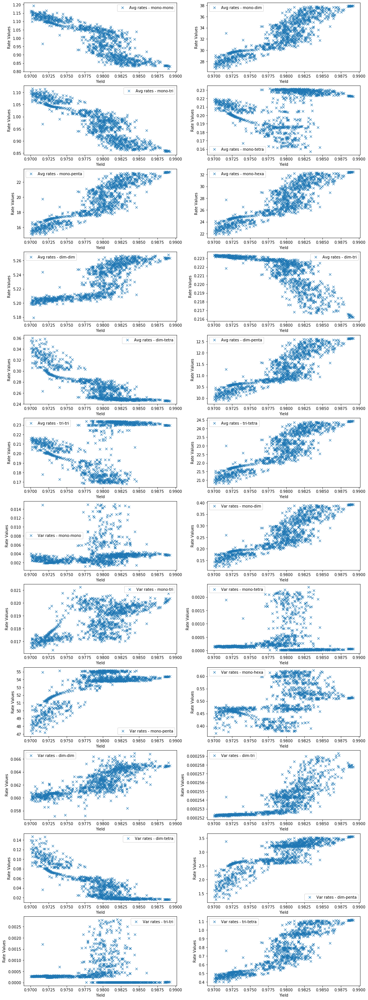

In [16]:
from matplotlib import pyplot as plt
n_features = len(asymm[0])
fig,ax = plt.subplots(int(n_features/2),2,figsize=(16,48))
# %matplotlib notebook

asymm = np.reshape(np.array(asymm),(len(sorted_yields),len(asymm[0])))
sorted_yields.reshape((sorted_yields.shape[0],1))

mask = (sorted_yields < 1.0) & (sorted_yields >0.97)

row=0
col=0
counter=0
for i in range(n_features):
    ax[row,col].plot(sorted_yields[mask],asymm[mask,i],marker='x',linestyle='',label=final_lb[i])
    ax[row,col].legend()
    ax[row,col].set_xlabel("Yield")
    ax[row,col].set_ylabel("Rate Values")
    
    counter+=1
    row = row+(col%2)
    col = counter%2
    

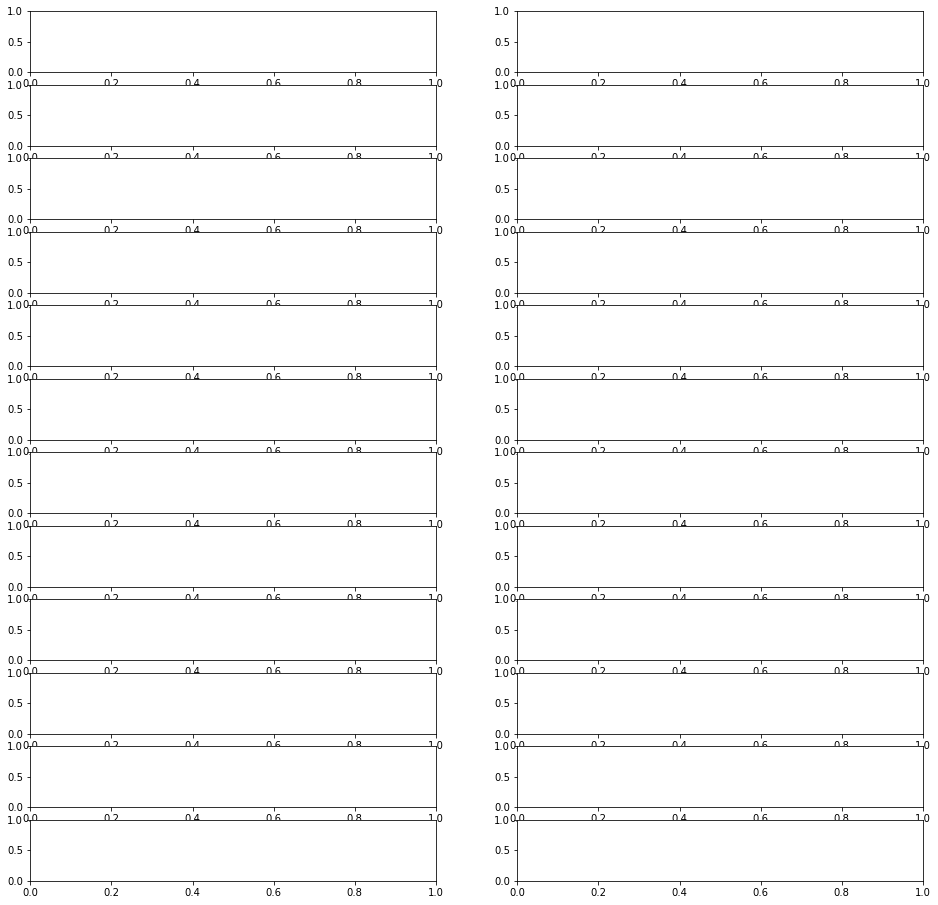

In [17]:
from matplotlib import pyplot as plt
n_features = len(asymm[0])
fig,ax = plt.subplots(int(n_features/2),2,figsize=(16,16))
# %matplotlib notebook

asymm = np.reshape(np.array(asymm),(len(sorted_yields),len(asymm[0])))
sorted_yields.reshape((sorted_yields.shape[0],1))

mask = (sorted_yields < 0.9999) & (sorted_yields >0.5)

row=0
col=0
counter=0
# for i in range(n_features):
#     ax[row,col].plot(sorted_t85[mask],asymm[mask,i],marker='x',linestyle='',label='t85')
#     ax[row,col].plot(sorted_t95[mask],asymm[mask,i],marker='x',linestyle='',label='t95')
#     ax[row,col].plot(sorted_t50[mask],asymm[mask,i],marker='x',linestyle='',label='t50')
#     ax[row,col].legend()
#     ax[row,col].set_xlabel("Yield")
#     ax[row,col].set_ylabel(final_lb[i])
    
#     ax[row,col].set_xscale("log")
    
    
#     counter+=1
#     row = row+(col%2)
#     col = counter%2

In [18]:
#Let's see what some clustering reveals
#Is there a trend with high yield

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

def cluster_params(params,final_y,n_clust):
#     feat_mat = np.concatenate((params,final_y),axis=1)
    feat_mat = params
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(feat_mat)
    
    kmeans = KMeans(n_clusters = n_clust, random_state=0).fit(X_scaled)
    clus_cen = kmeans.cluster_centers_ #Obtain centroids for all the clusters
    transform_mat = kmeans.transform(feat_mat) #This method calculates the distance of each point from each cluster
    labels = kmeans.labels_  #Labels which frame belongs to which cluster
    
    return(labels,clus_cen,transform_mat)

In [19]:
#Clustering
print(asymm.shape,sorted_yields.shape)
n_clust=8

var_feat_mat = asymm[mask][:,:]

labels,clus_cen,transform_mat = cluster_params(var_feat_mat,sorted_yields.reshape((sorted_yields.shape[0],1)),n_clust)


clr_input = ['skyblue','orange','green','red','purple','gold','brown','olive','crimson','peru','lightgreen','turquoise','cyan']

print(transform_mat.shape)

(1421, 24) (1421,)
(1421, 8)


(1421, 1)
(1421, 1)
(1421, 1)
(1421, 1)
(1421, 1)
(1421, 1)
(1421, 1)
Cluster:  0
Cluster Centroid:  [-0.11545904  0.19812588 -0.26609547 -0.61469815  0.18532762  0.18548632
 -0.30164273 -0.11325016 -0.4498875   0.20090289 -0.63870853  0.25366299
 -0.64021763  0.19476213  0.82961205 -0.08422017  0.80667316  0.05342883
  0.06511183 -0.18094598 -0.48450809  0.46890198 -0.09968463  0.11947436]
Cluster:  1
Cluster Centroid:  [ 1.48472862 -1.43484499  1.43724082  0.12096732 -1.44086916 -1.43224752
 -1.26458893 -0.09328785  1.45903932 -1.62699285  0.06950772 -1.55046231
  1.49562634 -1.54747616 -0.18011062  0.37091801 -1.76458858 -1.87958671
 -1.54542046  0.08340411  1.95292292 -1.71662868 -0.01249725 -1.53353128]
Cluster:  2
Cluster Centroid:  [ 1.34840459 -1.7291403   1.91417495  3.060805   -1.64065274 -1.66505072
 -0.95208485  1.99215143  3.37577511 -2.19010335  1.87933337 -1.94496346
  1.94944516 -1.86519863 -0.09053848  5.89553138 -2.40089373 -1.49224667
  1.08365197  6.20197522  3.2438

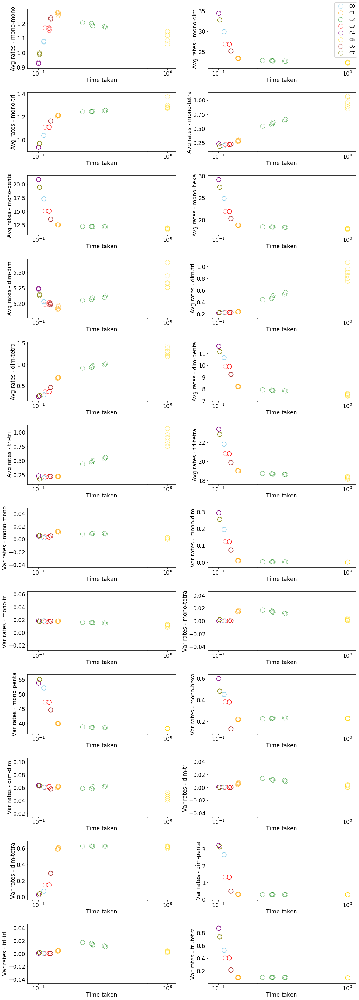

In [34]:
feat_rates =sorted_params[mask]
sel_t50 = sorted_t50[mask]
sel_t85 = sorted_t85[mask]
sel_t95 = sorted_t95[mask]

asymm_new = asymm[mask]

#Create a bianry matrix to know which elements are form a cluster
mask_01=(np.array(labels)==0)
cluster_mask = mask_01.reshape((len(labels),1))
for i in range(1,n_clust):
    n_arr = i*np.ones((len(labels),1))-np.array(labels).reshape(((len(labels),1)))
    mask_01=(n_arr==0)
    print(n_arr.shape)
    cluster_mask=np.hstack((cluster_mask,mask_01))

# cluster_mask = cluster_mask.astype(float)

fig,ax = plt.subplots(int(n_features/2),2,figsize=(16,44))
ax_hd = []

clust_min_solutions={}
for i in range(n_clust):
    
    clus_1_dist = transform_mat[cluster_mask[:,i],i]
    clus_1_par = feat_rates[cluster_mask[:,i],:]
    clus_1_t50 = sel_t50[cluster_mask[:,i]]
    clus_1_t85 = sel_t85[cluster_mask[:,i]]
    clus_1_t95 = sel_t95[cluster_mask[:,i]]
    clus_1_asymm = asymm_new[cluster_mask[:,i]]
    indx_sort = np.argsort(clus_1_dist)
    
    print("Cluster: ",i)
    print("Cluster Centroid: ",clus_cen[i])
    sorted_dist = clus_1_dist[indx_sort]
    sorted_par = clus_1_par[indx_sort]
    clus_sorted_t50 = clus_1_t50[indx_sort]
    clus_sorted_t85 = clus_1_t85[indx_sort]
    clus_sorted_t95 = clus_1_t95[indx_sort]
    clus_sorted_asymm = clus_1_asymm[indx_sort]
#     print("Max distance: ",sorted_dist[-1],"Params: ",sorted_par[-1])
#     print("Min distance: ",sorted_dist[0],"Params: ",sorted_par[0])
    clust_min_solutions[i]=sorted_par[0]
    
    
    #Plotting
    row=0
    col=0
    counter=0
    for j in range(n_features):
        
#         h1=ax[row,col].scatter(clus_sorted_t85[-1],clus_sorted_asymm[-1,j],s=100,alpha=0.6,marker='o',color=clr_input[i], label='85%')
        h1 = ax[row,col].scatter(clus_sorted_t85[0:6],clus_sorted_asymm[0:6,j],s=200,alpha=0.6,marker='o',edgecolor=clr_input[i], facecolor='none', label='85%')
        
        ax[row,col].set_xlabel("Time taken",fontdict={'fontsize':'xx-large'},labelpad=1.0)
        ax[row,col].set_ylabel(final_lb[j],fontdict={'fontsize':'xx-large'},labelpad=2.0)

        ax[row,col].set_xscale("log")
#         ax[row,col].set_yscale("log")
        ax[row,col].tick_params(labelsize='xx-large')
        
        if counter==0:
            ax_hd.append(h1)
        counter+=1
        row = row+(col%2)
        col = counter%2
fig.legend(ax_hd,['C0','C1','C2','C3','C4','C5','C6','C7'],fontsize='x-large')
fig.tight_layout()

In [21]:
uid_dict = {}
uid_reactants = {}
sys.path.append("../")
import numpy as np
from reaction_network import gtostr
for n in rn.network.nodes():
    #print(n)
    #print(rn.network.nodes()[n])
    for k,v in rn.network[n].items():
        uid = v['uid']
        r1 = set(gtostr(rn.network.nodes[n]['struct']))
        p = set(gtostr(rn.network.nodes[k]['struct']))
        r2 = p-r1
        reactants = (r1,r2)
        uid_val = {'uid':uid,'reactants':reactants,'kon':v['k_on'],'score':v['rxn_score'],'koff':v['k_off']}
        uid_reactants[uid]=reactants
        if uid not in uid_dict.keys():
            uid_dict[uid] = uid_val
    print(gtostr(rn.network.nodes[n]['struct']))
    #for r_set in rn.get_reactant_sets(n):
    #    print(tuple(r_set))
    #print(rn.network[n]['struct'])
ind_sort = np.argsort(vec_rn.kon.detach().numpy())
for i in ind_sort:
    print(vec_rn.kon[i])
    print(uid_dict[i])

P
Q
R
S
T
U
V
PQ
PR
PS
PT
PU
PV
QR
QS
QT
QU
QV
PQR
PQS
PQT
PQU
PQV
RS
RT
RU
RV
PRS
PRT
PRU
PRV
QRS
QRT
QRU
QRV
PQRS
PQRT
PQRU
PQRV
ST
SU
SV
PST
PSU
PSV
QST
QSU
QSV
PQST
PQSU
PQSV
RST
RSU
RSV
PRST
PRSU
PRSV
QRST
QRSU
QRSV
PQRST
PQRSU
PQRSV
TU
TV
PTU
PTV
QTU
QTV
PQTU
PQTV
RTU
RTV
PRTU
PRTV
QRTU
QRTV
PQRTU
PQRTV
STU
STV
PSTU
PSTV
QSTU
QSTV
PQSTU
PQSTV
RSTU
RSTV
PRSTU
PRSTV
QRSTU
QRSTV
PQRSTU
PQRSTV
UV
PUV
QUV
PQUV
RUV
PRUV
QRUV
PQRUV
SUV
PSUV
QSUV
PQSUV
RSUV
PRSUV
QRSUV
PQRSUV
TUV
PTUV
QTUV
PQTUV
RTUV
PRTUV
QRTUV
PQRTUV
STUV
PSTUV
QSTUV
PQSTUV
RSTUV
PRSTUV
QRSTUV
PQRSTUV
tensor(0.1407, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 673, 'reactants': ({'Q', 'R', 'U'}, {'S', 'V'}), 'kon': 1.1734, 'score': tensor([-72.], dtype=torch.float64), 'koff': 6.313110440168837e-26}
tensor(0.1418, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 279, 'reactants': ({'S', 'P'}, {'Q', 'R', 'U'}), 'kon': 1.1735, 'score': tensor([-72.], dtype=torch.float64), 'koff': 6.313648458784805e-26}
ten

tensor(0.2314, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 434, 'reactants': ({'Q', 'T'}, {'R', 'S', 'U', 'P'}), 'kon': 1.1967, 'score': tensor([-96.], dtype=torch.float64), 'koff': 2.430608589494756e-36}
tensor(0.2314, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 811, 'reactants': ({'Q', 'R', 'S', 'T'}, {'V', 'U'}), 'kon': 1.1978, 'score': tensor([-96.], dtype=torch.float64), 'koff': 2.4328427914237468e-36}
tensor(0.2314, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 539, 'reactants': ({'Q', 'V', 'P'}, {'R', 'S', 'T'}), 'kon': 1.1998, 'score': tensor([-108.], dtype=torch.float64), 'koff': 1.4972861662029508e-41}
tensor(0.2315, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 638, 'reactants': ({'R', 'U', 'P'}, {'Q', 'S', 'T'}), 'kon': 1.1997, 'score': tensor([-108.], dtype=torch.float64), 'koff': 1.4971613715566673e-41}
tensor(0.2315, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 665, 'reactants': ({'Q', 'R', 'T'}, {'S', 'U', 'P'}), 'kon': 

tensor(26.3702, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 511, 'reactants': ({'Q', 'S', 'P'}, {'R', 'V', 'U', 'T'}), 'kon': 18.4098, 'score': tensor([-144.], dtype=torch.float64), 'koff': 5.328974920938279e-56}
tensor(26.4910, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 962, 'reactants': ({'P'}, {'R', 'T', 'V', 'S', 'U'}), 'kon': 14.192599999999999, 'score': tensor([-60.], dtype=torch.float64), 'koff': 1.242776546506464e-19}
tensor(26.5346, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 216, 'reactants': ({'V'}, {'R', 'T', 'S', 'U', 'P'}), 'kon': 14.228899999999996, 'score': tensor([-60.], dtype=torch.float64), 'koff': 1.2459551599133216e-19}
tensor(26.7870, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 959, 'reactants': ({'P'}, {'T', 'V', 'Q', 'S', 'U'}), 'kon': 14.404299999999996, 'score': tensor([-60.], dtype=torch.float64), 'koff': 1.261314079791096e-19}
tensor(26.8542, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 214, 'reactants':

In [22]:
# for clust,rates in clust_min_solutions.items():
#     print("-------------------------")
#     print("-------------------------")
#     print("-----  Cluster  {:d}-----".format(clust))
    
for cl_id,lab in lb_rxn_class.items():
    
    print("------------------------------")
    print("------------------------------")
    print("------    {:s}    -------".format(lab))
    print("------------------------------")
    print("-------------------------------")
    print("%-12s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\n" %('Reaction','uid','C0','C1','C2','C3','C4','C5','C6','C7'))
    for r_id in final_rxn_class[cl_id]:
        r1 = "".join(list(uid_reactants[r_id][0]))
        r2 = "".join(list(uid_reactants[r_id][1]))
        print("{:^4s} + {:^4s}".format(r1,r2),end='\t')
        print(r_id,end='\t')
        for clust,rates in clust_min_solutions.items():
            print("%-4.2f" %(rates[r_id]),end='\t')
        print("")
    

------------------------------
------------------------------
------    mono-mono    -------
------------------------------
-------------------------------
Reaction    	uid 	C0  	C1  	C2  	C3  	C4  	C5  	C6  	C7  

 Q   +  P  	0	1.07	1.12	1.09	1.12	0.96	1.06	1.14	1.03	
 R   +  P  	1	1.06	1.24	1.16	1.11	1.01	1.06	1.21	1.07	
 S   +  P  	2	1.00	1.27	1.14	1.15	0.80	1.06	1.18	0.86	
 T   +  P  	3	1.13	1.37	1.18	1.18	0.91	1.05	1.31	0.95	
 U   +  P  	4	1.08	1.16	1.05	1.12	1.01	1.06	1.16	1.08	
 V   +  P  	5	1.05	1.23	1.12	1.06	1.02	1.06	1.23	1.06	
 R   +  Q  	6	1.06	1.17	1.16	1.12	1.04	1.06	1.18	1.08	
 S   +  Q  	7	1.00	1.29	1.23	1.14	0.79	1.06	1.22	0.85	
 T   +  Q  	8	1.17	1.42	1.41	1.26	0.94	1.06	1.40	0.98	
 U   +  Q  	9	1.06	1.19	1.11	1.12	0.98	1.06	1.17	1.05	
 V   +  Q  	10	1.04	1.20	1.11	1.13	0.99	1.06	1.21	1.05	
 S   +  R  	16	1.11	1.33	1.17	1.21	0.87	1.06	1.27	0.94	
 T   +  R  	17	1.12	1.38	1.21	1.18	0.92	1.05	1.28	0.95	
 U   +  R  	18	1.02	1.20	1.08	1.04	0.93	1.06	1.18	1.01	
 V   +  R  

RTP  +  V  	179	0.90	1.07	1.17	0.97	0.81	1.32	0.99	0.84	
RUP  +  V  	180	0.93	1.08	1.17	1.03	0.82	1.32	1.08	0.85	
QRS  +  V  	181	1.15	1.30	1.36	1.23	1.09	1.46	1.25	1.12	
QRT  +  V  	182	0.87	1.09	1.13	0.96	0.72	1.29	0.99	0.83	
QRU  +  V  	183	0.84	1.10	1.18	0.93	0.74	1.35	0.97	0.78	
TSP  +  V  	189	0.99	1.13	1.19	1.05	0.91	1.29	1.07	0.93	
SUP  +  V  	190	1.16	1.29	1.34	1.24	1.03	1.48	1.24	1.11	
QST  +  V  	191	1.11	1.21	1.26	1.18	1.03	1.44	1.23	1.05	
QSU  +  V  	192	1.19	1.29	1.35	1.21	1.13	1.46	1.22	1.15	
RST  +  V  	195	0.93	1.14	1.19	1.00	0.82	1.29	1.04	0.87	
RSU  +  V  	196	1.18	1.32	1.40	1.31	1.12	1.51	1.25	1.14	
TUP  +  V  	204	0.94	1.10	1.17	1.02	0.86	1.32	1.05	0.89	
QUT  +  V  	205	0.89	0.99	1.02	0.98	0.82	1.31	1.02	0.86	
RUT  +  V  	207	0.82	0.93	1.10	0.90	0.74	1.32	0.95	0.77	
SUT  +  V  	211	0.94	1.13	1.11	1.01	0.83	1.32	1.03	0.86	
------------------------------
------------------------------
------    mono-tetra    -------
------------------------------
--------------------

TVQSUP +  R  	961	25.22	19.01	18.59	22.26	29.58	18.07	20.50	27.80	
RTVQUP +  S  	953	24.52	17.98	17.49	21.45	28.52	16.98	19.60	27.09	
RVQSUP +  T  	933	23.29	18.09	17.57	20.53	27.43	17.08	19.79	25.82	
RTVQSP +  U  	161	25.22	19.01	18.61	22.24	29.50	18.08	20.49	27.76	
RTQSUP +  V  	218	25.20	19.14	18.61	22.24	29.61	18.08	20.47	27.82	
------------------------------
------------------------------
------    dim-dim    -------
------------------------------
-------------------------------
Reaction    	uid 	C0  	C1  	C2  	C3  	C4  	C5  	C6  	C7  

 RS  +  QP 	219	5.37	5.33	5.38	5.36	5.40	5.40	5.34	5.40	
 RT  +  QP 	220	4.97	4.91	4.98	4.95	5.02	5.06	4.96	4.99	
 RU  +  QP 	221	5.48	5.49	5.59	5.50	5.52	5.65	5.50	5.48	
 RV  +  QP 	222	5.40	5.49	5.51	5.41	5.43	5.60	5.44	5.41	
 ST  +  QP 	223	5.21	5.26	5.22	5.18	5.25	5.29	5.17	5.24	
 SU  +  QP 	224	5.38	5.33	5.35	5.40	5.47	5.38	5.37	5.43	
 SV  +  QP 	225	5.24	5.24	5.40	5.24	5.26	5.43	5.26	5.25	
 UT  +  QP 	229	4.94	4.95	5.03	4.94	4.99	5.11	4.94	4.

SUP  +  RV 	604	0.23	0.23	0.58	0.23	0.23	1.08	0.23	0.23	
QST  +  RV 	605	0.22	0.18	0.48	0.23	0.22	1.05	0.23	0.22	
QSU  +  RV 	606	0.22	0.22	0.54	0.22	0.22	1.08	0.22	0.22	
TUP  +  RV 	610	0.23	0.23	0.57	0.23	0.23	1.08	0.23	0.23	
QUT  +  RV 	611	0.23	0.14	0.44	0.24	0.23	1.07	0.24	0.23	
SUT  +  RV 	613	0.23	0.23	0.60	0.23	0.23	1.08	0.23	0.23	
 UT  + RSP 	618	0.23	0.23	0.56	0.23	0.23	1.08	0.23	0.23	
 VT  + RSP 	619	0.23	0.23	0.53	0.23	0.23	1.06	0.23	0.23	
 VU  + RSP 	622	0.23	0.23	0.63	0.23	0.23	1.08	0.23	0.23	
 SU  + RPT 	627	0.22	0.22	0.57	0.22	0.22	1.07	0.22	0.22	
 SV  + RPT 	628	0.23	0.13	0.53	0.23	0.22	1.07	0.23	0.23	
 VU  + RPT 	631	0.22	0.22	0.59	0.22	0.22	1.08	0.22	0.22	
 ST  + RUP 	636	0.23	0.23	0.54	0.23	0.23	1.08	0.23	0.23	
 SV  + RUP 	637	0.21	0.21	0.59	0.21	0.20	1.08	0.21	0.21	
 VT  + RUP 	640	0.24	0.24	0.60	0.24	0.23	1.10	0.24	0.23	
 ST  + RVP 	645	0.23	0.22	0.53	0.23	0.23	1.08	0.23	0.23	
 SU  + RVP 	646	0.23	0.23	0.63	0.23	0.23	1.08	0.23	0.23	
 UT  + RVP 	649	0.23	0.23	0.60	

RTVSU +  QP 	244	10.06	8.10	7.60	9.88	10.88	7.21	9.04	10.43	
TVQSU +  RP 	270	9.72	7.95	7.56	9.60	10.31	7.13	9.08	9.96	
RTVQU +  SP 	296	13.46	9.19	8.82	11.81	14.63	8.37	10.43	14.23	
RVQSU +  PT 	322	9.50	7.89	7.78	8.57	10.59	7.37	8.55	10.14	
RTVQS +  UP 	348	9.67	7.76	7.37	9.55	10.30	6.94	8.82	9.93	
RTQSU +  VP 	374	9.05	8.02	7.55	8.95	9.54	7.13	9.06	9.24	
TVSUP +  QR 	397	10.12	8.02	7.58	9.98	10.78	7.18	9.15	10.38	
RTVUP +  QS 	420	13.98	9.31	8.87	11.97	15.19	8.46	10.54	14.73	
RVSUP +  QT 	443	10.44	7.82	7.52	8.98	12.49	7.17	8.68	11.55	
RTVSP +  QU 	466	9.77	7.81	7.38	9.65	10.38	6.99	8.90	10.02	
RTSUP +  QV 	489	9.42	8.03	7.55	9.45	9.76	7.15	9.09	9.55	
TVQUP +  RS 	562	13.71	9.15	8.80	11.92	15.01	8.36	10.47	14.53	
VQSUP +  RT 	580	9.77	7.92	7.77	8.66	11.67	7.38	8.57	10.79	
TVQSP +  RU 	598	9.84	7.71	7.37	9.74	10.28	6.94	8.91	10.02	
TQSUP +  RV 	616	9.83	7.99	7.52	9.71	10.22	7.10	9.05	10.03	
RVQUP +  ST 	715	11.95	7.87	7.59	10.09	12.31	7.19	8.95	12.23	
RTVQP +  SU 	726	11.59	8.74	8.40

In [23]:
uid_dict = {}
sys.path.append("../")
import numpy as np
from reaction_network import gtostr
from torch import DoubleTensor as Tensor

def get_max_edge(n):
    """
    Calculates the max rate (k_on) for a given node
    To find out the maximum flow path to the final complex starting from the current node.
    
    Can also calculate the total rate of consumption of a node by summing up all rates. 
    Can tell which component is used quickly.
    """
    try:
        edges = rn.network.out_edges(n)
        #Loop over all edges
        #Get attributes
        if len(edges)==0:
            return(False)
        kon_max = -1
        next_node = -1
        
        kon_sum = 0
        for edge in edges:
            data = rn.network.get_edge_data(edge[0],edge[1])
            #print(data)
            #Get uid
            uid = data['uid']
            #Get updated kon
            temp_kon = vec_rn.kon[uid]
            kon_sum+=temp_kon
            
#             #Calculate k_off also
#             std_c = Tensor([1.])
#             l_kon = torch.log(temp_kon)
#             l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (self._R * self._T)) + l_kon + torch.log(std_c)
            if temp_kon > kon_max:
                kon_max = temp_kon
                next_node=edge[1]
        return(kon_max,next_node,kon_sum)
    except Exception as err:
        raise(err)

pathway = []
kon_sumarray = []
total_con_rate = {}
for n in rn.network.nodes():
    
    n_str = gtostr(rn.network.nodes[n]['struct']) 
    
    paths = [n_str]
    kon_sum = 0
    temp_node = n
    max_edge = True
    consumption_rate = 0
    if n < len(rn.network.nodes()):#num_monomers:
#         print("Current node: ")
#         print(n_str)
        while max_edge:
            max_edge = get_max_edge(temp_node)
            if max_edge:
                total_con_rate[gtostr(rn.network.nodes[temp_node]['struct'])] = max_edge[2]
                temp_node = max_edge[1]
                kon_sum += max_edge[0].item()
                
#                 print("Next node: ")
#                 print(temp_node)

                paths.append(gtostr(rn.network.nodes[temp_node]['struct']))
            else:
                break
        pathway.append(paths)
        kon_sumarray.append(kon_sum)
        paths=[]

print(pathway)
print(kon_sumarray)
#print(total_con_rate)

[['P', 'PQS', 'PQRSTUV'], ['Q', 'PQS', 'PQRSTUV'], ['R', 'QRS', 'PQRSTUV'], ['S', 'PQS', 'PQRSTUV'], ['T', 'PST', 'PQRSTUV'], ['U', 'QSU', 'PQRSTUV'], ['V', 'QSV', 'PQRSTUV'], ['PQ', 'PQS', 'PQRSTUV'], ['PR', 'PRS', 'PQRSTUV'], ['PS', 'PRS', 'PQRSTUV'], ['PT', 'PRT', 'PQRSTUV'], ['PU', 'PSU', 'PQRSTUV'], ['PV', 'PSV', 'PQRSTUV'], ['QR', 'QRS', 'PQRSTUV'], ['QS', 'QSV', 'PQRSTUV'], ['QT', 'QTU', 'PQRSTUV'], ['QU', 'QSU', 'PQRSTUV'], ['QV', 'QSV', 'PQRSTUV'], ['PQR', 'PQRSTUV'], ['PQS', 'PQRSTUV'], ['PQT', 'PQRSTUV'], ['PQU', 'PQRSTUV'], ['PQV', 'PQRSTUV'], ['RS', 'PRS', 'PQRSTUV'], ['RT', 'PRT', 'PQRSTUV'], ['RU', 'RSU', 'PQRSTUV'], ['RV', 'RSV', 'PQRSTUV'], ['PRS', 'PQRSTUV'], ['PRT', 'PQRSTUV'], ['PRU', 'PQRSTUV'], ['PRV', 'PQRSTUV'], ['QRS', 'PQRSTUV'], ['QRT', 'PQRSTUV'], ['QRU', 'PQRSTUV'], ['QRV', 'PQRSTUV'], ['PQRS', 'PQRSTUV'], ['PQRT', 'PQRSTUV'], ['PQRU', 'PQRSTUV'], ['PQRV', 'PQRSTUV'], ['ST', 'QST', 'PQRSTUV'], ['SU', 'QSU', 'PQRSTUV'], ['SV', 'QSV', 'PQRSTUV'], ['PST', 'PQR

In [24]:
for k,v in sorted(total_con_rate.items(),key=lambda x : x[1]):
    print(k," : ", v.item())

PQRV  :  23.632056557806152
PQSV  :  23.77596668607546
QRSU  :  24.491936688180726
PRUV  :  24.735258092651634
RSTV  :  24.80406238507883
QSTV  :  24.890644122694248
RSTU  :  24.939921155205887
PQUV  :  25.02961205284793
PRSU  :  25.14923736751821
QRUV  :  25.149278018728698
PQST  :  25.271341455024682
RSUV  :  25.296366014439098
PQRS  :  25.425871467945488
PSUV  :  25.49337429082976
QRST  :  25.55434303288547
PRST  :  25.56066259358065
PSTU  :  25.769201111341697
PQRU  :  25.774825681062236
QSTU  :  25.90160889214516
QRSV  :  25.912820930809342
QSUV  :  25.93192308381191
QRTV  :  26.116010852732135
PQTV  :  26.263596078969105
STUV  :  26.32885999802186
PQRT  :  26.376001683148594
PQTU  :  26.445014493270182
PQSU  :  26.48388728882361
PRSV  :  26.76189754264196
PSTV  :  26.889967594652322
PRTV  :  26.95938730349588
PTUV  :  27.18461835545073
QRTU  :  27.23390368818938
PRTU  :  27.542154811680163
QTUV  :  27.671970281997204
RTU  :  27.67464028749225
RTUV  :  27.71417540563649
STU  :  28

Let's first visualize some of the data.

**Without any optimization**


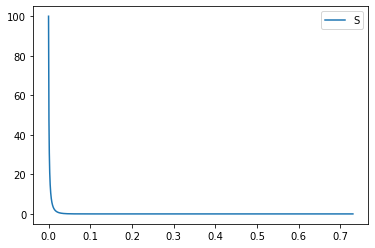

In [25]:
nodes_list = ['A','B','S','M','AB','BMS','ABS','AMS','ABMS','AM','AS']
#nodes_list = ['A','B','ABMS']
optim.plot_observable(0,nodes_list)


**After 750 optimization iterations**


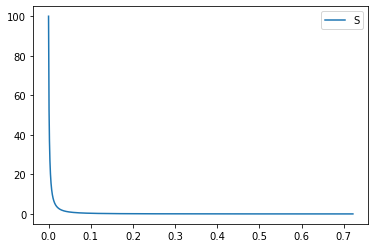

In [26]:
optim.plot_observable(-1,nodes_list)


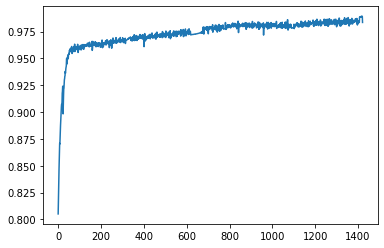

In [27]:
optim.plot_yield()

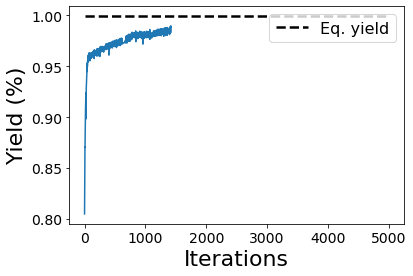

In [28]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots()
ax.plot(optim.yield_per_iter)
f_dict = {'fontsize':22}
ax.set_ylabel("Yield (%)",fontdict=f_dict)
ax.set_xlabel("Iterations",fontdict=f_dict)
plt.tick_params(axis='both',labelsize=14.0)
ax.hlines(y=0.999,xmin=0,xmax=5000,linewidth=2.5,linestyle='dashed',label='Eq. yield')
ax.legend(fontsize=16)

It seems like we've found a stable solution that produces greater yield than equilibrium. This should be thermodynamically
impossible. Let's try to find an explanation. We'll run simulations using the learned optimal parameters at a few different
timescales.

Using CPU
Simulation rates:  tensor([8.3241e-01, 8.6326e-01, 6.5378e-01,  ..., 2.4223e-19, 1.7682e-24,
        1.7689e-24], dtype=torch.float64, grad_fn=<ExpBackward>)


No handles with labels found to put in legend.


Next time:  tensor(1.2041, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  599
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9834, dtype=torch.float64, grad_fn=<DivBackward0>)
Using CPU
Simulation rates:  tensor([8.3241e-01, 8.6326e-01, 6.5378e-01,  ..., 2.4223e-19, 1.7682e-24,
        1.7689e-24], dtype=torch.float64, grad_fn=<ExpBackward>)


No handles with labels found to put in legend.


Next time:  tensor(8.2273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  606
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9879, dtype=torch.float64, grad_fn=<DivBackward0>)
Using CPU
Simulation rates:  tensor([8.3241e-01, 8.6326e-01, 6.5378e-01,  ..., 2.4223e-19, 1.7682e-24,
        1.7689e-24], dtype=torch.float64, grad_fn=<ExpBackward>)
Next time:  tensor(64.2516, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  745
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9888, dtype=torch.float64, grad_fn=<DivBackward0>)
{'P': 0, 'Q': 1, 'R': 2, 'S': 3, 'T': 4, 'U': 5, 'V': 6, 'PQ': 7, 'PR': 8, 'PS': 9, 'PT': 10, 'PU': 11, 'PV': 12, 'QR': 13, 'QS': 14, 'QT': 15, 'QU': 16, 'QV': 17, 'PQR': 18, 'PQS': 19, 'PQT': 20, 'PQU': 21, 'PQV': 22, 'RS': 23, 'RT': 24, 'RU': 25, 'RV': 26, 'PRS': 27, 'PRT': 28, 'PRU': 29, 'PRV': 30, 'QRS': 31, 'QRT': 32, 'QRU': 33, 'QRV': 34, 'PQRS': 35, 'PQRT': 36, 'P

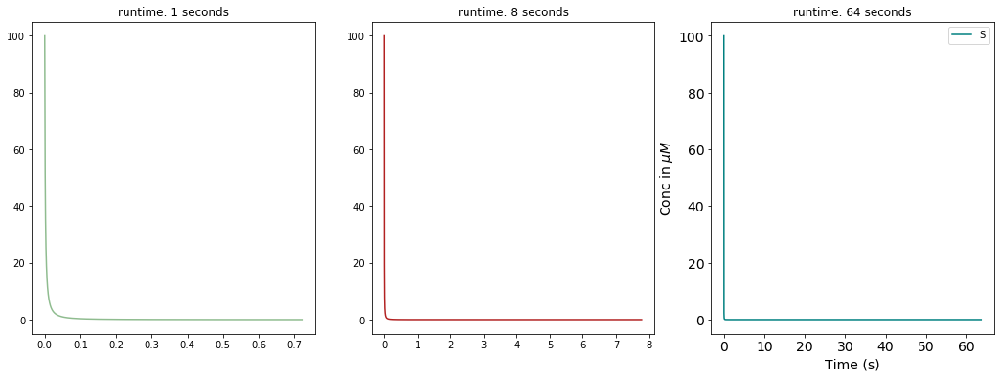

In [29]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots(1, 3)
optim_rn = optim.rn
for i, runtime in enumerate([1, 8, 64]):
    optim_rn.reset()
    sim = VecSim(optim_rn, runtime, device='cpu')
    y = sim.simulate()
    sim.plot_observable(nodes_list,ax=ax[i],)
    ax[i].set_title("runtime: " + str(runtime) + " seconds")
fig.set_size_inches(18, 6)
node_map = {}
for node in rn.network.nodes():
    node_map[gtostr(rn.network.nodes[node]['struct'])] = node

print(node_map)
plt.show()

In [30]:
node_map = {}
for node in rn.network.nodes():
    node_map[gtostr(rn.network.nodes[node]['struct'])] = node

print(node_map)
def get_max_edge(n):
    """
    Calculates the max rate (k_on) for a given node
    To find out the maximum flow path to the final complex starting from the current node.
    
    Can also calculate the total rate of consumption of a node by summing up all rates. 
    Can tell which component is used quickly.
    """
    try:
        edges = rn.network.out_edges(n)
        #Loop over all edges
        #Get attributes
        kon_max = -1
        next_node = -1

        kon_sum = 0
        total_flux_outedges = 0
        total_flux_inedges = 0
        if len(edges)==0:
            return(False)
            
        for edge in edges:
            data = rn.network.get_edge_data(edge[0],edge[1])
            #print(data)
            #Get uid
            uid = data['uid']

            #Get updated kon
            temp_kon = vec_rn.kon[uid]
            kon_sum+=temp_kon
            
            if temp_kon > kon_max:
                kon_max = temp_kon
                next_node=edge[1]
             
        return(kon_max,next_node,kon_sum)
    except Exception as err:
        raise(err)

        
def get_node_flux(n):
    total_flux_outedges = 0
    total_flux_inedges = 0
    #Go over all the out edges
    edges_out = rn.network.out_edges(n)
    if len(edges_out)>0:

        for edge in edges_out:
            data = rn.network.get_edge_data(edge[0],edge[1])
            #print(data)
            #Get uid
            uid = data['uid']

            #Get updated kon
            temp_kon = vec_rn.kon[uid]

            #Calculate k_off also
            std_c = Tensor([1.])
            l_kon = torch.log(temp_kon)
            l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (vec_rn._R * vec_rn._T)) + l_kon + torch.log(std_c)
            koff = torch.exp(l_koff)

            #Getting conc. of reactants and products
            #Get product
            prod = gtostr(rn.network.nodes[edge[1]]['struct']) 
            #Get other reactant
            react = "".join(sorted(list(set(prod) - set(gtostr(rn.network.nodes[edge[0]]['struct']) ))))

            #Net flux from this edge = Generation - consumption
            edge_flux = koff*vec_rn.copies_vec[edge[1]] - temp_kon*(vec_rn.copies_vec[edge[0]])*(vec_rn.copies_vec[node_map[react]])
            #edge_flux = koff*vec_rn.copies_vec[edge[1]] 

            print("Reaction: ", gtostr(rn.network.nodes[edge[0]]['struct']), "+",react," -> ",prod)
            print("Net flux: ",edge_flux)
            print("kon : ",temp_kon)
            print("koff: ",koff)
            print("Reaction data OUTWARD: ")
            print(data)

            total_flux_outedges+=edge_flux
    
    #Now go over all the in edges
    edges_in = rn.network.in_edges(n)
    react_list = []
    if len(edges_in) > 0:
        for edge in edges_in:
            if edge[0] in react_list:
                continue
            data = rn.network.get_edge_data(edge[0],edge[1])
            uid = data['uid']


            #Get generation rates; which would be kon
            temp_kon = vec_rn.kon[uid]

            #Get consumption rates; which is k_off
            std_c = Tensor([1.])
            l_kon = torch.log(temp_kon)
            l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (vec_rn._R * vec_rn._T)) + l_kon + torch.log(std_c)
            koff = torch.exp(l_koff)

            #Get conc. of reactants and products
            prod = gtostr(rn.network.nodes[edge[1]]['struct'])
            #Get other reactant
            react = "".join(sorted(list(set(prod) - set(gtostr(rn.network.nodes[edge[0]]['struct']) ))))
            react_list.append(node_map[react])
            #Net flux from this edge = Generation - consumption
            edge_flux_in = temp_kon*(vec_rn.copies_vec[edge[0]])*(vec_rn.copies_vec[node_map[react]])- koff*vec_rn.copies_vec[edge[1]]
            #edge_flux_in = koff*vec_rn.copies_vec[edge[1]]
            


            print("Reaction: ", prod ," -> ",gtostr(rn.network.nodes[edge[0]]['struct']), "+",react)
            print("Net flux: ",edge_flux_in)
            print("kon : ",temp_kon)
            print("koff: ",koff)
            print("Raction data INWARD: ")
            print(data)

            total_flux_inedges+=edge_flux_in
    net_node_flux = total_flux_outedges + total_flux_inedges
    
    return(net_node_flux)
    
pathway = []
kon_sumarray = []
total_con_rate = {}
net_flux = {}
for n in rn.network.nodes():
    
    n_str = gtostr(rn.network.nodes[n]['struct']) 
    
    paths = [n_str]
    kon_sum = 0
    temp_node = n
    max_edge = True
    consumption_rate = 0
    if n < len(rn.network.nodes()):#num_monomers:
#         print("Current node: ")
#         print(n_str)
        while max_edge:
            max_edge = get_max_edge(temp_node)
            if max_edge:
                total_con_rate[gtostr(rn.network.nodes[temp_node]['struct'])] = max_edge[2]
                
                temp_node = max_edge[1]
                kon_sum += max_edge[0].item()
                
                
#                 print("Next node: ")
#                 print(temp_node)

                paths.append(gtostr(rn.network.nodes[temp_node]['struct']))
            else:
                break
        pathway.append(paths)
        kon_sumarray.append(kon_sum)
        paths=[]
    print("-------------------------------------------------------------------------------")
    print("-------------------------------------------------------------------------------")
    print("|                                                                             |")
    node_flux = get_node_flux(n)
    net_flux[gtostr(rn.network.nodes[n]['struct'])] = node_flux
    print("|                                                                             |")
    print("-------------------------------------------------------------------------------")
    print("-------------------------------------------------------------------------------")

print(pathway)
print(kon_sumarray)

#print(total_con_rate)

{'P': 0, 'Q': 1, 'R': 2, 'S': 3, 'T': 4, 'U': 5, 'V': 6, 'PQ': 7, 'PR': 8, 'PS': 9, 'PT': 10, 'PU': 11, 'PV': 12, 'QR': 13, 'QS': 14, 'QT': 15, 'QU': 16, 'QV': 17, 'PQR': 18, 'PQS': 19, 'PQT': 20, 'PQU': 21, 'PQV': 22, 'RS': 23, 'RT': 24, 'RU': 25, 'RV': 26, 'PRS': 27, 'PRT': 28, 'PRU': 29, 'PRV': 30, 'QRS': 31, 'QRT': 32, 'QRU': 33, 'QRV': 34, 'PQRS': 35, 'PQRT': 36, 'PQRU': 37, 'PQRV': 38, 'ST': 39, 'SU': 40, 'SV': 41, 'PST': 42, 'PSU': 43, 'PSV': 44, 'QST': 45, 'QSU': 46, 'QSV': 47, 'PQST': 48, 'PQSU': 49, 'PQSV': 50, 'RST': 51, 'RSU': 52, 'RSV': 53, 'PRST': 54, 'PRSU': 55, 'PRSV': 56, 'QRST': 57, 'QRSU': 58, 'QRSV': 59, 'PQRST': 60, 'PQRSU': 61, 'PQRSV': 62, 'TU': 63, 'TV': 64, 'PTU': 65, 'PTV': 66, 'QTU': 67, 'QTV': 68, 'PQTU': 69, 'PQTV': 70, 'RTU': 71, 'RTV': 72, 'PRTU': 73, 'PRTV': 74, 'QRTU': 75, 'QRTV': 76, 'PQRTU': 77, 'PQRTV': 78, 'STU': 79, 'STV': 80, 'PSTU': 81, 'PSTV': 82, 'QSTU': 83, 'QSTV': 84, 'PQSTU': 85, 'PQSTV': 86, 'RSTU': 87, 'RSTV': 88, 'PRSTU': 89, 'PRSTV': 90,

koff:  tensor([0.7129], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.165, 'k_off': 2.7022440972337666e-10, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 935}
Reaction:  Q + PTUV  ->  PQTUV
Net flux:  tensor([0.0014], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2230, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2183], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1908, 'k_off': 1.6970853897279108e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 938}
Reaction:  Q + RTUV  ->  QRTUV
Net flux:  tensor([0.0014], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2227, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2181], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1909, 'k_off': 1.6972279061361847e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 947}
Reaction:  Q 

Net flux:  tensor([0.0018], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2238, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2191], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1956, 'k_off': 1.7039261773250592e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 900}
Reaction:  S + RUV  ->  RSUV
Net flux:  tensor([0.0170], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.8850, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.8711], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1969, 'k_off': 2.7762368755185224e-10, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 904}
Reaction:  S + PRUV  ->  PRSUV
Net flux:  tensor([0.0018], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2246, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2199], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTW

kon :  tensor(24.9183, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([24.2686], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 13.627500000000001, 'k_off': 1.1932935041864716e-19, 'lcf': 1, 'rxn_score': tensor([-60.], dtype=torch.float64), 'uid': 144}
Reaction:  U + PQRSV  ->  PQRSUV
Net flux:  tensor([0.7772], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(9.4849, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([9.2376], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1993, 'k_off': 1.0501683357701909e-20, 'lcf': 1, 'rxn_score': tensor([-60.], dtype=torch.float64), 'uid': 145}
Reaction:  U + TV  ->  TUV
Net flux:  tensor([1.3734e-06], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(37.5342, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([37.1396], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 21.971600000000002, 'k_off': 0.0008294

Net flux:  tensor([0.1022], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.0690, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([4.9630], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 5.0499, 'k_off': 7.196936101433433e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 246}
Reaction:  PR + QU  ->  PQRU
Net flux:  tensor([0.0374], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.5175, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([5.4021], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 5.5169, 'k_off': 7.862487728073437e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 247}
Reaction:  PR + QV  ->  PQRV
Net flux:  tensor([0.3938], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.3912, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([5.2785], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD:

koff:  tensor([0.8279], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1776, 'k_off': 7.235424467279295, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 4}
|                                                                             |
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
|                                                                             |
Reaction:  PV + Q  ->  PQV
Net flux:  tensor([0.3064], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(37.1396, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([36.7492], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 22.0048, 'k_off': 0.0008307108061995265, 'l

Net flux:  tensor([0.0004], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.1664, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.1612], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1846, 'k_off': 6.373368525161079e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 432}
Reaction:  QT + RSV  ->  QRSTV
Net flux:  tensor([0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.1937, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.1877], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1831, 'k_off': 6.365298245920975e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 433}
Reaction:  QT + PRSU  ->  PQRSTU
Net flux:  tensor([0.0167], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2314, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2218], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OU

Net flux:  tensor([0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2231, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2161], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1786, 'k_off': 6.341087408200925e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 516}
Reaction:  PQT + RSU  ->  PQRSTU
Net flux:  tensor([0.0167], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2325, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2217], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1993, 'k_off': 1.496662192971509e-41, 'lcf': 1, 'rxn_score': tensor([-108.], dtype=torch.float64), 'uid': 517}
Reaction:  PQT + RSV  ->  PQRSTV
Net flux:  tensor([0.0158], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2316, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2208], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data

kon :  tensor(0.2243, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2173], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1898, 'k_off': 6.401345493193139e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 513}
Reaction:  RU + PQV  ->  PQRUV
Net flux:  tensor([0.0019], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2152, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2085], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1909, 'k_off': 6.407263697969192e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 536}
Reaction:  RU + P  ->  PRU
Net flux:  tensor([2.5950e-06], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(37.3315, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([36.9391], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 22.011399999999995, 'k_off': 0.0008309599650794494, 'lcf

Net flux:  tensor([2279.4201], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(24.5603, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([23.0513], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 18.307099999999995, 'k_off': 5.299246964937602e-56, 'lcf': 1, 'rxn_score': tensor([-144.], dtype=torch.float64), 'uid': 652}
Reaction:  PRV  ->  R + PV
Net flux:  tensor([-0.7129], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(37.7050, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([37.3086], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 22.025999999999996, 'k_off': 0.0008315111347229147, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 24}
Reaction:  PRV  ->  V + PR
Net flux:  tensor([-0.7142], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(37.7755, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([37.3784], dtype=torch.float64, grad_fn=<ExpBack

{'k_on': 1.1983, 'k_off': 1.7077741203484647e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 87}
Reaction:  PQRV + U  ->  PQRUV
Net flux:  tensor([0.0019], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2147, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2102], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1937, 'k_off': 1.7012183655678562e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 129}
Reaction:  PQRV + ST  ->  PQRSTV
Net flux:  tensor([0.0126], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.1828, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.1752], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 2.1503, 'k_off': 4.367458552678663e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 701}
Reaction:  PQRV + SU  ->  PQRSUV
Net flux:  tensor([0.0184], dtype=torch.float64, grad_fn=<SubBackward0>

Reaction:  PST + QUV  ->  PQSTUV
Net flux:  tensor([0.0158], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2303, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2196], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1995, 'k_off': 1.496911782264085e-41, 'lcf': 1, 'rxn_score': tensor([-108.], dtype=torch.float64), 'uid': 741}
Reaction:  PST + RUV  ->  PRSTUV
Net flux:  tensor([0.0169], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2321, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2213], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1999, 'k_off': 1.497410960849251e-41, 'lcf': 1, 'rxn_score': tensor([-108.], dtype=torch.float64), 'uid': 742}
Reaction:  PST + QRUV  ->  PQRSTUV
Net flux:  tensor([2172.4243], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(23.4074, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([21.9692], dtype=torch.floa

{'k_on': 5.2717, 'k_off': 7.513037494985386e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 224}
Reaction:  PQSU  ->  PS + QU
Net flux:  tensor([-2.5318e-10], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.5511, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([5.4350], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 5.2752, 'k_off': 7.518025569274967e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 273}
Reaction:  PQSU  ->  PU + QS
Net flux:  tensor([-2.5379e-10], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.5670, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([5.4506], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 5.3031999999999995, 'k_off': 7.557930163591712e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 324}
Reaction:  PQSU  ->  PSU + Q
Net flux:  tensor([-3.8353e-11], dtype=torch.float64, grad_fn=<S

Net flux:  tensor([0.0144], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2314, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2218], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1978, 'k_off': 2.4328427914237468e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 811}
Reaction:  QRST + PUV  ->  PQRSTUV
Net flux:  tensor([2247.0811], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(24.2118, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([22.7242], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 17.899599999999996, 'k_off': 5.181290372238027e-56, 'lcf': 1, 'rxn_score': tensor([-144.], dtype=torch.float64), 'uid': 812}
Reaction:  QRST  ->  S + QRT
Net flux:  tensor([-0.0195], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.8532, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.8398], dtype=torch.float64, grad_fn=<ExpBackwar

{'k_on': 22.0292, 'k_off': 0.0008316319390283302, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 824}
Reaction:  TU + S  ->  STU
Net flux:  tensor([1.5492e-09], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(37.2527, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([36.8611], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 21.987500000000004, 'k_off': 0.0008300577079233671, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 825}
Reaction:  TU  ->  T + U
Net flux:  tensor([-1.8454e-09], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.7235, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.7197], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1734, 'k_off': 7.209618775395321, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 61}
|                                                                             |
--------------------

-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
|                                                                             |
Reaction:  PQTV + U  ->  PQTUV
Net flux:  tensor([0.0013], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2144, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2099], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1964, 'k_off': 1.7050663085912577e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 149}
Reaction:  PQTV + RS  ->  PQRSTV
Net flux:  tensor([0.0158], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2308, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2213], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 2.3512, 'k_off': 4.7755050686221084e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float6

Net flux:  tensor([-0.0014], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2243, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2173], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1898, 'k_off': 6.401345493193139e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 513}
Reaction:  PQRTU  ->  PQU + RT
Net flux:  tensor([-0.0013], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2061, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.1997], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1817, 'k_off': 6.357765985296957e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 524}
Reaction:  PQRTU  ->  PQTU + R
Net flux:  tensor([-0.0014], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2171, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2125], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD

Net flux:  tensor([-0.1225], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.0026, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([4.8979], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 5.0641, 'k_off': 7.217173431408363e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 429}
Reaction:  QSTV  ->  QV + ST
Net flux:  tensor([-0.1249], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(5.0995, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([4.9929], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 5.1396, 'k_off': 7.324773319655305e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 474}
Reaction:  QSTV  ->  QTV + S
Net flux:  tensor([-0.0214], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.8701, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.8564], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{

{'k_on': 1.1846, 'k_off': 6.373368525161079e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 432}
Reaction:  QRSTU  ->  QU + RST
Net flux:  tensor([-0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2239, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2169], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1726, 'k_off': 6.308806291240828e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 455}
Reaction:  QRSTU  ->  RS + QTU
Net flux:  tensor([-0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2228, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2159], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1788, 'k_off': 6.342163445432932e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 551}
Reaction:  QRSTU  ->  RT + QSU
Net flux:  tensor([-0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon 

koff:  tensor([0.2235], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1978, 'k_off': 2.4328427914237468e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 775}
Reaction:  UV + RST  ->  RSTUV
Net flux:  tensor([0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2178, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2110], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1943, 'k_off': 6.425556330913221e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 785}
Reaction:  UV + PRST  ->  PRSTUV
Net flux:  tensor([0.0171], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2335, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2238], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1995, 'k_off': 2.436295648950406e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 802}
Reaction:  U

{'k_on': 1.1909, 'k_off': 6.407263697969192e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 264}
Reaction:  PQRUV  ->  PU + QRV
Net flux:  tensor([-0.0020], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2268, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2197], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1908, 'k_off': 6.406725679353192e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 332}
Reaction:  PQRUV  ->  PV + QRU
Net flux:  tensor([-0.0020], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2254, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2184], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1909, 'k_off': 6.407263697969192e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 358}
Reaction:  PQRUV  ->  QR + PUV
Net flux:  tensor([-0.0020], dtype=torch.float64, grad_fn=<SubBackward0>)
kon 

kon :  tensor(0.2279, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2208], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1786, 'k_off': 6.341087408200925e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 415}
Reaction:  QRSUV  ->  QU + RSV
Net flux:  tensor([-0.0017], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2175, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2107], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1812, 'k_off': 6.355075892216942e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 456}
Reaction:  QRSUV  ->  QV + RSU
Net flux:  tensor([-0.0018], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2268, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2197], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1695, 'k_off': 6.292127714144748e-26, 'lcf': 1, 'rxn_score':

Net flux:  tensor([0.0006], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2232, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2185], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.1934, 'k_off': 1.7007908163430308e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 948}
Reaction:  RTUV  ->  U + RTV
Net flux:  tensor([-0.0160], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.7109, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.6997], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1783, 'k_off': 2.7330937508759917e-10, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 150}
Reaction:  RTUV  ->  V + RTU
Net flux:  tensor([-0.0147], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.6554, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.6451], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD:

kon :  tensor(0.2262, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2215], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1975, 'k_off': 1.7066339890822644e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 156}
Reaction:  QSTUV  ->  V + QSTU
Net flux:  tensor([-0.0005], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2153, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2108], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1973, 'k_off': 1.7063489562657261e-15, 'lcf': 1, 'rxn_score': tensor([-48.], dtype=torch.float64), 'uid': 213}
Reaction:  QSTUV  ->  QS + TUV
Net flux:  tensor([-0.0005], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2164, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2097], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1764000000000001, 'k_off': 6.32925099864884e-26, 'lcf': 1,

Reaction:  QRSTUV  ->  RU + QSTV
Net flux:  tensor([-0.0143], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2304, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2209], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1978, 'k_off': 2.4328427914237468e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 597}
Reaction:  QRSTUV  ->  RV + QSTU
Net flux:  tensor([-0.0142], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2277, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2183], dtype=torch.float64, grad_fn=<ExpBackward>)
Raction data INWARD: 
{'k_on': 1.1983, 'k_off': 2.4338583377551097e-36, 'lcf': 1, 'rxn_score': tensor([-96.], dtype=torch.float64), 'uid': 615}
Reaction:  QRSTUV  ->  QRS + TUV
Net flux:  tensor([-0.0141], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.2283, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.2177], dtype=torch.float64, gra

In [31]:
for k,v in sorted(net_flux.items(),key=lambda x : x[1]):
    print(k," : ", v)

print(vec_rn.copies_vec)
print(vec_rn.kon)

PQRSTUV  :  tensor([-126089.4098], dtype=torch.float64, grad_fn=<AddBackward0>)
PV  :  tensor([982.7471], dtype=torch.float64, grad_fn=<AddBackward0>)
QRSTU  :  tensor([984.4311], dtype=torch.float64, grad_fn=<AddBackward0>)
QV  :  tensor([987.0004], dtype=torch.float64, grad_fn=<AddBackward0>)
PRSTU  :  tensor([987.1412], dtype=torch.float64, grad_fn=<AddBackward0>)
UV  :  tensor([1035.2249], dtype=torch.float64, grad_fn=<AddBackward0>)
PQRST  :  tensor([1037.0540], dtype=torch.float64, grad_fn=<AddBackward0>)
PQSTU  :  tensor([1037.2048], dtype=torch.float64, grad_fn=<AddBackward0>)
RV  :  tensor([1037.3604], dtype=torch.float64, grad_fn=<AddBackward0>)
RU  :  tensor([1037.9470], dtype=torch.float64, grad_fn=<AddBackward0>)
PQSTV  :  tensor([1039.3189], dtype=torch.float64, grad_fn=<AddBackward0>)
PU  :  tensor([1058.1074], dtype=torch.float64, grad_fn=<AddBackward0>)
QRSTV  :  tensor([1059.6093], dtype=torch.float64, grad_fn=<AddBackward0>)
PR  :  tensor([1062.2550], dtype=torch.flo

In [32]:
# print(solution)
poly_system = EquilibriumSolver(rn)
solution = poly_system.solve(init_val=vec_rn.copies_vec.detach().numpy().tolist())
#solution = poly_system.solve(verifyBool = False)
if solution == None:
    print("No Equilibrium solution")
else:
    print(solution)
    print("Equilibrium expected yield: ", 100 * solution[-1] / min(vec_rn.initial_copies[:vec_rn.num_monomers]), '%')
print(vec_rn.kon)

KeyboardInterrupt: 

Clearly, the equilibrium reached by the system still matches the equilibrium solution. We have however found a set of parameters that can increase available complete AP2 at some point before equilibrium to levels significantly higher than at equilibrium. We don't observe any trapping, but have uncovered an interesting effect. 

Now we'll move on to looking at ARP23. This is 7 subunits, which drastically increases the number of possible reactions. Expect longer runtimes. 